In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import tldextract
import json
import pycountry
import iso3166
import math

Websites with available clean data
- China
- GDPR nations
- India
- Iraq
- Pakistan
- Russia
- Saudi Arabia
- UAE

In [13]:
data_dir = "cleaned_data/"

In [14]:
gdpr_nations = ['Austria',
                'Belgium',
                'Bulgaria',
                'Croatia', 
                'Cyprus',
                'Czech Republic', 
                'Denmark', 
                'Estonia', 
                'Finland', 
                'France', 
                'Germany', 
                'Greece', 
                'Hungary', 
                'Ireland', 
                'Italy',
                'Latvia',
                'Lithuania',
                'Luxembourg', 
                'Malta', 
                'Netherlands', 
                'Poland', 
                'Portugal', 
                'Romania', 
                'Slovakia', 
                'Slovenia', 
                'Spain',
                'Sweden',
                'United Kingdom',
                'Iceland',
                'Lichtenstein',
                'Norway'
               ]

## Trial Run: China vs. Saudi Arabia

In [15]:
china = pd.read_csv(data_dir + "blocked_urls_china.csv")
china.drop(columns = ["Unnamed: 0"], inplace = True)
china.head()

,URL
0,www.a00.com
1,a0006.in2000.com
2,a1.sparklancer.com
3,a1234.uhome.net
4,a1234bc.uhome.net


In [16]:
saudi_arabia = pd.read_csv(data_dir + "blocked_urls_sa.csv")
saudi_arabia.drop(columns = ["Unnamed: 0"], inplace = True)
saudi_arabia.head()

,URL
0,www.absoluteswimwear.com
1,www.adaweb.com
2,www.adultnewsstand.com
3,www.adventureangling.com
4,www.adventureangling.com/chd/webring.htm


In [17]:
print(china.shape, saudi_arabia.shape)

(15911, 1) (1380, 1)


In [18]:
tldextract.extract('www.a00.com')

ExtractResult(subdomain='www', domain='a00', suffix='com')

In [19]:
china_domains = list(china['URL'].apply(lambda d: tldextract.extract(d)[1]))
china_domains[:5]

['a00', 'in2000', 'sparklancer', 'uhome', 'uhome']

In [20]:
sa_domains = list(saudi_arabia['URL'].apply(lambda d: tldextract.extract(d)[1]))
sa_domains[:5]

['absoluteswimwear',
 'adaweb',
 'adultnewsstand',
 'adventureangling',
 'adventureangling']

In [21]:
block_china_sa = list(set(china_domains) & set(sa_domains))
print(block_china_sa[:5], len(block_china_sa))

['millionmarijuanamarch', 'china-apsis', 'chinawxp', 'links', 'cuttingedge'] 86


## Comparing all nation blocked list pairs

### Loading in & cleaning country data

In [23]:
gdpr = pd.read_csv(data_dir + "blocked_urls_gdpr.csv")
gdpr['URL'] = gdpr['Website']
gdpr.head()

,Name,Date Unblocked,Website,Archived Block Message[0],Archived Block Message[1],Block Message Screenshot,Website Archives[0],Website Archives[1],URL
0,5 News KFSM,NaN,https://5newsonline.com,https://archive.fo/Lwl88,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/https://5newsonl...,NaN,https://5newsonline.com
1,99acres,NaN,https://www.99acres.com,https://archive.fo/24l2Q,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/https://www.99ac...,NaN,https://www.99acres.com
2,Aberdeen News,NaN,https://www.aberdeennews.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,NaN,NaN,https://www.aberdeennews.com
3,Abington Mariner,NaN,http://abington.wickedlocal.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/http://abington....,NaN,http://abington.wickedlocal.com
4,"Ad Express & Daily Iowegian (Centerville, IA)",NaN,https://www.dailyiowegian.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,NaN,NaN,https://www.dailyiowegian.com


In [24]:
india = pd.read_csv(data_dir + "blocked_urls_in.csv")
india.drop(columns = ["Unnamed: 0"], inplace = True)
india.head()

,URL
0,torrentfunk.com
1,Torrents.eu
2,Torrentroom.com
3,Pastebin.com
4,Xmarks.com


In [25]:
iraq = pd.read_csv(data_dir + "blocked_urls_iq.csv")
iraq.drop(columns = ["Unnamed: 0"], inplace = True)
iraq.head()

,URL
0,http://www.iraqinews.com/tag/fallujah/
1,http://www.herakiq.com/
2,http://www.almadar.co.il/newss.aspx?cid=69&
3,http://www.nakhelnews.com/
4,http://altaghier.tv/


In [26]:
pak = pd.read_csv(data_dir + "blocked_urls_pak.csv")
pak.drop(columns = ["Unnamed: 0"], inplace = True)
pak.head()

,URL
0,http://www.facebook.com/pages/Everybody-Draw-M...
1,http://www.facebook.com/pages/Everybody-Draw-M...
2,http://www.drawmuhammadday.com
3,https://www.facebook.com
4,http://www.youtube.com/watch?v=z7ok4njJXI8


In [27]:
rus = pd.read_csv(data_dir + "blocked_urls_rus.csv")
rus.drop(columns = ["Unnamed: 0"], inplace = True)
rus.head()

,URL
0,lj.rossia.org/users/oranta/157031.html
1,jblover.co/jailbait-videos-stickam-captures-ja...
2,www.justjailbait.us/vladmodels/vladmodels-zhen...
3,www.justjailbait.us/showstars/showstars-oxi-se...
4,goldenmed.net/


In [28]:
uae = pd.read_csv(data_dir + "blocked_urls_uae.csv")
uae.drop(columns = ["Unnamed: 0"], inplace = True)
uae.head()

,URL
0,http://fditny.hi5.com/
1,http://hi5.com/friend/p356889975-friend-html
2,http://hi5/friend/p336746863-FoSHEYaH_%20%20%2...
3,http://tokiva.com/
4,http://1.cool0.biz/


In [29]:
country_url_dfs = [china, gdpr, india, iraq, pak, rus, saudi_arabia, uae]
country_names = ["China", "GDPR", "India", "Iraq", "Pakistan", "Russia", "Saudi Arabia", "United Arab Emirates"]
country_domain_lists = {}
count = 0
for c in country_url_dfs:
    curr_domains = list(c['URL'].apply(lambda d: str.lower(tldextract.extract(d)[1])))
    country_domain_lists[country_names[count]] = curr_domains
    count += 1

In [18]:
domain_list_iterator = list(country_domain_lists.items())
pairwise_overlap = {}
i = 1
for c1_name, c1_list in domain_list_iterator:
    for c2_name, c2_list in domain_list_iterator:
        if c1_name == "GDPR":
            for c in gdpr_nations:
                curr_overlap = list(set(c1_list) & set(c2_list))
                if c2_name == "GDPR":
                    for c2 in gdpr_nations:
                        pairwise_overlap[(c, c2)] = (len(curr_overlap), len(c1_list), len(c2_list))
                    continue
                pairwise_overlap[(c, c2_name)] = (len(curr_overlap), len(c1_list), len(c2_list))
        if c2_name == "GDPR":
            for c in gdpr_nations:
                curr_overlap = list(set(c1_list) & set(c2_list))
                pairwise_overlap[(c1_name, c)] = (len(curr_overlap), len(c1_list), len(c2_list))
        if c1_name == "GDPR" or c2_name == "GDPR":
            continue
        curr_overlap = list(set(c1_list) & set(c2_list))
        pairwise_overlap[(c1_name, c2_name)] = (len(curr_overlap), len(c1_list), len(c2_list))
    i += 1

In [19]:
pairwise_overlap

{('China', 'China'): (10714, 15911, 15911),
 ('China', 'Austria'): (47, 15911, 1361),
 ('China', 'Belgium'): (47, 15911, 1361),
 ('China', 'Bulgaria'): (47, 15911, 1361),
 ('China', 'Croatia'): (47, 15911, 1361),
 ('China', 'Cyprus'): (47, 15911, 1361),
 ('China', 'Czech Republic'): (47, 15911, 1361),
 ('China', 'Denmark'): (47, 15911, 1361),
 ('China', 'Estonia'): (47, 15911, 1361),
 ('China', 'Finland'): (47, 15911, 1361),
 ('China', 'France'): (47, 15911, 1361),
 ('China', 'Germany'): (47, 15911, 1361),
 ('China', 'Greece'): (47, 15911, 1361),
 ('China', 'Hungary'): (47, 15911, 1361),
 ('China', 'Ireland'): (47, 15911, 1361),
 ('China', 'Italy'): (47, 15911, 1361),
 ('China', 'Latvia'): (47, 15911, 1361),
 ('China', 'Lithuania'): (47, 15911, 1361),
 ('China', 'Luxembourg'): (47, 15911, 1361),
 ('China', 'Malta'): (47, 15911, 1361),
 ('China', 'Netherlands'): (47, 15911, 1361),
 ('China', 'Poland'): (47, 15911, 1361),
 ('China', 'Portugal'): (47, 15911, 1361),
 ('China', 'Romania'): 

In [20]:
def add_to_df(pair_names, overlap_data):
    c1, c2 = pair_names
    curr_overlap, num_c1, num_c2 = overlap_data
    c1_names.append(c1)
    c2_names.append(c2)
    overlap_count.append(curr_overlap)
    num_c1_domains.append(num_c1)
    num_c2_domains.append(num_c2)

In [21]:
c1_names = []
c2_names = []
overlap_count = []
num_c1_domains = []
num_c2_domains = []
for pair_names, overlap_data in pairwise_overlap.items():
# comment in if splitting by GDPR country name
#     if 'GDPR' in pair_names:
#         idx = pair_names.index('GDPR')
#         pair_names = list(pair_names)
#         for g in gdpr_nations:
#             pair_names[idx] = g
#             add_to_df(pair_names, overlap_data)
    add_to_df(pair_names, overlap_data)
    
blocked_site_overlap = pd.DataFrame(list(zip(c1_names, c2_names, overlap_count, num_c1_domains, num_c2_domains)), columns = ['Country 1', 'Country 2', 'Overlap', 'Country 1 Domains', 'Country 2 Domains'])
blocked_site_overlap.head()

,Country 1,Country 2,Overlap,Country 1 Domains,Country 2 Domains
0,China,China,10714,15911,15911
1,China,Austria,47,15911,1361
2,China,Belgium,47,15911,1361
3,China,Bulgaria,47,15911,1361
4,China,Croatia,47,15911,1361


In [22]:
blocked_site_overlap.shape

(1475, 5)

In [23]:
blocked_site_overlap.to_csv("blocked_site_overlap.csv")

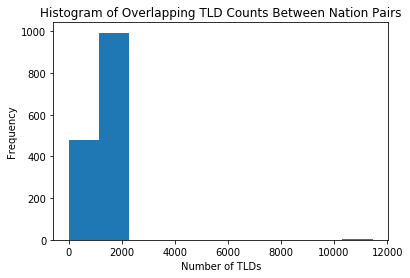

In [24]:
plt.hist(blocked_site_overlap['Overlap'])
plt.title('Histogram of Overlapping TLD Counts Between Nation Pairs')
plt.xlabel('Number of TLDs')
plt.ylabel('Frequency')
plt.show()

In [25]:
ordered_overlap = blocked_site_overlap.sort_values('Overlap', ascending = False)
ordered_overlap.head()

,Country 1,Country 2,Overlap,Country 1 Domains,Country 2 Domains
1474,United Arab Emirates,United Arab Emirates,11463,24537,24537
0,China,China,10714,15911,15911
1396,Russia,Russia,1488,5184,5184
738,Portugal,Malta,1263,1361,1361
705,Poland,Lithuania,1263,1361,1361


In [26]:
ordered_overlap.tail()

,Country 1,Country 2,Overlap,Country 1 Domains,Country 2 Domains
1184,Norway,Russia,0,1361,5184
1183,Lichtenstein,Russia,0,1361,5184
1182,Iceland,Russia,0,1361,5184
1181,United Kingdom,Russia,0,1361,5184
1253,India,Czech Republic,0,20,1361


In [27]:
blocked_site_overlap = pd.read_csv('blocked_site_overlap.csv')
blocked_site_overlap.drop(columns = ["Unnamed: 0"], inplace = True)
blocked_site_overlap.head()

,Country 1,Country 2,Overlap,Country 1 Domains,Country 2 Domains
0,China,China,10714,15911,15911
1,China,Austria,47,15911,1361
2,China,Belgium,47,15911,1361
3,China,Bulgaria,47,15911,1361
4,China,Croatia,47,15911,1361


In [28]:
blocked_site_overlap["1->2"] = blocked_site_overlap['Overlap'] / blocked_site_overlap['Country 1 Domains']
blocked_site_overlap["2->1"] = blocked_site_overlap['Overlap'] / blocked_site_overlap['Country 2 Domains']
blocked_site_overlap

,Country 1,Country 2,Overlap,Country 1 Domains,Country 2 Domains,1->2,2->1
0,China,China,10714,15911,15911,0.673371,0.673371
1,China,Austria,47,15911,1361,0.002954,0.034533
2,China,Belgium,47,15911,1361,0.002954,0.034533
3,China,Bulgaria,47,15911,1361,0.002954,0.034533
4,China,Croatia,47,15911,1361,0.002954,0.034533
5,China,Cyprus,47,15911,1361,0.002954,0.034533
6,China,Czech Republic,47,15911,1361,0.002954,0.034533
7,China,Denmark,47,15911,1361,0.002954,0.034533
8,China,Estonia,47,15911,1361,0.002954,0.034533
9,China,Finland,47,15911,1361,0.002954,0.034533


In [30]:
all_countries = gdpr_nations + country_names
print(all_countries)
print(len(all_countries))

['Austria', 'Belgium', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 'Netherlands', 'Poland', 'Portugal', 'Romania', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'United Kingdom', 'Iceland', 'Lichtenstein', 'Norway', 'China', 'GDPR', 'India', 'Iraq', 'Pakistan', 'Russia', 'Saudi Arabia', 'United Arab Emirates']
39


In [30]:
for c in all_countries:
    filtered_overlap_df = blocked_site_overlap.loc[(blocked_site_overlap["Country 1"] == c) & (blocked_site_overlap["Country 2"] != c)]
    filtered_overlap_df.to_json("data/" + c + "_block_ratios.csv")

## Calculate cosine similarities

### Trial on China, Saudi Arabia

In [31]:
gdpr.head()

,Name,Date Unblocked,Website,Archived Block Message[0],Archived Block Message[1],Block Message Screenshot,Website Archives[0],Website Archives[1],URL
0,5 News KFSM,NaN,https://5newsonline.com,https://archive.fo/Lwl88,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/https://5newsonl...,NaN,https://5newsonline.com
1,99acres,NaN,https://www.99acres.com,https://archive.fo/24l2Q,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/https://www.99ac...,NaN,https://www.99acres.com
2,Aberdeen News,NaN,https://www.aberdeennews.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,NaN,NaN,https://www.aberdeennews.com
3,Abington Mariner,NaN,http://abington.wickedlocal.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,https://web.archive.org/web/2/http://abington....,NaN,http://abington.wickedlocal.com
4,"Ad Express & Daily Iowegian (Centerville, IA)",NaN,https://www.dailyiowegian.com,NaN,NaN,https://data.verifiedjoseph.com/files/gdpr-scr...,NaN,NaN,https://www.dailyiowegian.com


In [32]:
gdpr.drop(gdpr.columns.difference(['Website']), 1, inplace = True)
gdpr.head()

,Website
0,https://5newsonline.com
1,https://www.99acres.com
2,https://www.aberdeennews.com
3,http://abington.wickedlocal.com
4,https://www.dailyiowegian.com


In [33]:
gdpr.rename(columns = {"Website": "URL"}, inplace = True)
gdpr.head()

,URL
0,https://5newsonline.com
1,https://www.99acres.com
2,https://www.aberdeennews.com
3,http://abington.wickedlocal.com
4,https://www.dailyiowegian.com


In [34]:
country_url_dfs = [china, gdpr, india, iraq, pak, rus, saudi_arabia, uae]

In [35]:
combined_url_df = pd.concat(country_url_dfs, axis = 0)
combined_url_df.head()

,URL
0,www.a00.com
1,a0006.in2000.com
2,a1.sparklancer.com
3,a1234.uhome.net
4,a1234bc.uhome.net


In [36]:
combined_url_df.shape

(49012, 1)

In [37]:
combined_url_df.dropna(inplace = True)
combined_url_df.shape

(49012, 1)

In [38]:
combined_domains = list(combined_url_df['URL'].apply(lambda d: tldextract.extract(d)[1]))
combined_domains[:5]

['a00', 'in2000', 'sparklancer', 'uhome', 'uhome']

In [39]:
len(combined_domains)

49012

In [40]:
combined_domains = np.array(combined_domains)

In [41]:
combined_domains

array(['a00', 'in2000', 'sparklancer', ..., 'expatriates', 'expatriates',
       '10333'], dtype='<U49')

In [42]:
unique_combined = np.unique(combined_domains)
unique_combined

array(['', '00-24', '000a', ..., 'zzn', 'легалрц', 'легально'],
      dtype='<U49')

In [43]:
len(unique_combined)

25435

In [44]:
unique_combined = unique_combined[(unique_combined != ' ') & (unique_combined != '')]
len(unique_combined)

25434

In [ ]:
country_names = ["China", "GDPR", "India", "Iraq", "Pakistan", "Russia", "Saudi Arabia", "United Arab Emirates", "United States"]
country_names.remove("GDPR")
country_names = gdpr_nations + country_names
country_names

In [46]:
# map countries to their respective dfs
# country_url_dfs = [china, gdpr, india, iraq, pak, rus, saudi_arabia, uae]
country_df_map = {}
for c in country_names:
    if c == 'China':
        country_df_map[c] = country_url_dfs[0]
    elif c in gdpr_nations:
        country_df_map[c] = country_url_dfs[1]
    elif c == 'India':
        country_df_map[c] = country_url_dfs[2]
    elif c == 'Iraq':
        country_df_map[c] = country_url_dfs[3]
    elif c == 'Pakistan':
        country_df_map[c] = country_url_dfs[4]
    elif c == 'Russia':
        country_df_map[c] = country_url_dfs[5]
    elif c == 'Saudi Arabia':
        country_df_map[c] = country_url_dfs[6]
    elif c == 'United Arab Emirates':
        country_df_map[c] = country_url_dfs[7]

In [47]:
import re

In [ ]:
country_domains_list = []
similarity_df = pd.DataFrame(columns=['Country 1', 'Country 2', 'Similarity'])
common_domains_dict = {}

count = 0
for c1 in country_names:
    for c2 in country_names[count:]:
        if c1 == c2:
#             continue
#             similarity_df = similarity_df.append({'Country 1': c1, 'Country 2': c2, 'Similarity': 0}, ignore_index=True)
            continue
        print(c1, c2)
        c1_df = country_df_map[c1]
        c2_df = country_df_map[c2]
        lst_c1 = list(c1_df['URL'])
        lst_c2 = list(c2_df['URL'])
        c1_domains = [tldextract.extract(d).domain for d in lst_c1]
#         c1_ends = lst_c1.apply(lambda d: d[-3:])
        c2_domains = [tldextract.extract(d).domain for d in lst_c2]
#         c2_ends = list(c2_df['URL']).apply(lambda d: d[-3:])
#         common_domains = list(set(c1_domains) & set(c2_domains))
        common_domains = []
        common_ends = []
        common_domains_dict[(c1, c2)] = []
        already_dom = []
        for cd in lst_c1 + lst_c2:
            tld_curr = tldextract.extract(cd)
            if tld_curr.domain in c1_domains and tld_curr.domain in c2_domains and tld_curr.domain not in already_dom:
                print(tld_curr.domain)
#                 common_domains.append(tld_curr)
#                 common_ends.append(cd[-3:])
                already_dom.append(tld_curr.domain)
                common_domains_dict[(c1, c2)] += [[tld_curr.domain, tld_curr.suffix]]
#         similarity_df = similarity_df.append({'Country 1': c1, 'Country 2': c2, 'Similarity': len(common_domains) / len(unique_combined)}, ignore_index=True)
    count += 1

Austria Belgium
5newsonline
99acres
aberdeennews
wickedlocal
dailyiowegian
agcanada
agdealer
agrinews-pubs
agupdate
ahwatukee
aikenstandard
aimmediatexas
airthinx
democratherald
albertafarmexpress
aledotimesrecord
alicetx
alliancetimes
alliednews
amny
amarillo
americanmediainc
americanmilitarynews
americanpress
amestrib
adn
anchoragepress
andovertownsman
apg-wi
apgwest
appeal-democrat
northfulton
argus-press
tucson
azdailysun
willcoxrangenews
ashepostandtimes
ashleycountyledger
aspendailynews
atchisonglobenow
onlineathens
athensreview
atlanticcityweekly
auburnjournal
augustagazette
auroraadvertiser
autoweb
averyjournal
bakersfield
citypaper
baltimoresun
bangordailynews
barnesville-enterprise
examiner-enterprise
baseballhq
bastropenterprise
batesvilleheraldtribune
baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
bo

isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjo

grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
ioscone

insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec


thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreite
utdailybeacon
dailycom

hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirr

houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cb

greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
j

gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforne

galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonh

hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirr

fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsour

heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
k

ashepostandtimes
ashleycountyledger
aspendailynews
atchisonglobenow
onlineathens
athensreview
atlanticcityweekly
auburnjournal
augustagazette
auroraadvertiser
autoweb
averyjournal
bakersfield
citypaper
baltimoresun
bangordailynews
barnesville-enterprise
examiner-enterprise
baseballhq
bastropenterprise
batesvilleheraldtribune
baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
campleje

thesouthern
staugustine
thechronicleonline
stlamerican
standard-journal
southcoasttoday
shelbystar
starfl
starbeacon
stardem
sj-r
stwnewspress
thesuburban
thesuburbanite
ssnewstelegram
thesunchronicle
thesuntimes
suncoastnews
thesylvaherald
thetelegraph
tiftongazette
thetigernews
tillamookheadlightherald
houmatimes
thetandd
timesherald
timesleader
nwitimes
thetimesnews
timesreporter
titusvilleherald
cjonline
thetrailblazeronline
trentonian
tribdem
trinidadexpress
tuscaloosanews
unionrecorder
thevermilion
videtteonline
thevillagesdailysun
villanovan
suncommercial
thevindicator
virginislandsdailynews
vagazette
pilotonline
union-bulletin
waltonsun
waltontribune
warrenrecord
washburnreview
wcfcourier
wayneindependent
minicassia
beacononlinenews
producer
wickenburgsun
winchesterstar
theworldlink
newsmirror
timessentinel
thepilot
dailycomet
thisweeknews
timesenterprise
chroniclejournal
recordonline
thetimestribune
timeswv
times-gazette
times-georgian
timesdaily
tiogapublishing
havasunews
too

abilene-rc
theadanews
adamscountyextra
theadvocate
stamfordadvocate
advocateanddemocrat
albanyherald
the-review
thealmanac
alvinsun
americanisraelite
amtrib
annistonstar
apalachtimes
thearabtribune
argusobserver
uatrav
athensmessenger
athensnews
augustachronicle
avenuenews
banderabulletin
brenhambanner
barnstablepatriot
thebatt
baytownsun
tbrnews
beaumontenterprise
berkeleyind
bismarcktribune
theblacksheartimes
brandonsun
breezejmu
brownsvilleherald
thebrunswicknews
bryantimes
theeagle
esubulletin
norwichbulletin
woonsocketcall
carmitimes
carthagepress
caswellmessenger
cavaliercountyextra
thechartonline
thechiefnews
thechiefleader
chippewa
chronicle-express
auburnpub
theclarionnews
advocatepress
thecolgatemaroonnews
columbiachronicle
dispatch
conwaydailysun
lincolncourier
courier-tribune
ctnewsonline
creightonian
crescent-news
cullmantimes
dailyamerican
thedaonline
chronline
dailycitizen
psu
kelownadailycourier
thedigitalcourier
hendersondispatch
dailyhelmsman
columbiadailyherald
ridge

rushvillerepublican
sahuaritasun
salamancapress
salina
sanfernandosun
smdailyjournal
bensonnews-sun
santamariatimes
srpressgazette
syvnews
savannahnow
starherald
seattlepi
sedaliademocrat
seguingazette
sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siskiyoudaily
goskagit
sleepyeyenews
scsuntimes
soapoperadigest
somdnews
sonomawest
southbendtribune
magicvalley
southstrandnews
southernchestercountyweeklies
ricentral
southernminn
sulphurdailynews
swtimes
spoonuniversity
newsaegis
stjamesnews
sjnewsonline
stljewishlight
stltoday
rexburgstandardjournal
starmagazine
starcourier
starlocalmedia
starnewsonline
statesville
yourstephenvilletx
steubencourier
stowetoday
sturgisjournal
stuttgartdailyleader
sunad
newbernsj
yoursun
sun-sentinel
sussexcountian
sustainablecitynetwork
suwanneedemocrat
swiowanewssource
swnewsmedia
swvatoday
journaldemocrat
taftmidwaydriller
tahlequahdailypress
tbnweekly
tauntongazette
tdtnews
technicianonline
tehachapinews
telegram
telegra

koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississipp

news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
posts

kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-on

newjerseyhills
nydailynews
newarkpostonline
newcomerstown-news
newportindependent
greensboro
news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
p

inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journal

manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesnews
moscowvillager
dnews
motosport
moultrienews
mtshastanews
mountain-news
murrayledger
muscatinejournal
muscleandfitness
musiciansfriend
myhorrynews
myeasternshoremd
mysoutex
mytownneo
mywnynews
napavalleyregister
ncaa
nationalenquirer
wvnews
ndinsider
ncnewspress
communitynewspapergroup
neoshodailynews
nevadaiowajournal
ncnewsonline
nhregister
newjerseyhills
nydailynews
newarkpostonline
newcomerst

flyafter5
fontanaheraldnews
foodincanada
food52
fbherald
forthoodsentinel
times-journal
fortworthbusiness
fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
hera

news-bulletin
valleymorningstar
yourvalleyvoice
vanalstyneleader
vanburencountydem
victoriaadvocate
vvdailypress
voicenews
voiceofalexandria
voxmagazine
wacotrib
wahoo-ashland-waverly
wahpetondailynews
waow
wapt
chipleypaper
washtimesherald
washingtontimesreporter
wataugademocrat
watchdog
wdtimes
waxahachietx
wcoutlook
waynepost
waynesvilledailyguide
wbal
wbaltv
wbir
wbng
wcnc
wcvb
dcw50
wdel
wdsu
weatherfarm
weatherforddemocrat
week
wellingtondailynews
wellsvilledaily
wesh
wpnews
westvalleyview
westernherald
westport-news
wfaa
wfmynews2
wgal
wgem
wgnradio
wgntv
wgno
wgrz
whas11
whitehalljournal
wmicentral
whnt
hoiabc
whotv
journalpatriot
williamsondailynews
willistonherald
winnipegfreepress
winonadailynews
journalnow
wiscnews
wisconsingazette
wisn
wjcl
wkow
wkyc
wlky
wltx
wlwt
13wmaz
mor-tv
wmtw
wmur
wnep
woodfordtimes
woodwardnews
wpbf
phl17
pix11
wpta21
mynbc5
wqad
wqow
wreg
wrex
wsmv
wspynews
wtae
wtkr
firstcoastnews
wtsp
wtvr
wtxl
wusa9
13newsnow
wvtm13
wvva
wwltv
mysuncoast
11ali

independentri
dailyindependent
independentnews
alligator
indianagazette
ack
theintell
ioniannews
joplinglobe
thejournal-news
journalstandard
kykernel
dailytimes
kdhnews
laconiadailysun
lakenewsonline
thelandonline
the-leader
covingtonleader
reporter
theledger
leeclarion
livingstonparishnews
loganbanner
logandaily
lompocrecord
lufkindailynews
macombdaily
malibutimes
themercury
martinsvillebulletin
marysvilleonline
maryvilleforum
mcdonoughvoice
mcdowellnews
mcphersonsentinel
meadvilletribune
pottsmerc
meridianstar
the-messenger
messenger-inquirer
metrowestdailynews
mexicoledger
middletownpress
milforddailynews
mayportmirror
themonitor
monroenews
mtstandard
mooreamerican
mcall
scnow
themorningsun
moultrieobserver
themountainmail
themountainpress
themountaineer
murfreesboropost
muskogeephoenix
dailysentinel
nelighnews
newportplaintalk
kingstreenews
newsadvance
newsandtribune
enewscourier
thenewsguard
thenewsherald
morganton
newsitem
newsoforange
newsrecord
thenewsdispatch
thenewsenterprise

rockwallheraldbanner
therolladailynews
northwestgeorgianews
roysecityheraldbanner
runnelscountyregister
rushvillerepublican
sahuaritasun
salamancapress
salina
sanfernandosun
smdailyjournal
bensonnews-sun
santamariatimes
srpressgazette
syvnews
savannahnow
starherald
seattlepi
sedaliademocrat
seguingazette
sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siskiyoudaily
goskagit
sleepyeyenews
scsuntimes
soapoperadigest
somdnews
sonomawest
southbendtribune
magicvalley
southstrandnews
southernchestercountyweeklies
ricentral
southernminn
sulphurdailynews
swtimes
spoonuniversity
newsaegis
stjamesnews
sjnewsonline
stljewishlight
stltoday
rexburgstandardjournal
starmagazine
starcourier
starlocalmedia
starnewsonline
statesville
yourstephenvilletx
steubencourier
stowetoday
sturgisjournal
stuttgartdailyleader
sunad
newbernsj
yoursun
sun-sentinel
sussexcountian
sustainablecitynetwork
suwanneedemocrat
swiowanewssource
swnewsmedia
swvatoday
journaldemocrat
taftmidwaydril

montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesnews
moscowvillager
dnews
motosport
moultrienews
mtshastanews
mountain-news
murrayledger
muscatinejournal
muscleandfitness
musiciansfriend
myhorrynews
myeasternshoremd
mysoutex
mytownneo
mywnynews
napavalleyregister
ncaa
nationalenquirer
wvnews
ndinsider
ncnewspress
communitynewspapergroup
neoshodailynews
nevadaiowajournal
ncnewsonline
nhregister
newjerseyhills
nydailynews
newarkpostonline
newcomerstown-news
newportindependent
greensboro
news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
o

kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor

middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesnews
moscowvillager
dnews
motosport
moultrienews
mtshastanews
mountain-news
murrayledger
muscatinejournal
muscleandfitness
musiciansfriend
myhorrynews
myeasternshoremd
mysoutex
mytownneo
mywnynews
napavalleyregister
ncaa
nationalenquirer
wvnews
ndinsider
ncnewspress
communitynewspapergroup
neoshodailynews
nevadaiowajournal
ncnewsonline
nhregister
newjerseyhills
nydailynews
newarkpostonline
newcomerstown-news
newportindependent
greensboro
news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gaze

observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
postsouth
postbulletin
pressargus
presspubs
primepublishers
ptonline
prosperpressnews
ptleader
purdueexponent
q13fox
qctimes
qchron
radaronline
rapidcityjournal
ravallirepublic
rawlinstimes
therecordherald
record-courier
redwoodfallsgazette
richlandsource
richmondregister
richmond
riograndesun


lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesnews
moscowvillager
dnews
motosport
moultrienews
mtshastanews
mountain-news
murrayledger
muscatinejournal
muscleandfitness
musiciansfriend
myhorrynews
myeast

kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmess

michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetrib

hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpre

hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykre

heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
k

hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalrevi

kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
repub

gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
mich

capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreit

baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
camplejeuneglobe
canadiancattlemen
capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygann

laconiadailysun
lakenewsonline
thelandonline
the-leader
covingtonleader
reporter
theledger
leeclarion
livingstonparishnews
loganbanner
logandaily
lompocrecord
lufkindailynews
macombdaily
malibutimes
themercury
martinsvillebulletin
marysvilleonline
maryvilleforum
mcdonoughvoice
mcdowellnews
mcphersonsentinel
meadvilletribune
pottsmerc
meridianstar
the-messenger
messenger-inquirer
metrowestdailynews
mexicoledger
middletownpress
milforddailynews
mayportmirror
themonitor
monroenews
mtstandard
mooreamerican
mcall
scnow
themorningsun
moultrieobserver
themountainmail
themountainpress
themountaineer
murfreesboropost
muskogeephoenix
dailysentinel
nelighnews
newportplaintalk
kingstreenews
newsadvance
newsandtribune
enewscourier
thenewsguard
thenewsherald
morganton
newsitem
newsoforange
newsrecord
thenewsdispatch
thenewsenterprise
winchesternewsgazette
nrtoday
newstimes
hartfordcitynewstimes
thekansan
normantranscript
northaugustastar
northcoastcitizen
nptelegraph
thehour
ocolly
oakridger
theoakl

stuttgartdailyleader
sunad
newbernsj
yoursun
sun-sentinel
sussexcountian
sustainablecitynetwork
suwanneedemocrat
swiowanewssource
swnewsmedia
swvatoday
journaldemocrat
taftmidwaydriller
tahlequahdailypress
tbnweekly
tauntongazette
tdtnews
technicianonline
tehachapinews
telegram
telegraphherald
telluridenews
tetonvalleynews
teutopolispress
trinityjournal
abilene-rc
theadanews
adamscountyextra
theadvocate
stamfordadvocate
advocateanddemocrat
albanyherald
the-review
thealmanac
alvinsun
americanisraelite
amtrib
annistonstar
apalachtimes
thearabtribune
argusobserver
uatrav
athensmessenger
athensnews
augustachronicle
avenuenews
banderabulletin
brenhambanner
barnstablepatriot
thebatt
baytownsun
tbrnews
beaumontenterprise
berkeleyind
bismarcktribune
theblacksheartimes
brandonsun
breezejmu
brownsvilleherald
thebrunswicknews
bryantimes
theeagle
esubulletin
norwichbulletin
woonsocketcall
carmitimes
carthagepress
caswellmessenger
cavaliercountyextra
thechartonline
thechiefnews
thechiefleader
chipp

newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
postsouth
p

heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
k

carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreite
utdailybeacon
dailycommercial
heraldextra
rrdailyherald
iberianet
dailyunion
daily-journ

mayportmirror
themonitor
monroenews
mtstandard
mooreamerican
mcall
scnow
themorningsun
moultrieobserver
themountainmail
themountainpress
themountaineer
murfreesboropost
muskogeephoenix
dailysentinel
nelighnews
newportplaintalk
kingstreenews
newsadvance
newsandtribune
enewscourier
thenewsguard
thenewsherald
morganton
newsitem
newsoforange
newsrecord
thenewsdispatch
thenewsenterprise
winchesternewsgazette
nrtoday
newstimes
hartfordcitynewstimes
thekansan
normantranscript
northaugustastar
northcoastcitizen
nptelegraph
thehour
ocolly
oakridger
theoaklandpress
oudaily
oskaloosa
ottawaherald
paducahsun
paintsvilleherald
pantagraph
theparisnews
parispi
mypatriotnews
patriotledger
thepauwwow
thepenn
pharostribune
phillytrib
walkermn
placerherald
postandcourier
poststar
pratttribune
thepress
pressandguide
pressofatlanticcity
pressrepublican
progress-index
providencejournal
thepublicopinion
chieftain
recordnet
record-eagle
redandblack
theredstonerocket
reflector-online
thereflector
registercitiz

swvatoday
journaldemocrat
taftmidwaydriller
tahlequahdailypress
tbnweekly
tauntongazette
tdtnews
technicianonline
tehachapinews
telegram
telegraphherald
telluridenews
tetonvalleynews
teutopolispress
trinityjournal
abilene-rc
theadanews
adamscountyextra
theadvocate
stamfordadvocate
advocateanddemocrat
albanyherald
the-review
thealmanac
alvinsun
americanisraelite
amtrib
annistonstar
apalachtimes
thearabtribune
argusobserver
uatrav
athensmessenger
athensnews
augustachronicle
avenuenews
banderabulletin
brenhambanner
barnstablepatriot
thebatt
baytownsun
tbrnews
beaumontenterprise
berkeleyind
bismarcktribune
theblacksheartimes
brandonsun
breezejmu
brownsvilleherald
thebrunswicknews
bryantimes
theeagle
esubulletin
norwichbulletin
woonsocketcall
carmitimes
carthagepress
caswellmessenger
cavaliercountyextra
thechartonline
thechiefnews
thechiefleader
chippewa
chronicle-express
auburnpub
theclarionnews
advocatepress
thecolgatemaroonnews
columbiachronicle
dispatch
conwaydailysun
lincolncourier
cou

prosperpressnews
ptleader
purdueexponent
q13fox
qctimes
qchron
radaronline
rapidcityjournal
ravallirepublic
rawlinstimes
therecordherald
record-courier
redwoodfallsgazette
richlandsource
richmondregister
richmond
riograndesun
rrobserver
rrstar
rockwallheraldbanner
therolladailynews
northwestgeorgianews
roysecityheraldbanner
runnelscountyregister
rushvillerepublican
sahuaritasun
salamancapress
salina
sanfernandosun
smdailyjournal
bensonnews-sun
santamariatimes
srpressgazette
syvnews
savannahnow
starherald
seattlepi
sedaliademocrat
seguingazette
sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siskiyoudaily
goskagit
sleepyeyenews
scsuntimes
soapoperadigest
somdnews
sonomawest
southbendtribune
magicvalley
southstrandnews
southernchestercountyweeklies
ricentral
southernminn
sulphurdailynews
swtimes
spoonuniversity
newsaegis
stjamesnews
sjnewsonline
stljewishlight
stltoday
rexburgstandardjournal
starmagazine
starcourier
starlocalmedia
starnewsonline
statesvill

kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingo

ncnewspress
communitynewspapergroup
neoshodailynews
nevadaiowajournal
ncnewsonline
nhregister
newjerseyhills
nydailynews
newarkpostonline
newcomerstown-news
newportindependent
greensboro
news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times


insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvil

lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesne

heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5


iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
li

groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxai

kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberl

free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
h

lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongoca

fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar

jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magno

caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreite
utdailybe

kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterp

northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
postsouth
postbulletin
pressargus
presspubs
primepublishers
ptonline
prosperpressnews
ptleader
purdueexponent
q13fox
qctimes
qchron
radaronline
rapidcityjournal
ravallirepublic
rawlinstime

ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
t

news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
posts

hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15a

mywnynews
napavalleyregister
ncaa
nationalenquirer
wvnews
ndinsider
ncnewspress
communitynewspapergroup
neoshodailynews
nevadaiowajournal
ncnewsonline
nhregister
newjerseyhills
nydailynews
newarkpostonline
newcomerstown-news
newportindependent
greensboro
news9
newschief
neagle
newson6
news-graphic
newspressnow
newstopicnews
9news
newsbug
newsday
newstrib
pressmentor
niagara-gazette
nogalesinternational
norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperry

ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lake

groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxai

averyjournal
bakersfield
citypaper
baltimoresun
bangordailynews
barnesville-enterprise
examiner-enterprise
baseballhq
bastropenterprise
batesvilleheraldtribune
baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
camplejeuneglobe
canadiancattlemen
capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
ca

waltonsun
waltontribune
warrenrecord
washburnreview
wcfcourier
wayneindependent
minicassia
beacononlinenews
producer
wickenburgsun
winchesterstar
theworldlink
newsmirror
timessentinel
thepilot
dailycomet
thisweeknews
timesenterprise
chroniclejournal
recordonline
thetimestribune
timeswv
times-gazette
times-georgian
timesdaily
tiogapublishing
havasunews
tootimid
topsailadvertiser
townnews
tctimes
tribuneledgernews
tribstar
tubitv
tucsonlocalmedia
tullahomanews
tulsacw
tulsaworld
tv6tnt
canoe
tylerpaper
ultimategarage
unifiednewsgroup
kansan
unroll
usmagazine
valdostadailytimes
news-bulletin
valleymorningstar
yourvalleyvoice
vanalstyneleader
vanburencountydem
victoriaadvocate
vvdailypress
voicenews
voiceofalexandria
voxmagazine
wacotrib
wahoo-ashland-waverly
wahpetondailynews
waow
wapt
chipleypaper
washtimesherald
washingtontimesreporter
wataugademocrat
watchdog
wdtimes
waxahachietx
wcoutlook
waynepost
waynesvilledailyguide
wbal
wbaltv
wbir
wbng
wcnc
wcvb
dcw50
wdel
wdsu
weatherfarm
weath

brandonsun
breezejmu
brownsvilleherald
thebrunswicknews
bryantimes
theeagle
esubulletin
norwichbulletin
woonsocketcall
carmitimes
carthagepress
caswellmessenger
cavaliercountyextra
thechartonline
thechiefnews
thechiefleader
chippewa
chronicle-express
auburnpub
theclarionnews
advocatepress
thecolgatemaroonnews
columbiachronicle
dispatch
conwaydailysun
lincolncourier
courier-tribune
ctnewsonline
creightonian
crescent-news
cullmantimes
dailyamerican
thedaonline
chronline
dailycitizen
psu
kelownadailycourier
thedigitalcourier
hendersondispatch
dailyhelmsman
columbiadailyherald
ridgecrestca
dailyitem
daily-jeff
pontiacdailyleader
cantondailyledger
dailynebraskan
jdnews
galvnews
bgdailynews
tdn
newburyportnews
nonpareilonline
dailyuw
dailyprogress
the-daily-record
dailyrecordnews
thedailyreporter
lsunow
thedailyreview
siftingsherald
thedailystar
lenconnect
thedailytimes
dailytoreador
jcdailyunion
dallasweekly
news-journalonline
decaturdaily
delrionewsherald
delcotimes
deltanews
derbyinformer

pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
postsouth
postbulletin
pressargus
presspubs
primepublishers
ptonline
prosperpressnews
ptleader
purdueexponent
q13fox
qctimes
qchron
radaronline
rapidcityjournal
ravallirepublic
rawlinstimes
therecordherald
record-courier
redwoodfallsgazette
richlandsource
richmondregister
richmond
riograndesun
rrobserver
rrstar
rockwallheraldbanner
therolladailynews
northwestgeorgianews
roysecityheraldbanner
runnelscountyregister
rushvillerepublican
sahuaritasun
salamancapress
salina
sanfernandosun
smdailyjournal
bensonnews-sun
santamariatimes
srpressgazette
syvnews
savannahnow
starherald
seattlepi
sedaliademocrat
seguingazette
sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siski

kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulane

iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
li

greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
j

wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreite
utdailybeacon
dailycommercial
heraldextra
rrdailyherald
iberianet
dailyunion
daily-journal
dailyjournalonline
dailylocal
mpnnow
dnronline
dailypress
reviewatlas
dailystarjournal
dailytribune
adelnews
dallasnews
dcmilitary
delaware1059
delconewsnetwork
ddtonline
dentonrc
derrynews
desototimes
devilslakejournal
dodgeglobe
donaldsonvillechief
dothaneagle
douglascountysentinel
douglasdispatch
doverpost
thecrier
dyersvillecommercial
eagletimes
eastpeoriatimescourier
eastvalleytribune
eacourier
easterniowashoppingnews
easternprogress
echo-pilot
edinburgreview
edmondsun
theintelligencer
en

yakimaherald
yankton
yorknewstimes
yourobserver
yumasun
Bulgaria Malta
5newsonline
99acres
aberdeennews
wickedlocal
dailyiowegian
agcanada
agdealer
agrinews-pubs
agupdate
ahwatukee
aikenstandard
aimmediatexas
airthinx
democratherald
albertafarmexpress
aledotimesrecord
alicetx
alliancetimes
alliednews
amny
amarillo
americanmediainc
americanmilitarynews
americanpress
amestrib
adn
anchoragepress
andovertownsman
apg-wi
apgwest
appeal-democrat
northfulton
argus-press
tucson
azdailysun
willcoxrangenews
ashepostandtimes
ashleycountyledger
aspendailynews
atchisonglobenow
onlineathens
athensreview
atlanticcityweekly
auburnjournal
augustagazette
auroraadvertiser
autoweb
averyjournal
bakersfield
citypaper
baltimoresun
bangordailynews
barnesville-enterprise
examiner-enterprise
baseballhq
bastropenterprise
batesvilleheraldtribune
baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhp

circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreite
utdailybeacon
dailycommercial
heraldextra
rrdailyherald
iberianet
dailyunion
daily-journal
dailyjournalonline
dailylocal
mpnnow
dnronline
dailypress
reviewatlas
dailystarjournal
dailytribune
adelnews
dallasnews
dcmilitary
delaware1059
delconewsnetwork
ddtonline
dentonrc
derrynews
desototimes
devilslakejournal
dodgeglobe
donaldsonvillechief
dothaneagle
douglascountys

food52
fbherald
forthoodsentinel
times-journal
fortworthbusiness
fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview

capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ct

theintelligencer
enterprise-journal
effinghamdailynews
leader-news
dchieftain
elextratx
elnuevoheraldo
elpasoinc
elvocero
elgincourier
egcitizen
elkvalleytimes
elkodaily
ellos
ellwoodcityledger
emissourian
empiretoday
emporiagazette
energy-tech
enidnews
enterprisepub
goerie
faceplusplus
newsminer
fairfaxtimes
farmforum
farmtalknewspaper
farmzilla
fauquier
feastmagazine
fiddleheadfocus
jaxdailyrecord
fltimes
flexonline
floydct
flyafter5
fontanaheraldnews
foodincanada
food52
fbherald
forthoodsentinel
times-journal
fortworthbusiness
fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklyc

blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
camplejeuneglobe
canadiancattlemen
capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdisp

eagletimes
eastpeoriatimescourier
eastvalleytribune
eacourier
easterniowashoppingnews
easternprogress
echo-pilot
edinburgreview
edmondsun
theintelligencer
enterprise-journal
effinghamdailynews
leader-news
dchieftain
elextratx
elnuevoheraldo
elpasoinc
elvocero
elgincourier
egcitizen
elkvalleytimes
elkodaily
ellos
ellwoodcityledger
emissourian
empiretoday
emporiagazette
energy-tech
enidnews
enterprisepub
goerie
faceplusplus
newsminer
fairfaxtimes
farmforum
farmtalknewspaper
farmzilla
fauquier
feastmagazine
fiddleheadfocus
jaxdailyrecord
fltimes
flexonline
floydct
flyafter5
fontanaheraldnews
foodincanada
food52
fbherald
forthoodsentinel
times-journal
fortworthbusiness
fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmme

beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
camplejeuneglobe
canadiancattlemen
capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickasha

enterprisepub
goerie
faceplusplus
newsminer
fairfaxtimes
farmforum
farmtalknewspaper
farmzilla
fauquier
feastmagazine
fiddleheadfocus
jaxdailyrecord
fltimes
flexonline
floydct
flyafter5
fontanaheraldnews
foodincanada
food52
fbherald
forthoodsentinel
times-journal
fortworthbusiness
fosters
fhtimes
fowlertribune
fox10tv
fox13now
fox17online
fox2now
kdvr
fox4kc
fox40
fox43
fox5sandiego
fox59
fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hm

heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlingtoncountytimes
burnettcountysentinel
businessobserverfl
businessnorth
butlercountytimesgazette
cadillacnews
calaverasenterprise
caledonianrecord
cambridgechron
camplejeuneglobe
canadiancattlemen
capecodtimes
capemaycountyherald
capitalgazette
capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiami

capjournal
caranddriver
thecarbondalenews
carolinacoastonline
carrabbas
carriagetownenews
carrollcountytimes
cpioneer
trib
cbs4indy
cecildaily
cedarrepublican
celebretainment
southjerseylocalnews
centraljersey
wvgazettemail
charlestonexpress
cheboygannews
sekvoice
chicagotribune
chickashanews
chillicothetimesbulletin
cgtn
championnewspapers
choteauacantha
ccheadliner
circlevilleherald
citizentribune
chronicleonline
claremoreprogress
pressregister
ccenterdispatch
news-daily
theprogressnews
cleburnetimesreview
clevelandjewishnews
clintonherald
cltv
cnhi
codyenterprise
collectorsjournal
wkuherald
collegiatetimes
columbiatribune
columbiamissourian
columbustelegram
commercial-news
somerset-kentucky
cnweekly
bladeempire
ctpost
chillicothenews
coopercrier
coronadonewsca
corsicanadailysun
gazettetimes
country-guide
countrymedia
thecourierexpress
mycouriertribune
creightonnews
crestviewbulletin
crookstontimes
crossville-chronicle
crowrivermedia
ctnow
starexponent
times-news
sflcw
cw39
ardmoreit

thetrailblazeronline
trentonian
tribdem
trinidadexpress
tuscaloosanews
unionrecorder
thevermilion
videtteonline
thevillagesdailysun
villanovan
suncommercial
thevindicator
virginislandsdailynews
vagazette
pilotonline
union-bulletin
waltonsun
waltontribune
warrenrecord
washburnreview
wcfcourier
wayneindependent
minicassia
beacononlinenews
producer
wickenburgsun
winchesterstar
theworldlink
newsmirror
timessentinel
thepilot
dailycomet
thisweeknews
timesenterprise
chroniclejournal
recordonline
thetimestribune
timeswv
times-gazette
times-georgian
timesdaily
tiogapublishing
havasunews
tootimid
topsailadvertiser
townnews
tctimes
tribuneledgernews
tribstar
tubitv
tucsonlocalmedia
tullahomanews
tulsacw
tulsaworld
tv6tnt
canoe
tylerpaper
ultimategarage
unifiednewsgroup
kansan
unroll
usmagazine
valdostadailytimes
news-bulletin
valleymorningstar
yourvalleyvoice
vanalstyneleader
vanburencountydem
victoriaadvocate
vvdailypress
voicenews
voiceofalexandria
voxmagazine
wacotrib
wahoo-ashland-waverly
wah

tdn
newburyportnews
nonpareilonline
dailyuw
dailyprogress
the-daily-record
dailyrecordnews
thedailyreporter
lsunow
thedailyreview
siftingsherald
thedailystar
lenconnect
thedailytimes
dailytoreador
jcdailyunion
dallasweekly
news-journalonline
decaturdaily
delrionewsherald
delcotimes
deltanews
derbyinformer
thederrick
thedestinlog
qconline
the-dispatch
duncanbanner
eagletribune
theeastcarolinian
eldoradotimes
elkharttruth
enquirerjournal
enterprisenews
capenews
eveningtribune
examiner
thefacts
fayettetribune
fayobserver
jacksonville
theflume
fortcampbellcourier
thefranklinnewspost
kinston
mankatofreepress
holtindependent
gadsdentimes
gainesville
galtheraldonline
gctelegram
thegardnernews
gastongazette
gazettextra
ourgazette
yourgv
glendalestar
greenevillesun
gwcommonwealth
gridleyherald
griffindailynews
hgazette
thehawkeye
hdnews
helena-arkansas
sharonherald
heraldbulletin
hjnews
heraldnews
herald-dispatch
heraldpalladium
heraldstandard
herald-zeitung
timestelegram
thehockeynews
hollands

sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siskiyoudaily
goskagit
sleepyeyenews
scsuntimes
soapoperadigest
somdnews
sonomawest
southbendtribune
magicvalley
southstrandnews
southernchestercountyweeklies
ricentral
southernminn
sulphurdailynews
swtimes
spoonuniversity
newsaegis
stjamesnews
sjnewsonline
stljewishlight
stltoday
rexburgstandardjournal
starmagazine
starcourier
starlocalmedia
starnewsonline
statesville
yourstephenvilletx
steubencourier
stowetoday
sturgisjournal
stuttgartdailyleader
sunad
newbernsj
yoursun
sun-sentinel
sussexcountian
sustainablecitynetwork
suwanneedemocrat
swiowanewssource
swnewsmedia
swvatoday
journaldemocrat
taftmidwaydriller
tahlequahdailypress
tbnweekly
tauntongazette
tdtnews
technicianonline
tehachapinews
telegram
telegraphherald
telluridenews
tetonvalleynews
teutopolispress
trinityjournal
abilene-rc
theadanews
adamscountyextra
theadvocate
stamfordadvocate
advocateanddemocrat
albanyherald
the-review
thealmanac
alvinsun


jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manc

norfolkdailynews
njeffersonnews
northneighbornews
northcentralpa
djournal
northernstar
nwfdailynews
nwmissourinews
recordstar
nuvo
uticaod
observer-reporter
ocala
oconeeenterprise
oaoa
kfor
oleantimesherald
olneydailymail
omaha
oanow
orangemedianetwork
orangeobserver
oriongazette
orlandosentinel
ormondbeachobserver
oswegocountynewsnow
ottumwacourier
outback
obsentinel
palestineherald
palmcoastobserver
pvvt
newsherald
paris-express
parkerpioneer
parsonssun
paulsvalleydailydemocrat
pawhuskajournalcapital
pawtuckettimes
paysonroundup
pekintimes
pellachronicle
pvnews
pentictonherald
theperrychief
perryvillenews
petoskeynews
philadelphiaweekly
picayune-times
pinalcentral
pbcommercial
pinecitymn
post-gazette
myplainview
plantcityobserver
poconorecord
portlavacawave
portorangeobserver
recorderonline
portlandscw
seacoastonline
postregister
postsouth
postbulletin
pressargus
presspubs
primepublishers
ptonline
prosperpressnews
ptleader
purdueexponent
q13fox
qctimes
qchron
radaronline
rapidcityjou

homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonvilleprogress
jaxairnews
jessicalondon
jewishaz
jg-tc
journalinquirer
journalreview
journalscene
pjstar
journaltimes
myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11

leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly
montenews
montgomery-herald
montgomerynews
montrosepress
mooresvilletribune
themoreheadnews
morganhilltimes
morningsun
morning-times
morongocasinoresort
mortontimesnews
moscowvillager
dnews
motosport
moultrienews
mtshastanews
mountain-news
murrayledger
muscatinejournal
muscleandfitness
mus

greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrecorder
inforney
insideradio
insidetucsonbusiness
insidenova
insightnews
instapaper
ifallsjournal
investorjunkie
sentinel-standard
iosconews
iowastatedaily
isustudentmedia
ithaca
jcsentinel
jhnewsandguide
jacksonnewspapers
jacksonprogress-argus
jacksonv

cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
v

globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale
hngnews
hockessincommunitynews
homemagonline
homenewshere
hometownsource
hopestar
hsvvoice
houmatoday
chron
houstonherald
michigansthumb
mtexpress
idahopress
idahostatejournal
ifiberone
ilnews
ivpressonline
helenair
independenttribune
indexjournal
indiaabroad
indiawest
indianapolisrec

myjournalcourier
kagstv
kare11
katytimes
kbjr6
12newsnow
kcci
kcentv
kcra
kctv5
cw33
kearneyhub
kenoshanews
kens5
kentuckybarkleynews
kentuckynewera
kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday

fox6now
fox61
fox8
myfox8
fredericknewspost
fredericksburg
free-times
fremonttribune
fullbeauty
gainesvilleregister
galvanews
gannett
gazettes
dansvilleonline
geneseorepublic
gettysburgtimes
gillettenewsrecord
farmmedia
gladstonedispatch
glasgowdailytimes
yourglenrosetx
globemagazine
globegazette
gloucestertimes
godanriver
goldenstatenewspapers
weeklycitizen
goshennews
grainews
theindependent
gjsentinel
grandlakenews
grandrapidsmn
granitefallsnews
journal-times
greenacressells
gvnews
greensburgdailynews
heraldbanner
greenwichtime
greenwooddemocrat
groupetva
postguam
thegurdontimes
gwinnettdailypost
hmbreview
hamburgreporter
hannapub
hannibal
harborcountry-news
harrisondaily
courant
hastingstribune
havenews
blueridgenow
flyergroup
henryherald
herald-review
heraldandnews
heraldchronicle
heralddemocrat
myheraldreview
heraldargus
goupstate
heraldmailmedia
heraldtribune
hidesertstar
hiawathaworldonline
hibbingmn
hickoryrecord
hpj
hpenews
highcountrync
highlandnews
hillsborobanner
hillsdale


kentwired
ketv
kgw
4029tv
khou
kiiitv
king5
kiowacountysignal
kirksvilledailyexpress
kmaland
kmbc
journalexpress
koat
koco
kodiakdailymirror
kokomoperspective
kokomotribune
kpcnews
kplr11
kpvi
krem
krispykreme
ksbw
ksdk
ktbs
thv11
ktiv
ktla
kttc
ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
o

americanmilitarynews
americanpress
amestrib
adn
anchoragepress
andovertownsman
apg-wi
apgwest
appeal-democrat
northfulton
argus-press
tucson
azdailysun
willcoxrangenews
ashepostandtimes
ashleycountyledger
aspendailynews
atchisonglobenow
onlineathens
athensreview
atlanticcityweekly
auburnjournal
augustagazette
auroraadvertiser
autoweb
averyjournal
bakersfield
citypaper
baltimoresun
bangordailynews
barnesville-enterprise
examiner-enterprise
baseballhq
bastropenterprise
batesvilleheraldtribune
baycitytribune
bctv
beatricedailysun
beauregarddailynews
timesonline
belgrade-news
bcdemocratonline
bgfalconmedia
bigbeargrizzly
billoreilly
billingsgazette
goblackfin
bhpioneer
bloominbrands
bloxcms
bdtonline
blufftontoday
boarsheadresort
bolivarmonews
bonefishgrill
newsrepublican
boonevilledemocrat
boonvilledailynews
linkbostonhomes
bozemandailychronicle
bradfordera
bransontrilakesnews
heraldcourier
brownwoodtx
brylanehome
buckscountycouriertimes
buckslocalnews
buffalobulletin
buffaloreflex
burlin

lompocrecord
lufkindailynews
macombdaily
malibutimes
themercury
martinsvillebulletin
marysvilleonline
maryvilleforum
mcdonoughvoice
mcdowellnews
mcphersonsentinel
meadvilletribune
pottsmerc
meridianstar
the-messenger
messenger-inquirer
metrowestdailynews
mexicoledger
middletownpress
milforddailynews
mayportmirror
themonitor
monroenews
mtstandard
mooreamerican
mcall
scnow
themorningsun
moultrieobserver
themountainmail
themountainpress
themountaineer
murfreesboropost
muskogeephoenix
dailysentinel
nelighnews
newportplaintalk
kingstreenews
newsadvance
newsandtribune
enewscourier
thenewsguard
thenewsherald
morganton
newsitem
newsoforange
newsrecord
thenewsdispatch
thenewsenterprise
winchesternewsgazette
nrtoday
newstimes
hartfordcitynewstimes
thekansan
normantranscript
northaugustastar
northcoastcitizen
nptelegraph
thehour
ocolly
oakridger
theoaklandpress
oudaily
oskaloosa
ottawaherald
paducahsun
paintsvilleherald
pantagraph
theparisnews
parispi
mypatriotnews
patriotledger
thepauwwow
thepen

chronline
dailycitizen
psu
kelownadailycourier
thedigitalcourier
hendersondispatch
dailyhelmsman
columbiadailyherald
ridgecrestca
dailyitem
daily-jeff
pontiacdailyleader
cantondailyledger
dailynebraskan
jdnews
galvnews
bgdailynews
tdn
newburyportnews
nonpareilonline
dailyuw
dailyprogress
the-daily-record
dailyrecordnews
thedailyreporter
lsunow
thedailyreview
siftingsherald
thedailystar
lenconnect
thedailytimes
dailytoreador
jcdailyunion
dallasweekly
news-journalonline
decaturdaily
delrionewsherald
delcotimes
deltanews
derbyinformer
thederrick
thedestinlog
qconline
the-dispatch
duncanbanner
eagletribune
theeastcarolinian
eldoradotimes
elkharttruth
enquirerjournal
enterprisenews
capenews
eveningtribune
examiner
thefacts
fayettetribune
fayobserver
jacksonville
theflume
fortcampbellcourier
thefranklinnewspost
kinston
mankatofreepress
holtindependent
gadsdentimes
gainesville
galtheraldonline
gctelegram
thegardnernews
gastongazette
gazettextra
ourgazette
yourgv
glendalestar
greenevillesun
gw

therolladailynews
northwestgeorgianews
roysecityheraldbanner
runnelscountyregister
rushvillerepublican
sahuaritasun
salamancapress
salina
sanfernandosun
smdailyjournal
bensonnews-sun
santamariatimes
srpressgazette
syvnews
savannahnow
starherald
seattlepi
sedaliademocrat
seguingazette
sent-trib
news-star
shelbyvilledailyunion
shoes
shorelinemedia
siouxcityjournal
siskiyoudaily
goskagit
sleepyeyenews
scsuntimes
soapoperadigest
somdnews
sonomawest
southbendtribune
magicvalley
southstrandnews
southernchestercountyweeklies
ricentral
southernminn
sulphurdailynews
swtimes
spoonuniversity
newsaegis
stjamesnews
sjnewsonline
stljewishlight
stltoday
rexburgstandardjournal
starmagazine
starcourier
starlocalmedia
starnewsonline
statesville
yourstephenvilletx
steubencourier
stowetoday
sturgisjournal
stuttgartdailyleader
sunad
newbernsj
yoursun
sun-sentinel
sussexcountian
sustainablecitynetwork
suwanneedemocrat
swiowanewssource
swnewsmedia
swvatoday
journaldemocrat
taftmidwaydriller
tahlequahdailypre

ktvb
kvue
kwwl
myfox47
abc10
fox15abilene
cbs19
youralaskalink
lacrossetribune
lajuntatribunedemocrat
lavozlancaster
laduenews
lakecountyexam
lakegenevanews
lakeexpo
lancasterfarming
lancasteronline
laramieboomerang
lmtonline
lebulletin
journaldequebec
leavenworthtimes
lebanon-express
lee
leesvilledailyleader
lmtribune
lexch
lifebuzz
journalstar
lincolntimesnews
linncountyleader
lockportjournal
lodinews
thecabin
news-journal
ladowntownnews
laloyolan
latimes
loudountimes
lubbockonline
madison
magnoliareporter
mainlinemedianews
manchesterpress
manitobacooperator
manoanow
mdjonline
marinscope
usatoday
marshallnewsmessenger
frontiersman
mcalesternews
mebaneenterprise
mensjournal
virginiamn
messagemedia
republic-online
miamiok
middletowntranscript
ourmidland
mrt
midlothianmirror
milfordbeacon
militarynews
newstribune
mineralwellsindex
mingomessenger
mississippivalleypublishing
missoulanews
missoulian
moabsunnews
moberlymonitor
mohavedailynews
monroecopost
montanakaimin
montereycountyweekly


In [85]:
common_domains_dict[('China', 'Russia')]
# china['URL'].apply(lambda d: tldextract.extract(d))

[['tripod', 'com'],
 ['w3', 'to'],
 ['eu', 'org'],
 ['dyndns', 'org'],
 ['blogspot', 'com'],
 ['islam', 'com'],
 ['made-in-china', 'com'],
 ['news', 'at'],
 ['888', 'com.tw']]

In [87]:
final_common_domains = pd.DataFrame(columns=['Country 1', 'Country 2', 'Domain', 'Suffix'])
for k, v in common_domains_dict.items():
    c1, c2 = k
    for r in v:
        domain, suffix = r
        print(c1, c2, domain, suffix)
        final_common_domains = final_common_domains.append({'Country 1': c1, 'Country 2': c2, 'Domain': domain, 'Suffix': suffix}, ignore_index = True)
final_common_domains.head()

Austria Belgium 5newsonline com
Austria Belgium 99acres com
Austria Belgium aberdeennews com
Austria Belgium wickedlocal com
Austria Belgium dailyiowegian com
Austria Belgium agcanada com
Austria Belgium agdealer com
Austria Belgium agrinews-pubs com
Austria Belgium agupdate com
Austria Belgium ahwatukee com
Austria Belgium aikenstandard com
Austria Belgium aimmediatexas com
Austria Belgium airthinx io
Austria Belgium democratherald com
Austria Belgium albertafarmexpress ca
Austria Belgium aledotimesrecord com
Austria Belgium alicetx com
Austria Belgium alliancetimes com
Austria Belgium alliednews com
Austria Belgium amny com
Austria Belgium amarillo com
Austria Belgium americanmediainc com
Austria Belgium americanmilitarynews com
Austria Belgium americanpress com
Austria Belgium amestrib com
Austria Belgium adn com
Austria Belgium anchoragepress com
Austria Belgium andovertownsman com
Austria Belgium apg-wi com
Austria Belgium apgwest com
Austria Belgium appeal-democrat com
Austria Be

Austria Belgium lebulletin com
Austria Belgium journaldequebec com
Austria Belgium leavenworthtimes com
Austria Belgium lebanon-express com
Austria Belgium lee net
Austria Belgium leesvilledailyleader com
Austria Belgium lmtribune com
Austria Belgium lexch com
Austria Belgium lifebuzz com
Austria Belgium journalstar com
Austria Belgium lincolntimesnews com
Austria Belgium linncountyleader com
Austria Belgium lockportjournal com
Austria Belgium lodinews com
Austria Belgium thecabin net
Austria Belgium news-journal com
Austria Belgium ladowntownnews com
Austria Belgium laloyolan com
Austria Belgium latimes com
Austria Belgium loudountimes com
Austria Belgium lubbockonline com
Austria Belgium madison com
Austria Belgium magnoliareporter com
Austria Belgium mainlinemedianews com
Austria Belgium manchesterpress com
Austria Belgium manitobacooperator ca
Austria Belgium manoanow org
Austria Belgium mdjonline com
Austria Belgium marinscope com
Austria Belgium usatoday com
Austria Belgium marsh

Austria Belgium stljewishlight com
Austria Belgium stltoday com
Austria Belgium rexburgstandardjournal com
Austria Belgium starmagazine com
Austria Belgium starcourier com
Austria Belgium starlocalmedia com
Austria Belgium starnewsonline com
Austria Belgium statesville com
Austria Belgium yourstephenvilletx com
Austria Belgium steubencourier com
Austria Belgium stowetoday com
Austria Belgium sturgisjournal com
Austria Belgium stuttgartdailyleader com
Austria Belgium sunad com
Austria Belgium newbernsj com
Austria Belgium yoursun com
Austria Belgium sun-sentinel com
Austria Belgium sussexcountian com
Austria Belgium sustainablecitynetwork com
Austria Belgium suwanneedemocrat com
Austria Belgium swiowanewssource com
Austria Belgium swnewsmedia com
Austria Belgium swvatoday com
Austria Belgium journaldemocrat com
Austria Belgium taftmidwaydriller com
Austria Belgium tahlequahdailypress com
Austria Belgium tbnweekly com
Austria Belgium tauntongazette com
Austria Belgium tdtnews com
Austria

Austria Belgium scnow com
Austria Belgium themorningsun com
Austria Belgium moultrieobserver com
Austria Belgium themountainmail com
Austria Belgium themountainpress com
Austria Belgium themountaineer com
Austria Belgium murfreesboropost com
Austria Belgium muskogeephoenix com
Austria Belgium dailysentinel com
Austria Belgium nelighnews com
Austria Belgium newportplaintalk com
Austria Belgium kingstreenews com
Austria Belgium newsadvance com
Austria Belgium newsandtribune com
Austria Belgium enewscourier com
Austria Belgium thenewsguard com
Austria Belgium thenewsherald com
Austria Belgium morganton com
Austria Belgium newsitem com
Austria Belgium newsoforange com
Austria Belgium newsrecord org
Austria Belgium thenewsdispatch com
Austria Belgium thenewsenterprise com
Austria Belgium winchesternewsgazette com
Austria Belgium nrtoday com
Austria Belgium newstimes com
Austria Belgium hartfordcitynewstimes com
Austria Belgium thekansan com
Austria Belgium normantranscript com
Austria Belgi

Austria Bulgaria delconewsnetwork com
Austria Bulgaria ddtonline com
Austria Bulgaria dentonrc com
Austria Bulgaria derrynews com
Austria Bulgaria desototimes com
Austria Bulgaria devilslakejournal com
Austria Bulgaria dodgeglobe com
Austria Bulgaria donaldsonvillechief com
Austria Bulgaria dothaneagle com
Austria Bulgaria douglascountysentinel com
Austria Bulgaria douglasdispatch com
Austria Bulgaria doverpost com
Austria Bulgaria thecrier net
Austria Bulgaria dyersvillecommercial com
Austria Bulgaria eagletimes com
Austria Bulgaria eastpeoriatimescourier com
Austria Bulgaria eastvalleytribune com
Austria Bulgaria eacourier com
Austria Bulgaria easterniowashoppingnews com
Austria Bulgaria easternprogress com
Austria Bulgaria echo-pilot com
Austria Bulgaria edinburgreview com
Austria Bulgaria edmondsun com
Austria Bulgaria theintelligencer com
Austria Bulgaria enterprise-journal com
Austria Bulgaria effinghamdailynews com
Austria Bulgaria leader-news com
Austria Bulgaria dchieftain com

Austria Bulgaria kwwl com
Austria Bulgaria myfox47 com
Austria Bulgaria abc10 com
Austria Bulgaria fox15abilene com
Austria Bulgaria cbs19 tv
Austria Bulgaria youralaskalink com
Austria Bulgaria lacrossetribune com
Austria Bulgaria lajuntatribunedemocrat com
Austria Bulgaria lavozlancaster com
Austria Bulgaria laduenews com
Austria Bulgaria lakecountyexam com
Austria Bulgaria lakegenevanews net
Austria Bulgaria lakeexpo com
Austria Bulgaria lancasterfarming com
Austria Bulgaria lancasteronline com
Austria Bulgaria laramieboomerang com
Austria Bulgaria lmtonline com
Austria Bulgaria lebulletin com
Austria Bulgaria journaldequebec com
Austria Bulgaria leavenworthtimes com
Austria Bulgaria lebanon-express com
Austria Bulgaria lee net
Austria Bulgaria leesvilledailyleader com
Austria Bulgaria lmtribune com
Austria Bulgaria lexch com
Austria Bulgaria lifebuzz com
Austria Bulgaria journalstar com
Austria Bulgaria lincolntimesnews com
Austria Bulgaria linncountyleader com
Austria Bulgaria loc

Austria Bulgaria southbendtribune com
Austria Bulgaria magicvalley com
Austria Bulgaria southstrandnews com
Austria Bulgaria southernchestercountyweeklies com
Austria Bulgaria ricentral com
Austria Bulgaria southernminn com
Austria Bulgaria sulphurdailynews com
Austria Bulgaria swtimes com
Austria Bulgaria spoonuniversity com
Austria Bulgaria newsaegis com
Austria Bulgaria stjamesnews com
Austria Bulgaria sjnewsonline com
Austria Bulgaria stljewishlight com
Austria Bulgaria stltoday com
Austria Bulgaria rexburgstandardjournal com
Austria Bulgaria starmagazine com
Austria Bulgaria starcourier com
Austria Bulgaria starlocalmedia com
Austria Bulgaria starnewsonline com
Austria Bulgaria statesville com
Austria Bulgaria yourstephenvilletx com
Austria Bulgaria steubencourier com
Austria Bulgaria stowetoday com
Austria Bulgaria sturgisjournal com
Austria Bulgaria stuttgartdailyleader com
Austria Bulgaria sunad com
Austria Bulgaria newbernsj com
Austria Bulgaria yoursun com
Austria Bulgaria su

Austria Bulgaria pottsmerc com
Austria Bulgaria meridianstar com
Austria Bulgaria the-messenger com
Austria Bulgaria messenger-inquirer com
Austria Bulgaria metrowestdailynews com
Austria Bulgaria mexicoledger com
Austria Bulgaria middletownpress com
Austria Bulgaria milforddailynews com
Austria Bulgaria mayportmirror com
Austria Bulgaria themonitor com
Austria Bulgaria monroenews com
Austria Bulgaria mtstandard com
Austria Bulgaria mooreamerican com
Austria Bulgaria mcall com
Austria Bulgaria scnow com
Austria Bulgaria themorningsun com
Austria Bulgaria moultrieobserver com
Austria Bulgaria themountainmail com
Austria Bulgaria themountainpress com
Austria Bulgaria themountaineer com
Austria Bulgaria murfreesboropost com
Austria Bulgaria muskogeephoenix com
Austria Bulgaria dailysentinel com
Austria Bulgaria nelighnews com
Austria Bulgaria newportplaintalk com
Austria Bulgaria kingstreenews com
Austria Bulgaria newsadvance com
Austria Bulgaria newsandtribune com
Austria Bulgaria enewsc

Austria Bulgaria wgem com
Austria Bulgaria wgnradio com
Austria Bulgaria wgntv com
Austria Bulgaria wgno com
Austria Bulgaria wgrz com
Austria Bulgaria whas11 com
Austria Bulgaria whitehalljournal com
Austria Bulgaria wmicentral com
Austria Bulgaria whnt com
Austria Bulgaria hoiabc com
Austria Bulgaria whotv com
Austria Bulgaria journalpatriot com
Austria Bulgaria williamsondailynews com
Austria Bulgaria willistonherald com
Austria Bulgaria winnipegfreepress com
Austria Bulgaria winonadailynews com
Austria Bulgaria journalnow com
Austria Bulgaria wiscnews com
Austria Bulgaria wisconsingazette com
Austria Bulgaria wisn com
Austria Bulgaria wjcl com
Austria Bulgaria wkow com
Austria Bulgaria wkyc com
Austria Bulgaria wlky com
Austria Bulgaria wltx com
Austria Bulgaria wlwt com
Austria Bulgaria 13wmaz com
Austria Bulgaria mor-tv com
Austria Bulgaria wmtw com
Austria Bulgaria wmur com
Austria Bulgaria wnep com
Austria Bulgaria woodfordtimes com
Austria Bulgaria woodwardnews net
Austria Bul

Austria Croatia koco com
Austria Croatia kodiakdailymirror com
Austria Croatia kokomoperspective com
Austria Croatia kokomotribune com
Austria Croatia kpcnews com
Austria Croatia kplr11 com
Austria Croatia kpvi com
Austria Croatia krem com
Austria Croatia krispykreme com
Austria Croatia ksbw com
Austria Croatia ksdk com
Austria Croatia ktbs com
Austria Croatia thv11 com
Austria Croatia ktiv com
Austria Croatia ktla com
Austria Croatia kttc com
Austria Croatia ktvb com
Austria Croatia kvue com
Austria Croatia kwwl com
Austria Croatia myfox47 com
Austria Croatia abc10 com
Austria Croatia fox15abilene com
Austria Croatia cbs19 tv
Austria Croatia youralaskalink com
Austria Croatia lacrossetribune com
Austria Croatia lajuntatribunedemocrat com
Austria Croatia lavozlancaster com
Austria Croatia laduenews com
Austria Croatia lakecountyexam com
Austria Croatia lakegenevanews net
Austria Croatia lakeexpo com
Austria Croatia lancasterfarming com
Austria Croatia lancasteronline com
Austria Croati

Austria Croatia savannahnow com
Austria Croatia starherald com
Austria Croatia seattlepi com
Austria Croatia sedaliademocrat com
Austria Croatia seguingazette com
Austria Croatia sent-trib com
Austria Croatia news-star com
Austria Croatia shelbyvilledailyunion com
Austria Croatia shoes com
Austria Croatia shorelinemedia net
Austria Croatia siouxcityjournal com
Austria Croatia siskiyoudaily com
Austria Croatia goskagit com
Austria Croatia sleepyeyenews com
Austria Croatia scsuntimes com
Austria Croatia soapoperadigest com
Austria Croatia somdnews com
Austria Croatia sonomawest com
Austria Croatia southbendtribune com
Austria Croatia magicvalley com
Austria Croatia southstrandnews com
Austria Croatia southernchestercountyweeklies com
Austria Croatia ricentral com
Austria Croatia southernminn com
Austria Croatia sulphurdailynews com
Austria Croatia swtimes com
Austria Croatia spoonuniversity com
Austria Croatia newsaegis com
Austria Croatia stjamesnews com
Austria Croatia sjnewsonline com

Austria Croatia logandaily com
Austria Croatia lompocrecord com
Austria Croatia lufkindailynews com
Austria Croatia macombdaily com
Austria Croatia malibutimes com
Austria Croatia themercury com
Austria Croatia martinsvillebulletin com
Austria Croatia marysvilleonline net
Austria Croatia maryvilleforum com
Austria Croatia mcdonoughvoice com
Austria Croatia mcdowellnews com
Austria Croatia mcphersonsentinel com
Austria Croatia meadvilletribune com
Austria Croatia pottsmerc com
Austria Croatia meridianstar com
Austria Croatia the-messenger com
Austria Croatia messenger-inquirer com
Austria Croatia metrowestdailynews com
Austria Croatia mexicoledger com
Austria Croatia middletownpress com
Austria Croatia milforddailynews com
Austria Croatia mayportmirror com
Austria Croatia themonitor com
Austria Croatia monroenews com
Austria Croatia mtstandard com
Austria Croatia mooreamerican com
Austria Croatia mcall com
Austria Croatia scnow com
Austria Croatia themorningsun com
Austria Croatia moult

Austria Croatia week com
Austria Croatia wellingtondailynews com
Austria Croatia wellsvilledaily com
Austria Croatia wesh com
Austria Croatia wpnews com
Austria Croatia westvalleyview com
Austria Croatia westernherald com
Austria Croatia westport-news com
Austria Croatia wfaa com
Austria Croatia wfmynews2 com
Austria Croatia wgal com
Austria Croatia wgem com
Austria Croatia wgnradio com
Austria Croatia wgntv com
Austria Croatia wgno com
Austria Croatia wgrz com
Austria Croatia whas11 com
Austria Croatia whitehalljournal com
Austria Croatia wmicentral com
Austria Croatia whnt com
Austria Croatia hoiabc com
Austria Croatia whotv com
Austria Croatia journalpatriot com
Austria Croatia williamsondailynews com
Austria Croatia willistonherald com
Austria Croatia winnipegfreepress com
Austria Croatia winonadailynews com
Austria Croatia journalnow com
Austria Croatia wiscnews com
Austria Croatia wisconsingazette com
Austria Croatia wisn com
Austria Croatia wjcl com
Austria Croatia wkow com
Aust

Austria Cyprus kiiitv com
Austria Cyprus king5 com
Austria Cyprus kiowacountysignal com
Austria Cyprus kirksvilledailyexpress com
Austria Cyprus kmaland com
Austria Cyprus kmbc com
Austria Cyprus journalexpress net
Austria Cyprus koat com
Austria Cyprus koco com
Austria Cyprus kodiakdailymirror com
Austria Cyprus kokomoperspective com
Austria Cyprus kokomotribune com
Austria Cyprus kpcnews com
Austria Cyprus kplr11 com
Austria Cyprus kpvi com
Austria Cyprus krem com
Austria Cyprus krispykreme com
Austria Cyprus ksbw com
Austria Cyprus ksdk com
Austria Cyprus ktbs com
Austria Cyprus thv11 com
Austria Cyprus ktiv com
Austria Cyprus ktla com
Austria Cyprus kttc com
Austria Cyprus ktvb com
Austria Cyprus kvue com
Austria Cyprus kwwl com
Austria Cyprus myfox47 com
Austria Cyprus abc10 com
Austria Cyprus fox15abilene com
Austria Cyprus cbs19 tv
Austria Cyprus youralaskalink com
Austria Cyprus lacrossetribune com
Austria Cyprus lajuntatribunedemocrat com
Austria Cyprus lavozlancaster com
Aust

Austria Cyprus kdhnews com
Austria Cyprus laconiadailysun com
Austria Cyprus lakenewsonline com
Austria Cyprus thelandonline com
Austria Cyprus the-leader com
Austria Cyprus covingtonleader com
Austria Cyprus reporter net
Austria Cyprus theledger com
Austria Cyprus leeclarion com
Austria Cyprus livingstonparishnews com
Austria Cyprus loganbanner com
Austria Cyprus logandaily com
Austria Cyprus lompocrecord com
Austria Cyprus lufkindailynews com
Austria Cyprus macombdaily com
Austria Cyprus malibutimes com
Austria Cyprus themercury com
Austria Cyprus martinsvillebulletin com
Austria Cyprus marysvilleonline net
Austria Cyprus maryvilleforum com
Austria Cyprus mcdonoughvoice com
Austria Cyprus mcdowellnews com
Austria Cyprus mcphersonsentinel com
Austria Cyprus meadvilletribune com
Austria Cyprus pottsmerc com
Austria Cyprus meridianstar com
Austria Cyprus the-messenger com
Austria Cyprus messenger-inquirer com
Austria Cyprus metrowestdailynews com
Austria Cyprus mexicoledger com
Austria 

Austria Czech Republic coopercrier com
Austria Czech Republic coronadonewsca com
Austria Czech Republic corsicanadailysun com
Austria Czech Republic gazettetimes com
Austria Czech Republic country-guide ca
Austria Czech Republic countrymedia net
Austria Czech Republic thecourierexpress com
Austria Czech Republic mycouriertribune com
Austria Czech Republic creightonnews com
Austria Czech Republic crestviewbulletin com
Austria Czech Republic crookstontimes com
Austria Czech Republic crossville-chronicle com
Austria Czech Republic crowrivermedia com
Austria Czech Republic ctnow com
Austria Czech Republic starexponent com
Austria Czech Republic times-news com
Austria Czech Republic sflcw com
Austria Czech Republic cw39 com
Austria Czech Republic ardmoreite com
Austria Czech Republic utdailybeacon com
Austria Czech Republic dailycommercial com
Austria Czech Republic heraldextra com
Austria Czech Republic rrdailyherald com
Austria Czech Republic iberianet com
Austria Czech Republic dailyunio

Austria Czech Republic kcra com
Austria Czech Republic kctv5 com
Austria Czech Republic cw33 com
Austria Czech Republic kearneyhub com
Austria Czech Republic kenoshanews com
Austria Czech Republic kens5 com
Austria Czech Republic kentuckybarkleynews com
Austria Czech Republic kentuckynewera com
Austria Czech Republic kentwired com
Austria Czech Republic ketv com
Austria Czech Republic kgw com
Austria Czech Republic 4029tv com
Austria Czech Republic khou com
Austria Czech Republic kiiitv com
Austria Czech Republic king5 com
Austria Czech Republic kiowacountysignal com
Austria Czech Republic kirksvilledailyexpress com
Austria Czech Republic kmaland com
Austria Czech Republic kmbc com
Austria Czech Republic journalexpress net
Austria Czech Republic koat com
Austria Czech Republic koco com
Austria Czech Republic kodiakdailymirror com
Austria Czech Republic kokomoperspective com
Austria Czech Republic kokomotribune com
Austria Czech Republic kpcnews com
Austria Czech Republic kplr11 com
Aus

Austria Czech Republic richlandsource com
Austria Czech Republic richmondregister com
Austria Czech Republic richmond com
Austria Czech Republic riograndesun com
Austria Czech Republic rrobserver com
Austria Czech Republic rrstar com
Austria Czech Republic rockwallheraldbanner com
Austria Czech Republic therolladailynews com
Austria Czech Republic northwestgeorgianews com
Austria Czech Republic roysecityheraldbanner com
Austria Czech Republic runnelscountyregister com
Austria Czech Republic rushvillerepublican com
Austria Czech Republic sahuaritasun com
Austria Czech Republic salamancapress com
Austria Czech Republic salina com
Austria Czech Republic sanfernandosun com
Austria Czech Republic smdailyjournal com
Austria Czech Republic bensonnews-sun com
Austria Czech Republic santamariatimes com
Austria Czech Republic srpressgazette com
Austria Czech Republic syvnews com
Austria Czech Republic savannahnow com
Austria Czech Republic starherald com
Austria Czech Republic seattlepi com
Aust

Austria Czech Republic independentri com
Austria Czech Republic dailyindependent com
Austria Czech Republic independentnews com
Austria Czech Republic alligator org
Austria Czech Republic indianagazette com
Austria Czech Republic ack net
Austria Czech Republic theintell com
Austria Czech Republic ioniannews com
Austria Czech Republic joplinglobe com
Austria Czech Republic thejournal-news net
Austria Czech Republic journalstandard com
Austria Czech Republic kykernel com
Austria Czech Republic dailytimes com
Austria Czech Republic kdhnews com
Austria Czech Republic laconiadailysun com
Austria Czech Republic lakenewsonline com
Austria Czech Republic thelandonline com
Austria Czech Republic the-leader com
Austria Czech Republic covingtonleader com
Austria Czech Republic reporter net
Austria Czech Republic theledger com
Austria Czech Republic leeclarion com
Austria Czech Republic livingstonparishnews com
Austria Czech Republic loganbanner com
Austria Czech Republic logandaily com
Austria Cz

Austria Czech Republic wahoo-ashland-waverly com
Austria Czech Republic wahpetondailynews com
Austria Czech Republic waow com
Austria Czech Republic wapt com
Austria Czech Republic chipleypaper com
Austria Czech Republic washtimesherald com
Austria Czech Republic washingtontimesreporter com
Austria Czech Republic wataugademocrat com
Austria Czech Republic watchdog org
Austria Czech Republic wdtimes com
Austria Czech Republic waxahachietx com
Austria Czech Republic wcoutlook com
Austria Czech Republic waynepost com
Austria Czech Republic waynesvilledailyguide com
Austria Czech Republic wbal com
Austria Czech Republic wbaltv com
Austria Czech Republic wbir com
Austria Czech Republic wbng com
Austria Czech Republic wcnc com
Austria Czech Republic wcvb com
Austria Czech Republic dcw50 com
Austria Czech Republic wdel com
Austria Czech Republic wdsu com
Austria Czech Republic weatherfarm com
Austria Czech Republic weatherforddemocrat com
Austria Czech Republic week com
Austria Czech Republic

Austria Denmark collectorsjournal com
Austria Denmark wkuherald com
Austria Denmark collegiatetimes com
Austria Denmark columbiatribune com
Austria Denmark columbiamissourian com
Austria Denmark columbustelegram com
Austria Denmark commercial-news com
Austria Denmark somerset-kentucky com
Austria Denmark cnweekly com
Austria Denmark bladeempire com
Austria Denmark ctpost com
Austria Denmark chillicothenews com
Austria Denmark coopercrier com
Austria Denmark coronadonewsca com
Austria Denmark corsicanadailysun com
Austria Denmark gazettetimes com
Austria Denmark country-guide ca
Austria Denmark countrymedia net
Austria Denmark thecourierexpress com
Austria Denmark mycouriertribune com
Austria Denmark creightonnews com
Austria Denmark crestviewbulletin com
Austria Denmark crookstontimes com
Austria Denmark crossville-chronicle com
Austria Denmark crowrivermedia com
Austria Denmark ctnow com
Austria Denmark starexponent com
Austria Denmark times-news com
Austria Denmark sflcw com
Austria 

Austria Denmark journalreview com
Austria Denmark journalscene com
Austria Denmark pjstar com
Austria Denmark journaltimes com
Austria Denmark myjournalcourier com
Austria Denmark kagstv com
Austria Denmark kare11 com
Austria Denmark katytimes com
Austria Denmark kbjr6 com
Austria Denmark 12newsnow com
Austria Denmark kcci com
Austria Denmark kcentv com
Austria Denmark kcra com
Austria Denmark kctv5 com
Austria Denmark cw33 com
Austria Denmark kearneyhub com
Austria Denmark kenoshanews com
Austria Denmark kens5 com
Austria Denmark kentuckybarkleynews com
Austria Denmark kentuckynewera com
Austria Denmark kentwired com
Austria Denmark ketv com
Austria Denmark kgw com
Austria Denmark 4029tv com
Austria Denmark khou com
Austria Denmark kiiitv com
Austria Denmark king5 com
Austria Denmark kiowacountysignal com
Austria Denmark kirksvilledailyexpress com
Austria Denmark kmaland com
Austria Denmark kmbc com
Austria Denmark journalexpress net
Austria Denmark koat com
Austria Denmark koco com
A

Austria Denmark hjnews com
Austria Denmark heraldnews com
Austria Denmark herald-dispatch com
Austria Denmark heraldpalladium com
Austria Denmark heraldstandard com
Austria Denmark herald-zeitung com
Austria Denmark timestelegram com
Austria Denmark thehockeynews com
Austria Denmark hollandsentinel com
Austria Denmark hoosiertimes com
Austria Denmark itemonline com
Austria Denmark hutchnews com
Austria Denmark indeonline com
Austria Denmark independentri com
Austria Denmark dailyindependent com
Austria Denmark independentnews com
Austria Denmark alligator org
Austria Denmark indianagazette com
Austria Denmark ack net
Austria Denmark theintell com
Austria Denmark ioniannews com
Austria Denmark joplinglobe com
Austria Denmark thejournal-news net
Austria Denmark journalstandard com
Austria Denmark kykernel com
Austria Denmark dailytimes com
Austria Denmark kdhnews com
Austria Denmark laconiadailysun com
Austria Denmark lakenewsonline com
Austria Denmark thelandonline com
Austria Denmark t

Austria Denmark ultimategarage com
Austria Denmark unifiednewsgroup com
Austria Denmark kansan com
Austria Denmark unroll me
Austria Denmark usmagazine com
Austria Denmark valdostadailytimes com
Austria Denmark news-bulletin com
Austria Denmark valleymorningstar com
Austria Denmark yourvalleyvoice com
Austria Denmark vanalstyneleader com
Austria Denmark vanburencountydem com
Austria Denmark victoriaadvocate com
Austria Denmark vvdailypress com
Austria Denmark voicenews com
Austria Denmark voiceofalexandria com
Austria Denmark voxmagazine com
Austria Denmark wacotrib com
Austria Denmark wahoo-ashland-waverly com
Austria Denmark wahpetondailynews com
Austria Denmark waow com
Austria Denmark wapt com
Austria Denmark chipleypaper com
Austria Denmark washtimesherald com
Austria Denmark washingtontimesreporter com
Austria Denmark wataugademocrat com
Austria Denmark watchdog org
Austria Denmark wdtimes com
Austria Denmark waxahachietx com
Austria Denmark wcoutlook com
Austria Denmark waynepos

Austria Estonia investorjunkie com
Austria Estonia sentinel-standard com
Austria Estonia iosconews com
Austria Estonia iowastatedaily com
Austria Estonia isustudentmedia com
Austria Estonia ithaca com
Austria Estonia jcsentinel com
Austria Estonia jhnewsandguide com
Austria Estonia jacksonnewspapers com
Austria Estonia jacksonprogress-argus com
Austria Estonia jacksonvilleprogress com
Austria Estonia jaxairnews com
Austria Estonia jessicalondon com
Austria Estonia jewishaz com
Austria Estonia jg-tc com
Austria Estonia journalinquirer com
Austria Estonia journalreview com
Austria Estonia journalscene com
Austria Estonia pjstar com
Austria Estonia journaltimes com
Austria Estonia myjournalcourier com
Austria Estonia kagstv com
Austria Estonia kare11 com
Austria Estonia katytimes com
Austria Estonia kbjr6 com
Austria Estonia 12newsnow com
Austria Estonia kcci com
Austria Estonia kcentv com
Austria Estonia kcra com
Austria Estonia kctv5 com
Austria Estonia cw33 com
Austria Estonia kearneyh

Austria Estonia thegardnernews com
Austria Estonia gastongazette com
Austria Estonia gazettextra com
Austria Estonia ourgazette com
Austria Estonia yourgv com
Austria Estonia glendalestar com
Austria Estonia greenevillesun com
Austria Estonia gwcommonwealth com
Austria Estonia gridleyherald com
Austria Estonia griffindailynews com
Austria Estonia hgazette com
Austria Estonia thehawkeye com
Austria Estonia hdnews net
Austria Estonia helena-arkansas com
Austria Estonia sharonherald com
Austria Estonia heraldbulletin com
Austria Estonia hjnews com
Austria Estonia heraldnews com
Austria Estonia herald-dispatch com
Austria Estonia heraldpalladium com
Austria Estonia heraldstandard com
Austria Estonia herald-zeitung com
Austria Estonia timestelegram com
Austria Estonia thehockeynews com
Austria Estonia hollandsentinel com
Austria Estonia hoosiertimes com
Austria Estonia itemonline com
Austria Estonia hutchnews com
Austria Estonia indeonline com
Austria Estonia independentri com
Austria Eston

Austria Estonia townnews com
Austria Estonia tctimes com
Austria Estonia tribuneledgernews com
Austria Estonia tribstar com
Austria Estonia tubitv com
Austria Estonia tucsonlocalmedia com
Austria Estonia tullahomanews com
Austria Estonia tulsacw com
Austria Estonia tulsaworld com
Austria Estonia tv6tnt com
Austria Estonia canoe ca
Austria Estonia tylerpaper com
Austria Estonia ultimategarage com
Austria Estonia unifiednewsgroup com
Austria Estonia kansan com
Austria Estonia unroll me
Austria Estonia usmagazine com
Austria Estonia valdostadailytimes com
Austria Estonia news-bulletin com
Austria Estonia valleymorningstar com
Austria Estonia yourvalleyvoice com
Austria Estonia vanalstyneleader com
Austria Estonia vanburencountydem com
Austria Estonia victoriaadvocate com
Austria Estonia vvdailypress com
Austria Estonia voicenews com
Austria Estonia voiceofalexandria com
Austria Estonia voxmagazine com
Austria Estonia wacotrib com
Austria Estonia wahoo-ashland-waverly com
Austria Estonia w

Austria Finland ivpressonline com
Austria Finland helenair com
Austria Finland independenttribune com
Austria Finland indexjournal com
Austria Finland indiaabroad com
Austria Finland indiawest com
Austria Finland indianapolisrecorder com
Austria Finland inforney com
Austria Finland insideradio com
Austria Finland insidetucsonbusiness com
Austria Finland insidenova com
Austria Finland insightnews com
Austria Finland instapaper com
Austria Finland ifallsjournal com
Austria Finland investorjunkie com
Austria Finland sentinel-standard com
Austria Finland iosconews com
Austria Finland iowastatedaily com
Austria Finland isustudentmedia com
Austria Finland ithaca com
Austria Finland jcsentinel com
Austria Finland jhnewsandguide com
Austria Finland jacksonnewspapers com
Austria Finland jacksonprogress-argus com
Austria Finland jacksonvilleprogress com
Austria Finland jaxairnews com
Austria Finland jessicalondon com
Austria Finland jewishaz com
Austria Finland jg-tc com
Austria Finland journali

Austria Finland fayobserver com
Austria Finland jacksonville com
Austria Finland theflume com
Austria Finland fortcampbellcourier com
Austria Finland thefranklinnewspost com
Austria Finland kinston com
Austria Finland mankatofreepress com
Austria Finland holtindependent com
Austria Finland gadsdentimes com
Austria Finland gainesville com
Austria Finland galtheraldonline com
Austria Finland gctelegram com
Austria Finland thegardnernews com
Austria Finland gastongazette com
Austria Finland gazettextra com
Austria Finland ourgazette com
Austria Finland yourgv com
Austria Finland glendalestar com
Austria Finland greenevillesun com
Austria Finland gwcommonwealth com
Austria Finland gridleyherald com
Austria Finland griffindailynews com
Austria Finland hgazette com
Austria Finland thehawkeye com
Austria Finland hdnews net
Austria Finland helena-arkansas com
Austria Finland sharonherald com
Austria Finland heraldbulletin com
Austria Finland hjnews com
Austria Finland heraldnews com
Austria Fi

Austria Finland dailycomet com
Austria Finland thisweeknews com
Austria Finland timesenterprise com
Austria Finland chroniclejournal com
Austria Finland recordonline com
Austria Finland thetimestribune com
Austria Finland timeswv com
Austria Finland times-gazette com
Austria Finland times-georgian com
Austria Finland timesdaily com
Austria Finland tiogapublishing com
Austria Finland havasunews com
Austria Finland tootimid com
Austria Finland topsailadvertiser com
Austria Finland townnews com
Austria Finland tctimes com
Austria Finland tribuneledgernews com
Austria Finland tribstar com
Austria Finland tubitv com
Austria Finland tucsonlocalmedia com
Austria Finland tullahomanews com
Austria Finland tulsacw com
Austria Finland tulsaworld com
Austria Finland tv6tnt com
Austria Finland canoe ca
Austria Finland tylerpaper com
Austria Finland ultimategarage com
Austria Finland unifiednewsgroup com
Austria Finland kansan com
Austria Finland unroll me
Austria Finland usmagazine com
Austria Finl

Austria France hometownsource com
Austria France hopestar com
Austria France hsvvoice com
Austria France houmatoday com
Austria France chron com
Austria France houstonherald com
Austria France michigansthumb com
Austria France mtexpress com
Austria France idahopress com
Austria France idahostatejournal com
Austria France ifiberone com
Austria France ilnews org
Austria France ivpressonline com
Austria France helenair com
Austria France independenttribune com
Austria France indexjournal com
Austria France indiaabroad com
Austria France indiawest com
Austria France indianapolisrecorder com
Austria France inforney com
Austria France insideradio com
Austria France insidetucsonbusiness com
Austria France insidenova com
Austria France insightnews com
Austria France instapaper com
Austria France ifallsjournal com
Austria France investorjunkie com
Austria France sentinel-standard com
Austria France iosconews com
Austria France iowastatedaily com
Austria France isustudentmedia com
Austria France

Austria France deltanews tv
Austria France derbyinformer com
Austria France thederrick com
Austria France thedestinlog com
Austria France qconline com
Austria France the-dispatch com
Austria France duncanbanner com
Austria France eagletribune com
Austria France theeastcarolinian com
Austria France eldoradotimes com
Austria France elkharttruth com
Austria France enquirerjournal com
Austria France enterprisenews com
Austria France capenews net
Austria France eveningtribune com
Austria France examiner net
Austria France thefacts com
Austria France fayettetribune com
Austria France fayobserver com
Austria France jacksonville com
Austria France theflume com
Austria France fortcampbellcourier com
Austria France thefranklinnewspost com
Austria France kinston com
Austria France mankatofreepress com
Austria France holtindependent com
Austria France gadsdentimes com
Austria France gainesville com
Austria France galtheraldonline com
Austria France gctelegram com
Austria France thegardnernews com


Austria Germany buckslocalnews com
Austria Germany buffalobulletin com
Austria Germany buffaloreflex com
Austria Germany burlingtoncountytimes com
Austria Germany burnettcountysentinel com
Austria Germany businessobserverfl com
Austria Germany businessnorth com
Austria Germany butlercountytimesgazette com
Austria Germany cadillacnews com
Austria Germany calaverasenterprise com
Austria Germany caledonianrecord com
Austria Germany cambridgechron com
Austria Germany camplejeuneglobe com
Austria Germany canadiancattlemen ca
Austria Germany capecodtimes com
Austria Germany capemaycountyherald com
Austria Germany capitalgazette com
Austria Germany capjournal com
Austria Germany caranddriver com
Austria Germany thecarbondalenews com
Austria Germany carolinacoastonline com
Austria Germany carrabbas com
Austria Germany carriagetownenews com
Austria Germany carrollcountytimes com
Austria Germany cpioneer com
Austria Germany trib com
Austria Germany cbs4indy com
Austria Germany cecildaily com
Aus

Austria Germany heraldtribune com
Austria Germany hidesertstar com
Austria Germany hiawathaworldonline com
Austria Germany hibbingmn com
Austria Germany hickoryrecord com
Austria Germany hpj com
Austria Germany hpenews com
Austria Germany highcountrync com
Austria Germany highlandnews net
Austria Germany hillsborobanner com
Austria Germany hillsdale net
Austria Germany hngnews com
Austria Germany hockessincommunitynews com
Austria Germany homemagonline com
Austria Germany homenewshere com
Austria Germany hometownsource com
Austria Germany hopestar com
Austria Germany hsvvoice com
Austria Germany houmatoday com
Austria Germany chron com
Austria Germany houstonherald com
Austria Germany michigansthumb com
Austria Germany mtexpress com
Austria Germany idahopress com
Austria Germany idahostatejournal com
Austria Germany ifiberone com
Austria Germany ilnews org
Austria Germany ivpressonline com
Austria Germany helenair com
Austria Germany independenttribune com
Austria Germany indexjournal 

Austria Germany thedailystar com
Austria Germany lenconnect com
Austria Germany thedailytimes com
Austria Germany dailytoreador com
Austria Germany jcdailyunion com
Austria Germany dallasweekly com
Austria Germany news-journalonline com
Austria Germany decaturdaily com
Austria Germany delrionewsherald com
Austria Germany delcotimes com
Austria Germany deltanews tv
Austria Germany derbyinformer com
Austria Germany thederrick com
Austria Germany thedestinlog com
Austria Germany qconline com
Austria Germany the-dispatch com
Austria Germany duncanbanner com
Austria Germany eagletribune com
Austria Germany theeastcarolinian com
Austria Germany eldoradotimes com
Austria Germany elkharttruth com
Austria Germany enquirerjournal com
Austria Germany enterprisenews com
Austria Germany capenews net
Austria Germany eveningtribune com
Austria Germany examiner net
Austria Germany thefacts com
Austria Germany fayettetribune com
Austria Germany fayobserver com
Austria Germany jacksonville com
Austria G

Austria Germany tribdem com
Austria Germany trinidadexpress com
Austria Germany tuscaloosanews com
Austria Germany unionrecorder com
Austria Germany thevermilion com
Austria Germany videtteonline com
Austria Germany thevillagesdailysun com
Austria Germany villanovan com
Austria Germany suncommercial com
Austria Germany thevindicator com
Austria Germany virginislandsdailynews com
Austria Germany vagazette com
Austria Germany pilotonline com
Austria Germany union-bulletin com
Austria Germany waltonsun com
Austria Germany waltontribune com
Austria Germany warrenrecord com
Austria Germany washburnreview org
Austria Germany wcfcourier com
Austria Germany wayneindependent com
Austria Germany minicassia com
Austria Germany beacononlinenews com
Austria Germany producer com
Austria Germany wickenburgsun com
Austria Germany winchesterstar com
Austria Germany theworldlink com
Austria Germany newsmirror net
Austria Germany timessentinel com
Austria Germany thepilot com
Austria Germany dailycomet c

Austria Greece hastingstribune com
Austria Greece havenews com
Austria Greece blueridgenow com
Austria Greece flyergroup com
Austria Greece henryherald com
Austria Greece herald-review com
Austria Greece heraldandnews com
Austria Greece heraldchronicle com
Austria Greece heralddemocrat com
Austria Greece myheraldreview com
Austria Greece heraldargus com
Austria Greece goupstate com
Austria Greece heraldmailmedia com
Austria Greece heraldtribune com
Austria Greece hidesertstar com
Austria Greece hiawathaworldonline com
Austria Greece hibbingmn com
Austria Greece hickoryrecord com
Austria Greece hpj com
Austria Greece hpenews com
Austria Greece highcountrync com
Austria Greece highlandnews net
Austria Greece hillsborobanner com
Austria Greece hillsdale net
Austria Greece hngnews com
Austria Greece hockessincommunitynews com
Austria Greece homemagonline com
Austria Greece homenewshere com
Austria Greece hometownsource com
Austria Greece hopestar com
Austria Greece hsvvoice com
Austria Gre

Austria Greece cantondailyledger com
Austria Greece dailynebraskan com
Austria Greece jdnews com
Austria Greece galvnews com
Austria Greece bgdailynews com
Austria Greece tdn com
Austria Greece newburyportnews com
Austria Greece nonpareilonline com
Austria Greece dailyuw com
Austria Greece dailyprogress com
Austria Greece the-daily-record com
Austria Greece dailyrecordnews com
Austria Greece thedailyreporter com
Austria Greece lsunow com
Austria Greece thedailyreview com
Austria Greece siftingsherald com
Austria Greece thedailystar com
Austria Greece lenconnect com
Austria Greece thedailytimes com
Austria Greece dailytoreador com
Austria Greece jcdailyunion com
Austria Greece dallasweekly com
Austria Greece news-journalonline com
Austria Greece decaturdaily com
Austria Greece delrionewsherald com
Austria Greece delcotimes com
Austria Greece deltanews tv
Austria Greece derbyinformer com
Austria Greece thederrick com
Austria Greece thedestinlog com
Austria Greece qconline com
Austria Gre

Austria Hungary timesonline com
Austria Hungary belgrade-news com
Austria Hungary bcdemocratonline com
Austria Hungary bgfalconmedia com
Austria Hungary bigbeargrizzly net
Austria Hungary billoreilly com
Austria Hungary billingsgazette com
Austria Hungary goblackfin com
Austria Hungary bhpioneer com
Austria Hungary bloominbrands com
Austria Hungary bloxcms com
Austria Hungary bdtonline com
Austria Hungary blufftontoday com
Austria Hungary boarsheadresort com
Austria Hungary bolivarmonews com
Austria Hungary bonefishgrill com
Austria Hungary newsrepublican com
Austria Hungary boonevilledemocrat com
Austria Hungary boonvilledailynews com
Austria Hungary linkbostonhomes com
Austria Hungary bozemandailychronicle com
Austria Hungary bradfordera com
Austria Hungary bransontrilakesnews com
Austria Hungary heraldcourier com
Austria Hungary brownwoodtx com
Austria Hungary brylanehome com
Austria Hungary buckscountycouriertimes com
Austria Hungary buckslocalnews com
Austria Hungary buffalobullet

Austria Hungary gvnews com
Austria Hungary greensburgdailynews com
Austria Hungary heraldbanner com
Austria Hungary greenwichtime com
Austria Hungary greenwooddemocrat com
Austria Hungary groupetva ca
Austria Hungary postguam com
Austria Hungary thegurdontimes com
Austria Hungary gwinnettdailypost com
Austria Hungary hmbreview com
Austria Hungary hamburgreporter com
Austria Hungary hannapub com
Austria Hungary hannibal net
Austria Hungary harborcountry-news com
Austria Hungary harrisondaily com
Austria Hungary courant com
Austria Hungary hastingstribune com
Austria Hungary havenews com
Austria Hungary blueridgenow com
Austria Hungary flyergroup com
Austria Hungary henryherald com
Austria Hungary herald-review com
Austria Hungary heraldandnews com
Austria Hungary heraldchronicle com
Austria Hungary heralddemocrat com
Austria Hungary myheraldreview com
Austria Hungary heraldargus com
Austria Hungary goupstate com
Austria Hungary heraldmailmedia com
Austria Hungary heraldtribune com
Austr

Austria Hungary dailyamerican com
Austria Hungary thedaonline com
Austria Hungary chronline com
Austria Hungary dailycitizen news
Austria Hungary psu edu
Austria Hungary kelownadailycourier ca
Austria Hungary thedigitalcourier com
Austria Hungary hendersondispatch com
Austria Hungary dailyhelmsman com
Austria Hungary columbiadailyherald com
Austria Hungary ridgecrestca com
Austria Hungary dailyitem com
Austria Hungary daily-jeff com
Austria Hungary pontiacdailyleader com
Austria Hungary cantondailyledger com
Austria Hungary dailynebraskan com
Austria Hungary jdnews com
Austria Hungary galvnews com
Austria Hungary bgdailynews com
Austria Hungary tdn com
Austria Hungary newburyportnews com
Austria Hungary nonpareilonline com
Austria Hungary dailyuw com
Austria Hungary dailyprogress com
Austria Hungary the-daily-record com
Austria Hungary dailyrecordnews com
Austria Hungary thedailyreporter com
Austria Hungary lsunow com
Austria Hungary thedailyreview com
Austria Hungary siftingsherald co

Austria Hungary starfl com
Austria Hungary starbeacon com
Austria Hungary stardem com
Austria Hungary sj-r com
Austria Hungary stwnewspress com
Austria Hungary thesuburban com
Austria Hungary thesuburbanite com
Austria Hungary ssnewstelegram com
Austria Hungary thesunchronicle com
Austria Hungary thesuntimes com
Austria Hungary suncoastnews com
Austria Hungary thesylvaherald com
Austria Hungary thetelegraph com
Austria Hungary tiftongazette com
Austria Hungary thetigernews com
Austria Hungary tillamookheadlightherald com
Austria Hungary houmatimes com
Austria Hungary thetandd com
Austria Hungary timesherald com
Austria Hungary timesleader net
Austria Hungary nwitimes com
Austria Hungary thetimesnews com
Austria Hungary timesreporter com
Austria Hungary titusvilleherald com
Austria Hungary cjonline com
Austria Hungary thetrailblazeronline net
Austria Hungary trentonian com
Austria Hungary tribdem com
Austria Hungary trinidadexpress com
Austria Hungary tuscaloosanews com
Austria Hungary 

Austria Ireland globegazette com
Austria Ireland gloucestertimes com
Austria Ireland godanriver com
Austria Ireland goldenstatenewspapers com
Austria Ireland weeklycitizen com
Austria Ireland goshennews com
Austria Ireland grainews ca
Austria Ireland theindependent com
Austria Ireland gjsentinel com
Austria Ireland grandlakenews com
Austria Ireland grandrapidsmn com
Austria Ireland granitefallsnews com
Austria Ireland journal-times com
Austria Ireland greenacressells com
Austria Ireland gvnews com
Austria Ireland greensburgdailynews com
Austria Ireland heraldbanner com
Austria Ireland greenwichtime com
Austria Ireland greenwooddemocrat com
Austria Ireland groupetva ca
Austria Ireland postguam com
Austria Ireland thegurdontimes com
Austria Ireland gwinnettdailypost com
Austria Ireland hmbreview com
Austria Ireland hamburgreporter com
Austria Ireland hannapub com
Austria Ireland hannibal net
Austria Ireland harborcountry-news com
Austria Ireland harrisondaily com
Austria Ireland courant 

Austria Ireland theclarionnews com
Austria Ireland advocatepress com
Austria Ireland thecolgatemaroonnews com
Austria Ireland columbiachronicle com
Austria Ireland dispatch com
Austria Ireland conwaydailysun com
Austria Ireland lincolncourier com
Austria Ireland courier-tribune com
Austria Ireland ctnewsonline com
Austria Ireland creightonian com
Austria Ireland crescent-news com
Austria Ireland cullmantimes com
Austria Ireland dailyamerican com
Austria Ireland thedaonline com
Austria Ireland chronline com
Austria Ireland dailycitizen news
Austria Ireland psu edu
Austria Ireland kelownadailycourier ca
Austria Ireland thedigitalcourier com
Austria Ireland hendersondispatch com
Austria Ireland dailyhelmsman com
Austria Ireland columbiadailyherald com
Austria Ireland ridgecrestca com
Austria Ireland dailyitem com
Austria Ireland daily-jeff com
Austria Ireland pontiacdailyleader com
Austria Ireland cantondailyledger com
Austria Ireland dailynebraskan com
Austria Ireland jdnews com
Austria 

Austria Ireland shipnc com
Austria Ireland theshorthorn com
Austria Ireland sidneyherald com
Austria Ireland wayne edu
Austria Ireland southeastsun com
Austria Ireland southerndigest com
Austria Ireland thesouthern com
Austria Ireland staugustine com
Austria Ireland thechronicleonline com
Austria Ireland stlamerican com
Austria Ireland standard-journal com
Austria Ireland southcoasttoday com
Austria Ireland shelbystar com
Austria Ireland starfl com
Austria Ireland starbeacon com
Austria Ireland stardem com
Austria Ireland sj-r com
Austria Ireland stwnewspress com
Austria Ireland thesuburban com
Austria Ireland thesuburbanite com
Austria Ireland ssnewstelegram com
Austria Ireland thesunchronicle com
Austria Ireland thesuntimes com
Austria Ireland suncoastnews com
Austria Ireland thesylvaherald com
Austria Ireland thetelegraph com
Austria Ireland tiftongazette com
Austria Ireland thetigernews com
Austria Ireland tillamookheadlightherald com
Austria Ireland houmatimes com
Austria Ireland 

Austria Italy galvanews com
Austria Italy gannett com
Austria Italy gazettes com
Austria Italy dansvilleonline com
Austria Italy geneseorepublic com
Austria Italy gettysburgtimes com
Austria Italy gillettenewsrecord com
Austria Italy farmmedia com
Austria Italy gladstonedispatch com
Austria Italy glasgowdailytimes com
Austria Italy yourglenrosetx com
Austria Italy globemagazine com
Austria Italy globegazette com
Austria Italy gloucestertimes com
Austria Italy godanriver com
Austria Italy goldenstatenewspapers com
Austria Italy weeklycitizen com
Austria Italy goshennews com
Austria Italy grainews ca
Austria Italy theindependent com
Austria Italy gjsentinel com
Austria Italy grandlakenews com
Austria Italy grandrapidsmn com
Austria Italy granitefallsnews com
Austria Italy journal-times com
Austria Italy greenacressells com
Austria Italy gvnews com
Austria Italy greensburgdailynews com
Austria Italy heraldbanner com
Austria Italy greenwichtime com
Austria Italy greenwooddemocrat com
Austr

Austria Italy theeagle com
Austria Italy esubulletin com
Austria Italy norwichbulletin com
Austria Italy woonsocketcall com
Austria Italy carmitimes com
Austria Italy carthagepress com
Austria Italy caswellmessenger com
Austria Italy cavaliercountyextra com
Austria Italy thechartonline com
Austria Italy thechiefnews com
Austria Italy thechiefleader com
Austria Italy chippewa com
Austria Italy chronicle-express com
Austria Italy auburnpub com
Austria Italy theclarionnews com
Austria Italy advocatepress com
Austria Italy thecolgatemaroonnews com
Austria Italy columbiachronicle com
Austria Italy dispatch com
Austria Italy conwaydailysun com
Austria Italy lincolncourier com
Austria Italy courier-tribune com
Austria Italy ctnewsonline com
Austria Italy creightonian com
Austria Italy crescent-news com
Austria Italy cullmantimes com
Austria Italy dailyamerican com
Austria Italy thedaonline com
Austria Italy chronline com
Austria Italy dailycitizen news
Austria Italy psu edu
Austria Italy kelo

Austria Latvia amny com
Austria Latvia amarillo com
Austria Latvia americanmediainc com
Austria Latvia americanmilitarynews com
Austria Latvia americanpress com
Austria Latvia amestrib com
Austria Latvia adn com
Austria Latvia anchoragepress com
Austria Latvia andovertownsman com
Austria Latvia apg-wi com
Austria Latvia apgwest com
Austria Latvia appeal-democrat com
Austria Latvia northfulton com
Austria Latvia argus-press com
Austria Latvia tucson com
Austria Latvia azdailysun com
Austria Latvia willcoxrangenews com
Austria Latvia ashepostandtimes com
Austria Latvia ashleycountyledger com
Austria Latvia aspendailynews com
Austria Latvia atchisonglobenow com
Austria Latvia onlineathens com
Austria Latvia athensreview com
Austria Latvia atlanticcityweekly com
Austria Latvia auburnjournal com
Austria Latvia augustagazette com
Austria Latvia auroraadvertiser net
Austria Latvia autoweb com
Austria Latvia averyjournal com
Austria Latvia bakersfield com
Austria Latvia citypaper com
Austria L

Austria Latvia fox4kc com
Austria Latvia fox40 com
Austria Latvia fox43 com
Austria Latvia fox5sandiego com
Austria Latvia fox59 com
Austria Latvia fox6now com
Austria Latvia fox61 com
Austria Latvia fox8 com
Austria Latvia myfox8 com
Austria Latvia fredericknewspost com
Austria Latvia fredericksburg com
Austria Latvia free-times com
Austria Latvia fremonttribune com
Austria Latvia fullbeauty com
Austria Latvia gainesvilleregister com
Austria Latvia galvanews com
Austria Latvia gannett com
Austria Latvia gazettes com
Austria Latvia dansvilleonline com
Austria Latvia geneseorepublic com
Austria Latvia gettysburgtimes com
Austria Latvia gillettenewsrecord com
Austria Latvia farmmedia com
Austria Latvia gladstonedispatch com
Austria Latvia glasgowdailytimes com
Austria Latvia yourglenrosetx com
Austria Latvia globemagazine com
Austria Latvia globegazette com
Austria Latvia gloucestertimes com
Austria Latvia godanriver com
Austria Latvia goldenstatenewspapers com
Austria Latvia weeklycitiz

Austria Latvia barnstablepatriot com
Austria Latvia thebatt com
Austria Latvia baytownsun com
Austria Latvia tbrnews com
Austria Latvia beaumontenterprise com
Austria Latvia berkeleyind com
Austria Latvia bismarcktribune com
Austria Latvia theblacksheartimes com
Austria Latvia brandonsun com
Austria Latvia breezejmu org
Austria Latvia brownsvilleherald com
Austria Latvia thebrunswicknews com
Austria Latvia bryantimes com
Austria Latvia theeagle com
Austria Latvia esubulletin com
Austria Latvia norwichbulletin com
Austria Latvia woonsocketcall com
Austria Latvia carmitimes com
Austria Latvia carthagepress com
Austria Latvia caswellmessenger com
Austria Latvia cavaliercountyextra com
Austria Latvia thechartonline com
Austria Latvia thechiefnews com
Austria Latvia thechiefleader com
Austria Latvia chippewa com
Austria Latvia chronicle-express com
Austria Latvia auburnpub com
Austria Latvia theclarionnews com
Austria Latvia advocatepress com
Austria Latvia thecolgatemaroonnews com
Austria 

Austria Lithuania agdealer com
Austria Lithuania agrinews-pubs com
Austria Lithuania agupdate com
Austria Lithuania ahwatukee com
Austria Lithuania aikenstandard com
Austria Lithuania aimmediatexas com
Austria Lithuania airthinx io
Austria Lithuania democratherald com
Austria Lithuania albertafarmexpress ca
Austria Lithuania aledotimesrecord com
Austria Lithuania alicetx com
Austria Lithuania alliancetimes com
Austria Lithuania alliednews com
Austria Lithuania amny com
Austria Lithuania amarillo com
Austria Lithuania americanmediainc com
Austria Lithuania americanmilitarynews com
Austria Lithuania americanpress com
Austria Lithuania amestrib com
Austria Lithuania adn com
Austria Lithuania anchoragepress com
Austria Lithuania andovertownsman com
Austria Lithuania apg-wi com
Austria Lithuania apgwest com
Austria Lithuania appeal-democrat com
Austria Lithuania northfulton com
Austria Lithuania argus-press com
Austria Lithuania tucson com
Austria Lithuania azdailysun com
Austria Lithuania 

Austria Lithuania fbherald com
Austria Lithuania forthoodsentinel com
Austria Lithuania times-journal com
Austria Lithuania fortworthbusiness com
Austria Lithuania fosters com
Austria Lithuania fhtimes com
Austria Lithuania fowlertribune com
Austria Lithuania fox10tv com
Austria Lithuania fox13now com
Austria Lithuania fox17online com
Austria Lithuania fox2now com
Austria Lithuania kdvr com
Austria Lithuania fox4kc com
Austria Lithuania fox40 com
Austria Lithuania fox43 com
Austria Lithuania fox5sandiego com
Austria Lithuania fox59 com
Austria Lithuania fox6now com
Austria Lithuania fox61 com
Austria Lithuania fox8 com
Austria Lithuania myfox8 com
Austria Lithuania fredericknewspost com
Austria Lithuania fredericksburg com
Austria Lithuania free-times com
Austria Lithuania fremonttribune com
Austria Lithuania fullbeauty com
Austria Lithuania gainesvilleregister com
Austria Lithuania galvanews com
Austria Lithuania gannett com
Austria Lithuania gazettes com
Austria Lithuania dansvilleon

Austria Lithuania midlothianmirror com
Austria Lithuania milfordbeacon com
Austria Lithuania militarynews com
Austria Lithuania newstribune info
Austria Lithuania mineralwellsindex com
Austria Lithuania mingomessenger com
Austria Lithuania mississippivalleypublishing com
Austria Lithuania missoulanews com
Austria Lithuania missoulian com
Austria Lithuania moabsunnews com
Austria Lithuania moberlymonitor com
Austria Lithuania mohavedailynews com
Austria Lithuania monroecopost com
Austria Lithuania montanakaimin com
Austria Lithuania montereycountyweekly com
Austria Lithuania montenews com
Austria Lithuania montgomery-herald com
Austria Lithuania montgomerynews com
Austria Lithuania montrosepress com
Austria Lithuania mooresvilletribune com
Austria Lithuania themoreheadnews com
Austria Lithuania morganhilltimes com
Austria Lithuania morningsun net
Austria Lithuania morning-times com
Austria Lithuania morongocasinoresort com
Austria Lithuania mortontimesnews com
Austria Lithuania moscowvi

Austria Lithuania thealmanac net
Austria Lithuania alvinsun net
Austria Lithuania americanisraelite com
Austria Lithuania amtrib com
Austria Lithuania annistonstar com
Austria Lithuania apalachtimes com
Austria Lithuania thearabtribune com
Austria Lithuania argusobserver com
Austria Lithuania uatrav com
Austria Lithuania athensmessenger com
Austria Lithuania athensnews com
Austria Lithuania augustachronicle com
Austria Lithuania avenuenews com
Austria Lithuania banderabulletin com
Austria Lithuania brenhambanner com
Austria Lithuania barnstablepatriot com
Austria Lithuania thebatt com
Austria Lithuania baytownsun com
Austria Lithuania tbrnews com
Austria Lithuania beaumontenterprise com
Austria Lithuania berkeleyind com
Austria Lithuania bismarcktribune com
Austria Lithuania theblacksheartimes com
Austria Lithuania brandonsun com
Austria Lithuania breezejmu org
Austria Lithuania brownsvilleherald com
Austria Lithuania thebrunswicknews com
Austria Lithuania bryantimes com
Austria Lithua

Austria Lithuania thepauwwow org
Austria Lithuania thepenn org
Austria Lithuania pharostribune com
Austria Lithuania phillytrib com
Austria Lithuania walkermn com
Austria Lithuania placerherald com
Austria Lithuania postandcourier com
Austria Lithuania poststar com
Austria Lithuania pratttribune com
Austria Lithuania thepress net
Austria Lithuania pressandguide com
Austria Lithuania pressofatlanticcity com
Austria Lithuania pressrepublican com
Austria Lithuania progress-index com
Austria Lithuania providencejournal com
Austria Lithuania thepublicopinion com
Austria Lithuania chieftain com
Austria Lithuania recordnet com
Austria Lithuania record-eagle com
Austria Lithuania redandblack com
Austria Lithuania theredstonerocket com
Austria Lithuania reflector-online com
Austria Lithuania thereflector com
Austria Lithuania registercitizen com
Austria Lithuania registerguard com
Austria Lithuania register-herald com
Austria Lithuania galesburg com
Austria Lithuania thereporteronline com
Austr

Austria Lithuania wyomingnews com
Austria Lithuania wzzm13 com
Austria Lithuania yakimaherald com
Austria Lithuania yankton net
Austria Lithuania yorknewstimes com
Austria Lithuania yourobserver com
Austria Lithuania yumasun com
Austria Luxembourg 5newsonline com
Austria Luxembourg 99acres com
Austria Luxembourg aberdeennews com
Austria Luxembourg wickedlocal com
Austria Luxembourg dailyiowegian com
Austria Luxembourg agcanada com
Austria Luxembourg agdealer com
Austria Luxembourg agrinews-pubs com
Austria Luxembourg agupdate com
Austria Luxembourg ahwatukee com
Austria Luxembourg aikenstandard com
Austria Luxembourg aimmediatexas com
Austria Luxembourg airthinx io
Austria Luxembourg democratherald com
Austria Luxembourg albertafarmexpress ca
Austria Luxembourg aledotimesrecord com
Austria Luxembourg alicetx com
Austria Luxembourg alliancetimes com
Austria Luxembourg alliednews com
Austria Luxembourg amny com
Austria Luxembourg amarillo com
Austria Luxembourg americanmediainc com
Austr

Austria Luxembourg fairfaxtimes com
Austria Luxembourg farmforum net
Austria Luxembourg farmtalknewspaper com
Austria Luxembourg farmzilla com
Austria Luxembourg fauquier com
Austria Luxembourg feastmagazine com
Austria Luxembourg fiddleheadfocus com
Austria Luxembourg jaxdailyrecord com
Austria Luxembourg fltimes com
Austria Luxembourg flexonline com
Austria Luxembourg floydct com
Austria Luxembourg flyafter5 com
Austria Luxembourg fontanaheraldnews com
Austria Luxembourg foodincanada com
Austria Luxembourg food52 com
Austria Luxembourg fbherald com
Austria Luxembourg forthoodsentinel com
Austria Luxembourg times-journal com
Austria Luxembourg fortworthbusiness com
Austria Luxembourg fosters com
Austria Luxembourg fhtimes com
Austria Luxembourg fowlertribune com
Austria Luxembourg fox10tv com
Austria Luxembourg fox13now com
Austria Luxembourg fox17online com
Austria Luxembourg fox2now com
Austria Luxembourg kdvr com
Austria Luxembourg fox4kc com
Austria Luxembourg fox40 com
Austria Lu

Austria Luxembourg marinscope com
Austria Luxembourg usatoday com
Austria Luxembourg marshallnewsmessenger com
Austria Luxembourg frontiersman com
Austria Luxembourg mcalesternews com
Austria Luxembourg mebaneenterprise com
Austria Luxembourg mensjournal com
Austria Luxembourg virginiamn com
Austria Luxembourg messagemedia co
Austria Luxembourg republic-online com
Austria Luxembourg miamiok com
Austria Luxembourg middletowntranscript com
Austria Luxembourg ourmidland com
Austria Luxembourg mrt com
Austria Luxembourg midlothianmirror com
Austria Luxembourg milfordbeacon com
Austria Luxembourg militarynews com
Austria Luxembourg newstribune info
Austria Luxembourg mineralwellsindex com
Austria Luxembourg mingomessenger com
Austria Luxembourg mississippivalleypublishing com
Austria Luxembourg missoulanews com
Austria Luxembourg missoulian com
Austria Luxembourg moabsunnews com
Austria Luxembourg moberlymonitor com
Austria Luxembourg mohavedailynews com
Austria Luxembourg monroecopost com


Austria Luxembourg telegram com
Austria Luxembourg telegraphherald com
Austria Luxembourg telluridenews com
Austria Luxembourg tetonvalleynews net
Austria Luxembourg teutopolispress com
Austria Luxembourg trinityjournal com
Austria Luxembourg abilene-rc com
Austria Luxembourg theadanews com
Austria Luxembourg adamscountyextra com
Austria Luxembourg theadvocate com
Austria Luxembourg stamfordadvocate com
Austria Luxembourg advocateanddemocrat com
Austria Luxembourg albanyherald com
Austria Luxembourg the-review com
Austria Luxembourg thealmanac net
Austria Luxembourg alvinsun net
Austria Luxembourg americanisraelite com
Austria Luxembourg amtrib com
Austria Luxembourg annistonstar com
Austria Luxembourg apalachtimes com
Austria Luxembourg thearabtribune com
Austria Luxembourg argusobserver com
Austria Luxembourg uatrav com
Austria Luxembourg athensmessenger com
Austria Luxembourg athensnews com
Austria Luxembourg augustachronicle com
Austria Luxembourg avenuenews com
Austria Luxembourg 

Austria Luxembourg thehour com
Austria Luxembourg ocolly com
Austria Luxembourg oakridger com
Austria Luxembourg theoaklandpress com
Austria Luxembourg oudaily com
Austria Luxembourg oskaloosa com
Austria Luxembourg ottawaherald com
Austria Luxembourg paducahsun com
Austria Luxembourg paintsvilleherald com
Austria Luxembourg pantagraph com
Austria Luxembourg theparisnews com
Austria Luxembourg parispi net
Austria Luxembourg mypatriotnews com
Austria Luxembourg patriotledger com
Austria Luxembourg thepauwwow org
Austria Luxembourg thepenn org
Austria Luxembourg pharostribune com
Austria Luxembourg phillytrib com
Austria Luxembourg walkermn com
Austria Luxembourg placerherald com
Austria Luxembourg postandcourier com
Austria Luxembourg poststar com
Austria Luxembourg pratttribune com
Austria Luxembourg thepress net
Austria Luxembourg pressandguide com
Austria Luxembourg pressofatlanticcity com
Austria Luxembourg pressrepublican com
Austria Luxembourg progress-index com
Austria Luxembourg

Austria Luxembourg firstcoastnews com
Austria Luxembourg wtsp com
Austria Luxembourg wtvr com
Austria Luxembourg wtxl com
Austria Luxembourg wusa9 com
Austria Luxembourg 13newsnow com
Austria Luxembourg wvtm13 com
Austria Luxembourg wvva com
Austria Luxembourg wwltv com
Austria Luxembourg mysuncoast com
Austria Luxembourg 11alive com
Austria Luxembourg wxii12 com
Austria Luxembourg wxow com
Austria Luxembourg wyff4 com
Austria Luxembourg wyomingbusinessreport com
Austria Luxembourg wyomingnews com
Austria Luxembourg wzzm13 com
Austria Luxembourg yakimaherald com
Austria Luxembourg yankton net
Austria Luxembourg yorknewstimes com
Austria Luxembourg yourobserver com
Austria Luxembourg yumasun com
Austria Malta 5newsonline com
Austria Malta 99acres com
Austria Malta aberdeennews com
Austria Malta wickedlocal com
Austria Malta dailyiowegian com
Austria Malta agcanada com
Austria Malta agdealer com
Austria Malta agrinews-pubs com
Austria Malta agupdate com
Austria Malta ahwatukee com
Austri

Austria Malta thecabin net
Austria Malta news-journal com
Austria Malta ladowntownnews com
Austria Malta laloyolan com
Austria Malta latimes com
Austria Malta loudountimes com
Austria Malta lubbockonline com
Austria Malta madison com
Austria Malta magnoliareporter com
Austria Malta mainlinemedianews com
Austria Malta manchesterpress com
Austria Malta manitobacooperator ca
Austria Malta manoanow org
Austria Malta mdjonline com
Austria Malta marinscope com
Austria Malta usatoday com
Austria Malta marshallnewsmessenger com
Austria Malta frontiersman com
Austria Malta mcalesternews com
Austria Malta mebaneenterprise com
Austria Malta mensjournal com
Austria Malta virginiamn com
Austria Malta messagemedia co
Austria Malta republic-online com
Austria Malta miamiok com
Austria Malta middletowntranscript com
Austria Malta ourmidland com
Austria Malta mrt com
Austria Malta midlothianmirror com
Austria Malta milfordbeacon com
Austria Malta militarynews com
Austria Malta newstribune info
Austria 

Austria Malta newsitem com
Austria Malta newsoforange com
Austria Malta newsrecord org
Austria Malta thenewsdispatch com
Austria Malta thenewsenterprise com
Austria Malta winchesternewsgazette com
Austria Malta nrtoday com
Austria Malta newstimes com
Austria Malta hartfordcitynewstimes com
Austria Malta thekansan com
Austria Malta normantranscript com
Austria Malta northaugustastar com
Austria Malta northcoastcitizen com
Austria Malta nptelegraph com
Austria Malta thehour com
Austria Malta ocolly com
Austria Malta oakridger com
Austria Malta theoaklandpress com
Austria Malta oudaily com
Austria Malta oskaloosa com
Austria Malta ottawaherald com
Austria Malta paducahsun com
Austria Malta paintsvilleherald com
Austria Malta pantagraph com
Austria Malta theparisnews com
Austria Malta parispi net
Austria Malta mypatriotnews com
Austria Malta patriotledger com
Austria Malta thepauwwow org
Austria Malta thepenn org
Austria Malta pharostribune com
Austria Malta phillytrib com
Austria Malta wa

Austria Netherlands easterniowashoppingnews com
Austria Netherlands easternprogress com
Austria Netherlands echo-pilot com
Austria Netherlands edinburgreview com
Austria Netherlands edmondsun com
Austria Netherlands theintelligencer com
Austria Netherlands enterprise-journal com
Austria Netherlands effinghamdailynews com
Austria Netherlands leader-news com
Austria Netherlands dchieftain com
Austria Netherlands elextratx com
Austria Netherlands elnuevoheraldo com
Austria Netherlands elpasoinc com
Austria Netherlands elvocero com
Austria Netherlands elgincourier com
Austria Netherlands egcitizen com
Austria Netherlands elkvalleytimes com
Austria Netherlands elkodaily com
Austria Netherlands ellos us
Austria Netherlands ellwoodcityledger com
Austria Netherlands emissourian com
Austria Netherlands empiretoday com
Austria Netherlands emporiagazette com
Austria Netherlands energy-tech com
Austria Netherlands enidnews com
Austria Netherlands enterprisepub com
Austria Netherlands goerie com
Au

Austria Netherlands lebulletin com
Austria Netherlands journaldequebec com
Austria Netherlands leavenworthtimes com
Austria Netherlands lebanon-express com
Austria Netherlands lee net
Austria Netherlands leesvilledailyleader com
Austria Netherlands lmtribune com
Austria Netherlands lexch com
Austria Netherlands lifebuzz com
Austria Netherlands journalstar com
Austria Netherlands lincolntimesnews com
Austria Netherlands linncountyleader com
Austria Netherlands lockportjournal com
Austria Netherlands lodinews com
Austria Netherlands thecabin net
Austria Netherlands news-journal com
Austria Netherlands ladowntownnews com
Austria Netherlands laloyolan com
Austria Netherlands latimes com
Austria Netherlands loudountimes com
Austria Netherlands lubbockonline com
Austria Netherlands madison com
Austria Netherlands magnoliareporter com
Austria Netherlands mainlinemedianews com
Austria Netherlands manchesterpress com
Austria Netherlands manitobacooperator ca
Austria Netherlands manoanow org
Aus

Austria Netherlands starmagazine com
Austria Netherlands starcourier com
Austria Netherlands starlocalmedia com
Austria Netherlands starnewsonline com
Austria Netherlands statesville com
Austria Netherlands yourstephenvilletx com
Austria Netherlands steubencourier com
Austria Netherlands stowetoday com
Austria Netherlands sturgisjournal com
Austria Netherlands stuttgartdailyleader com
Austria Netherlands sunad com
Austria Netherlands newbernsj com
Austria Netherlands yoursun com
Austria Netherlands sun-sentinel com
Austria Netherlands sussexcountian com
Austria Netherlands sustainablecitynetwork com
Austria Netherlands suwanneedemocrat com
Austria Netherlands swiowanewssource com
Austria Netherlands swnewsmedia com
Austria Netherlands swvatoday com
Austria Netherlands journaldemocrat com
Austria Netherlands taftmidwaydriller com
Austria Netherlands tahlequahdailypress com
Austria Netherlands tbnweekly com
Austria Netherlands tauntongazette com
Austria Netherlands tdtnews com
Austria Ne

Austria Netherlands themountainmail com
Austria Netherlands themountainpress com
Austria Netherlands themountaineer com
Austria Netherlands murfreesboropost com
Austria Netherlands muskogeephoenix com
Austria Netherlands dailysentinel com
Austria Netherlands nelighnews com
Austria Netherlands newportplaintalk com
Austria Netherlands kingstreenews com
Austria Netherlands newsadvance com
Austria Netherlands newsandtribune com
Austria Netherlands enewscourier com
Austria Netherlands thenewsguard com
Austria Netherlands thenewsherald com
Austria Netherlands morganton com
Austria Netherlands newsitem com
Austria Netherlands newsoforange com
Austria Netherlands newsrecord org
Austria Netherlands thenewsdispatch com
Austria Netherlands thenewsenterprise com
Austria Netherlands winchesternewsgazette com
Austria Netherlands nrtoday com
Austria Netherlands newstimes com
Austria Netherlands hartfordcitynewstimes com
Austria Netherlands thekansan com
Austria Netherlands normantranscript com
Austri

Austria Netherlands wisn com
Austria Netherlands wjcl com
Austria Netherlands wkow com
Austria Netherlands wkyc com
Austria Netherlands wlky com
Austria Netherlands wltx com
Austria Netherlands wlwt com
Austria Netherlands 13wmaz com
Austria Netherlands mor-tv com
Austria Netherlands wmtw com
Austria Netherlands wmur com
Austria Netherlands wnep com
Austria Netherlands woodfordtimes com
Austria Netherlands woodwardnews net
Austria Netherlands wpbf com
Austria Netherlands phl17 com
Austria Netherlands pix11 com
Austria Netherlands wpta21 com
Austria Netherlands mynbc5 com
Austria Netherlands wqad com
Austria Netherlands wqow com
Austria Netherlands wreg com
Austria Netherlands wrex com
Austria Netherlands wsmv com
Austria Netherlands wspynews com
Austria Netherlands wtae com
Austria Netherlands wtkr com
Austria Netherlands firstcoastnews com
Austria Netherlands wtsp com
Austria Netherlands wtvr com
Austria Netherlands wtxl com
Austria Netherlands wusa9 com
Austria Netherlands 13newsnow 

Austria Poland abc10 com
Austria Poland fox15abilene com
Austria Poland cbs19 tv
Austria Poland youralaskalink com
Austria Poland lacrossetribune com
Austria Poland lajuntatribunedemocrat com
Austria Poland lavozlancaster com
Austria Poland laduenews com
Austria Poland lakecountyexam com
Austria Poland lakegenevanews net
Austria Poland lakeexpo com
Austria Poland lancasterfarming com
Austria Poland lancasteronline com
Austria Poland laramieboomerang com
Austria Poland lmtonline com
Austria Poland lebulletin com
Austria Poland journaldequebec com
Austria Poland leavenworthtimes com
Austria Poland lebanon-express com
Austria Poland lee net
Austria Poland leesvilledailyleader com
Austria Poland lmtribune com
Austria Poland lexch com
Austria Poland lifebuzz com
Austria Poland journalstar com
Austria Poland lincolntimesnews com
Austria Poland linncountyleader com
Austria Poland lockportjournal com
Austria Poland lodinews com
Austria Poland thecabin net
Austria Poland news-journal com
Austri

Austria Poland mexicoledger com
Austria Poland middletownpress com
Austria Poland milforddailynews com
Austria Poland mayportmirror com
Austria Poland themonitor com
Austria Poland monroenews com
Austria Poland mtstandard com
Austria Poland mooreamerican com
Austria Poland mcall com
Austria Poland scnow com
Austria Poland themorningsun com
Austria Poland moultrieobserver com
Austria Poland themountainmail com
Austria Poland themountainpress com
Austria Poland themountaineer com
Austria Poland murfreesboropost com
Austria Poland muskogeephoenix com
Austria Poland dailysentinel com
Austria Poland nelighnews com
Austria Poland newportplaintalk com
Austria Poland kingstreenews com
Austria Poland newsadvance com
Austria Poland newsandtribune com
Austria Poland enewscourier com
Austria Poland thenewsguard com
Austria Poland thenewsherald com
Austria Poland morganton com
Austria Poland newsitem com
Austria Poland newsoforange com
Austria Poland newsrecord org
Austria Poland thenewsdispatch co

Austria Portugal dailypress com
Austria Portugal reviewatlas com
Austria Portugal dailystarjournal com
Austria Portugal dailytribune com
Austria Portugal adelnews com
Austria Portugal dallasnews com
Austria Portugal dcmilitary com
Austria Portugal delaware1059 com
Austria Portugal delconewsnetwork com
Austria Portugal ddtonline com
Austria Portugal dentonrc com
Austria Portugal derrynews com
Austria Portugal desototimes com
Austria Portugal devilslakejournal com
Austria Portugal dodgeglobe com
Austria Portugal donaldsonvillechief com
Austria Portugal dothaneagle com
Austria Portugal douglascountysentinel com
Austria Portugal douglasdispatch com
Austria Portugal doverpost com
Austria Portugal thecrier net
Austria Portugal dyersvillecommercial com
Austria Portugal eagletimes com
Austria Portugal eastpeoriatimescourier com
Austria Portugal eastvalleytribune com
Austria Portugal eacourier com
Austria Portugal easterniowashoppingnews com
Austria Portugal easternprogress com
Austria Portugal

Austria Portugal krispykreme com
Austria Portugal ksbw com
Austria Portugal ksdk com
Austria Portugal ktbs com
Austria Portugal thv11 com
Austria Portugal ktiv com
Austria Portugal ktla com
Austria Portugal kttc com
Austria Portugal ktvb com
Austria Portugal kvue com
Austria Portugal kwwl com
Austria Portugal myfox47 com
Austria Portugal abc10 com
Austria Portugal fox15abilene com
Austria Portugal cbs19 tv
Austria Portugal youralaskalink com
Austria Portugal lacrossetribune com
Austria Portugal lajuntatribunedemocrat com
Austria Portugal lavozlancaster com
Austria Portugal laduenews com
Austria Portugal lakecountyexam com
Austria Portugal lakegenevanews net
Austria Portugal lakeexpo com
Austria Portugal lancasterfarming com
Austria Portugal lancasteronline com
Austria Portugal laramieboomerang com
Austria Portugal lmtonline com
Austria Portugal lebulletin com
Austria Portugal journaldequebec com
Austria Portugal leavenworthtimes com
Austria Portugal lebanon-express com
Austria Portugal

Austria Portugal news-star com
Austria Portugal shelbyvilledailyunion com
Austria Portugal shoes com
Austria Portugal shorelinemedia net
Austria Portugal siouxcityjournal com
Austria Portugal siskiyoudaily com
Austria Portugal goskagit com
Austria Portugal sleepyeyenews com
Austria Portugal scsuntimes com
Austria Portugal soapoperadigest com
Austria Portugal somdnews com
Austria Portugal sonomawest com
Austria Portugal southbendtribune com
Austria Portugal magicvalley com
Austria Portugal southstrandnews com
Austria Portugal southernchestercountyweeklies com
Austria Portugal ricentral com
Austria Portugal southernminn com
Austria Portugal sulphurdailynews com
Austria Portugal swtimes com
Austria Portugal spoonuniversity com
Austria Portugal newsaegis com
Austria Portugal stjamesnews com
Austria Portugal sjnewsonline com
Austria Portugal stljewishlight com
Austria Portugal stltoday com
Austria Portugal rexburgstandardjournal com
Austria Portugal starmagazine com
Austria Portugal starcou

Austria Portugal macombdaily com
Austria Portugal malibutimes com
Austria Portugal themercury com
Austria Portugal martinsvillebulletin com
Austria Portugal marysvilleonline net
Austria Portugal maryvilleforum com
Austria Portugal mcdonoughvoice com
Austria Portugal mcdowellnews com
Austria Portugal mcphersonsentinel com
Austria Portugal meadvilletribune com
Austria Portugal pottsmerc com
Austria Portugal meridianstar com
Austria Portugal the-messenger com
Austria Portugal messenger-inquirer com
Austria Portugal metrowestdailynews com
Austria Portugal mexicoledger com
Austria Portugal middletownpress com
Austria Portugal milforddailynews com
Austria Portugal mayportmirror com
Austria Portugal themonitor com
Austria Portugal monroenews com
Austria Portugal mtstandard com
Austria Portugal mooreamerican com
Austria Portugal mcall com
Austria Portugal scnow com
Austria Portugal themorningsun com
Austria Portugal moultrieobserver com
Austria Portugal themountainmail com
Austria Portugal the

Austria Portugal wdel com
Austria Portugal wdsu com
Austria Portugal weatherfarm com
Austria Portugal weatherforddemocrat com
Austria Portugal week com
Austria Portugal wellingtondailynews com
Austria Portugal wellsvilledaily com
Austria Portugal wesh com
Austria Portugal wpnews com
Austria Portugal westvalleyview com
Austria Portugal westernherald com
Austria Portugal westport-news com
Austria Portugal wfaa com
Austria Portugal wfmynews2 com
Austria Portugal wgal com
Austria Portugal wgem com
Austria Portugal wgnradio com
Austria Portugal wgntv com
Austria Portugal wgno com
Austria Portugal wgrz com
Austria Portugal whas11 com
Austria Portugal whitehalljournal com
Austria Portugal wmicentral com
Austria Portugal whnt com
Austria Portugal hoiabc com
Austria Portugal whotv com
Austria Portugal journalpatriot com
Austria Portugal williamsondailynews com
Austria Portugal willistonherald com
Austria Portugal winnipegfreepress com
Austria Portugal winonadailynews com
Austria Portugal journa

Austria Romania weeklycitizen com
Austria Romania goshennews com
Austria Romania grainews ca
Austria Romania theindependent com
Austria Romania gjsentinel com
Austria Romania grandlakenews com
Austria Romania grandrapidsmn com
Austria Romania granitefallsnews com
Austria Romania journal-times com
Austria Romania greenacressells com
Austria Romania gvnews com
Austria Romania greensburgdailynews com
Austria Romania heraldbanner com
Austria Romania greenwichtime com
Austria Romania greenwooddemocrat com
Austria Romania groupetva ca
Austria Romania postguam com
Austria Romania thegurdontimes com
Austria Romania gwinnettdailypost com
Austria Romania hmbreview com
Austria Romania hamburgreporter com
Austria Romania hannapub com
Austria Romania hannibal net
Austria Romania harborcountry-news com
Austria Romania harrisondaily com
Austria Romania courant com
Austria Romania hastingstribune com
Austria Romania havenews com
Austria Romania blueridgenow com
Austria Romania flyergroup com
Austria R

Austria Romania theclarionnews com
Austria Romania advocatepress com
Austria Romania thecolgatemaroonnews com
Austria Romania columbiachronicle com
Austria Romania dispatch com
Austria Romania conwaydailysun com
Austria Romania lincolncourier com
Austria Romania courier-tribune com
Austria Romania ctnewsonline com
Austria Romania creightonian com
Austria Romania crescent-news com
Austria Romania cullmantimes com
Austria Romania dailyamerican com
Austria Romania thedaonline com
Austria Romania chronline com
Austria Romania dailycitizen news
Austria Romania psu edu
Austria Romania kelownadailycourier ca
Austria Romania thedigitalcourier com
Austria Romania hendersondispatch com
Austria Romania dailyhelmsman com
Austria Romania columbiadailyherald com
Austria Romania ridgecrestca com
Austria Romania dailyitem com
Austria Romania daily-jeff com
Austria Romania pontiacdailyleader com
Austria Romania cantondailyledger com
Austria Romania dailynebraskan com
Austria Romania jdnews com
Austria 

Austria Romania shipnc com
Austria Romania theshorthorn com
Austria Romania sidneyherald com
Austria Romania wayne edu
Austria Romania southeastsun com
Austria Romania southerndigest com
Austria Romania thesouthern com
Austria Romania staugustine com
Austria Romania thechronicleonline com
Austria Romania stlamerican com
Austria Romania standard-journal com
Austria Romania southcoasttoday com
Austria Romania shelbystar com
Austria Romania starfl com
Austria Romania starbeacon com
Austria Romania stardem com
Austria Romania sj-r com
Austria Romania stwnewspress com
Austria Romania thesuburban com
Austria Romania thesuburbanite com
Austria Romania ssnewstelegram com
Austria Romania thesunchronicle com
Austria Romania thesuntimes com
Austria Romania suncoastnews com
Austria Romania thesylvaherald com
Austria Romania thetelegraph com
Austria Romania tiftongazette com
Austria Romania thetigernews com
Austria Romania tillamookheadlightherald com
Austria Romania houmatimes com
Austria Romania 

Austria Slovakia galvanews com
Austria Slovakia gannett com
Austria Slovakia gazettes com
Austria Slovakia dansvilleonline com
Austria Slovakia geneseorepublic com
Austria Slovakia gettysburgtimes com
Austria Slovakia gillettenewsrecord com
Austria Slovakia farmmedia com
Austria Slovakia gladstonedispatch com
Austria Slovakia glasgowdailytimes com
Austria Slovakia yourglenrosetx com
Austria Slovakia globemagazine com
Austria Slovakia globegazette com
Austria Slovakia gloucestertimes com
Austria Slovakia godanriver com
Austria Slovakia goldenstatenewspapers com
Austria Slovakia weeklycitizen com
Austria Slovakia goshennews com
Austria Slovakia grainews ca
Austria Slovakia theindependent com
Austria Slovakia gjsentinel com
Austria Slovakia grandlakenews com
Austria Slovakia grandrapidsmn com
Austria Slovakia granitefallsnews com
Austria Slovakia journal-times com
Austria Slovakia greenacressells com
Austria Slovakia gvnews com
Austria Slovakia greensburgdailynews com
Austria Slovakia her

Austria Slovakia motosport com
Austria Slovakia moultrienews com
Austria Slovakia mtshastanews com
Austria Slovakia mountain-news com
Austria Slovakia murrayledger com
Austria Slovakia muscatinejournal com
Austria Slovakia muscleandfitness com
Austria Slovakia musiciansfriend com
Austria Slovakia myhorrynews com
Austria Slovakia myeasternshoremd com
Austria Slovakia mysoutex com
Austria Slovakia mytownneo com
Austria Slovakia mywnynews com
Austria Slovakia napavalleyregister com
Austria Slovakia ncaa com
Austria Slovakia nationalenquirer com
Austria Slovakia wvnews com
Austria Slovakia ndinsider com
Austria Slovakia ncnewspress com
Austria Slovakia communitynewspapergroup com
Austria Slovakia neoshodailynews com
Austria Slovakia nevadaiowajournal com
Austria Slovakia ncnewsonline com
Austria Slovakia nhregister com
Austria Slovakia newjerseyhills com
Austria Slovakia nydailynews com
Austria Slovakia newarkpostonline com
Austria Slovakia newcomerstown-news com
Austria Slovakia newportin

Austria Slovakia esubulletin com
Austria Slovakia norwichbulletin com
Austria Slovakia woonsocketcall com
Austria Slovakia carmitimes com
Austria Slovakia carthagepress com
Austria Slovakia caswellmessenger com
Austria Slovakia cavaliercountyextra com
Austria Slovakia thechartonline com
Austria Slovakia thechiefnews com
Austria Slovakia thechiefleader com
Austria Slovakia chippewa com
Austria Slovakia chronicle-express com
Austria Slovakia auburnpub com
Austria Slovakia theclarionnews com
Austria Slovakia advocatepress com
Austria Slovakia thecolgatemaroonnews com
Austria Slovakia columbiachronicle com
Austria Slovakia dispatch com
Austria Slovakia conwaydailysun com
Austria Slovakia lincolncourier com
Austria Slovakia courier-tribune com
Austria Slovakia ctnewsonline com
Austria Slovakia creightonian com
Austria Slovakia crescent-news com
Austria Slovakia cullmantimes com
Austria Slovakia dailyamerican com
Austria Slovakia thedaonline com
Austria Slovakia chronline com
Austria Slovaki

Austria Slovakia cantonrep com
Austria Slovakia roanoke com
Austria Slovakia rockdalenewtoncitizen com
Austria Slovakia salemnews com
Austria Slovakia sltrib com
Austria Slovakia sandiegouniontribune com
Austria Slovakia sandmountainreporter com
Austria Slovakia sanfordherald com
Austria Slovakia santafenewmexican com
Austria Slovakia sooeveningnews com
Austria Slovakia hanfordsentinel com
Austria Slovakia sentinelsource com
Austria Slovakia cumberlink com
Austria Slovakia sentinel-echo com
Austria Slovakia shipnc com
Austria Slovakia theshorthorn com
Austria Slovakia sidneyherald com
Austria Slovakia wayne edu
Austria Slovakia southeastsun com
Austria Slovakia southerndigest com
Austria Slovakia thesouthern com
Austria Slovakia staugustine com
Austria Slovakia thechronicleonline com
Austria Slovakia stlamerican com
Austria Slovakia standard-journal com
Austria Slovakia southcoasttoday com
Austria Slovakia shelbystar com
Austria Slovakia starfl com
Austria Slovakia starbeacon com
Austr

Austria Slovenia fox4kc com
Austria Slovenia fox40 com
Austria Slovenia fox43 com
Austria Slovenia fox5sandiego com
Austria Slovenia fox59 com
Austria Slovenia fox6now com
Austria Slovenia fox61 com
Austria Slovenia fox8 com
Austria Slovenia myfox8 com
Austria Slovenia fredericknewspost com
Austria Slovenia fredericksburg com
Austria Slovenia free-times com
Austria Slovenia fremonttribune com
Austria Slovenia fullbeauty com
Austria Slovenia gainesvilleregister com
Austria Slovenia galvanews com
Austria Slovenia gannett com
Austria Slovenia gazettes com
Austria Slovenia dansvilleonline com
Austria Slovenia geneseorepublic com
Austria Slovenia gettysburgtimes com
Austria Slovenia gillettenewsrecord com
Austria Slovenia farmmedia com
Austria Slovenia gladstonedispatch com
Austria Slovenia glasgowdailytimes com
Austria Slovenia yourglenrosetx com
Austria Slovenia globemagazine com
Austria Slovenia globegazette com
Austria Slovenia gloucestertimes com
Austria Slovenia godanriver com
Austria

Austria Slovenia mohavedailynews com
Austria Slovenia monroecopost com
Austria Slovenia montanakaimin com
Austria Slovenia montereycountyweekly com
Austria Slovenia montenews com
Austria Slovenia montgomery-herald com
Austria Slovenia montgomerynews com
Austria Slovenia montrosepress com
Austria Slovenia mooresvilletribune com
Austria Slovenia themoreheadnews com
Austria Slovenia morganhilltimes com
Austria Slovenia morningsun net
Austria Slovenia morning-times com
Austria Slovenia morongocasinoresort com
Austria Slovenia mortontimesnews com
Austria Slovenia moscowvillager com
Austria Slovenia dnews com
Austria Slovenia motosport com
Austria Slovenia moultrienews com
Austria Slovenia mtshastanews com
Austria Slovenia mountain-news com
Austria Slovenia murrayledger com
Austria Slovenia muscatinejournal com
Austria Slovenia muscleandfitness com
Austria Slovenia musiciansfriend com
Austria Slovenia myhorrynews com
Austria Slovenia myeasternshoremd com
Austria Slovenia mysoutex com
Austria

Austria Slovenia herald-zeitung com
Austria Slovenia timestelegram com
Austria Slovenia thehockeynews com
Austria Slovenia hollandsentinel com
Austria Slovenia hoosiertimes com
Austria Slovenia itemonline com
Austria Slovenia hutchnews com
Austria Slovenia indeonline com
Austria Slovenia independentri com
Austria Slovenia dailyindependent com
Austria Slovenia independentnews com
Austria Slovenia alligator org
Austria Slovenia indianagazette com
Austria Slovenia ack net
Austria Slovenia theintell com
Austria Slovenia ioniannews com
Austria Slovenia joplinglobe com
Austria Slovenia thejournal-news net
Austria Slovenia journalstandard com
Austria Slovenia kykernel com
Austria Slovenia dailytimes com
Austria Slovenia kdhnews com
Austria Slovenia laconiadailysun com
Austria Slovenia lakenewsonline com
Austria Slovenia thelandonline com
Austria Slovenia the-leader com
Austria Slovenia covingtonleader com
Austria Slovenia reporter net
Austria Slovenia theledger com
Austria Slovenia leeclarion

Austria Slovenia valdostadailytimes com
Austria Slovenia news-bulletin com
Austria Slovenia valleymorningstar com
Austria Slovenia yourvalleyvoice com
Austria Slovenia vanalstyneleader com
Austria Slovenia vanburencountydem com
Austria Slovenia victoriaadvocate com
Austria Slovenia vvdailypress com
Austria Slovenia voicenews com
Austria Slovenia voiceofalexandria com
Austria Slovenia voxmagazine com
Austria Slovenia wacotrib com
Austria Slovenia wahoo-ashland-waverly com
Austria Slovenia wahpetondailynews com
Austria Slovenia waow com
Austria Slovenia wapt com
Austria Slovenia chipleypaper com
Austria Slovenia washtimesherald com
Austria Slovenia washingtontimesreporter com
Austria Slovenia wataugademocrat com
Austria Slovenia watchdog org
Austria Slovenia wdtimes com
Austria Slovenia waxahachietx com
Austria Slovenia wcoutlook com
Austria Slovenia waynepost com
Austria Slovenia waynesvilledailyguide com
Austria Slovenia wbal com
Austria Slovenia wbaltv com
Austria Slovenia wbir com
Au

Austria Spain iosconews com
Austria Spain iowastatedaily com
Austria Spain isustudentmedia com
Austria Spain ithaca com
Austria Spain jcsentinel com
Austria Spain jhnewsandguide com
Austria Spain jacksonnewspapers com
Austria Spain jacksonprogress-argus com
Austria Spain jacksonvilleprogress com
Austria Spain jaxairnews com
Austria Spain jessicalondon com
Austria Spain jewishaz com
Austria Spain jg-tc com
Austria Spain journalinquirer com
Austria Spain journalreview com
Austria Spain journalscene com
Austria Spain pjstar com
Austria Spain journaltimes com
Austria Spain myjournalcourier com
Austria Spain kagstv com
Austria Spain kare11 com
Austria Spain katytimes com
Austria Spain kbjr6 com
Austria Spain 12newsnow com
Austria Spain kcci com
Austria Spain kcentv com
Austria Spain kcra com
Austria Spain kctv5 com
Austria Spain cw33 com
Austria Spain kearneyhub com
Austria Spain kenoshanews com
Austria Spain kens5 com
Austria Spain kentuckybarkleynews com
Austria Spain kentuckynewera com
A

Austria Spain tbrnews com
Austria Spain beaumontenterprise com
Austria Spain berkeleyind com
Austria Spain bismarcktribune com
Austria Spain theblacksheartimes com
Austria Spain brandonsun com
Austria Spain breezejmu org
Austria Spain brownsvilleherald com
Austria Spain thebrunswicknews com
Austria Spain bryantimes com
Austria Spain theeagle com
Austria Spain esubulletin com
Austria Spain norwichbulletin com
Austria Spain woonsocketcall com
Austria Spain carmitimes com
Austria Spain carthagepress com
Austria Spain caswellmessenger com
Austria Spain cavaliercountyextra com
Austria Spain thechartonline com
Austria Spain thechiefnews com
Austria Spain thechiefleader com
Austria Spain chippewa com
Austria Spain chronicle-express com
Austria Spain auburnpub com
Austria Spain theclarionnews com
Austria Spain advocatepress com
Austria Spain thecolgatemaroonnews com
Austria Spain columbiachronicle com
Austria Spain dispatch com
Austria Spain conwaydailysun com
Austria Spain lincolncourier com


Austria Spain wzzm13 com
Austria Spain yakimaherald com
Austria Spain yankton net
Austria Spain yorknewstimes com
Austria Spain yourobserver com
Austria Spain yumasun com
Austria Sweden 5newsonline com
Austria Sweden 99acres com
Austria Sweden aberdeennews com
Austria Sweden wickedlocal com
Austria Sweden dailyiowegian com
Austria Sweden agcanada com
Austria Sweden agdealer com
Austria Sweden agrinews-pubs com
Austria Sweden agupdate com
Austria Sweden ahwatukee com
Austria Sweden aikenstandard com
Austria Sweden aimmediatexas com
Austria Sweden airthinx io
Austria Sweden democratherald com
Austria Sweden albertafarmexpress ca
Austria Sweden aledotimesrecord com
Austria Sweden alicetx com
Austria Sweden alliancetimes com
Austria Sweden alliednews com
Austria Sweden amny com
Austria Sweden amarillo com
Austria Sweden americanmediainc com
Austria Sweden americanmilitarynews com
Austria Sweden americanpress com
Austria Sweden amestrib com
Austria Sweden adn com
Austria Sweden anchoragepre

Austria Sweden usatoday com
Austria Sweden marshallnewsmessenger com
Austria Sweden frontiersman com
Austria Sweden mcalesternews com
Austria Sweden mebaneenterprise com
Austria Sweden mensjournal com
Austria Sweden virginiamn com
Austria Sweden messagemedia co
Austria Sweden republic-online com
Austria Sweden miamiok com
Austria Sweden middletowntranscript com
Austria Sweden ourmidland com
Austria Sweden mrt com
Austria Sweden midlothianmirror com
Austria Sweden milfordbeacon com
Austria Sweden militarynews com
Austria Sweden newstribune info
Austria Sweden mineralwellsindex com
Austria Sweden mingomessenger com
Austria Sweden mississippivalleypublishing com
Austria Sweden missoulanews com
Austria Sweden missoulian com
Austria Sweden moabsunnews com
Austria Sweden moberlymonitor com
Austria Sweden mohavedailynews com
Austria Sweden monroecopost com
Austria Sweden montanakaimin com
Austria Sweden montereycountyweekly com
Austria Sweden montenews com
Austria Sweden montgomery-herald com

Austria Sweden oakridger com
Austria Sweden theoaklandpress com
Austria Sweden oudaily com
Austria Sweden oskaloosa com
Austria Sweden ottawaherald com
Austria Sweden paducahsun com
Austria Sweden paintsvilleherald com
Austria Sweden pantagraph com
Austria Sweden theparisnews com
Austria Sweden parispi net
Austria Sweden mypatriotnews com
Austria Sweden patriotledger com
Austria Sweden thepauwwow org
Austria Sweden thepenn org
Austria Sweden pharostribune com
Austria Sweden phillytrib com
Austria Sweden walkermn com
Austria Sweden placerherald com
Austria Sweden postandcourier com
Austria Sweden poststar com
Austria Sweden pratttribune com
Austria Sweden thepress net
Austria Sweden pressandguide com
Austria Sweden pressofatlanticcity com
Austria Sweden pressrepublican com
Austria Sweden progress-index com
Austria Sweden providencejournal com
Austria Sweden thepublicopinion com
Austria Sweden chieftain com
Austria Sweden recordnet com
Austria Sweden record-eagle com
Austria Sweden redan

Austria United Kingdom egcitizen com
Austria United Kingdom elkvalleytimes com
Austria United Kingdom elkodaily com
Austria United Kingdom ellos us
Austria United Kingdom ellwoodcityledger com
Austria United Kingdom emissourian com
Austria United Kingdom empiretoday com
Austria United Kingdom emporiagazette com
Austria United Kingdom energy-tech com
Austria United Kingdom enidnews com
Austria United Kingdom enterprisepub com
Austria United Kingdom goerie com
Austria United Kingdom faceplusplus com
Austria United Kingdom newsminer com
Austria United Kingdom fairfaxtimes com
Austria United Kingdom farmforum net
Austria United Kingdom farmtalknewspaper com
Austria United Kingdom farmzilla com
Austria United Kingdom fauquier com
Austria United Kingdom feastmagazine com
Austria United Kingdom fiddleheadfocus com
Austria United Kingdom jaxdailyrecord com
Austria United Kingdom fltimes com
Austria United Kingdom flexonline com
Austria United Kingdom floydct com
Austria United Kingdom flyafter

Austria United Kingdom lodinews com
Austria United Kingdom thecabin net
Austria United Kingdom news-journal com
Austria United Kingdom ladowntownnews com
Austria United Kingdom laloyolan com
Austria United Kingdom latimes com
Austria United Kingdom loudountimes com
Austria United Kingdom lubbockonline com
Austria United Kingdom madison com
Austria United Kingdom magnoliareporter com
Austria United Kingdom mainlinemedianews com
Austria United Kingdom manchesterpress com
Austria United Kingdom manitobacooperator ca
Austria United Kingdom manoanow org
Austria United Kingdom mdjonline com
Austria United Kingdom marinscope com
Austria United Kingdom usatoday com
Austria United Kingdom marshallnewsmessenger com
Austria United Kingdom frontiersman com
Austria United Kingdom mcalesternews com
Austria United Kingdom mebaneenterprise com
Austria United Kingdom mensjournal com
Austria United Kingdom virginiamn com
Austria United Kingdom messagemedia co
Austria United Kingdom republic-online com
A

Austria United Kingdom enquirerjournal com
Austria United Kingdom enterprisenews com
Austria United Kingdom capenews net
Austria United Kingdom eveningtribune com
Austria United Kingdom examiner net
Austria United Kingdom thefacts com
Austria United Kingdom fayettetribune com
Austria United Kingdom fayobserver com
Austria United Kingdom jacksonville com
Austria United Kingdom theflume com
Austria United Kingdom fortcampbellcourier com
Austria United Kingdom thefranklinnewspost com
Austria United Kingdom kinston com
Austria United Kingdom mankatofreepress com
Austria United Kingdom holtindependent com
Austria United Kingdom gadsdentimes com
Austria United Kingdom gainesville com
Austria United Kingdom galtheraldonline com
Austria United Kingdom gctelegram com
Austria United Kingdom thegardnernews com
Austria United Kingdom gastongazette com
Austria United Kingdom gazettextra com
Austria United Kingdom ourgazette com
Austria United Kingdom yourgv com
Austria United Kingdom glendalestar c

Austria United Kingdom wcfcourier com
Austria United Kingdom wayneindependent com
Austria United Kingdom minicassia com
Austria United Kingdom beacononlinenews com
Austria United Kingdom producer com
Austria United Kingdom wickenburgsun com
Austria United Kingdom winchesterstar com
Austria United Kingdom theworldlink com
Austria United Kingdom newsmirror net
Austria United Kingdom timessentinel com
Austria United Kingdom thepilot com
Austria United Kingdom dailycomet com
Austria United Kingdom thisweeknews com
Austria United Kingdom timesenterprise com
Austria United Kingdom chroniclejournal com
Austria United Kingdom recordonline com
Austria United Kingdom thetimestribune com
Austria United Kingdom timeswv com
Austria United Kingdom times-gazette com
Austria United Kingdom times-georgian com
Austria United Kingdom timesdaily com
Austria United Kingdom tiogapublishing com
Austria United Kingdom havasunews com
Austria United Kingdom tootimid com
Austria United Kingdom topsailadvertiser 

Austria Iceland burlingtoncountytimes com
Austria Iceland burnettcountysentinel com
Austria Iceland businessobserverfl com
Austria Iceland businessnorth com
Austria Iceland butlercountytimesgazette com
Austria Iceland cadillacnews com
Austria Iceland calaverasenterprise com
Austria Iceland caledonianrecord com
Austria Iceland cambridgechron com
Austria Iceland camplejeuneglobe com
Austria Iceland canadiancattlemen ca
Austria Iceland capecodtimes com
Austria Iceland capemaycountyherald com
Austria Iceland capitalgazette com
Austria Iceland capjournal com
Austria Iceland caranddriver com
Austria Iceland thecarbondalenews com
Austria Iceland carolinacoastonline com
Austria Iceland carrabbas com
Austria Iceland carriagetownenews com
Austria Iceland carrollcountytimes com
Austria Iceland cpioneer com
Austria Iceland trib com
Austria Iceland cbs4indy com
Austria Iceland cecildaily com
Austria Iceland cedarrepublican com
Austria Iceland celebretainment com
Austria Iceland southjerseylocalnews

Austria Iceland heraldmailmedia com
Austria Iceland heraldtribune com
Austria Iceland hidesertstar com
Austria Iceland hiawathaworldonline com
Austria Iceland hibbingmn com
Austria Iceland hickoryrecord com
Austria Iceland hpj com
Austria Iceland hpenews com
Austria Iceland highcountrync com
Austria Iceland highlandnews net
Austria Iceland hillsborobanner com
Austria Iceland hillsdale net
Austria Iceland hngnews com
Austria Iceland hockessincommunitynews com
Austria Iceland homemagonline com
Austria Iceland homenewshere com
Austria Iceland hometownsource com
Austria Iceland hopestar com
Austria Iceland hsvvoice com
Austria Iceland houmatoday com
Austria Iceland chron com
Austria Iceland houstonherald com
Austria Iceland michigansthumb com
Austria Iceland mtexpress com
Austria Iceland idahopress com
Austria Iceland idahostatejournal com
Austria Iceland ifiberone com
Austria Iceland ilnews org
Austria Iceland ivpressonline com
Austria Iceland helenair com
Austria Iceland independenttribu

Austria Iceland stowetoday com
Austria Iceland sturgisjournal com
Austria Iceland stuttgartdailyleader com
Austria Iceland sunad com
Austria Iceland newbernsj com
Austria Iceland yoursun com
Austria Iceland sun-sentinel com
Austria Iceland sussexcountian com
Austria Iceland sustainablecitynetwork com
Austria Iceland suwanneedemocrat com
Austria Iceland swiowanewssource com
Austria Iceland swnewsmedia com
Austria Iceland swvatoday com
Austria Iceland journaldemocrat com
Austria Iceland taftmidwaydriller com
Austria Iceland tahlequahdailypress com
Austria Iceland tbnweekly com
Austria Iceland tauntongazette com
Austria Iceland tdtnews com
Austria Iceland technicianonline com
Austria Iceland tehachapinews com
Austria Iceland telegram com
Austria Iceland telegraphherald com
Austria Iceland telluridenews com
Austria Iceland tetonvalleynews net
Austria Iceland teutopolispress com
Austria Iceland trinityjournal com
Austria Iceland abilene-rc com
Austria Iceland theadanews com
Austria Iceland 

Austria Lichtenstein derrynews com
Austria Lichtenstein desototimes com
Austria Lichtenstein devilslakejournal com
Austria Lichtenstein dodgeglobe com
Austria Lichtenstein donaldsonvillechief com
Austria Lichtenstein dothaneagle com
Austria Lichtenstein douglascountysentinel com
Austria Lichtenstein douglasdispatch com
Austria Lichtenstein doverpost com
Austria Lichtenstein thecrier net
Austria Lichtenstein dyersvillecommercial com
Austria Lichtenstein eagletimes com
Austria Lichtenstein eastpeoriatimescourier com
Austria Lichtenstein eastvalleytribune com
Austria Lichtenstein eacourier com
Austria Lichtenstein easterniowashoppingnews com
Austria Lichtenstein easternprogress com
Austria Lichtenstein echo-pilot com
Austria Lichtenstein edinburgreview com
Austria Lichtenstein edmondsun com
Austria Lichtenstein theintelligencer com
Austria Lichtenstein enterprise-journal com
Austria Lichtenstein effinghamdailynews com
Austria Lichtenstein leader-news com
Austria Lichtenstein dchieftain co

Austria Lichtenstein northneighbornews com
Austria Lichtenstein northcentralpa com
Austria Lichtenstein djournal com
Austria Lichtenstein northernstar info
Austria Lichtenstein nwfdailynews com
Austria Lichtenstein nwmissourinews com
Austria Lichtenstein recordstar com
Austria Lichtenstein nuvo net
Austria Lichtenstein uticaod com
Austria Lichtenstein observer-reporter com
Austria Lichtenstein ocala com
Austria Lichtenstein oconeeenterprise com
Austria Lichtenstein oaoa com
Austria Lichtenstein kfor com
Austria Lichtenstein oleantimesherald com
Austria Lichtenstein olneydailymail com
Austria Lichtenstein omaha com
Austria Lichtenstein oanow com
Austria Lichtenstein orangemedianetwork com
Austria Lichtenstein orangeobserver com
Austria Lichtenstein oriongazette com
Austria Lichtenstein orlandosentinel com
Austria Lichtenstein ormondbeachobserver com
Austria Lichtenstein oswegocountynewsnow com
Austria Lichtenstein ottumwacourier com
Austria Lichtenstein outback com
Austria Lichtenstein 

Austria Lichtenstein bgdailynews com
Austria Lichtenstein tdn com
Austria Lichtenstein newburyportnews com
Austria Lichtenstein nonpareilonline com
Austria Lichtenstein dailyuw com
Austria Lichtenstein dailyprogress com
Austria Lichtenstein the-daily-record com
Austria Lichtenstein dailyrecordnews com
Austria Lichtenstein thedailyreporter com
Austria Lichtenstein lsunow com
Austria Lichtenstein thedailyreview com
Austria Lichtenstein siftingsherald com
Austria Lichtenstein thedailystar com
Austria Lichtenstein lenconnect com
Austria Lichtenstein thedailytimes com
Austria Lichtenstein dailytoreador com
Austria Lichtenstein jcdailyunion com
Austria Lichtenstein dallasweekly com
Austria Lichtenstein news-journalonline com
Austria Lichtenstein decaturdaily com
Austria Lichtenstein delrionewsherald com
Austria Lichtenstein delcotimes com
Austria Lichtenstein deltanews tv
Austria Lichtenstein derbyinformer com
Austria Lichtenstein thederrick com
Austria Lichtenstein thedestinlog com
Austria 

Austria Lichtenstein tillamookheadlightherald com
Austria Lichtenstein houmatimes com
Austria Lichtenstein thetandd com
Austria Lichtenstein timesherald com
Austria Lichtenstein timesleader net
Austria Lichtenstein nwitimes com
Austria Lichtenstein thetimesnews com
Austria Lichtenstein timesreporter com
Austria Lichtenstein titusvilleherald com
Austria Lichtenstein cjonline com
Austria Lichtenstein thetrailblazeronline net
Austria Lichtenstein trentonian com
Austria Lichtenstein tribdem com
Austria Lichtenstein trinidadexpress com
Austria Lichtenstein tuscaloosanews com
Austria Lichtenstein unionrecorder com
Austria Lichtenstein thevermilion com
Austria Lichtenstein videtteonline com
Austria Lichtenstein thevillagesdailysun com
Austria Lichtenstein villanovan com
Austria Lichtenstein suncommercial com
Austria Lichtenstein thevindicator com
Austria Lichtenstein virginislandsdailynews com
Austria Lichtenstein vagazette com
Austria Lichtenstein pilotonline com
Austria Lichtenstein union-b

Austria Norway bcdemocratonline com
Austria Norway bgfalconmedia com
Austria Norway bigbeargrizzly net
Austria Norway billoreilly com
Austria Norway billingsgazette com
Austria Norway goblackfin com
Austria Norway bhpioneer com
Austria Norway bloominbrands com
Austria Norway bloxcms com
Austria Norway bdtonline com
Austria Norway blufftontoday com
Austria Norway boarsheadresort com
Austria Norway bolivarmonews com
Austria Norway bonefishgrill com
Austria Norway newsrepublican com
Austria Norway boonevilledemocrat com
Austria Norway boonvilledailynews com
Austria Norway linkbostonhomes com
Austria Norway bozemandailychronicle com
Austria Norway bradfordera com
Austria Norway bransontrilakesnews com
Austria Norway heraldcourier com
Austria Norway brownwoodtx com
Austria Norway brylanehome com
Austria Norway buckscountycouriertimes com
Austria Norway buckslocalnews com
Austria Norway buffalobulletin com
Austria Norway buffaloreflex com
Austria Norway burlingtoncountytimes com
Austria Norw

Austria Norway newportindependent com
Austria Norway greensboro com
Austria Norway news9 com
Austria Norway newschief com
Austria Norway neagle com
Austria Norway newson6 com
Austria Norway news-graphic com
Austria Norway newspressnow com
Austria Norway newstopicnews com
Austria Norway 9news com
Austria Norway newsbug info
Austria Norway newsday com
Austria Norway newstrib com
Austria Norway pressmentor com
Austria Norway niagara-gazette com
Austria Norway nogalesinternational com
Austria Norway norfolkdailynews com
Austria Norway njeffersonnews com
Austria Norway northneighbornews com
Austria Norway northcentralpa com
Austria Norway djournal com
Austria Norway northernstar info
Austria Norway nwfdailynews com
Austria Norway nwmissourinews com
Austria Norway recordstar com
Austria Norway nuvo net
Austria Norway uticaod com
Austria Norway observer-reporter com
Austria Norway ocala com
Austria Norway oconeeenterprise com
Austria Norway oaoa com
Austria Norway kfor com
Austria Norway olea

Austria Norway mcphersonsentinel com
Austria Norway meadvilletribune com
Austria Norway pottsmerc com
Austria Norway meridianstar com
Austria Norway the-messenger com
Austria Norway messenger-inquirer com
Austria Norway metrowestdailynews com
Austria Norway mexicoledger com
Austria Norway middletownpress com
Austria Norway milforddailynews com
Austria Norway mayportmirror com
Austria Norway themonitor com
Austria Norway monroenews com
Austria Norway mtstandard com
Austria Norway mooreamerican com
Austria Norway mcall com
Austria Norway scnow com
Austria Norway themorningsun com
Austria Norway moultrieobserver com
Austria Norway themountainmail com
Austria Norway themountainpress com
Austria Norway themountaineer com
Austria Norway murfreesboropost com
Austria Norway muskogeephoenix com
Austria Norway dailysentinel com
Austria Norway nelighnews com
Austria Norway newportplaintalk com
Austria Norway kingstreenews com
Austria Norway newsadvance com
Austria Norway newsandtribune com
Austri

Belgium Bulgaria alliancetimes com
Belgium Bulgaria alliednews com
Belgium Bulgaria amny com
Belgium Bulgaria amarillo com
Belgium Bulgaria americanmediainc com
Belgium Bulgaria americanmilitarynews com
Belgium Bulgaria americanpress com
Belgium Bulgaria amestrib com
Belgium Bulgaria adn com
Belgium Bulgaria anchoragepress com
Belgium Bulgaria andovertownsman com
Belgium Bulgaria apg-wi com
Belgium Bulgaria apgwest com
Belgium Bulgaria appeal-democrat com
Belgium Bulgaria northfulton com
Belgium Bulgaria argus-press com
Belgium Bulgaria tucson com
Belgium Bulgaria azdailysun com
Belgium Bulgaria willcoxrangenews com
Belgium Bulgaria ashepostandtimes com
Belgium Bulgaria ashleycountyledger com
Belgium Bulgaria aspendailynews com
Belgium Bulgaria atchisonglobenow com
Belgium Bulgaria onlineathens com
Belgium Bulgaria athensreview com
Belgium Bulgaria atlanticcityweekly com
Belgium Bulgaria auburnjournal com
Belgium Bulgaria augustagazette com
Belgium Bulgaria auroraadvertiser net
Belgium

Belgium Bulgaria flexonline com
Belgium Bulgaria floydct com
Belgium Bulgaria flyafter5 com
Belgium Bulgaria fontanaheraldnews com
Belgium Bulgaria foodincanada com
Belgium Bulgaria food52 com
Belgium Bulgaria fbherald com
Belgium Bulgaria forthoodsentinel com
Belgium Bulgaria times-journal com
Belgium Bulgaria fortworthbusiness com
Belgium Bulgaria fosters com
Belgium Bulgaria fhtimes com
Belgium Bulgaria fowlertribune com
Belgium Bulgaria fox10tv com
Belgium Bulgaria fox13now com
Belgium Bulgaria fox17online com
Belgium Bulgaria fox2now com
Belgium Bulgaria kdvr com
Belgium Bulgaria fox4kc com
Belgium Bulgaria fox40 com
Belgium Bulgaria fox43 com
Belgium Bulgaria fox5sandiego com
Belgium Bulgaria fox59 com
Belgium Bulgaria fox6now com
Belgium Bulgaria fox61 com
Belgium Bulgaria fox8 com
Belgium Bulgaria myfox8 com
Belgium Bulgaria fredericknewspost com
Belgium Bulgaria fredericksburg com
Belgium Bulgaria free-times com
Belgium Bulgaria fremonttribune com
Belgium Bulgaria fullbeauty c

Belgium Bulgaria abilene-rc com
Belgium Bulgaria theadanews com
Belgium Bulgaria adamscountyextra com
Belgium Bulgaria theadvocate com
Belgium Bulgaria stamfordadvocate com
Belgium Bulgaria advocateanddemocrat com
Belgium Bulgaria albanyherald com
Belgium Bulgaria the-review com
Belgium Bulgaria thealmanac net
Belgium Bulgaria alvinsun net
Belgium Bulgaria americanisraelite com
Belgium Bulgaria amtrib com
Belgium Bulgaria annistonstar com
Belgium Bulgaria apalachtimes com
Belgium Bulgaria thearabtribune com
Belgium Bulgaria argusobserver com
Belgium Bulgaria uatrav com
Belgium Bulgaria athensmessenger com
Belgium Bulgaria athensnews com
Belgium Bulgaria augustachronicle com
Belgium Bulgaria avenuenews com
Belgium Bulgaria banderabulletin com
Belgium Bulgaria brenhambanner com
Belgium Bulgaria barnstablepatriot com
Belgium Bulgaria thebatt com
Belgium Bulgaria baytownsun com
Belgium Bulgaria tbrnews com
Belgium Bulgaria beaumontenterprise com
Belgium Bulgaria berkeleyind com
Belgium Bul

Belgium Bulgaria tootimid com
Belgium Bulgaria topsailadvertiser com
Belgium Bulgaria townnews com
Belgium Bulgaria tctimes com
Belgium Bulgaria tribuneledgernews com
Belgium Bulgaria tribstar com
Belgium Bulgaria tubitv com
Belgium Bulgaria tucsonlocalmedia com
Belgium Bulgaria tullahomanews com
Belgium Bulgaria tulsacw com
Belgium Bulgaria tulsaworld com
Belgium Bulgaria tv6tnt com
Belgium Bulgaria canoe ca
Belgium Bulgaria tylerpaper com
Belgium Bulgaria ultimategarage com
Belgium Bulgaria unifiednewsgroup com
Belgium Bulgaria kansan com
Belgium Bulgaria unroll me
Belgium Bulgaria usmagazine com
Belgium Bulgaria valdostadailytimes com
Belgium Bulgaria news-bulletin com
Belgium Bulgaria valleymorningstar com
Belgium Bulgaria yourvalleyvoice com
Belgium Bulgaria vanalstyneleader com
Belgium Bulgaria vanburencountydem com
Belgium Bulgaria victoriaadvocate com
Belgium Bulgaria vvdailypress com
Belgium Bulgaria voicenews com
Belgium Bulgaria voiceofalexandria com
Belgium Bulgaria voxmaga

Belgium Croatia houmatoday com
Belgium Croatia chron com
Belgium Croatia houstonherald com
Belgium Croatia michigansthumb com
Belgium Croatia mtexpress com
Belgium Croatia idahopress com
Belgium Croatia idahostatejournal com
Belgium Croatia ifiberone com
Belgium Croatia ilnews org
Belgium Croatia ivpressonline com
Belgium Croatia helenair com
Belgium Croatia independenttribune com
Belgium Croatia indexjournal com
Belgium Croatia indiaabroad com
Belgium Croatia indiawest com
Belgium Croatia indianapolisrecorder com
Belgium Croatia inforney com
Belgium Croatia insideradio com
Belgium Croatia insidetucsonbusiness com
Belgium Croatia insidenova com
Belgium Croatia insightnews com
Belgium Croatia instapaper com
Belgium Croatia ifallsjournal com
Belgium Croatia investorjunkie com
Belgium Croatia sentinel-standard com
Belgium Croatia iosconews com
Belgium Croatia iowastatedaily com
Belgium Croatia isustudentmedia com
Belgium Croatia ithaca com
Belgium Croatia jcsentinel com
Belgium Croatia jh

Belgium Croatia tauntongazette com
Belgium Croatia tdtnews com
Belgium Croatia technicianonline com
Belgium Croatia tehachapinews com
Belgium Croatia telegram com
Belgium Croatia telegraphherald com
Belgium Croatia telluridenews com
Belgium Croatia tetonvalleynews net
Belgium Croatia teutopolispress com
Belgium Croatia trinityjournal com
Belgium Croatia abilene-rc com
Belgium Croatia theadanews com
Belgium Croatia adamscountyextra com
Belgium Croatia theadvocate com
Belgium Croatia stamfordadvocate com
Belgium Croatia advocateanddemocrat com
Belgium Croatia albanyherald com
Belgium Croatia the-review com
Belgium Croatia thealmanac net
Belgium Croatia alvinsun net
Belgium Croatia americanisraelite com
Belgium Croatia amtrib com
Belgium Croatia annistonstar com
Belgium Croatia apalachtimes com
Belgium Croatia thearabtribune com
Belgium Croatia argusobserver com
Belgium Croatia uatrav com
Belgium Croatia athensmessenger com
Belgium Croatia athensnews com
Belgium Croatia augustachronicle c

Belgium Croatia hartfordcitynewstimes com
Belgium Croatia thekansan com
Belgium Croatia normantranscript com
Belgium Croatia northaugustastar com
Belgium Croatia northcoastcitizen com
Belgium Croatia nptelegraph com
Belgium Croatia thehour com
Belgium Croatia ocolly com
Belgium Croatia oakridger com
Belgium Croatia theoaklandpress com
Belgium Croatia oudaily com
Belgium Croatia oskaloosa com
Belgium Croatia ottawaherald com
Belgium Croatia paducahsun com
Belgium Croatia paintsvilleherald com
Belgium Croatia pantagraph com
Belgium Croatia theparisnews com
Belgium Croatia parispi net
Belgium Croatia mypatriotnews com
Belgium Croatia patriotledger com
Belgium Croatia thepauwwow org
Belgium Croatia thepenn org
Belgium Croatia pharostribune com
Belgium Croatia phillytrib com
Belgium Croatia walkermn com
Belgium Croatia placerherald com
Belgium Croatia postandcourier com
Belgium Croatia poststar com
Belgium Croatia pratttribune com
Belgium Croatia thepress net
Belgium Croatia pressandguide c

Belgium Cyprus cleburnetimesreview com
Belgium Cyprus clevelandjewishnews com
Belgium Cyprus clintonherald com
Belgium Cyprus cltv com
Belgium Cyprus cnhi com
Belgium Cyprus codyenterprise com
Belgium Cyprus collectorsjournal com
Belgium Cyprus wkuherald com
Belgium Cyprus collegiatetimes com
Belgium Cyprus columbiatribune com
Belgium Cyprus columbiamissourian com
Belgium Cyprus columbustelegram com
Belgium Cyprus commercial-news com
Belgium Cyprus somerset-kentucky com
Belgium Cyprus cnweekly com
Belgium Cyprus bladeempire com
Belgium Cyprus ctpost com
Belgium Cyprus chillicothenews com
Belgium Cyprus coopercrier com
Belgium Cyprus coronadonewsca com
Belgium Cyprus corsicanadailysun com
Belgium Cyprus gazettetimes com
Belgium Cyprus country-guide ca
Belgium Cyprus countrymedia net
Belgium Cyprus thecourierexpress com
Belgium Cyprus mycouriertribune com
Belgium Cyprus creightonnews com
Belgium Cyprus crestviewbulletin com
Belgium Cyprus crookstontimes com
Belgium Cyprus crossville-chro

Belgium Cyprus oanow com
Belgium Cyprus orangemedianetwork com
Belgium Cyprus orangeobserver com
Belgium Cyprus oriongazette com
Belgium Cyprus orlandosentinel com
Belgium Cyprus ormondbeachobserver com
Belgium Cyprus oswegocountynewsnow com
Belgium Cyprus ottumwacourier com
Belgium Cyprus outback com
Belgium Cyprus obsentinel com
Belgium Cyprus palestineherald com
Belgium Cyprus palmcoastobserver com
Belgium Cyprus pvvt com
Belgium Cyprus newsherald com
Belgium Cyprus paris-express com
Belgium Cyprus parkerpioneer net
Belgium Cyprus parsonssun com
Belgium Cyprus paulsvalleydailydemocrat com
Belgium Cyprus pawhuskajournalcapital com
Belgium Cyprus pawtuckettimes com
Belgium Cyprus paysonroundup com
Belgium Cyprus pekintimes com
Belgium Cyprus pellachronicle com
Belgium Cyprus pvnews com
Belgium Cyprus pentictonherald ca
Belgium Cyprus theperrychief com
Belgium Cyprus perryvillenews com
Belgium Cyprus petoskeynews com
Belgium Cyprus philadelphiaweekly com
Belgium Cyprus picayune-times c

Belgium Cyprus newstimes com
Belgium Cyprus hartfordcitynewstimes com
Belgium Cyprus thekansan com
Belgium Cyprus normantranscript com
Belgium Cyprus northaugustastar com
Belgium Cyprus northcoastcitizen com
Belgium Cyprus nptelegraph com
Belgium Cyprus thehour com
Belgium Cyprus ocolly com
Belgium Cyprus oakridger com
Belgium Cyprus theoaklandpress com
Belgium Cyprus oudaily com
Belgium Cyprus oskaloosa com
Belgium Cyprus ottawaherald com
Belgium Cyprus paducahsun com
Belgium Cyprus paintsvilleherald com
Belgium Cyprus pantagraph com
Belgium Cyprus theparisnews com
Belgium Cyprus parispi net
Belgium Cyprus mypatriotnews com
Belgium Cyprus patriotledger com
Belgium Cyprus thepauwwow org
Belgium Cyprus thepenn org
Belgium Cyprus pharostribune com
Belgium Cyprus phillytrib com
Belgium Cyprus walkermn com
Belgium Cyprus placerherald com
Belgium Cyprus postandcourier com
Belgium Cyprus poststar com
Belgium Cyprus pratttribune com
Belgium Cyprus thepress net
Belgium Cyprus pressandguide com

Belgium Czech Republic capitalgazette com
Belgium Czech Republic capjournal com
Belgium Czech Republic caranddriver com
Belgium Czech Republic thecarbondalenews com
Belgium Czech Republic carolinacoastonline com
Belgium Czech Republic carrabbas com
Belgium Czech Republic carriagetownenews com
Belgium Czech Republic carrollcountytimes com
Belgium Czech Republic cpioneer com
Belgium Czech Republic trib com
Belgium Czech Republic cbs4indy com
Belgium Czech Republic cecildaily com
Belgium Czech Republic cedarrepublican com
Belgium Czech Republic celebretainment com
Belgium Czech Republic southjerseylocalnews com
Belgium Czech Republic centraljersey com
Belgium Czech Republic wvgazettemail com
Belgium Czech Republic charlestonexpress com
Belgium Czech Republic cheboygannews com
Belgium Czech Republic sekvoice com
Belgium Czech Republic chicagotribune com
Belgium Czech Republic chickashanews com
Belgium Czech Republic chillicothetimesbulletin com
Belgium Czech Republic cgtn com
Belgium Czech

Belgium Czech Republic myheraldreview com
Belgium Czech Republic heraldargus com
Belgium Czech Republic goupstate com
Belgium Czech Republic heraldmailmedia com
Belgium Czech Republic heraldtribune com
Belgium Czech Republic hidesertstar com
Belgium Czech Republic hiawathaworldonline com
Belgium Czech Republic hibbingmn com
Belgium Czech Republic hickoryrecord com
Belgium Czech Republic hpj com
Belgium Czech Republic hpenews com
Belgium Czech Republic highcountrync com
Belgium Czech Republic highlandnews net
Belgium Czech Republic hillsborobanner com
Belgium Czech Republic hillsdale net
Belgium Czech Republic hngnews com
Belgium Czech Republic hockessincommunitynews com
Belgium Czech Republic homemagonline com
Belgium Czech Republic homenewshere com
Belgium Czech Republic hometownsource com
Belgium Czech Republic hopestar com
Belgium Czech Republic hsvvoice com
Belgium Czech Republic houmatoday com
Belgium Czech Republic chron com
Belgium Czech Republic houstonherald com
Belgium Czech 

Belgium Czech Republic northcentralpa com
Belgium Czech Republic djournal com
Belgium Czech Republic northernstar info
Belgium Czech Republic nwfdailynews com
Belgium Czech Republic nwmissourinews com
Belgium Czech Republic recordstar com
Belgium Czech Republic nuvo net
Belgium Czech Republic uticaod com
Belgium Czech Republic observer-reporter com
Belgium Czech Republic ocala com
Belgium Czech Republic oconeeenterprise com
Belgium Czech Republic oaoa com
Belgium Czech Republic kfor com
Belgium Czech Republic oleantimesherald com
Belgium Czech Republic olneydailymail com
Belgium Czech Republic omaha com
Belgium Czech Republic oanow com
Belgium Czech Republic orangemedianetwork com
Belgium Czech Republic orangeobserver com
Belgium Czech Republic oriongazette com
Belgium Czech Republic orlandosentinel com
Belgium Czech Republic ormondbeachobserver com
Belgium Czech Republic oswegocountynewsnow com
Belgium Czech Republic ottumwacourier com
Belgium Czech Republic outback com
Belgium Czech 

Belgium Czech Republic mcall com
Belgium Czech Republic scnow com
Belgium Czech Republic themorningsun com
Belgium Czech Republic moultrieobserver com
Belgium Czech Republic themountainmail com
Belgium Czech Republic themountainpress com
Belgium Czech Republic themountaineer com
Belgium Czech Republic murfreesboropost com
Belgium Czech Republic muskogeephoenix com
Belgium Czech Republic dailysentinel com
Belgium Czech Republic nelighnews com
Belgium Czech Republic newportplaintalk com
Belgium Czech Republic kingstreenews com
Belgium Czech Republic newsadvance com
Belgium Czech Republic newsandtribune com
Belgium Czech Republic enewscourier com
Belgium Czech Republic thenewsguard com
Belgium Czech Republic thenewsherald com
Belgium Czech Republic morganton com
Belgium Czech Republic newsitem com
Belgium Czech Republic newsoforange com
Belgium Czech Republic newsrecord org
Belgium Czech Republic thenewsdispatch com
Belgium Czech Republic thenewsenterprise com
Belgium Czech Republic winch

Belgium Czech Republic whnt com
Belgium Czech Republic hoiabc com
Belgium Czech Republic whotv com
Belgium Czech Republic journalpatriot com
Belgium Czech Republic williamsondailynews com
Belgium Czech Republic willistonherald com
Belgium Czech Republic winnipegfreepress com
Belgium Czech Republic winonadailynews com
Belgium Czech Republic journalnow com
Belgium Czech Republic wiscnews com
Belgium Czech Republic wisconsingazette com
Belgium Czech Republic wisn com
Belgium Czech Republic wjcl com
Belgium Czech Republic wkow com
Belgium Czech Republic wkyc com
Belgium Czech Republic wlky com
Belgium Czech Republic wltx com
Belgium Czech Republic wlwt com
Belgium Czech Republic 13wmaz com
Belgium Czech Republic mor-tv com
Belgium Czech Republic wmtw com
Belgium Czech Republic wmur com
Belgium Czech Republic wnep com
Belgium Czech Republic woodfordtimes com
Belgium Czech Republic woodwardnews net
Belgium Czech Republic wpbf com
Belgium Czech Republic phl17 com
Belgium Czech Republic pix11 

Belgium Denmark postguam com
Belgium Denmark thegurdontimes com
Belgium Denmark gwinnettdailypost com
Belgium Denmark hmbreview com
Belgium Denmark hamburgreporter com
Belgium Denmark hannapub com
Belgium Denmark hannibal net
Belgium Denmark harborcountry-news com
Belgium Denmark harrisondaily com
Belgium Denmark courant com
Belgium Denmark hastingstribune com
Belgium Denmark havenews com
Belgium Denmark blueridgenow com
Belgium Denmark flyergroup com
Belgium Denmark henryherald com
Belgium Denmark herald-review com
Belgium Denmark heraldandnews com
Belgium Denmark heraldchronicle com
Belgium Denmark heralddemocrat com
Belgium Denmark myheraldreview com
Belgium Denmark heraldargus com
Belgium Denmark goupstate com
Belgium Denmark heraldmailmedia com
Belgium Denmark heraldtribune com
Belgium Denmark hidesertstar com
Belgium Denmark hiawathaworldonline com
Belgium Denmark hibbingmn com
Belgium Denmark hickoryrecord com
Belgium Denmark hpj com
Belgium Denmark hpenews com
Belgium Denmark h

Belgium Denmark sleepyeyenews com
Belgium Denmark scsuntimes com
Belgium Denmark soapoperadigest com
Belgium Denmark somdnews com
Belgium Denmark sonomawest com
Belgium Denmark southbendtribune com
Belgium Denmark magicvalley com
Belgium Denmark southstrandnews com
Belgium Denmark southernchestercountyweeklies com
Belgium Denmark ricentral com
Belgium Denmark southernminn com
Belgium Denmark sulphurdailynews com
Belgium Denmark swtimes com
Belgium Denmark spoonuniversity com
Belgium Denmark newsaegis com
Belgium Denmark stjamesnews com
Belgium Denmark sjnewsonline com
Belgium Denmark stljewishlight com
Belgium Denmark stltoday com
Belgium Denmark rexburgstandardjournal com
Belgium Denmark starmagazine com
Belgium Denmark starcourier com
Belgium Denmark starlocalmedia com
Belgium Denmark starnewsonline com
Belgium Denmark statesville com
Belgium Denmark yourstephenvilletx com
Belgium Denmark steubencourier com
Belgium Denmark stowetoday com
Belgium Denmark sturgisjournal com
Belgium Den

Belgium Denmark thetelegraph com
Belgium Denmark tiftongazette com
Belgium Denmark thetigernews com
Belgium Denmark tillamookheadlightherald com
Belgium Denmark houmatimes com
Belgium Denmark thetandd com
Belgium Denmark timesherald com
Belgium Denmark timesleader net
Belgium Denmark nwitimes com
Belgium Denmark thetimesnews com
Belgium Denmark timesreporter com
Belgium Denmark titusvilleherald com
Belgium Denmark cjonline com
Belgium Denmark thetrailblazeronline net
Belgium Denmark trentonian com
Belgium Denmark tribdem com
Belgium Denmark trinidadexpress com
Belgium Denmark tuscaloosanews com
Belgium Denmark unionrecorder com
Belgium Denmark thevermilion com
Belgium Denmark videtteonline com
Belgium Denmark thevillagesdailysun com
Belgium Denmark villanovan com
Belgium Denmark suncommercial com
Belgium Denmark thevindicator com
Belgium Denmark virginislandsdailynews com
Belgium Denmark vagazette com
Belgium Denmark pilotonline com
Belgium Denmark union-bulletin com
Belgium Denmark wa

Belgium Estonia fox17online com
Belgium Estonia fox2now com
Belgium Estonia kdvr com
Belgium Estonia fox4kc com
Belgium Estonia fox40 com
Belgium Estonia fox43 com
Belgium Estonia fox5sandiego com
Belgium Estonia fox59 com
Belgium Estonia fox6now com
Belgium Estonia fox61 com
Belgium Estonia fox8 com
Belgium Estonia myfox8 com
Belgium Estonia fredericknewspost com
Belgium Estonia fredericksburg com
Belgium Estonia free-times com
Belgium Estonia fremonttribune com
Belgium Estonia fullbeauty com
Belgium Estonia gainesvilleregister com
Belgium Estonia galvanews com
Belgium Estonia gannett com
Belgium Estonia gazettes com
Belgium Estonia dansvilleonline com
Belgium Estonia geneseorepublic com
Belgium Estonia gettysburgtimes com
Belgium Estonia gillettenewsrecord com
Belgium Estonia farmmedia com
Belgium Estonia gladstonedispatch com
Belgium Estonia glasgowdailytimes com
Belgium Estonia yourglenrosetx com
Belgium Estonia globemagazine com
Belgium Estonia globegazette com
Belgium Estonia glo

Belgium Estonia savannahnow com
Belgium Estonia starherald com
Belgium Estonia seattlepi com
Belgium Estonia sedaliademocrat com
Belgium Estonia seguingazette com
Belgium Estonia sent-trib com
Belgium Estonia news-star com
Belgium Estonia shelbyvilledailyunion com
Belgium Estonia shoes com
Belgium Estonia shorelinemedia net
Belgium Estonia siouxcityjournal com
Belgium Estonia siskiyoudaily com
Belgium Estonia goskagit com
Belgium Estonia sleepyeyenews com
Belgium Estonia scsuntimes com
Belgium Estonia soapoperadigest com
Belgium Estonia somdnews com
Belgium Estonia sonomawest com
Belgium Estonia southbendtribune com
Belgium Estonia magicvalley com
Belgium Estonia southstrandnews com
Belgium Estonia southernchestercountyweeklies com
Belgium Estonia ricentral com
Belgium Estonia southernminn com
Belgium Estonia sulphurdailynews com
Belgium Estonia swtimes com
Belgium Estonia spoonuniversity com
Belgium Estonia newsaegis com
Belgium Estonia stjamesnews com
Belgium Estonia sjnewsonline com

Belgium Estonia theledger com
Belgium Estonia leeclarion com
Belgium Estonia livingstonparishnews com
Belgium Estonia loganbanner com
Belgium Estonia logandaily com
Belgium Estonia lompocrecord com
Belgium Estonia lufkindailynews com
Belgium Estonia macombdaily com
Belgium Estonia malibutimes com
Belgium Estonia themercury com
Belgium Estonia martinsvillebulletin com
Belgium Estonia marysvilleonline net
Belgium Estonia maryvilleforum com
Belgium Estonia mcdonoughvoice com
Belgium Estonia mcdowellnews com
Belgium Estonia mcphersonsentinel com
Belgium Estonia meadvilletribune com
Belgium Estonia pottsmerc com
Belgium Estonia meridianstar com
Belgium Estonia the-messenger com
Belgium Estonia messenger-inquirer com
Belgium Estonia metrowestdailynews com
Belgium Estonia mexicoledger com
Belgium Estonia middletownpress com
Belgium Estonia milforddailynews com
Belgium Estonia mayportmirror com
Belgium Estonia themonitor com
Belgium Estonia monroenews com
Belgium Estonia mtstandard com
Belgium

Belgium Finland augustagazette com
Belgium Finland auroraadvertiser net
Belgium Finland autoweb com
Belgium Finland averyjournal com
Belgium Finland bakersfield com
Belgium Finland citypaper com
Belgium Finland baltimoresun com
Belgium Finland bangordailynews com
Belgium Finland barnesville-enterprise com
Belgium Finland examiner-enterprise com
Belgium Finland baseballhq com
Belgium Finland bastropenterprise com
Belgium Finland batesvilleheraldtribune com
Belgium Finland baycitytribune com
Belgium Finland bctv org
Belgium Finland beatricedailysun com
Belgium Finland beauregarddailynews net
Belgium Finland timesonline com
Belgium Finland belgrade-news com
Belgium Finland bcdemocratonline com
Belgium Finland bgfalconmedia com
Belgium Finland bigbeargrizzly net
Belgium Finland billoreilly com
Belgium Finland billingsgazette com
Belgium Finland goblackfin com
Belgium Finland bhpioneer com
Belgium Finland bloominbrands com
Belgium Finland bloxcms com
Belgium Finland bdtonline com
Belgium Fi

Belgium Finland farmmedia com
Belgium Finland gladstonedispatch com
Belgium Finland glasgowdailytimes com
Belgium Finland yourglenrosetx com
Belgium Finland globemagazine com
Belgium Finland globegazette com
Belgium Finland gloucestertimes com
Belgium Finland godanriver com
Belgium Finland goldenstatenewspapers com
Belgium Finland weeklycitizen com
Belgium Finland goshennews com
Belgium Finland grainews ca
Belgium Finland theindependent com
Belgium Finland gjsentinel com
Belgium Finland grandlakenews com
Belgium Finland grandrapidsmn com
Belgium Finland granitefallsnews com
Belgium Finland journal-times com
Belgium Finland greenacressells com
Belgium Finland gvnews com
Belgium Finland greensburgdailynews com
Belgium Finland heraldbanner com
Belgium Finland greenwichtime com
Belgium Finland greenwooddemocrat com
Belgium Finland groupetva ca
Belgium Finland postguam com
Belgium Finland thegurdontimes com
Belgium Finland gwinnettdailypost com
Belgium Finland hmbreview com
Belgium Finland 

Belgium Finland sahuaritasun com
Belgium Finland salamancapress com
Belgium Finland salina com
Belgium Finland sanfernandosun com
Belgium Finland smdailyjournal com
Belgium Finland bensonnews-sun com
Belgium Finland santamariatimes com
Belgium Finland srpressgazette com
Belgium Finland syvnews com
Belgium Finland savannahnow com
Belgium Finland starherald com
Belgium Finland seattlepi com
Belgium Finland sedaliademocrat com
Belgium Finland seguingazette com
Belgium Finland sent-trib com
Belgium Finland news-star com
Belgium Finland shelbyvilledailyunion com
Belgium Finland shoes com
Belgium Finland shorelinemedia net
Belgium Finland siouxcityjournal com
Belgium Finland siskiyoudaily com
Belgium Finland goskagit com
Belgium Finland sleepyeyenews com
Belgium Finland scsuntimes com
Belgium Finland soapoperadigest com
Belgium Finland somdnews com
Belgium Finland sonomawest com
Belgium Finland southbendtribune com
Belgium Finland magicvalley com
Belgium Finland southstrandnews com
Belgium F

Belgium Finland joplinglobe com
Belgium Finland thejournal-news net
Belgium Finland journalstandard com
Belgium Finland kykernel com
Belgium Finland dailytimes com
Belgium Finland kdhnews com
Belgium Finland laconiadailysun com
Belgium Finland lakenewsonline com
Belgium Finland thelandonline com
Belgium Finland the-leader com
Belgium Finland covingtonleader com
Belgium Finland reporter net
Belgium Finland theledger com
Belgium Finland leeclarion com
Belgium Finland livingstonparishnews com
Belgium Finland loganbanner com
Belgium Finland logandaily com
Belgium Finland lompocrecord com
Belgium Finland lufkindailynews com
Belgium Finland macombdaily com
Belgium Finland malibutimes com
Belgium Finland themercury com
Belgium Finland martinsvillebulletin com
Belgium Finland marysvilleonline net
Belgium Finland maryvilleforum com
Belgium Finland mcdonoughvoice com
Belgium Finland mcdowellnews com
Belgium Finland mcphersonsentinel com
Belgium Finland meadvilletribune com
Belgium Finland pottsm

Belgium Finland chipleypaper com
Belgium Finland washtimesherald com
Belgium Finland washingtontimesreporter com
Belgium Finland wataugademocrat com
Belgium Finland watchdog org
Belgium Finland wdtimes com
Belgium Finland waxahachietx com
Belgium Finland wcoutlook com
Belgium Finland waynepost com
Belgium Finland waynesvilledailyguide com
Belgium Finland wbal com
Belgium Finland wbaltv com
Belgium Finland wbir com
Belgium Finland wbng com
Belgium Finland wcnc com
Belgium Finland wcvb com
Belgium Finland dcw50 com
Belgium Finland wdel com
Belgium Finland wdsu com
Belgium Finland weatherfarm com
Belgium Finland weatherforddemocrat com
Belgium Finland week com
Belgium Finland wellingtondailynews com
Belgium Finland wellsvilledaily com
Belgium Finland wesh com
Belgium Finland wpnews com
Belgium Finland westvalleyview com
Belgium Finland westernherald com
Belgium Finland westport-news com
Belgium Finland wfaa com
Belgium Finland wfmynews2 com
Belgium Finland wgal com
Belgium Finland wgem co

Belgium France free-times com
Belgium France fremonttribune com
Belgium France fullbeauty com
Belgium France gainesvilleregister com
Belgium France galvanews com
Belgium France gannett com
Belgium France gazettes com
Belgium France dansvilleonline com
Belgium France geneseorepublic com
Belgium France gettysburgtimes com
Belgium France gillettenewsrecord com
Belgium France farmmedia com
Belgium France gladstonedispatch com
Belgium France glasgowdailytimes com
Belgium France yourglenrosetx com
Belgium France globemagazine com
Belgium France globegazette com
Belgium France gloucestertimes com
Belgium France godanriver com
Belgium France goldenstatenewspapers com
Belgium France weeklycitizen com
Belgium France goshennews com
Belgium France grainews ca
Belgium France theindependent com
Belgium France gjsentinel com
Belgium France grandlakenews com
Belgium France grandrapidsmn com
Belgium France granitefallsnews com
Belgium France journal-times com
Belgium France greenacressells com
Belgium 

Belgium France tbrnews com
Belgium France beaumontenterprise com
Belgium France berkeleyind com
Belgium France bismarcktribune com
Belgium France theblacksheartimes com
Belgium France brandonsun com
Belgium France breezejmu org
Belgium France brownsvilleherald com
Belgium France thebrunswicknews com
Belgium France bryantimes com
Belgium France theeagle com
Belgium France esubulletin com
Belgium France norwichbulletin com
Belgium France woonsocketcall com
Belgium France carmitimes com
Belgium France carthagepress com
Belgium France caswellmessenger com
Belgium France cavaliercountyextra com
Belgium France thechartonline com
Belgium France thechiefnews com
Belgium France thechiefleader com
Belgium France chippewa com
Belgium France chronicle-express com
Belgium France auburnpub com
Belgium France theclarionnews com
Belgium France advocatepress com
Belgium France thecolgatemaroonnews com
Belgium France columbiachronicle com
Belgium France dispatch com
Belgium France conwaydailysun com
Bel

Belgium France victoriaadvocate com
Belgium France vvdailypress com
Belgium France voicenews com
Belgium France voiceofalexandria com
Belgium France voxmagazine com
Belgium France wacotrib com
Belgium France wahoo-ashland-waverly com
Belgium France wahpetondailynews com
Belgium France waow com
Belgium France wapt com
Belgium France chipleypaper com
Belgium France washtimesherald com
Belgium France washingtontimesreporter com
Belgium France wataugademocrat com
Belgium France watchdog org
Belgium France wdtimes com
Belgium France waxahachietx com
Belgium France wcoutlook com
Belgium France waynepost com
Belgium France waynesvilledailyguide com
Belgium France wbal com
Belgium France wbaltv com
Belgium France wbir com
Belgium France wbng com
Belgium France wcnc com
Belgium France wcvb com
Belgium France dcw50 com
Belgium France wdel com
Belgium France wdsu com
Belgium France weatherfarm com
Belgium France weatherforddemocrat com
Belgium France week com
Belgium France wellingtondailynews co

Belgium Germany idahostatejournal com
Belgium Germany ifiberone com
Belgium Germany ilnews org
Belgium Germany ivpressonline com
Belgium Germany helenair com
Belgium Germany independenttribune com
Belgium Germany indexjournal com
Belgium Germany indiaabroad com
Belgium Germany indiawest com
Belgium Germany indianapolisrecorder com
Belgium Germany inforney com
Belgium Germany insideradio com
Belgium Germany insidetucsonbusiness com
Belgium Germany insidenova com
Belgium Germany insightnews com
Belgium Germany instapaper com
Belgium Germany ifallsjournal com
Belgium Germany investorjunkie com
Belgium Germany sentinel-standard com
Belgium Germany iosconews com
Belgium Germany iowastatedaily com
Belgium Germany isustudentmedia com
Belgium Germany ithaca com
Belgium Germany jcsentinel com
Belgium Germany jhnewsandguide com
Belgium Germany jacksonnewspapers com
Belgium Germany jacksonprogress-argus com
Belgium Germany jacksonvilleprogress com
Belgium Germany jaxairnews com
Belgium Germany je

Belgium Germany uatrav com
Belgium Germany athensmessenger com
Belgium Germany athensnews com
Belgium Germany augustachronicle com
Belgium Germany avenuenews com
Belgium Germany banderabulletin com
Belgium Germany brenhambanner com
Belgium Germany barnstablepatriot com
Belgium Germany thebatt com
Belgium Germany baytownsun com
Belgium Germany tbrnews com
Belgium Germany beaumontenterprise com
Belgium Germany berkeleyind com
Belgium Germany bismarcktribune com
Belgium Germany theblacksheartimes com
Belgium Germany brandonsun com
Belgium Germany breezejmu org
Belgium Germany brownsvilleherald com
Belgium Germany thebrunswicknews com
Belgium Germany bryantimes com
Belgium Germany theeagle com
Belgium Germany esubulletin com
Belgium Germany norwichbulletin com
Belgium Germany woonsocketcall com
Belgium Germany carmitimes com
Belgium Germany carthagepress com
Belgium Germany caswellmessenger com
Belgium Germany cavaliercountyextra com
Belgium Germany thechartonline com
Belgium Germany thech

Belgium Germany unifiednewsgroup com
Belgium Germany kansan com
Belgium Germany unroll me
Belgium Germany usmagazine com
Belgium Germany valdostadailytimes com
Belgium Germany news-bulletin com
Belgium Germany valleymorningstar com
Belgium Germany yourvalleyvoice com
Belgium Germany vanalstyneleader com
Belgium Germany vanburencountydem com
Belgium Germany victoriaadvocate com
Belgium Germany vvdailypress com
Belgium Germany voicenews com
Belgium Germany voiceofalexandria com
Belgium Germany voxmagazine com
Belgium Germany wacotrib com
Belgium Germany wahoo-ashland-waverly com
Belgium Germany wahpetondailynews com
Belgium Germany waow com
Belgium Germany wapt com
Belgium Germany chipleypaper com
Belgium Germany washtimesherald com
Belgium Germany washingtontimesreporter com
Belgium Germany wataugademocrat com
Belgium Germany watchdog org
Belgium Germany wdtimes com
Belgium Germany waxahachietx com
Belgium Germany wcoutlook com
Belgium Germany waynepost com
Belgium Germany waynesvilleda

Belgium Greece indiawest com
Belgium Greece indianapolisrecorder com
Belgium Greece inforney com
Belgium Greece insideradio com
Belgium Greece insidetucsonbusiness com
Belgium Greece insidenova com
Belgium Greece insightnews com
Belgium Greece instapaper com
Belgium Greece ifallsjournal com
Belgium Greece investorjunkie com
Belgium Greece sentinel-standard com
Belgium Greece iosconews com
Belgium Greece iowastatedaily com
Belgium Greece isustudentmedia com
Belgium Greece ithaca com
Belgium Greece jcsentinel com
Belgium Greece jhnewsandguide com
Belgium Greece jacksonnewspapers com
Belgium Greece jacksonprogress-argus com
Belgium Greece jacksonvilleprogress com
Belgium Greece jaxairnews com
Belgium Greece jessicalondon com
Belgium Greece jewishaz com
Belgium Greece jg-tc com
Belgium Greece journalinquirer com
Belgium Greece journalreview com
Belgium Greece journalscene com
Belgium Greece pjstar com
Belgium Greece journaltimes com
Belgium Greece myjournalcourier com
Belgium Greece kagstv

Belgium Greece stamfordadvocate com
Belgium Greece advocateanddemocrat com
Belgium Greece albanyherald com
Belgium Greece the-review com
Belgium Greece thealmanac net
Belgium Greece alvinsun net
Belgium Greece americanisraelite com
Belgium Greece amtrib com
Belgium Greece annistonstar com
Belgium Greece apalachtimes com
Belgium Greece thearabtribune com
Belgium Greece argusobserver com
Belgium Greece uatrav com
Belgium Greece athensmessenger com
Belgium Greece athensnews com
Belgium Greece augustachronicle com
Belgium Greece avenuenews com
Belgium Greece banderabulletin com
Belgium Greece brenhambanner com
Belgium Greece barnstablepatriot com
Belgium Greece thebatt com
Belgium Greece baytownsun com
Belgium Greece tbrnews com
Belgium Greece beaumontenterprise com
Belgium Greece berkeleyind com
Belgium Greece bismarcktribune com
Belgium Greece theblacksheartimes com
Belgium Greece brandonsun com
Belgium Greece breezejmu org
Belgium Greece brownsvilleherald com
Belgium Greece thebrunswick

Belgium Greece wkow com
Belgium Greece wkyc com
Belgium Greece wlky com
Belgium Greece wltx com
Belgium Greece wlwt com
Belgium Greece 13wmaz com
Belgium Greece mor-tv com
Belgium Greece wmtw com
Belgium Greece wmur com
Belgium Greece wnep com
Belgium Greece woodfordtimes com
Belgium Greece woodwardnews net
Belgium Greece wpbf com
Belgium Greece phl17 com
Belgium Greece pix11 com
Belgium Greece wpta21 com
Belgium Greece mynbc5 com
Belgium Greece wqad com
Belgium Greece wqow com
Belgium Greece wreg com
Belgium Greece wrex com
Belgium Greece wsmv com
Belgium Greece wspynews com
Belgium Greece wtae com
Belgium Greece wtkr com
Belgium Greece firstcoastnews com
Belgium Greece wtsp com
Belgium Greece wtvr com
Belgium Greece wtxl com
Belgium Greece wusa9 com
Belgium Greece 13newsnow com
Belgium Greece wvtm13 com
Belgium Greece wvva com
Belgium Greece wwltv com
Belgium Greece mysuncoast com
Belgium Greece 11alive com
Belgium Greece wxii12 com
Belgium Greece wxow com
Belgium Greece wyff4 com
Be

Belgium Hungary mtexpress com
Belgium Hungary idahopress com
Belgium Hungary idahostatejournal com
Belgium Hungary ifiberone com
Belgium Hungary ilnews org
Belgium Hungary ivpressonline com
Belgium Hungary helenair com
Belgium Hungary independenttribune com
Belgium Hungary indexjournal com
Belgium Hungary indiaabroad com
Belgium Hungary indiawest com
Belgium Hungary indianapolisrecorder com
Belgium Hungary inforney com
Belgium Hungary insideradio com
Belgium Hungary insidetucsonbusiness com
Belgium Hungary insidenova com
Belgium Hungary insightnews com
Belgium Hungary instapaper com
Belgium Hungary ifallsjournal com
Belgium Hungary investorjunkie com
Belgium Hungary sentinel-standard com
Belgium Hungary iosconews com
Belgium Hungary iowastatedaily com
Belgium Hungary isustudentmedia com
Belgium Hungary ithaca com
Belgium Hungary jcsentinel com
Belgium Hungary jhnewsandguide com
Belgium Hungary jacksonnewspapers com
Belgium Hungary jacksonprogress-argus com
Belgium Hungary jacksonvillep

Belgium Hungary telegram com
Belgium Hungary telegraphherald com
Belgium Hungary telluridenews com
Belgium Hungary tetonvalleynews net
Belgium Hungary teutopolispress com
Belgium Hungary trinityjournal com
Belgium Hungary abilene-rc com
Belgium Hungary theadanews com
Belgium Hungary adamscountyextra com
Belgium Hungary theadvocate com
Belgium Hungary stamfordadvocate com
Belgium Hungary advocateanddemocrat com
Belgium Hungary albanyherald com
Belgium Hungary the-review com
Belgium Hungary thealmanac net
Belgium Hungary alvinsun net
Belgium Hungary americanisraelite com
Belgium Hungary amtrib com
Belgium Hungary annistonstar com
Belgium Hungary apalachtimes com
Belgium Hungary thearabtribune com
Belgium Hungary argusobserver com
Belgium Hungary uatrav com
Belgium Hungary athensmessenger com
Belgium Hungary athensnews com
Belgium Hungary augustachronicle com
Belgium Hungary avenuenews com
Belgium Hungary banderabulletin com
Belgium Hungary brenhambanner com
Belgium Hungary barnstablepatr

Belgium Hungary normantranscript com
Belgium Hungary northaugustastar com
Belgium Hungary northcoastcitizen com
Belgium Hungary nptelegraph com
Belgium Hungary thehour com
Belgium Hungary ocolly com
Belgium Hungary oakridger com
Belgium Hungary theoaklandpress com
Belgium Hungary oudaily com
Belgium Hungary oskaloosa com
Belgium Hungary ottawaherald com
Belgium Hungary paducahsun com
Belgium Hungary paintsvilleherald com
Belgium Hungary pantagraph com
Belgium Hungary theparisnews com
Belgium Hungary parispi net
Belgium Hungary mypatriotnews com
Belgium Hungary patriotledger com
Belgium Hungary thepauwwow org
Belgium Hungary thepenn org
Belgium Hungary pharostribune com
Belgium Hungary phillytrib com
Belgium Hungary walkermn com
Belgium Hungary placerherald com
Belgium Hungary postandcourier com
Belgium Hungary poststar com
Belgium Hungary pratttribune com
Belgium Hungary thepress net
Belgium Hungary pressandguide com
Belgium Hungary pressofatlanticcity com
Belgium Hungary pressrepublic

Belgium Ireland leader-news com
Belgium Ireland dchieftain com
Belgium Ireland elextratx com
Belgium Ireland elnuevoheraldo com
Belgium Ireland elpasoinc com
Belgium Ireland elvocero com
Belgium Ireland elgincourier com
Belgium Ireland egcitizen com
Belgium Ireland elkvalleytimes com
Belgium Ireland elkodaily com
Belgium Ireland ellos us
Belgium Ireland ellwoodcityledger com
Belgium Ireland emissourian com
Belgium Ireland empiretoday com
Belgium Ireland emporiagazette com
Belgium Ireland energy-tech com
Belgium Ireland enidnews com
Belgium Ireland enterprisepub com
Belgium Ireland goerie com
Belgium Ireland faceplusplus com
Belgium Ireland newsminer com
Belgium Ireland fairfaxtimes com
Belgium Ireland farmforum net
Belgium Ireland farmtalknewspaper com
Belgium Ireland farmzilla com
Belgium Ireland fauquier com
Belgium Ireland feastmagazine com
Belgium Ireland fiddleheadfocus com
Belgium Ireland jaxdailyrecord com
Belgium Ireland fltimes com
Belgium Ireland flexonline com
Belgium Irelan

Belgium Ireland ormondbeachobserver com
Belgium Ireland oswegocountynewsnow com
Belgium Ireland ottumwacourier com
Belgium Ireland outback com
Belgium Ireland obsentinel com
Belgium Ireland palestineherald com
Belgium Ireland palmcoastobserver com
Belgium Ireland pvvt com
Belgium Ireland newsherald com
Belgium Ireland paris-express com
Belgium Ireland parkerpioneer net
Belgium Ireland parsonssun com
Belgium Ireland paulsvalleydailydemocrat com
Belgium Ireland pawhuskajournalcapital com
Belgium Ireland pawtuckettimes com
Belgium Ireland paysonroundup com
Belgium Ireland pekintimes com
Belgium Ireland pellachronicle com
Belgium Ireland pvnews com
Belgium Ireland pentictonherald ca
Belgium Ireland theperrychief com
Belgium Ireland perryvillenews com
Belgium Ireland petoskeynews com
Belgium Ireland philadelphiaweekly com
Belgium Ireland picayune-times com
Belgium Ireland pinalcentral com
Belgium Ireland pbcommercial com
Belgium Ireland pinecitymn com
Belgium Ireland post-gazette com
Belgiu

Belgium Ireland delcotimes com
Belgium Ireland deltanews tv
Belgium Ireland derbyinformer com
Belgium Ireland thederrick com
Belgium Ireland thedestinlog com
Belgium Ireland qconline com
Belgium Ireland the-dispatch com
Belgium Ireland duncanbanner com
Belgium Ireland eagletribune com
Belgium Ireland theeastcarolinian com
Belgium Ireland eldoradotimes com
Belgium Ireland elkharttruth com
Belgium Ireland enquirerjournal com
Belgium Ireland enterprisenews com
Belgium Ireland capenews net
Belgium Ireland eveningtribune com
Belgium Ireland examiner net
Belgium Ireland thefacts com
Belgium Ireland fayettetribune com
Belgium Ireland fayobserver com
Belgium Ireland jacksonville com
Belgium Ireland theflume com
Belgium Ireland fortcampbellcourier com
Belgium Ireland thefranklinnewspost com
Belgium Ireland kinston com
Belgium Ireland mankatofreepress com
Belgium Ireland holtindependent com
Belgium Ireland gadsdentimes com
Belgium Ireland gainesville com
Belgium Ireland galtheraldonline com
Belg

Belgium Ireland virginislandsdailynews com
Belgium Ireland vagazette com
Belgium Ireland pilotonline com
Belgium Ireland union-bulletin com
Belgium Ireland waltonsun com
Belgium Ireland waltontribune com
Belgium Ireland warrenrecord com
Belgium Ireland washburnreview org
Belgium Ireland wcfcourier com
Belgium Ireland wayneindependent com
Belgium Ireland minicassia com
Belgium Ireland beacononlinenews com
Belgium Ireland producer com
Belgium Ireland wickenburgsun com
Belgium Ireland winchesterstar com
Belgium Ireland theworldlink com
Belgium Ireland newsmirror net
Belgium Ireland timessentinel com
Belgium Ireland thepilot com
Belgium Ireland dailycomet com
Belgium Ireland thisweeknews com
Belgium Ireland timesenterprise com
Belgium Ireland chroniclejournal com
Belgium Ireland recordonline com
Belgium Ireland thetimestribune com
Belgium Ireland timeswv com
Belgium Ireland times-gazette com
Belgium Ireland times-georgian com
Belgium Ireland timesdaily com
Belgium Ireland tiogapublishing c

Belgium Italy elextratx com
Belgium Italy elnuevoheraldo com
Belgium Italy elpasoinc com
Belgium Italy elvocero com
Belgium Italy elgincourier com
Belgium Italy egcitizen com
Belgium Italy elkvalleytimes com
Belgium Italy elkodaily com
Belgium Italy ellos us
Belgium Italy ellwoodcityledger com
Belgium Italy emissourian com
Belgium Italy empiretoday com
Belgium Italy emporiagazette com
Belgium Italy energy-tech com
Belgium Italy enidnews com
Belgium Italy enterprisepub com
Belgium Italy goerie com
Belgium Italy faceplusplus com
Belgium Italy newsminer com
Belgium Italy fairfaxtimes com
Belgium Italy farmforum net
Belgium Italy farmtalknewspaper com
Belgium Italy farmzilla com
Belgium Italy fauquier com
Belgium Italy feastmagazine com
Belgium Italy fiddleheadfocus com
Belgium Italy jaxdailyrecord com
Belgium Italy fltimes com
Belgium Italy flexonline com
Belgium Italy floydct com
Belgium Italy flyafter5 com
Belgium Italy fontanaheraldnews com
Belgium Italy foodincanada com
Belgium Italy 

Belgium Italy sjnewsonline com
Belgium Italy stljewishlight com
Belgium Italy stltoday com
Belgium Italy rexburgstandardjournal com
Belgium Italy starmagazine com
Belgium Italy starcourier com
Belgium Italy starlocalmedia com
Belgium Italy starnewsonline com
Belgium Italy statesville com
Belgium Italy yourstephenvilletx com
Belgium Italy steubencourier com
Belgium Italy stowetoday com
Belgium Italy sturgisjournal com
Belgium Italy stuttgartdailyleader com
Belgium Italy sunad com
Belgium Italy newbernsj com
Belgium Italy yoursun com
Belgium Italy sun-sentinel com
Belgium Italy sussexcountian com
Belgium Italy sustainablecitynetwork com
Belgium Italy suwanneedemocrat com
Belgium Italy swiowanewssource com
Belgium Italy swnewsmedia com
Belgium Italy swvatoday com
Belgium Italy journaldemocrat com
Belgium Italy taftmidwaydriller com
Belgium Italy tahlequahdailypress com
Belgium Italy tbnweekly com
Belgium Italy tauntongazette com
Belgium Italy tdtnews com
Belgium Italy technicianonline com

Belgium Italy canoe ca
Belgium Italy tylerpaper com
Belgium Italy ultimategarage com
Belgium Italy unifiednewsgroup com
Belgium Italy kansan com
Belgium Italy unroll me
Belgium Italy usmagazine com
Belgium Italy valdostadailytimes com
Belgium Italy news-bulletin com
Belgium Italy valleymorningstar com
Belgium Italy yourvalleyvoice com
Belgium Italy vanalstyneleader com
Belgium Italy vanburencountydem com
Belgium Italy victoriaadvocate com
Belgium Italy vvdailypress com
Belgium Italy voicenews com
Belgium Italy voiceofalexandria com
Belgium Italy voxmagazine com
Belgium Italy wacotrib com
Belgium Italy wahoo-ashland-waverly com
Belgium Italy wahpetondailynews com
Belgium Italy waow com
Belgium Italy wapt com
Belgium Italy chipleypaper com
Belgium Italy washtimesherald com
Belgium Italy washingtontimesreporter com
Belgium Italy wataugademocrat com
Belgium Italy watchdog org
Belgium Italy wdtimes com
Belgium Italy waxahachietx com
Belgium Italy wcoutlook com
Belgium Italy waynepost com
Be

Belgium Latvia hmbreview com
Belgium Latvia hamburgreporter com
Belgium Latvia hannapub com
Belgium Latvia hannibal net
Belgium Latvia harborcountry-news com
Belgium Latvia harrisondaily com
Belgium Latvia courant com
Belgium Latvia hastingstribune com
Belgium Latvia havenews com
Belgium Latvia blueridgenow com
Belgium Latvia flyergroup com
Belgium Latvia henryherald com
Belgium Latvia herald-review com
Belgium Latvia heraldandnews com
Belgium Latvia heraldchronicle com
Belgium Latvia heralddemocrat com
Belgium Latvia myheraldreview com
Belgium Latvia heraldargus com
Belgium Latvia goupstate com
Belgium Latvia heraldmailmedia com
Belgium Latvia heraldtribune com
Belgium Latvia hidesertstar com
Belgium Latvia hiawathaworldonline com
Belgium Latvia hibbingmn com
Belgium Latvia hickoryrecord com
Belgium Latvia hpj com
Belgium Latvia hpenews com
Belgium Latvia highcountrync com
Belgium Latvia highlandnews net
Belgium Latvia hillsborobanner com
Belgium Latvia hillsdale net
Belgium Latvia hn

Belgium Latvia magicvalley com
Belgium Latvia southstrandnews com
Belgium Latvia southernchestercountyweeklies com
Belgium Latvia ricentral com
Belgium Latvia southernminn com
Belgium Latvia sulphurdailynews com
Belgium Latvia swtimes com
Belgium Latvia spoonuniversity com
Belgium Latvia newsaegis com
Belgium Latvia stjamesnews com
Belgium Latvia sjnewsonline com
Belgium Latvia stljewishlight com
Belgium Latvia stltoday com
Belgium Latvia rexburgstandardjournal com
Belgium Latvia starmagazine com
Belgium Latvia starcourier com
Belgium Latvia starlocalmedia com
Belgium Latvia starnewsonline com
Belgium Latvia statesville com
Belgium Latvia yourstephenvilletx com
Belgium Latvia steubencourier com
Belgium Latvia stowetoday com
Belgium Latvia sturgisjournal com
Belgium Latvia stuttgartdailyleader com
Belgium Latvia sunad com
Belgium Latvia newbernsj com
Belgium Latvia yoursun com
Belgium Latvia sun-sentinel com
Belgium Latvia sussexcountian com
Belgium Latvia sustainablecitynetwork com
Bel

Belgium Latvia voxmagazine com
Belgium Latvia wacotrib com
Belgium Latvia wahoo-ashland-waverly com
Belgium Latvia wahpetondailynews com
Belgium Latvia waow com
Belgium Latvia wapt com
Belgium Latvia chipleypaper com
Belgium Latvia washtimesherald com
Belgium Latvia washingtontimesreporter com
Belgium Latvia wataugademocrat com
Belgium Latvia watchdog org
Belgium Latvia wdtimes com
Belgium Latvia waxahachietx com
Belgium Latvia wcoutlook com
Belgium Latvia waynepost com
Belgium Latvia waynesvilledailyguide com
Belgium Latvia wbal com
Belgium Latvia wbaltv com
Belgium Latvia wbir com
Belgium Latvia wbng com
Belgium Latvia wcnc com
Belgium Latvia wcvb com
Belgium Latvia dcw50 com
Belgium Latvia wdel com
Belgium Latvia wdsu com
Belgium Latvia weatherfarm com
Belgium Latvia weatherforddemocrat com
Belgium Latvia week com
Belgium Latvia wellingtondailynews com
Belgium Latvia wellsvilledaily com
Belgium Latvia wesh com
Belgium Latvia wpnews com
Belgium Latvia westvalleyview com
Belgium Latvi

Belgium Lithuania grandrapidsmn com
Belgium Lithuania granitefallsnews com
Belgium Lithuania journal-times com
Belgium Lithuania greenacressells com
Belgium Lithuania gvnews com
Belgium Lithuania greensburgdailynews com
Belgium Lithuania heraldbanner com
Belgium Lithuania greenwichtime com
Belgium Lithuania greenwooddemocrat com
Belgium Lithuania groupetva ca
Belgium Lithuania postguam com
Belgium Lithuania thegurdontimes com
Belgium Lithuania gwinnettdailypost com
Belgium Lithuania hmbreview com
Belgium Lithuania hamburgreporter com
Belgium Lithuania hannapub com
Belgium Lithuania hannibal net
Belgium Lithuania harborcountry-news com
Belgium Lithuania harrisondaily com
Belgium Lithuania courant com
Belgium Lithuania hastingstribune com
Belgium Lithuania havenews com
Belgium Lithuania blueridgenow com
Belgium Lithuania flyergroup com
Belgium Lithuania henryherald com
Belgium Lithuania herald-review com
Belgium Lithuania heraldandnews com
Belgium Lithuania heraldchronicle com
Belgium Li

Belgium Lithuania seguingazette com
Belgium Lithuania sent-trib com
Belgium Lithuania news-star com
Belgium Lithuania shelbyvilledailyunion com
Belgium Lithuania shoes com
Belgium Lithuania shorelinemedia net
Belgium Lithuania siouxcityjournal com
Belgium Lithuania siskiyoudaily com
Belgium Lithuania goskagit com
Belgium Lithuania sleepyeyenews com
Belgium Lithuania scsuntimes com
Belgium Lithuania soapoperadigest com
Belgium Lithuania somdnews com
Belgium Lithuania sonomawest com
Belgium Lithuania southbendtribune com
Belgium Lithuania magicvalley com
Belgium Lithuania southstrandnews com
Belgium Lithuania southernchestercountyweeklies com
Belgium Lithuania ricentral com
Belgium Lithuania southernminn com
Belgium Lithuania sulphurdailynews com
Belgium Lithuania swtimes com
Belgium Lithuania spoonuniversity com
Belgium Lithuania newsaegis com
Belgium Lithuania stjamesnews com
Belgium Lithuania sjnewsonline com
Belgium Lithuania stljewishlight com
Belgium Lithuania stltoday com
Belgium 

Belgium Lithuania loganbanner com
Belgium Lithuania logandaily com
Belgium Lithuania lompocrecord com
Belgium Lithuania lufkindailynews com
Belgium Lithuania macombdaily com
Belgium Lithuania malibutimes com
Belgium Lithuania themercury com
Belgium Lithuania martinsvillebulletin com
Belgium Lithuania marysvilleonline net
Belgium Lithuania maryvilleforum com
Belgium Lithuania mcdonoughvoice com
Belgium Lithuania mcdowellnews com
Belgium Lithuania mcphersonsentinel com
Belgium Lithuania meadvilletribune com
Belgium Lithuania pottsmerc com
Belgium Lithuania meridianstar com
Belgium Lithuania the-messenger com
Belgium Lithuania messenger-inquirer com
Belgium Lithuania metrowestdailynews com
Belgium Lithuania mexicoledger com
Belgium Lithuania middletownpress com
Belgium Lithuania milforddailynews com
Belgium Lithuania mayportmirror com
Belgium Lithuania themonitor com
Belgium Lithuania monroenews com
Belgium Lithuania mtstandard com
Belgium Lithuania mooreamerican com
Belgium Lithuania mca

Belgium Luxembourg autoweb com
Belgium Luxembourg averyjournal com
Belgium Luxembourg bakersfield com
Belgium Luxembourg citypaper com
Belgium Luxembourg baltimoresun com
Belgium Luxembourg bangordailynews com
Belgium Luxembourg barnesville-enterprise com
Belgium Luxembourg examiner-enterprise com
Belgium Luxembourg baseballhq com
Belgium Luxembourg bastropenterprise com
Belgium Luxembourg batesvilleheraldtribune com
Belgium Luxembourg baycitytribune com
Belgium Luxembourg bctv org
Belgium Luxembourg beatricedailysun com
Belgium Luxembourg beauregarddailynews net
Belgium Luxembourg timesonline com
Belgium Luxembourg belgrade-news com
Belgium Luxembourg bcdemocratonline com
Belgium Luxembourg bgfalconmedia com
Belgium Luxembourg bigbeargrizzly net
Belgium Luxembourg billoreilly com
Belgium Luxembourg billingsgazette com
Belgium Luxembourg goblackfin com
Belgium Luxembourg bhpioneer com
Belgium Luxembourg bloominbrands com
Belgium Luxembourg bloxcms com
Belgium Luxembourg bdtonline com
B

Belgium Luxembourg gladstonedispatch com
Belgium Luxembourg glasgowdailytimes com
Belgium Luxembourg yourglenrosetx com
Belgium Luxembourg globemagazine com
Belgium Luxembourg globegazette com
Belgium Luxembourg gloucestertimes com
Belgium Luxembourg godanriver com
Belgium Luxembourg goldenstatenewspapers com
Belgium Luxembourg weeklycitizen com
Belgium Luxembourg goshennews com
Belgium Luxembourg grainews ca
Belgium Luxembourg theindependent com
Belgium Luxembourg gjsentinel com
Belgium Luxembourg grandlakenews com
Belgium Luxembourg grandrapidsmn com
Belgium Luxembourg granitefallsnews com
Belgium Luxembourg journal-times com
Belgium Luxembourg greenacressells com
Belgium Luxembourg gvnews com
Belgium Luxembourg greensburgdailynews com
Belgium Luxembourg heraldbanner com
Belgium Luxembourg greenwichtime com
Belgium Luxembourg greenwooddemocrat com
Belgium Luxembourg groupetva ca
Belgium Luxembourg postguam com
Belgium Luxembourg thegurdontimes com
Belgium Luxembourg gwinnettdailypost

Belgium Luxembourg sahuaritasun com
Belgium Luxembourg salamancapress com
Belgium Luxembourg salina com
Belgium Luxembourg sanfernandosun com
Belgium Luxembourg smdailyjournal com
Belgium Luxembourg bensonnews-sun com
Belgium Luxembourg santamariatimes com
Belgium Luxembourg srpressgazette com
Belgium Luxembourg syvnews com
Belgium Luxembourg savannahnow com
Belgium Luxembourg starherald com
Belgium Luxembourg seattlepi com
Belgium Luxembourg sedaliademocrat com
Belgium Luxembourg seguingazette com
Belgium Luxembourg sent-trib com
Belgium Luxembourg news-star com
Belgium Luxembourg shelbyvilledailyunion com
Belgium Luxembourg shoes com
Belgium Luxembourg shorelinemedia net
Belgium Luxembourg siouxcityjournal com
Belgium Luxembourg siskiyoudaily com
Belgium Luxembourg goskagit com
Belgium Luxembourg sleepyeyenews com
Belgium Luxembourg scsuntimes com
Belgium Luxembourg soapoperadigest com
Belgium Luxembourg somdnews com
Belgium Luxembourg sonomawest com
Belgium Luxembourg southbendtribu

Belgium Luxembourg joplinglobe com
Belgium Luxembourg thejournal-news net
Belgium Luxembourg journalstandard com
Belgium Luxembourg kykernel com
Belgium Luxembourg dailytimes com
Belgium Luxembourg kdhnews com
Belgium Luxembourg laconiadailysun com
Belgium Luxembourg lakenewsonline com
Belgium Luxembourg thelandonline com
Belgium Luxembourg the-leader com
Belgium Luxembourg covingtonleader com
Belgium Luxembourg reporter net
Belgium Luxembourg theledger com
Belgium Luxembourg leeclarion com
Belgium Luxembourg livingstonparishnews com
Belgium Luxembourg loganbanner com
Belgium Luxembourg logandaily com
Belgium Luxembourg lompocrecord com
Belgium Luxembourg lufkindailynews com
Belgium Luxembourg macombdaily com
Belgium Luxembourg malibutimes com
Belgium Luxembourg themercury com
Belgium Luxembourg martinsvillebulletin com
Belgium Luxembourg marysvilleonline net
Belgium Luxembourg maryvilleforum com
Belgium Luxembourg mcdonoughvoice com
Belgium Luxembourg mcdowellnews com
Belgium Luxembou

Belgium Malta tucson com
Belgium Malta azdailysun com
Belgium Malta willcoxrangenews com
Belgium Malta ashepostandtimes com
Belgium Malta ashleycountyledger com
Belgium Malta aspendailynews com
Belgium Malta atchisonglobenow com
Belgium Malta onlineathens com
Belgium Malta athensreview com
Belgium Malta atlanticcityweekly com
Belgium Malta auburnjournal com
Belgium Malta augustagazette com
Belgium Malta auroraadvertiser net
Belgium Malta autoweb com
Belgium Malta averyjournal com
Belgium Malta bakersfield com
Belgium Malta citypaper com
Belgium Malta baltimoresun com
Belgium Malta bangordailynews com
Belgium Malta barnesville-enterprise com
Belgium Malta examiner-enterprise com
Belgium Malta baseballhq com
Belgium Malta bastropenterprise com
Belgium Malta batesvilleheraldtribune com
Belgium Malta baycitytribune com
Belgium Malta bctv org
Belgium Malta beatricedailysun com
Belgium Malta beauregarddailynews net
Belgium Malta timesonline com
Belgium Malta belgrade-news com
Belgium Malta b

Belgium Malta journalexpress net
Belgium Malta koat com
Belgium Malta koco com
Belgium Malta kodiakdailymirror com
Belgium Malta kokomoperspective com
Belgium Malta kokomotribune com
Belgium Malta kpcnews com
Belgium Malta kplr11 com
Belgium Malta kpvi com
Belgium Malta krem com
Belgium Malta krispykreme com
Belgium Malta ksbw com
Belgium Malta ksdk com
Belgium Malta ktbs com
Belgium Malta thv11 com
Belgium Malta ktiv com
Belgium Malta ktla com
Belgium Malta kttc com
Belgium Malta ktvb com
Belgium Malta kvue com
Belgium Malta kwwl com
Belgium Malta myfox47 com
Belgium Malta abc10 com
Belgium Malta fox15abilene com
Belgium Malta cbs19 tv
Belgium Malta youralaskalink com
Belgium Malta lacrossetribune com
Belgium Malta lajuntatribunedemocrat com
Belgium Malta lavozlancaster com
Belgium Malta laduenews com
Belgium Malta lakecountyexam com
Belgium Malta lakegenevanews net
Belgium Malta lakeexpo com
Belgium Malta lancasterfarming com
Belgium Malta lancasteronline com
Belgium Malta laramieboo

Belgium Malta hollandsentinel com
Belgium Malta hoosiertimes com
Belgium Malta itemonline com
Belgium Malta hutchnews com
Belgium Malta indeonline com
Belgium Malta independentri com
Belgium Malta dailyindependent com
Belgium Malta independentnews com
Belgium Malta alligator org
Belgium Malta indianagazette com
Belgium Malta ack net
Belgium Malta theintell com
Belgium Malta ioniannews com
Belgium Malta joplinglobe com
Belgium Malta thejournal-news net
Belgium Malta journalstandard com
Belgium Malta kykernel com
Belgium Malta dailytimes com
Belgium Malta kdhnews com
Belgium Malta laconiadailysun com
Belgium Malta lakenewsonline com
Belgium Malta thelandonline com
Belgium Malta the-leader com
Belgium Malta covingtonleader com
Belgium Malta reporter net
Belgium Malta theledger com
Belgium Malta leeclarion com
Belgium Malta livingstonparishnews com
Belgium Malta loganbanner com
Belgium Malta logandaily com
Belgium Malta lompocrecord com
Belgium Malta lufkindailynews com
Belgium Malta macom

Belgium Netherlands americanmilitarynews com
Belgium Netherlands americanpress com
Belgium Netherlands amestrib com
Belgium Netherlands adn com
Belgium Netherlands anchoragepress com
Belgium Netherlands andovertownsman com
Belgium Netherlands apg-wi com
Belgium Netherlands apgwest com
Belgium Netherlands appeal-democrat com
Belgium Netherlands northfulton com
Belgium Netherlands argus-press com
Belgium Netherlands tucson com
Belgium Netherlands azdailysun com
Belgium Netherlands willcoxrangenews com
Belgium Netherlands ashepostandtimes com
Belgium Netherlands ashleycountyledger com
Belgium Netherlands aspendailynews com
Belgium Netherlands atchisonglobenow com
Belgium Netherlands onlineathens com
Belgium Netherlands athensreview com
Belgium Netherlands atlanticcityweekly com
Belgium Netherlands auburnjournal com
Belgium Netherlands augustagazette com
Belgium Netherlands auroraadvertiser net
Belgium Netherlands autoweb com
Belgium Netherlands averyjournal com
Belgium Netherlands bakersf

Belgium Netherlands fox13now com
Belgium Netherlands fox17online com
Belgium Netherlands fox2now com
Belgium Netherlands kdvr com
Belgium Netherlands fox4kc com
Belgium Netherlands fox40 com
Belgium Netherlands fox43 com
Belgium Netherlands fox5sandiego com
Belgium Netherlands fox59 com
Belgium Netherlands fox6now com
Belgium Netherlands fox61 com
Belgium Netherlands fox8 com
Belgium Netherlands myfox8 com
Belgium Netherlands fredericknewspost com
Belgium Netherlands fredericksburg com
Belgium Netherlands free-times com
Belgium Netherlands fremonttribune com
Belgium Netherlands fullbeauty com
Belgium Netherlands gainesvilleregister com
Belgium Netherlands galvanews com
Belgium Netherlands gannett com
Belgium Netherlands gazettes com
Belgium Netherlands dansvilleonline com
Belgium Netherlands geneseorepublic com
Belgium Netherlands gettysburgtimes com
Belgium Netherlands gillettenewsrecord com
Belgium Netherlands farmmedia com
Belgium Netherlands gladstonedispatch com
Belgium Netherland

Belgium Netherlands missoulian com
Belgium Netherlands moabsunnews com
Belgium Netherlands moberlymonitor com
Belgium Netherlands mohavedailynews com
Belgium Netherlands monroecopost com
Belgium Netherlands montanakaimin com
Belgium Netherlands montereycountyweekly com
Belgium Netherlands montenews com
Belgium Netherlands montgomery-herald com
Belgium Netherlands montgomerynews com
Belgium Netherlands montrosepress com
Belgium Netherlands mooresvilletribune com
Belgium Netherlands themoreheadnews com
Belgium Netherlands morganhilltimes com
Belgium Netherlands morningsun net
Belgium Netherlands morning-times com
Belgium Netherlands morongocasinoresort com
Belgium Netherlands mortontimesnews com
Belgium Netherlands moscowvillager com
Belgium Netherlands dnews com
Belgium Netherlands motosport com
Belgium Netherlands moultrienews com
Belgium Netherlands mtshastanews com
Belgium Netherlands mountain-news com
Belgium Netherlands murrayledger com
Belgium Netherlands muscatinejournal com
Belg

Belgium Netherlands helena-arkansas com
Belgium Netherlands sharonherald com
Belgium Netherlands heraldbulletin com
Belgium Netherlands hjnews com
Belgium Netherlands heraldnews com
Belgium Netherlands herald-dispatch com
Belgium Netherlands heraldpalladium com
Belgium Netherlands heraldstandard com
Belgium Netherlands herald-zeitung com
Belgium Netherlands timestelegram com
Belgium Netherlands thehockeynews com
Belgium Netherlands hollandsentinel com
Belgium Netherlands hoosiertimes com
Belgium Netherlands itemonline com
Belgium Netherlands hutchnews com
Belgium Netherlands indeonline com
Belgium Netherlands independentri com
Belgium Netherlands dailyindependent com
Belgium Netherlands independentnews com
Belgium Netherlands alligator org
Belgium Netherlands indianagazette com
Belgium Netherlands ack net
Belgium Netherlands theintell com
Belgium Netherlands ioniannews com
Belgium Netherlands joplinglobe com
Belgium Netherlands thejournal-news net
Belgium Netherlands journalstandard co

Belgium Netherlands tulsaworld com
Belgium Netherlands tv6tnt com
Belgium Netherlands canoe ca
Belgium Netherlands tylerpaper com
Belgium Netherlands ultimategarage com
Belgium Netherlands unifiednewsgroup com
Belgium Netherlands kansan com
Belgium Netherlands unroll me
Belgium Netherlands usmagazine com
Belgium Netherlands valdostadailytimes com
Belgium Netherlands news-bulletin com
Belgium Netherlands valleymorningstar com
Belgium Netherlands yourvalleyvoice com
Belgium Netherlands vanalstyneleader com
Belgium Netherlands vanburencountydem com
Belgium Netherlands victoriaadvocate com
Belgium Netherlands vvdailypress com
Belgium Netherlands voicenews com
Belgium Netherlands voiceofalexandria com
Belgium Netherlands voxmagazine com
Belgium Netherlands wacotrib com
Belgium Netherlands wahoo-ashland-waverly com
Belgium Netherlands wahpetondailynews com
Belgium Netherlands waow com
Belgium Netherlands wapt com
Belgium Netherlands chipleypaper com
Belgium Netherlands washtimesherald com
Be

Belgium Poland fontanaheraldnews com
Belgium Poland foodincanada com
Belgium Poland food52 com
Belgium Poland fbherald com
Belgium Poland forthoodsentinel com
Belgium Poland times-journal com
Belgium Poland fortworthbusiness com
Belgium Poland fosters com
Belgium Poland fhtimes com
Belgium Poland fowlertribune com
Belgium Poland fox10tv com
Belgium Poland fox13now com
Belgium Poland fox17online com
Belgium Poland fox2now com
Belgium Poland kdvr com
Belgium Poland fox4kc com
Belgium Poland fox40 com
Belgium Poland fox43 com
Belgium Poland fox5sandiego com
Belgium Poland fox59 com
Belgium Poland fox6now com
Belgium Poland fox61 com
Belgium Poland fox8 com
Belgium Poland myfox8 com
Belgium Poland fredericknewspost com
Belgium Poland fredericksburg com
Belgium Poland free-times com
Belgium Poland fremonttribune com
Belgium Poland fullbeauty com
Belgium Poland gainesvilleregister com
Belgium Poland galvanews com
Belgium Poland gannett com
Belgium Poland gazettes com
Belgium Poland dansville

Belgium Poland therecordherald com
Belgium Poland record-courier com
Belgium Poland redwoodfallsgazette com
Belgium Poland richlandsource com
Belgium Poland richmondregister com
Belgium Poland richmond com
Belgium Poland riograndesun com
Belgium Poland rrobserver com
Belgium Poland rrstar com
Belgium Poland rockwallheraldbanner com
Belgium Poland therolladailynews com
Belgium Poland northwestgeorgianews com
Belgium Poland roysecityheraldbanner com
Belgium Poland runnelscountyregister com
Belgium Poland rushvillerepublican com
Belgium Poland sahuaritasun com
Belgium Poland salamancapress com
Belgium Poland salina com
Belgium Poland sanfernandosun com
Belgium Poland smdailyjournal com
Belgium Poland bensonnews-sun com
Belgium Poland santamariatimes com
Belgium Poland srpressgazette com
Belgium Poland syvnews com
Belgium Poland savannahnow com
Belgium Poland starherald com
Belgium Poland seattlepi com
Belgium Poland sedaliademocrat com
Belgium Poland seguingazette com
Belgium Poland sent-

Belgium Poland timesdaily com
Belgium Poland tiogapublishing com
Belgium Poland havasunews com
Belgium Poland tootimid com
Belgium Poland topsailadvertiser com
Belgium Poland townnews com
Belgium Poland tctimes com
Belgium Poland tribuneledgernews com
Belgium Poland tribstar com
Belgium Poland tubitv com
Belgium Poland tucsonlocalmedia com
Belgium Poland tullahomanews com
Belgium Poland tulsacw com
Belgium Poland tulsaworld com
Belgium Poland tv6tnt com
Belgium Poland canoe ca
Belgium Poland tylerpaper com
Belgium Poland ultimategarage com
Belgium Poland unifiednewsgroup com
Belgium Poland kansan com
Belgium Poland unroll me
Belgium Poland usmagazine com
Belgium Poland valdostadailytimes com
Belgium Poland news-bulletin com
Belgium Poland valleymorningstar com
Belgium Poland yourvalleyvoice com
Belgium Poland vanalstyneleader com
Belgium Poland vanburencountydem com
Belgium Poland victoriaadvocate com
Belgium Poland vvdailypress com
Belgium Poland voicenews com
Belgium Poland voiceofal

Belgium Portugal jaxdailyrecord com
Belgium Portugal fltimes com
Belgium Portugal flexonline com
Belgium Portugal floydct com
Belgium Portugal flyafter5 com
Belgium Portugal fontanaheraldnews com
Belgium Portugal foodincanada com
Belgium Portugal food52 com
Belgium Portugal fbherald com
Belgium Portugal forthoodsentinel com
Belgium Portugal times-journal com
Belgium Portugal fortworthbusiness com
Belgium Portugal fosters com
Belgium Portugal fhtimes com
Belgium Portugal fowlertribune com
Belgium Portugal fox10tv com
Belgium Portugal fox13now com
Belgium Portugal fox17online com
Belgium Portugal fox2now com
Belgium Portugal kdvr com
Belgium Portugal fox4kc com
Belgium Portugal fox40 com
Belgium Portugal fox43 com
Belgium Portugal fox5sandiego com
Belgium Portugal fox59 com
Belgium Portugal fox6now com
Belgium Portugal fox61 com
Belgium Portugal fox8 com
Belgium Portugal myfox8 com
Belgium Portugal fredericknewspost com
Belgium Portugal fredericksburg com
Belgium Portugal free-times com


Belgium Portugal tbnweekly com
Belgium Portugal tauntongazette com
Belgium Portugal tdtnews com
Belgium Portugal technicianonline com
Belgium Portugal tehachapinews com
Belgium Portugal telegram com
Belgium Portugal telegraphherald com
Belgium Portugal telluridenews com
Belgium Portugal tetonvalleynews net
Belgium Portugal teutopolispress com
Belgium Portugal trinityjournal com
Belgium Portugal abilene-rc com
Belgium Portugal theadanews com
Belgium Portugal adamscountyextra com
Belgium Portugal theadvocate com
Belgium Portugal stamfordadvocate com
Belgium Portugal advocateanddemocrat com
Belgium Portugal albanyherald com
Belgium Portugal the-review com
Belgium Portugal thealmanac net
Belgium Portugal alvinsun net
Belgium Portugal americanisraelite com
Belgium Portugal amtrib com
Belgium Portugal annistonstar com
Belgium Portugal apalachtimes com
Belgium Portugal thearabtribune com
Belgium Portugal argusobserver com
Belgium Portugal uatrav com
Belgium Portugal athensmessenger com
Belgiu

Belgium Portugal timessentinel com
Belgium Portugal thepilot com
Belgium Portugal dailycomet com
Belgium Portugal thisweeknews com
Belgium Portugal timesenterprise com
Belgium Portugal chroniclejournal com
Belgium Portugal recordonline com
Belgium Portugal thetimestribune com
Belgium Portugal timeswv com
Belgium Portugal times-gazette com
Belgium Portugal times-georgian com
Belgium Portugal timesdaily com
Belgium Portugal tiogapublishing com
Belgium Portugal havasunews com
Belgium Portugal tootimid com
Belgium Portugal topsailadvertiser com
Belgium Portugal townnews com
Belgium Portugal tctimes com
Belgium Portugal tribuneledgernews com
Belgium Portugal tribstar com
Belgium Portugal tubitv com
Belgium Portugal tucsonlocalmedia com
Belgium Portugal tullahomanews com
Belgium Portugal tulsacw com
Belgium Portugal tulsaworld com
Belgium Portugal tv6tnt com
Belgium Portugal canoe ca
Belgium Portugal tylerpaper com
Belgium Portugal ultimategarage com
Belgium Portugal unifiednewsgroup com
Bel

Belgium Romania farmzilla com
Belgium Romania fauquier com
Belgium Romania feastmagazine com
Belgium Romania fiddleheadfocus com
Belgium Romania jaxdailyrecord com
Belgium Romania fltimes com
Belgium Romania flexonline com
Belgium Romania floydct com
Belgium Romania flyafter5 com
Belgium Romania fontanaheraldnews com
Belgium Romania foodincanada com
Belgium Romania food52 com
Belgium Romania fbherald com
Belgium Romania forthoodsentinel com
Belgium Romania times-journal com
Belgium Romania fortworthbusiness com
Belgium Romania fosters com
Belgium Romania fhtimes com
Belgium Romania fowlertribune com
Belgium Romania fox10tv com
Belgium Romania fox13now com
Belgium Romania fox17online com
Belgium Romania fox2now com
Belgium Romania kdvr com
Belgium Romania fox4kc com
Belgium Romania fox40 com
Belgium Romania fox43 com
Belgium Romania fox5sandiego com
Belgium Romania fox59 com
Belgium Romania fox6now com
Belgium Romania fox61 com
Belgium Romania fox8 com
Belgium Romania myfox8 com
Belgium

Belgium Romania stuttgartdailyleader com
Belgium Romania sunad com
Belgium Romania newbernsj com
Belgium Romania yoursun com
Belgium Romania sun-sentinel com
Belgium Romania sussexcountian com
Belgium Romania sustainablecitynetwork com
Belgium Romania suwanneedemocrat com
Belgium Romania swiowanewssource com
Belgium Romania swnewsmedia com
Belgium Romania swvatoday com
Belgium Romania journaldemocrat com
Belgium Romania taftmidwaydriller com
Belgium Romania tahlequahdailypress com
Belgium Romania tbnweekly com
Belgium Romania tauntongazette com
Belgium Romania tdtnews com
Belgium Romania technicianonline com
Belgium Romania tehachapinews com
Belgium Romania telegram com
Belgium Romania telegraphherald com
Belgium Romania telluridenews com
Belgium Romania tetonvalleynews net
Belgium Romania teutopolispress com
Belgium Romania trinityjournal com
Belgium Romania abilene-rc com
Belgium Romania theadanews com
Belgium Romania adamscountyextra com
Belgium Romania theadvocate com
Belgium Roman

Belgium Romania waltonsun com
Belgium Romania waltontribune com
Belgium Romania warrenrecord com
Belgium Romania washburnreview org
Belgium Romania wcfcourier com
Belgium Romania wayneindependent com
Belgium Romania minicassia com
Belgium Romania beacononlinenews com
Belgium Romania producer com
Belgium Romania wickenburgsun com
Belgium Romania winchesterstar com
Belgium Romania theworldlink com
Belgium Romania newsmirror net
Belgium Romania timessentinel com
Belgium Romania thepilot com
Belgium Romania dailycomet com
Belgium Romania thisweeknews com
Belgium Romania timesenterprise com
Belgium Romania chroniclejournal com
Belgium Romania recordonline com
Belgium Romania thetimestribune com
Belgium Romania timeswv com
Belgium Romania times-gazette com
Belgium Romania times-georgian com
Belgium Romania timesdaily com
Belgium Romania tiogapublishing com
Belgium Romania havasunews com
Belgium Romania tootimid com
Belgium Romania topsailadvertiser com
Belgium Romania townnews com
Belgium Ro

Belgium Slovakia ellos us
Belgium Slovakia ellwoodcityledger com
Belgium Slovakia emissourian com
Belgium Slovakia empiretoday com
Belgium Slovakia emporiagazette com
Belgium Slovakia energy-tech com
Belgium Slovakia enidnews com
Belgium Slovakia enterprisepub com
Belgium Slovakia goerie com
Belgium Slovakia faceplusplus com
Belgium Slovakia newsminer com
Belgium Slovakia fairfaxtimes com
Belgium Slovakia farmforum net
Belgium Slovakia farmtalknewspaper com
Belgium Slovakia farmzilla com
Belgium Slovakia fauquier com
Belgium Slovakia feastmagazine com
Belgium Slovakia fiddleheadfocus com
Belgium Slovakia jaxdailyrecord com
Belgium Slovakia fltimes com
Belgium Slovakia flexonline com
Belgium Slovakia floydct com
Belgium Slovakia flyafter5 com
Belgium Slovakia fontanaheraldnews com
Belgium Slovakia foodincanada com
Belgium Slovakia food52 com
Belgium Slovakia fbherald com
Belgium Slovakia forthoodsentinel com
Belgium Slovakia times-journal com
Belgium Slovakia fortworthbusiness com
Belgi

Belgium Slovakia sjnewsonline com
Belgium Slovakia stljewishlight com
Belgium Slovakia stltoday com
Belgium Slovakia rexburgstandardjournal com
Belgium Slovakia starmagazine com
Belgium Slovakia starcourier com
Belgium Slovakia starlocalmedia com
Belgium Slovakia starnewsonline com
Belgium Slovakia statesville com
Belgium Slovakia yourstephenvilletx com
Belgium Slovakia steubencourier com
Belgium Slovakia stowetoday com
Belgium Slovakia sturgisjournal com
Belgium Slovakia stuttgartdailyleader com
Belgium Slovakia sunad com
Belgium Slovakia newbernsj com
Belgium Slovakia yoursun com
Belgium Slovakia sun-sentinel com
Belgium Slovakia sussexcountian com
Belgium Slovakia sustainablecitynetwork com
Belgium Slovakia suwanneedemocrat com
Belgium Slovakia swiowanewssource com
Belgium Slovakia swnewsmedia com
Belgium Slovakia swvatoday com
Belgium Slovakia journaldemocrat com
Belgium Slovakia taftmidwaydriller com
Belgium Slovakia tahlequahdailypress com
Belgium Slovakia tbnweekly com
Belgium S

Belgium Slovakia trentonian com
Belgium Slovakia tribdem com
Belgium Slovakia trinidadexpress com
Belgium Slovakia tuscaloosanews com
Belgium Slovakia unionrecorder com
Belgium Slovakia thevermilion com
Belgium Slovakia videtteonline com
Belgium Slovakia thevillagesdailysun com
Belgium Slovakia villanovan com
Belgium Slovakia suncommercial com
Belgium Slovakia thevindicator com
Belgium Slovakia virginislandsdailynews com
Belgium Slovakia vagazette com
Belgium Slovakia pilotonline com
Belgium Slovakia union-bulletin com
Belgium Slovakia waltonsun com
Belgium Slovakia waltontribune com
Belgium Slovakia warrenrecord com
Belgium Slovakia washburnreview org
Belgium Slovakia wcfcourier com
Belgium Slovakia wayneindependent com
Belgium Slovakia minicassia com
Belgium Slovakia beacononlinenews com
Belgium Slovakia producer com
Belgium Slovakia wickenburgsun com
Belgium Slovakia winchesterstar com
Belgium Slovakia theworldlink com
Belgium Slovakia newsmirror net
Belgium Slovakia timessentinel c

Belgium Slovenia edmondsun com
Belgium Slovenia theintelligencer com
Belgium Slovenia enterprise-journal com
Belgium Slovenia effinghamdailynews com
Belgium Slovenia leader-news com
Belgium Slovenia dchieftain com
Belgium Slovenia elextratx com
Belgium Slovenia elnuevoheraldo com
Belgium Slovenia elpasoinc com
Belgium Slovenia elvocero com
Belgium Slovenia elgincourier com
Belgium Slovenia egcitizen com
Belgium Slovenia elkvalleytimes com
Belgium Slovenia elkodaily com
Belgium Slovenia ellos us
Belgium Slovenia ellwoodcityledger com
Belgium Slovenia emissourian com
Belgium Slovenia empiretoday com
Belgium Slovenia emporiagazette com
Belgium Slovenia energy-tech com
Belgium Slovenia enidnews com
Belgium Slovenia enterprisepub com
Belgium Slovenia goerie com
Belgium Slovenia faceplusplus com
Belgium Slovenia newsminer com
Belgium Slovenia fairfaxtimes com
Belgium Slovenia farmforum net
Belgium Slovenia farmtalknewspaper com
Belgium Slovenia farmzilla com
Belgium Slovenia fauquier com
Bel

Belgium Slovenia scsuntimes com
Belgium Slovenia soapoperadigest com
Belgium Slovenia somdnews com
Belgium Slovenia sonomawest com
Belgium Slovenia southbendtribune com
Belgium Slovenia magicvalley com
Belgium Slovenia southstrandnews com
Belgium Slovenia southernchestercountyweeklies com
Belgium Slovenia ricentral com
Belgium Slovenia southernminn com
Belgium Slovenia sulphurdailynews com
Belgium Slovenia swtimes com
Belgium Slovenia spoonuniversity com
Belgium Slovenia newsaegis com
Belgium Slovenia stjamesnews com
Belgium Slovenia sjnewsonline com
Belgium Slovenia stljewishlight com
Belgium Slovenia stltoday com
Belgium Slovenia rexburgstandardjournal com
Belgium Slovenia starmagazine com
Belgium Slovenia starcourier com
Belgium Slovenia starlocalmedia com
Belgium Slovenia starnewsonline com
Belgium Slovenia statesville com
Belgium Slovenia yourstephenvilletx com
Belgium Slovenia steubencourier com
Belgium Slovenia stowetoday com
Belgium Slovenia sturgisjournal com
Belgium Slovenia 

Belgium Slovenia tiftongazette com
Belgium Slovenia thetigernews com
Belgium Slovenia tillamookheadlightherald com
Belgium Slovenia houmatimes com
Belgium Slovenia thetandd com
Belgium Slovenia timesherald com
Belgium Slovenia timesleader net
Belgium Slovenia nwitimes com
Belgium Slovenia thetimesnews com
Belgium Slovenia timesreporter com
Belgium Slovenia titusvilleherald com
Belgium Slovenia cjonline com
Belgium Slovenia thetrailblazeronline net
Belgium Slovenia trentonian com
Belgium Slovenia tribdem com
Belgium Slovenia trinidadexpress com
Belgium Slovenia tuscaloosanews com
Belgium Slovenia unionrecorder com
Belgium Slovenia thevermilion com
Belgium Slovenia videtteonline com
Belgium Slovenia thevillagesdailysun com
Belgium Slovenia villanovan com
Belgium Slovenia suncommercial com
Belgium Slovenia thevindicator com
Belgium Slovenia virginislandsdailynews com
Belgium Slovenia vagazette com
Belgium Slovenia pilotonline com
Belgium Slovenia union-bulletin com
Belgium Slovenia walton

Belgium Spain dothaneagle com
Belgium Spain douglascountysentinel com
Belgium Spain douglasdispatch com
Belgium Spain doverpost com
Belgium Spain thecrier net
Belgium Spain dyersvillecommercial com
Belgium Spain eagletimes com
Belgium Spain eastpeoriatimescourier com
Belgium Spain eastvalleytribune com
Belgium Spain eacourier com
Belgium Spain easterniowashoppingnews com
Belgium Spain easternprogress com
Belgium Spain echo-pilot com
Belgium Spain edinburgreview com
Belgium Spain edmondsun com
Belgium Spain theintelligencer com
Belgium Spain enterprise-journal com
Belgium Spain effinghamdailynews com
Belgium Spain leader-news com
Belgium Spain dchieftain com
Belgium Spain elextratx com
Belgium Spain elnuevoheraldo com
Belgium Spain elpasoinc com
Belgium Spain elvocero com
Belgium Spain elgincourier com
Belgium Spain egcitizen com
Belgium Spain elkvalleytimes com
Belgium Spain elkodaily com
Belgium Spain ellos us
Belgium Spain ellwoodcityledger com
Belgium Spain emissourian com
Belgium S

Belgium Spain starherald com
Belgium Spain seattlepi com
Belgium Spain sedaliademocrat com
Belgium Spain seguingazette com
Belgium Spain sent-trib com
Belgium Spain news-star com
Belgium Spain shelbyvilledailyunion com
Belgium Spain shoes com
Belgium Spain shorelinemedia net
Belgium Spain siouxcityjournal com
Belgium Spain siskiyoudaily com
Belgium Spain goskagit com
Belgium Spain sleepyeyenews com
Belgium Spain scsuntimes com
Belgium Spain soapoperadigest com
Belgium Spain somdnews com
Belgium Spain sonomawest com
Belgium Spain southbendtribune com
Belgium Spain magicvalley com
Belgium Spain southstrandnews com
Belgium Spain southernchestercountyweeklies com
Belgium Spain ricentral com
Belgium Spain southernminn com
Belgium Spain sulphurdailynews com
Belgium Spain swtimes com
Belgium Spain spoonuniversity com
Belgium Spain newsaegis com
Belgium Spain stjamesnews com
Belgium Spain sjnewsonline com
Belgium Spain stljewishlight com
Belgium Spain stltoday com
Belgium Spain rexburgstandard

Belgium Spain shelbystar com
Belgium Spain starfl com
Belgium Spain starbeacon com
Belgium Spain stardem com
Belgium Spain sj-r com
Belgium Spain stwnewspress com
Belgium Spain thesuburban com
Belgium Spain thesuburbanite com
Belgium Spain ssnewstelegram com
Belgium Spain thesunchronicle com
Belgium Spain thesuntimes com
Belgium Spain suncoastnews com
Belgium Spain thesylvaherald com
Belgium Spain thetelegraph com
Belgium Spain tiftongazette com
Belgium Spain thetigernews com
Belgium Spain tillamookheadlightherald com
Belgium Spain houmatimes com
Belgium Spain thetandd com
Belgium Spain timesherald com
Belgium Spain timesleader net
Belgium Spain nwitimes com
Belgium Spain thetimesnews com
Belgium Spain timesreporter com
Belgium Spain titusvilleherald com
Belgium Spain cjonline com
Belgium Spain thetrailblazeronline net
Belgium Spain trentonian com
Belgium Spain tribdem com
Belgium Spain trinidadexpress com
Belgium Spain tuscaloosanews com
Belgium Spain unionrecorder com
Belgium Spain t

Belgium Sweden reviewatlas com
Belgium Sweden dailystarjournal com
Belgium Sweden dailytribune com
Belgium Sweden adelnews com
Belgium Sweden dallasnews com
Belgium Sweden dcmilitary com
Belgium Sweden delaware1059 com
Belgium Sweden delconewsnetwork com
Belgium Sweden ddtonline com
Belgium Sweden dentonrc com
Belgium Sweden derrynews com
Belgium Sweden desototimes com
Belgium Sweden devilslakejournal com
Belgium Sweden dodgeglobe com
Belgium Sweden donaldsonvillechief com
Belgium Sweden dothaneagle com
Belgium Sweden douglascountysentinel com
Belgium Sweden douglasdispatch com
Belgium Sweden doverpost com
Belgium Sweden thecrier net
Belgium Sweden dyersvillecommercial com
Belgium Sweden eagletimes com
Belgium Sweden eastpeoriatimescourier com
Belgium Sweden eastvalleytribune com
Belgium Sweden eacourier com
Belgium Sweden easterniowashoppingnews com
Belgium Sweden easternprogress com
Belgium Sweden echo-pilot com
Belgium Sweden edinburgreview com
Belgium Sweden edmondsun com
Belgium S

Belgium Sweden northwestgeorgianews com
Belgium Sweden roysecityheraldbanner com
Belgium Sweden runnelscountyregister com
Belgium Sweden rushvillerepublican com
Belgium Sweden sahuaritasun com
Belgium Sweden salamancapress com
Belgium Sweden salina com
Belgium Sweden sanfernandosun com
Belgium Sweden smdailyjournal com
Belgium Sweden bensonnews-sun com
Belgium Sweden santamariatimes com
Belgium Sweden srpressgazette com
Belgium Sweden syvnews com
Belgium Sweden savannahnow com
Belgium Sweden starherald com
Belgium Sweden seattlepi com
Belgium Sweden sedaliademocrat com
Belgium Sweden seguingazette com
Belgium Sweden sent-trib com
Belgium Sweden news-star com
Belgium Sweden shelbyvilledailyunion com
Belgium Sweden shoes com
Belgium Sweden shorelinemedia net
Belgium Sweden siouxcityjournal com
Belgium Sweden siskiyoudaily com
Belgium Sweden goskagit com
Belgium Sweden sleepyeyenews com
Belgium Sweden scsuntimes com
Belgium Sweden soapoperadigest com
Belgium Sweden somdnews com
Belgium Sw

Belgium Sweden cumberlink com
Belgium Sweden sentinel-echo com
Belgium Sweden shipnc com
Belgium Sweden theshorthorn com
Belgium Sweden sidneyherald com
Belgium Sweden wayne edu
Belgium Sweden southeastsun com
Belgium Sweden southerndigest com
Belgium Sweden thesouthern com
Belgium Sweden staugustine com
Belgium Sweden thechronicleonline com
Belgium Sweden stlamerican com
Belgium Sweden standard-journal com
Belgium Sweden southcoasttoday com
Belgium Sweden shelbystar com
Belgium Sweden starfl com
Belgium Sweden starbeacon com
Belgium Sweden stardem com
Belgium Sweden sj-r com
Belgium Sweden stwnewspress com
Belgium Sweden thesuburban com
Belgium Sweden thesuburbanite com
Belgium Sweden ssnewstelegram com
Belgium Sweden thesunchronicle com
Belgium Sweden thesuntimes com
Belgium Sweden suncoastnews com
Belgium Sweden thesylvaherald com
Belgium Sweden thetelegraph com
Belgium Sweden tiftongazette com
Belgium Sweden thetigernews com
Belgium Sweden tillamookheadlightherald com
Belgium Swede

Belgium United Kingdom utdailybeacon com
Belgium United Kingdom dailycommercial com
Belgium United Kingdom heraldextra com
Belgium United Kingdom rrdailyherald com
Belgium United Kingdom iberianet com
Belgium United Kingdom dailyunion com
Belgium United Kingdom daily-journal com
Belgium United Kingdom dailyjournalonline com
Belgium United Kingdom dailylocal com
Belgium United Kingdom mpnnow com
Belgium United Kingdom dnronline com
Belgium United Kingdom dailypress com
Belgium United Kingdom reviewatlas com
Belgium United Kingdom dailystarjournal com
Belgium United Kingdom dailytribune com
Belgium United Kingdom adelnews com
Belgium United Kingdom dallasnews com
Belgium United Kingdom dcmilitary com
Belgium United Kingdom delaware1059 com
Belgium United Kingdom delconewsnetwork com
Belgium United Kingdom ddtonline com
Belgium United Kingdom dentonrc com
Belgium United Kingdom derrynews com
Belgium United Kingdom desototimes com
Belgium United Kingdom devilslakejournal com
Belgium United

Belgium United Kingdom kcci com
Belgium United Kingdom kcentv com
Belgium United Kingdom kcra com
Belgium United Kingdom kctv5 com
Belgium United Kingdom cw33 com
Belgium United Kingdom kearneyhub com
Belgium United Kingdom kenoshanews com
Belgium United Kingdom kens5 com
Belgium United Kingdom kentuckybarkleynews com
Belgium United Kingdom kentuckynewera com
Belgium United Kingdom kentwired com
Belgium United Kingdom ketv com
Belgium United Kingdom kgw com
Belgium United Kingdom 4029tv com
Belgium United Kingdom khou com
Belgium United Kingdom kiiitv com
Belgium United Kingdom king5 com
Belgium United Kingdom kiowacountysignal com
Belgium United Kingdom kirksvilledailyexpress com
Belgium United Kingdom kmaland com
Belgium United Kingdom kmbc com
Belgium United Kingdom journalexpress net
Belgium United Kingdom koat com
Belgium United Kingdom koco com
Belgium United Kingdom kodiakdailymirror com
Belgium United Kingdom kokomoperspective com
Belgium United Kingdom kokomotribune com
Belgiu

Belgium United Kingdom rapidcityjournal com
Belgium United Kingdom ravallirepublic com
Belgium United Kingdom rawlinstimes com
Belgium United Kingdom therecordherald com
Belgium United Kingdom record-courier com
Belgium United Kingdom redwoodfallsgazette com
Belgium United Kingdom richlandsource com
Belgium United Kingdom richmondregister com
Belgium United Kingdom richmond com
Belgium United Kingdom riograndesun com
Belgium United Kingdom rrobserver com
Belgium United Kingdom rrstar com
Belgium United Kingdom rockwallheraldbanner com
Belgium United Kingdom therolladailynews com
Belgium United Kingdom northwestgeorgianews com
Belgium United Kingdom roysecityheraldbanner com
Belgium United Kingdom runnelscountyregister com
Belgium United Kingdom rushvillerepublican com
Belgium United Kingdom sahuaritasun com
Belgium United Kingdom salamancapress com
Belgium United Kingdom salina com
Belgium United Kingdom sanfernandosun com
Belgium United Kingdom smdailyjournal com
Belgium United Kingdo

Belgium United Kingdom galesburg com
Belgium United Kingdom thereporteronline com
Belgium United Kingdom cantonrep com
Belgium United Kingdom roanoke com
Belgium United Kingdom rockdalenewtoncitizen com
Belgium United Kingdom salemnews com
Belgium United Kingdom sltrib com
Belgium United Kingdom sandiegouniontribune com
Belgium United Kingdom sandmountainreporter com
Belgium United Kingdom sanfordherald com
Belgium United Kingdom santafenewmexican com
Belgium United Kingdom sooeveningnews com
Belgium United Kingdom hanfordsentinel com
Belgium United Kingdom sentinelsource com
Belgium United Kingdom cumberlink com
Belgium United Kingdom sentinel-echo com
Belgium United Kingdom shipnc com
Belgium United Kingdom theshorthorn com
Belgium United Kingdom sidneyherald com
Belgium United Kingdom wayne edu
Belgium United Kingdom southeastsun com
Belgium United Kingdom southerndigest com
Belgium United Kingdom thesouthern com
Belgium United Kingdom staugustine com
Belgium United Kingdom thechron

Belgium Iceland aledotimesrecord com
Belgium Iceland alicetx com
Belgium Iceland alliancetimes com
Belgium Iceland alliednews com
Belgium Iceland amny com
Belgium Iceland amarillo com
Belgium Iceland americanmediainc com
Belgium Iceland americanmilitarynews com
Belgium Iceland americanpress com
Belgium Iceland amestrib com
Belgium Iceland adn com
Belgium Iceland anchoragepress com
Belgium Iceland andovertownsman com
Belgium Iceland apg-wi com
Belgium Iceland apgwest com
Belgium Iceland appeal-democrat com
Belgium Iceland northfulton com
Belgium Iceland argus-press com
Belgium Iceland tucson com
Belgium Iceland azdailysun com
Belgium Iceland willcoxrangenews com
Belgium Iceland ashepostandtimes com
Belgium Iceland ashleycountyledger com
Belgium Iceland aspendailynews com
Belgium Iceland atchisonglobenow com
Belgium Iceland onlineathens com
Belgium Iceland athensreview com
Belgium Iceland atlanticcityweekly com
Belgium Iceland auburnjournal com
Belgium Iceland augustagazette com
Belgium 

Belgium Iceland jewishaz com
Belgium Iceland jg-tc com
Belgium Iceland journalinquirer com
Belgium Iceland journalreview com
Belgium Iceland journalscene com
Belgium Iceland pjstar com
Belgium Iceland journaltimes com
Belgium Iceland myjournalcourier com
Belgium Iceland kagstv com
Belgium Iceland kare11 com
Belgium Iceland katytimes com
Belgium Iceland kbjr6 com
Belgium Iceland 12newsnow com
Belgium Iceland kcci com
Belgium Iceland kcentv com
Belgium Iceland kcra com
Belgium Iceland kctv5 com
Belgium Iceland cw33 com
Belgium Iceland kearneyhub com
Belgium Iceland kenoshanews com
Belgium Iceland kens5 com
Belgium Iceland kentuckybarkleynews com
Belgium Iceland kentuckynewera com
Belgium Iceland kentwired com
Belgium Iceland ketv com
Belgium Iceland kgw com
Belgium Iceland 4029tv com
Belgium Iceland khou com
Belgium Iceland kiiitv com
Belgium Iceland king5 com
Belgium Iceland kiowacountysignal com
Belgium Iceland kirksvilledailyexpress com
Belgium Iceland kmaland com
Belgium Iceland kmbc

Belgium Iceland esubulletin com
Belgium Iceland norwichbulletin com
Belgium Iceland woonsocketcall com
Belgium Iceland carmitimes com
Belgium Iceland carthagepress com
Belgium Iceland caswellmessenger com
Belgium Iceland cavaliercountyextra com
Belgium Iceland thechartonline com
Belgium Iceland thechiefnews com
Belgium Iceland thechiefleader com
Belgium Iceland chippewa com
Belgium Iceland chronicle-express com
Belgium Iceland auburnpub com
Belgium Iceland theclarionnews com
Belgium Iceland advocatepress com
Belgium Iceland thecolgatemaroonnews com
Belgium Iceland columbiachronicle com
Belgium Iceland dispatch com
Belgium Iceland conwaydailysun com
Belgium Iceland lincolncourier com
Belgium Iceland courier-tribune com
Belgium Iceland ctnewsonline com
Belgium Iceland creightonian com
Belgium Iceland crescent-news com
Belgium Iceland cullmantimes com
Belgium Iceland dailyamerican com
Belgium Iceland thedaonline com
Belgium Iceland chronline com
Belgium Iceland dailycitizen news
Belgium I

Belgium Lichtenstein 99acres com
Belgium Lichtenstein aberdeennews com
Belgium Lichtenstein wickedlocal com
Belgium Lichtenstein dailyiowegian com
Belgium Lichtenstein agcanada com
Belgium Lichtenstein agdealer com
Belgium Lichtenstein agrinews-pubs com
Belgium Lichtenstein agupdate com
Belgium Lichtenstein ahwatukee com
Belgium Lichtenstein aikenstandard com
Belgium Lichtenstein aimmediatexas com
Belgium Lichtenstein airthinx io
Belgium Lichtenstein democratherald com
Belgium Lichtenstein albertafarmexpress ca
Belgium Lichtenstein aledotimesrecord com
Belgium Lichtenstein alicetx com
Belgium Lichtenstein alliancetimes com
Belgium Lichtenstein alliednews com
Belgium Lichtenstein amny com
Belgium Lichtenstein amarillo com
Belgium Lichtenstein americanmediainc com
Belgium Lichtenstein americanmilitarynews com
Belgium Lichtenstein americanpress com
Belgium Lichtenstein amestrib com
Belgium Lichtenstein adn com
Belgium Lichtenstein anchoragepress com
Belgium Lichtenstein andovertownsman co

Belgium Lichtenstein ifallsjournal com
Belgium Lichtenstein investorjunkie com
Belgium Lichtenstein sentinel-standard com
Belgium Lichtenstein iosconews com
Belgium Lichtenstein iowastatedaily com
Belgium Lichtenstein isustudentmedia com
Belgium Lichtenstein ithaca com
Belgium Lichtenstein jcsentinel com
Belgium Lichtenstein jhnewsandguide com
Belgium Lichtenstein jacksonnewspapers com
Belgium Lichtenstein jacksonprogress-argus com
Belgium Lichtenstein jacksonvilleprogress com
Belgium Lichtenstein jaxairnews com
Belgium Lichtenstein jessicalondon com
Belgium Lichtenstein jewishaz com
Belgium Lichtenstein jg-tc com
Belgium Lichtenstein journalinquirer com
Belgium Lichtenstein journalreview com
Belgium Lichtenstein journalscene com
Belgium Lichtenstein pjstar com
Belgium Lichtenstein journaltimes com
Belgium Lichtenstein myjournalcourier com
Belgium Lichtenstein kagstv com
Belgium Lichtenstein kare11 com
Belgium Lichtenstein katytimes com
Belgium Lichtenstein kbjr6 com
Belgium Lichtenste

Belgium Lichtenstein picayune-times com
Belgium Lichtenstein pinalcentral com
Belgium Lichtenstein pbcommercial com
Belgium Lichtenstein pinecitymn com
Belgium Lichtenstein post-gazette com
Belgium Lichtenstein myplainview com
Belgium Lichtenstein plantcityobserver com
Belgium Lichtenstein poconorecord com
Belgium Lichtenstein portlavacawave com
Belgium Lichtenstein portorangeobserver com
Belgium Lichtenstein recorderonline com
Belgium Lichtenstein portlandscw com
Belgium Lichtenstein seacoastonline com
Belgium Lichtenstein postregister com
Belgium Lichtenstein postsouth com
Belgium Lichtenstein postbulletin com
Belgium Lichtenstein pressargus com
Belgium Lichtenstein presspubs com
Belgium Lichtenstein primepublishers com
Belgium Lichtenstein ptonline net
Belgium Lichtenstein prosperpressnews com
Belgium Lichtenstein ptleader com
Belgium Lichtenstein purdueexponent org
Belgium Lichtenstein q13fox com
Belgium Lichtenstein qctimes com
Belgium Lichtenstein qchron com
Belgium Lichtenstein 

Belgium Lichtenstein mypatriotnews com
Belgium Lichtenstein patriotledger com
Belgium Lichtenstein thepauwwow org
Belgium Lichtenstein thepenn org
Belgium Lichtenstein pharostribune com
Belgium Lichtenstein phillytrib com
Belgium Lichtenstein walkermn com
Belgium Lichtenstein placerherald com
Belgium Lichtenstein postandcourier com
Belgium Lichtenstein poststar com
Belgium Lichtenstein pratttribune com
Belgium Lichtenstein thepress net
Belgium Lichtenstein pressandguide com
Belgium Lichtenstein pressofatlanticcity com
Belgium Lichtenstein pressrepublican com
Belgium Lichtenstein progress-index com
Belgium Lichtenstein providencejournal com
Belgium Lichtenstein thepublicopinion com
Belgium Lichtenstein chieftain com
Belgium Lichtenstein recordnet com
Belgium Lichtenstein record-eagle com
Belgium Lichtenstein redandblack com
Belgium Lichtenstein theredstonerocket com
Belgium Lichtenstein reflector-online com
Belgium Lichtenstein thereflector com
Belgium Lichtenstein registercitizen com
B

Belgium Lichtenstein wvtm13 com
Belgium Lichtenstein wvva com
Belgium Lichtenstein wwltv com
Belgium Lichtenstein mysuncoast com
Belgium Lichtenstein 11alive com
Belgium Lichtenstein wxii12 com
Belgium Lichtenstein wxow com
Belgium Lichtenstein wyff4 com
Belgium Lichtenstein wyomingbusinessreport com
Belgium Lichtenstein wyomingnews com
Belgium Lichtenstein wzzm13 com
Belgium Lichtenstein yakimaherald com
Belgium Lichtenstein yankton net
Belgium Lichtenstein yorknewstimes com
Belgium Lichtenstein yourobserver com
Belgium Lichtenstein yumasun com
Belgium Norway 5newsonline com
Belgium Norway 99acres com
Belgium Norway aberdeennews com
Belgium Norway wickedlocal com
Belgium Norway dailyiowegian com
Belgium Norway agcanada com
Belgium Norway agdealer com
Belgium Norway agrinews-pubs com
Belgium Norway agupdate com
Belgium Norway ahwatukee com
Belgium Norway aikenstandard com
Belgium Norway aimmediatexas com
Belgium Norway airthinx io
Belgium Norway democratherald com
Belgium Norway albert

Belgium Norway idahopress com
Belgium Norway idahostatejournal com
Belgium Norway ifiberone com
Belgium Norway ilnews org
Belgium Norway ivpressonline com
Belgium Norway helenair com
Belgium Norway independenttribune com
Belgium Norway indexjournal com
Belgium Norway indiaabroad com
Belgium Norway indiawest com
Belgium Norway indianapolisrecorder com
Belgium Norway inforney com
Belgium Norway insideradio com
Belgium Norway insidetucsonbusiness com
Belgium Norway insidenova com
Belgium Norway insightnews com
Belgium Norway instapaper com
Belgium Norway ifallsjournal com
Belgium Norway investorjunkie com
Belgium Norway sentinel-standard com
Belgium Norway iosconews com
Belgium Norway iowastatedaily com
Belgium Norway isustudentmedia com
Belgium Norway ithaca com
Belgium Norway jcsentinel com
Belgium Norway jhnewsandguide com
Belgium Norway jacksonnewspapers com
Belgium Norway jacksonprogress-argus com
Belgium Norway jacksonvilleprogress com
Belgium Norway jaxairnews com
Belgium Norway je

Belgium Norway tdtnews com
Belgium Norway technicianonline com
Belgium Norway tehachapinews com
Belgium Norway telegram com
Belgium Norway telegraphherald com
Belgium Norway telluridenews com
Belgium Norway tetonvalleynews net
Belgium Norway teutopolispress com
Belgium Norway trinityjournal com
Belgium Norway abilene-rc com
Belgium Norway theadanews com
Belgium Norway adamscountyextra com
Belgium Norway theadvocate com
Belgium Norway stamfordadvocate com
Belgium Norway advocateanddemocrat com
Belgium Norway albanyherald com
Belgium Norway the-review com
Belgium Norway thealmanac net
Belgium Norway alvinsun net
Belgium Norway americanisraelite com
Belgium Norway amtrib com
Belgium Norway annistonstar com
Belgium Norway apalachtimes com
Belgium Norway thearabtribune com
Belgium Norway argusobserver com
Belgium Norway uatrav com
Belgium Norway athensmessenger com
Belgium Norway athensnews com
Belgium Norway augustachronicle com
Belgium Norway avenuenews com
Belgium Norway banderabulletin 

Belgium Norway thepilot com
Belgium Norway dailycomet com
Belgium Norway thisweeknews com
Belgium Norway timesenterprise com
Belgium Norway chroniclejournal com
Belgium Norway recordonline com
Belgium Norway thetimestribune com
Belgium Norway timeswv com
Belgium Norway times-gazette com
Belgium Norway times-georgian com
Belgium Norway timesdaily com
Belgium Norway tiogapublishing com
Belgium Norway havasunews com
Belgium Norway tootimid com
Belgium Norway topsailadvertiser com
Belgium Norway townnews com
Belgium Norway tctimes com
Belgium Norway tribuneledgernews com
Belgium Norway tribstar com
Belgium Norway tubitv com
Belgium Norway tucsonlocalmedia com
Belgium Norway tullahomanews com
Belgium Norway tulsacw com
Belgium Norway tulsaworld com
Belgium Norway tv6tnt com
Belgium Norway canoe ca
Belgium Norway tylerpaper com
Belgium Norway ultimategarage com
Belgium Norway unifiednewsgroup com
Belgium Norway kansan com
Belgium Norway unroll me
Belgium Norway usmagazine com
Belgium Norway 

Bulgaria Croatia adelnews com
Bulgaria Croatia dallasnews com
Bulgaria Croatia dcmilitary com
Bulgaria Croatia delaware1059 com
Bulgaria Croatia delconewsnetwork com
Bulgaria Croatia ddtonline com
Bulgaria Croatia dentonrc com
Bulgaria Croatia derrynews com
Bulgaria Croatia desototimes com
Bulgaria Croatia devilslakejournal com
Bulgaria Croatia dodgeglobe com
Bulgaria Croatia donaldsonvillechief com
Bulgaria Croatia dothaneagle com
Bulgaria Croatia douglascountysentinel com
Bulgaria Croatia douglasdispatch com
Bulgaria Croatia doverpost com
Bulgaria Croatia thecrier net
Bulgaria Croatia dyersvillecommercial com
Bulgaria Croatia eagletimes com
Bulgaria Croatia eastpeoriatimescourier com
Bulgaria Croatia eastvalleytribune com
Bulgaria Croatia eacourier com
Bulgaria Croatia easterniowashoppingnews com
Bulgaria Croatia easternprogress com
Bulgaria Croatia echo-pilot com
Bulgaria Croatia edinburgreview com
Bulgaria Croatia edmondsun com
Bulgaria Croatia theintelligencer com
Bulgaria Croatia

Bulgaria Croatia sahuaritasun com
Bulgaria Croatia salamancapress com
Bulgaria Croatia salina com
Bulgaria Croatia sanfernandosun com
Bulgaria Croatia smdailyjournal com
Bulgaria Croatia bensonnews-sun com
Bulgaria Croatia santamariatimes com
Bulgaria Croatia srpressgazette com
Bulgaria Croatia syvnews com
Bulgaria Croatia savannahnow com
Bulgaria Croatia starherald com
Bulgaria Croatia seattlepi com
Bulgaria Croatia sedaliademocrat com
Bulgaria Croatia seguingazette com
Bulgaria Croatia sent-trib com
Bulgaria Croatia news-star com
Bulgaria Croatia shelbyvilledailyunion com
Bulgaria Croatia shoes com
Bulgaria Croatia shorelinemedia net
Bulgaria Croatia siouxcityjournal com
Bulgaria Croatia siskiyoudaily com
Bulgaria Croatia goskagit com
Bulgaria Croatia sleepyeyenews com
Bulgaria Croatia scsuntimes com
Bulgaria Croatia soapoperadigest com
Bulgaria Croatia somdnews com
Bulgaria Croatia sonomawest com
Bulgaria Croatia southbendtribune com
Bulgaria Croatia magicvalley com
Bulgaria Croatia

Bulgaria Croatia wayne edu
Bulgaria Croatia southeastsun com
Bulgaria Croatia southerndigest com
Bulgaria Croatia thesouthern com
Bulgaria Croatia staugustine com
Bulgaria Croatia thechronicleonline com
Bulgaria Croatia stlamerican com
Bulgaria Croatia standard-journal com
Bulgaria Croatia southcoasttoday com
Bulgaria Croatia shelbystar com
Bulgaria Croatia starfl com
Bulgaria Croatia starbeacon com
Bulgaria Croatia stardem com
Bulgaria Croatia sj-r com
Bulgaria Croatia stwnewspress com
Bulgaria Croatia thesuburban com
Bulgaria Croatia thesuburbanite com
Bulgaria Croatia ssnewstelegram com
Bulgaria Croatia thesunchronicle com
Bulgaria Croatia thesuntimes com
Bulgaria Croatia suncoastnews com
Bulgaria Croatia thesylvaherald com
Bulgaria Croatia thetelegraph com
Bulgaria Croatia tiftongazette com
Bulgaria Croatia thetigernews com
Bulgaria Croatia tillamookheadlightherald com
Bulgaria Croatia houmatimes com
Bulgaria Croatia thetandd com
Bulgaria Croatia timesherald com
Bulgaria Croatia ti

Bulgaria Cyprus thecourierexpress com
Bulgaria Cyprus mycouriertribune com
Bulgaria Cyprus creightonnews com
Bulgaria Cyprus crestviewbulletin com
Bulgaria Cyprus crookstontimes com
Bulgaria Cyprus crossville-chronicle com
Bulgaria Cyprus crowrivermedia com
Bulgaria Cyprus ctnow com
Bulgaria Cyprus starexponent com
Bulgaria Cyprus times-news com
Bulgaria Cyprus sflcw com
Bulgaria Cyprus cw39 com
Bulgaria Cyprus ardmoreite com
Bulgaria Cyprus utdailybeacon com
Bulgaria Cyprus dailycommercial com
Bulgaria Cyprus heraldextra com
Bulgaria Cyprus rrdailyherald com
Bulgaria Cyprus iberianet com
Bulgaria Cyprus dailyunion com
Bulgaria Cyprus daily-journal com
Bulgaria Cyprus dailyjournalonline com
Bulgaria Cyprus dailylocal com
Bulgaria Cyprus mpnnow com
Bulgaria Cyprus dnronline com
Bulgaria Cyprus dailypress com
Bulgaria Cyprus reviewatlas com
Bulgaria Cyprus dailystarjournal com
Bulgaria Cyprus dailytribune com
Bulgaria Cyprus adelnews com
Bulgaria Cyprus dallasnews com
Bulgaria Cyprus dcm

Bulgaria Cyprus nevadaiowajournal com
Bulgaria Cyprus ncnewsonline com
Bulgaria Cyprus nhregister com
Bulgaria Cyprus newjerseyhills com
Bulgaria Cyprus nydailynews com
Bulgaria Cyprus newarkpostonline com
Bulgaria Cyprus newcomerstown-news com
Bulgaria Cyprus newportindependent com
Bulgaria Cyprus greensboro com
Bulgaria Cyprus news9 com
Bulgaria Cyprus newschief com
Bulgaria Cyprus neagle com
Bulgaria Cyprus newson6 com
Bulgaria Cyprus news-graphic com
Bulgaria Cyprus newspressnow com
Bulgaria Cyprus newstopicnews com
Bulgaria Cyprus 9news com
Bulgaria Cyprus newsbug info
Bulgaria Cyprus newsday com
Bulgaria Cyprus newstrib com
Bulgaria Cyprus pressmentor com
Bulgaria Cyprus niagara-gazette com
Bulgaria Cyprus nogalesinternational com
Bulgaria Cyprus norfolkdailynews com
Bulgaria Cyprus njeffersonnews com
Bulgaria Cyprus northneighbornews com
Bulgaria Cyprus northcentralpa com
Bulgaria Cyprus djournal com
Bulgaria Cyprus northernstar info
Bulgaria Cyprus nwfdailynews com
Bulgaria Cyp

Bulgaria Cyprus chieftain com
Bulgaria Cyprus recordnet com
Bulgaria Cyprus record-eagle com
Bulgaria Cyprus redandblack com
Bulgaria Cyprus theredstonerocket com
Bulgaria Cyprus reflector-online com
Bulgaria Cyprus thereflector com
Bulgaria Cyprus registercitizen com
Bulgaria Cyprus registerguard com
Bulgaria Cyprus register-herald com
Bulgaria Cyprus galesburg com
Bulgaria Cyprus thereporteronline com
Bulgaria Cyprus cantonrep com
Bulgaria Cyprus roanoke com
Bulgaria Cyprus rockdalenewtoncitizen com
Bulgaria Cyprus salemnews com
Bulgaria Cyprus sltrib com
Bulgaria Cyprus sandiegouniontribune com
Bulgaria Cyprus sandmountainreporter com
Bulgaria Cyprus sanfordherald com
Bulgaria Cyprus santafenewmexican com
Bulgaria Cyprus sooeveningnews com
Bulgaria Cyprus hanfordsentinel com
Bulgaria Cyprus sentinelsource com
Bulgaria Cyprus cumberlink com
Bulgaria Cyprus sentinel-echo com
Bulgaria Cyprus shipnc com
Bulgaria Cyprus theshorthorn com
Bulgaria Cyprus sidneyherald com
Bulgaria Cyprus wa

Bulgaria Czech Republic wkuherald com
Bulgaria Czech Republic collegiatetimes com
Bulgaria Czech Republic columbiatribune com
Bulgaria Czech Republic columbiamissourian com
Bulgaria Czech Republic columbustelegram com
Bulgaria Czech Republic commercial-news com
Bulgaria Czech Republic somerset-kentucky com
Bulgaria Czech Republic cnweekly com
Bulgaria Czech Republic bladeempire com
Bulgaria Czech Republic ctpost com
Bulgaria Czech Republic chillicothenews com
Bulgaria Czech Republic coopercrier com
Bulgaria Czech Republic coronadonewsca com
Bulgaria Czech Republic corsicanadailysun com
Bulgaria Czech Republic gazettetimes com
Bulgaria Czech Republic country-guide ca
Bulgaria Czech Republic countrymedia net
Bulgaria Czech Republic thecourierexpress com
Bulgaria Czech Republic mycouriertribune com
Bulgaria Czech Republic creightonnews com
Bulgaria Czech Republic crestviewbulletin com
Bulgaria Czech Republic crookstontimes com
Bulgaria Czech Republic crossville-chronicle com
Bulgaria Czec

Bulgaria Czech Republic montgomerynews com
Bulgaria Czech Republic montrosepress com
Bulgaria Czech Republic mooresvilletribune com
Bulgaria Czech Republic themoreheadnews com
Bulgaria Czech Republic morganhilltimes com
Bulgaria Czech Republic morningsun net
Bulgaria Czech Republic morning-times com
Bulgaria Czech Republic morongocasinoresort com
Bulgaria Czech Republic mortontimesnews com
Bulgaria Czech Republic moscowvillager com
Bulgaria Czech Republic dnews com
Bulgaria Czech Republic motosport com
Bulgaria Czech Republic moultrienews com
Bulgaria Czech Republic mtshastanews com
Bulgaria Czech Republic mountain-news com
Bulgaria Czech Republic murrayledger com
Bulgaria Czech Republic muscatinejournal com
Bulgaria Czech Republic muscleandfitness com
Bulgaria Czech Republic musiciansfriend com
Bulgaria Czech Republic myhorrynews com
Bulgaria Czech Republic myeasternshoremd com
Bulgaria Czech Republic mysoutex com
Bulgaria Czech Republic mytownneo com
Bulgaria Czech Republic mywnynews

Bulgaria Czech Republic brenhambanner com
Bulgaria Czech Republic barnstablepatriot com
Bulgaria Czech Republic thebatt com
Bulgaria Czech Republic baytownsun com
Bulgaria Czech Republic tbrnews com
Bulgaria Czech Republic beaumontenterprise com
Bulgaria Czech Republic berkeleyind com
Bulgaria Czech Republic bismarcktribune com
Bulgaria Czech Republic theblacksheartimes com
Bulgaria Czech Republic brandonsun com
Bulgaria Czech Republic breezejmu org
Bulgaria Czech Republic brownsvilleherald com
Bulgaria Czech Republic thebrunswicknews com
Bulgaria Czech Republic bryantimes com
Bulgaria Czech Republic theeagle com
Bulgaria Czech Republic esubulletin com
Bulgaria Czech Republic norwichbulletin com
Bulgaria Czech Republic woonsocketcall com
Bulgaria Czech Republic carmitimes com
Bulgaria Czech Republic carthagepress com
Bulgaria Czech Republic caswellmessenger com
Bulgaria Czech Republic cavaliercountyextra com
Bulgaria Czech Republic thechartonline com
Bulgaria Czech Republic thechiefnew

Bulgaria Czech Republic valdostadailytimes com
Bulgaria Czech Republic news-bulletin com
Bulgaria Czech Republic valleymorningstar com
Bulgaria Czech Republic yourvalleyvoice com
Bulgaria Czech Republic vanalstyneleader com
Bulgaria Czech Republic vanburencountydem com
Bulgaria Czech Republic victoriaadvocate com
Bulgaria Czech Republic vvdailypress com
Bulgaria Czech Republic voicenews com
Bulgaria Czech Republic voiceofalexandria com
Bulgaria Czech Republic voxmagazine com
Bulgaria Czech Republic wacotrib com
Bulgaria Czech Republic wahoo-ashland-waverly com
Bulgaria Czech Republic wahpetondailynews com
Bulgaria Czech Republic waow com
Bulgaria Czech Republic wapt com
Bulgaria Czech Republic chipleypaper com
Bulgaria Czech Republic washtimesherald com
Bulgaria Czech Republic washingtontimesreporter com
Bulgaria Czech Republic wataugademocrat com
Bulgaria Czech Republic watchdog org
Bulgaria Czech Republic wdtimes com
Bulgaria Czech Republic waxahachietx com
Bulgaria Czech Republic wc

Bulgaria Denmark fosters com
Bulgaria Denmark fhtimes com
Bulgaria Denmark fowlertribune com
Bulgaria Denmark fox10tv com
Bulgaria Denmark fox13now com
Bulgaria Denmark fox17online com
Bulgaria Denmark fox2now com
Bulgaria Denmark kdvr com
Bulgaria Denmark fox4kc com
Bulgaria Denmark fox40 com
Bulgaria Denmark fox43 com
Bulgaria Denmark fox5sandiego com
Bulgaria Denmark fox59 com
Bulgaria Denmark fox6now com
Bulgaria Denmark fox61 com
Bulgaria Denmark fox8 com
Bulgaria Denmark myfox8 com
Bulgaria Denmark fredericknewspost com
Bulgaria Denmark fredericksburg com
Bulgaria Denmark free-times com
Bulgaria Denmark fremonttribune com
Bulgaria Denmark fullbeauty com
Bulgaria Denmark gainesvilleregister com
Bulgaria Denmark galvanews com
Bulgaria Denmark gannett com
Bulgaria Denmark gazettes com
Bulgaria Denmark dansvilleonline com
Bulgaria Denmark geneseorepublic com
Bulgaria Denmark gettysburgtimes com
Bulgaria Denmark gillettenewsrecord com
Bulgaria Denmark farmmedia com
Bulgaria Denmark gl

Bulgaria Denmark qctimes com
Bulgaria Denmark qchron com
Bulgaria Denmark radaronline com
Bulgaria Denmark rapidcityjournal com
Bulgaria Denmark ravallirepublic com
Bulgaria Denmark rawlinstimes com
Bulgaria Denmark therecordherald com
Bulgaria Denmark record-courier com
Bulgaria Denmark redwoodfallsgazette com
Bulgaria Denmark richlandsource com
Bulgaria Denmark richmondregister com
Bulgaria Denmark richmond com
Bulgaria Denmark riograndesun com
Bulgaria Denmark rrobserver com
Bulgaria Denmark rrstar com
Bulgaria Denmark rockwallheraldbanner com
Bulgaria Denmark therolladailynews com
Bulgaria Denmark northwestgeorgianews com
Bulgaria Denmark roysecityheraldbanner com
Bulgaria Denmark runnelscountyregister com
Bulgaria Denmark rushvillerepublican com
Bulgaria Denmark sahuaritasun com
Bulgaria Denmark salamancapress com
Bulgaria Denmark salina com
Bulgaria Denmark sanfernandosun com
Bulgaria Denmark smdailyjournal com
Bulgaria Denmark bensonnews-sun com
Bulgaria Denmark santamariatimes 

Bulgaria Denmark tribuneledgernews com
Bulgaria Denmark tribstar com
Bulgaria Denmark tubitv com
Bulgaria Denmark tucsonlocalmedia com
Bulgaria Denmark tullahomanews com
Bulgaria Denmark tulsacw com
Bulgaria Denmark tulsaworld com
Bulgaria Denmark tv6tnt com
Bulgaria Denmark canoe ca
Bulgaria Denmark tylerpaper com
Bulgaria Denmark ultimategarage com
Bulgaria Denmark unifiednewsgroup com
Bulgaria Denmark kansan com
Bulgaria Denmark unroll me
Bulgaria Denmark usmagazine com
Bulgaria Denmark valdostadailytimes com
Bulgaria Denmark news-bulletin com
Bulgaria Denmark valleymorningstar com
Bulgaria Denmark yourvalleyvoice com
Bulgaria Denmark vanalstyneleader com
Bulgaria Denmark vanburencountydem com
Bulgaria Denmark victoriaadvocate com
Bulgaria Denmark vvdailypress com
Bulgaria Denmark voicenews com
Bulgaria Denmark voiceofalexandria com
Bulgaria Denmark voxmagazine com
Bulgaria Denmark wacotrib com
Bulgaria Denmark wahoo-ashland-waverly com
Bulgaria Denmark wahpetondailynews com
Bulgari

Bulgaria Estonia farmzilla com
Bulgaria Estonia fauquier com
Bulgaria Estonia feastmagazine com
Bulgaria Estonia fiddleheadfocus com
Bulgaria Estonia jaxdailyrecord com
Bulgaria Estonia fltimes com
Bulgaria Estonia flexonline com
Bulgaria Estonia floydct com
Bulgaria Estonia flyafter5 com
Bulgaria Estonia fontanaheraldnews com
Bulgaria Estonia foodincanada com
Bulgaria Estonia food52 com
Bulgaria Estonia fbherald com
Bulgaria Estonia forthoodsentinel com
Bulgaria Estonia times-journal com
Bulgaria Estonia fortworthbusiness com
Bulgaria Estonia fosters com
Bulgaria Estonia fhtimes com
Bulgaria Estonia fowlertribune com
Bulgaria Estonia fox10tv com
Bulgaria Estonia fox13now com
Bulgaria Estonia fox17online com
Bulgaria Estonia fox2now com
Bulgaria Estonia kdvr com
Bulgaria Estonia fox4kc com
Bulgaria Estonia fox40 com
Bulgaria Estonia fox43 com
Bulgaria Estonia fox5sandiego com
Bulgaria Estonia fox59 com
Bulgaria Estonia fox6now com
Bulgaria Estonia fox61 com
Bulgaria Estonia fox8 com
Bu

Bulgaria Estonia portorangeobserver com
Bulgaria Estonia recorderonline com
Bulgaria Estonia portlandscw com
Bulgaria Estonia seacoastonline com
Bulgaria Estonia postregister com
Bulgaria Estonia postsouth com
Bulgaria Estonia postbulletin com
Bulgaria Estonia pressargus com
Bulgaria Estonia presspubs com
Bulgaria Estonia primepublishers com
Bulgaria Estonia ptonline net
Bulgaria Estonia prosperpressnews com
Bulgaria Estonia ptleader com
Bulgaria Estonia purdueexponent org
Bulgaria Estonia q13fox com
Bulgaria Estonia qctimes com
Bulgaria Estonia qchron com
Bulgaria Estonia radaronline com
Bulgaria Estonia rapidcityjournal com
Bulgaria Estonia ravallirepublic com
Bulgaria Estonia rawlinstimes com
Bulgaria Estonia therecordherald com
Bulgaria Estonia record-courier com
Bulgaria Estonia redwoodfallsgazette com
Bulgaria Estonia richlandsource com
Bulgaria Estonia richmondregister com
Bulgaria Estonia richmond com
Bulgaria Estonia riograndesun com
Bulgaria Estonia rrobserver com
Bulgaria Es

Bulgaria Estonia chieftain com
Bulgaria Estonia recordnet com
Bulgaria Estonia record-eagle com
Bulgaria Estonia redandblack com
Bulgaria Estonia theredstonerocket com
Bulgaria Estonia reflector-online com
Bulgaria Estonia thereflector com
Bulgaria Estonia registercitizen com
Bulgaria Estonia registerguard com
Bulgaria Estonia register-herald com
Bulgaria Estonia galesburg com
Bulgaria Estonia thereporteronline com
Bulgaria Estonia cantonrep com
Bulgaria Estonia roanoke com
Bulgaria Estonia rockdalenewtoncitizen com
Bulgaria Estonia salemnews com
Bulgaria Estonia sltrib com
Bulgaria Estonia sandiegouniontribune com
Bulgaria Estonia sandmountainreporter com
Bulgaria Estonia sanfordherald com
Bulgaria Estonia santafenewmexican com
Bulgaria Estonia sooeveningnews com
Bulgaria Estonia hanfordsentinel com
Bulgaria Estonia sentinelsource com
Bulgaria Estonia cumberlink com
Bulgaria Estonia sentinel-echo com
Bulgaria Estonia shipnc com
Bulgaria Estonia theshorthorn com
Bulgaria Estonia sidney

Bulgaria Finland elkodaily com
Bulgaria Finland ellos us
Bulgaria Finland ellwoodcityledger com
Bulgaria Finland emissourian com
Bulgaria Finland empiretoday com
Bulgaria Finland emporiagazette com
Bulgaria Finland energy-tech com
Bulgaria Finland enidnews com
Bulgaria Finland enterprisepub com
Bulgaria Finland goerie com
Bulgaria Finland faceplusplus com
Bulgaria Finland newsminer com
Bulgaria Finland fairfaxtimes com
Bulgaria Finland farmforum net
Bulgaria Finland farmtalknewspaper com
Bulgaria Finland farmzilla com
Bulgaria Finland fauquier com
Bulgaria Finland feastmagazine com
Bulgaria Finland fiddleheadfocus com
Bulgaria Finland jaxdailyrecord com
Bulgaria Finland fltimes com
Bulgaria Finland flexonline com
Bulgaria Finland floydct com
Bulgaria Finland flyafter5 com
Bulgaria Finland fontanaheraldnews com
Bulgaria Finland foodincanada com
Bulgaria Finland food52 com
Bulgaria Finland fbherald com
Bulgaria Finland forthoodsentinel com
Bulgaria Finland times-journal com
Bulgaria Finl

Bulgaria Finland obsentinel com
Bulgaria Finland palestineherald com
Bulgaria Finland palmcoastobserver com
Bulgaria Finland pvvt com
Bulgaria Finland newsherald com
Bulgaria Finland paris-express com
Bulgaria Finland parkerpioneer net
Bulgaria Finland parsonssun com
Bulgaria Finland paulsvalleydailydemocrat com
Bulgaria Finland pawhuskajournalcapital com
Bulgaria Finland pawtuckettimes com
Bulgaria Finland paysonroundup com
Bulgaria Finland pekintimes com
Bulgaria Finland pellachronicle com
Bulgaria Finland pvnews com
Bulgaria Finland pentictonherald ca
Bulgaria Finland theperrychief com
Bulgaria Finland perryvillenews com
Bulgaria Finland petoskeynews com
Bulgaria Finland philadelphiaweekly com
Bulgaria Finland picayune-times com
Bulgaria Finland pinalcentral com
Bulgaria Finland pbcommercial com
Bulgaria Finland pinecitymn com
Bulgaria Finland post-gazette com
Bulgaria Finland myplainview com
Bulgaria Finland plantcityobserver com
Bulgaria Finland poconorecord com
Bulgaria Finland p

Bulgaria Finland winchesternewsgazette com
Bulgaria Finland nrtoday com
Bulgaria Finland newstimes com
Bulgaria Finland hartfordcitynewstimes com
Bulgaria Finland thekansan com
Bulgaria Finland normantranscript com
Bulgaria Finland northaugustastar com
Bulgaria Finland northcoastcitizen com
Bulgaria Finland nptelegraph com
Bulgaria Finland thehour com
Bulgaria Finland ocolly com
Bulgaria Finland oakridger com
Bulgaria Finland theoaklandpress com
Bulgaria Finland oudaily com
Bulgaria Finland oskaloosa com
Bulgaria Finland ottawaherald com
Bulgaria Finland paducahsun com
Bulgaria Finland paintsvilleherald com
Bulgaria Finland pantagraph com
Bulgaria Finland theparisnews com
Bulgaria Finland parispi net
Bulgaria Finland mypatriotnews com
Bulgaria Finland patriotledger com
Bulgaria Finland thepauwwow org
Bulgaria Finland thepenn org
Bulgaria Finland pharostribune com
Bulgaria Finland phillytrib com
Bulgaria Finland walkermn com
Bulgaria Finland placerherald com
Bulgaria Finland postandcour

Bulgaria Finland phl17 com
Bulgaria Finland pix11 com
Bulgaria Finland wpta21 com
Bulgaria Finland mynbc5 com
Bulgaria Finland wqad com
Bulgaria Finland wqow com
Bulgaria Finland wreg com
Bulgaria Finland wrex com
Bulgaria Finland wsmv com
Bulgaria Finland wspynews com
Bulgaria Finland wtae com
Bulgaria Finland wtkr com
Bulgaria Finland firstcoastnews com
Bulgaria Finland wtsp com
Bulgaria Finland wtvr com
Bulgaria Finland wtxl com
Bulgaria Finland wusa9 com
Bulgaria Finland 13newsnow com
Bulgaria Finland wvtm13 com
Bulgaria Finland wvva com
Bulgaria Finland wwltv com
Bulgaria Finland mysuncoast com
Bulgaria Finland 11alive com
Bulgaria Finland wxii12 com
Bulgaria Finland wxow com
Bulgaria Finland wyff4 com
Bulgaria Finland wyomingbusinessreport com
Bulgaria Finland wyomingnews com
Bulgaria Finland wzzm13 com
Bulgaria Finland yakimaherald com
Bulgaria Finland yankton net
Bulgaria Finland yorknewstimes com
Bulgaria Finland yourobserver com
Bulgaria Finland yumasun com
Bulgaria France 5n

Bulgaria France hibbingmn com
Bulgaria France hickoryrecord com
Bulgaria France hpj com
Bulgaria France hpenews com
Bulgaria France highcountrync com
Bulgaria France highlandnews net
Bulgaria France hillsborobanner com
Bulgaria France hillsdale net
Bulgaria France hngnews com
Bulgaria France hockessincommunitynews com
Bulgaria France homemagonline com
Bulgaria France homenewshere com
Bulgaria France hometownsource com
Bulgaria France hopestar com
Bulgaria France hsvvoice com
Bulgaria France houmatoday com
Bulgaria France chron com
Bulgaria France houstonherald com
Bulgaria France michigansthumb com
Bulgaria France mtexpress com
Bulgaria France idahopress com
Bulgaria France idahostatejournal com
Bulgaria France ifiberone com
Bulgaria France ilnews org
Bulgaria France ivpressonline com
Bulgaria France helenair com
Bulgaria France independenttribune com
Bulgaria France indexjournal com
Bulgaria France indiaabroad com
Bulgaria France indiawest com
Bulgaria France indianapolisrecorder com


Bulgaria France steubencourier com
Bulgaria France stowetoday com
Bulgaria France sturgisjournal com
Bulgaria France stuttgartdailyleader com
Bulgaria France sunad com
Bulgaria France newbernsj com
Bulgaria France yoursun com
Bulgaria France sun-sentinel com
Bulgaria France sussexcountian com
Bulgaria France sustainablecitynetwork com
Bulgaria France suwanneedemocrat com
Bulgaria France swiowanewssource com
Bulgaria France swnewsmedia com
Bulgaria France swvatoday com
Bulgaria France journaldemocrat com
Bulgaria France taftmidwaydriller com
Bulgaria France tahlequahdailypress com
Bulgaria France tbnweekly com
Bulgaria France tauntongazette com
Bulgaria France tdtnews com
Bulgaria France technicianonline com
Bulgaria France tehachapinews com
Bulgaria France telegram com
Bulgaria France telegraphherald com
Bulgaria France telluridenews com
Bulgaria France tetonvalleynews net
Bulgaria France teutopolispress com
Bulgaria France trinityjournal com
Bulgaria France abilene-rc com
Bulgaria Fra

Bulgaria France murfreesboropost com
Bulgaria France muskogeephoenix com
Bulgaria France dailysentinel com
Bulgaria France nelighnews com
Bulgaria France newportplaintalk com
Bulgaria France kingstreenews com
Bulgaria France newsadvance com
Bulgaria France newsandtribune com
Bulgaria France enewscourier com
Bulgaria France thenewsguard com
Bulgaria France thenewsherald com
Bulgaria France morganton com
Bulgaria France newsitem com
Bulgaria France newsoforange com
Bulgaria France newsrecord org
Bulgaria France thenewsdispatch com
Bulgaria France thenewsenterprise com
Bulgaria France winchesternewsgazette com
Bulgaria France nrtoday com
Bulgaria France newstimes com
Bulgaria France hartfordcitynewstimes com
Bulgaria France thekansan com
Bulgaria France normantranscript com
Bulgaria France northaugustastar com
Bulgaria France northcoastcitizen com
Bulgaria France nptelegraph com
Bulgaria France thehour com
Bulgaria France ocolly com
Bulgaria France oakridger com
Bulgaria France theoakland

Bulgaria Germany boonvilledailynews com
Bulgaria Germany linkbostonhomes com
Bulgaria Germany bozemandailychronicle com
Bulgaria Germany bradfordera com
Bulgaria Germany bransontrilakesnews com
Bulgaria Germany heraldcourier com
Bulgaria Germany brownwoodtx com
Bulgaria Germany brylanehome com
Bulgaria Germany buckscountycouriertimes com
Bulgaria Germany buckslocalnews com
Bulgaria Germany buffalobulletin com
Bulgaria Germany buffaloreflex com
Bulgaria Germany burlingtoncountytimes com
Bulgaria Germany burnettcountysentinel com
Bulgaria Germany businessobserverfl com
Bulgaria Germany businessnorth com
Bulgaria Germany butlercountytimesgazette com
Bulgaria Germany cadillacnews com
Bulgaria Germany calaverasenterprise com
Bulgaria Germany caledonianrecord com
Bulgaria Germany cambridgechron com
Bulgaria Germany camplejeuneglobe com
Bulgaria Germany canadiancattlemen ca
Bulgaria Germany capecodtimes com
Bulgaria Germany capemaycountyherald com
Bulgaria Germany capitalgazette com
Bulgaria 

Bulgaria Germany lavozlancaster com
Bulgaria Germany laduenews com
Bulgaria Germany lakecountyexam com
Bulgaria Germany lakegenevanews net
Bulgaria Germany lakeexpo com
Bulgaria Germany lancasterfarming com
Bulgaria Germany lancasteronline com
Bulgaria Germany laramieboomerang com
Bulgaria Germany lmtonline com
Bulgaria Germany lebulletin com
Bulgaria Germany journaldequebec com
Bulgaria Germany leavenworthtimes com
Bulgaria Germany lebanon-express com
Bulgaria Germany lee net
Bulgaria Germany leesvilledailyleader com
Bulgaria Germany lmtribune com
Bulgaria Germany lexch com
Bulgaria Germany lifebuzz com
Bulgaria Germany journalstar com
Bulgaria Germany lincolntimesnews com
Bulgaria Germany linncountyleader com
Bulgaria Germany lockportjournal com
Bulgaria Germany lodinews com
Bulgaria Germany thecabin net
Bulgaria Germany news-journal com
Bulgaria Germany ladowntownnews com
Bulgaria Germany laloyolan com
Bulgaria Germany latimes com
Bulgaria Germany loudountimes com
Bulgaria Germany l

Bulgaria Germany ricentral com
Bulgaria Germany southernminn com
Bulgaria Germany sulphurdailynews com
Bulgaria Germany swtimes com
Bulgaria Germany spoonuniversity com
Bulgaria Germany newsaegis com
Bulgaria Germany stjamesnews com
Bulgaria Germany sjnewsonline com
Bulgaria Germany stljewishlight com
Bulgaria Germany stltoday com
Bulgaria Germany rexburgstandardjournal com
Bulgaria Germany starmagazine com
Bulgaria Germany starcourier com
Bulgaria Germany starlocalmedia com
Bulgaria Germany starnewsonline com
Bulgaria Germany statesville com
Bulgaria Germany yourstephenvilletx com
Bulgaria Germany steubencourier com
Bulgaria Germany stowetoday com
Bulgaria Germany sturgisjournal com
Bulgaria Germany stuttgartdailyleader com
Bulgaria Germany sunad com
Bulgaria Germany newbernsj com
Bulgaria Germany yoursun com
Bulgaria Germany sun-sentinel com
Bulgaria Germany sussexcountian com
Bulgaria Germany sustainablecitynetwork com
Bulgaria Germany suwanneedemocrat com
Bulgaria Germany swiowanew

Bulgaria Germany timesleader net
Bulgaria Germany nwitimes com
Bulgaria Germany thetimesnews com
Bulgaria Germany timesreporter com
Bulgaria Germany titusvilleherald com
Bulgaria Germany cjonline com
Bulgaria Germany thetrailblazeronline net
Bulgaria Germany trentonian com
Bulgaria Germany tribdem com
Bulgaria Germany trinidadexpress com
Bulgaria Germany tuscaloosanews com
Bulgaria Germany unionrecorder com
Bulgaria Germany thevermilion com
Bulgaria Germany videtteonline com
Bulgaria Germany thevillagesdailysun com
Bulgaria Germany villanovan com
Bulgaria Germany suncommercial com
Bulgaria Germany thevindicator com
Bulgaria Germany virginislandsdailynews com
Bulgaria Germany vagazette com
Bulgaria Germany pilotonline com
Bulgaria Germany union-bulletin com
Bulgaria Germany waltonsun com
Bulgaria Germany waltontribune com
Bulgaria Germany warrenrecord com
Bulgaria Germany washburnreview org
Bulgaria Germany wcfcourier com
Bulgaria Germany wayneindependent com
Bulgaria Germany minicassia

Bulgaria Greece adelnews com
Bulgaria Greece dallasnews com
Bulgaria Greece dcmilitary com
Bulgaria Greece delaware1059 com
Bulgaria Greece delconewsnetwork com
Bulgaria Greece ddtonline com
Bulgaria Greece dentonrc com
Bulgaria Greece derrynews com
Bulgaria Greece desototimes com
Bulgaria Greece devilslakejournal com
Bulgaria Greece dodgeglobe com
Bulgaria Greece donaldsonvillechief com
Bulgaria Greece dothaneagle com
Bulgaria Greece douglascountysentinel com
Bulgaria Greece douglasdispatch com
Bulgaria Greece doverpost com
Bulgaria Greece thecrier net
Bulgaria Greece dyersvillecommercial com
Bulgaria Greece eagletimes com
Bulgaria Greece eastpeoriatimescourier com
Bulgaria Greece eastvalleytribune com
Bulgaria Greece eacourier com
Bulgaria Greece easterniowashoppingnews com
Bulgaria Greece easternprogress com
Bulgaria Greece echo-pilot com
Bulgaria Greece edinburgreview com
Bulgaria Greece edmondsun com
Bulgaria Greece theintelligencer com
Bulgaria Greece enterprise-journal com
Bulga

Bulgaria Greece northcentralpa com
Bulgaria Greece djournal com
Bulgaria Greece northernstar info
Bulgaria Greece nwfdailynews com
Bulgaria Greece nwmissourinews com
Bulgaria Greece recordstar com
Bulgaria Greece nuvo net
Bulgaria Greece uticaod com
Bulgaria Greece observer-reporter com
Bulgaria Greece ocala com
Bulgaria Greece oconeeenterprise com
Bulgaria Greece oaoa com
Bulgaria Greece kfor com
Bulgaria Greece oleantimesherald com
Bulgaria Greece olneydailymail com
Bulgaria Greece omaha com
Bulgaria Greece oanow com
Bulgaria Greece orangemedianetwork com
Bulgaria Greece orangeobserver com
Bulgaria Greece oriongazette com
Bulgaria Greece orlandosentinel com
Bulgaria Greece ormondbeachobserver com
Bulgaria Greece oswegocountynewsnow com
Bulgaria Greece ottumwacourier com
Bulgaria Greece outback com
Bulgaria Greece obsentinel com
Bulgaria Greece palestineherald com
Bulgaria Greece palmcoastobserver com
Bulgaria Greece pvvt com
Bulgaria Greece newsherald com
Bulgaria Greece paris-expres

Bulgaria Greece dailysentinel com
Bulgaria Greece nelighnews com
Bulgaria Greece newportplaintalk com
Bulgaria Greece kingstreenews com
Bulgaria Greece newsadvance com
Bulgaria Greece newsandtribune com
Bulgaria Greece enewscourier com
Bulgaria Greece thenewsguard com
Bulgaria Greece thenewsherald com
Bulgaria Greece morganton com
Bulgaria Greece newsitem com
Bulgaria Greece newsoforange com
Bulgaria Greece newsrecord org
Bulgaria Greece thenewsdispatch com
Bulgaria Greece thenewsenterprise com
Bulgaria Greece winchesternewsgazette com
Bulgaria Greece nrtoday com
Bulgaria Greece newstimes com
Bulgaria Greece hartfordcitynewstimes com
Bulgaria Greece thekansan com
Bulgaria Greece normantranscript com
Bulgaria Greece northaugustastar com
Bulgaria Greece northcoastcitizen com
Bulgaria Greece nptelegraph com
Bulgaria Greece thehour com
Bulgaria Greece ocolly com
Bulgaria Greece oakridger com
Bulgaria Greece theoaklandpress com
Bulgaria Greece oudaily com
Bulgaria Greece oskaloosa com
Bulga

Bulgaria Hungary cw39 com
Bulgaria Hungary ardmoreite com
Bulgaria Hungary utdailybeacon com
Bulgaria Hungary dailycommercial com
Bulgaria Hungary heraldextra com
Bulgaria Hungary rrdailyherald com
Bulgaria Hungary iberianet com
Bulgaria Hungary dailyunion com
Bulgaria Hungary daily-journal com
Bulgaria Hungary dailyjournalonline com
Bulgaria Hungary dailylocal com
Bulgaria Hungary mpnnow com
Bulgaria Hungary dnronline com
Bulgaria Hungary dailypress com
Bulgaria Hungary reviewatlas com
Bulgaria Hungary dailystarjournal com
Bulgaria Hungary dailytribune com
Bulgaria Hungary adelnews com
Bulgaria Hungary dallasnews com
Bulgaria Hungary dcmilitary com
Bulgaria Hungary delaware1059 com
Bulgaria Hungary delconewsnetwork com
Bulgaria Hungary ddtonline com
Bulgaria Hungary dentonrc com
Bulgaria Hungary derrynews com
Bulgaria Hungary desototimes com
Bulgaria Hungary devilslakejournal com
Bulgaria Hungary dodgeglobe com
Bulgaria Hungary donaldsonvillechief com
Bulgaria Hungary dothaneagle com


Bulgaria Hungary ndinsider com
Bulgaria Hungary ncnewspress com
Bulgaria Hungary communitynewspapergroup com
Bulgaria Hungary neoshodailynews com
Bulgaria Hungary nevadaiowajournal com
Bulgaria Hungary ncnewsonline com
Bulgaria Hungary nhregister com
Bulgaria Hungary newjerseyhills com
Bulgaria Hungary nydailynews com
Bulgaria Hungary newarkpostonline com
Bulgaria Hungary newcomerstown-news com
Bulgaria Hungary newportindependent com
Bulgaria Hungary greensboro com
Bulgaria Hungary news9 com
Bulgaria Hungary newschief com
Bulgaria Hungary neagle com
Bulgaria Hungary newson6 com
Bulgaria Hungary news-graphic com
Bulgaria Hungary newspressnow com
Bulgaria Hungary newstopicnews com
Bulgaria Hungary 9news com
Bulgaria Hungary newsbug info
Bulgaria Hungary newsday com
Bulgaria Hungary newstrib com
Bulgaria Hungary pressmentor com
Bulgaria Hungary niagara-gazette com
Bulgaria Hungary nogalesinternational com
Bulgaria Hungary norfolkdailynews com
Bulgaria Hungary njeffersonnews com
Bulgaria H

Bulgaria Hungary reporter net
Bulgaria Hungary theledger com
Bulgaria Hungary leeclarion com
Bulgaria Hungary livingstonparishnews com
Bulgaria Hungary loganbanner com
Bulgaria Hungary logandaily com
Bulgaria Hungary lompocrecord com
Bulgaria Hungary lufkindailynews com
Bulgaria Hungary macombdaily com
Bulgaria Hungary malibutimes com
Bulgaria Hungary themercury com
Bulgaria Hungary martinsvillebulletin com
Bulgaria Hungary marysvilleonline net
Bulgaria Hungary maryvilleforum com
Bulgaria Hungary mcdonoughvoice com
Bulgaria Hungary mcdowellnews com
Bulgaria Hungary mcphersonsentinel com
Bulgaria Hungary meadvilletribune com
Bulgaria Hungary pottsmerc com
Bulgaria Hungary meridianstar com
Bulgaria Hungary the-messenger com
Bulgaria Hungary messenger-inquirer com
Bulgaria Hungary metrowestdailynews com
Bulgaria Hungary mexicoledger com
Bulgaria Hungary middletownpress com
Bulgaria Hungary milforddailynews com
Bulgaria Hungary mayportmirror com
Bulgaria Hungary themonitor com
Bulgaria Hun

Bulgaria Hungary wbal com
Bulgaria Hungary wbaltv com
Bulgaria Hungary wbir com
Bulgaria Hungary wbng com
Bulgaria Hungary wcnc com
Bulgaria Hungary wcvb com
Bulgaria Hungary dcw50 com
Bulgaria Hungary wdel com
Bulgaria Hungary wdsu com
Bulgaria Hungary weatherfarm com
Bulgaria Hungary weatherforddemocrat com
Bulgaria Hungary week com
Bulgaria Hungary wellingtondailynews com
Bulgaria Hungary wellsvilledaily com
Bulgaria Hungary wesh com
Bulgaria Hungary wpnews com
Bulgaria Hungary westvalleyview com
Bulgaria Hungary westernherald com
Bulgaria Hungary westport-news com
Bulgaria Hungary wfaa com
Bulgaria Hungary wfmynews2 com
Bulgaria Hungary wgal com
Bulgaria Hungary wgem com
Bulgaria Hungary wgnradio com
Bulgaria Hungary wgntv com
Bulgaria Hungary wgno com
Bulgaria Hungary wgrz com
Bulgaria Hungary whas11 com
Bulgaria Hungary whitehalljournal com
Bulgaria Hungary wmicentral com
Bulgaria Hungary whnt com
Bulgaria Hungary hoiabc com
Bulgaria Hungary whotv com
Bulgaria Hungary journalpatr

Bulgaria Ireland geneseorepublic com
Bulgaria Ireland gettysburgtimes com
Bulgaria Ireland gillettenewsrecord com
Bulgaria Ireland farmmedia com
Bulgaria Ireland gladstonedispatch com
Bulgaria Ireland glasgowdailytimes com
Bulgaria Ireland yourglenrosetx com
Bulgaria Ireland globemagazine com
Bulgaria Ireland globegazette com
Bulgaria Ireland gloucestertimes com
Bulgaria Ireland godanriver com
Bulgaria Ireland goldenstatenewspapers com
Bulgaria Ireland weeklycitizen com
Bulgaria Ireland goshennews com
Bulgaria Ireland grainews ca
Bulgaria Ireland theindependent com
Bulgaria Ireland gjsentinel com
Bulgaria Ireland grandlakenews com
Bulgaria Ireland grandrapidsmn com
Bulgaria Ireland granitefallsnews com
Bulgaria Ireland journal-times com
Bulgaria Ireland greenacressells com
Bulgaria Ireland gvnews com
Bulgaria Ireland greensburgdailynews com
Bulgaria Ireland heraldbanner com
Bulgaria Ireland greenwichtime com
Bulgaria Ireland greenwooddemocrat com
Bulgaria Ireland groupetva ca
Bulgaria 

Bulgaria Ireland moultrienews com
Bulgaria Ireland mtshastanews com
Bulgaria Ireland mountain-news com
Bulgaria Ireland murrayledger com
Bulgaria Ireland muscatinejournal com
Bulgaria Ireland muscleandfitness com
Bulgaria Ireland musiciansfriend com
Bulgaria Ireland myhorrynews com
Bulgaria Ireland myeasternshoremd com
Bulgaria Ireland mysoutex com
Bulgaria Ireland mytownneo com
Bulgaria Ireland mywnynews com
Bulgaria Ireland napavalleyregister com
Bulgaria Ireland ncaa com
Bulgaria Ireland nationalenquirer com
Bulgaria Ireland wvnews com
Bulgaria Ireland ndinsider com
Bulgaria Ireland ncnewspress com
Bulgaria Ireland communitynewspapergroup com
Bulgaria Ireland neoshodailynews com
Bulgaria Ireland nevadaiowajournal com
Bulgaria Ireland ncnewsonline com
Bulgaria Ireland nhregister com
Bulgaria Ireland newjerseyhills com
Bulgaria Ireland nydailynews com
Bulgaria Ireland newarkpostonline com
Bulgaria Ireland newcomerstown-news com
Bulgaria Ireland newportindependent com
Bulgaria Ireland 

Bulgaria Ireland indianagazette com
Bulgaria Ireland ack net
Bulgaria Ireland theintell com
Bulgaria Ireland ioniannews com
Bulgaria Ireland joplinglobe com
Bulgaria Ireland thejournal-news net
Bulgaria Ireland journalstandard com
Bulgaria Ireland kykernel com
Bulgaria Ireland dailytimes com
Bulgaria Ireland kdhnews com
Bulgaria Ireland laconiadailysun com
Bulgaria Ireland lakenewsonline com
Bulgaria Ireland thelandonline com
Bulgaria Ireland the-leader com
Bulgaria Ireland covingtonleader com
Bulgaria Ireland reporter net
Bulgaria Ireland theledger com
Bulgaria Ireland leeclarion com
Bulgaria Ireland livingstonparishnews com
Bulgaria Ireland loganbanner com
Bulgaria Ireland logandaily com
Bulgaria Ireland lompocrecord com
Bulgaria Ireland lufkindailynews com
Bulgaria Ireland macombdaily com
Bulgaria Ireland malibutimes com
Bulgaria Ireland themercury com
Bulgaria Ireland martinsvillebulletin com
Bulgaria Ireland marysvilleonline net
Bulgaria Ireland maryvilleforum com
Bulgaria Ireland

Bulgaria Ireland wahpetondailynews com
Bulgaria Ireland waow com
Bulgaria Ireland wapt com
Bulgaria Ireland chipleypaper com
Bulgaria Ireland washtimesherald com
Bulgaria Ireland washingtontimesreporter com
Bulgaria Ireland wataugademocrat com
Bulgaria Ireland watchdog org
Bulgaria Ireland wdtimes com
Bulgaria Ireland waxahachietx com
Bulgaria Ireland wcoutlook com
Bulgaria Ireland waynepost com
Bulgaria Ireland waynesvilledailyguide com
Bulgaria Ireland wbal com
Bulgaria Ireland wbaltv com
Bulgaria Ireland wbir com
Bulgaria Ireland wbng com
Bulgaria Ireland wcnc com
Bulgaria Ireland wcvb com
Bulgaria Ireland dcw50 com
Bulgaria Ireland wdel com
Bulgaria Ireland wdsu com
Bulgaria Ireland weatherfarm com
Bulgaria Ireland weatherforddemocrat com
Bulgaria Ireland week com
Bulgaria Ireland wellingtondailynews com
Bulgaria Ireland wellsvilledaily com
Bulgaria Ireland wesh com
Bulgaria Ireland wpnews com
Bulgaria Ireland westvalleyview com
Bulgaria Ireland westernherald com
Bulgaria Ireland w

Bulgaria Italy fox61 com
Bulgaria Italy fox8 com
Bulgaria Italy myfox8 com
Bulgaria Italy fredericknewspost com
Bulgaria Italy fredericksburg com
Bulgaria Italy free-times com
Bulgaria Italy fremonttribune com
Bulgaria Italy fullbeauty com
Bulgaria Italy gainesvilleregister com
Bulgaria Italy galvanews com
Bulgaria Italy gannett com
Bulgaria Italy gazettes com
Bulgaria Italy dansvilleonline com
Bulgaria Italy geneseorepublic com
Bulgaria Italy gettysburgtimes com
Bulgaria Italy gillettenewsrecord com
Bulgaria Italy farmmedia com
Bulgaria Italy gladstonedispatch com
Bulgaria Italy glasgowdailytimes com
Bulgaria Italy yourglenrosetx com
Bulgaria Italy globemagazine com
Bulgaria Italy globegazette com
Bulgaria Italy gloucestertimes com
Bulgaria Italy godanriver com
Bulgaria Italy goldenstatenewspapers com
Bulgaria Italy weeklycitizen com
Bulgaria Italy goshennews com
Bulgaria Italy grainews ca
Bulgaria Italy theindependent com
Bulgaria Italy gjsentinel com
Bulgaria Italy grandlakenews com

Bulgaria Italy q13fox com
Bulgaria Italy qctimes com
Bulgaria Italy qchron com
Bulgaria Italy radaronline com
Bulgaria Italy rapidcityjournal com
Bulgaria Italy ravallirepublic com
Bulgaria Italy rawlinstimes com
Bulgaria Italy therecordherald com
Bulgaria Italy record-courier com
Bulgaria Italy redwoodfallsgazette com
Bulgaria Italy richlandsource com
Bulgaria Italy richmondregister com
Bulgaria Italy richmond com
Bulgaria Italy riograndesun com
Bulgaria Italy rrobserver com
Bulgaria Italy rrstar com
Bulgaria Italy rockwallheraldbanner com
Bulgaria Italy therolladailynews com
Bulgaria Italy northwestgeorgianews com
Bulgaria Italy roysecityheraldbanner com
Bulgaria Italy runnelscountyregister com
Bulgaria Italy rushvillerepublican com
Bulgaria Italy sahuaritasun com
Bulgaria Italy salamancapress com
Bulgaria Italy salina com
Bulgaria Italy sanfernandosun com
Bulgaria Italy smdailyjournal com
Bulgaria Italy bensonnews-sun com
Bulgaria Italy santamariatimes com
Bulgaria Italy srpressgaze

Bulgaria Italy sandiegouniontribune com
Bulgaria Italy sandmountainreporter com
Bulgaria Italy sanfordherald com
Bulgaria Italy santafenewmexican com
Bulgaria Italy sooeveningnews com
Bulgaria Italy hanfordsentinel com
Bulgaria Italy sentinelsource com
Bulgaria Italy cumberlink com
Bulgaria Italy sentinel-echo com
Bulgaria Italy shipnc com
Bulgaria Italy theshorthorn com
Bulgaria Italy sidneyherald com
Bulgaria Italy wayne edu
Bulgaria Italy southeastsun com
Bulgaria Italy southerndigest com
Bulgaria Italy thesouthern com
Bulgaria Italy staugustine com
Bulgaria Italy thechronicleonline com
Bulgaria Italy stlamerican com
Bulgaria Italy standard-journal com
Bulgaria Italy southcoasttoday com
Bulgaria Italy shelbystar com
Bulgaria Italy starfl com
Bulgaria Italy starbeacon com
Bulgaria Italy stardem com
Bulgaria Italy sj-r com
Bulgaria Italy stwnewspress com
Bulgaria Italy thesuburban com
Bulgaria Italy thesuburbanite com
Bulgaria Italy ssnewstelegram com
Bulgaria Italy thesunchronicle co

Bulgaria Latvia coronadonewsca com
Bulgaria Latvia corsicanadailysun com
Bulgaria Latvia gazettetimes com
Bulgaria Latvia country-guide ca
Bulgaria Latvia countrymedia net
Bulgaria Latvia thecourierexpress com
Bulgaria Latvia mycouriertribune com
Bulgaria Latvia creightonnews com
Bulgaria Latvia crestviewbulletin com
Bulgaria Latvia crookstontimes com
Bulgaria Latvia crossville-chronicle com
Bulgaria Latvia crowrivermedia com
Bulgaria Latvia ctnow com
Bulgaria Latvia starexponent com
Bulgaria Latvia times-news com
Bulgaria Latvia sflcw com
Bulgaria Latvia cw39 com
Bulgaria Latvia ardmoreite com
Bulgaria Latvia utdailybeacon com
Bulgaria Latvia dailycommercial com
Bulgaria Latvia heraldextra com
Bulgaria Latvia rrdailyherald com
Bulgaria Latvia iberianet com
Bulgaria Latvia dailyunion com
Bulgaria Latvia daily-journal com
Bulgaria Latvia dailyjournalonline com
Bulgaria Latvia dailylocal com
Bulgaria Latvia mpnnow com
Bulgaria Latvia dnronline com
Bulgaria Latvia dailypress com
Bulgaria 

Bulgaria Latvia pinecitymn com
Bulgaria Latvia post-gazette com
Bulgaria Latvia myplainview com
Bulgaria Latvia plantcityobserver com
Bulgaria Latvia poconorecord com
Bulgaria Latvia portlavacawave com
Bulgaria Latvia portorangeobserver com
Bulgaria Latvia recorderonline com
Bulgaria Latvia portlandscw com
Bulgaria Latvia seacoastonline com
Bulgaria Latvia postregister com
Bulgaria Latvia postsouth com
Bulgaria Latvia postbulletin com
Bulgaria Latvia pressargus com
Bulgaria Latvia presspubs com
Bulgaria Latvia primepublishers com
Bulgaria Latvia ptonline net
Bulgaria Latvia prosperpressnews com
Bulgaria Latvia ptleader com
Bulgaria Latvia purdueexponent org
Bulgaria Latvia q13fox com
Bulgaria Latvia qctimes com
Bulgaria Latvia qchron com
Bulgaria Latvia radaronline com
Bulgaria Latvia rapidcityjournal com
Bulgaria Latvia ravallirepublic com
Bulgaria Latvia rawlinstimes com
Bulgaria Latvia therecordherald com
Bulgaria Latvia record-courier com
Bulgaria Latvia redwoodfallsgazette com
Bul

Bulgaria Latvia phillytrib com
Bulgaria Latvia walkermn com
Bulgaria Latvia placerherald com
Bulgaria Latvia postandcourier com
Bulgaria Latvia poststar com
Bulgaria Latvia pratttribune com
Bulgaria Latvia thepress net
Bulgaria Latvia pressandguide com
Bulgaria Latvia pressofatlanticcity com
Bulgaria Latvia pressrepublican com
Bulgaria Latvia progress-index com
Bulgaria Latvia providencejournal com
Bulgaria Latvia thepublicopinion com
Bulgaria Latvia chieftain com
Bulgaria Latvia recordnet com
Bulgaria Latvia record-eagle com
Bulgaria Latvia redandblack com
Bulgaria Latvia theredstonerocket com
Bulgaria Latvia reflector-online com
Bulgaria Latvia thereflector com
Bulgaria Latvia registercitizen com
Bulgaria Latvia registerguard com
Bulgaria Latvia register-herald com
Bulgaria Latvia galesburg com
Bulgaria Latvia thereporteronline com
Bulgaria Latvia cantonrep com
Bulgaria Latvia roanoke com
Bulgaria Latvia rockdalenewtoncitizen com
Bulgaria Latvia salemnews com
Bulgaria Latvia sltrib c

Bulgaria Lithuania charlestonexpress com
Bulgaria Lithuania cheboygannews com
Bulgaria Lithuania sekvoice com
Bulgaria Lithuania chicagotribune com
Bulgaria Lithuania chickashanews com
Bulgaria Lithuania chillicothetimesbulletin com
Bulgaria Lithuania cgtn com
Bulgaria Lithuania championnewspapers com
Bulgaria Lithuania choteauacantha com
Bulgaria Lithuania ccheadliner com
Bulgaria Lithuania circlevilleherald com
Bulgaria Lithuania citizentribune com
Bulgaria Lithuania chronicleonline com
Bulgaria Lithuania claremoreprogress com
Bulgaria Lithuania pressregister com
Bulgaria Lithuania ccenterdispatch com
Bulgaria Lithuania news-daily com
Bulgaria Lithuania theprogressnews com
Bulgaria Lithuania cleburnetimesreview com
Bulgaria Lithuania clevelandjewishnews com
Bulgaria Lithuania clintonherald com
Bulgaria Lithuania cltv com
Bulgaria Lithuania cnhi com
Bulgaria Lithuania codyenterprise com
Bulgaria Lithuania collectorsjournal com
Bulgaria Lithuania wkuherald com
Bulgaria Lithuania colleg

Bulgaria Lithuania mebaneenterprise com
Bulgaria Lithuania mensjournal com
Bulgaria Lithuania virginiamn com
Bulgaria Lithuania messagemedia co
Bulgaria Lithuania republic-online com
Bulgaria Lithuania miamiok com
Bulgaria Lithuania middletowntranscript com
Bulgaria Lithuania ourmidland com
Bulgaria Lithuania mrt com
Bulgaria Lithuania midlothianmirror com
Bulgaria Lithuania milfordbeacon com
Bulgaria Lithuania militarynews com
Bulgaria Lithuania newstribune info
Bulgaria Lithuania mineralwellsindex com
Bulgaria Lithuania mingomessenger com
Bulgaria Lithuania mississippivalleypublishing com
Bulgaria Lithuania missoulanews com
Bulgaria Lithuania missoulian com
Bulgaria Lithuania moabsunnews com
Bulgaria Lithuania moberlymonitor com
Bulgaria Lithuania mohavedailynews com
Bulgaria Lithuania monroecopost com
Bulgaria Lithuania montanakaimin com
Bulgaria Lithuania montereycountyweekly com
Bulgaria Lithuania montenews com
Bulgaria Lithuania montgomery-herald com
Bulgaria Lithuania montgomery

Bulgaria Lithuania journaldemocrat com
Bulgaria Lithuania taftmidwaydriller com
Bulgaria Lithuania tahlequahdailypress com
Bulgaria Lithuania tbnweekly com
Bulgaria Lithuania tauntongazette com
Bulgaria Lithuania tdtnews com
Bulgaria Lithuania technicianonline com
Bulgaria Lithuania tehachapinews com
Bulgaria Lithuania telegram com
Bulgaria Lithuania telegraphherald com
Bulgaria Lithuania telluridenews com
Bulgaria Lithuania tetonvalleynews net
Bulgaria Lithuania teutopolispress com
Bulgaria Lithuania trinityjournal com
Bulgaria Lithuania abilene-rc com
Bulgaria Lithuania theadanews com
Bulgaria Lithuania adamscountyextra com
Bulgaria Lithuania theadvocate com
Bulgaria Lithuania stamfordadvocate com
Bulgaria Lithuania advocateanddemocrat com
Bulgaria Lithuania albanyherald com
Bulgaria Lithuania the-review com
Bulgaria Lithuania thealmanac net
Bulgaria Lithuania alvinsun net
Bulgaria Lithuania americanisraelite com
Bulgaria Lithuania amtrib com
Bulgaria Lithuania annistonstar com
Bulga

Bulgaria Lithuania theredstonerocket com
Bulgaria Lithuania reflector-online com
Bulgaria Lithuania thereflector com
Bulgaria Lithuania registercitizen com
Bulgaria Lithuania registerguard com
Bulgaria Lithuania register-herald com
Bulgaria Lithuania galesburg com
Bulgaria Lithuania thereporteronline com
Bulgaria Lithuania cantonrep com
Bulgaria Lithuania roanoke com
Bulgaria Lithuania rockdalenewtoncitizen com
Bulgaria Lithuania salemnews com
Bulgaria Lithuania sltrib com
Bulgaria Lithuania sandiegouniontribune com
Bulgaria Lithuania sandmountainreporter com
Bulgaria Lithuania sanfordherald com
Bulgaria Lithuania santafenewmexican com
Bulgaria Lithuania sooeveningnews com
Bulgaria Lithuania hanfordsentinel com
Bulgaria Lithuania sentinelsource com
Bulgaria Lithuania cumberlink com
Bulgaria Lithuania sentinel-echo com
Bulgaria Lithuania shipnc com
Bulgaria Lithuania theshorthorn com
Bulgaria Lithuania sidneyherald com
Bulgaria Lithuania wayne edu
Bulgaria Lithuania southeastsun com
Bul

Bulgaria Luxembourg egcitizen com
Bulgaria Luxembourg elkvalleytimes com
Bulgaria Luxembourg elkodaily com
Bulgaria Luxembourg ellos us
Bulgaria Luxembourg ellwoodcityledger com
Bulgaria Luxembourg emissourian com
Bulgaria Luxembourg empiretoday com
Bulgaria Luxembourg emporiagazette com
Bulgaria Luxembourg energy-tech com
Bulgaria Luxembourg enidnews com
Bulgaria Luxembourg enterprisepub com
Bulgaria Luxembourg goerie com
Bulgaria Luxembourg faceplusplus com
Bulgaria Luxembourg newsminer com
Bulgaria Luxembourg fairfaxtimes com
Bulgaria Luxembourg farmforum net
Bulgaria Luxembourg farmtalknewspaper com
Bulgaria Luxembourg farmzilla com
Bulgaria Luxembourg fauquier com
Bulgaria Luxembourg feastmagazine com
Bulgaria Luxembourg fiddleheadfocus com
Bulgaria Luxembourg jaxdailyrecord com
Bulgaria Luxembourg fltimes com
Bulgaria Luxembourg flexonline com
Bulgaria Luxembourg floydct com
Bulgaria Luxembourg flyafter5 com
Bulgaria Luxembourg fontanaheraldnews com
Bulgaria Luxembourg foodincana

Bulgaria Luxembourg obsentinel com
Bulgaria Luxembourg palestineherald com
Bulgaria Luxembourg palmcoastobserver com
Bulgaria Luxembourg pvvt com
Bulgaria Luxembourg newsherald com
Bulgaria Luxembourg paris-express com
Bulgaria Luxembourg parkerpioneer net
Bulgaria Luxembourg parsonssun com
Bulgaria Luxembourg paulsvalleydailydemocrat com
Bulgaria Luxembourg pawhuskajournalcapital com
Bulgaria Luxembourg pawtuckettimes com
Bulgaria Luxembourg paysonroundup com
Bulgaria Luxembourg pekintimes com
Bulgaria Luxembourg pellachronicle com
Bulgaria Luxembourg pvnews com
Bulgaria Luxembourg pentictonherald ca
Bulgaria Luxembourg theperrychief com
Bulgaria Luxembourg perryvillenews com
Bulgaria Luxembourg petoskeynews com
Bulgaria Luxembourg philadelphiaweekly com
Bulgaria Luxembourg picayune-times com
Bulgaria Luxembourg pinalcentral com
Bulgaria Luxembourg pbcommercial com
Bulgaria Luxembourg pinecitymn com
Bulgaria Luxembourg post-gazette com
Bulgaria Luxembourg myplainview com
Bulgaria Luxe

Bulgaria Luxembourg thenewsenterprise com
Bulgaria Luxembourg winchesternewsgazette com
Bulgaria Luxembourg nrtoday com
Bulgaria Luxembourg newstimes com
Bulgaria Luxembourg hartfordcitynewstimes com
Bulgaria Luxembourg thekansan com
Bulgaria Luxembourg normantranscript com
Bulgaria Luxembourg northaugustastar com
Bulgaria Luxembourg northcoastcitizen com
Bulgaria Luxembourg nptelegraph com
Bulgaria Luxembourg thehour com
Bulgaria Luxembourg ocolly com
Bulgaria Luxembourg oakridger com
Bulgaria Luxembourg theoaklandpress com
Bulgaria Luxembourg oudaily com
Bulgaria Luxembourg oskaloosa com
Bulgaria Luxembourg ottawaherald com
Bulgaria Luxembourg paducahsun com
Bulgaria Luxembourg paintsvilleherald com
Bulgaria Luxembourg pantagraph com
Bulgaria Luxembourg theparisnews com
Bulgaria Luxembourg parispi net
Bulgaria Luxembourg mypatriotnews com
Bulgaria Luxembourg patriotledger com
Bulgaria Luxembourg thepauwwow org
Bulgaria Luxembourg thepenn org
Bulgaria Luxembourg pharostribune com
Bulg

Bulgaria Malta businessnorth com
Bulgaria Malta butlercountytimesgazette com
Bulgaria Malta cadillacnews com
Bulgaria Malta calaverasenterprise com
Bulgaria Malta caledonianrecord com
Bulgaria Malta cambridgechron com
Bulgaria Malta camplejeuneglobe com
Bulgaria Malta canadiancattlemen ca
Bulgaria Malta capecodtimes com
Bulgaria Malta capemaycountyherald com
Bulgaria Malta capitalgazette com
Bulgaria Malta capjournal com
Bulgaria Malta caranddriver com
Bulgaria Malta thecarbondalenews com
Bulgaria Malta carolinacoastonline com
Bulgaria Malta carrabbas com
Bulgaria Malta carriagetownenews com
Bulgaria Malta carrollcountytimes com
Bulgaria Malta cpioneer com
Bulgaria Malta trib com
Bulgaria Malta cbs4indy com
Bulgaria Malta cecildaily com
Bulgaria Malta cedarrepublican com
Bulgaria Malta celebretainment com
Bulgaria Malta southjerseylocalnews com
Bulgaria Malta centraljersey com
Bulgaria Malta wvgazettemail com
Bulgaria Malta charlestonexpress com
Bulgaria Malta cheboygannews com
Bulgari

Bulgaria Malta lmtribune com
Bulgaria Malta lexch com
Bulgaria Malta lifebuzz com
Bulgaria Malta journalstar com
Bulgaria Malta lincolntimesnews com
Bulgaria Malta linncountyleader com
Bulgaria Malta lockportjournal com
Bulgaria Malta lodinews com
Bulgaria Malta thecabin net
Bulgaria Malta news-journal com
Bulgaria Malta ladowntownnews com
Bulgaria Malta laloyolan com
Bulgaria Malta latimes com
Bulgaria Malta loudountimes com
Bulgaria Malta lubbockonline com
Bulgaria Malta madison com
Bulgaria Malta magnoliareporter com
Bulgaria Malta mainlinemedianews com
Bulgaria Malta manchesterpress com
Bulgaria Malta manitobacooperator ca
Bulgaria Malta manoanow org
Bulgaria Malta mdjonline com
Bulgaria Malta marinscope com
Bulgaria Malta usatoday com
Bulgaria Malta marshallnewsmessenger com
Bulgaria Malta frontiersman com
Bulgaria Malta mcalesternews com
Bulgaria Malta mebaneenterprise com
Bulgaria Malta mensjournal com
Bulgaria Malta virginiamn com
Bulgaria Malta messagemedia co
Bulgaria Malta r

Bulgaria Malta dallasweekly com
Bulgaria Malta news-journalonline com
Bulgaria Malta decaturdaily com
Bulgaria Malta delrionewsherald com
Bulgaria Malta delcotimes com
Bulgaria Malta deltanews tv
Bulgaria Malta derbyinformer com
Bulgaria Malta thederrick com
Bulgaria Malta thedestinlog com
Bulgaria Malta qconline com
Bulgaria Malta the-dispatch com
Bulgaria Malta duncanbanner com
Bulgaria Malta eagletribune com
Bulgaria Malta theeastcarolinian com
Bulgaria Malta eldoradotimes com
Bulgaria Malta elkharttruth com
Bulgaria Malta enquirerjournal com
Bulgaria Malta enterprisenews com
Bulgaria Malta capenews net
Bulgaria Malta eveningtribune com
Bulgaria Malta examiner net
Bulgaria Malta thefacts com
Bulgaria Malta fayettetribune com
Bulgaria Malta fayobserver com
Bulgaria Malta jacksonville com
Bulgaria Malta theflume com
Bulgaria Malta fortcampbellcourier com
Bulgaria Malta thefranklinnewspost com
Bulgaria Malta kinston com
Bulgaria Malta mankatofreepress com
Bulgaria Malta holtindependent

Bulgaria Malta wmur com
Bulgaria Malta wnep com
Bulgaria Malta woodfordtimes com
Bulgaria Malta woodwardnews net
Bulgaria Malta wpbf com
Bulgaria Malta phl17 com
Bulgaria Malta pix11 com
Bulgaria Malta wpta21 com
Bulgaria Malta mynbc5 com
Bulgaria Malta wqad com
Bulgaria Malta wqow com
Bulgaria Malta wreg com
Bulgaria Malta wrex com
Bulgaria Malta wsmv com
Bulgaria Malta wspynews com
Bulgaria Malta wtae com
Bulgaria Malta wtkr com
Bulgaria Malta firstcoastnews com
Bulgaria Malta wtsp com
Bulgaria Malta wtvr com
Bulgaria Malta wtxl com
Bulgaria Malta wusa9 com
Bulgaria Malta 13newsnow com
Bulgaria Malta wvtm13 com
Bulgaria Malta wvva com
Bulgaria Malta wwltv com
Bulgaria Malta mysuncoast com
Bulgaria Malta 11alive com
Bulgaria Malta wxii12 com
Bulgaria Malta wxow com
Bulgaria Malta wyff4 com
Bulgaria Malta wyomingbusinessreport com
Bulgaria Malta wyomingnews com
Bulgaria Malta wzzm13 com
Bulgaria Malta yakimaherald com
Bulgaria Malta yankton net
Bulgaria Malta yorknewstimes com
Bulgaria

Bulgaria Netherlands dothaneagle com
Bulgaria Netherlands douglascountysentinel com
Bulgaria Netherlands douglasdispatch com
Bulgaria Netherlands doverpost com
Bulgaria Netherlands thecrier net
Bulgaria Netherlands dyersvillecommercial com
Bulgaria Netherlands eagletimes com
Bulgaria Netherlands eastpeoriatimescourier com
Bulgaria Netherlands eastvalleytribune com
Bulgaria Netherlands eacourier com
Bulgaria Netherlands easterniowashoppingnews com
Bulgaria Netherlands easternprogress com
Bulgaria Netherlands echo-pilot com
Bulgaria Netherlands edinburgreview com
Bulgaria Netherlands edmondsun com
Bulgaria Netherlands theintelligencer com
Bulgaria Netherlands enterprise-journal com
Bulgaria Netherlands effinghamdailynews com
Bulgaria Netherlands leader-news com
Bulgaria Netherlands dchieftain com
Bulgaria Netherlands elextratx com
Bulgaria Netherlands elnuevoheraldo com
Bulgaria Netherlands elpasoinc com
Bulgaria Netherlands elvocero com
Bulgaria Netherlands elgincourier com
Bulgaria Net

Bulgaria Netherlands njeffersonnews com
Bulgaria Netherlands northneighbornews com
Bulgaria Netherlands northcentralpa com
Bulgaria Netherlands djournal com
Bulgaria Netherlands northernstar info
Bulgaria Netherlands nwfdailynews com
Bulgaria Netherlands nwmissourinews com
Bulgaria Netherlands recordstar com
Bulgaria Netherlands nuvo net
Bulgaria Netherlands uticaod com
Bulgaria Netherlands observer-reporter com
Bulgaria Netherlands ocala com
Bulgaria Netherlands oconeeenterprise com
Bulgaria Netherlands oaoa com
Bulgaria Netherlands kfor com
Bulgaria Netherlands oleantimesherald com
Bulgaria Netherlands olneydailymail com
Bulgaria Netherlands omaha com
Bulgaria Netherlands oanow com
Bulgaria Netherlands orangemedianetwork com
Bulgaria Netherlands orangeobserver com
Bulgaria Netherlands oriongazette com
Bulgaria Netherlands orlandosentinel com
Bulgaria Netherlands ormondbeachobserver com
Bulgaria Netherlands oswegocountynewsnow com
Bulgaria Netherlands ottumwacourier com
Bulgaria Nethe

Bulgaria Netherlands themonitor com
Bulgaria Netherlands monroenews com
Bulgaria Netherlands mtstandard com
Bulgaria Netherlands mooreamerican com
Bulgaria Netherlands mcall com
Bulgaria Netherlands scnow com
Bulgaria Netherlands themorningsun com
Bulgaria Netherlands moultrieobserver com
Bulgaria Netherlands themountainmail com
Bulgaria Netherlands themountainpress com
Bulgaria Netherlands themountaineer com
Bulgaria Netherlands murfreesboropost com
Bulgaria Netherlands muskogeephoenix com
Bulgaria Netherlands dailysentinel com
Bulgaria Netherlands nelighnews com
Bulgaria Netherlands newportplaintalk com
Bulgaria Netherlands kingstreenews com
Bulgaria Netherlands newsadvance com
Bulgaria Netherlands newsandtribune com
Bulgaria Netherlands enewscourier com
Bulgaria Netherlands thenewsguard com
Bulgaria Netherlands thenewsherald com
Bulgaria Netherlands morganton com
Bulgaria Netherlands newsitem com
Bulgaria Netherlands newsoforange com
Bulgaria Netherlands newsrecord org
Bulgaria Neth

Bulgaria Netherlands wgno com
Bulgaria Netherlands wgrz com
Bulgaria Netherlands whas11 com
Bulgaria Netherlands whitehalljournal com
Bulgaria Netherlands wmicentral com
Bulgaria Netherlands whnt com
Bulgaria Netherlands hoiabc com
Bulgaria Netherlands whotv com
Bulgaria Netherlands journalpatriot com
Bulgaria Netherlands williamsondailynews com
Bulgaria Netherlands willistonherald com
Bulgaria Netherlands winnipegfreepress com
Bulgaria Netherlands winonadailynews com
Bulgaria Netherlands journalnow com
Bulgaria Netherlands wiscnews com
Bulgaria Netherlands wisconsingazette com
Bulgaria Netherlands wisn com
Bulgaria Netherlands wjcl com
Bulgaria Netherlands wkow com
Bulgaria Netherlands wkyc com
Bulgaria Netherlands wlky com
Bulgaria Netherlands wltx com
Bulgaria Netherlands wlwt com
Bulgaria Netherlands 13wmaz com
Bulgaria Netherlands mor-tv com
Bulgaria Netherlands wmtw com
Bulgaria Netherlands wmur com
Bulgaria Netherlands wnep com
Bulgaria Netherlands woodfordtimes com
Bulgaria Net

Bulgaria Poland heraldbanner com
Bulgaria Poland greenwichtime com
Bulgaria Poland greenwooddemocrat com
Bulgaria Poland groupetva ca
Bulgaria Poland postguam com
Bulgaria Poland thegurdontimes com
Bulgaria Poland gwinnettdailypost com
Bulgaria Poland hmbreview com
Bulgaria Poland hamburgreporter com
Bulgaria Poland hannapub com
Bulgaria Poland hannibal net
Bulgaria Poland harborcountry-news com
Bulgaria Poland harrisondaily com
Bulgaria Poland courant com
Bulgaria Poland hastingstribune com
Bulgaria Poland havenews com
Bulgaria Poland blueridgenow com
Bulgaria Poland flyergroup com
Bulgaria Poland henryherald com
Bulgaria Poland herald-review com
Bulgaria Poland heraldandnews com
Bulgaria Poland heraldchronicle com
Bulgaria Poland heralddemocrat com
Bulgaria Poland myheraldreview com
Bulgaria Poland heraldargus com
Bulgaria Poland goupstate com
Bulgaria Poland heraldmailmedia com
Bulgaria Poland heraldtribune com
Bulgaria Poland hidesertstar com
Bulgaria Poland hiawathaworldonline com

Bulgaria Poland shorelinemedia net
Bulgaria Poland siouxcityjournal com
Bulgaria Poland siskiyoudaily com
Bulgaria Poland goskagit com
Bulgaria Poland sleepyeyenews com
Bulgaria Poland scsuntimes com
Bulgaria Poland soapoperadigest com
Bulgaria Poland somdnews com
Bulgaria Poland sonomawest com
Bulgaria Poland southbendtribune com
Bulgaria Poland magicvalley com
Bulgaria Poland southstrandnews com
Bulgaria Poland southernchestercountyweeklies com
Bulgaria Poland ricentral com
Bulgaria Poland southernminn com
Bulgaria Poland sulphurdailynews com
Bulgaria Poland swtimes com
Bulgaria Poland spoonuniversity com
Bulgaria Poland newsaegis com
Bulgaria Poland stjamesnews com
Bulgaria Poland sjnewsonline com
Bulgaria Poland stljewishlight com
Bulgaria Poland stltoday com
Bulgaria Poland rexburgstandardjournal com
Bulgaria Poland starmagazine com
Bulgaria Poland starcourier com
Bulgaria Poland starlocalmedia com
Bulgaria Poland starnewsonline com
Bulgaria Poland statesville com
Bulgaria Poland 

Bulgaria Poland thesuburbanite com
Bulgaria Poland ssnewstelegram com
Bulgaria Poland thesunchronicle com
Bulgaria Poland thesuntimes com
Bulgaria Poland suncoastnews com
Bulgaria Poland thesylvaherald com
Bulgaria Poland thetelegraph com
Bulgaria Poland tiftongazette com
Bulgaria Poland thetigernews com
Bulgaria Poland tillamookheadlightherald com
Bulgaria Poland houmatimes com
Bulgaria Poland thetandd com
Bulgaria Poland timesherald com
Bulgaria Poland timesleader net
Bulgaria Poland nwitimes com
Bulgaria Poland thetimesnews com
Bulgaria Poland timesreporter com
Bulgaria Poland titusvilleherald com
Bulgaria Poland cjonline com
Bulgaria Poland thetrailblazeronline net
Bulgaria Poland trentonian com
Bulgaria Poland tribdem com
Bulgaria Poland trinidadexpress com
Bulgaria Poland tuscaloosanews com
Bulgaria Poland unionrecorder com
Bulgaria Poland thevermilion com
Bulgaria Poland videtteonline com
Bulgaria Poland thevillagesdailysun com
Bulgaria Poland villanovan com
Bulgaria Poland sunc

Bulgaria Portugal dailycommercial com
Bulgaria Portugal heraldextra com
Bulgaria Portugal rrdailyherald com
Bulgaria Portugal iberianet com
Bulgaria Portugal dailyunion com
Bulgaria Portugal daily-journal com
Bulgaria Portugal dailyjournalonline com
Bulgaria Portugal dailylocal com
Bulgaria Portugal mpnnow com
Bulgaria Portugal dnronline com
Bulgaria Portugal dailypress com
Bulgaria Portugal reviewatlas com
Bulgaria Portugal dailystarjournal com
Bulgaria Portugal dailytribune com
Bulgaria Portugal adelnews com
Bulgaria Portugal dallasnews com
Bulgaria Portugal dcmilitary com
Bulgaria Portugal delaware1059 com
Bulgaria Portugal delconewsnetwork com
Bulgaria Portugal ddtonline com
Bulgaria Portugal dentonrc com
Bulgaria Portugal derrynews com
Bulgaria Portugal desototimes com
Bulgaria Portugal devilslakejournal com
Bulgaria Portugal dodgeglobe com
Bulgaria Portugal donaldsonvillechief com
Bulgaria Portugal dothaneagle com
Bulgaria Portugal douglascountysentinel com
Bulgaria Portugal doug

Bulgaria Portugal kiiitv com
Bulgaria Portugal king5 com
Bulgaria Portugal kiowacountysignal com
Bulgaria Portugal kirksvilledailyexpress com
Bulgaria Portugal kmaland com
Bulgaria Portugal kmbc com
Bulgaria Portugal journalexpress net
Bulgaria Portugal koat com
Bulgaria Portugal koco com
Bulgaria Portugal kodiakdailymirror com
Bulgaria Portugal kokomoperspective com
Bulgaria Portugal kokomotribune com
Bulgaria Portugal kpcnews com
Bulgaria Portugal kplr11 com
Bulgaria Portugal kpvi com
Bulgaria Portugal krem com
Bulgaria Portugal krispykreme com
Bulgaria Portugal ksbw com
Bulgaria Portugal ksdk com
Bulgaria Portugal ktbs com
Bulgaria Portugal thv11 com
Bulgaria Portugal ktiv com
Bulgaria Portugal ktla com
Bulgaria Portugal kttc com
Bulgaria Portugal ktvb com
Bulgaria Portugal kvue com
Bulgaria Portugal kwwl com
Bulgaria Portugal myfox47 com
Bulgaria Portugal abc10 com
Bulgaria Portugal fox15abilene com
Bulgaria Portugal cbs19 tv
Bulgaria Portugal youralaskalink com
Bulgaria Portugal l

Bulgaria Portugal newsaegis com
Bulgaria Portugal stjamesnews com
Bulgaria Portugal sjnewsonline com
Bulgaria Portugal stljewishlight com
Bulgaria Portugal stltoday com
Bulgaria Portugal rexburgstandardjournal com
Bulgaria Portugal starmagazine com
Bulgaria Portugal starcourier com
Bulgaria Portugal starlocalmedia com
Bulgaria Portugal starnewsonline com
Bulgaria Portugal statesville com
Bulgaria Portugal yourstephenvilletx com
Bulgaria Portugal steubencourier com
Bulgaria Portugal stowetoday com
Bulgaria Portugal sturgisjournal com
Bulgaria Portugal stuttgartdailyleader com
Bulgaria Portugal sunad com
Bulgaria Portugal newbernsj com
Bulgaria Portugal yoursun com
Bulgaria Portugal sun-sentinel com
Bulgaria Portugal sussexcountian com
Bulgaria Portugal sustainablecitynetwork com
Bulgaria Portugal suwanneedemocrat com
Bulgaria Portugal swiowanewssource com
Bulgaria Portugal swnewsmedia com
Bulgaria Portugal swvatoday com
Bulgaria Portugal journaldemocrat com
Bulgaria Portugal taftmidwayd

Bulgaria Portugal waltontribune com
Bulgaria Portugal warrenrecord com
Bulgaria Portugal washburnreview org
Bulgaria Portugal wcfcourier com
Bulgaria Portugal wayneindependent com
Bulgaria Portugal minicassia com
Bulgaria Portugal beacononlinenews com
Bulgaria Portugal producer com
Bulgaria Portugal wickenburgsun com
Bulgaria Portugal winchesterstar com
Bulgaria Portugal theworldlink com
Bulgaria Portugal newsmirror net
Bulgaria Portugal timessentinel com
Bulgaria Portugal thepilot com
Bulgaria Portugal dailycomet com
Bulgaria Portugal thisweeknews com
Bulgaria Portugal timesenterprise com
Bulgaria Portugal chroniclejournal com
Bulgaria Portugal recordonline com
Bulgaria Portugal thetimestribune com
Bulgaria Portugal timeswv com
Bulgaria Portugal times-gazette com
Bulgaria Portugal times-georgian com
Bulgaria Portugal timesdaily com
Bulgaria Portugal tiogapublishing com
Bulgaria Portugal havasunews com
Bulgaria Portugal tootimid com
Bulgaria Portugal topsailadvertiser com
Bulgaria Port

Bulgaria Romania gannett com
Bulgaria Romania gazettes com
Bulgaria Romania dansvilleonline com
Bulgaria Romania geneseorepublic com
Bulgaria Romania gettysburgtimes com
Bulgaria Romania gillettenewsrecord com
Bulgaria Romania farmmedia com
Bulgaria Romania gladstonedispatch com
Bulgaria Romania glasgowdailytimes com
Bulgaria Romania yourglenrosetx com
Bulgaria Romania globemagazine com
Bulgaria Romania globegazette com
Bulgaria Romania gloucestertimes com
Bulgaria Romania godanriver com
Bulgaria Romania goldenstatenewspapers com
Bulgaria Romania weeklycitizen com
Bulgaria Romania goshennews com
Bulgaria Romania grainews ca
Bulgaria Romania theindependent com
Bulgaria Romania gjsentinel com
Bulgaria Romania grandlakenews com
Bulgaria Romania grandrapidsmn com
Bulgaria Romania granitefallsnews com
Bulgaria Romania journal-times com
Bulgaria Romania greenacressells com
Bulgaria Romania gvnews com
Bulgaria Romania greensburgdailynews com
Bulgaria Romania heraldbanner com
Bulgaria Romania 

Bulgaria Romania richmond com
Bulgaria Romania riograndesun com
Bulgaria Romania rrobserver com
Bulgaria Romania rrstar com
Bulgaria Romania rockwallheraldbanner com
Bulgaria Romania therolladailynews com
Bulgaria Romania northwestgeorgianews com
Bulgaria Romania roysecityheraldbanner com
Bulgaria Romania runnelscountyregister com
Bulgaria Romania rushvillerepublican com
Bulgaria Romania sahuaritasun com
Bulgaria Romania salamancapress com
Bulgaria Romania salina com
Bulgaria Romania sanfernandosun com
Bulgaria Romania smdailyjournal com
Bulgaria Romania bensonnews-sun com
Bulgaria Romania santamariatimes com
Bulgaria Romania srpressgazette com
Bulgaria Romania syvnews com
Bulgaria Romania savannahnow com
Bulgaria Romania starherald com
Bulgaria Romania seattlepi com
Bulgaria Romania sedaliademocrat com
Bulgaria Romania seguingazette com
Bulgaria Romania sent-trib com
Bulgaria Romania news-star com
Bulgaria Romania shelbyvilledailyunion com
Bulgaria Romania shoes com
Bulgaria Romania s

Bulgaria Romania sltrib com
Bulgaria Romania sandiegouniontribune com
Bulgaria Romania sandmountainreporter com
Bulgaria Romania sanfordherald com
Bulgaria Romania santafenewmexican com
Bulgaria Romania sooeveningnews com
Bulgaria Romania hanfordsentinel com
Bulgaria Romania sentinelsource com
Bulgaria Romania cumberlink com
Bulgaria Romania sentinel-echo com
Bulgaria Romania shipnc com
Bulgaria Romania theshorthorn com
Bulgaria Romania sidneyherald com
Bulgaria Romania wayne edu
Bulgaria Romania southeastsun com
Bulgaria Romania southerndigest com
Bulgaria Romania thesouthern com
Bulgaria Romania staugustine com
Bulgaria Romania thechronicleonline com
Bulgaria Romania stlamerican com
Bulgaria Romania standard-journal com
Bulgaria Romania southcoasttoday com
Bulgaria Romania shelbystar com
Bulgaria Romania starfl com
Bulgaria Romania starbeacon com
Bulgaria Romania stardem com
Bulgaria Romania sj-r com
Bulgaria Romania stwnewspress com
Bulgaria Romania thesuburban com
Bulgaria Romania 

Bulgaria Slovakia somerset-kentucky com
Bulgaria Slovakia cnweekly com
Bulgaria Slovakia bladeempire com
Bulgaria Slovakia ctpost com
Bulgaria Slovakia chillicothenews com
Bulgaria Slovakia coopercrier com
Bulgaria Slovakia coronadonewsca com
Bulgaria Slovakia corsicanadailysun com
Bulgaria Slovakia gazettetimes com
Bulgaria Slovakia country-guide ca
Bulgaria Slovakia countrymedia net
Bulgaria Slovakia thecourierexpress com
Bulgaria Slovakia mycouriertribune com
Bulgaria Slovakia creightonnews com
Bulgaria Slovakia crestviewbulletin com
Bulgaria Slovakia crookstontimes com
Bulgaria Slovakia crossville-chronicle com
Bulgaria Slovakia crowrivermedia com
Bulgaria Slovakia ctnow com
Bulgaria Slovakia starexponent com
Bulgaria Slovakia times-news com
Bulgaria Slovakia sflcw com
Bulgaria Slovakia cw39 com
Bulgaria Slovakia ardmoreite com
Bulgaria Slovakia utdailybeacon com
Bulgaria Slovakia dailycommercial com
Bulgaria Slovakia heraldextra com
Bulgaria Slovakia rrdailyherald com
Bulgaria Slo

Bulgaria Slovakia montrosepress com
Bulgaria Slovakia mooresvilletribune com
Bulgaria Slovakia themoreheadnews com
Bulgaria Slovakia morganhilltimes com
Bulgaria Slovakia morningsun net
Bulgaria Slovakia morning-times com
Bulgaria Slovakia morongocasinoresort com
Bulgaria Slovakia mortontimesnews com
Bulgaria Slovakia moscowvillager com
Bulgaria Slovakia dnews com
Bulgaria Slovakia motosport com
Bulgaria Slovakia moultrienews com
Bulgaria Slovakia mtshastanews com
Bulgaria Slovakia mountain-news com
Bulgaria Slovakia murrayledger com
Bulgaria Slovakia muscatinejournal com
Bulgaria Slovakia muscleandfitness com
Bulgaria Slovakia musiciansfriend com
Bulgaria Slovakia myhorrynews com
Bulgaria Slovakia myeasternshoremd com
Bulgaria Slovakia mysoutex com
Bulgaria Slovakia mytownneo com
Bulgaria Slovakia mywnynews com
Bulgaria Slovakia napavalleyregister com
Bulgaria Slovakia ncaa com
Bulgaria Slovakia nationalenquirer com
Bulgaria Slovakia wvnews com
Bulgaria Slovakia ndinsider com
Bulgaria

Bulgaria Slovakia herald-zeitung com
Bulgaria Slovakia timestelegram com
Bulgaria Slovakia thehockeynews com
Bulgaria Slovakia hollandsentinel com
Bulgaria Slovakia hoosiertimes com
Bulgaria Slovakia itemonline com
Bulgaria Slovakia hutchnews com
Bulgaria Slovakia indeonline com
Bulgaria Slovakia independentri com
Bulgaria Slovakia dailyindependent com
Bulgaria Slovakia independentnews com
Bulgaria Slovakia alligator org
Bulgaria Slovakia indianagazette com
Bulgaria Slovakia ack net
Bulgaria Slovakia theintell com
Bulgaria Slovakia ioniannews com
Bulgaria Slovakia joplinglobe com
Bulgaria Slovakia thejournal-news net
Bulgaria Slovakia journalstandard com
Bulgaria Slovakia kykernel com
Bulgaria Slovakia dailytimes com
Bulgaria Slovakia kdhnews com
Bulgaria Slovakia laconiadailysun com
Bulgaria Slovakia lakenewsonline com
Bulgaria Slovakia thelandonline com
Bulgaria Slovakia the-leader com
Bulgaria Slovakia covingtonleader com
Bulgaria Slovakia reporter net
Bulgaria Slovakia theledger co

Bulgaria Slovakia kansan com
Bulgaria Slovakia unroll me
Bulgaria Slovakia usmagazine com
Bulgaria Slovakia valdostadailytimes com
Bulgaria Slovakia news-bulletin com
Bulgaria Slovakia valleymorningstar com
Bulgaria Slovakia yourvalleyvoice com
Bulgaria Slovakia vanalstyneleader com
Bulgaria Slovakia vanburencountydem com
Bulgaria Slovakia victoriaadvocate com
Bulgaria Slovakia vvdailypress com
Bulgaria Slovakia voicenews com
Bulgaria Slovakia voiceofalexandria com
Bulgaria Slovakia voxmagazine com
Bulgaria Slovakia wacotrib com
Bulgaria Slovakia wahoo-ashland-waverly com
Bulgaria Slovakia wahpetondailynews com
Bulgaria Slovakia waow com
Bulgaria Slovakia wapt com
Bulgaria Slovakia chipleypaper com
Bulgaria Slovakia washtimesherald com
Bulgaria Slovakia washingtontimesreporter com
Bulgaria Slovakia wataugademocrat com
Bulgaria Slovakia watchdog org
Bulgaria Slovakia wdtimes com
Bulgaria Slovakia waxahachietx com
Bulgaria Slovakia wcoutlook com
Bulgaria Slovakia waynepost com
Bulgaria S

Bulgaria Slovenia food52 com
Bulgaria Slovenia fbherald com
Bulgaria Slovenia forthoodsentinel com
Bulgaria Slovenia times-journal com
Bulgaria Slovenia fortworthbusiness com
Bulgaria Slovenia fosters com
Bulgaria Slovenia fhtimes com
Bulgaria Slovenia fowlertribune com
Bulgaria Slovenia fox10tv com
Bulgaria Slovenia fox13now com
Bulgaria Slovenia fox17online com
Bulgaria Slovenia fox2now com
Bulgaria Slovenia kdvr com
Bulgaria Slovenia fox4kc com
Bulgaria Slovenia fox40 com
Bulgaria Slovenia fox43 com
Bulgaria Slovenia fox5sandiego com
Bulgaria Slovenia fox59 com
Bulgaria Slovenia fox6now com
Bulgaria Slovenia fox61 com
Bulgaria Slovenia fox8 com
Bulgaria Slovenia myfox8 com
Bulgaria Slovenia fredericknewspost com
Bulgaria Slovenia fredericksburg com
Bulgaria Slovenia free-times com
Bulgaria Slovenia fremonttribune com
Bulgaria Slovenia fullbeauty com
Bulgaria Slovenia gainesvilleregister com
Bulgaria Slovenia galvanews com
Bulgaria Slovenia gannett com
Bulgaria Slovenia gazettes com


Bulgaria Slovenia poconorecord com
Bulgaria Slovenia portlavacawave com
Bulgaria Slovenia portorangeobserver com
Bulgaria Slovenia recorderonline com
Bulgaria Slovenia portlandscw com
Bulgaria Slovenia seacoastonline com
Bulgaria Slovenia postregister com
Bulgaria Slovenia postsouth com
Bulgaria Slovenia postbulletin com
Bulgaria Slovenia pressargus com
Bulgaria Slovenia presspubs com
Bulgaria Slovenia primepublishers com
Bulgaria Slovenia ptonline net
Bulgaria Slovenia prosperpressnews com
Bulgaria Slovenia ptleader com
Bulgaria Slovenia purdueexponent org
Bulgaria Slovenia q13fox com
Bulgaria Slovenia qctimes com
Bulgaria Slovenia qchron com
Bulgaria Slovenia radaronline com
Bulgaria Slovenia rapidcityjournal com
Bulgaria Slovenia ravallirepublic com
Bulgaria Slovenia rawlinstimes com
Bulgaria Slovenia therecordherald com
Bulgaria Slovenia record-courier com
Bulgaria Slovenia redwoodfallsgazette com
Bulgaria Slovenia richlandsource com
Bulgaria Slovenia richmondregister com
Bulgaria 

Bulgaria Slovenia postandcourier com
Bulgaria Slovenia poststar com
Bulgaria Slovenia pratttribune com
Bulgaria Slovenia thepress net
Bulgaria Slovenia pressandguide com
Bulgaria Slovenia pressofatlanticcity com
Bulgaria Slovenia pressrepublican com
Bulgaria Slovenia progress-index com
Bulgaria Slovenia providencejournal com
Bulgaria Slovenia thepublicopinion com
Bulgaria Slovenia chieftain com
Bulgaria Slovenia recordnet com
Bulgaria Slovenia record-eagle com
Bulgaria Slovenia redandblack com
Bulgaria Slovenia theredstonerocket com
Bulgaria Slovenia reflector-online com
Bulgaria Slovenia thereflector com
Bulgaria Slovenia registercitizen com
Bulgaria Slovenia registerguard com
Bulgaria Slovenia register-herald com
Bulgaria Slovenia galesburg com
Bulgaria Slovenia thereporteronline com
Bulgaria Slovenia cantonrep com
Bulgaria Slovenia roanoke com
Bulgaria Slovenia rockdalenewtoncitizen com
Bulgaria Slovenia salemnews com
Bulgaria Slovenia sltrib com
Bulgaria Slovenia sandiegouniontribu

Bulgaria Spain charlestonexpress com
Bulgaria Spain cheboygannews com
Bulgaria Spain sekvoice com
Bulgaria Spain chicagotribune com
Bulgaria Spain chickashanews com
Bulgaria Spain chillicothetimesbulletin com
Bulgaria Spain cgtn com
Bulgaria Spain championnewspapers com
Bulgaria Spain choteauacantha com
Bulgaria Spain ccheadliner com
Bulgaria Spain circlevilleherald com
Bulgaria Spain citizentribune com
Bulgaria Spain chronicleonline com
Bulgaria Spain claremoreprogress com
Bulgaria Spain pressregister com
Bulgaria Spain ccenterdispatch com
Bulgaria Spain news-daily com
Bulgaria Spain theprogressnews com
Bulgaria Spain cleburnetimesreview com
Bulgaria Spain clevelandjewishnews com
Bulgaria Spain clintonherald com
Bulgaria Spain cltv com
Bulgaria Spain cnhi com
Bulgaria Spain codyenterprise com
Bulgaria Spain collectorsjournal com
Bulgaria Spain wkuherald com
Bulgaria Spain collegiatetimes com
Bulgaria Spain columbiatribune com
Bulgaria Spain columbiamissourian com
Bulgaria Spain columb

Bulgaria Spain mcalesternews com
Bulgaria Spain mebaneenterprise com
Bulgaria Spain mensjournal com
Bulgaria Spain virginiamn com
Bulgaria Spain messagemedia co
Bulgaria Spain republic-online com
Bulgaria Spain miamiok com
Bulgaria Spain middletowntranscript com
Bulgaria Spain ourmidland com
Bulgaria Spain mrt com
Bulgaria Spain midlothianmirror com
Bulgaria Spain milfordbeacon com
Bulgaria Spain militarynews com
Bulgaria Spain newstribune info
Bulgaria Spain mineralwellsindex com
Bulgaria Spain mingomessenger com
Bulgaria Spain mississippivalleypublishing com
Bulgaria Spain missoulanews com
Bulgaria Spain missoulian com
Bulgaria Spain moabsunnews com
Bulgaria Spain moberlymonitor com
Bulgaria Spain mohavedailynews com
Bulgaria Spain monroecopost com
Bulgaria Spain montanakaimin com
Bulgaria Spain montereycountyweekly com
Bulgaria Spain montenews com
Bulgaria Spain montgomery-herald com
Bulgaria Spain montgomerynews com
Bulgaria Spain montrosepress com
Bulgaria Spain mooresvilletribune

Bulgaria Spain kinston com
Bulgaria Spain mankatofreepress com
Bulgaria Spain holtindependent com
Bulgaria Spain gadsdentimes com
Bulgaria Spain gainesville com
Bulgaria Spain galtheraldonline com
Bulgaria Spain gctelegram com
Bulgaria Spain thegardnernews com
Bulgaria Spain gastongazette com
Bulgaria Spain gazettextra com
Bulgaria Spain ourgazette com
Bulgaria Spain yourgv com
Bulgaria Spain glendalestar com
Bulgaria Spain greenevillesun com
Bulgaria Spain gwcommonwealth com
Bulgaria Spain gridleyherald com
Bulgaria Spain griffindailynews com
Bulgaria Spain hgazette com
Bulgaria Spain thehawkeye com
Bulgaria Spain hdnews net
Bulgaria Spain helena-arkansas com
Bulgaria Spain sharonherald com
Bulgaria Spain heraldbulletin com
Bulgaria Spain hjnews com
Bulgaria Spain heraldnews com
Bulgaria Spain herald-dispatch com
Bulgaria Spain heraldpalladium com
Bulgaria Spain heraldstandard com
Bulgaria Spain herald-zeitung com
Bulgaria Spain timestelegram com
Bulgaria Spain thehockeynews com
Bulga

Bulgaria Spain 13newsnow com
Bulgaria Spain wvtm13 com
Bulgaria Spain wvva com
Bulgaria Spain wwltv com
Bulgaria Spain mysuncoast com
Bulgaria Spain 11alive com
Bulgaria Spain wxii12 com
Bulgaria Spain wxow com
Bulgaria Spain wyff4 com
Bulgaria Spain wyomingbusinessreport com
Bulgaria Spain wyomingnews com
Bulgaria Spain wzzm13 com
Bulgaria Spain yakimaherald com
Bulgaria Spain yankton net
Bulgaria Spain yorknewstimes com
Bulgaria Spain yourobserver com
Bulgaria Spain yumasun com
Bulgaria Sweden 5newsonline com
Bulgaria Sweden 99acres com
Bulgaria Sweden aberdeennews com
Bulgaria Sweden wickedlocal com
Bulgaria Sweden dailyiowegian com
Bulgaria Sweden agcanada com
Bulgaria Sweden agdealer com
Bulgaria Sweden agrinews-pubs com
Bulgaria Sweden agupdate com
Bulgaria Sweden ahwatukee com
Bulgaria Sweden aikenstandard com
Bulgaria Sweden aimmediatexas com
Bulgaria Sweden airthinx io
Bulgaria Sweden democratherald com
Bulgaria Sweden albertafarmexpress ca
Bulgaria Sweden aledotimesrecord com

Bulgaria Sweden chron com
Bulgaria Sweden houstonherald com
Bulgaria Sweden michigansthumb com
Bulgaria Sweden mtexpress com
Bulgaria Sweden idahopress com
Bulgaria Sweden idahostatejournal com
Bulgaria Sweden ifiberone com
Bulgaria Sweden ilnews org
Bulgaria Sweden ivpressonline com
Bulgaria Sweden helenair com
Bulgaria Sweden independenttribune com
Bulgaria Sweden indexjournal com
Bulgaria Sweden indiaabroad com
Bulgaria Sweden indiawest com
Bulgaria Sweden indianapolisrecorder com
Bulgaria Sweden inforney com
Bulgaria Sweden insideradio com
Bulgaria Sweden insidetucsonbusiness com
Bulgaria Sweden insidenova com
Bulgaria Sweden insightnews com
Bulgaria Sweden instapaper com
Bulgaria Sweden ifallsjournal com
Bulgaria Sweden investorjunkie com
Bulgaria Sweden sentinel-standard com
Bulgaria Sweden iosconews com
Bulgaria Sweden iowastatedaily com
Bulgaria Sweden isustudentmedia com
Bulgaria Sweden ithaca com
Bulgaria Sweden jcsentinel com
Bulgaria Sweden jhnewsandguide com
Bulgaria Swede

Bulgaria Sweden taftmidwaydriller com
Bulgaria Sweden tahlequahdailypress com
Bulgaria Sweden tbnweekly com
Bulgaria Sweden tauntongazette com
Bulgaria Sweden tdtnews com
Bulgaria Sweden technicianonline com
Bulgaria Sweden tehachapinews com
Bulgaria Sweden telegram com
Bulgaria Sweden telegraphherald com
Bulgaria Sweden telluridenews com
Bulgaria Sweden tetonvalleynews net
Bulgaria Sweden teutopolispress com
Bulgaria Sweden trinityjournal com
Bulgaria Sweden abilene-rc com
Bulgaria Sweden theadanews com
Bulgaria Sweden adamscountyextra com
Bulgaria Sweden theadvocate com
Bulgaria Sweden stamfordadvocate com
Bulgaria Sweden advocateanddemocrat com
Bulgaria Sweden albanyherald com
Bulgaria Sweden the-review com
Bulgaria Sweden thealmanac net
Bulgaria Sweden alvinsun net
Bulgaria Sweden americanisraelite com
Bulgaria Sweden amtrib com
Bulgaria Sweden annistonstar com
Bulgaria Sweden apalachtimes com
Bulgaria Sweden thearabtribune com
Bulgaria Sweden argusobserver com
Bulgaria Sweden uatr

Bulgaria Sweden beacononlinenews com
Bulgaria Sweden producer com
Bulgaria Sweden wickenburgsun com
Bulgaria Sweden winchesterstar com
Bulgaria Sweden theworldlink com
Bulgaria Sweden newsmirror net
Bulgaria Sweden timessentinel com
Bulgaria Sweden thepilot com
Bulgaria Sweden dailycomet com
Bulgaria Sweden thisweeknews com
Bulgaria Sweden timesenterprise com
Bulgaria Sweden chroniclejournal com
Bulgaria Sweden recordonline com
Bulgaria Sweden thetimestribune com
Bulgaria Sweden timeswv com
Bulgaria Sweden times-gazette com
Bulgaria Sweden times-georgian com
Bulgaria Sweden timesdaily com
Bulgaria Sweden tiogapublishing com
Bulgaria Sweden havasunews com
Bulgaria Sweden tootimid com
Bulgaria Sweden topsailadvertiser com
Bulgaria Sweden townnews com
Bulgaria Sweden tctimes com
Bulgaria Sweden tribuneledgernews com
Bulgaria Sweden tribstar com
Bulgaria Sweden tubitv com
Bulgaria Sweden tucsonlocalmedia com
Bulgaria Sweden tullahomanews com
Bulgaria Sweden tulsacw com
Bulgaria Sweden tuls

Bulgaria United Kingdom leader-news com
Bulgaria United Kingdom dchieftain com
Bulgaria United Kingdom elextratx com
Bulgaria United Kingdom elnuevoheraldo com
Bulgaria United Kingdom elpasoinc com
Bulgaria United Kingdom elvocero com
Bulgaria United Kingdom elgincourier com
Bulgaria United Kingdom egcitizen com
Bulgaria United Kingdom elkvalleytimes com
Bulgaria United Kingdom elkodaily com
Bulgaria United Kingdom ellos us
Bulgaria United Kingdom ellwoodcityledger com
Bulgaria United Kingdom emissourian com
Bulgaria United Kingdom empiretoday com
Bulgaria United Kingdom emporiagazette com
Bulgaria United Kingdom energy-tech com
Bulgaria United Kingdom enidnews com
Bulgaria United Kingdom enterprisepub com
Bulgaria United Kingdom goerie com
Bulgaria United Kingdom faceplusplus com
Bulgaria United Kingdom newsminer com
Bulgaria United Kingdom fairfaxtimes com
Bulgaria United Kingdom farmforum net
Bulgaria United Kingdom farmtalknewspaper com
Bulgaria United Kingdom farmzilla com
Bulgari

Bulgaria United Kingdom kfor com
Bulgaria United Kingdom oleantimesherald com
Bulgaria United Kingdom olneydailymail com
Bulgaria United Kingdom omaha com
Bulgaria United Kingdom oanow com
Bulgaria United Kingdom orangemedianetwork com
Bulgaria United Kingdom orangeobserver com
Bulgaria United Kingdom oriongazette com
Bulgaria United Kingdom orlandosentinel com
Bulgaria United Kingdom ormondbeachobserver com
Bulgaria United Kingdom oswegocountynewsnow com
Bulgaria United Kingdom ottumwacourier com
Bulgaria United Kingdom outback com
Bulgaria United Kingdom obsentinel com
Bulgaria United Kingdom palestineherald com
Bulgaria United Kingdom palmcoastobserver com
Bulgaria United Kingdom pvvt com
Bulgaria United Kingdom newsherald com
Bulgaria United Kingdom paris-express com
Bulgaria United Kingdom parkerpioneer net
Bulgaria United Kingdom parsonssun com
Bulgaria United Kingdom paulsvalleydailydemocrat com
Bulgaria United Kingdom pawhuskajournalcapital com
Bulgaria United Kingdom pawtucket

Bulgaria United Kingdom nelighnews com
Bulgaria United Kingdom newportplaintalk com
Bulgaria United Kingdom kingstreenews com
Bulgaria United Kingdom newsadvance com
Bulgaria United Kingdom newsandtribune com
Bulgaria United Kingdom enewscourier com
Bulgaria United Kingdom thenewsguard com
Bulgaria United Kingdom thenewsherald com
Bulgaria United Kingdom morganton com
Bulgaria United Kingdom newsitem com
Bulgaria United Kingdom newsoforange com
Bulgaria United Kingdom newsrecord org
Bulgaria United Kingdom thenewsdispatch com
Bulgaria United Kingdom thenewsenterprise com
Bulgaria United Kingdom winchesternewsgazette com
Bulgaria United Kingdom nrtoday com
Bulgaria United Kingdom newstimes com
Bulgaria United Kingdom hartfordcitynewstimes com
Bulgaria United Kingdom thekansan com
Bulgaria United Kingdom normantranscript com
Bulgaria United Kingdom northaugustastar com
Bulgaria United Kingdom northcoastcitizen com
Bulgaria United Kingdom nptelegraph com
Bulgaria United Kingdom thehour co

Bulgaria Iceland bozemandailychronicle com
Bulgaria Iceland bradfordera com
Bulgaria Iceland bransontrilakesnews com
Bulgaria Iceland heraldcourier com
Bulgaria Iceland brownwoodtx com
Bulgaria Iceland brylanehome com
Bulgaria Iceland buckscountycouriertimes com
Bulgaria Iceland buckslocalnews com
Bulgaria Iceland buffalobulletin com
Bulgaria Iceland buffaloreflex com
Bulgaria Iceland burlingtoncountytimes com
Bulgaria Iceland burnettcountysentinel com
Bulgaria Iceland businessobserverfl com
Bulgaria Iceland businessnorth com
Bulgaria Iceland butlercountytimesgazette com
Bulgaria Iceland cadillacnews com
Bulgaria Iceland calaverasenterprise com
Bulgaria Iceland caledonianrecord com
Bulgaria Iceland cambridgechron com
Bulgaria Iceland camplejeuneglobe com
Bulgaria Iceland canadiancattlemen ca
Bulgaria Iceland capecodtimes com
Bulgaria Iceland capemaycountyherald com
Bulgaria Iceland capitalgazette com
Bulgaria Iceland capjournal com
Bulgaria Iceland caranddriver com
Bulgaria Iceland the

Bulgaria Iceland lajuntatribunedemocrat com
Bulgaria Iceland lavozlancaster com
Bulgaria Iceland laduenews com
Bulgaria Iceland lakecountyexam com
Bulgaria Iceland lakegenevanews net
Bulgaria Iceland lakeexpo com
Bulgaria Iceland lancasterfarming com
Bulgaria Iceland lancasteronline com
Bulgaria Iceland laramieboomerang com
Bulgaria Iceland lmtonline com
Bulgaria Iceland lebulletin com
Bulgaria Iceland journaldequebec com
Bulgaria Iceland leavenworthtimes com
Bulgaria Iceland lebanon-express com
Bulgaria Iceland lee net
Bulgaria Iceland leesvilledailyleader com
Bulgaria Iceland lmtribune com
Bulgaria Iceland lexch com
Bulgaria Iceland lifebuzz com
Bulgaria Iceland journalstar com
Bulgaria Iceland lincolntimesnews com
Bulgaria Iceland linncountyleader com
Bulgaria Iceland lockportjournal com
Bulgaria Iceland lodinews com
Bulgaria Iceland thecabin net
Bulgaria Iceland news-journal com
Bulgaria Iceland ladowntownnews com
Bulgaria Iceland laloyolan com
Bulgaria Iceland latimes com
Bulgaria

Bulgaria Iceland dailyprogress com
Bulgaria Iceland the-daily-record com
Bulgaria Iceland dailyrecordnews com
Bulgaria Iceland thedailyreporter com
Bulgaria Iceland lsunow com
Bulgaria Iceland thedailyreview com
Bulgaria Iceland siftingsherald com
Bulgaria Iceland thedailystar com
Bulgaria Iceland lenconnect com
Bulgaria Iceland thedailytimes com
Bulgaria Iceland dailytoreador com
Bulgaria Iceland jcdailyunion com
Bulgaria Iceland dallasweekly com
Bulgaria Iceland news-journalonline com
Bulgaria Iceland decaturdaily com
Bulgaria Iceland delrionewsherald com
Bulgaria Iceland delcotimes com
Bulgaria Iceland deltanews tv
Bulgaria Iceland derbyinformer com
Bulgaria Iceland thederrick com
Bulgaria Iceland thedestinlog com
Bulgaria Iceland qconline com
Bulgaria Iceland the-dispatch com
Bulgaria Iceland duncanbanner com
Bulgaria Iceland eagletribune com
Bulgaria Iceland theeastcarolinian com
Bulgaria Iceland eldoradotimes com
Bulgaria Iceland elkharttruth com
Bulgaria Iceland enquirerjournal 

Bulgaria Iceland whotv com
Bulgaria Iceland journalpatriot com
Bulgaria Iceland williamsondailynews com
Bulgaria Iceland willistonherald com
Bulgaria Iceland winnipegfreepress com
Bulgaria Iceland winonadailynews com
Bulgaria Iceland journalnow com
Bulgaria Iceland wiscnews com
Bulgaria Iceland wisconsingazette com
Bulgaria Iceland wisn com
Bulgaria Iceland wjcl com
Bulgaria Iceland wkow com
Bulgaria Iceland wkyc com
Bulgaria Iceland wlky com
Bulgaria Iceland wltx com
Bulgaria Iceland wlwt com
Bulgaria Iceland 13wmaz com
Bulgaria Iceland mor-tv com
Bulgaria Iceland wmtw com
Bulgaria Iceland wmur com
Bulgaria Iceland wnep com
Bulgaria Iceland woodfordtimes com
Bulgaria Iceland woodwardnews net
Bulgaria Iceland wpbf com
Bulgaria Iceland phl17 com
Bulgaria Iceland pix11 com
Bulgaria Iceland wpta21 com
Bulgaria Iceland mynbc5 com
Bulgaria Iceland wqad com
Bulgaria Iceland wqow com
Bulgaria Iceland wreg com
Bulgaria Iceland wrex com
Bulgaria Iceland wsmv com
Bulgaria Iceland wspynews com
Bu

Bulgaria Lichtenstein groupetva ca
Bulgaria Lichtenstein postguam com
Bulgaria Lichtenstein thegurdontimes com
Bulgaria Lichtenstein gwinnettdailypost com
Bulgaria Lichtenstein hmbreview com
Bulgaria Lichtenstein hamburgreporter com
Bulgaria Lichtenstein hannapub com
Bulgaria Lichtenstein hannibal net
Bulgaria Lichtenstein harborcountry-news com
Bulgaria Lichtenstein harrisondaily com
Bulgaria Lichtenstein courant com
Bulgaria Lichtenstein hastingstribune com
Bulgaria Lichtenstein havenews com
Bulgaria Lichtenstein blueridgenow com
Bulgaria Lichtenstein flyergroup com
Bulgaria Lichtenstein henryherald com
Bulgaria Lichtenstein herald-review com
Bulgaria Lichtenstein heraldandnews com
Bulgaria Lichtenstein heraldchronicle com
Bulgaria Lichtenstein heralddemocrat com
Bulgaria Lichtenstein myheraldreview com
Bulgaria Lichtenstein heraldargus com
Bulgaria Lichtenstein goupstate com
Bulgaria Lichtenstein heraldmailmedia com
Bulgaria Lichtenstein heraldtribune com
Bulgaria Lichtenstein hides

Bulgaria Lichtenstein goskagit com
Bulgaria Lichtenstein sleepyeyenews com
Bulgaria Lichtenstein scsuntimes com
Bulgaria Lichtenstein soapoperadigest com
Bulgaria Lichtenstein somdnews com
Bulgaria Lichtenstein sonomawest com
Bulgaria Lichtenstein southbendtribune com
Bulgaria Lichtenstein magicvalley com
Bulgaria Lichtenstein southstrandnews com
Bulgaria Lichtenstein southernchestercountyweeklies com
Bulgaria Lichtenstein ricentral com
Bulgaria Lichtenstein southernminn com
Bulgaria Lichtenstein sulphurdailynews com
Bulgaria Lichtenstein swtimes com
Bulgaria Lichtenstein spoonuniversity com
Bulgaria Lichtenstein newsaegis com
Bulgaria Lichtenstein stjamesnews com
Bulgaria Lichtenstein sjnewsonline com
Bulgaria Lichtenstein stljewishlight com
Bulgaria Lichtenstein stltoday com
Bulgaria Lichtenstein rexburgstandardjournal com
Bulgaria Lichtenstein starmagazine com
Bulgaria Lichtenstein starcourier com
Bulgaria Lichtenstein starlocalmedia com
Bulgaria Lichtenstein starnewsonline com
Bulg

Bulgaria Lichtenstein thesuburbanite com
Bulgaria Lichtenstein ssnewstelegram com
Bulgaria Lichtenstein thesunchronicle com
Bulgaria Lichtenstein thesuntimes com
Bulgaria Lichtenstein suncoastnews com
Bulgaria Lichtenstein thesylvaherald com
Bulgaria Lichtenstein thetelegraph com
Bulgaria Lichtenstein tiftongazette com
Bulgaria Lichtenstein thetigernews com
Bulgaria Lichtenstein tillamookheadlightherald com
Bulgaria Lichtenstein houmatimes com
Bulgaria Lichtenstein thetandd com
Bulgaria Lichtenstein timesherald com
Bulgaria Lichtenstein timesleader net
Bulgaria Lichtenstein nwitimes com
Bulgaria Lichtenstein thetimesnews com
Bulgaria Lichtenstein timesreporter com
Bulgaria Lichtenstein titusvilleherald com
Bulgaria Lichtenstein cjonline com
Bulgaria Lichtenstein thetrailblazeronline net
Bulgaria Lichtenstein trentonian com
Bulgaria Lichtenstein tribdem com
Bulgaria Lichtenstein trinidadexpress com
Bulgaria Lichtenstein tuscaloosanews com
Bulgaria Lichtenstein unionrecorder com
Bulgaria

Bulgaria Norway dailycommercial com
Bulgaria Norway heraldextra com
Bulgaria Norway rrdailyherald com
Bulgaria Norway iberianet com
Bulgaria Norway dailyunion com
Bulgaria Norway daily-journal com
Bulgaria Norway dailyjournalonline com
Bulgaria Norway dailylocal com
Bulgaria Norway mpnnow com
Bulgaria Norway dnronline com
Bulgaria Norway dailypress com
Bulgaria Norway reviewatlas com
Bulgaria Norway dailystarjournal com
Bulgaria Norway dailytribune com
Bulgaria Norway adelnews com
Bulgaria Norway dallasnews com
Bulgaria Norway dcmilitary com
Bulgaria Norway delaware1059 com
Bulgaria Norway delconewsnetwork com
Bulgaria Norway ddtonline com
Bulgaria Norway dentonrc com
Bulgaria Norway derrynews com
Bulgaria Norway desototimes com
Bulgaria Norway devilslakejournal com
Bulgaria Norway dodgeglobe com
Bulgaria Norway donaldsonvillechief com
Bulgaria Norway dothaneagle com
Bulgaria Norway douglascountysentinel com
Bulgaria Norway douglasdispatch com
Bulgaria Norway doverpost com
Bulgaria Nor

Bulgaria Norway communitynewspapergroup com
Bulgaria Norway neoshodailynews com
Bulgaria Norway nevadaiowajournal com
Bulgaria Norway ncnewsonline com
Bulgaria Norway nhregister com
Bulgaria Norway newjerseyhills com
Bulgaria Norway nydailynews com
Bulgaria Norway newarkpostonline com
Bulgaria Norway newcomerstown-news com
Bulgaria Norway newportindependent com
Bulgaria Norway greensboro com
Bulgaria Norway news9 com
Bulgaria Norway newschief com
Bulgaria Norway neagle com
Bulgaria Norway newson6 com
Bulgaria Norway news-graphic com
Bulgaria Norway newspressnow com
Bulgaria Norway newstopicnews com
Bulgaria Norway 9news com
Bulgaria Norway newsbug info
Bulgaria Norway newsday com
Bulgaria Norway newstrib com
Bulgaria Norway pressmentor com
Bulgaria Norway niagara-gazette com
Bulgaria Norway nogalesinternational com
Bulgaria Norway norfolkdailynews com
Bulgaria Norway njeffersonnews com
Bulgaria Norway northneighbornews com
Bulgaria Norway northcentralpa com
Bulgaria Norway djournal com

Bulgaria Norway covingtonleader com
Bulgaria Norway reporter net
Bulgaria Norway theledger com
Bulgaria Norway leeclarion com
Bulgaria Norway livingstonparishnews com
Bulgaria Norway loganbanner com
Bulgaria Norway logandaily com
Bulgaria Norway lompocrecord com
Bulgaria Norway lufkindailynews com
Bulgaria Norway macombdaily com
Bulgaria Norway malibutimes com
Bulgaria Norway themercury com
Bulgaria Norway martinsvillebulletin com
Bulgaria Norway marysvilleonline net
Bulgaria Norway maryvilleforum com
Bulgaria Norway mcdonoughvoice com
Bulgaria Norway mcdowellnews com
Bulgaria Norway mcphersonsentinel com
Bulgaria Norway meadvilletribune com
Bulgaria Norway pottsmerc com
Bulgaria Norway meridianstar com
Bulgaria Norway the-messenger com
Bulgaria Norway messenger-inquirer com
Bulgaria Norway metrowestdailynews com
Bulgaria Norway mexicoledger com
Bulgaria Norway middletownpress com
Bulgaria Norway milforddailynews com
Bulgaria Norway mayportmirror com
Bulgaria Norway themonitor com
Bulg

Bulgaria China thetelegraph com
Bulgaria China timesleader net
Bulgaria China thetimesnews com
Bulgaria China timesreporter com
Bulgaria China titusvilleherald com
Bulgaria China canoe ca
Bulgaria China vvdailypress com
Bulgaria China wacotrib com
Bulgaria China yumasun com
Bulgaria United Arab Emirates wickedlocal com
Bulgaria United Arab Emirates khou com
Bulgaria United Arab Emirates tootimid com
Croatia Cyprus 5newsonline com
Croatia Cyprus 99acres com
Croatia Cyprus aberdeennews com
Croatia Cyprus wickedlocal com
Croatia Cyprus dailyiowegian com
Croatia Cyprus agcanada com
Croatia Cyprus agdealer com
Croatia Cyprus agrinews-pubs com
Croatia Cyprus agupdate com
Croatia Cyprus ahwatukee com
Croatia Cyprus aikenstandard com
Croatia Cyprus aimmediatexas com
Croatia Cyprus airthinx io
Croatia Cyprus democratherald com
Croatia Cyprus albertafarmexpress ca
Croatia Cyprus aledotimesrecord com
Croatia Cyprus alicetx com
Croatia Cyprus alliancetimes com
Croatia Cyprus alliednews com
Croatia

Croatia Cyprus ifiberone com
Croatia Cyprus ilnews org
Croatia Cyprus ivpressonline com
Croatia Cyprus helenair com
Croatia Cyprus independenttribune com
Croatia Cyprus indexjournal com
Croatia Cyprus indiaabroad com
Croatia Cyprus indiawest com
Croatia Cyprus indianapolisrecorder com
Croatia Cyprus inforney com
Croatia Cyprus insideradio com
Croatia Cyprus insidetucsonbusiness com
Croatia Cyprus insidenova com
Croatia Cyprus insightnews com
Croatia Cyprus instapaper com
Croatia Cyprus ifallsjournal com
Croatia Cyprus investorjunkie com
Croatia Cyprus sentinel-standard com
Croatia Cyprus iosconews com
Croatia Cyprus iowastatedaily com
Croatia Cyprus isustudentmedia com
Croatia Cyprus ithaca com
Croatia Cyprus jcsentinel com
Croatia Cyprus jhnewsandguide com
Croatia Cyprus jacksonnewspapers com
Croatia Cyprus jacksonprogress-argus com
Croatia Cyprus jacksonvilleprogress com
Croatia Cyprus jaxairnews com
Croatia Cyprus jessicalondon com
Croatia Cyprus jewishaz com
Croatia Cyprus jg-tc co

Croatia Cyprus tauntongazette com
Croatia Cyprus tdtnews com
Croatia Cyprus technicianonline com
Croatia Cyprus tehachapinews com
Croatia Cyprus telegram com
Croatia Cyprus telegraphherald com
Croatia Cyprus telluridenews com
Croatia Cyprus tetonvalleynews net
Croatia Cyprus teutopolispress com
Croatia Cyprus trinityjournal com
Croatia Cyprus abilene-rc com
Croatia Cyprus theadanews com
Croatia Cyprus adamscountyextra com
Croatia Cyprus theadvocate com
Croatia Cyprus stamfordadvocate com
Croatia Cyprus advocateanddemocrat com
Croatia Cyprus albanyherald com
Croatia Cyprus the-review com
Croatia Cyprus thealmanac net
Croatia Cyprus alvinsun net
Croatia Cyprus americanisraelite com
Croatia Cyprus amtrib com
Croatia Cyprus annistonstar com
Croatia Cyprus apalachtimes com
Croatia Cyprus thearabtribune com
Croatia Cyprus argusobserver com
Croatia Cyprus uatrav com
Croatia Cyprus athensmessenger com
Croatia Cyprus athensnews com
Croatia Cyprus augustachronicle com
Croatia Cyprus avenuenews c

Croatia Cyprus newsmirror net
Croatia Cyprus timessentinel com
Croatia Cyprus thepilot com
Croatia Cyprus dailycomet com
Croatia Cyprus thisweeknews com
Croatia Cyprus timesenterprise com
Croatia Cyprus chroniclejournal com
Croatia Cyprus recordonline com
Croatia Cyprus thetimestribune com
Croatia Cyprus timeswv com
Croatia Cyprus times-gazette com
Croatia Cyprus times-georgian com
Croatia Cyprus timesdaily com
Croatia Cyprus tiogapublishing com
Croatia Cyprus havasunews com
Croatia Cyprus tootimid com
Croatia Cyprus topsailadvertiser com
Croatia Cyprus townnews com
Croatia Cyprus tctimes com
Croatia Cyprus tribuneledgernews com
Croatia Cyprus tribstar com
Croatia Cyprus tubitv com
Croatia Cyprus tucsonlocalmedia com
Croatia Cyprus tullahomanews com
Croatia Cyprus tulsacw com
Croatia Cyprus tulsaworld com
Croatia Cyprus tv6tnt com
Croatia Cyprus canoe ca
Croatia Cyprus tylerpaper com
Croatia Cyprus ultimategarage com
Croatia Cyprus unifiednewsgroup com
Croatia Cyprus kansan com
Croatia

Croatia Czech Republic elpasoinc com
Croatia Czech Republic elvocero com
Croatia Czech Republic elgincourier com
Croatia Czech Republic egcitizen com
Croatia Czech Republic elkvalleytimes com
Croatia Czech Republic elkodaily com
Croatia Czech Republic ellos us
Croatia Czech Republic ellwoodcityledger com
Croatia Czech Republic emissourian com
Croatia Czech Republic empiretoday com
Croatia Czech Republic emporiagazette com
Croatia Czech Republic energy-tech com
Croatia Czech Republic enidnews com
Croatia Czech Republic enterprisepub com
Croatia Czech Republic goerie com
Croatia Czech Republic faceplusplus com
Croatia Czech Republic newsminer com
Croatia Czech Republic fairfaxtimes com
Croatia Czech Republic farmforum net
Croatia Czech Republic farmtalknewspaper com
Croatia Czech Republic farmzilla com
Croatia Czech Republic fauquier com
Croatia Czech Republic feastmagazine com
Croatia Czech Republic fiddleheadfocus com
Croatia Czech Republic jaxdailyrecord com
Croatia Czech Republic flt

Croatia Czech Republic orangeobserver com
Croatia Czech Republic oriongazette com
Croatia Czech Republic orlandosentinel com
Croatia Czech Republic ormondbeachobserver com
Croatia Czech Republic oswegocountynewsnow com
Croatia Czech Republic ottumwacourier com
Croatia Czech Republic outback com
Croatia Czech Republic obsentinel com
Croatia Czech Republic palestineherald com
Croatia Czech Republic palmcoastobserver com
Croatia Czech Republic pvvt com
Croatia Czech Republic newsherald com
Croatia Czech Republic paris-express com
Croatia Czech Republic parkerpioneer net
Croatia Czech Republic parsonssun com
Croatia Czech Republic paulsvalleydailydemocrat com
Croatia Czech Republic pawhuskajournalcapital com
Croatia Czech Republic pawtuckettimes com
Croatia Czech Republic paysonroundup com
Croatia Czech Republic pekintimes com
Croatia Czech Republic pellachronicle com
Croatia Czech Republic pvnews com
Croatia Czech Republic pentictonherald ca
Croatia Czech Republic theperrychief com
Croati

Croatia Czech Republic enewscourier com
Croatia Czech Republic thenewsguard com
Croatia Czech Republic thenewsherald com
Croatia Czech Republic morganton com
Croatia Czech Republic newsitem com
Croatia Czech Republic newsoforange com
Croatia Czech Republic newsrecord org
Croatia Czech Republic thenewsdispatch com
Croatia Czech Republic thenewsenterprise com
Croatia Czech Republic winchesternewsgazette com
Croatia Czech Republic nrtoday com
Croatia Czech Republic newstimes com
Croatia Czech Republic hartfordcitynewstimes com
Croatia Czech Republic thekansan com
Croatia Czech Republic normantranscript com
Croatia Czech Republic northaugustastar com
Croatia Czech Republic northcoastcitizen com
Croatia Czech Republic nptelegraph com
Croatia Czech Republic thehour com
Croatia Czech Republic ocolly com
Croatia Czech Republic oakridger com
Croatia Czech Republic theoaklandpress com
Croatia Czech Republic oudaily com
Croatia Czech Republic oskaloosa com
Croatia Czech Republic ottawaherald com


Croatia Denmark brownwoodtx com
Croatia Denmark brylanehome com
Croatia Denmark buckscountycouriertimes com
Croatia Denmark buckslocalnews com
Croatia Denmark buffalobulletin com
Croatia Denmark buffaloreflex com
Croatia Denmark burlingtoncountytimes com
Croatia Denmark burnettcountysentinel com
Croatia Denmark businessobserverfl com
Croatia Denmark businessnorth com
Croatia Denmark butlercountytimesgazette com
Croatia Denmark cadillacnews com
Croatia Denmark calaverasenterprise com
Croatia Denmark caledonianrecord com
Croatia Denmark cambridgechron com
Croatia Denmark camplejeuneglobe com
Croatia Denmark canadiancattlemen ca
Croatia Denmark capecodtimes com
Croatia Denmark capemaycountyherald com
Croatia Denmark capitalgazette com
Croatia Denmark capjournal com
Croatia Denmark caranddriver com
Croatia Denmark thecarbondalenews com
Croatia Denmark carolinacoastonline com
Croatia Denmark carrabbas com
Croatia Denmark carriagetownenews com
Croatia Denmark carrollcountytimes com
Croatia D

Croatia Denmark lancasterfarming com
Croatia Denmark lancasteronline com
Croatia Denmark laramieboomerang com
Croatia Denmark lmtonline com
Croatia Denmark lebulletin com
Croatia Denmark journaldequebec com
Croatia Denmark leavenworthtimes com
Croatia Denmark lebanon-express com
Croatia Denmark lee net
Croatia Denmark leesvilledailyleader com
Croatia Denmark lmtribune com
Croatia Denmark lexch com
Croatia Denmark lifebuzz com
Croatia Denmark journalstar com
Croatia Denmark lincolntimesnews com
Croatia Denmark linncountyleader com
Croatia Denmark lockportjournal com
Croatia Denmark lodinews com
Croatia Denmark thecabin net
Croatia Denmark news-journal com
Croatia Denmark ladowntownnews com
Croatia Denmark laloyolan com
Croatia Denmark latimes com
Croatia Denmark loudountimes com
Croatia Denmark lubbockonline com
Croatia Denmark madison com
Croatia Denmark magnoliareporter com
Croatia Denmark mainlinemedianews com
Croatia Denmark manchesterpress com
Croatia Denmark manitobacooperator ca


Croatia Denmark lsunow com
Croatia Denmark thedailyreview com
Croatia Denmark siftingsherald com
Croatia Denmark thedailystar com
Croatia Denmark lenconnect com
Croatia Denmark thedailytimes com
Croatia Denmark dailytoreador com
Croatia Denmark jcdailyunion com
Croatia Denmark dallasweekly com
Croatia Denmark news-journalonline com
Croatia Denmark decaturdaily com
Croatia Denmark delrionewsherald com
Croatia Denmark delcotimes com
Croatia Denmark deltanews tv
Croatia Denmark derbyinformer com
Croatia Denmark thederrick com
Croatia Denmark thedestinlog com
Croatia Denmark qconline com
Croatia Denmark the-dispatch com
Croatia Denmark duncanbanner com
Croatia Denmark eagletribune com
Croatia Denmark theeastcarolinian com
Croatia Denmark eldoradotimes com
Croatia Denmark elkharttruth com
Croatia Denmark enquirerjournal com
Croatia Denmark enterprisenews com
Croatia Denmark capenews net
Croatia Denmark eveningtribune com
Croatia Denmark examiner net
Croatia Denmark thefacts com
Croatia Denm

Croatia Denmark winnipegfreepress com
Croatia Denmark winonadailynews com
Croatia Denmark journalnow com
Croatia Denmark wiscnews com
Croatia Denmark wisconsingazette com
Croatia Denmark wisn com
Croatia Denmark wjcl com
Croatia Denmark wkow com
Croatia Denmark wkyc com
Croatia Denmark wlky com
Croatia Denmark wltx com
Croatia Denmark wlwt com
Croatia Denmark 13wmaz com
Croatia Denmark mor-tv com
Croatia Denmark wmtw com
Croatia Denmark wmur com
Croatia Denmark wnep com
Croatia Denmark woodfordtimes com
Croatia Denmark woodwardnews net
Croatia Denmark wpbf com
Croatia Denmark phl17 com
Croatia Denmark pix11 com
Croatia Denmark wpta21 com
Croatia Denmark mynbc5 com
Croatia Denmark wqad com
Croatia Denmark wqow com
Croatia Denmark wreg com
Croatia Denmark wrex com
Croatia Denmark wsmv com
Croatia Denmark wspynews com
Croatia Denmark wtae com
Croatia Denmark wtkr com
Croatia Denmark firstcoastnews com
Croatia Denmark wtsp com
Croatia Denmark wtvr com
Croatia Denmark wtxl com
Croatia Denma

Croatia Estonia hannapub com
Croatia Estonia hannibal net
Croatia Estonia harborcountry-news com
Croatia Estonia harrisondaily com
Croatia Estonia courant com
Croatia Estonia hastingstribune com
Croatia Estonia havenews com
Croatia Estonia blueridgenow com
Croatia Estonia flyergroup com
Croatia Estonia henryherald com
Croatia Estonia herald-review com
Croatia Estonia heraldandnews com
Croatia Estonia heraldchronicle com
Croatia Estonia heralddemocrat com
Croatia Estonia myheraldreview com
Croatia Estonia heraldargus com
Croatia Estonia goupstate com
Croatia Estonia heraldmailmedia com
Croatia Estonia heraldtribune com
Croatia Estonia hidesertstar com
Croatia Estonia hiawathaworldonline com
Croatia Estonia hibbingmn com
Croatia Estonia hickoryrecord com
Croatia Estonia hpj com
Croatia Estonia hpenews com
Croatia Estonia highcountrync com
Croatia Estonia highlandnews net
Croatia Estonia hillsborobanner com
Croatia Estonia hillsdale net
Croatia Estonia hngnews com
Croatia Estonia hockessi

Croatia Estonia sonomawest com
Croatia Estonia southbendtribune com
Croatia Estonia magicvalley com
Croatia Estonia southstrandnews com
Croatia Estonia southernchestercountyweeklies com
Croatia Estonia ricentral com
Croatia Estonia southernminn com
Croatia Estonia sulphurdailynews com
Croatia Estonia swtimes com
Croatia Estonia spoonuniversity com
Croatia Estonia newsaegis com
Croatia Estonia stjamesnews com
Croatia Estonia sjnewsonline com
Croatia Estonia stljewishlight com
Croatia Estonia stltoday com
Croatia Estonia rexburgstandardjournal com
Croatia Estonia starmagazine com
Croatia Estonia starcourier com
Croatia Estonia starlocalmedia com
Croatia Estonia starnewsonline com
Croatia Estonia statesville com
Croatia Estonia yourstephenvilletx com
Croatia Estonia steubencourier com
Croatia Estonia stowetoday com
Croatia Estonia sturgisjournal com
Croatia Estonia stuttgartdailyleader com
Croatia Estonia sunad com
Croatia Estonia newbernsj com
Croatia Estonia yoursun com
Croatia Estonia 

Croatia Estonia suncoastnews com
Croatia Estonia thesylvaherald com
Croatia Estonia thetelegraph com
Croatia Estonia tiftongazette com
Croatia Estonia thetigernews com
Croatia Estonia tillamookheadlightherald com
Croatia Estonia houmatimes com
Croatia Estonia thetandd com
Croatia Estonia timesherald com
Croatia Estonia timesleader net
Croatia Estonia nwitimes com
Croatia Estonia thetimesnews com
Croatia Estonia timesreporter com
Croatia Estonia titusvilleherald com
Croatia Estonia cjonline com
Croatia Estonia thetrailblazeronline net
Croatia Estonia trentonian com
Croatia Estonia tribdem com
Croatia Estonia trinidadexpress com
Croatia Estonia tuscaloosanews com
Croatia Estonia unionrecorder com
Croatia Estonia thevermilion com
Croatia Estonia videtteonline com
Croatia Estonia thevillagesdailysun com
Croatia Estonia villanovan com
Croatia Estonia suncommercial com
Croatia Estonia thevindicator com
Croatia Estonia virginislandsdailynews com
Croatia Estonia vagazette com
Croatia Estonia p

Croatia Finland dailylocal com
Croatia Finland mpnnow com
Croatia Finland dnronline com
Croatia Finland dailypress com
Croatia Finland reviewatlas com
Croatia Finland dailystarjournal com
Croatia Finland dailytribune com
Croatia Finland adelnews com
Croatia Finland dallasnews com
Croatia Finland dcmilitary com
Croatia Finland delaware1059 com
Croatia Finland delconewsnetwork com
Croatia Finland ddtonline com
Croatia Finland dentonrc com
Croatia Finland derrynews com
Croatia Finland desototimes com
Croatia Finland devilslakejournal com
Croatia Finland dodgeglobe com
Croatia Finland donaldsonvillechief com
Croatia Finland dothaneagle com
Croatia Finland douglascountysentinel com
Croatia Finland douglasdispatch com
Croatia Finland doverpost com
Croatia Finland thecrier net
Croatia Finland dyersvillecommercial com
Croatia Finland eagletimes com
Croatia Finland eastpeoriatimescourier com
Croatia Finland eastvalleytribune com
Croatia Finland eacourier com
Croatia Finland easterniowashoppingn

Croatia Finland nhregister com
Croatia Finland newjerseyhills com
Croatia Finland nydailynews com
Croatia Finland newarkpostonline com
Croatia Finland newcomerstown-news com
Croatia Finland newportindependent com
Croatia Finland greensboro com
Croatia Finland news9 com
Croatia Finland newschief com
Croatia Finland neagle com
Croatia Finland newson6 com
Croatia Finland news-graphic com
Croatia Finland newspressnow com
Croatia Finland newstopicnews com
Croatia Finland 9news com
Croatia Finland newsbug info
Croatia Finland newsday com
Croatia Finland newstrib com
Croatia Finland pressmentor com
Croatia Finland niagara-gazette com
Croatia Finland nogalesinternational com
Croatia Finland norfolkdailynews com
Croatia Finland njeffersonnews com
Croatia Finland northneighbornews com
Croatia Finland northcentralpa com
Croatia Finland djournal com
Croatia Finland northernstar info
Croatia Finland nwfdailynews com
Croatia Finland nwmissourinews com
Croatia Finland recordstar com
Croatia Finland n

Croatia Finland loganbanner com
Croatia Finland logandaily com
Croatia Finland lompocrecord com
Croatia Finland lufkindailynews com
Croatia Finland macombdaily com
Croatia Finland malibutimes com
Croatia Finland themercury com
Croatia Finland martinsvillebulletin com
Croatia Finland marysvilleonline net
Croatia Finland maryvilleforum com
Croatia Finland mcdonoughvoice com
Croatia Finland mcdowellnews com
Croatia Finland mcphersonsentinel com
Croatia Finland meadvilletribune com
Croatia Finland pottsmerc com
Croatia Finland meridianstar com
Croatia Finland the-messenger com
Croatia Finland messenger-inquirer com
Croatia Finland metrowestdailynews com
Croatia Finland mexicoledger com
Croatia Finland middletownpress com
Croatia Finland milforddailynews com
Croatia Finland mayportmirror com
Croatia Finland themonitor com
Croatia Finland monroenews com
Croatia Finland mtstandard com
Croatia Finland mooreamerican com
Croatia Finland mcall com
Croatia Finland scnow com
Croatia Finland themorn

Croatia France augustagazette com
Croatia France auroraadvertiser net
Croatia France autoweb com
Croatia France averyjournal com
Croatia France bakersfield com
Croatia France citypaper com
Croatia France baltimoresun com
Croatia France bangordailynews com
Croatia France barnesville-enterprise com
Croatia France examiner-enterprise com
Croatia France baseballhq com
Croatia France bastropenterprise com
Croatia France batesvilleheraldtribune com
Croatia France baycitytribune com
Croatia France bctv org
Croatia France beatricedailysun com
Croatia France beauregarddailynews net
Croatia France timesonline com
Croatia France belgrade-news com
Croatia France bcdemocratonline com
Croatia France bgfalconmedia com
Croatia France bigbeargrizzly net
Croatia France billoreilly com
Croatia France billingsgazette com
Croatia France goblackfin com
Croatia France bhpioneer com
Croatia France bloominbrands com
Croatia France bloxcms com
Croatia France bdtonline com
Croatia France blufftontoday com
Croati

Croatia France kgw com
Croatia France 4029tv com
Croatia France khou com
Croatia France kiiitv com
Croatia France king5 com
Croatia France kiowacountysignal com
Croatia France kirksvilledailyexpress com
Croatia France kmaland com
Croatia France kmbc com
Croatia France journalexpress net
Croatia France koat com
Croatia France koco com
Croatia France kodiakdailymirror com
Croatia France kokomoperspective com
Croatia France kokomotribune com
Croatia France kpcnews com
Croatia France kplr11 com
Croatia France kpvi com
Croatia France krem com
Croatia France krispykreme com
Croatia France ksbw com
Croatia France ksdk com
Croatia France ktbs com
Croatia France thv11 com
Croatia France ktiv com
Croatia France ktla com
Croatia France kttc com
Croatia France ktvb com
Croatia France kvue com
Croatia France kwwl com
Croatia France myfox47 com
Croatia France abc10 com
Croatia France fox15abilene com
Croatia France cbs19 tv
Croatia France youralaskalink com
Croatia France lacrossetribune com
Croatia

Croatia France thechiefnews com
Croatia France thechiefleader com
Croatia France chippewa com
Croatia France chronicle-express com
Croatia France auburnpub com
Croatia France theclarionnews com
Croatia France advocatepress com
Croatia France thecolgatemaroonnews com
Croatia France columbiachronicle com
Croatia France dispatch com
Croatia France conwaydailysun com
Croatia France lincolncourier com
Croatia France courier-tribune com
Croatia France ctnewsonline com
Croatia France creightonian com
Croatia France crescent-news com
Croatia France cullmantimes com
Croatia France dailyamerican com
Croatia France thedaonline com
Croatia France chronline com
Croatia France dailycitizen news
Croatia France psu edu
Croatia France kelownadailycourier ca
Croatia France thedigitalcourier com
Croatia France hendersondispatch com
Croatia France dailyhelmsman com
Croatia France columbiadailyherald com
Croatia France ridgecrestca com
Croatia France dailyitem com
Croatia France daily-jeff com
Croatia Fran

Croatia France wataugademocrat com
Croatia France watchdog org
Croatia France wdtimes com
Croatia France waxahachietx com
Croatia France wcoutlook com
Croatia France waynepost com
Croatia France waynesvilledailyguide com
Croatia France wbal com
Croatia France wbaltv com
Croatia France wbir com
Croatia France wbng com
Croatia France wcnc com
Croatia France wcvb com
Croatia France dcw50 com
Croatia France wdel com
Croatia France wdsu com
Croatia France weatherfarm com
Croatia France weatherforddemocrat com
Croatia France week com
Croatia France wellingtondailynews com
Croatia France wellsvilledaily com
Croatia France wesh com
Croatia France wpnews com
Croatia France westvalleyview com
Croatia France westernherald com
Croatia France westport-news com
Croatia France wfaa com
Croatia France wfmynews2 com
Croatia France wgal com
Croatia France wgem com
Croatia France wgnradio com
Croatia France wgntv com
Croatia France wgno com
Croatia France wgrz com
Croatia France whas11 com
Croatia France

Croatia Germany fredericknewspost com
Croatia Germany fredericksburg com
Croatia Germany free-times com
Croatia Germany fremonttribune com
Croatia Germany fullbeauty com
Croatia Germany gainesvilleregister com
Croatia Germany galvanews com
Croatia Germany gannett com
Croatia Germany gazettes com
Croatia Germany dansvilleonline com
Croatia Germany geneseorepublic com
Croatia Germany gettysburgtimes com
Croatia Germany gillettenewsrecord com
Croatia Germany farmmedia com
Croatia Germany gladstonedispatch com
Croatia Germany glasgowdailytimes com
Croatia Germany yourglenrosetx com
Croatia Germany globemagazine com
Croatia Germany globegazette com
Croatia Germany gloucestertimes com
Croatia Germany godanriver com
Croatia Germany goldenstatenewspapers com
Croatia Germany weeklycitizen com
Croatia Germany goshennews com
Croatia Germany grainews ca
Croatia Germany theindependent com
Croatia Germany gjsentinel com
Croatia Germany grandlakenews com
Croatia Germany grandrapidsmn com
Croatia Germ

Croatia Germany ravallirepublic com
Croatia Germany rawlinstimes com
Croatia Germany therecordherald com
Croatia Germany record-courier com
Croatia Germany redwoodfallsgazette com
Croatia Germany richlandsource com
Croatia Germany richmondregister com
Croatia Germany richmond com
Croatia Germany riograndesun com
Croatia Germany rrobserver com
Croatia Germany rrstar com
Croatia Germany rockwallheraldbanner com
Croatia Germany therolladailynews com
Croatia Germany northwestgeorgianews com
Croatia Germany roysecityheraldbanner com
Croatia Germany runnelscountyregister com
Croatia Germany rushvillerepublican com
Croatia Germany sahuaritasun com
Croatia Germany salamancapress com
Croatia Germany salina com
Croatia Germany sanfernandosun com
Croatia Germany smdailyjournal com
Croatia Germany bensonnews-sun com
Croatia Germany santamariatimes com
Croatia Germany srpressgazette com
Croatia Germany syvnews com
Croatia Germany savannahnow com
Croatia Germany starherald com
Croatia Germany seattl

Croatia Germany registerguard com
Croatia Germany register-herald com
Croatia Germany galesburg com
Croatia Germany thereporteronline com
Croatia Germany cantonrep com
Croatia Germany roanoke com
Croatia Germany rockdalenewtoncitizen com
Croatia Germany salemnews com
Croatia Germany sltrib com
Croatia Germany sandiegouniontribune com
Croatia Germany sandmountainreporter com
Croatia Germany sanfordherald com
Croatia Germany santafenewmexican com
Croatia Germany sooeveningnews com
Croatia Germany hanfordsentinel com
Croatia Germany sentinelsource com
Croatia Germany cumberlink com
Croatia Germany sentinel-echo com
Croatia Germany shipnc com
Croatia Germany theshorthorn com
Croatia Germany sidneyherald com
Croatia Germany wayne edu
Croatia Germany southeastsun com
Croatia Germany southerndigest com
Croatia Germany thesouthern com
Croatia Germany staugustine com
Croatia Germany thechronicleonline com
Croatia Germany stlamerican com
Croatia Germany standard-journal com
Croatia Germany south

Croatia Greece clintonherald com
Croatia Greece cltv com
Croatia Greece cnhi com
Croatia Greece codyenterprise com
Croatia Greece collectorsjournal com
Croatia Greece wkuherald com
Croatia Greece collegiatetimes com
Croatia Greece columbiatribune com
Croatia Greece columbiamissourian com
Croatia Greece columbustelegram com
Croatia Greece commercial-news com
Croatia Greece somerset-kentucky com
Croatia Greece cnweekly com
Croatia Greece bladeempire com
Croatia Greece ctpost com
Croatia Greece chillicothenews com
Croatia Greece coopercrier com
Croatia Greece coronadonewsca com
Croatia Greece corsicanadailysun com
Croatia Greece gazettetimes com
Croatia Greece country-guide ca
Croatia Greece countrymedia net
Croatia Greece thecourierexpress com
Croatia Greece mycouriertribune com
Croatia Greece creightonnews com
Croatia Greece crestviewbulletin com
Croatia Greece crookstontimes com
Croatia Greece crossville-chronicle com
Croatia Greece crowrivermedia com
Croatia Greece ctnow com
Croatia G

Croatia Greece moberlymonitor com
Croatia Greece mohavedailynews com
Croatia Greece monroecopost com
Croatia Greece montanakaimin com
Croatia Greece montereycountyweekly com
Croatia Greece montenews com
Croatia Greece montgomery-herald com
Croatia Greece montgomerynews com
Croatia Greece montrosepress com
Croatia Greece mooresvilletribune com
Croatia Greece themoreheadnews com
Croatia Greece morganhilltimes com
Croatia Greece morningsun net
Croatia Greece morning-times com
Croatia Greece morongocasinoresort com
Croatia Greece mortontimesnews com
Croatia Greece moscowvillager com
Croatia Greece dnews com
Croatia Greece motosport com
Croatia Greece moultrienews com
Croatia Greece mtshastanews com
Croatia Greece mountain-news com
Croatia Greece murrayledger com
Croatia Greece muscatinejournal com
Croatia Greece muscleandfitness com
Croatia Greece musiciansfriend com
Croatia Greece myhorrynews com
Croatia Greece myeasternshoremd com
Croatia Greece mysoutex com
Croatia Greece mytownneo com


Croatia Greece hdnews net
Croatia Greece helena-arkansas com
Croatia Greece sharonherald com
Croatia Greece heraldbulletin com
Croatia Greece hjnews com
Croatia Greece heraldnews com
Croatia Greece herald-dispatch com
Croatia Greece heraldpalladium com
Croatia Greece heraldstandard com
Croatia Greece herald-zeitung com
Croatia Greece timestelegram com
Croatia Greece thehockeynews com
Croatia Greece hollandsentinel com
Croatia Greece hoosiertimes com
Croatia Greece itemonline com
Croatia Greece hutchnews com
Croatia Greece indeonline com
Croatia Greece independentri com
Croatia Greece dailyindependent com
Croatia Greece independentnews com
Croatia Greece alligator org
Croatia Greece indianagazette com
Croatia Greece ack net
Croatia Greece theintell com
Croatia Greece ioniannews com
Croatia Greece joplinglobe com
Croatia Greece thejournal-news net
Croatia Greece journalstandard com
Croatia Greece kykernel com
Croatia Greece dailytimes com
Croatia Greece kdhnews com
Croatia Greece laconia

Croatia Hungary 99acres com
Croatia Hungary aberdeennews com
Croatia Hungary wickedlocal com
Croatia Hungary dailyiowegian com
Croatia Hungary agcanada com
Croatia Hungary agdealer com
Croatia Hungary agrinews-pubs com
Croatia Hungary agupdate com
Croatia Hungary ahwatukee com
Croatia Hungary aikenstandard com
Croatia Hungary aimmediatexas com
Croatia Hungary airthinx io
Croatia Hungary democratherald com
Croatia Hungary albertafarmexpress ca
Croatia Hungary aledotimesrecord com
Croatia Hungary alicetx com
Croatia Hungary alliancetimes com
Croatia Hungary alliednews com
Croatia Hungary amny com
Croatia Hungary amarillo com
Croatia Hungary americanmediainc com
Croatia Hungary americanmilitarynews com
Croatia Hungary americanpress com
Croatia Hungary amestrib com
Croatia Hungary adn com
Croatia Hungary anchoragepress com
Croatia Hungary andovertownsman com
Croatia Hungary apg-wi com
Croatia Hungary apgwest com
Croatia Hungary appeal-democrat com
Croatia Hungary northfulton com
Croatia Hu

Croatia Hungary insidenova com
Croatia Hungary insightnews com
Croatia Hungary instapaper com
Croatia Hungary ifallsjournal com
Croatia Hungary investorjunkie com
Croatia Hungary sentinel-standard com
Croatia Hungary iosconews com
Croatia Hungary iowastatedaily com
Croatia Hungary isustudentmedia com
Croatia Hungary ithaca com
Croatia Hungary jcsentinel com
Croatia Hungary jhnewsandguide com
Croatia Hungary jacksonnewspapers com
Croatia Hungary jacksonprogress-argus com
Croatia Hungary jacksonvilleprogress com
Croatia Hungary jaxairnews com
Croatia Hungary jessicalondon com
Croatia Hungary jewishaz com
Croatia Hungary jg-tc com
Croatia Hungary journalinquirer com
Croatia Hungary journalreview com
Croatia Hungary journalscene com
Croatia Hungary pjstar com
Croatia Hungary journaltimes com
Croatia Hungary myjournalcourier com
Croatia Hungary kagstv com
Croatia Hungary kare11 com
Croatia Hungary katytimes com
Croatia Hungary kbjr6 com
Croatia Hungary 12newsnow com
Croatia Hungary kcci com

Croatia Hungary theadvocate com
Croatia Hungary stamfordadvocate com
Croatia Hungary advocateanddemocrat com
Croatia Hungary albanyherald com
Croatia Hungary the-review com
Croatia Hungary thealmanac net
Croatia Hungary alvinsun net
Croatia Hungary americanisraelite com
Croatia Hungary amtrib com
Croatia Hungary annistonstar com
Croatia Hungary apalachtimes com
Croatia Hungary thearabtribune com
Croatia Hungary argusobserver com
Croatia Hungary uatrav com
Croatia Hungary athensmessenger com
Croatia Hungary athensnews com
Croatia Hungary augustachronicle com
Croatia Hungary avenuenews com
Croatia Hungary banderabulletin com
Croatia Hungary brenhambanner com
Croatia Hungary barnstablepatriot com
Croatia Hungary thebatt com
Croatia Hungary baytownsun com
Croatia Hungary tbrnews com
Croatia Hungary beaumontenterprise com
Croatia Hungary berkeleyind com
Croatia Hungary bismarcktribune com
Croatia Hungary theblacksheartimes com
Croatia Hungary brandonsun com
Croatia Hungary breezejmu org
Cro

Croatia Hungary timesdaily com
Croatia Hungary tiogapublishing com
Croatia Hungary havasunews com
Croatia Hungary tootimid com
Croatia Hungary topsailadvertiser com
Croatia Hungary townnews com
Croatia Hungary tctimes com
Croatia Hungary tribuneledgernews com
Croatia Hungary tribstar com
Croatia Hungary tubitv com
Croatia Hungary tucsonlocalmedia com
Croatia Hungary tullahomanews com
Croatia Hungary tulsacw com
Croatia Hungary tulsaworld com
Croatia Hungary tv6tnt com
Croatia Hungary canoe ca
Croatia Hungary tylerpaper com
Croatia Hungary ultimategarage com
Croatia Hungary unifiednewsgroup com
Croatia Hungary kansan com
Croatia Hungary unroll me
Croatia Hungary usmagazine com
Croatia Hungary valdostadailytimes com
Croatia Hungary news-bulletin com
Croatia Hungary valleymorningstar com
Croatia Hungary yourvalleyvoice com
Croatia Hungary vanalstyneleader com
Croatia Hungary vanburencountydem com
Croatia Hungary victoriaadvocate com
Croatia Hungary vvdailypress com
Croatia Hungary voicene

Croatia Ireland enterprisepub com
Croatia Ireland goerie com
Croatia Ireland faceplusplus com
Croatia Ireland newsminer com
Croatia Ireland fairfaxtimes com
Croatia Ireland farmforum net
Croatia Ireland farmtalknewspaper com
Croatia Ireland farmzilla com
Croatia Ireland fauquier com
Croatia Ireland feastmagazine com
Croatia Ireland fiddleheadfocus com
Croatia Ireland jaxdailyrecord com
Croatia Ireland fltimes com
Croatia Ireland flexonline com
Croatia Ireland floydct com
Croatia Ireland flyafter5 com
Croatia Ireland fontanaheraldnews com
Croatia Ireland foodincanada com
Croatia Ireland food52 com
Croatia Ireland fbherald com
Croatia Ireland forthoodsentinel com
Croatia Ireland times-journal com
Croatia Ireland fortworthbusiness com
Croatia Ireland fosters com
Croatia Ireland fhtimes com
Croatia Ireland fowlertribune com
Croatia Ireland fox10tv com
Croatia Ireland fox13now com
Croatia Ireland fox17online com
Croatia Ireland fox2now com
Croatia Ireland kdvr com
Croatia Ireland fox4kc com

Croatia Ireland parkerpioneer net
Croatia Ireland parsonssun com
Croatia Ireland paulsvalleydailydemocrat com
Croatia Ireland pawhuskajournalcapital com
Croatia Ireland pawtuckettimes com
Croatia Ireland paysonroundup com
Croatia Ireland pekintimes com
Croatia Ireland pellachronicle com
Croatia Ireland pvnews com
Croatia Ireland pentictonherald ca
Croatia Ireland theperrychief com
Croatia Ireland perryvillenews com
Croatia Ireland petoskeynews com
Croatia Ireland philadelphiaweekly com
Croatia Ireland picayune-times com
Croatia Ireland pinalcentral com
Croatia Ireland pbcommercial com
Croatia Ireland pinecitymn com
Croatia Ireland post-gazette com
Croatia Ireland myplainview com
Croatia Ireland plantcityobserver com
Croatia Ireland poconorecord com
Croatia Ireland portlavacawave com
Croatia Ireland portorangeobserver com
Croatia Ireland recorderonline com
Croatia Ireland portlandscw com
Croatia Ireland seacoastonline com
Croatia Ireland postregister com
Croatia Ireland postsouth com
Cr

Croatia Ireland normantranscript com
Croatia Ireland northaugustastar com
Croatia Ireland northcoastcitizen com
Croatia Ireland nptelegraph com
Croatia Ireland thehour com
Croatia Ireland ocolly com
Croatia Ireland oakridger com
Croatia Ireland theoaklandpress com
Croatia Ireland oudaily com
Croatia Ireland oskaloosa com
Croatia Ireland ottawaherald com
Croatia Ireland paducahsun com
Croatia Ireland paintsvilleherald com
Croatia Ireland pantagraph com
Croatia Ireland theparisnews com
Croatia Ireland parispi net
Croatia Ireland mypatriotnews com
Croatia Ireland patriotledger com
Croatia Ireland thepauwwow org
Croatia Ireland thepenn org
Croatia Ireland pharostribune com
Croatia Ireland phillytrib com
Croatia Ireland walkermn com
Croatia Ireland placerherald com
Croatia Ireland postandcourier com
Croatia Ireland poststar com
Croatia Ireland pratttribune com
Croatia Ireland thepress net
Croatia Ireland pressandguide com
Croatia Ireland pressofatlanticcity com
Croatia Ireland pressrepublic

Croatia Italy calaverasenterprise com
Croatia Italy caledonianrecord com
Croatia Italy cambridgechron com
Croatia Italy camplejeuneglobe com
Croatia Italy canadiancattlemen ca
Croatia Italy capecodtimes com
Croatia Italy capemaycountyherald com
Croatia Italy capitalgazette com
Croatia Italy capjournal com
Croatia Italy caranddriver com
Croatia Italy thecarbondalenews com
Croatia Italy carolinacoastonline com
Croatia Italy carrabbas com
Croatia Italy carriagetownenews com
Croatia Italy carrollcountytimes com
Croatia Italy cpioneer com
Croatia Italy trib com
Croatia Italy cbs4indy com
Croatia Italy cecildaily com
Croatia Italy cedarrepublican com
Croatia Italy celebretainment com
Croatia Italy southjerseylocalnews com
Croatia Italy centraljersey com
Croatia Italy wvgazettemail com
Croatia Italy charlestonexpress com
Croatia Italy cheboygannews com
Croatia Italy sekvoice com
Croatia Italy chicagotribune com
Croatia Italy chickashanews com
Croatia Italy chillicothetimesbulletin com
Croatia

Croatia Italy journalstar com
Croatia Italy lincolntimesnews com
Croatia Italy linncountyleader com
Croatia Italy lockportjournal com
Croatia Italy lodinews com
Croatia Italy thecabin net
Croatia Italy news-journal com
Croatia Italy ladowntownnews com
Croatia Italy laloyolan com
Croatia Italy latimes com
Croatia Italy loudountimes com
Croatia Italy lubbockonline com
Croatia Italy madison com
Croatia Italy magnoliareporter com
Croatia Italy mainlinemedianews com
Croatia Italy manchesterpress com
Croatia Italy manitobacooperator ca
Croatia Italy manoanow org
Croatia Italy mdjonline com
Croatia Italy marinscope com
Croatia Italy usatoday com
Croatia Italy marshallnewsmessenger com
Croatia Italy frontiersman com
Croatia Italy mcalesternews com
Croatia Italy mebaneenterprise com
Croatia Italy mensjournal com
Croatia Italy virginiamn com
Croatia Italy messagemedia co
Croatia Italy republic-online com
Croatia Italy miamiok com
Croatia Italy middletowntranscript com
Croatia Italy ourmidland co

Croatia Italy deltanews tv
Croatia Italy derbyinformer com
Croatia Italy thederrick com
Croatia Italy thedestinlog com
Croatia Italy qconline com
Croatia Italy the-dispatch com
Croatia Italy duncanbanner com
Croatia Italy eagletribune com
Croatia Italy theeastcarolinian com
Croatia Italy eldoradotimes com
Croatia Italy elkharttruth com
Croatia Italy enquirerjournal com
Croatia Italy enterprisenews com
Croatia Italy capenews net
Croatia Italy eveningtribune com
Croatia Italy examiner net
Croatia Italy thefacts com
Croatia Italy fayettetribune com
Croatia Italy fayobserver com
Croatia Italy jacksonville com
Croatia Italy theflume com
Croatia Italy fortcampbellcourier com
Croatia Italy thefranklinnewspost com
Croatia Italy kinston com
Croatia Italy mankatofreepress com
Croatia Italy holtindependent com
Croatia Italy gadsdentimes com
Croatia Italy gainesville com
Croatia Italy galtheraldonline com
Croatia Italy gctelegram com
Croatia Italy thegardnernews com
Croatia Italy gastongazette com

Croatia Italy 13wmaz com
Croatia Italy mor-tv com
Croatia Italy wmtw com
Croatia Italy wmur com
Croatia Italy wnep com
Croatia Italy woodfordtimes com
Croatia Italy woodwardnews net
Croatia Italy wpbf com
Croatia Italy phl17 com
Croatia Italy pix11 com
Croatia Italy wpta21 com
Croatia Italy mynbc5 com
Croatia Italy wqad com
Croatia Italy wqow com
Croatia Italy wreg com
Croatia Italy wrex com
Croatia Italy wsmv com
Croatia Italy wspynews com
Croatia Italy wtae com
Croatia Italy wtkr com
Croatia Italy firstcoastnews com
Croatia Italy wtsp com
Croatia Italy wtvr com
Croatia Italy wtxl com
Croatia Italy wusa9 com
Croatia Italy 13newsnow com
Croatia Italy wvtm13 com
Croatia Italy wvva com
Croatia Italy wwltv com
Croatia Italy mysuncoast com
Croatia Italy 11alive com
Croatia Italy wxii12 com
Croatia Italy wxow com
Croatia Italy wyff4 com
Croatia Italy wyomingbusinessreport com
Croatia Italy wyomingnews com
Croatia Italy wzzm13 com
Croatia Italy yakimaherald com
Croatia Italy yankton net
Croa

Croatia Latvia heraldchronicle com
Croatia Latvia heralddemocrat com
Croatia Latvia myheraldreview com
Croatia Latvia heraldargus com
Croatia Latvia goupstate com
Croatia Latvia heraldmailmedia com
Croatia Latvia heraldtribune com
Croatia Latvia hidesertstar com
Croatia Latvia hiawathaworldonline com
Croatia Latvia hibbingmn com
Croatia Latvia hickoryrecord com
Croatia Latvia hpj com
Croatia Latvia hpenews com
Croatia Latvia highcountrync com
Croatia Latvia highlandnews net
Croatia Latvia hillsborobanner com
Croatia Latvia hillsdale net
Croatia Latvia hngnews com
Croatia Latvia hockessincommunitynews com
Croatia Latvia homemagonline com
Croatia Latvia homenewshere com
Croatia Latvia hometownsource com
Croatia Latvia hopestar com
Croatia Latvia hsvvoice com
Croatia Latvia houmatoday com
Croatia Latvia chron com
Croatia Latvia houstonherald com
Croatia Latvia michigansthumb com
Croatia Latvia mtexpress com
Croatia Latvia idahopress com
Croatia Latvia idahostatejournal com
Croatia Latvia 

Croatia Latvia newsaegis com
Croatia Latvia stjamesnews com
Croatia Latvia sjnewsonline com
Croatia Latvia stljewishlight com
Croatia Latvia stltoday com
Croatia Latvia rexburgstandardjournal com
Croatia Latvia starmagazine com
Croatia Latvia starcourier com
Croatia Latvia starlocalmedia com
Croatia Latvia starnewsonline com
Croatia Latvia statesville com
Croatia Latvia yourstephenvilletx com
Croatia Latvia steubencourier com
Croatia Latvia stowetoday com
Croatia Latvia sturgisjournal com
Croatia Latvia stuttgartdailyleader com
Croatia Latvia sunad com
Croatia Latvia newbernsj com
Croatia Latvia yoursun com
Croatia Latvia sun-sentinel com
Croatia Latvia sussexcountian com
Croatia Latvia sustainablecitynetwork com
Croatia Latvia suwanneedemocrat com
Croatia Latvia swiowanewssource com
Croatia Latvia swnewsmedia com
Croatia Latvia swvatoday com
Croatia Latvia journaldemocrat com
Croatia Latvia taftmidwaydriller com
Croatia Latvia tahlequahdailypress com
Croatia Latvia tbnweekly com
Croat

Croatia Latvia timesreporter com
Croatia Latvia titusvilleherald com
Croatia Latvia cjonline com
Croatia Latvia thetrailblazeronline net
Croatia Latvia trentonian com
Croatia Latvia tribdem com
Croatia Latvia trinidadexpress com
Croatia Latvia tuscaloosanews com
Croatia Latvia unionrecorder com
Croatia Latvia thevermilion com
Croatia Latvia videtteonline com
Croatia Latvia thevillagesdailysun com
Croatia Latvia villanovan com
Croatia Latvia suncommercial com
Croatia Latvia thevindicator com
Croatia Latvia virginislandsdailynews com
Croatia Latvia vagazette com
Croatia Latvia pilotonline com
Croatia Latvia union-bulletin com
Croatia Latvia waltonsun com
Croatia Latvia waltontribune com
Croatia Latvia warrenrecord com
Croatia Latvia washburnreview org
Croatia Latvia wcfcourier com
Croatia Latvia wayneindependent com
Croatia Latvia minicassia com
Croatia Latvia beacononlinenews com
Croatia Latvia producer com
Croatia Latvia wickenburgsun com
Croatia Latvia winchesterstar com
Croatia Latvi

Croatia Lithuania ddtonline com
Croatia Lithuania dentonrc com
Croatia Lithuania derrynews com
Croatia Lithuania desototimes com
Croatia Lithuania devilslakejournal com
Croatia Lithuania dodgeglobe com
Croatia Lithuania donaldsonvillechief com
Croatia Lithuania dothaneagle com
Croatia Lithuania douglascountysentinel com
Croatia Lithuania douglasdispatch com
Croatia Lithuania doverpost com
Croatia Lithuania thecrier net
Croatia Lithuania dyersvillecommercial com
Croatia Lithuania eagletimes com
Croatia Lithuania eastpeoriatimescourier com
Croatia Lithuania eastvalleytribune com
Croatia Lithuania eacourier com
Croatia Lithuania easterniowashoppingnews com
Croatia Lithuania easternprogress com
Croatia Lithuania echo-pilot com
Croatia Lithuania edinburgreview com
Croatia Lithuania edmondsun com
Croatia Lithuania theintelligencer com
Croatia Lithuania enterprise-journal com
Croatia Lithuania effinghamdailynews com
Croatia Lithuania leader-news com
Croatia Lithuania dchieftain com
Croatia Li

Croatia Lithuania newsbug info
Croatia Lithuania newsday com
Croatia Lithuania newstrib com
Croatia Lithuania pressmentor com
Croatia Lithuania niagara-gazette com
Croatia Lithuania nogalesinternational com
Croatia Lithuania norfolkdailynews com
Croatia Lithuania njeffersonnews com
Croatia Lithuania northneighbornews com
Croatia Lithuania northcentralpa com
Croatia Lithuania djournal com
Croatia Lithuania northernstar info
Croatia Lithuania nwfdailynews com
Croatia Lithuania nwmissourinews com
Croatia Lithuania recordstar com
Croatia Lithuania nuvo net
Croatia Lithuania uticaod com
Croatia Lithuania observer-reporter com
Croatia Lithuania ocala com
Croatia Lithuania oconeeenterprise com
Croatia Lithuania oaoa com
Croatia Lithuania kfor com
Croatia Lithuania oleantimesherald com
Croatia Lithuania olneydailymail com
Croatia Lithuania omaha com
Croatia Lithuania oanow com
Croatia Lithuania orangemedianetwork com
Croatia Lithuania orangeobserver com
Croatia Lithuania oriongazette com
Croat

Croatia Lithuania pottsmerc com
Croatia Lithuania meridianstar com
Croatia Lithuania the-messenger com
Croatia Lithuania messenger-inquirer com
Croatia Lithuania metrowestdailynews com
Croatia Lithuania mexicoledger com
Croatia Lithuania middletownpress com
Croatia Lithuania milforddailynews com
Croatia Lithuania mayportmirror com
Croatia Lithuania themonitor com
Croatia Lithuania monroenews com
Croatia Lithuania mtstandard com
Croatia Lithuania mooreamerican com
Croatia Lithuania mcall com
Croatia Lithuania scnow com
Croatia Lithuania themorningsun com
Croatia Lithuania moultrieobserver com
Croatia Lithuania themountainmail com
Croatia Lithuania themountainpress com
Croatia Lithuania themountaineer com
Croatia Lithuania murfreesboropost com
Croatia Lithuania muskogeephoenix com
Croatia Lithuania dailysentinel com
Croatia Lithuania nelighnews com
Croatia Lithuania newportplaintalk com
Croatia Lithuania kingstreenews com
Croatia Lithuania newsadvance com
Croatia Lithuania newsandtribune

Croatia Luxembourg beatricedailysun com
Croatia Luxembourg beauregarddailynews net
Croatia Luxembourg timesonline com
Croatia Luxembourg belgrade-news com
Croatia Luxembourg bcdemocratonline com
Croatia Luxembourg bgfalconmedia com
Croatia Luxembourg bigbeargrizzly net
Croatia Luxembourg billoreilly com
Croatia Luxembourg billingsgazette com
Croatia Luxembourg goblackfin com
Croatia Luxembourg bhpioneer com
Croatia Luxembourg bloominbrands com
Croatia Luxembourg bloxcms com
Croatia Luxembourg bdtonline com
Croatia Luxembourg blufftontoday com
Croatia Luxembourg boarsheadresort com
Croatia Luxembourg bolivarmonews com
Croatia Luxembourg bonefishgrill com
Croatia Luxembourg newsrepublican com
Croatia Luxembourg boonevilledemocrat com
Croatia Luxembourg boonvilledailynews com
Croatia Luxembourg linkbostonhomes com
Croatia Luxembourg bozemandailychronicle com
Croatia Luxembourg bradfordera com
Croatia Luxembourg bransontrilakesnews com
Croatia Luxembourg heraldcourier com
Croatia Luxembour

Croatia Luxembourg kpcnews com
Croatia Luxembourg kplr11 com
Croatia Luxembourg kpvi com
Croatia Luxembourg krem com
Croatia Luxembourg krispykreme com
Croatia Luxembourg ksbw com
Croatia Luxembourg ksdk com
Croatia Luxembourg ktbs com
Croatia Luxembourg thv11 com
Croatia Luxembourg ktiv com
Croatia Luxembourg ktla com
Croatia Luxembourg kttc com
Croatia Luxembourg ktvb com
Croatia Luxembourg kvue com
Croatia Luxembourg kwwl com
Croatia Luxembourg myfox47 com
Croatia Luxembourg abc10 com
Croatia Luxembourg fox15abilene com
Croatia Luxembourg cbs19 tv
Croatia Luxembourg youralaskalink com
Croatia Luxembourg lacrossetribune com
Croatia Luxembourg lajuntatribunedemocrat com
Croatia Luxembourg lavozlancaster com
Croatia Luxembourg laduenews com
Croatia Luxembourg lakecountyexam com
Croatia Luxembourg lakegenevanews net
Croatia Luxembourg lakeexpo com
Croatia Luxembourg lancasterfarming com
Croatia Luxembourg lancasteronline com
Croatia Luxembourg laramieboomerang com
Croatia Luxembourg lmt

Croatia Luxembourg crescent-news com
Croatia Luxembourg cullmantimes com
Croatia Luxembourg dailyamerican com
Croatia Luxembourg thedaonline com
Croatia Luxembourg chronline com
Croatia Luxembourg dailycitizen news
Croatia Luxembourg psu edu
Croatia Luxembourg kelownadailycourier ca
Croatia Luxembourg thedigitalcourier com
Croatia Luxembourg hendersondispatch com
Croatia Luxembourg dailyhelmsman com
Croatia Luxembourg columbiadailyherald com
Croatia Luxembourg ridgecrestca com
Croatia Luxembourg dailyitem com
Croatia Luxembourg daily-jeff com
Croatia Luxembourg pontiacdailyleader com
Croatia Luxembourg cantondailyledger com
Croatia Luxembourg dailynebraskan com
Croatia Luxembourg jdnews com
Croatia Luxembourg galvnews com
Croatia Luxembourg bgdailynews com
Croatia Luxembourg tdn com
Croatia Luxembourg newburyportnews com
Croatia Luxembourg nonpareilonline com
Croatia Luxembourg dailyuw com
Croatia Luxembourg dailyprogress com
Croatia Luxembourg the-daily-record com
Croatia Luxembourg d

Croatia Luxembourg weatherforddemocrat com
Croatia Luxembourg week com
Croatia Luxembourg wellingtondailynews com
Croatia Luxembourg wellsvilledaily com
Croatia Luxembourg wesh com
Croatia Luxembourg wpnews com
Croatia Luxembourg westvalleyview com
Croatia Luxembourg westernherald com
Croatia Luxembourg westport-news com
Croatia Luxembourg wfaa com
Croatia Luxembourg wfmynews2 com
Croatia Luxembourg wgal com
Croatia Luxembourg wgem com
Croatia Luxembourg wgnradio com
Croatia Luxembourg wgntv com
Croatia Luxembourg wgno com
Croatia Luxembourg wgrz com
Croatia Luxembourg whas11 com
Croatia Luxembourg whitehalljournal com
Croatia Luxembourg wmicentral com
Croatia Luxembourg whnt com
Croatia Luxembourg hoiabc com
Croatia Luxembourg whotv com
Croatia Luxembourg journalpatriot com
Croatia Luxembourg williamsondailynews com
Croatia Luxembourg willistonherald com
Croatia Luxembourg winnipegfreepress com
Croatia Luxembourg winonadailynews com
Croatia Luxembourg journalnow com
Croatia Luxembourg

Croatia Malta glasgowdailytimes com
Croatia Malta yourglenrosetx com
Croatia Malta globemagazine com
Croatia Malta globegazette com
Croatia Malta gloucestertimes com
Croatia Malta godanriver com
Croatia Malta goldenstatenewspapers com
Croatia Malta weeklycitizen com
Croatia Malta goshennews com
Croatia Malta grainews ca
Croatia Malta theindependent com
Croatia Malta gjsentinel com
Croatia Malta grandlakenews com
Croatia Malta grandrapidsmn com
Croatia Malta granitefallsnews com
Croatia Malta journal-times com
Croatia Malta greenacressells com
Croatia Malta gvnews com
Croatia Malta greensburgdailynews com
Croatia Malta heraldbanner com
Croatia Malta greenwichtime com
Croatia Malta greenwooddemocrat com
Croatia Malta groupetva ca
Croatia Malta postguam com
Croatia Malta thegurdontimes com
Croatia Malta gwinnettdailypost com
Croatia Malta hmbreview com
Croatia Malta hamburgreporter com
Croatia Malta hannapub com
Croatia Malta hannibal net
Croatia Malta harborcountry-news com
Croatia Malta

Croatia Malta roysecityheraldbanner com
Croatia Malta runnelscountyregister com
Croatia Malta rushvillerepublican com
Croatia Malta sahuaritasun com
Croatia Malta salamancapress com
Croatia Malta salina com
Croatia Malta sanfernandosun com
Croatia Malta smdailyjournal com
Croatia Malta bensonnews-sun com
Croatia Malta santamariatimes com
Croatia Malta srpressgazette com
Croatia Malta syvnews com
Croatia Malta savannahnow com
Croatia Malta starherald com
Croatia Malta seattlepi com
Croatia Malta sedaliademocrat com
Croatia Malta seguingazette com
Croatia Malta sent-trib com
Croatia Malta news-star com
Croatia Malta shelbyvilledailyunion com
Croatia Malta shoes com
Croatia Malta shorelinemedia net
Croatia Malta siouxcityjournal com
Croatia Malta siskiyoudaily com
Croatia Malta goskagit com
Croatia Malta sleepyeyenews com
Croatia Malta scsuntimes com
Croatia Malta soapoperadigest com
Croatia Malta somdnews com
Croatia Malta sonomawest com
Croatia Malta southbendtribune com
Croatia Malta m

Croatia Malta cumberlink com
Croatia Malta sentinel-echo com
Croatia Malta shipnc com
Croatia Malta theshorthorn com
Croatia Malta sidneyherald com
Croatia Malta wayne edu
Croatia Malta southeastsun com
Croatia Malta southerndigest com
Croatia Malta thesouthern com
Croatia Malta staugustine com
Croatia Malta thechronicleonline com
Croatia Malta stlamerican com
Croatia Malta standard-journal com
Croatia Malta southcoasttoday com
Croatia Malta shelbystar com
Croatia Malta starfl com
Croatia Malta starbeacon com
Croatia Malta stardem com
Croatia Malta sj-r com
Croatia Malta stwnewspress com
Croatia Malta thesuburban com
Croatia Malta thesuburbanite com
Croatia Malta ssnewstelegram com
Croatia Malta thesunchronicle com
Croatia Malta thesuntimes com
Croatia Malta suncoastnews com
Croatia Malta thesylvaherald com
Croatia Malta thetelegraph com
Croatia Malta tiftongazette com
Croatia Malta thetigernews com
Croatia Malta tillamookheadlightherald com
Croatia Malta houmatimes com
Croatia Malta t

Croatia Netherlands bladeempire com
Croatia Netherlands ctpost com
Croatia Netherlands chillicothenews com
Croatia Netherlands coopercrier com
Croatia Netherlands coronadonewsca com
Croatia Netherlands corsicanadailysun com
Croatia Netherlands gazettetimes com
Croatia Netherlands country-guide ca
Croatia Netherlands countrymedia net
Croatia Netherlands thecourierexpress com
Croatia Netherlands mycouriertribune com
Croatia Netherlands creightonnews com
Croatia Netherlands crestviewbulletin com
Croatia Netherlands crookstontimes com
Croatia Netherlands crossville-chronicle com
Croatia Netherlands crowrivermedia com
Croatia Netherlands ctnow com
Croatia Netherlands starexponent com
Croatia Netherlands times-news com
Croatia Netherlands sflcw com
Croatia Netherlands cw39 com
Croatia Netherlands ardmoreite com
Croatia Netherlands utdailybeacon com
Croatia Netherlands dailycommercial com
Croatia Netherlands heraldextra com
Croatia Netherlands rrdailyherald com
Croatia Netherlands iberianet c

Croatia Netherlands morning-times com
Croatia Netherlands morongocasinoresort com
Croatia Netherlands mortontimesnews com
Croatia Netherlands moscowvillager com
Croatia Netherlands dnews com
Croatia Netherlands motosport com
Croatia Netherlands moultrienews com
Croatia Netherlands mtshastanews com
Croatia Netherlands mountain-news com
Croatia Netherlands murrayledger com
Croatia Netherlands muscatinejournal com
Croatia Netherlands muscleandfitness com
Croatia Netherlands musiciansfriend com
Croatia Netherlands myhorrynews com
Croatia Netherlands myeasternshoremd com
Croatia Netherlands mysoutex com
Croatia Netherlands mytownneo com
Croatia Netherlands mywnynews com
Croatia Netherlands napavalleyregister com
Croatia Netherlands ncaa com
Croatia Netherlands nationalenquirer com
Croatia Netherlands wvnews com
Croatia Netherlands ndinsider com
Croatia Netherlands ncnewspress com
Croatia Netherlands communitynewspapergroup com
Croatia Netherlands neoshodailynews com
Croatia Netherlands neva

Croatia Netherlands itemonline com
Croatia Netherlands hutchnews com
Croatia Netherlands indeonline com
Croatia Netherlands independentri com
Croatia Netherlands dailyindependent com
Croatia Netherlands independentnews com
Croatia Netherlands alligator org
Croatia Netherlands indianagazette com
Croatia Netherlands ack net
Croatia Netherlands theintell com
Croatia Netherlands ioniannews com
Croatia Netherlands joplinglobe com
Croatia Netherlands thejournal-news net
Croatia Netherlands journalstandard com
Croatia Netherlands kykernel com
Croatia Netherlands dailytimes com
Croatia Netherlands kdhnews com
Croatia Netherlands laconiadailysun com
Croatia Netherlands lakenewsonline com
Croatia Netherlands thelandonline com
Croatia Netherlands the-leader com
Croatia Netherlands covingtonleader com
Croatia Netherlands reporter net
Croatia Netherlands theledger com
Croatia Netherlands leeclarion com
Croatia Netherlands livingstonparishnews com
Croatia Netherlands loganbanner com
Croatia Netherla

Croatia Poland alliancetimes com
Croatia Poland alliednews com
Croatia Poland amny com
Croatia Poland amarillo com
Croatia Poland americanmediainc com
Croatia Poland americanmilitarynews com
Croatia Poland americanpress com
Croatia Poland amestrib com
Croatia Poland adn com
Croatia Poland anchoragepress com
Croatia Poland andovertownsman com
Croatia Poland apg-wi com
Croatia Poland apgwest com
Croatia Poland appeal-democrat com
Croatia Poland northfulton com
Croatia Poland argus-press com
Croatia Poland tucson com
Croatia Poland azdailysun com
Croatia Poland willcoxrangenews com
Croatia Poland ashepostandtimes com
Croatia Poland ashleycountyledger com
Croatia Poland aspendailynews com
Croatia Poland atchisonglobenow com
Croatia Poland onlineathens com
Croatia Poland athensreview com
Croatia Poland atlanticcityweekly com
Croatia Poland auburnjournal com
Croatia Poland augustagazette com
Croatia Poland auroraadvertiser net
Croatia Poland autoweb com
Croatia Poland averyjournal com
Croati

Croatia Poland jessicalondon com
Croatia Poland jewishaz com
Croatia Poland jg-tc com
Croatia Poland journalinquirer com
Croatia Poland journalreview com
Croatia Poland journalscene com
Croatia Poland pjstar com
Croatia Poland journaltimes com
Croatia Poland myjournalcourier com
Croatia Poland kagstv com
Croatia Poland kare11 com
Croatia Poland katytimes com
Croatia Poland kbjr6 com
Croatia Poland 12newsnow com
Croatia Poland kcci com
Croatia Poland kcentv com
Croatia Poland kcra com
Croatia Poland kctv5 com
Croatia Poland cw33 com
Croatia Poland kearneyhub com
Croatia Poland kenoshanews com
Croatia Poland kens5 com
Croatia Poland kentuckybarkleynews com
Croatia Poland kentuckynewera com
Croatia Poland kentwired com
Croatia Poland ketv com
Croatia Poland kgw com
Croatia Poland 4029tv com
Croatia Poland khou com
Croatia Poland kiiitv com
Croatia Poland king5 com
Croatia Poland kiowacountysignal com
Croatia Poland kirksvilledailyexpress com
Croatia Poland kmaland com
Croatia Poland kmbc 

Croatia Poland augustachronicle com
Croatia Poland avenuenews com
Croatia Poland banderabulletin com
Croatia Poland brenhambanner com
Croatia Poland barnstablepatriot com
Croatia Poland thebatt com
Croatia Poland baytownsun com
Croatia Poland tbrnews com
Croatia Poland beaumontenterprise com
Croatia Poland berkeleyind com
Croatia Poland bismarcktribune com
Croatia Poland theblacksheartimes com
Croatia Poland brandonsun com
Croatia Poland breezejmu org
Croatia Poland brownsvilleherald com
Croatia Poland thebrunswicknews com
Croatia Poland bryantimes com
Croatia Poland theeagle com
Croatia Poland esubulletin com
Croatia Poland norwichbulletin com
Croatia Poland woonsocketcall com
Croatia Poland carmitimes com
Croatia Poland carthagepress com
Croatia Poland caswellmessenger com
Croatia Poland cavaliercountyextra com
Croatia Poland thechartonline com
Croatia Poland thechiefnews com
Croatia Poland thechiefleader com
Croatia Poland chippewa com
Croatia Poland chronicle-express com
Croatia Po

Croatia Poland canoe ca
Croatia Poland tylerpaper com
Croatia Poland ultimategarage com
Croatia Poland unifiednewsgroup com
Croatia Poland kansan com
Croatia Poland unroll me
Croatia Poland usmagazine com
Croatia Poland valdostadailytimes com
Croatia Poland news-bulletin com
Croatia Poland valleymorningstar com
Croatia Poland yourvalleyvoice com
Croatia Poland vanalstyneleader com
Croatia Poland vanburencountydem com
Croatia Poland victoriaadvocate com
Croatia Poland vvdailypress com
Croatia Poland voicenews com
Croatia Poland voiceofalexandria com
Croatia Poland voxmagazine com
Croatia Poland wacotrib com
Croatia Poland wahoo-ashland-waverly com
Croatia Poland wahpetondailynews com
Croatia Poland waow com
Croatia Poland wapt com
Croatia Poland chipleypaper com
Croatia Poland washtimesherald com
Croatia Poland washingtontimesreporter com
Croatia Poland wataugademocrat com
Croatia Poland watchdog org
Croatia Poland wdtimes com
Croatia Poland waxahachietx com
Croatia Poland wcoutlook com

Croatia Portugal foodincanada com
Croatia Portugal food52 com
Croatia Portugal fbherald com
Croatia Portugal forthoodsentinel com
Croatia Portugal times-journal com
Croatia Portugal fortworthbusiness com
Croatia Portugal fosters com
Croatia Portugal fhtimes com
Croatia Portugal fowlertribune com
Croatia Portugal fox10tv com
Croatia Portugal fox13now com
Croatia Portugal fox17online com
Croatia Portugal fox2now com
Croatia Portugal kdvr com
Croatia Portugal fox4kc com
Croatia Portugal fox40 com
Croatia Portugal fox43 com
Croatia Portugal fox5sandiego com
Croatia Portugal fox59 com
Croatia Portugal fox6now com
Croatia Portugal fox61 com
Croatia Portugal fox8 com
Croatia Portugal myfox8 com
Croatia Portugal fredericknewspost com
Croatia Portugal fredericksburg com
Croatia Portugal free-times com
Croatia Portugal fremonttribune com
Croatia Portugal fullbeauty com
Croatia Portugal gainesvilleregister com
Croatia Portugal galvanews com
Croatia Portugal gannett com
Croatia Portugal gazettes c

Croatia Portugal picayune-times com
Croatia Portugal pinalcentral com
Croatia Portugal pbcommercial com
Croatia Portugal pinecitymn com
Croatia Portugal post-gazette com
Croatia Portugal myplainview com
Croatia Portugal plantcityobserver com
Croatia Portugal poconorecord com
Croatia Portugal portlavacawave com
Croatia Portugal portorangeobserver com
Croatia Portugal recorderonline com
Croatia Portugal portlandscw com
Croatia Portugal seacoastonline com
Croatia Portugal postregister com
Croatia Portugal postsouth com
Croatia Portugal postbulletin com
Croatia Portugal pressargus com
Croatia Portugal presspubs com
Croatia Portugal primepublishers com
Croatia Portugal ptonline net
Croatia Portugal prosperpressnews com
Croatia Portugal ptleader com
Croatia Portugal purdueexponent org
Croatia Portugal q13fox com
Croatia Portugal qctimes com
Croatia Portugal qchron com
Croatia Portugal radaronline com
Croatia Portugal rapidcityjournal com
Croatia Portugal ravallirepublic com
Croatia Portugal 

Croatia Portugal paintsvilleherald com
Croatia Portugal pantagraph com
Croatia Portugal theparisnews com
Croatia Portugal parispi net
Croatia Portugal mypatriotnews com
Croatia Portugal patriotledger com
Croatia Portugal thepauwwow org
Croatia Portugal thepenn org
Croatia Portugal pharostribune com
Croatia Portugal phillytrib com
Croatia Portugal walkermn com
Croatia Portugal placerherald com
Croatia Portugal postandcourier com
Croatia Portugal poststar com
Croatia Portugal pratttribune com
Croatia Portugal thepress net
Croatia Portugal pressandguide com
Croatia Portugal pressofatlanticcity com
Croatia Portugal pressrepublican com
Croatia Portugal progress-index com
Croatia Portugal providencejournal com
Croatia Portugal thepublicopinion com
Croatia Portugal chieftain com
Croatia Portugal recordnet com
Croatia Portugal record-eagle com
Croatia Portugal redandblack com
Croatia Portugal theredstonerocket com
Croatia Portugal reflector-online com
Croatia Portugal thereflector com
Croatia 

Croatia Romania trib com
Croatia Romania cbs4indy com
Croatia Romania cecildaily com
Croatia Romania cedarrepublican com
Croatia Romania celebretainment com
Croatia Romania southjerseylocalnews com
Croatia Romania centraljersey com
Croatia Romania wvgazettemail com
Croatia Romania charlestonexpress com
Croatia Romania cheboygannews com
Croatia Romania sekvoice com
Croatia Romania chicagotribune com
Croatia Romania chickashanews com
Croatia Romania chillicothetimesbulletin com
Croatia Romania cgtn com
Croatia Romania championnewspapers com
Croatia Romania choteauacantha com
Croatia Romania ccheadliner com
Croatia Romania circlevilleherald com
Croatia Romania citizentribune com
Croatia Romania chronicleonline com
Croatia Romania claremoreprogress com
Croatia Romania pressregister com
Croatia Romania ccenterdispatch com
Croatia Romania news-daily com
Croatia Romania theprogressnews com
Croatia Romania cleburnetimesreview com
Croatia Romania clevelandjewishnews com
Croatia Romania clintonh

Croatia Romania manchesterpress com
Croatia Romania manitobacooperator ca
Croatia Romania manoanow org
Croatia Romania mdjonline com
Croatia Romania marinscope com
Croatia Romania usatoday com
Croatia Romania marshallnewsmessenger com
Croatia Romania frontiersman com
Croatia Romania mcalesternews com
Croatia Romania mebaneenterprise com
Croatia Romania mensjournal com
Croatia Romania virginiamn com
Croatia Romania messagemedia co
Croatia Romania republic-online com
Croatia Romania miamiok com
Croatia Romania middletowntranscript com
Croatia Romania ourmidland com
Croatia Romania mrt com
Croatia Romania midlothianmirror com
Croatia Romania milfordbeacon com
Croatia Romania militarynews com
Croatia Romania newstribune info
Croatia Romania mineralwellsindex com
Croatia Romania mingomessenger com
Croatia Romania mississippivalleypublishing com
Croatia Romania missoulanews com
Croatia Romania missoulian com
Croatia Romania moabsunnews com
Croatia Romania moberlymonitor com
Croatia Romania m

Croatia Romania capenews net
Croatia Romania eveningtribune com
Croatia Romania examiner net
Croatia Romania thefacts com
Croatia Romania fayettetribune com
Croatia Romania fayobserver com
Croatia Romania jacksonville com
Croatia Romania theflume com
Croatia Romania fortcampbellcourier com
Croatia Romania thefranklinnewspost com
Croatia Romania kinston com
Croatia Romania mankatofreepress com
Croatia Romania holtindependent com
Croatia Romania gadsdentimes com
Croatia Romania gainesville com
Croatia Romania galtheraldonline com
Croatia Romania gctelegram com
Croatia Romania thegardnernews com
Croatia Romania gastongazette com
Croatia Romania gazettextra com
Croatia Romania ourgazette com
Croatia Romania yourgv com
Croatia Romania glendalestar com
Croatia Romania greenevillesun com
Croatia Romania gwcommonwealth com
Croatia Romania gridleyherald com
Croatia Romania griffindailynews com
Croatia Romania hgazette com
Croatia Romania thehawkeye com
Croatia Romania hdnews net
Croatia Romania

Croatia Romania wreg com
Croatia Romania wrex com
Croatia Romania wsmv com
Croatia Romania wspynews com
Croatia Romania wtae com
Croatia Romania wtkr com
Croatia Romania firstcoastnews com
Croatia Romania wtsp com
Croatia Romania wtvr com
Croatia Romania wtxl com
Croatia Romania wusa9 com
Croatia Romania 13newsnow com
Croatia Romania wvtm13 com
Croatia Romania wvva com
Croatia Romania wwltv com
Croatia Romania mysuncoast com
Croatia Romania 11alive com
Croatia Romania wxii12 com
Croatia Romania wxow com
Croatia Romania wyff4 com
Croatia Romania wyomingbusinessreport com
Croatia Romania wyomingnews com
Croatia Romania wzzm13 com
Croatia Romania yakimaherald com
Croatia Romania yankton net
Croatia Romania yorknewstimes com
Croatia Romania yourobserver com
Croatia Romania yumasun com
Croatia Slovakia 5newsonline com
Croatia Slovakia 99acres com
Croatia Slovakia aberdeennews com
Croatia Slovakia wickedlocal com
Croatia Slovakia dailyiowegian com
Croatia Slovakia agcanada com
Croatia Slovak

Croatia Slovakia highcountrync com
Croatia Slovakia highlandnews net
Croatia Slovakia hillsborobanner com
Croatia Slovakia hillsdale net
Croatia Slovakia hngnews com
Croatia Slovakia hockessincommunitynews com
Croatia Slovakia homemagonline com
Croatia Slovakia homenewshere com
Croatia Slovakia hometownsource com
Croatia Slovakia hopestar com
Croatia Slovakia hsvvoice com
Croatia Slovakia houmatoday com
Croatia Slovakia chron com
Croatia Slovakia houstonherald com
Croatia Slovakia michigansthumb com
Croatia Slovakia mtexpress com
Croatia Slovakia idahopress com
Croatia Slovakia idahostatejournal com
Croatia Slovakia ifiberone com
Croatia Slovakia ilnews org
Croatia Slovakia ivpressonline com
Croatia Slovakia helenair com
Croatia Slovakia independenttribune com
Croatia Slovakia indexjournal com
Croatia Slovakia indiaabroad com
Croatia Slovakia indiawest com
Croatia Slovakia indianapolisrecorder com
Croatia Slovakia inforney com
Croatia Slovakia insideradio com
Croatia Slovakia insidetuc

Croatia Slovakia seguingazette com
Croatia Slovakia sent-trib com
Croatia Slovakia news-star com
Croatia Slovakia shelbyvilledailyunion com
Croatia Slovakia shoes com
Croatia Slovakia shorelinemedia net
Croatia Slovakia siouxcityjournal com
Croatia Slovakia siskiyoudaily com
Croatia Slovakia goskagit com
Croatia Slovakia sleepyeyenews com
Croatia Slovakia scsuntimes com
Croatia Slovakia soapoperadigest com
Croatia Slovakia somdnews com
Croatia Slovakia sonomawest com
Croatia Slovakia southbendtribune com
Croatia Slovakia magicvalley com
Croatia Slovakia southstrandnews com
Croatia Slovakia southernchestercountyweeklies com
Croatia Slovakia ricentral com
Croatia Slovakia southernminn com
Croatia Slovakia sulphurdailynews com
Croatia Slovakia swtimes com
Croatia Slovakia spoonuniversity com
Croatia Slovakia newsaegis com
Croatia Slovakia stjamesnews com
Croatia Slovakia sjnewsonline com
Croatia Slovakia stljewishlight com
Croatia Slovakia stltoday com
Croatia Slovakia rexburgstandardjour

Croatia Slovakia oakridger com
Croatia Slovakia theoaklandpress com
Croatia Slovakia oudaily com
Croatia Slovakia oskaloosa com
Croatia Slovakia ottawaherald com
Croatia Slovakia paducahsun com
Croatia Slovakia paintsvilleherald com
Croatia Slovakia pantagraph com
Croatia Slovakia theparisnews com
Croatia Slovakia parispi net
Croatia Slovakia mypatriotnews com
Croatia Slovakia patriotledger com
Croatia Slovakia thepauwwow org
Croatia Slovakia thepenn org
Croatia Slovakia pharostribune com
Croatia Slovakia phillytrib com
Croatia Slovakia walkermn com
Croatia Slovakia placerherald com
Croatia Slovakia postandcourier com
Croatia Slovakia poststar com
Croatia Slovakia pratttribune com
Croatia Slovakia thepress net
Croatia Slovakia pressandguide com
Croatia Slovakia pressofatlanticcity com
Croatia Slovakia pressrepublican com
Croatia Slovakia progress-index com
Croatia Slovakia providencejournal com
Croatia Slovakia thepublicopinion com
Croatia Slovakia chieftain com
Croatia Slovakia record

Croatia Slovenia canadiancattlemen ca
Croatia Slovenia capecodtimes com
Croatia Slovenia capemaycountyherald com
Croatia Slovenia capitalgazette com
Croatia Slovenia capjournal com
Croatia Slovenia caranddriver com
Croatia Slovenia thecarbondalenews com
Croatia Slovenia carolinacoastonline com
Croatia Slovenia carrabbas com
Croatia Slovenia carriagetownenews com
Croatia Slovenia carrollcountytimes com
Croatia Slovenia cpioneer com
Croatia Slovenia trib com
Croatia Slovenia cbs4indy com
Croatia Slovenia cecildaily com
Croatia Slovenia cedarrepublican com
Croatia Slovenia celebretainment com
Croatia Slovenia southjerseylocalnews com
Croatia Slovenia centraljersey com
Croatia Slovenia wvgazettemail com
Croatia Slovenia charlestonexpress com
Croatia Slovenia cheboygannews com
Croatia Slovenia sekvoice com
Croatia Slovenia chicagotribune com
Croatia Slovenia chickashanews com
Croatia Slovenia chillicothetimesbulletin com
Croatia Slovenia cgtn com
Croatia Slovenia championnewspapers com
Croa

Croatia Slovenia linncountyleader com
Croatia Slovenia lockportjournal com
Croatia Slovenia lodinews com
Croatia Slovenia thecabin net
Croatia Slovenia news-journal com
Croatia Slovenia ladowntownnews com
Croatia Slovenia laloyolan com
Croatia Slovenia latimes com
Croatia Slovenia loudountimes com
Croatia Slovenia lubbockonline com
Croatia Slovenia madison com
Croatia Slovenia magnoliareporter com
Croatia Slovenia mainlinemedianews com
Croatia Slovenia manchesterpress com
Croatia Slovenia manitobacooperator ca
Croatia Slovenia manoanow org
Croatia Slovenia mdjonline com
Croatia Slovenia marinscope com
Croatia Slovenia usatoday com
Croatia Slovenia marshallnewsmessenger com
Croatia Slovenia frontiersman com
Croatia Slovenia mcalesternews com
Croatia Slovenia mebaneenterprise com
Croatia Slovenia mensjournal com
Croatia Slovenia virginiamn com
Croatia Slovenia messagemedia co
Croatia Slovenia republic-online com
Croatia Slovenia miamiok com
Croatia Slovenia middletowntranscript com
Croat

Croatia Slovenia thederrick com
Croatia Slovenia thedestinlog com
Croatia Slovenia qconline com
Croatia Slovenia the-dispatch com
Croatia Slovenia duncanbanner com
Croatia Slovenia eagletribune com
Croatia Slovenia theeastcarolinian com
Croatia Slovenia eldoradotimes com
Croatia Slovenia elkharttruth com
Croatia Slovenia enquirerjournal com
Croatia Slovenia enterprisenews com
Croatia Slovenia capenews net
Croatia Slovenia eveningtribune com
Croatia Slovenia examiner net
Croatia Slovenia thefacts com
Croatia Slovenia fayettetribune com
Croatia Slovenia fayobserver com
Croatia Slovenia jacksonville com
Croatia Slovenia theflume com
Croatia Slovenia fortcampbellcourier com
Croatia Slovenia thefranklinnewspost com
Croatia Slovenia kinston com
Croatia Slovenia mankatofreepress com
Croatia Slovenia holtindependent com
Croatia Slovenia gadsdentimes com
Croatia Slovenia gainesville com
Croatia Slovenia galtheraldonline com
Croatia Slovenia gctelegram com
Croatia Slovenia thegardnernews com
Cro

Croatia Slovenia mor-tv com
Croatia Slovenia wmtw com
Croatia Slovenia wmur com
Croatia Slovenia wnep com
Croatia Slovenia woodfordtimes com
Croatia Slovenia woodwardnews net
Croatia Slovenia wpbf com
Croatia Slovenia phl17 com
Croatia Slovenia pix11 com
Croatia Slovenia wpta21 com
Croatia Slovenia mynbc5 com
Croatia Slovenia wqad com
Croatia Slovenia wqow com
Croatia Slovenia wreg com
Croatia Slovenia wrex com
Croatia Slovenia wsmv com
Croatia Slovenia wspynews com
Croatia Slovenia wtae com
Croatia Slovenia wtkr com
Croatia Slovenia firstcoastnews com
Croatia Slovenia wtsp com
Croatia Slovenia wtvr com
Croatia Slovenia wtxl com
Croatia Slovenia wusa9 com
Croatia Slovenia 13newsnow com
Croatia Slovenia wvtm13 com
Croatia Slovenia wvva com
Croatia Slovenia wwltv com
Croatia Slovenia mysuncoast com
Croatia Slovenia 11alive com
Croatia Slovenia wxii12 com
Croatia Slovenia wxow com
Croatia Slovenia wyff4 com
Croatia Slovenia wyomingbusinessreport com
Croatia Slovenia wyomingnews com
Croati

Croatia Spain heraldargus com
Croatia Spain goupstate com
Croatia Spain heraldmailmedia com
Croatia Spain heraldtribune com
Croatia Spain hidesertstar com
Croatia Spain hiawathaworldonline com
Croatia Spain hibbingmn com
Croatia Spain hickoryrecord com
Croatia Spain hpj com
Croatia Spain hpenews com
Croatia Spain highcountrync com
Croatia Spain highlandnews net
Croatia Spain hillsborobanner com
Croatia Spain hillsdale net
Croatia Spain hngnews com
Croatia Spain hockessincommunitynews com
Croatia Spain homemagonline com
Croatia Spain homenewshere com
Croatia Spain hometownsource com
Croatia Spain hopestar com
Croatia Spain hsvvoice com
Croatia Spain houmatoday com
Croatia Spain chron com
Croatia Spain houstonherald com
Croatia Spain michigansthumb com
Croatia Spain mtexpress com
Croatia Spain idahopress com
Croatia Spain idahostatejournal com
Croatia Spain ifiberone com
Croatia Spain ilnews org
Croatia Spain ivpressonline com
Croatia Spain helenair com
Croatia Spain independenttribune c

Croatia Spain stjamesnews com
Croatia Spain sjnewsonline com
Croatia Spain stljewishlight com
Croatia Spain stltoday com
Croatia Spain rexburgstandardjournal com
Croatia Spain starmagazine com
Croatia Spain starcourier com
Croatia Spain starlocalmedia com
Croatia Spain starnewsonline com
Croatia Spain statesville com
Croatia Spain yourstephenvilletx com
Croatia Spain steubencourier com
Croatia Spain stowetoday com
Croatia Spain sturgisjournal com
Croatia Spain stuttgartdailyleader com
Croatia Spain sunad com
Croatia Spain newbernsj com
Croatia Spain yoursun com
Croatia Spain sun-sentinel com
Croatia Spain sussexcountian com
Croatia Spain sustainablecitynetwork com
Croatia Spain suwanneedemocrat com
Croatia Spain swiowanewssource com
Croatia Spain swnewsmedia com
Croatia Spain swvatoday com
Croatia Spain journaldemocrat com
Croatia Spain taftmidwaydriller com
Croatia Spain tahlequahdailypress com
Croatia Spain tbnweekly com
Croatia Spain tauntongazette com
Croatia Spain tdtnews com
Croa

Croatia Spain tribdem com
Croatia Spain trinidadexpress com
Croatia Spain tuscaloosanews com
Croatia Spain unionrecorder com
Croatia Spain thevermilion com
Croatia Spain videtteonline com
Croatia Spain thevillagesdailysun com
Croatia Spain villanovan com
Croatia Spain suncommercial com
Croatia Spain thevindicator com
Croatia Spain virginislandsdailynews com
Croatia Spain vagazette com
Croatia Spain pilotonline com
Croatia Spain union-bulletin com
Croatia Spain waltonsun com
Croatia Spain waltontribune com
Croatia Spain warrenrecord com
Croatia Spain washburnreview org
Croatia Spain wcfcourier com
Croatia Spain wayneindependent com
Croatia Spain minicassia com
Croatia Spain beacononlinenews com
Croatia Spain producer com
Croatia Spain wickenburgsun com
Croatia Spain winchesterstar com
Croatia Spain theworldlink com
Croatia Spain newsmirror net
Croatia Spain timessentinel com
Croatia Spain thepilot com
Croatia Spain dailycomet com
Croatia Spain thisweeknews com
Croatia Spain timesenterpr

Croatia Sweden dodgeglobe com
Croatia Sweden donaldsonvillechief com
Croatia Sweden dothaneagle com
Croatia Sweden douglascountysentinel com
Croatia Sweden douglasdispatch com
Croatia Sweden doverpost com
Croatia Sweden thecrier net
Croatia Sweden dyersvillecommercial com
Croatia Sweden eagletimes com
Croatia Sweden eastpeoriatimescourier com
Croatia Sweden eastvalleytribune com
Croatia Sweden eacourier com
Croatia Sweden easterniowashoppingnews com
Croatia Sweden easternprogress com
Croatia Sweden echo-pilot com
Croatia Sweden edinburgreview com
Croatia Sweden edmondsun com
Croatia Sweden theintelligencer com
Croatia Sweden enterprise-journal com
Croatia Sweden effinghamdailynews com
Croatia Sweden leader-news com
Croatia Sweden dchieftain com
Croatia Sweden elextratx com
Croatia Sweden elnuevoheraldo com
Croatia Sweden elpasoinc com
Croatia Sweden elvocero com
Croatia Sweden elgincourier com
Croatia Sweden egcitizen com
Croatia Sweden elkvalleytimes com
Croatia Sweden elkodaily com
C

Croatia Sweden niagara-gazette com
Croatia Sweden nogalesinternational com
Croatia Sweden norfolkdailynews com
Croatia Sweden njeffersonnews com
Croatia Sweden northneighbornews com
Croatia Sweden northcentralpa com
Croatia Sweden djournal com
Croatia Sweden northernstar info
Croatia Sweden nwfdailynews com
Croatia Sweden nwmissourinews com
Croatia Sweden recordstar com
Croatia Sweden nuvo net
Croatia Sweden uticaod com
Croatia Sweden observer-reporter com
Croatia Sweden ocala com
Croatia Sweden oconeeenterprise com
Croatia Sweden oaoa com
Croatia Sweden kfor com
Croatia Sweden oleantimesherald com
Croatia Sweden olneydailymail com
Croatia Sweden omaha com
Croatia Sweden oanow com
Croatia Sweden orangemedianetwork com
Croatia Sweden orangeobserver com
Croatia Sweden oriongazette com
Croatia Sweden orlandosentinel com
Croatia Sweden ormondbeachobserver com
Croatia Sweden oswegocountynewsnow com
Croatia Sweden ottumwacourier com
Croatia Sweden outback com
Croatia Sweden obsentinel com
Cr

Croatia Sweden messenger-inquirer com
Croatia Sweden metrowestdailynews com
Croatia Sweden mexicoledger com
Croatia Sweden middletownpress com
Croatia Sweden milforddailynews com
Croatia Sweden mayportmirror com
Croatia Sweden themonitor com
Croatia Sweden monroenews com
Croatia Sweden mtstandard com
Croatia Sweden mooreamerican com
Croatia Sweden mcall com
Croatia Sweden scnow com
Croatia Sweden themorningsun com
Croatia Sweden moultrieobserver com
Croatia Sweden themountainmail com
Croatia Sweden themountainpress com
Croatia Sweden themountaineer com
Croatia Sweden murfreesboropost com
Croatia Sweden muskogeephoenix com
Croatia Sweden dailysentinel com
Croatia Sweden nelighnews com
Croatia Sweden newportplaintalk com
Croatia Sweden kingstreenews com
Croatia Sweden newsadvance com
Croatia Sweden newsandtribune com
Croatia Sweden enewscourier com
Croatia Sweden thenewsguard com
Croatia Sweden thenewsherald com
Croatia Sweden morganton com
Croatia Sweden newsitem com
Croatia Sweden news

Croatia United Kingdom beauregarddailynews net
Croatia United Kingdom timesonline com
Croatia United Kingdom belgrade-news com
Croatia United Kingdom bcdemocratonline com
Croatia United Kingdom bgfalconmedia com
Croatia United Kingdom bigbeargrizzly net
Croatia United Kingdom billoreilly com
Croatia United Kingdom billingsgazette com
Croatia United Kingdom goblackfin com
Croatia United Kingdom bhpioneer com
Croatia United Kingdom bloominbrands com
Croatia United Kingdom bloxcms com
Croatia United Kingdom bdtonline com
Croatia United Kingdom blufftontoday com
Croatia United Kingdom boarsheadresort com
Croatia United Kingdom bolivarmonews com
Croatia United Kingdom bonefishgrill com
Croatia United Kingdom newsrepublican com
Croatia United Kingdom boonevilledemocrat com
Croatia United Kingdom boonvilledailynews com
Croatia United Kingdom linkbostonhomes com
Croatia United Kingdom bozemandailychronicle com
Croatia United Kingdom bradfordera com
Croatia United Kingdom bransontrilakesnews co

Croatia United Kingdom glasgowdailytimes com
Croatia United Kingdom yourglenrosetx com
Croatia United Kingdom globemagazine com
Croatia United Kingdom globegazette com
Croatia United Kingdom gloucestertimes com
Croatia United Kingdom godanriver com
Croatia United Kingdom goldenstatenewspapers com
Croatia United Kingdom weeklycitizen com
Croatia United Kingdom goshennews com
Croatia United Kingdom grainews ca
Croatia United Kingdom theindependent com
Croatia United Kingdom gjsentinel com
Croatia United Kingdom grandlakenews com
Croatia United Kingdom grandrapidsmn com
Croatia United Kingdom granitefallsnews com
Croatia United Kingdom journal-times com
Croatia United Kingdom greenacressells com
Croatia United Kingdom gvnews com
Croatia United Kingdom greensburgdailynews com
Croatia United Kingdom heraldbanner com
Croatia United Kingdom greenwichtime com
Croatia United Kingdom greenwooddemocrat com
Croatia United Kingdom groupetva ca
Croatia United Kingdom postguam com
Croatia United King

Croatia United Kingdom northwestgeorgianews com
Croatia United Kingdom roysecityheraldbanner com
Croatia United Kingdom runnelscountyregister com
Croatia United Kingdom rushvillerepublican com
Croatia United Kingdom sahuaritasun com
Croatia United Kingdom salamancapress com
Croatia United Kingdom salina com
Croatia United Kingdom sanfernandosun com
Croatia United Kingdom smdailyjournal com
Croatia United Kingdom bensonnews-sun com
Croatia United Kingdom santamariatimes com
Croatia United Kingdom srpressgazette com
Croatia United Kingdom syvnews com
Croatia United Kingdom savannahnow com
Croatia United Kingdom starherald com
Croatia United Kingdom seattlepi com
Croatia United Kingdom sedaliademocrat com
Croatia United Kingdom seguingazette com
Croatia United Kingdom sent-trib com
Croatia United Kingdom news-star com
Croatia United Kingdom shelbyvilledailyunion com
Croatia United Kingdom shoes com
Croatia United Kingdom shorelinemedia net
Croatia United Kingdom siouxcityjournal com
Croat

Croatia United Kingdom hanfordsentinel com
Croatia United Kingdom sentinelsource com
Croatia United Kingdom cumberlink com
Croatia United Kingdom sentinel-echo com
Croatia United Kingdom shipnc com
Croatia United Kingdom theshorthorn com
Croatia United Kingdom sidneyherald com
Croatia United Kingdom wayne edu
Croatia United Kingdom southeastsun com
Croatia United Kingdom southerndigest com
Croatia United Kingdom thesouthern com
Croatia United Kingdom staugustine com
Croatia United Kingdom thechronicleonline com
Croatia United Kingdom stlamerican com
Croatia United Kingdom standard-journal com
Croatia United Kingdom southcoasttoday com
Croatia United Kingdom shelbystar com
Croatia United Kingdom starfl com
Croatia United Kingdom starbeacon com
Croatia United Kingdom stardem com
Croatia United Kingdom sj-r com
Croatia United Kingdom stwnewspress com
Croatia United Kingdom thesuburban com
Croatia United Kingdom thesuburbanite com
Croatia United Kingdom ssnewstelegram com
Croatia United Ki

Croatia Iceland bladeempire com
Croatia Iceland ctpost com
Croatia Iceland chillicothenews com
Croatia Iceland coopercrier com
Croatia Iceland coronadonewsca com
Croatia Iceland corsicanadailysun com
Croatia Iceland gazettetimes com
Croatia Iceland country-guide ca
Croatia Iceland countrymedia net
Croatia Iceland thecourierexpress com
Croatia Iceland mycouriertribune com
Croatia Iceland creightonnews com
Croatia Iceland crestviewbulletin com
Croatia Iceland crookstontimes com
Croatia Iceland crossville-chronicle com
Croatia Iceland crowrivermedia com
Croatia Iceland ctnow com
Croatia Iceland starexponent com
Croatia Iceland times-news com
Croatia Iceland sflcw com
Croatia Iceland cw39 com
Croatia Iceland ardmoreite com
Croatia Iceland utdailybeacon com
Croatia Iceland dailycommercial com
Croatia Iceland heraldextra com
Croatia Iceland rrdailyherald com
Croatia Iceland iberianet com
Croatia Iceland dailyunion com
Croatia Iceland daily-journal com
Croatia Iceland dailyjournalonline com
C

Croatia Iceland morongocasinoresort com
Croatia Iceland mortontimesnews com
Croatia Iceland moscowvillager com
Croatia Iceland dnews com
Croatia Iceland motosport com
Croatia Iceland moultrienews com
Croatia Iceland mtshastanews com
Croatia Iceland mountain-news com
Croatia Iceland murrayledger com
Croatia Iceland muscatinejournal com
Croatia Iceland muscleandfitness com
Croatia Iceland musiciansfriend com
Croatia Iceland myhorrynews com
Croatia Iceland myeasternshoremd com
Croatia Iceland mysoutex com
Croatia Iceland mytownneo com
Croatia Iceland mywnynews com
Croatia Iceland napavalleyregister com
Croatia Iceland ncaa com
Croatia Iceland nationalenquirer com
Croatia Iceland wvnews com
Croatia Iceland ndinsider com
Croatia Iceland ncnewspress com
Croatia Iceland communitynewspapergroup com
Croatia Iceland neoshodailynews com
Croatia Iceland nevadaiowajournal com
Croatia Iceland ncnewsonline com
Croatia Iceland nhregister com
Croatia Iceland newjerseyhills com
Croatia Iceland nydailyne

Croatia Iceland hoosiertimes com
Croatia Iceland itemonline com
Croatia Iceland hutchnews com
Croatia Iceland indeonline com
Croatia Iceland independentri com
Croatia Iceland dailyindependent com
Croatia Iceland independentnews com
Croatia Iceland alligator org
Croatia Iceland indianagazette com
Croatia Iceland ack net
Croatia Iceland theintell com
Croatia Iceland ioniannews com
Croatia Iceland joplinglobe com
Croatia Iceland thejournal-news net
Croatia Iceland journalstandard com
Croatia Iceland kykernel com
Croatia Iceland dailytimes com
Croatia Iceland kdhnews com
Croatia Iceland laconiadailysun com
Croatia Iceland lakenewsonline com
Croatia Iceland thelandonline com
Croatia Iceland the-leader com
Croatia Iceland covingtonleader com
Croatia Iceland reporter net
Croatia Iceland theledger com
Croatia Iceland leeclarion com
Croatia Iceland livingstonparishnews com
Croatia Iceland loganbanner com
Croatia Iceland logandaily com
Croatia Iceland lompocrecord com
Croatia Iceland lufkindaily

Croatia Lichtenstein aledotimesrecord com
Croatia Lichtenstein alicetx com
Croatia Lichtenstein alliancetimes com
Croatia Lichtenstein alliednews com
Croatia Lichtenstein amny com
Croatia Lichtenstein amarillo com
Croatia Lichtenstein americanmediainc com
Croatia Lichtenstein americanmilitarynews com
Croatia Lichtenstein americanpress com
Croatia Lichtenstein amestrib com
Croatia Lichtenstein adn com
Croatia Lichtenstein anchoragepress com
Croatia Lichtenstein andovertownsman com
Croatia Lichtenstein apg-wi com
Croatia Lichtenstein apgwest com
Croatia Lichtenstein appeal-democrat com
Croatia Lichtenstein northfulton com
Croatia Lichtenstein argus-press com
Croatia Lichtenstein tucson com
Croatia Lichtenstein azdailysun com
Croatia Lichtenstein willcoxrangenews com
Croatia Lichtenstein ashepostandtimes com
Croatia Lichtenstein ashleycountyledger com
Croatia Lichtenstein aspendailynews com
Croatia Lichtenstein atchisonglobenow com
Croatia Lichtenstein onlineathens com
Croatia Lichtenstei

Croatia Lichtenstein jessicalondon com
Croatia Lichtenstein jewishaz com
Croatia Lichtenstein jg-tc com
Croatia Lichtenstein journalinquirer com
Croatia Lichtenstein journalreview com
Croatia Lichtenstein journalscene com
Croatia Lichtenstein pjstar com
Croatia Lichtenstein journaltimes com
Croatia Lichtenstein myjournalcourier com
Croatia Lichtenstein kagstv com
Croatia Lichtenstein kare11 com
Croatia Lichtenstein katytimes com
Croatia Lichtenstein kbjr6 com
Croatia Lichtenstein 12newsnow com
Croatia Lichtenstein kcci com
Croatia Lichtenstein kcentv com
Croatia Lichtenstein kcra com
Croatia Lichtenstein kctv5 com
Croatia Lichtenstein cw33 com
Croatia Lichtenstein kearneyhub com
Croatia Lichtenstein kenoshanews com
Croatia Lichtenstein kens5 com
Croatia Lichtenstein kentuckybarkleynews com
Croatia Lichtenstein kentuckynewera com
Croatia Lichtenstein kentwired com
Croatia Lichtenstein ketv com
Croatia Lichtenstein kgw com
Croatia Lichtenstein 4029tv com
Croatia Lichtenstein khou com
Cro

Croatia Lichtenstein athensnews com
Croatia Lichtenstein augustachronicle com
Croatia Lichtenstein avenuenews com
Croatia Lichtenstein banderabulletin com
Croatia Lichtenstein brenhambanner com
Croatia Lichtenstein barnstablepatriot com
Croatia Lichtenstein thebatt com
Croatia Lichtenstein baytownsun com
Croatia Lichtenstein tbrnews com
Croatia Lichtenstein beaumontenterprise com
Croatia Lichtenstein berkeleyind com
Croatia Lichtenstein bismarcktribune com
Croatia Lichtenstein theblacksheartimes com
Croatia Lichtenstein brandonsun com
Croatia Lichtenstein breezejmu org
Croatia Lichtenstein brownsvilleherald com
Croatia Lichtenstein thebrunswicknews com
Croatia Lichtenstein bryantimes com
Croatia Lichtenstein theeagle com
Croatia Lichtenstein esubulletin com
Croatia Lichtenstein norwichbulletin com
Croatia Lichtenstein woonsocketcall com
Croatia Lichtenstein carmitimes com
Croatia Lichtenstein carthagepress com
Croatia Lichtenstein caswellmessenger com
Croatia Lichtenstein cavaliercount

Croatia Lichtenstein tv6tnt com
Croatia Lichtenstein canoe ca
Croatia Lichtenstein tylerpaper com
Croatia Lichtenstein ultimategarage com
Croatia Lichtenstein unifiednewsgroup com
Croatia Lichtenstein kansan com
Croatia Lichtenstein unroll me
Croatia Lichtenstein usmagazine com
Croatia Lichtenstein valdostadailytimes com
Croatia Lichtenstein news-bulletin com
Croatia Lichtenstein valleymorningstar com
Croatia Lichtenstein yourvalleyvoice com
Croatia Lichtenstein vanalstyneleader com
Croatia Lichtenstein vanburencountydem com
Croatia Lichtenstein victoriaadvocate com
Croatia Lichtenstein vvdailypress com
Croatia Lichtenstein voicenews com
Croatia Lichtenstein voiceofalexandria com
Croatia Lichtenstein voxmagazine com
Croatia Lichtenstein wacotrib com
Croatia Lichtenstein wahoo-ashland-waverly com
Croatia Lichtenstein wahpetondailynews com
Croatia Lichtenstein waow com
Croatia Lichtenstein wapt com
Croatia Lichtenstein chipleypaper com
Croatia Lichtenstein washtimesherald com
Croatia Lic

Croatia Norway flyafter5 com
Croatia Norway fontanaheraldnews com
Croatia Norway foodincanada com
Croatia Norway food52 com
Croatia Norway fbherald com
Croatia Norway forthoodsentinel com
Croatia Norway times-journal com
Croatia Norway fortworthbusiness com
Croatia Norway fosters com
Croatia Norway fhtimes com
Croatia Norway fowlertribune com
Croatia Norway fox10tv com
Croatia Norway fox13now com
Croatia Norway fox17online com
Croatia Norway fox2now com
Croatia Norway kdvr com
Croatia Norway fox4kc com
Croatia Norway fox40 com
Croatia Norway fox43 com
Croatia Norway fox5sandiego com
Croatia Norway fox59 com
Croatia Norway fox6now com
Croatia Norway fox61 com
Croatia Norway fox8 com
Croatia Norway myfox8 com
Croatia Norway fredericknewspost com
Croatia Norway fredericksburg com
Croatia Norway free-times com
Croatia Norway fremonttribune com
Croatia Norway fullbeauty com
Croatia Norway gainesvilleregister com
Croatia Norway galvanews com
Croatia Norway gannett com
Croatia Norway gazettes

Croatia Norway pinalcentral com
Croatia Norway pbcommercial com
Croatia Norway pinecitymn com
Croatia Norway post-gazette com
Croatia Norway myplainview com
Croatia Norway plantcityobserver com
Croatia Norway poconorecord com
Croatia Norway portlavacawave com
Croatia Norway portorangeobserver com
Croatia Norway recorderonline com
Croatia Norway portlandscw com
Croatia Norway seacoastonline com
Croatia Norway postregister com
Croatia Norway postsouth com
Croatia Norway postbulletin com
Croatia Norway pressargus com
Croatia Norway presspubs com
Croatia Norway primepublishers com
Croatia Norway ptonline net
Croatia Norway prosperpressnews com
Croatia Norway ptleader com
Croatia Norway purdueexponent org
Croatia Norway q13fox com
Croatia Norway qctimes com
Croatia Norway qchron com
Croatia Norway radaronline com
Croatia Norway rapidcityjournal com
Croatia Norway ravallirepublic com
Croatia Norway rawlinstimes com
Croatia Norway therecordherald com
Croatia Norway record-courier com
Croatia 

Croatia Norway pantagraph com
Croatia Norway theparisnews com
Croatia Norway parispi net
Croatia Norway mypatriotnews com
Croatia Norway patriotledger com
Croatia Norway thepauwwow org
Croatia Norway thepenn org
Croatia Norway pharostribune com
Croatia Norway phillytrib com
Croatia Norway walkermn com
Croatia Norway placerherald com
Croatia Norway postandcourier com
Croatia Norway poststar com
Croatia Norway pratttribune com
Croatia Norway thepress net
Croatia Norway pressandguide com
Croatia Norway pressofatlanticcity com
Croatia Norway pressrepublican com
Croatia Norway progress-index com
Croatia Norway providencejournal com
Croatia Norway thepublicopinion com
Croatia Norway chieftain com
Croatia Norway recordnet com
Croatia Norway record-eagle com
Croatia Norway redandblack com
Croatia Norway theredstonerocket com
Croatia Norway reflector-online com
Croatia Norway thereflector com
Croatia Norway registercitizen com
Croatia Norway registerguard com
Croatia Norway register-herald com


Cyprus Czech Republic belgrade-news com
Cyprus Czech Republic bcdemocratonline com
Cyprus Czech Republic bgfalconmedia com
Cyprus Czech Republic bigbeargrizzly net
Cyprus Czech Republic billoreilly com
Cyprus Czech Republic billingsgazette com
Cyprus Czech Republic goblackfin com
Cyprus Czech Republic bhpioneer com
Cyprus Czech Republic bloominbrands com
Cyprus Czech Republic bloxcms com
Cyprus Czech Republic bdtonline com
Cyprus Czech Republic blufftontoday com
Cyprus Czech Republic boarsheadresort com
Cyprus Czech Republic bolivarmonews com
Cyprus Czech Republic bonefishgrill com
Cyprus Czech Republic newsrepublican com
Cyprus Czech Republic boonevilledemocrat com
Cyprus Czech Republic boonvilledailynews com
Cyprus Czech Republic linkbostonhomes com
Cyprus Czech Republic bozemandailychronicle com
Cyprus Czech Republic bradfordera com
Cyprus Czech Republic bransontrilakesnews com
Cyprus Czech Republic heraldcourier com
Cyprus Czech Republic brownwoodtx com
Cyprus Czech Republic brylan

Cyprus Czech Republic kpvi com
Cyprus Czech Republic krem com
Cyprus Czech Republic krispykreme com
Cyprus Czech Republic ksbw com
Cyprus Czech Republic ksdk com
Cyprus Czech Republic ktbs com
Cyprus Czech Republic thv11 com
Cyprus Czech Republic ktiv com
Cyprus Czech Republic ktla com
Cyprus Czech Republic kttc com
Cyprus Czech Republic ktvb com
Cyprus Czech Republic kvue com
Cyprus Czech Republic kwwl com
Cyprus Czech Republic myfox47 com
Cyprus Czech Republic abc10 com
Cyprus Czech Republic fox15abilene com
Cyprus Czech Republic cbs19 tv
Cyprus Czech Republic youralaskalink com
Cyprus Czech Republic lacrossetribune com
Cyprus Czech Republic lajuntatribunedemocrat com
Cyprus Czech Republic lavozlancaster com
Cyprus Czech Republic laduenews com
Cyprus Czech Republic lakecountyexam com
Cyprus Czech Republic lakegenevanews net
Cyprus Czech Republic lakeexpo com
Cyprus Czech Republic lancasterfarming com
Cyprus Czech Republic lancasteronline com
Cyprus Czech Republic laramieboomerang com

Cyprus Czech Republic thedaonline com
Cyprus Czech Republic chronline com
Cyprus Czech Republic dailycitizen news
Cyprus Czech Republic psu edu
Cyprus Czech Republic kelownadailycourier ca
Cyprus Czech Republic thedigitalcourier com
Cyprus Czech Republic hendersondispatch com
Cyprus Czech Republic dailyhelmsman com
Cyprus Czech Republic columbiadailyherald com
Cyprus Czech Republic ridgecrestca com
Cyprus Czech Republic dailyitem com
Cyprus Czech Republic daily-jeff com
Cyprus Czech Republic pontiacdailyleader com
Cyprus Czech Republic cantondailyledger com
Cyprus Czech Republic dailynebraskan com
Cyprus Czech Republic jdnews com
Cyprus Czech Republic galvnews com
Cyprus Czech Republic bgdailynews com
Cyprus Czech Republic tdn com
Cyprus Czech Republic newburyportnews com
Cyprus Czech Republic nonpareilonline com
Cyprus Czech Republic dailyuw com
Cyprus Czech Republic dailyprogress com
Cyprus Czech Republic the-daily-record com
Cyprus Czech Republic dailyrecordnews com
Cyprus Czech Rep

Cyprus Czech Republic unionrecorder com
Cyprus Czech Republic thevermilion com
Cyprus Czech Republic videtteonline com
Cyprus Czech Republic thevillagesdailysun com
Cyprus Czech Republic villanovan com
Cyprus Czech Republic suncommercial com
Cyprus Czech Republic thevindicator com
Cyprus Czech Republic virginislandsdailynews com
Cyprus Czech Republic vagazette com
Cyprus Czech Republic pilotonline com
Cyprus Czech Republic union-bulletin com
Cyprus Czech Republic waltonsun com
Cyprus Czech Republic waltontribune com
Cyprus Czech Republic warrenrecord com
Cyprus Czech Republic washburnreview org
Cyprus Czech Republic wcfcourier com
Cyprus Czech Republic wayneindependent com
Cyprus Czech Republic minicassia com
Cyprus Czech Republic beacononlinenews com
Cyprus Czech Republic producer com
Cyprus Czech Republic wickenburgsun com
Cyprus Czech Republic winchesterstar com
Cyprus Czech Republic theworldlink com
Cyprus Czech Republic newsmirror net
Cyprus Czech Republic timessentinel com
Cyprus

Cyprus Denmark dallasnews com
Cyprus Denmark dcmilitary com
Cyprus Denmark delaware1059 com
Cyprus Denmark delconewsnetwork com
Cyprus Denmark ddtonline com
Cyprus Denmark dentonrc com
Cyprus Denmark derrynews com
Cyprus Denmark desototimes com
Cyprus Denmark devilslakejournal com
Cyprus Denmark dodgeglobe com
Cyprus Denmark donaldsonvillechief com
Cyprus Denmark dothaneagle com
Cyprus Denmark douglascountysentinel com
Cyprus Denmark douglasdispatch com
Cyprus Denmark doverpost com
Cyprus Denmark thecrier net
Cyprus Denmark dyersvillecommercial com
Cyprus Denmark eagletimes com
Cyprus Denmark eastpeoriatimescourier com
Cyprus Denmark eastvalleytribune com
Cyprus Denmark eacourier com
Cyprus Denmark easterniowashoppingnews com
Cyprus Denmark easternprogress com
Cyprus Denmark echo-pilot com
Cyprus Denmark edinburgreview com
Cyprus Denmark edmondsun com
Cyprus Denmark theintelligencer com
Cyprus Denmark enterprise-journal com
Cyprus Denmark effinghamdailynews com
Cyprus Denmark leader-ne

Cyprus Denmark news9 com
Cyprus Denmark newschief com
Cyprus Denmark neagle com
Cyprus Denmark newson6 com
Cyprus Denmark news-graphic com
Cyprus Denmark newspressnow com
Cyprus Denmark newstopicnews com
Cyprus Denmark 9news com
Cyprus Denmark newsbug info
Cyprus Denmark newsday com
Cyprus Denmark newstrib com
Cyprus Denmark pressmentor com
Cyprus Denmark niagara-gazette com
Cyprus Denmark nogalesinternational com
Cyprus Denmark norfolkdailynews com
Cyprus Denmark njeffersonnews com
Cyprus Denmark northneighbornews com
Cyprus Denmark northcentralpa com
Cyprus Denmark djournal com
Cyprus Denmark northernstar info
Cyprus Denmark nwfdailynews com
Cyprus Denmark nwmissourinews com
Cyprus Denmark recordstar com
Cyprus Denmark nuvo net
Cyprus Denmark uticaod com
Cyprus Denmark observer-reporter com
Cyprus Denmark ocala com
Cyprus Denmark oconeeenterprise com
Cyprus Denmark oaoa com
Cyprus Denmark kfor com
Cyprus Denmark oleantimesherald com
Cyprus Denmark olneydailymail com
Cyprus Denmark om

Cyprus Denmark marysvilleonline net
Cyprus Denmark maryvilleforum com
Cyprus Denmark mcdonoughvoice com
Cyprus Denmark mcdowellnews com
Cyprus Denmark mcphersonsentinel com
Cyprus Denmark meadvilletribune com
Cyprus Denmark pottsmerc com
Cyprus Denmark meridianstar com
Cyprus Denmark the-messenger com
Cyprus Denmark messenger-inquirer com
Cyprus Denmark metrowestdailynews com
Cyprus Denmark mexicoledger com
Cyprus Denmark middletownpress com
Cyprus Denmark milforddailynews com
Cyprus Denmark mayportmirror com
Cyprus Denmark themonitor com
Cyprus Denmark monroenews com
Cyprus Denmark mtstandard com
Cyprus Denmark mooreamerican com
Cyprus Denmark mcall com
Cyprus Denmark scnow com
Cyprus Denmark themorningsun com
Cyprus Denmark moultrieobserver com
Cyprus Denmark themountainmail com
Cyprus Denmark themountainpress com
Cyprus Denmark themountaineer com
Cyprus Denmark murfreesboropost com
Cyprus Denmark muskogeephoenix com
Cyprus Denmark dailysentinel com
Cyprus Denmark nelighnews com
Cypr

Cyprus Estonia averyjournal com
Cyprus Estonia bakersfield com
Cyprus Estonia citypaper com
Cyprus Estonia baltimoresun com
Cyprus Estonia bangordailynews com
Cyprus Estonia barnesville-enterprise com
Cyprus Estonia examiner-enterprise com
Cyprus Estonia baseballhq com
Cyprus Estonia bastropenterprise com
Cyprus Estonia batesvilleheraldtribune com
Cyprus Estonia baycitytribune com
Cyprus Estonia bctv org
Cyprus Estonia beatricedailysun com
Cyprus Estonia beauregarddailynews net
Cyprus Estonia timesonline com
Cyprus Estonia belgrade-news com
Cyprus Estonia bcdemocratonline com
Cyprus Estonia bgfalconmedia com
Cyprus Estonia bigbeargrizzly net
Cyprus Estonia billoreilly com
Cyprus Estonia billingsgazette com
Cyprus Estonia goblackfin com
Cyprus Estonia bhpioneer com
Cyprus Estonia bloominbrands com
Cyprus Estonia bloxcms com
Cyprus Estonia bdtonline com
Cyprus Estonia blufftontoday com
Cyprus Estonia boarsheadresort com
Cyprus Estonia bolivarmonews com
Cyprus Estonia bonefishgrill com
Cy

Cyprus Estonia journalexpress net
Cyprus Estonia koat com
Cyprus Estonia koco com
Cyprus Estonia kodiakdailymirror com
Cyprus Estonia kokomoperspective com
Cyprus Estonia kokomotribune com
Cyprus Estonia kpcnews com
Cyprus Estonia kplr11 com
Cyprus Estonia kpvi com
Cyprus Estonia krem com
Cyprus Estonia krispykreme com
Cyprus Estonia ksbw com
Cyprus Estonia ksdk com
Cyprus Estonia ktbs com
Cyprus Estonia thv11 com
Cyprus Estonia ktiv com
Cyprus Estonia ktla com
Cyprus Estonia kttc com
Cyprus Estonia ktvb com
Cyprus Estonia kvue com
Cyprus Estonia kwwl com
Cyprus Estonia myfox47 com
Cyprus Estonia abc10 com
Cyprus Estonia fox15abilene com
Cyprus Estonia cbs19 tv
Cyprus Estonia youralaskalink com
Cyprus Estonia lacrossetribune com
Cyprus Estonia lajuntatribunedemocrat com
Cyprus Estonia lavozlancaster com
Cyprus Estonia laduenews com
Cyprus Estonia lakecountyexam com
Cyprus Estonia lakegenevanews net
Cyprus Estonia lakeexpo com
Cyprus Estonia lancasterfarming com
Cyprus Estonia lancaster

Cyprus Estonia chronicle-express com
Cyprus Estonia auburnpub com
Cyprus Estonia theclarionnews com
Cyprus Estonia advocatepress com
Cyprus Estonia thecolgatemaroonnews com
Cyprus Estonia columbiachronicle com
Cyprus Estonia dispatch com
Cyprus Estonia conwaydailysun com
Cyprus Estonia lincolncourier com
Cyprus Estonia courier-tribune com
Cyprus Estonia ctnewsonline com
Cyprus Estonia creightonian com
Cyprus Estonia crescent-news com
Cyprus Estonia cullmantimes com
Cyprus Estonia dailyamerican com
Cyprus Estonia thedaonline com
Cyprus Estonia chronline com
Cyprus Estonia dailycitizen news
Cyprus Estonia psu edu
Cyprus Estonia kelownadailycourier ca
Cyprus Estonia thedigitalcourier com
Cyprus Estonia hendersondispatch com
Cyprus Estonia dailyhelmsman com
Cyprus Estonia columbiadailyherald com
Cyprus Estonia ridgecrestca com
Cyprus Estonia dailyitem com
Cyprus Estonia daily-jeff com
Cyprus Estonia pontiacdailyleader com
Cyprus Estonia cantondailyledger com
Cyprus Estonia dailynebraskan c

Cyprus Estonia wcnc com
Cyprus Estonia wcvb com
Cyprus Estonia dcw50 com
Cyprus Estonia wdel com
Cyprus Estonia wdsu com
Cyprus Estonia weatherfarm com
Cyprus Estonia weatherforddemocrat com
Cyprus Estonia week com
Cyprus Estonia wellingtondailynews com
Cyprus Estonia wellsvilledaily com
Cyprus Estonia wesh com
Cyprus Estonia wpnews com
Cyprus Estonia westvalleyview com
Cyprus Estonia westernherald com
Cyprus Estonia westport-news com
Cyprus Estonia wfaa com
Cyprus Estonia wfmynews2 com
Cyprus Estonia wgal com
Cyprus Estonia wgem com
Cyprus Estonia wgnradio com
Cyprus Estonia wgntv com
Cyprus Estonia wgno com
Cyprus Estonia wgrz com
Cyprus Estonia whas11 com
Cyprus Estonia whitehalljournal com
Cyprus Estonia wmicentral com
Cyprus Estonia whnt com
Cyprus Estonia hoiabc com
Cyprus Estonia whotv com
Cyprus Estonia journalpatriot com
Cyprus Estonia williamsondailynews com
Cyprus Estonia willistonherald com
Cyprus Estonia winnipegfreepress com
Cyprus Estonia winonadailynews com
Cyprus Eston

Cyprus Finland glasgowdailytimes com
Cyprus Finland yourglenrosetx com
Cyprus Finland globemagazine com
Cyprus Finland globegazette com
Cyprus Finland gloucestertimes com
Cyprus Finland godanriver com
Cyprus Finland goldenstatenewspapers com
Cyprus Finland weeklycitizen com
Cyprus Finland goshennews com
Cyprus Finland grainews ca
Cyprus Finland theindependent com
Cyprus Finland gjsentinel com
Cyprus Finland grandlakenews com
Cyprus Finland grandrapidsmn com
Cyprus Finland granitefallsnews com
Cyprus Finland journal-times com
Cyprus Finland greenacressells com
Cyprus Finland gvnews com
Cyprus Finland greensburgdailynews com
Cyprus Finland heraldbanner com
Cyprus Finland greenwichtime com
Cyprus Finland greenwooddemocrat com
Cyprus Finland groupetva ca
Cyprus Finland postguam com
Cyprus Finland thegurdontimes com
Cyprus Finland gwinnettdailypost com
Cyprus Finland hmbreview com
Cyprus Finland hamburgreporter com
Cyprus Finland hannapub com
Cyprus Finland hannibal net
Cyprus Finland harbo

Cyprus Finland riograndesun com
Cyprus Finland rrobserver com
Cyprus Finland rrstar com
Cyprus Finland rockwallheraldbanner com
Cyprus Finland therolladailynews com
Cyprus Finland northwestgeorgianews com
Cyprus Finland roysecityheraldbanner com
Cyprus Finland runnelscountyregister com
Cyprus Finland rushvillerepublican com
Cyprus Finland sahuaritasun com
Cyprus Finland salamancapress com
Cyprus Finland salina com
Cyprus Finland sanfernandosun com
Cyprus Finland smdailyjournal com
Cyprus Finland bensonnews-sun com
Cyprus Finland santamariatimes com
Cyprus Finland srpressgazette com
Cyprus Finland syvnews com
Cyprus Finland savannahnow com
Cyprus Finland starherald com
Cyprus Finland seattlepi com
Cyprus Finland sedaliademocrat com
Cyprus Finland seguingazette com
Cyprus Finland sent-trib com
Cyprus Finland news-star com
Cyprus Finland shelbyvilledailyunion com
Cyprus Finland shoes com
Cyprus Finland shorelinemedia net
Cyprus Finland siouxcityjournal com
Cyprus Finland siskiyoudaily com

Cyprus Finland salemnews com
Cyprus Finland sltrib com
Cyprus Finland sandiegouniontribune com
Cyprus Finland sandmountainreporter com
Cyprus Finland sanfordherald com
Cyprus Finland santafenewmexican com
Cyprus Finland sooeveningnews com
Cyprus Finland hanfordsentinel com
Cyprus Finland sentinelsource com
Cyprus Finland cumberlink com
Cyprus Finland sentinel-echo com
Cyprus Finland shipnc com
Cyprus Finland theshorthorn com
Cyprus Finland sidneyherald com
Cyprus Finland wayne edu
Cyprus Finland southeastsun com
Cyprus Finland southerndigest com
Cyprus Finland thesouthern com
Cyprus Finland staugustine com
Cyprus Finland thechronicleonline com
Cyprus Finland stlamerican com
Cyprus Finland standard-journal com
Cyprus Finland southcoasttoday com
Cyprus Finland shelbystar com
Cyprus Finland starfl com
Cyprus Finland starbeacon com
Cyprus Finland stardem com
Cyprus Finland sj-r com
Cyprus Finland stwnewspress com
Cyprus Finland thesuburban com
Cyprus Finland thesuburbanite com
Cyprus Finla

Cyprus France collectorsjournal com
Cyprus France wkuherald com
Cyprus France collegiatetimes com
Cyprus France columbiatribune com
Cyprus France columbiamissourian com
Cyprus France columbustelegram com
Cyprus France commercial-news com
Cyprus France somerset-kentucky com
Cyprus France cnweekly com
Cyprus France bladeempire com
Cyprus France ctpost com
Cyprus France chillicothenews com
Cyprus France coopercrier com
Cyprus France coronadonewsca com
Cyprus France corsicanadailysun com
Cyprus France gazettetimes com
Cyprus France country-guide ca
Cyprus France countrymedia net
Cyprus France thecourierexpress com
Cyprus France mycouriertribune com
Cyprus France creightonnews com
Cyprus France crestviewbulletin com
Cyprus France crookstontimes com
Cyprus France crossville-chronicle com
Cyprus France crowrivermedia com
Cyprus France ctnow com
Cyprus France starexponent com
Cyprus France times-news com
Cyprus France sflcw com
Cyprus France cw39 com
Cyprus France ardmoreite com
Cyprus France 

Cyprus France monroecopost com
Cyprus France montanakaimin com
Cyprus France montereycountyweekly com
Cyprus France montenews com
Cyprus France montgomery-herald com
Cyprus France montgomerynews com
Cyprus France montrosepress com
Cyprus France mooresvilletribune com
Cyprus France themoreheadnews com
Cyprus France morganhilltimes com
Cyprus France morningsun net
Cyprus France morning-times com
Cyprus France morongocasinoresort com
Cyprus France mortontimesnews com
Cyprus France moscowvillager com
Cyprus France dnews com
Cyprus France motosport com
Cyprus France moultrienews com
Cyprus France mtshastanews com
Cyprus France mountain-news com
Cyprus France murrayledger com
Cyprus France muscatinejournal com
Cyprus France muscleandfitness com
Cyprus France musiciansfriend com
Cyprus France myhorrynews com
Cyprus France myeasternshoremd com
Cyprus France mysoutex com
Cyprus France mytownneo com
Cyprus France mywnynews com
Cyprus France napavalleyregister com
Cyprus France ncaa com
Cyprus Fr

Cyprus France herald-dispatch com
Cyprus France heraldpalladium com
Cyprus France heraldstandard com
Cyprus France herald-zeitung com
Cyprus France timestelegram com
Cyprus France thehockeynews com
Cyprus France hollandsentinel com
Cyprus France hoosiertimes com
Cyprus France itemonline com
Cyprus France hutchnews com
Cyprus France indeonline com
Cyprus France independentri com
Cyprus France dailyindependent com
Cyprus France independentnews com
Cyprus France alligator org
Cyprus France indianagazette com
Cyprus France ack net
Cyprus France theintell com
Cyprus France ioniannews com
Cyprus France joplinglobe com
Cyprus France thejournal-news net
Cyprus France journalstandard com
Cyprus France kykernel com
Cyprus France dailytimes com
Cyprus France kdhnews com
Cyprus France laconiadailysun com
Cyprus France lakenewsonline com
Cyprus France thelandonline com
Cyprus France the-leader com
Cyprus France covingtonleader com
Cyprus France reporter net
Cyprus France theledger com
Cyprus France

Cyprus Germany agupdate com
Cyprus Germany ahwatukee com
Cyprus Germany aikenstandard com
Cyprus Germany aimmediatexas com
Cyprus Germany airthinx io
Cyprus Germany democratherald com
Cyprus Germany albertafarmexpress ca
Cyprus Germany aledotimesrecord com
Cyprus Germany alicetx com
Cyprus Germany alliancetimes com
Cyprus Germany alliednews com
Cyprus Germany amny com
Cyprus Germany amarillo com
Cyprus Germany americanmediainc com
Cyprus Germany americanmilitarynews com
Cyprus Germany americanpress com
Cyprus Germany amestrib com
Cyprus Germany adn com
Cyprus Germany anchoragepress com
Cyprus Germany andovertownsman com
Cyprus Germany apg-wi com
Cyprus Germany apgwest com
Cyprus Germany appeal-democrat com
Cyprus Germany northfulton com
Cyprus Germany argus-press com
Cyprus Germany tucson com
Cyprus Germany azdailysun com
Cyprus Germany willcoxrangenews com
Cyprus Germany ashepostandtimes com
Cyprus Germany ashleycountyledger com
Cyprus Germany aspendailynews com
Cyprus Germany atchiso

Cyprus Germany iowastatedaily com
Cyprus Germany isustudentmedia com
Cyprus Germany ithaca com
Cyprus Germany jcsentinel com
Cyprus Germany jhnewsandguide com
Cyprus Germany jacksonnewspapers com
Cyprus Germany jacksonprogress-argus com
Cyprus Germany jacksonvilleprogress com
Cyprus Germany jaxairnews com
Cyprus Germany jessicalondon com
Cyprus Germany jewishaz com
Cyprus Germany jg-tc com
Cyprus Germany journalinquirer com
Cyprus Germany journalreview com
Cyprus Germany journalscene com
Cyprus Germany pjstar com
Cyprus Germany journaltimes com
Cyprus Germany myjournalcourier com
Cyprus Germany kagstv com
Cyprus Germany kare11 com
Cyprus Germany katytimes com
Cyprus Germany kbjr6 com
Cyprus Germany 12newsnow com
Cyprus Germany kcci com
Cyprus Germany kcentv com
Cyprus Germany kcra com
Cyprus Germany kctv5 com
Cyprus Germany cw33 com
Cyprus Germany kearneyhub com
Cyprus Germany kenoshanews com
Cyprus Germany kens5 com
Cyprus Germany kentuckybarkleynews com
Cyprus Germany kentuckynewera 

Cyprus Germany thearabtribune com
Cyprus Germany argusobserver com
Cyprus Germany uatrav com
Cyprus Germany athensmessenger com
Cyprus Germany athensnews com
Cyprus Germany augustachronicle com
Cyprus Germany avenuenews com
Cyprus Germany banderabulletin com
Cyprus Germany brenhambanner com
Cyprus Germany barnstablepatriot com
Cyprus Germany thebatt com
Cyprus Germany baytownsun com
Cyprus Germany tbrnews com
Cyprus Germany beaumontenterprise com
Cyprus Germany berkeleyind com
Cyprus Germany bismarcktribune com
Cyprus Germany theblacksheartimes com
Cyprus Germany brandonsun com
Cyprus Germany breezejmu org
Cyprus Germany brownsvilleherald com
Cyprus Germany thebrunswicknews com
Cyprus Germany bryantimes com
Cyprus Germany theeagle com
Cyprus Germany esubulletin com
Cyprus Germany norwichbulletin com
Cyprus Germany woonsocketcall com
Cyprus Germany carmitimes com
Cyprus Germany carthagepress com
Cyprus Germany caswellmessenger com
Cyprus Germany cavaliercountyextra com
Cyprus Germany th

Cyprus Germany tubitv com
Cyprus Germany tucsonlocalmedia com
Cyprus Germany tullahomanews com
Cyprus Germany tulsacw com
Cyprus Germany tulsaworld com
Cyprus Germany tv6tnt com
Cyprus Germany canoe ca
Cyprus Germany tylerpaper com
Cyprus Germany ultimategarage com
Cyprus Germany unifiednewsgroup com
Cyprus Germany kansan com
Cyprus Germany unroll me
Cyprus Germany usmagazine com
Cyprus Germany valdostadailytimes com
Cyprus Germany news-bulletin com
Cyprus Germany valleymorningstar com
Cyprus Germany yourvalleyvoice com
Cyprus Germany vanalstyneleader com
Cyprus Germany vanburencountydem com
Cyprus Germany victoriaadvocate com
Cyprus Germany vvdailypress com
Cyprus Germany voicenews com
Cyprus Germany voiceofalexandria com
Cyprus Germany voxmagazine com
Cyprus Germany wacotrib com
Cyprus Germany wahoo-ashland-waverly com
Cyprus Germany wahpetondailynews com
Cyprus Germany waow com
Cyprus Germany wapt com
Cyprus Germany chipleypaper com
Cyprus Germany washtimesherald com
Cyprus Germany 

Cyprus Greece fauquier com
Cyprus Greece feastmagazine com
Cyprus Greece fiddleheadfocus com
Cyprus Greece jaxdailyrecord com
Cyprus Greece fltimes com
Cyprus Greece flexonline com
Cyprus Greece floydct com
Cyprus Greece flyafter5 com
Cyprus Greece fontanaheraldnews com
Cyprus Greece foodincanada com
Cyprus Greece food52 com
Cyprus Greece fbherald com
Cyprus Greece forthoodsentinel com
Cyprus Greece times-journal com
Cyprus Greece fortworthbusiness com
Cyprus Greece fosters com
Cyprus Greece fhtimes com
Cyprus Greece fowlertribune com
Cyprus Greece fox10tv com
Cyprus Greece fox13now com
Cyprus Greece fox17online com
Cyprus Greece fox2now com
Cyprus Greece kdvr com
Cyprus Greece fox4kc com
Cyprus Greece fox40 com
Cyprus Greece fox43 com
Cyprus Greece fox5sandiego com
Cyprus Greece fox59 com
Cyprus Greece fox6now com
Cyprus Greece fox61 com
Cyprus Greece fox8 com
Cyprus Greece myfox8 com
Cyprus Greece fredericknewspost com
Cyprus Greece fredericksburg com
Cyprus Greece free-times com
Cyp

Cyprus Greece theperrychief com
Cyprus Greece perryvillenews com
Cyprus Greece petoskeynews com
Cyprus Greece philadelphiaweekly com
Cyprus Greece picayune-times com
Cyprus Greece pinalcentral com
Cyprus Greece pbcommercial com
Cyprus Greece pinecitymn com
Cyprus Greece post-gazette com
Cyprus Greece myplainview com
Cyprus Greece plantcityobserver com
Cyprus Greece poconorecord com
Cyprus Greece portlavacawave com
Cyprus Greece portorangeobserver com
Cyprus Greece recorderonline com
Cyprus Greece portlandscw com
Cyprus Greece seacoastonline com
Cyprus Greece postregister com
Cyprus Greece postsouth com
Cyprus Greece postbulletin com
Cyprus Greece pressargus com
Cyprus Greece presspubs com
Cyprus Greece primepublishers com
Cyprus Greece ptonline net
Cyprus Greece prosperpressnews com
Cyprus Greece ptleader com
Cyprus Greece purdueexponent org
Cyprus Greece q13fox com
Cyprus Greece qctimes com
Cyprus Greece qchron com
Cyprus Greece radaronline com
Cyprus Greece rapidcityjournal com
Cypru

Cyprus Greece theoaklandpress com
Cyprus Greece oudaily com
Cyprus Greece oskaloosa com
Cyprus Greece ottawaherald com
Cyprus Greece paducahsun com
Cyprus Greece paintsvilleherald com
Cyprus Greece pantagraph com
Cyprus Greece theparisnews com
Cyprus Greece parispi net
Cyprus Greece mypatriotnews com
Cyprus Greece patriotledger com
Cyprus Greece thepauwwow org
Cyprus Greece thepenn org
Cyprus Greece pharostribune com
Cyprus Greece phillytrib com
Cyprus Greece walkermn com
Cyprus Greece placerherald com
Cyprus Greece postandcourier com
Cyprus Greece poststar com
Cyprus Greece pratttribune com
Cyprus Greece thepress net
Cyprus Greece pressandguide com
Cyprus Greece pressofatlanticcity com
Cyprus Greece pressrepublican com
Cyprus Greece progress-index com
Cyprus Greece providencejournal com
Cyprus Greece thepublicopinion com
Cyprus Greece chieftain com
Cyprus Greece recordnet com
Cyprus Greece record-eagle com
Cyprus Greece redandblack com
Cyprus Greece theredstonerocket com
Cyprus Greece

Cyprus Hungary capitalgazette com
Cyprus Hungary capjournal com
Cyprus Hungary caranddriver com
Cyprus Hungary thecarbondalenews com
Cyprus Hungary carolinacoastonline com
Cyprus Hungary carrabbas com
Cyprus Hungary carriagetownenews com
Cyprus Hungary carrollcountytimes com
Cyprus Hungary cpioneer com
Cyprus Hungary trib com
Cyprus Hungary cbs4indy com
Cyprus Hungary cecildaily com
Cyprus Hungary cedarrepublican com
Cyprus Hungary celebretainment com
Cyprus Hungary southjerseylocalnews com
Cyprus Hungary centraljersey com
Cyprus Hungary wvgazettemail com
Cyprus Hungary charlestonexpress com
Cyprus Hungary cheboygannews com
Cyprus Hungary sekvoice com
Cyprus Hungary chicagotribune com
Cyprus Hungary chickashanews com
Cyprus Hungary chillicothetimesbulletin com
Cyprus Hungary cgtn com
Cyprus Hungary championnewspapers com
Cyprus Hungary choteauacantha com
Cyprus Hungary ccheadliner com
Cyprus Hungary circlevilleherald com
Cyprus Hungary citizentribune com
Cyprus Hungary chronicleonline 

Cyprus Hungary leesvilledailyleader com
Cyprus Hungary lmtribune com
Cyprus Hungary lexch com
Cyprus Hungary lifebuzz com
Cyprus Hungary journalstar com
Cyprus Hungary lincolntimesnews com
Cyprus Hungary linncountyleader com
Cyprus Hungary lockportjournal com
Cyprus Hungary lodinews com
Cyprus Hungary thecabin net
Cyprus Hungary news-journal com
Cyprus Hungary ladowntownnews com
Cyprus Hungary laloyolan com
Cyprus Hungary latimes com
Cyprus Hungary loudountimes com
Cyprus Hungary lubbockonline com
Cyprus Hungary madison com
Cyprus Hungary magnoliareporter com
Cyprus Hungary mainlinemedianews com
Cyprus Hungary manchesterpress com
Cyprus Hungary manitobacooperator ca
Cyprus Hungary manoanow org
Cyprus Hungary mdjonline com
Cyprus Hungary marinscope com
Cyprus Hungary usatoday com
Cyprus Hungary marshallnewsmessenger com
Cyprus Hungary frontiersman com
Cyprus Hungary mcalesternews com
Cyprus Hungary mebaneenterprise com
Cyprus Hungary mensjournal com
Cyprus Hungary virginiamn com
Cyprus 

Cyprus Hungary lenconnect com
Cyprus Hungary thedailytimes com
Cyprus Hungary dailytoreador com
Cyprus Hungary jcdailyunion com
Cyprus Hungary dallasweekly com
Cyprus Hungary news-journalonline com
Cyprus Hungary decaturdaily com
Cyprus Hungary delrionewsherald com
Cyprus Hungary delcotimes com
Cyprus Hungary deltanews tv
Cyprus Hungary derbyinformer com
Cyprus Hungary thederrick com
Cyprus Hungary thedestinlog com
Cyprus Hungary qconline com
Cyprus Hungary the-dispatch com
Cyprus Hungary duncanbanner com
Cyprus Hungary eagletribune com
Cyprus Hungary theeastcarolinian com
Cyprus Hungary eldoradotimes com
Cyprus Hungary elkharttruth com
Cyprus Hungary enquirerjournal com
Cyprus Hungary enterprisenews com
Cyprus Hungary capenews net
Cyprus Hungary eveningtribune com
Cyprus Hungary examiner net
Cyprus Hungary thefacts com
Cyprus Hungary fayettetribune com
Cyprus Hungary fayobserver com
Cyprus Hungary jacksonville com
Cyprus Hungary theflume com
Cyprus Hungary fortcampbellcourier com
Cypr

Cyprus Hungary wkow com
Cyprus Hungary wkyc com
Cyprus Hungary wlky com
Cyprus Hungary wltx com
Cyprus Hungary wlwt com
Cyprus Hungary 13wmaz com
Cyprus Hungary mor-tv com
Cyprus Hungary wmtw com
Cyprus Hungary wmur com
Cyprus Hungary wnep com
Cyprus Hungary woodfordtimes com
Cyprus Hungary woodwardnews net
Cyprus Hungary wpbf com
Cyprus Hungary phl17 com
Cyprus Hungary pix11 com
Cyprus Hungary wpta21 com
Cyprus Hungary mynbc5 com
Cyprus Hungary wqad com
Cyprus Hungary wqow com
Cyprus Hungary wreg com
Cyprus Hungary wrex com
Cyprus Hungary wsmv com
Cyprus Hungary wspynews com
Cyprus Hungary wtae com
Cyprus Hungary wtkr com
Cyprus Hungary firstcoastnews com
Cyprus Hungary wtsp com
Cyprus Hungary wtvr com
Cyprus Hungary wtxl com
Cyprus Hungary wusa9 com
Cyprus Hungary 13newsnow com
Cyprus Hungary wvtm13 com
Cyprus Hungary wvva com
Cyprus Hungary wwltv com
Cyprus Hungary mysuncoast com
Cyprus Hungary 11alive com
Cyprus Hungary wxii12 com
Cyprus Hungary wxow com
Cyprus Hungary wyff4 com
Cy

Cyprus Ireland postguam com
Cyprus Ireland thegurdontimes com
Cyprus Ireland gwinnettdailypost com
Cyprus Ireland hmbreview com
Cyprus Ireland hamburgreporter com
Cyprus Ireland hannapub com
Cyprus Ireland hannibal net
Cyprus Ireland harborcountry-news com
Cyprus Ireland harrisondaily com
Cyprus Ireland courant com
Cyprus Ireland hastingstribune com
Cyprus Ireland havenews com
Cyprus Ireland blueridgenow com
Cyprus Ireland flyergroup com
Cyprus Ireland henryherald com
Cyprus Ireland herald-review com
Cyprus Ireland heraldandnews com
Cyprus Ireland heraldchronicle com
Cyprus Ireland heralddemocrat com
Cyprus Ireland myheraldreview com
Cyprus Ireland heraldargus com
Cyprus Ireland goupstate com
Cyprus Ireland heraldmailmedia com
Cyprus Ireland heraldtribune com
Cyprus Ireland hidesertstar com
Cyprus Ireland hiawathaworldonline com
Cyprus Ireland hibbingmn com
Cyprus Ireland hickoryrecord com
Cyprus Ireland hpj com
Cyprus Ireland hpenews com
Cyprus Ireland highcountrync com
Cyprus Ireland

Cyprus Ireland oanow com
Cyprus Ireland orangemedianetwork com
Cyprus Ireland orangeobserver com
Cyprus Ireland oriongazette com
Cyprus Ireland orlandosentinel com
Cyprus Ireland ormondbeachobserver com
Cyprus Ireland oswegocountynewsnow com
Cyprus Ireland ottumwacourier com
Cyprus Ireland outback com
Cyprus Ireland obsentinel com
Cyprus Ireland palestineherald com
Cyprus Ireland palmcoastobserver com
Cyprus Ireland pvvt com
Cyprus Ireland newsherald com
Cyprus Ireland paris-express com
Cyprus Ireland parkerpioneer net
Cyprus Ireland parsonssun com
Cyprus Ireland paulsvalleydailydemocrat com
Cyprus Ireland pawhuskajournalcapital com
Cyprus Ireland pawtuckettimes com
Cyprus Ireland paysonroundup com
Cyprus Ireland pekintimes com
Cyprus Ireland pellachronicle com
Cyprus Ireland pvnews com
Cyprus Ireland pentictonherald ca
Cyprus Ireland theperrychief com
Cyprus Ireland perryvillenews com
Cyprus Ireland petoskeynews com
Cyprus Ireland philadelphiaweekly com
Cyprus Ireland picayune-times c

Cyprus Ireland kingstreenews com
Cyprus Ireland newsadvance com
Cyprus Ireland newsandtribune com
Cyprus Ireland enewscourier com
Cyprus Ireland thenewsguard com
Cyprus Ireland thenewsherald com
Cyprus Ireland morganton com
Cyprus Ireland newsitem com
Cyprus Ireland newsoforange com
Cyprus Ireland newsrecord org
Cyprus Ireland thenewsdispatch com
Cyprus Ireland thenewsenterprise com
Cyprus Ireland winchesternewsgazette com
Cyprus Ireland nrtoday com
Cyprus Ireland newstimes com
Cyprus Ireland hartfordcitynewstimes com
Cyprus Ireland thekansan com
Cyprus Ireland normantranscript com
Cyprus Ireland northaugustastar com
Cyprus Ireland northcoastcitizen com
Cyprus Ireland nptelegraph com
Cyprus Ireland thehour com
Cyprus Ireland ocolly com
Cyprus Ireland oakridger com
Cyprus Ireland theoaklandpress com
Cyprus Ireland oudaily com
Cyprus Ireland oskaloosa com
Cyprus Ireland ottawaherald com
Cyprus Ireland paducahsun com
Cyprus Ireland paintsvilleherald com
Cyprus Ireland pantagraph com
Cypru

Cyprus Italy blufftontoday com
Cyprus Italy boarsheadresort com
Cyprus Italy bolivarmonews com
Cyprus Italy bonefishgrill com
Cyprus Italy newsrepublican com
Cyprus Italy boonevilledemocrat com
Cyprus Italy boonvilledailynews com
Cyprus Italy linkbostonhomes com
Cyprus Italy bozemandailychronicle com
Cyprus Italy bradfordera com
Cyprus Italy bransontrilakesnews com
Cyprus Italy heraldcourier com
Cyprus Italy brownwoodtx com
Cyprus Italy brylanehome com
Cyprus Italy buckscountycouriertimes com
Cyprus Italy buckslocalnews com
Cyprus Italy buffalobulletin com
Cyprus Italy buffaloreflex com
Cyprus Italy burlingtoncountytimes com
Cyprus Italy burnettcountysentinel com
Cyprus Italy businessobserverfl com
Cyprus Italy businessnorth com
Cyprus Italy butlercountytimesgazette com
Cyprus Italy cadillacnews com
Cyprus Italy calaverasenterprise com
Cyprus Italy caledonianrecord com
Cyprus Italy cambridgechron com
Cyprus Italy camplejeuneglobe com
Cyprus Italy canadiancattlemen ca
Cyprus Italy capec

Cyprus Italy ksbw com
Cyprus Italy ksdk com
Cyprus Italy ktbs com
Cyprus Italy thv11 com
Cyprus Italy ktiv com
Cyprus Italy ktla com
Cyprus Italy kttc com
Cyprus Italy ktvb com
Cyprus Italy kvue com
Cyprus Italy kwwl com
Cyprus Italy myfox47 com
Cyprus Italy abc10 com
Cyprus Italy fox15abilene com
Cyprus Italy cbs19 tv
Cyprus Italy youralaskalink com
Cyprus Italy lacrossetribune com
Cyprus Italy lajuntatribunedemocrat com
Cyprus Italy lavozlancaster com
Cyprus Italy laduenews com
Cyprus Italy lakecountyexam com
Cyprus Italy lakegenevanews net
Cyprus Italy lakeexpo com
Cyprus Italy lancasterfarming com
Cyprus Italy lancasteronline com
Cyprus Italy laramieboomerang com
Cyprus Italy lmtonline com
Cyprus Italy lebulletin com
Cyprus Italy journaldequebec com
Cyprus Italy leavenworthtimes com
Cyprus Italy lebanon-express com
Cyprus Italy lee net
Cyprus Italy leesvilledailyleader com
Cyprus Italy lmtribune com
Cyprus Italy lexch com
Cyprus Italy lifebuzz com
Cyprus Italy journalstar com
Cypru

Cyprus Italy kelownadailycourier ca
Cyprus Italy thedigitalcourier com
Cyprus Italy hendersondispatch com
Cyprus Italy dailyhelmsman com
Cyprus Italy columbiadailyherald com
Cyprus Italy ridgecrestca com
Cyprus Italy dailyitem com
Cyprus Italy daily-jeff com
Cyprus Italy pontiacdailyleader com
Cyprus Italy cantondailyledger com
Cyprus Italy dailynebraskan com
Cyprus Italy jdnews com
Cyprus Italy galvnews com
Cyprus Italy bgdailynews com
Cyprus Italy tdn com
Cyprus Italy newburyportnews com
Cyprus Italy nonpareilonline com
Cyprus Italy dailyuw com
Cyprus Italy dailyprogress com
Cyprus Italy the-daily-record com
Cyprus Italy dailyrecordnews com
Cyprus Italy thedailyreporter com
Cyprus Italy lsunow com
Cyprus Italy thedailyreview com
Cyprus Italy siftingsherald com
Cyprus Italy thedailystar com
Cyprus Italy lenconnect com
Cyprus Italy thedailytimes com
Cyprus Italy dailytoreador com
Cyprus Italy jcdailyunion com
Cyprus Italy dallasweekly com
Cyprus Italy news-journalonline com
Cyprus Ital

Cyprus Italy wellsvilledaily com
Cyprus Italy wesh com
Cyprus Italy wpnews com
Cyprus Italy westvalleyview com
Cyprus Italy westernherald com
Cyprus Italy westport-news com
Cyprus Italy wfaa com
Cyprus Italy wfmynews2 com
Cyprus Italy wgal com
Cyprus Italy wgem com
Cyprus Italy wgnradio com
Cyprus Italy wgntv com
Cyprus Italy wgno com
Cyprus Italy wgrz com
Cyprus Italy whas11 com
Cyprus Italy whitehalljournal com
Cyprus Italy wmicentral com
Cyprus Italy whnt com
Cyprus Italy hoiabc com
Cyprus Italy whotv com
Cyprus Italy journalpatriot com
Cyprus Italy williamsondailynews com
Cyprus Italy willistonherald com
Cyprus Italy winnipegfreepress com
Cyprus Italy winonadailynews com
Cyprus Italy journalnow com
Cyprus Italy wiscnews com
Cyprus Italy wisconsingazette com
Cyprus Italy wisn com
Cyprus Italy wjcl com
Cyprus Italy wkow com
Cyprus Italy wkyc com
Cyprus Italy wlky com
Cyprus Italy wltx com
Cyprus Italy wlwt com
Cyprus Italy 13wmaz com
Cyprus Italy mor-tv com
Cyprus Italy wmtw com
Cypr

Cyprus Latvia godanriver com
Cyprus Latvia goldenstatenewspapers com
Cyprus Latvia weeklycitizen com
Cyprus Latvia goshennews com
Cyprus Latvia grainews ca
Cyprus Latvia theindependent com
Cyprus Latvia gjsentinel com
Cyprus Latvia grandlakenews com
Cyprus Latvia grandrapidsmn com
Cyprus Latvia granitefallsnews com
Cyprus Latvia journal-times com
Cyprus Latvia greenacressells com
Cyprus Latvia gvnews com
Cyprus Latvia greensburgdailynews com
Cyprus Latvia heraldbanner com
Cyprus Latvia greenwichtime com
Cyprus Latvia greenwooddemocrat com
Cyprus Latvia groupetva ca
Cyprus Latvia postguam com
Cyprus Latvia thegurdontimes com
Cyprus Latvia gwinnettdailypost com
Cyprus Latvia hmbreview com
Cyprus Latvia hamburgreporter com
Cyprus Latvia hannapub com
Cyprus Latvia hannibal net
Cyprus Latvia harborcountry-news com
Cyprus Latvia harrisondaily com
Cyprus Latvia courant com
Cyprus Latvia hastingstribune com
Cyprus Latvia havenews com
Cyprus Latvia blueridgenow com
Cyprus Latvia flyergroup com


Cyprus Latvia observer-reporter com
Cyprus Latvia ocala com
Cyprus Latvia oconeeenterprise com
Cyprus Latvia oaoa com
Cyprus Latvia kfor com
Cyprus Latvia oleantimesherald com
Cyprus Latvia olneydailymail com
Cyprus Latvia omaha com
Cyprus Latvia oanow com
Cyprus Latvia orangemedianetwork com
Cyprus Latvia orangeobserver com
Cyprus Latvia oriongazette com
Cyprus Latvia orlandosentinel com
Cyprus Latvia ormondbeachobserver com
Cyprus Latvia oswegocountynewsnow com
Cyprus Latvia ottumwacourier com
Cyprus Latvia outback com
Cyprus Latvia obsentinel com
Cyprus Latvia palestineherald com
Cyprus Latvia palmcoastobserver com
Cyprus Latvia pvvt com
Cyprus Latvia newsherald com
Cyprus Latvia paris-express com
Cyprus Latvia parkerpioneer net
Cyprus Latvia parsonssun com
Cyprus Latvia paulsvalleydailydemocrat com
Cyprus Latvia pawhuskajournalcapital com
Cyprus Latvia pawtuckettimes com
Cyprus Latvia paysonroundup com
Cyprus Latvia pekintimes com
Cyprus Latvia pellachronicle com
Cyprus Latvia pvne

Cyprus Latvia macombdaily com
Cyprus Latvia malibutimes com
Cyprus Latvia themercury com
Cyprus Latvia martinsvillebulletin com
Cyprus Latvia marysvilleonline net
Cyprus Latvia maryvilleforum com
Cyprus Latvia mcdonoughvoice com
Cyprus Latvia mcdowellnews com
Cyprus Latvia mcphersonsentinel com
Cyprus Latvia meadvilletribune com
Cyprus Latvia pottsmerc com
Cyprus Latvia meridianstar com
Cyprus Latvia the-messenger com
Cyprus Latvia messenger-inquirer com
Cyprus Latvia metrowestdailynews com
Cyprus Latvia mexicoledger com
Cyprus Latvia middletownpress com
Cyprus Latvia milforddailynews com
Cyprus Latvia mayportmirror com
Cyprus Latvia themonitor com
Cyprus Latvia monroenews com
Cyprus Latvia mtstandard com
Cyprus Latvia mooreamerican com
Cyprus Latvia mcall com
Cyprus Latvia scnow com
Cyprus Latvia themorningsun com
Cyprus Latvia moultrieobserver com
Cyprus Latvia themountainmail com
Cyprus Latvia themountainpress com
Cyprus Latvia themountaineer com
Cyprus Latvia murfreesboropost com
C

Cyprus Lithuania bakersfield com
Cyprus Lithuania citypaper com
Cyprus Lithuania baltimoresun com
Cyprus Lithuania bangordailynews com
Cyprus Lithuania barnesville-enterprise com
Cyprus Lithuania examiner-enterprise com
Cyprus Lithuania baseballhq com
Cyprus Lithuania bastropenterprise com
Cyprus Lithuania batesvilleheraldtribune com
Cyprus Lithuania baycitytribune com
Cyprus Lithuania bctv org
Cyprus Lithuania beatricedailysun com
Cyprus Lithuania beauregarddailynews net
Cyprus Lithuania timesonline com
Cyprus Lithuania belgrade-news com
Cyprus Lithuania bcdemocratonline com
Cyprus Lithuania bgfalconmedia com
Cyprus Lithuania bigbeargrizzly net
Cyprus Lithuania billoreilly com
Cyprus Lithuania billingsgazette com
Cyprus Lithuania goblackfin com
Cyprus Lithuania bhpioneer com
Cyprus Lithuania bloominbrands com
Cyprus Lithuania bloxcms com
Cyprus Lithuania bdtonline com
Cyprus Lithuania blufftontoday com
Cyprus Lithuania boarsheadresort com
Cyprus Lithuania bolivarmonews com
Cyprus Lith

Cyprus Lithuania gazettes com
Cyprus Lithuania dansvilleonline com
Cyprus Lithuania geneseorepublic com
Cyprus Lithuania gettysburgtimes com
Cyprus Lithuania gillettenewsrecord com
Cyprus Lithuania farmmedia com
Cyprus Lithuania gladstonedispatch com
Cyprus Lithuania glasgowdailytimes com
Cyprus Lithuania yourglenrosetx com
Cyprus Lithuania globemagazine com
Cyprus Lithuania globegazette com
Cyprus Lithuania gloucestertimes com
Cyprus Lithuania godanriver com
Cyprus Lithuania goldenstatenewspapers com
Cyprus Lithuania weeklycitizen com
Cyprus Lithuania goshennews com
Cyprus Lithuania grainews ca
Cyprus Lithuania theindependent com
Cyprus Lithuania gjsentinel com
Cyprus Lithuania grandlakenews com
Cyprus Lithuania grandrapidsmn com
Cyprus Lithuania granitefallsnews com
Cyprus Lithuania journal-times com
Cyprus Lithuania greenacressells com
Cyprus Lithuania gvnews com
Cyprus Lithuania greensburgdailynews com
Cyprus Lithuania heraldbanner com
Cyprus Lithuania greenwichtime com
Cyprus Lith

Cyprus Lithuania djournal com
Cyprus Lithuania northernstar info
Cyprus Lithuania nwfdailynews com
Cyprus Lithuania nwmissourinews com
Cyprus Lithuania recordstar com
Cyprus Lithuania nuvo net
Cyprus Lithuania uticaod com
Cyprus Lithuania observer-reporter com
Cyprus Lithuania ocala com
Cyprus Lithuania oconeeenterprise com
Cyprus Lithuania oaoa com
Cyprus Lithuania kfor com
Cyprus Lithuania oleantimesherald com
Cyprus Lithuania olneydailymail com
Cyprus Lithuania omaha com
Cyprus Lithuania oanow com
Cyprus Lithuania orangemedianetwork com
Cyprus Lithuania orangeobserver com
Cyprus Lithuania oriongazette com
Cyprus Lithuania orlandosentinel com
Cyprus Lithuania ormondbeachobserver com
Cyprus Lithuania oswegocountynewsnow com
Cyprus Lithuania ottumwacourier com
Cyprus Lithuania outback com
Cyprus Lithuania obsentinel com
Cyprus Lithuania palestineherald com
Cyprus Lithuania palmcoastobserver com
Cyprus Lithuania pvvt com
Cyprus Lithuania newsherald com
Cyprus Lithuania paris-express com

Cyprus Lithuania reporter net
Cyprus Lithuania theledger com
Cyprus Lithuania leeclarion com
Cyprus Lithuania livingstonparishnews com
Cyprus Lithuania loganbanner com
Cyprus Lithuania logandaily com
Cyprus Lithuania lompocrecord com
Cyprus Lithuania lufkindailynews com
Cyprus Lithuania macombdaily com
Cyprus Lithuania malibutimes com
Cyprus Lithuania themercury com
Cyprus Lithuania martinsvillebulletin com
Cyprus Lithuania marysvilleonline net
Cyprus Lithuania maryvilleforum com
Cyprus Lithuania mcdonoughvoice com
Cyprus Lithuania mcdowellnews com
Cyprus Lithuania mcphersonsentinel com
Cyprus Lithuania meadvilletribune com
Cyprus Lithuania pottsmerc com
Cyprus Lithuania meridianstar com
Cyprus Lithuania the-messenger com
Cyprus Lithuania messenger-inquirer com
Cyprus Lithuania metrowestdailynews com
Cyprus Lithuania mexicoledger com
Cyprus Lithuania middletownpress com
Cyprus Lithuania milforddailynews com
Cyprus Lithuania mayportmirror com
Cyprus Lithuania themonitor com
Cyprus Lithu

Cyprus Luxembourg empiretoday com
Cyprus Luxembourg emporiagazette com
Cyprus Luxembourg energy-tech com
Cyprus Luxembourg enidnews com
Cyprus Luxembourg enterprisepub com
Cyprus Luxembourg goerie com
Cyprus Luxembourg faceplusplus com
Cyprus Luxembourg newsminer com
Cyprus Luxembourg fairfaxtimes com
Cyprus Luxembourg farmforum net
Cyprus Luxembourg farmtalknewspaper com
Cyprus Luxembourg farmzilla com
Cyprus Luxembourg fauquier com
Cyprus Luxembourg feastmagazine com
Cyprus Luxembourg fiddleheadfocus com
Cyprus Luxembourg jaxdailyrecord com
Cyprus Luxembourg fltimes com
Cyprus Luxembourg flexonline com
Cyprus Luxembourg floydct com
Cyprus Luxembourg flyafter5 com
Cyprus Luxembourg fontanaheraldnews com
Cyprus Luxembourg foodincanada com
Cyprus Luxembourg food52 com
Cyprus Luxembourg fbherald com
Cyprus Luxembourg forthoodsentinel com
Cyprus Luxembourg times-journal com
Cyprus Luxembourg fortworthbusiness com
Cyprus Luxembourg fosters com
Cyprus Luxembourg fhtimes com
Cyprus Luxembour

Cyprus Luxembourg musiciansfriend com
Cyprus Luxembourg myhorrynews com
Cyprus Luxembourg myeasternshoremd com
Cyprus Luxembourg mysoutex com
Cyprus Luxembourg mytownneo com
Cyprus Luxembourg mywnynews com
Cyprus Luxembourg napavalleyregister com
Cyprus Luxembourg ncaa com
Cyprus Luxembourg nationalenquirer com
Cyprus Luxembourg wvnews com
Cyprus Luxembourg ndinsider com
Cyprus Luxembourg ncnewspress com
Cyprus Luxembourg communitynewspapergroup com
Cyprus Luxembourg neoshodailynews com
Cyprus Luxembourg nevadaiowajournal com
Cyprus Luxembourg ncnewsonline com
Cyprus Luxembourg nhregister com
Cyprus Luxembourg newjerseyhills com
Cyprus Luxembourg nydailynews com
Cyprus Luxembourg newarkpostonline com
Cyprus Luxembourg newcomerstown-news com
Cyprus Luxembourg newportindependent com
Cyprus Luxembourg greensboro com
Cyprus Luxembourg news9 com
Cyprus Luxembourg newschief com
Cyprus Luxembourg neagle com
Cyprus Luxembourg newson6 com
Cyprus Luxembourg news-graphic com
Cyprus Luxembourg new

Cyprus Luxembourg dailyindependent com
Cyprus Luxembourg independentnews com
Cyprus Luxembourg alligator org
Cyprus Luxembourg indianagazette com
Cyprus Luxembourg ack net
Cyprus Luxembourg theintell com
Cyprus Luxembourg ioniannews com
Cyprus Luxembourg joplinglobe com
Cyprus Luxembourg thejournal-news net
Cyprus Luxembourg journalstandard com
Cyprus Luxembourg kykernel com
Cyprus Luxembourg dailytimes com
Cyprus Luxembourg kdhnews com
Cyprus Luxembourg laconiadailysun com
Cyprus Luxembourg lakenewsonline com
Cyprus Luxembourg thelandonline com
Cyprus Luxembourg the-leader com
Cyprus Luxembourg covingtonleader com
Cyprus Luxembourg reporter net
Cyprus Luxembourg theledger com
Cyprus Luxembourg leeclarion com
Cyprus Luxembourg livingstonparishnews com
Cyprus Luxembourg loganbanner com
Cyprus Luxembourg logandaily com
Cyprus Luxembourg lompocrecord com
Cyprus Luxembourg lufkindailynews com
Cyprus Luxembourg macombdaily com
Cyprus Luxembourg malibutimes com
Cyprus Luxembourg themercury c

Cyprus Luxembourg kansan com
Cyprus Luxembourg unroll me
Cyprus Luxembourg usmagazine com
Cyprus Luxembourg valdostadailytimes com
Cyprus Luxembourg news-bulletin com
Cyprus Luxembourg valleymorningstar com
Cyprus Luxembourg yourvalleyvoice com
Cyprus Luxembourg vanalstyneleader com
Cyprus Luxembourg vanburencountydem com
Cyprus Luxembourg victoriaadvocate com
Cyprus Luxembourg vvdailypress com
Cyprus Luxembourg voicenews com
Cyprus Luxembourg voiceofalexandria com
Cyprus Luxembourg voxmagazine com
Cyprus Luxembourg wacotrib com
Cyprus Luxembourg wahoo-ashland-waverly com
Cyprus Luxembourg wahpetondailynews com
Cyprus Luxembourg waow com
Cyprus Luxembourg wapt com
Cyprus Luxembourg chipleypaper com
Cyprus Luxembourg washtimesherald com
Cyprus Luxembourg washingtontimesreporter com
Cyprus Luxembourg wataugademocrat com
Cyprus Luxembourg watchdog org
Cyprus Luxembourg wdtimes com
Cyprus Luxembourg waxahachietx com
Cyprus Luxembourg wcoutlook com
Cyprus Luxembourg waynepost com
Cyprus Lux

Cyprus Malta countrymedia net
Cyprus Malta thecourierexpress com
Cyprus Malta mycouriertribune com
Cyprus Malta creightonnews com
Cyprus Malta crestviewbulletin com
Cyprus Malta crookstontimes com
Cyprus Malta crossville-chronicle com
Cyprus Malta crowrivermedia com
Cyprus Malta ctnow com
Cyprus Malta starexponent com
Cyprus Malta times-news com
Cyprus Malta sflcw com
Cyprus Malta cw39 com
Cyprus Malta ardmoreite com
Cyprus Malta utdailybeacon com
Cyprus Malta dailycommercial com
Cyprus Malta heraldextra com
Cyprus Malta rrdailyherald com
Cyprus Malta iberianet com
Cyprus Malta dailyunion com
Cyprus Malta daily-journal com
Cyprus Malta dailyjournalonline com
Cyprus Malta dailylocal com
Cyprus Malta mpnnow com
Cyprus Malta dnronline com
Cyprus Malta dailypress com
Cyprus Malta reviewatlas com
Cyprus Malta dailystarjournal com
Cyprus Malta dailytribune com
Cyprus Malta adelnews com
Cyprus Malta dallasnews com
Cyprus Malta dcmilitary com
Cyprus Malta delaware1059 com
Cyprus Malta delconew

Cyprus Malta mooresvilletribune com
Cyprus Malta themoreheadnews com
Cyprus Malta morganhilltimes com
Cyprus Malta morningsun net
Cyprus Malta morning-times com
Cyprus Malta morongocasinoresort com
Cyprus Malta mortontimesnews com
Cyprus Malta moscowvillager com
Cyprus Malta dnews com
Cyprus Malta motosport com
Cyprus Malta moultrienews com
Cyprus Malta mtshastanews com
Cyprus Malta mountain-news com
Cyprus Malta murrayledger com
Cyprus Malta muscatinejournal com
Cyprus Malta muscleandfitness com
Cyprus Malta musiciansfriend com
Cyprus Malta myhorrynews com
Cyprus Malta myeasternshoremd com
Cyprus Malta mysoutex com
Cyprus Malta mytownneo com
Cyprus Malta mywnynews com
Cyprus Malta napavalleyregister com
Cyprus Malta ncaa com
Cyprus Malta nationalenquirer com
Cyprus Malta wvnews com
Cyprus Malta ndinsider com
Cyprus Malta ncnewspress com
Cyprus Malta communitynewspapergroup com
Cyprus Malta neoshodailynews com
Cyprus Malta nevadaiowajournal com
Cyprus Malta ncnewsonline com
Cyprus Malt

Cyprus Malta herald-dispatch com
Cyprus Malta heraldpalladium com
Cyprus Malta heraldstandard com
Cyprus Malta herald-zeitung com
Cyprus Malta timestelegram com
Cyprus Malta thehockeynews com
Cyprus Malta hollandsentinel com
Cyprus Malta hoosiertimes com
Cyprus Malta itemonline com
Cyprus Malta hutchnews com
Cyprus Malta indeonline com
Cyprus Malta independentri com
Cyprus Malta dailyindependent com
Cyprus Malta independentnews com
Cyprus Malta alligator org
Cyprus Malta indianagazette com
Cyprus Malta ack net
Cyprus Malta theintell com
Cyprus Malta ioniannews com
Cyprus Malta joplinglobe com
Cyprus Malta thejournal-news net
Cyprus Malta journalstandard com
Cyprus Malta kykernel com
Cyprus Malta dailytimes com
Cyprus Malta kdhnews com
Cyprus Malta laconiadailysun com
Cyprus Malta lakenewsonline com
Cyprus Malta thelandonline com
Cyprus Malta the-leader com
Cyprus Malta covingtonleader com
Cyprus Malta reporter net
Cyprus Malta theledger com
Cyprus Malta leeclarion com
Cyprus Malta livi

Cyprus Malta wzzm13 com
Cyprus Malta yakimaherald com
Cyprus Malta yankton net
Cyprus Malta yorknewstimes com
Cyprus Malta yourobserver com
Cyprus Malta yumasun com
Cyprus Netherlands 5newsonline com
Cyprus Netherlands 99acres com
Cyprus Netherlands aberdeennews com
Cyprus Netherlands wickedlocal com
Cyprus Netherlands dailyiowegian com
Cyprus Netherlands agcanada com
Cyprus Netherlands agdealer com
Cyprus Netherlands agrinews-pubs com
Cyprus Netherlands agupdate com
Cyprus Netherlands ahwatukee com
Cyprus Netherlands aikenstandard com
Cyprus Netherlands aimmediatexas com
Cyprus Netherlands airthinx io
Cyprus Netherlands democratherald com
Cyprus Netherlands albertafarmexpress ca
Cyprus Netherlands aledotimesrecord com
Cyprus Netherlands alicetx com
Cyprus Netherlands alliancetimes com
Cyprus Netherlands alliednews com
Cyprus Netherlands amny com
Cyprus Netherlands amarillo com
Cyprus Netherlands americanmediainc com
Cyprus Netherlands americanmilitarynews com
Cyprus Netherlands americ

Cyprus Netherlands independenttribune com
Cyprus Netherlands indexjournal com
Cyprus Netherlands indiaabroad com
Cyprus Netherlands indiawest com
Cyprus Netherlands indianapolisrecorder com
Cyprus Netherlands inforney com
Cyprus Netherlands insideradio com
Cyprus Netherlands insidetucsonbusiness com
Cyprus Netherlands insidenova com
Cyprus Netherlands insightnews com
Cyprus Netherlands instapaper com
Cyprus Netherlands ifallsjournal com
Cyprus Netherlands investorjunkie com
Cyprus Netherlands sentinel-standard com
Cyprus Netherlands iosconews com
Cyprus Netherlands iowastatedaily com
Cyprus Netherlands isustudentmedia com
Cyprus Netherlands ithaca com
Cyprus Netherlands jcsentinel com
Cyprus Netherlands jhnewsandguide com
Cyprus Netherlands jacksonnewspapers com
Cyprus Netherlands jacksonprogress-argus com
Cyprus Netherlands jacksonvilleprogress com
Cyprus Netherlands jaxairnews com
Cyprus Netherlands jessicalondon com
Cyprus Netherlands jewishaz com
Cyprus Netherlands jg-tc com
Cyprus

Cyprus Netherlands telegraphherald com
Cyprus Netherlands telluridenews com
Cyprus Netherlands tetonvalleynews net
Cyprus Netherlands teutopolispress com
Cyprus Netherlands trinityjournal com
Cyprus Netherlands abilene-rc com
Cyprus Netherlands theadanews com
Cyprus Netherlands adamscountyextra com
Cyprus Netherlands theadvocate com
Cyprus Netherlands stamfordadvocate com
Cyprus Netherlands advocateanddemocrat com
Cyprus Netherlands albanyherald com
Cyprus Netherlands the-review com
Cyprus Netherlands thealmanac net
Cyprus Netherlands alvinsun net
Cyprus Netherlands americanisraelite com
Cyprus Netherlands amtrib com
Cyprus Netherlands annistonstar com
Cyprus Netherlands apalachtimes com
Cyprus Netherlands thearabtribune com
Cyprus Netherlands argusobserver com
Cyprus Netherlands uatrav com
Cyprus Netherlands athensmessenger com
Cyprus Netherlands athensnews com
Cyprus Netherlands augustachronicle com
Cyprus Netherlands avenuenews com
Cyprus Netherlands banderabulletin com
Cyprus Nethe

Cyprus Netherlands timesenterprise com
Cyprus Netherlands chroniclejournal com
Cyprus Netherlands recordonline com
Cyprus Netherlands thetimestribune com
Cyprus Netherlands timeswv com
Cyprus Netherlands times-gazette com
Cyprus Netherlands times-georgian com
Cyprus Netherlands timesdaily com
Cyprus Netherlands tiogapublishing com
Cyprus Netherlands havasunews com
Cyprus Netherlands tootimid com
Cyprus Netherlands topsailadvertiser com
Cyprus Netherlands townnews com
Cyprus Netherlands tctimes com
Cyprus Netherlands tribuneledgernews com
Cyprus Netherlands tribstar com
Cyprus Netherlands tubitv com
Cyprus Netherlands tucsonlocalmedia com
Cyprus Netherlands tullahomanews com
Cyprus Netherlands tulsacw com
Cyprus Netherlands tulsaworld com
Cyprus Netherlands tv6tnt com
Cyprus Netherlands canoe ca
Cyprus Netherlands tylerpaper com
Cyprus Netherlands ultimategarage com
Cyprus Netherlands unifiednewsgroup com
Cyprus Netherlands kansan com
Cyprus Netherlands unroll me
Cyprus Netherlands usma

Cyprus Poland elkodaily com
Cyprus Poland ellos us
Cyprus Poland ellwoodcityledger com
Cyprus Poland emissourian com
Cyprus Poland empiretoday com
Cyprus Poland emporiagazette com
Cyprus Poland energy-tech com
Cyprus Poland enidnews com
Cyprus Poland enterprisepub com
Cyprus Poland goerie com
Cyprus Poland faceplusplus com
Cyprus Poland newsminer com
Cyprus Poland fairfaxtimes com
Cyprus Poland farmforum net
Cyprus Poland farmtalknewspaper com
Cyprus Poland farmzilla com
Cyprus Poland fauquier com
Cyprus Poland feastmagazine com
Cyprus Poland fiddleheadfocus com
Cyprus Poland jaxdailyrecord com
Cyprus Poland fltimes com
Cyprus Poland flexonline com
Cyprus Poland floydct com
Cyprus Poland flyafter5 com
Cyprus Poland fontanaheraldnews com
Cyprus Poland foodincanada com
Cyprus Poland food52 com
Cyprus Poland fbherald com
Cyprus Poland forthoodsentinel com
Cyprus Poland times-journal com
Cyprus Poland fortworthbusiness com
Cyprus Poland fosters com
Cyprus Poland fhtimes com
Cyprus Poland f

Cyprus Poland mountain-news com
Cyprus Poland murrayledger com
Cyprus Poland muscatinejournal com
Cyprus Poland muscleandfitness com
Cyprus Poland musiciansfriend com
Cyprus Poland myhorrynews com
Cyprus Poland myeasternshoremd com
Cyprus Poland mysoutex com
Cyprus Poland mytownneo com
Cyprus Poland mywnynews com
Cyprus Poland napavalleyregister com
Cyprus Poland ncaa com
Cyprus Poland nationalenquirer com
Cyprus Poland wvnews com
Cyprus Poland ndinsider com
Cyprus Poland ncnewspress com
Cyprus Poland communitynewspapergroup com
Cyprus Poland neoshodailynews com
Cyprus Poland nevadaiowajournal com
Cyprus Poland ncnewsonline com
Cyprus Poland nhregister com
Cyprus Poland newjerseyhills com
Cyprus Poland nydailynews com
Cyprus Poland newarkpostonline com
Cyprus Poland newcomerstown-news com
Cyprus Poland newportindependent com
Cyprus Poland greensboro com
Cyprus Poland news9 com
Cyprus Poland newschief com
Cyprus Poland neagle com
Cyprus Poland newson6 com
Cyprus Poland news-graphic com


Cyprus Poland thegardnernews com
Cyprus Poland gastongazette com
Cyprus Poland gazettextra com
Cyprus Poland ourgazette com
Cyprus Poland yourgv com
Cyprus Poland glendalestar com
Cyprus Poland greenevillesun com
Cyprus Poland gwcommonwealth com
Cyprus Poland gridleyherald com
Cyprus Poland griffindailynews com
Cyprus Poland hgazette com
Cyprus Poland thehawkeye com
Cyprus Poland hdnews net
Cyprus Poland helena-arkansas com
Cyprus Poland sharonherald com
Cyprus Poland heraldbulletin com
Cyprus Poland hjnews com
Cyprus Poland heraldnews com
Cyprus Poland herald-dispatch com
Cyprus Poland heraldpalladium com
Cyprus Poland heraldstandard com
Cyprus Poland herald-zeitung com
Cyprus Poland timestelegram com
Cyprus Poland thehockeynews com
Cyprus Poland hollandsentinel com
Cyprus Poland hoosiertimes com
Cyprus Poland itemonline com
Cyprus Poland hutchnews com
Cyprus Poland indeonline com
Cyprus Poland independentri com
Cyprus Poland dailyindependent com
Cyprus Poland independentnews com
Cypr

Cyprus Poland wusa9 com
Cyprus Poland 13newsnow com
Cyprus Poland wvtm13 com
Cyprus Poland wvva com
Cyprus Poland wwltv com
Cyprus Poland mysuncoast com
Cyprus Poland 11alive com
Cyprus Poland wxii12 com
Cyprus Poland wxow com
Cyprus Poland wyff4 com
Cyprus Poland wyomingbusinessreport com
Cyprus Poland wyomingnews com
Cyprus Poland wzzm13 com
Cyprus Poland yakimaherald com
Cyprus Poland yankton net
Cyprus Poland yorknewstimes com
Cyprus Poland yourobserver com
Cyprus Poland yumasun com
Cyprus Portugal 5newsonline com
Cyprus Portugal 99acres com
Cyprus Portugal aberdeennews com
Cyprus Portugal wickedlocal com
Cyprus Portugal dailyiowegian com
Cyprus Portugal agcanada com
Cyprus Portugal agdealer com
Cyprus Portugal agrinews-pubs com
Cyprus Portugal agupdate com
Cyprus Portugal ahwatukee com
Cyprus Portugal aikenstandard com
Cyprus Portugal aimmediatexas com
Cyprus Portugal airthinx io
Cyprus Portugal democratherald com
Cyprus Portugal albertafarmexpress ca
Cyprus Portugal aledotimesrec

Cyprus Portugal hickoryrecord com
Cyprus Portugal hpj com
Cyprus Portugal hpenews com
Cyprus Portugal highcountrync com
Cyprus Portugal highlandnews net
Cyprus Portugal hillsborobanner com
Cyprus Portugal hillsdale net
Cyprus Portugal hngnews com
Cyprus Portugal hockessincommunitynews com
Cyprus Portugal homemagonline com
Cyprus Portugal homenewshere com
Cyprus Portugal hometownsource com
Cyprus Portugal hopestar com
Cyprus Portugal hsvvoice com
Cyprus Portugal houmatoday com
Cyprus Portugal chron com
Cyprus Portugal houstonherald com
Cyprus Portugal michigansthumb com
Cyprus Portugal mtexpress com
Cyprus Portugal idahopress com
Cyprus Portugal idahostatejournal com
Cyprus Portugal ifiberone com
Cyprus Portugal ilnews org
Cyprus Portugal ivpressonline com
Cyprus Portugal helenair com
Cyprus Portugal independenttribune com
Cyprus Portugal indexjournal com
Cyprus Portugal indiaabroad com
Cyprus Portugal indiawest com
Cyprus Portugal indianapolisrecorder com
Cyprus Portugal inforney com
C

Cyprus Portugal statesville com
Cyprus Portugal yourstephenvilletx com
Cyprus Portugal steubencourier com
Cyprus Portugal stowetoday com
Cyprus Portugal sturgisjournal com
Cyprus Portugal stuttgartdailyleader com
Cyprus Portugal sunad com
Cyprus Portugal newbernsj com
Cyprus Portugal yoursun com
Cyprus Portugal sun-sentinel com
Cyprus Portugal sussexcountian com
Cyprus Portugal sustainablecitynetwork com
Cyprus Portugal suwanneedemocrat com
Cyprus Portugal swiowanewssource com
Cyprus Portugal swnewsmedia com
Cyprus Portugal swvatoday com
Cyprus Portugal journaldemocrat com
Cyprus Portugal taftmidwaydriller com
Cyprus Portugal tahlequahdailypress com
Cyprus Portugal tbnweekly com
Cyprus Portugal tauntongazette com
Cyprus Portugal tdtnews com
Cyprus Portugal technicianonline com
Cyprus Portugal tehachapinews com
Cyprus Portugal telegram com
Cyprus Portugal telegraphherald com
Cyprus Portugal telluridenews com
Cyprus Portugal tetonvalleynews net
Cyprus Portugal teutopolispress com
Cyprus 

Cyprus Portugal videtteonline com
Cyprus Portugal thevillagesdailysun com
Cyprus Portugal villanovan com
Cyprus Portugal suncommercial com
Cyprus Portugal thevindicator com
Cyprus Portugal virginislandsdailynews com
Cyprus Portugal vagazette com
Cyprus Portugal pilotonline com
Cyprus Portugal union-bulletin com
Cyprus Portugal waltonsun com
Cyprus Portugal waltontribune com
Cyprus Portugal warrenrecord com
Cyprus Portugal washburnreview org
Cyprus Portugal wcfcourier com
Cyprus Portugal wayneindependent com
Cyprus Portugal minicassia com
Cyprus Portugal beacononlinenews com
Cyprus Portugal producer com
Cyprus Portugal wickenburgsun com
Cyprus Portugal winchesterstar com
Cyprus Portugal theworldlink com
Cyprus Portugal newsmirror net
Cyprus Portugal timessentinel com
Cyprus Portugal thepilot com
Cyprus Portugal dailycomet com
Cyprus Portugal thisweeknews com
Cyprus Portugal timesenterprise com
Cyprus Portugal chroniclejournal com
Cyprus Portugal recordonline com
Cyprus Portugal thetimes

Cyprus Romania cedarrepublican com
Cyprus Romania celebretainment com
Cyprus Romania southjerseylocalnews com
Cyprus Romania centraljersey com
Cyprus Romania wvgazettemail com
Cyprus Romania charlestonexpress com
Cyprus Romania cheboygannews com
Cyprus Romania sekvoice com
Cyprus Romania chicagotribune com
Cyprus Romania chickashanews com
Cyprus Romania chillicothetimesbulletin com
Cyprus Romania cgtn com
Cyprus Romania championnewspapers com
Cyprus Romania choteauacantha com
Cyprus Romania ccheadliner com
Cyprus Romania circlevilleherald com
Cyprus Romania citizentribune com
Cyprus Romania chronicleonline com
Cyprus Romania claremoreprogress com
Cyprus Romania pressregister com
Cyprus Romania ccenterdispatch com
Cyprus Romania news-daily com
Cyprus Romania theprogressnews com
Cyprus Romania cleburnetimesreview com
Cyprus Romania clevelandjewishnews com
Cyprus Romania clintonherald com
Cyprus Romania cltv com
Cyprus Romania cnhi com
Cyprus Romania codyenterprise com
Cyprus Romania coll

Cyprus Romania lmtribune com
Cyprus Romania lexch com
Cyprus Romania lifebuzz com
Cyprus Romania journalstar com
Cyprus Romania lincolntimesnews com
Cyprus Romania linncountyleader com
Cyprus Romania lockportjournal com
Cyprus Romania lodinews com
Cyprus Romania thecabin net
Cyprus Romania news-journal com
Cyprus Romania ladowntownnews com
Cyprus Romania laloyolan com
Cyprus Romania latimes com
Cyprus Romania loudountimes com
Cyprus Romania lubbockonline com
Cyprus Romania madison com
Cyprus Romania magnoliareporter com
Cyprus Romania mainlinemedianews com
Cyprus Romania manchesterpress com
Cyprus Romania manitobacooperator ca
Cyprus Romania manoanow org
Cyprus Romania mdjonline com
Cyprus Romania marinscope com
Cyprus Romania usatoday com
Cyprus Romania marshallnewsmessenger com
Cyprus Romania frontiersman com
Cyprus Romania mcalesternews com
Cyprus Romania mebaneenterprise com
Cyprus Romania mensjournal com
Cyprus Romania virginiamn com
Cyprus Romania messagemedia co
Cyprus Romania r

Cyprus Romania dallasweekly com
Cyprus Romania news-journalonline com
Cyprus Romania decaturdaily com
Cyprus Romania delrionewsherald com
Cyprus Romania delcotimes com
Cyprus Romania deltanews tv
Cyprus Romania derbyinformer com
Cyprus Romania thederrick com
Cyprus Romania thedestinlog com
Cyprus Romania qconline com
Cyprus Romania the-dispatch com
Cyprus Romania duncanbanner com
Cyprus Romania eagletribune com
Cyprus Romania theeastcarolinian com
Cyprus Romania eldoradotimes com
Cyprus Romania elkharttruth com
Cyprus Romania enquirerjournal com
Cyprus Romania enterprisenews com
Cyprus Romania capenews net
Cyprus Romania eveningtribune com
Cyprus Romania examiner net
Cyprus Romania thefacts com
Cyprus Romania fayettetribune com
Cyprus Romania fayobserver com
Cyprus Romania jacksonville com
Cyprus Romania theflume com
Cyprus Romania fortcampbellcourier com
Cyprus Romania thefranklinnewspost com
Cyprus Romania kinston com
Cyprus Romania mankatofreepress com
Cyprus Romania holtindependent

Cyprus Romania whitehalljournal com
Cyprus Romania wmicentral com
Cyprus Romania whnt com
Cyprus Romania hoiabc com
Cyprus Romania whotv com
Cyprus Romania journalpatriot com
Cyprus Romania williamsondailynews com
Cyprus Romania willistonherald com
Cyprus Romania winnipegfreepress com
Cyprus Romania winonadailynews com
Cyprus Romania journalnow com
Cyprus Romania wiscnews com
Cyprus Romania wisconsingazette com
Cyprus Romania wisn com
Cyprus Romania wjcl com
Cyprus Romania wkow com
Cyprus Romania wkyc com
Cyprus Romania wlky com
Cyprus Romania wltx com
Cyprus Romania wlwt com
Cyprus Romania 13wmaz com
Cyprus Romania mor-tv com
Cyprus Romania wmtw com
Cyprus Romania wmur com
Cyprus Romania wnep com
Cyprus Romania woodfordtimes com
Cyprus Romania woodwardnews net
Cyprus Romania wpbf com
Cyprus Romania phl17 com
Cyprus Romania pix11 com
Cyprus Romania wpta21 com
Cyprus Romania mynbc5 com
Cyprus Romania wqad com
Cyprus Romania wqow com
Cyprus Romania wreg com
Cyprus Romania wrex com
Cyprus

Cyprus Slovakia elpasoinc com
Cyprus Slovakia elvocero com
Cyprus Slovakia elgincourier com
Cyprus Slovakia egcitizen com
Cyprus Slovakia elkvalleytimes com
Cyprus Slovakia elkodaily com
Cyprus Slovakia ellos us
Cyprus Slovakia ellwoodcityledger com
Cyprus Slovakia emissourian com
Cyprus Slovakia empiretoday com
Cyprus Slovakia emporiagazette com
Cyprus Slovakia energy-tech com
Cyprus Slovakia enidnews com
Cyprus Slovakia enterprisepub com
Cyprus Slovakia goerie com
Cyprus Slovakia faceplusplus com
Cyprus Slovakia newsminer com
Cyprus Slovakia fairfaxtimes com
Cyprus Slovakia farmforum net
Cyprus Slovakia farmtalknewspaper com
Cyprus Slovakia farmzilla com
Cyprus Slovakia fauquier com
Cyprus Slovakia feastmagazine com
Cyprus Slovakia fiddleheadfocus com
Cyprus Slovakia jaxdailyrecord com
Cyprus Slovakia fltimes com
Cyprus Slovakia flexonline com
Cyprus Slovakia floydct com
Cyprus Slovakia flyafter5 com
Cyprus Slovakia fontanaheraldnews com
Cyprus Slovakia foodincanada com
Cyprus Slovak

Cyprus Slovakia njeffersonnews com
Cyprus Slovakia northneighbornews com
Cyprus Slovakia northcentralpa com
Cyprus Slovakia djournal com
Cyprus Slovakia northernstar info
Cyprus Slovakia nwfdailynews com
Cyprus Slovakia nwmissourinews com
Cyprus Slovakia recordstar com
Cyprus Slovakia nuvo net
Cyprus Slovakia uticaod com
Cyprus Slovakia observer-reporter com
Cyprus Slovakia ocala com
Cyprus Slovakia oconeeenterprise com
Cyprus Slovakia oaoa com
Cyprus Slovakia kfor com
Cyprus Slovakia oleantimesherald com
Cyprus Slovakia olneydailymail com
Cyprus Slovakia omaha com
Cyprus Slovakia oanow com
Cyprus Slovakia orangemedianetwork com
Cyprus Slovakia orangeobserver com
Cyprus Slovakia oriongazette com
Cyprus Slovakia orlandosentinel com
Cyprus Slovakia ormondbeachobserver com
Cyprus Slovakia oswegocountynewsnow com
Cyprus Slovakia ottumwacourier com
Cyprus Slovakia outback com
Cyprus Slovakia obsentinel com
Cyprus Slovakia palestineherald com
Cyprus Slovakia palmcoastobserver com
Cyprus Slov

Cyprus Slovakia mcdonoughvoice com
Cyprus Slovakia mcdowellnews com
Cyprus Slovakia mcphersonsentinel com
Cyprus Slovakia meadvilletribune com
Cyprus Slovakia pottsmerc com
Cyprus Slovakia meridianstar com
Cyprus Slovakia the-messenger com
Cyprus Slovakia messenger-inquirer com
Cyprus Slovakia metrowestdailynews com
Cyprus Slovakia mexicoledger com
Cyprus Slovakia middletownpress com
Cyprus Slovakia milforddailynews com
Cyprus Slovakia mayportmirror com
Cyprus Slovakia themonitor com
Cyprus Slovakia monroenews com
Cyprus Slovakia mtstandard com
Cyprus Slovakia mooreamerican com
Cyprus Slovakia mcall com
Cyprus Slovakia scnow com
Cyprus Slovakia themorningsun com
Cyprus Slovakia moultrieobserver com
Cyprus Slovakia themountainmail com
Cyprus Slovakia themountainpress com
Cyprus Slovakia themountaineer com
Cyprus Slovakia murfreesboropost com
Cyprus Slovakia muskogeephoenix com
Cyprus Slovakia dailysentinel com
Cyprus Slovakia nelighnews com
Cyprus Slovakia newportplaintalk com
Cyprus Sl

Cyprus Slovenia citypaper com
Cyprus Slovenia baltimoresun com
Cyprus Slovenia bangordailynews com
Cyprus Slovenia barnesville-enterprise com
Cyprus Slovenia examiner-enterprise com
Cyprus Slovenia baseballhq com
Cyprus Slovenia bastropenterprise com
Cyprus Slovenia batesvilleheraldtribune com
Cyprus Slovenia baycitytribune com
Cyprus Slovenia bctv org
Cyprus Slovenia beatricedailysun com
Cyprus Slovenia beauregarddailynews net
Cyprus Slovenia timesonline com
Cyprus Slovenia belgrade-news com
Cyprus Slovenia bcdemocratonline com
Cyprus Slovenia bgfalconmedia com
Cyprus Slovenia bigbeargrizzly net
Cyprus Slovenia billoreilly com
Cyprus Slovenia billingsgazette com
Cyprus Slovenia goblackfin com
Cyprus Slovenia bhpioneer com
Cyprus Slovenia bloominbrands com
Cyprus Slovenia bloxcms com
Cyprus Slovenia bdtonline com
Cyprus Slovenia blufftontoday com
Cyprus Slovenia boarsheadresort com
Cyprus Slovenia bolivarmonews com
Cyprus Slovenia bonefishgrill com
Cyprus Slovenia newsrepublican com
Cy

Cyprus Slovenia journalexpress net
Cyprus Slovenia koat com
Cyprus Slovenia koco com
Cyprus Slovenia kodiakdailymirror com
Cyprus Slovenia kokomoperspective com
Cyprus Slovenia kokomotribune com
Cyprus Slovenia kpcnews com
Cyprus Slovenia kplr11 com
Cyprus Slovenia kpvi com
Cyprus Slovenia krem com
Cyprus Slovenia krispykreme com
Cyprus Slovenia ksbw com
Cyprus Slovenia ksdk com
Cyprus Slovenia ktbs com
Cyprus Slovenia thv11 com
Cyprus Slovenia ktiv com
Cyprus Slovenia ktla com
Cyprus Slovenia kttc com
Cyprus Slovenia ktvb com
Cyprus Slovenia kvue com
Cyprus Slovenia kwwl com
Cyprus Slovenia myfox47 com
Cyprus Slovenia abc10 com
Cyprus Slovenia fox15abilene com
Cyprus Slovenia cbs19 tv
Cyprus Slovenia youralaskalink com
Cyprus Slovenia lacrossetribune com
Cyprus Slovenia lajuntatribunedemocrat com
Cyprus Slovenia lavozlancaster com
Cyprus Slovenia laduenews com
Cyprus Slovenia lakecountyexam com
Cyprus Slovenia lakegenevanews net
Cyprus Slovenia lakeexpo com
Cyprus Slovenia lancasterfa

Cyprus Slovenia starnewsonline com
Cyprus Slovenia statesville com
Cyprus Slovenia yourstephenvilletx com
Cyprus Slovenia steubencourier com
Cyprus Slovenia stowetoday com
Cyprus Slovenia sturgisjournal com
Cyprus Slovenia stuttgartdailyleader com
Cyprus Slovenia sunad com
Cyprus Slovenia newbernsj com
Cyprus Slovenia yoursun com
Cyprus Slovenia sun-sentinel com
Cyprus Slovenia sussexcountian com
Cyprus Slovenia sustainablecitynetwork com
Cyprus Slovenia suwanneedemocrat com
Cyprus Slovenia swiowanewssource com
Cyprus Slovenia swnewsmedia com
Cyprus Slovenia swvatoday com
Cyprus Slovenia journaldemocrat com
Cyprus Slovenia taftmidwaydriller com
Cyprus Slovenia tahlequahdailypress com
Cyprus Slovenia tbnweekly com
Cyprus Slovenia tauntongazette com
Cyprus Slovenia tdtnews com
Cyprus Slovenia technicianonline com
Cyprus Slovenia tehachapinews com
Cyprus Slovenia telegram com
Cyprus Slovenia telegraphherald com
Cyprus Slovenia telluridenews com
Cyprus Slovenia tetonvalleynews net
Cyprus S

Cyprus Slovenia sj-r com
Cyprus Slovenia stwnewspress com
Cyprus Slovenia thesuburban com
Cyprus Slovenia thesuburbanite com
Cyprus Slovenia ssnewstelegram com
Cyprus Slovenia thesunchronicle com
Cyprus Slovenia thesuntimes com
Cyprus Slovenia suncoastnews com
Cyprus Slovenia thesylvaherald com
Cyprus Slovenia thetelegraph com
Cyprus Slovenia tiftongazette com
Cyprus Slovenia thetigernews com
Cyprus Slovenia tillamookheadlightherald com
Cyprus Slovenia houmatimes com
Cyprus Slovenia thetandd com
Cyprus Slovenia timesherald com
Cyprus Slovenia timesleader net
Cyprus Slovenia nwitimes com
Cyprus Slovenia thetimesnews com
Cyprus Slovenia timesreporter com
Cyprus Slovenia titusvilleherald com
Cyprus Slovenia cjonline com
Cyprus Slovenia thetrailblazeronline net
Cyprus Slovenia trentonian com
Cyprus Slovenia tribdem com
Cyprus Slovenia trinidadexpress com
Cyprus Slovenia tuscaloosanews com
Cyprus Slovenia unionrecorder com
Cyprus Slovenia thevermilion com
Cyprus Slovenia videtteonline com
C

Cyprus Spain heraldextra com
Cyprus Spain rrdailyherald com
Cyprus Spain iberianet com
Cyprus Spain dailyunion com
Cyprus Spain daily-journal com
Cyprus Spain dailyjournalonline com
Cyprus Spain dailylocal com
Cyprus Spain mpnnow com
Cyprus Spain dnronline com
Cyprus Spain dailypress com
Cyprus Spain reviewatlas com
Cyprus Spain dailystarjournal com
Cyprus Spain dailytribune com
Cyprus Spain adelnews com
Cyprus Spain dallasnews com
Cyprus Spain dcmilitary com
Cyprus Spain delaware1059 com
Cyprus Spain delconewsnetwork com
Cyprus Spain ddtonline com
Cyprus Spain dentonrc com
Cyprus Spain derrynews com
Cyprus Spain desototimes com
Cyprus Spain devilslakejournal com
Cyprus Spain dodgeglobe com
Cyprus Spain donaldsonvillechief com
Cyprus Spain dothaneagle com
Cyprus Spain douglascountysentinel com
Cyprus Spain douglasdispatch com
Cyprus Spain doverpost com
Cyprus Spain thecrier net
Cyprus Spain dyersvillecommercial com
Cyprus Spain eagletimes com
Cyprus Spain eastpeoriatimescourier com
Cyp

Cyprus Spain muscleandfitness com
Cyprus Spain musiciansfriend com
Cyprus Spain myhorrynews com
Cyprus Spain myeasternshoremd com
Cyprus Spain mysoutex com
Cyprus Spain mytownneo com
Cyprus Spain mywnynews com
Cyprus Spain napavalleyregister com
Cyprus Spain ncaa com
Cyprus Spain nationalenquirer com
Cyprus Spain wvnews com
Cyprus Spain ndinsider com
Cyprus Spain ncnewspress com
Cyprus Spain communitynewspapergroup com
Cyprus Spain neoshodailynews com
Cyprus Spain nevadaiowajournal com
Cyprus Spain ncnewsonline com
Cyprus Spain nhregister com
Cyprus Spain newjerseyhills com
Cyprus Spain nydailynews com
Cyprus Spain newarkpostonline com
Cyprus Spain newcomerstown-news com
Cyprus Spain newportindependent com
Cyprus Spain greensboro com
Cyprus Spain news9 com
Cyprus Spain newschief com
Cyprus Spain neagle com
Cyprus Spain newson6 com
Cyprus Spain news-graphic com
Cyprus Spain newspressnow com
Cyprus Spain newstopicnews com
Cyprus Spain 9news com
Cyprus Spain newsbug info
Cyprus Spain news

Cyprus Spain dailyindependent com
Cyprus Spain independentnews com
Cyprus Spain alligator org
Cyprus Spain indianagazette com
Cyprus Spain ack net
Cyprus Spain theintell com
Cyprus Spain ioniannews com
Cyprus Spain joplinglobe com
Cyprus Spain thejournal-news net
Cyprus Spain journalstandard com
Cyprus Spain kykernel com
Cyprus Spain dailytimes com
Cyprus Spain kdhnews com
Cyprus Spain laconiadailysun com
Cyprus Spain lakenewsonline com
Cyprus Spain thelandonline com
Cyprus Spain the-leader com
Cyprus Spain covingtonleader com
Cyprus Spain reporter net
Cyprus Spain theledger com
Cyprus Spain leeclarion com
Cyprus Spain livingstonparishnews com
Cyprus Spain loganbanner com
Cyprus Spain logandaily com
Cyprus Spain lompocrecord com
Cyprus Spain lufkindailynews com
Cyprus Spain macombdaily com
Cyprus Spain malibutimes com
Cyprus Spain themercury com
Cyprus Spain martinsvillebulletin com
Cyprus Spain marysvilleonline net
Cyprus Spain maryvilleforum com
Cyprus Spain mcdonoughvoice com
Cyprus

Cyprus Spain 13newsnow com
Cyprus Spain wvtm13 com
Cyprus Spain wvva com
Cyprus Spain wwltv com
Cyprus Spain mysuncoast com
Cyprus Spain 11alive com
Cyprus Spain wxii12 com
Cyprus Spain wxow com
Cyprus Spain wyff4 com
Cyprus Spain wyomingbusinessreport com
Cyprus Spain wyomingnews com
Cyprus Spain wzzm13 com
Cyprus Spain yakimaherald com
Cyprus Spain yankton net
Cyprus Spain yorknewstimes com
Cyprus Spain yourobserver com
Cyprus Spain yumasun com
Cyprus Sweden 5newsonline com
Cyprus Sweden 99acres com
Cyprus Sweden aberdeennews com
Cyprus Sweden wickedlocal com
Cyprus Sweden dailyiowegian com
Cyprus Sweden agcanada com
Cyprus Sweden agdealer com
Cyprus Sweden agrinews-pubs com
Cyprus Sweden agupdate com
Cyprus Sweden ahwatukee com
Cyprus Sweden aikenstandard com
Cyprus Sweden aimmediatexas com
Cyprus Sweden airthinx io
Cyprus Sweden democratherald com
Cyprus Sweden albertafarmexpress ca
Cyprus Sweden aledotimesrecord com
Cyprus Sweden alicetx com
Cyprus Sweden alliancetimes com
Cyprus 

Cyprus Sweden gillettenewsrecord com
Cyprus Sweden farmmedia com
Cyprus Sweden gladstonedispatch com
Cyprus Sweden glasgowdailytimes com
Cyprus Sweden yourglenrosetx com
Cyprus Sweden globemagazine com
Cyprus Sweden globegazette com
Cyprus Sweden gloucestertimes com
Cyprus Sweden godanriver com
Cyprus Sweden goldenstatenewspapers com
Cyprus Sweden weeklycitizen com
Cyprus Sweden goshennews com
Cyprus Sweden grainews ca
Cyprus Sweden theindependent com
Cyprus Sweden gjsentinel com
Cyprus Sweden grandlakenews com
Cyprus Sweden grandrapidsmn com
Cyprus Sweden granitefallsnews com
Cyprus Sweden journal-times com
Cyprus Sweden greenacressells com
Cyprus Sweden gvnews com
Cyprus Sweden greensburgdailynews com
Cyprus Sweden heraldbanner com
Cyprus Sweden greenwichtime com
Cyprus Sweden greenwooddemocrat com
Cyprus Sweden groupetva ca
Cyprus Sweden postguam com
Cyprus Sweden thegurdontimes com
Cyprus Sweden gwinnettdailypost com
Cyprus Sweden hmbreview com
Cyprus Sweden hamburgreporter com
Cyp

Cyprus Sweden q13fox com
Cyprus Sweden qctimes com
Cyprus Sweden qchron com
Cyprus Sweden radaronline com
Cyprus Sweden rapidcityjournal com
Cyprus Sweden ravallirepublic com
Cyprus Sweden rawlinstimes com
Cyprus Sweden therecordherald com
Cyprus Sweden record-courier com
Cyprus Sweden redwoodfallsgazette com
Cyprus Sweden richlandsource com
Cyprus Sweden richmondregister com
Cyprus Sweden richmond com
Cyprus Sweden riograndesun com
Cyprus Sweden rrobserver com
Cyprus Sweden rrstar com
Cyprus Sweden rockwallheraldbanner com
Cyprus Sweden therolladailynews com
Cyprus Sweden northwestgeorgianews com
Cyprus Sweden roysecityheraldbanner com
Cyprus Sweden runnelscountyregister com
Cyprus Sweden rushvillerepublican com
Cyprus Sweden sahuaritasun com
Cyprus Sweden salamancapress com
Cyprus Sweden salina com
Cyprus Sweden sanfernandosun com
Cyprus Sweden smdailyjournal com
Cyprus Sweden bensonnews-sun com
Cyprus Sweden santamariatimes com
Cyprus Sweden srpressgazette com
Cyprus Sweden syvnews 

Cyprus Sweden redandblack com
Cyprus Sweden theredstonerocket com
Cyprus Sweden reflector-online com
Cyprus Sweden thereflector com
Cyprus Sweden registercitizen com
Cyprus Sweden registerguard com
Cyprus Sweden register-herald com
Cyprus Sweden galesburg com
Cyprus Sweden thereporteronline com
Cyprus Sweden cantonrep com
Cyprus Sweden roanoke com
Cyprus Sweden rockdalenewtoncitizen com
Cyprus Sweden salemnews com
Cyprus Sweden sltrib com
Cyprus Sweden sandiegouniontribune com
Cyprus Sweden sandmountainreporter com
Cyprus Sweden sanfordherald com
Cyprus Sweden santafenewmexican com
Cyprus Sweden sooeveningnews com
Cyprus Sweden hanfordsentinel com
Cyprus Sweden sentinelsource com
Cyprus Sweden cumberlink com
Cyprus Sweden sentinel-echo com
Cyprus Sweden shipnc com
Cyprus Sweden theshorthorn com
Cyprus Sweden sidneyherald com
Cyprus Sweden wayne edu
Cyprus Sweden southeastsun com
Cyprus Sweden southerndigest com
Cyprus Sweden thesouthern com
Cyprus Sweden staugustine com
Cyprus Sweden t

Cyprus United Kingdom bransontrilakesnews com
Cyprus United Kingdom heraldcourier com
Cyprus United Kingdom brownwoodtx com
Cyprus United Kingdom brylanehome com
Cyprus United Kingdom buckscountycouriertimes com
Cyprus United Kingdom buckslocalnews com
Cyprus United Kingdom buffalobulletin com
Cyprus United Kingdom buffaloreflex com
Cyprus United Kingdom burlingtoncountytimes com
Cyprus United Kingdom burnettcountysentinel com
Cyprus United Kingdom businessobserverfl com
Cyprus United Kingdom businessnorth com
Cyprus United Kingdom butlercountytimesgazette com
Cyprus United Kingdom cadillacnews com
Cyprus United Kingdom calaverasenterprise com
Cyprus United Kingdom caledonianrecord com
Cyprus United Kingdom cambridgechron com
Cyprus United Kingdom camplejeuneglobe com
Cyprus United Kingdom canadiancattlemen ca
Cyprus United Kingdom capecodtimes com
Cyprus United Kingdom capemaycountyherald com
Cyprus United Kingdom capitalgazette com
Cyprus United Kingdom capjournal com
Cyprus United K

Cyprus United Kingdom myjournalcourier com
Cyprus United Kingdom kagstv com
Cyprus United Kingdom kare11 com
Cyprus United Kingdom katytimes com
Cyprus United Kingdom kbjr6 com
Cyprus United Kingdom 12newsnow com
Cyprus United Kingdom kcci com
Cyprus United Kingdom kcentv com
Cyprus United Kingdom kcra com
Cyprus United Kingdom kctv5 com
Cyprus United Kingdom cw33 com
Cyprus United Kingdom kearneyhub com
Cyprus United Kingdom kenoshanews com
Cyprus United Kingdom kens5 com
Cyprus United Kingdom kentuckybarkleynews com
Cyprus United Kingdom kentuckynewera com
Cyprus United Kingdom kentwired com
Cyprus United Kingdom ketv com
Cyprus United Kingdom kgw com
Cyprus United Kingdom 4029tv com
Cyprus United Kingdom khou com
Cyprus United Kingdom kiiitv com
Cyprus United Kingdom king5 com
Cyprus United Kingdom kiowacountysignal com
Cyprus United Kingdom kirksvilledailyexpress com
Cyprus United Kingdom kmaland com
Cyprus United Kingdom kmbc com
Cyprus United Kingdom journalexpress net
Cyprus Uni

Cyprus United Kingdom portlavacawave com
Cyprus United Kingdom portorangeobserver com
Cyprus United Kingdom recorderonline com
Cyprus United Kingdom portlandscw com
Cyprus United Kingdom seacoastonline com
Cyprus United Kingdom postregister com
Cyprus United Kingdom postsouth com
Cyprus United Kingdom postbulletin com
Cyprus United Kingdom pressargus com
Cyprus United Kingdom presspubs com
Cyprus United Kingdom primepublishers com
Cyprus United Kingdom ptonline net
Cyprus United Kingdom prosperpressnews com
Cyprus United Kingdom ptleader com
Cyprus United Kingdom purdueexponent org
Cyprus United Kingdom q13fox com
Cyprus United Kingdom qctimes com
Cyprus United Kingdom qchron com
Cyprus United Kingdom radaronline com
Cyprus United Kingdom rapidcityjournal com
Cyprus United Kingdom ravallirepublic com
Cyprus United Kingdom rawlinstimes com
Cyprus United Kingdom therecordherald com
Cyprus United Kingdom record-courier com
Cyprus United Kingdom redwoodfallsgazette com
Cyprus United Kingdo

Cyprus United Kingdom lakenewsonline com
Cyprus United Kingdom thelandonline com
Cyprus United Kingdom the-leader com
Cyprus United Kingdom covingtonleader com
Cyprus United Kingdom reporter net
Cyprus United Kingdom theledger com
Cyprus United Kingdom leeclarion com
Cyprus United Kingdom livingstonparishnews com
Cyprus United Kingdom loganbanner com
Cyprus United Kingdom logandaily com
Cyprus United Kingdom lompocrecord com
Cyprus United Kingdom lufkindailynews com
Cyprus United Kingdom macombdaily com
Cyprus United Kingdom malibutimes com
Cyprus United Kingdom themercury com
Cyprus United Kingdom martinsvillebulletin com
Cyprus United Kingdom marysvilleonline net
Cyprus United Kingdom maryvilleforum com
Cyprus United Kingdom mcdonoughvoice com
Cyprus United Kingdom mcdowellnews com
Cyprus United Kingdom mcphersonsentinel com
Cyprus United Kingdom meadvilletribune com
Cyprus United Kingdom pottsmerc com
Cyprus United Kingdom meridianstar com
Cyprus United Kingdom the-messenger com
Cyp

Cyprus United Kingdom tribuneledgernews com
Cyprus United Kingdom tribstar com
Cyprus United Kingdom tubitv com
Cyprus United Kingdom tucsonlocalmedia com
Cyprus United Kingdom tullahomanews com
Cyprus United Kingdom tulsacw com
Cyprus United Kingdom tulsaworld com
Cyprus United Kingdom tv6tnt com
Cyprus United Kingdom canoe ca
Cyprus United Kingdom tylerpaper com
Cyprus United Kingdom ultimategarage com
Cyprus United Kingdom unifiednewsgroup com
Cyprus United Kingdom kansan com
Cyprus United Kingdom unroll me
Cyprus United Kingdom usmagazine com
Cyprus United Kingdom valdostadailytimes com
Cyprus United Kingdom news-bulletin com
Cyprus United Kingdom valleymorningstar com
Cyprus United Kingdom yourvalleyvoice com
Cyprus United Kingdom vanalstyneleader com
Cyprus United Kingdom vanburencountydem com
Cyprus United Kingdom victoriaadvocate com
Cyprus United Kingdom vvdailypress com
Cyprus United Kingdom voicenews com
Cyprus United Kingdom voiceofalexandria com
Cyprus United Kingdom voxma

Cyprus Iceland mycouriertribune com
Cyprus Iceland creightonnews com
Cyprus Iceland crestviewbulletin com
Cyprus Iceland crookstontimes com
Cyprus Iceland crossville-chronicle com
Cyprus Iceland crowrivermedia com
Cyprus Iceland ctnow com
Cyprus Iceland starexponent com
Cyprus Iceland times-news com
Cyprus Iceland sflcw com
Cyprus Iceland cw39 com
Cyprus Iceland ardmoreite com
Cyprus Iceland utdailybeacon com
Cyprus Iceland dailycommercial com
Cyprus Iceland heraldextra com
Cyprus Iceland rrdailyherald com
Cyprus Iceland iberianet com
Cyprus Iceland dailyunion com
Cyprus Iceland daily-journal com
Cyprus Iceland dailyjournalonline com
Cyprus Iceland dailylocal com
Cyprus Iceland mpnnow com
Cyprus Iceland dnronline com
Cyprus Iceland dailypress com
Cyprus Iceland reviewatlas com
Cyprus Iceland dailystarjournal com
Cyprus Iceland dailytribune com
Cyprus Iceland adelnews com
Cyprus Iceland dallasnews com
Cyprus Iceland dcmilitary com
Cyprus Iceland delaware1059 com
Cyprus Iceland delconews

Cyprus Iceland mrt com
Cyprus Iceland midlothianmirror com
Cyprus Iceland milfordbeacon com
Cyprus Iceland militarynews com
Cyprus Iceland newstribune info
Cyprus Iceland mineralwellsindex com
Cyprus Iceland mingomessenger com
Cyprus Iceland mississippivalleypublishing com
Cyprus Iceland missoulanews com
Cyprus Iceland missoulian com
Cyprus Iceland moabsunnews com
Cyprus Iceland moberlymonitor com
Cyprus Iceland mohavedailynews com
Cyprus Iceland monroecopost com
Cyprus Iceland montanakaimin com
Cyprus Iceland montereycountyweekly com
Cyprus Iceland montenews com
Cyprus Iceland montgomery-herald com
Cyprus Iceland montgomerynews com
Cyprus Iceland montrosepress com
Cyprus Iceland mooresvilletribune com
Cyprus Iceland themoreheadnews com
Cyprus Iceland morganhilltimes com
Cyprus Iceland morningsun net
Cyprus Iceland morning-times com
Cyprus Iceland morongocasinoresort com
Cyprus Iceland mortontimesnews com
Cyprus Iceland moscowvillager com
Cyprus Iceland dnews com
Cyprus Iceland motospo

Cyprus Iceland fayettetribune com
Cyprus Iceland fayobserver com
Cyprus Iceland jacksonville com
Cyprus Iceland theflume com
Cyprus Iceland fortcampbellcourier com
Cyprus Iceland thefranklinnewspost com
Cyprus Iceland kinston com
Cyprus Iceland mankatofreepress com
Cyprus Iceland holtindependent com
Cyprus Iceland gadsdentimes com
Cyprus Iceland gainesville com
Cyprus Iceland galtheraldonline com
Cyprus Iceland gctelegram com
Cyprus Iceland thegardnernews com
Cyprus Iceland gastongazette com
Cyprus Iceland gazettextra com
Cyprus Iceland ourgazette com
Cyprus Iceland yourgv com
Cyprus Iceland glendalestar com
Cyprus Iceland greenevillesun com
Cyprus Iceland gwcommonwealth com
Cyprus Iceland gridleyherald com
Cyprus Iceland griffindailynews com
Cyprus Iceland hgazette com
Cyprus Iceland thehawkeye com
Cyprus Iceland hdnews net
Cyprus Iceland helena-arkansas com
Cyprus Iceland sharonherald com
Cyprus Iceland heraldbulletin com
Cyprus Iceland hjnews com
Cyprus Iceland heraldnews com
Cyprus

Cyprus Iceland wusa9 com
Cyprus Iceland 13newsnow com
Cyprus Iceland wvtm13 com
Cyprus Iceland wvva com
Cyprus Iceland wwltv com
Cyprus Iceland mysuncoast com
Cyprus Iceland 11alive com
Cyprus Iceland wxii12 com
Cyprus Iceland wxow com
Cyprus Iceland wyff4 com
Cyprus Iceland wyomingbusinessreport com
Cyprus Iceland wyomingnews com
Cyprus Iceland wzzm13 com
Cyprus Iceland yakimaherald com
Cyprus Iceland yankton net
Cyprus Iceland yorknewstimes com
Cyprus Iceland yourobserver com
Cyprus Iceland yumasun com
Cyprus Lichtenstein 5newsonline com
Cyprus Lichtenstein 99acres com
Cyprus Lichtenstein aberdeennews com
Cyprus Lichtenstein wickedlocal com
Cyprus Lichtenstein dailyiowegian com
Cyprus Lichtenstein agcanada com
Cyprus Lichtenstein agdealer com
Cyprus Lichtenstein agrinews-pubs com
Cyprus Lichtenstein agupdate com
Cyprus Lichtenstein ahwatukee com
Cyprus Lichtenstein aikenstandard com
Cyprus Lichtenstein aimmediatexas com
Cyprus Lichtenstein airthinx io
Cyprus Lichtenstein democrathera

Cyprus Lichtenstein fox40 com
Cyprus Lichtenstein fox43 com
Cyprus Lichtenstein fox5sandiego com
Cyprus Lichtenstein fox59 com
Cyprus Lichtenstein fox6now com
Cyprus Lichtenstein fox61 com
Cyprus Lichtenstein fox8 com
Cyprus Lichtenstein myfox8 com
Cyprus Lichtenstein fredericknewspost com
Cyprus Lichtenstein fredericksburg com
Cyprus Lichtenstein free-times com
Cyprus Lichtenstein fremonttribune com
Cyprus Lichtenstein fullbeauty com
Cyprus Lichtenstein gainesvilleregister com
Cyprus Lichtenstein galvanews com
Cyprus Lichtenstein gannett com
Cyprus Lichtenstein gazettes com
Cyprus Lichtenstein dansvilleonline com
Cyprus Lichtenstein geneseorepublic com
Cyprus Lichtenstein gettysburgtimes com
Cyprus Lichtenstein gillettenewsrecord com
Cyprus Lichtenstein farmmedia com
Cyprus Lichtenstein gladstonedispatch com
Cyprus Lichtenstein glasgowdailytimes com
Cyprus Lichtenstein yourglenrosetx com
Cyprus Lichtenstein globemagazine com
Cyprus Lichtenstein globegazette com
Cyprus Lichtenstein glo

Cyprus Lichtenstein newsherald com
Cyprus Lichtenstein paris-express com
Cyprus Lichtenstein parkerpioneer net
Cyprus Lichtenstein parsonssun com
Cyprus Lichtenstein paulsvalleydailydemocrat com
Cyprus Lichtenstein pawhuskajournalcapital com
Cyprus Lichtenstein pawtuckettimes com
Cyprus Lichtenstein paysonroundup com
Cyprus Lichtenstein pekintimes com
Cyprus Lichtenstein pellachronicle com
Cyprus Lichtenstein pvnews com
Cyprus Lichtenstein pentictonherald ca
Cyprus Lichtenstein theperrychief com
Cyprus Lichtenstein perryvillenews com
Cyprus Lichtenstein petoskeynews com
Cyprus Lichtenstein philadelphiaweekly com
Cyprus Lichtenstein picayune-times com
Cyprus Lichtenstein pinalcentral com
Cyprus Lichtenstein pbcommercial com
Cyprus Lichtenstein pinecitymn com
Cyprus Lichtenstein post-gazette com
Cyprus Lichtenstein myplainview com
Cyprus Lichtenstein plantcityobserver com
Cyprus Lichtenstein poconorecord com
Cyprus Lichtenstein portlavacawave com
Cyprus Lichtenstein portorangeobserver co

Cyprus Lichtenstein thenewsdispatch com
Cyprus Lichtenstein thenewsenterprise com
Cyprus Lichtenstein winchesternewsgazette com
Cyprus Lichtenstein nrtoday com
Cyprus Lichtenstein newstimes com
Cyprus Lichtenstein hartfordcitynewstimes com
Cyprus Lichtenstein thekansan com
Cyprus Lichtenstein normantranscript com
Cyprus Lichtenstein northaugustastar com
Cyprus Lichtenstein northcoastcitizen com
Cyprus Lichtenstein nptelegraph com
Cyprus Lichtenstein thehour com
Cyprus Lichtenstein ocolly com
Cyprus Lichtenstein oakridger com
Cyprus Lichtenstein theoaklandpress com
Cyprus Lichtenstein oudaily com
Cyprus Lichtenstein oskaloosa com
Cyprus Lichtenstein ottawaherald com
Cyprus Lichtenstein paducahsun com
Cyprus Lichtenstein paintsvilleherald com
Cyprus Lichtenstein pantagraph com
Cyprus Lichtenstein theparisnews com
Cyprus Lichtenstein parispi net
Cyprus Lichtenstein mypatriotnews com
Cyprus Lichtenstein patriotledger com
Cyprus Lichtenstein thepauwwow org
Cyprus Lichtenstein thepenn org
Cy

Cyprus Lichtenstein yumasun com
Cyprus Norway 5newsonline com
Cyprus Norway 99acres com
Cyprus Norway aberdeennews com
Cyprus Norway wickedlocal com
Cyprus Norway dailyiowegian com
Cyprus Norway agcanada com
Cyprus Norway agdealer com
Cyprus Norway agrinews-pubs com
Cyprus Norway agupdate com
Cyprus Norway ahwatukee com
Cyprus Norway aikenstandard com
Cyprus Norway aimmediatexas com
Cyprus Norway airthinx io
Cyprus Norway democratherald com
Cyprus Norway albertafarmexpress ca
Cyprus Norway aledotimesrecord com
Cyprus Norway alicetx com
Cyprus Norway alliancetimes com
Cyprus Norway alliednews com
Cyprus Norway amny com
Cyprus Norway amarillo com
Cyprus Norway americanmediainc com
Cyprus Norway americanmilitarynews com
Cyprus Norway americanpress com
Cyprus Norway amestrib com
Cyprus Norway adn com
Cyprus Norway anchoragepress com
Cyprus Norway andovertownsman com
Cyprus Norway apg-wi com
Cyprus Norway apgwest com
Cyprus Norway appeal-democrat com
Cyprus Norway northfulton com
Cyprus Nor

Cyprus Norway hsvvoice com
Cyprus Norway houmatoday com
Cyprus Norway chron com
Cyprus Norway houstonherald com
Cyprus Norway michigansthumb com
Cyprus Norway mtexpress com
Cyprus Norway idahopress com
Cyprus Norway idahostatejournal com
Cyprus Norway ifiberone com
Cyprus Norway ilnews org
Cyprus Norway ivpressonline com
Cyprus Norway helenair com
Cyprus Norway independenttribune com
Cyprus Norway indexjournal com
Cyprus Norway indiaabroad com
Cyprus Norway indiawest com
Cyprus Norway indianapolisrecorder com
Cyprus Norway inforney com
Cyprus Norway insideradio com
Cyprus Norway insidetucsonbusiness com
Cyprus Norway insidenova com
Cyprus Norway insightnews com
Cyprus Norway instapaper com
Cyprus Norway ifallsjournal com
Cyprus Norway investorjunkie com
Cyprus Norway sentinel-standard com
Cyprus Norway iosconews com
Cyprus Norway iowastatedaily com
Cyprus Norway isustudentmedia com
Cyprus Norway ithaca com
Cyprus Norway jcsentinel com
Cyprus Norway jhnewsandguide com
Cyprus Norway jack

Cyprus Norway starlocalmedia com
Cyprus Norway starnewsonline com
Cyprus Norway statesville com
Cyprus Norway yourstephenvilletx com
Cyprus Norway steubencourier com
Cyprus Norway stowetoday com
Cyprus Norway sturgisjournal com
Cyprus Norway stuttgartdailyleader com
Cyprus Norway sunad com
Cyprus Norway newbernsj com
Cyprus Norway yoursun com
Cyprus Norway sun-sentinel com
Cyprus Norway sussexcountian com
Cyprus Norway sustainablecitynetwork com
Cyprus Norway suwanneedemocrat com
Cyprus Norway swiowanewssource com
Cyprus Norway swnewsmedia com
Cyprus Norway swvatoday com
Cyprus Norway journaldemocrat com
Cyprus Norway taftmidwaydriller com
Cyprus Norway tahlequahdailypress com
Cyprus Norway tbnweekly com
Cyprus Norway tauntongazette com
Cyprus Norway tdtnews com
Cyprus Norway technicianonline com
Cyprus Norway tehachapinews com
Cyprus Norway telegram com
Cyprus Norway telegraphherald com
Cyprus Norway telluridenews com
Cyprus Norway tetonvalleynews net
Cyprus Norway teutopolispress com

Cyprus Norway postandcourier com
Cyprus Norway poststar com
Cyprus Norway pratttribune com
Cyprus Norway thepress net
Cyprus Norway pressandguide com
Cyprus Norway pressofatlanticcity com
Cyprus Norway pressrepublican com
Cyprus Norway progress-index com
Cyprus Norway providencejournal com
Cyprus Norway thepublicopinion com
Cyprus Norway chieftain com
Cyprus Norway recordnet com
Cyprus Norway record-eagle com
Cyprus Norway redandblack com
Cyprus Norway theredstonerocket com
Cyprus Norway reflector-online com
Cyprus Norway thereflector com
Cyprus Norway registercitizen com
Cyprus Norway registerguard com
Cyprus Norway register-herald com
Cyprus Norway galesburg com
Cyprus Norway thereporteronline com
Cyprus Norway cantonrep com
Cyprus Norway roanoke com
Cyprus Norway rockdalenewtoncitizen com
Cyprus Norway salemnews com
Cyprus Norway sltrib com
Cyprus Norway sandiegouniontribune com
Cyprus Norway sandmountainreporter com
Cyprus Norway sanfordherald com
Cyprus Norway santafenewmexican co

Czech Republic Denmark aspendailynews com
Czech Republic Denmark atchisonglobenow com
Czech Republic Denmark onlineathens com
Czech Republic Denmark athensreview com
Czech Republic Denmark atlanticcityweekly com
Czech Republic Denmark auburnjournal com
Czech Republic Denmark augustagazette com
Czech Republic Denmark auroraadvertiser net
Czech Republic Denmark autoweb com
Czech Republic Denmark averyjournal com
Czech Republic Denmark bakersfield com
Czech Republic Denmark citypaper com
Czech Republic Denmark baltimoresun com
Czech Republic Denmark bangordailynews com
Czech Republic Denmark barnesville-enterprise com
Czech Republic Denmark examiner-enterprise com
Czech Republic Denmark baseballhq com
Czech Republic Denmark bastropenterprise com
Czech Republic Denmark batesvilleheraldtribune com
Czech Republic Denmark baycitytribune com
Czech Republic Denmark bctv org
Czech Republic Denmark beatricedailysun com
Czech Republic Denmark beauregarddailynews net
Czech Republic Denmark timesonl

Czech Republic Denmark kare11 com
Czech Republic Denmark katytimes com
Czech Republic Denmark kbjr6 com
Czech Republic Denmark 12newsnow com
Czech Republic Denmark kcci com
Czech Republic Denmark kcentv com
Czech Republic Denmark kcra com
Czech Republic Denmark kctv5 com
Czech Republic Denmark cw33 com
Czech Republic Denmark kearneyhub com
Czech Republic Denmark kenoshanews com
Czech Republic Denmark kens5 com
Czech Republic Denmark kentuckybarkleynews com
Czech Republic Denmark kentuckynewera com
Czech Republic Denmark kentwired com
Czech Republic Denmark ketv com
Czech Republic Denmark kgw com
Czech Republic Denmark 4029tv com
Czech Republic Denmark khou com
Czech Republic Denmark kiiitv com
Czech Republic Denmark king5 com
Czech Republic Denmark kiowacountysignal com
Czech Republic Denmark kirksvilledailyexpress com
Czech Republic Denmark kmaland com
Czech Republic Denmark kmbc com
Czech Republic Denmark journalexpress net
Czech Republic Denmark koat com
Czech Republic Denmark koco 

Czech Republic Denmark sonomawest com
Czech Republic Denmark southbendtribune com
Czech Republic Denmark magicvalley com
Czech Republic Denmark southstrandnews com
Czech Republic Denmark southernchestercountyweeklies com
Czech Republic Denmark ricentral com
Czech Republic Denmark southernminn com
Czech Republic Denmark sulphurdailynews com
Czech Republic Denmark swtimes com
Czech Republic Denmark spoonuniversity com
Czech Republic Denmark newsaegis com
Czech Republic Denmark stjamesnews com
Czech Republic Denmark sjnewsonline com
Czech Republic Denmark stljewishlight com
Czech Republic Denmark stltoday com
Czech Republic Denmark rexburgstandardjournal com
Czech Republic Denmark starmagazine com
Czech Republic Denmark starcourier com
Czech Republic Denmark starlocalmedia com
Czech Republic Denmark starnewsonline com
Czech Republic Denmark statesville com
Czech Republic Denmark yourstephenvilletx com
Czech Republic Denmark steubencourier com
Czech Republic Denmark stowetoday com
Czech Re

Czech Republic Denmark thehockeynews com
Czech Republic Denmark hollandsentinel com
Czech Republic Denmark hoosiertimes com
Czech Republic Denmark itemonline com
Czech Republic Denmark hutchnews com
Czech Republic Denmark indeonline com
Czech Republic Denmark independentri com
Czech Republic Denmark dailyindependent com
Czech Republic Denmark independentnews com
Czech Republic Denmark alligator org
Czech Republic Denmark indianagazette com
Czech Republic Denmark ack net
Czech Republic Denmark theintell com
Czech Republic Denmark ioniannews com
Czech Republic Denmark joplinglobe com
Czech Republic Denmark thejournal-news net
Czech Republic Denmark journalstandard com
Czech Republic Denmark kykernel com
Czech Republic Denmark dailytimes com
Czech Republic Denmark kdhnews com
Czech Republic Denmark laconiadailysun com
Czech Republic Denmark lakenewsonline com
Czech Republic Denmark thelandonline com
Czech Republic Denmark the-leader com
Czech Republic Denmark covingtonleader com
Czech Rep

Czech Republic Denmark wdsu com
Czech Republic Denmark weatherfarm com
Czech Republic Denmark weatherforddemocrat com
Czech Republic Denmark week com
Czech Republic Denmark wellingtondailynews com
Czech Republic Denmark wellsvilledaily com
Czech Republic Denmark wesh com
Czech Republic Denmark wpnews com
Czech Republic Denmark westvalleyview com
Czech Republic Denmark westernherald com
Czech Republic Denmark westport-news com
Czech Republic Denmark wfaa com
Czech Republic Denmark wfmynews2 com
Czech Republic Denmark wgal com
Czech Republic Denmark wgem com
Czech Republic Denmark wgnradio com
Czech Republic Denmark wgntv com
Czech Republic Denmark wgno com
Czech Republic Denmark wgrz com
Czech Republic Denmark whas11 com
Czech Republic Denmark whitehalljournal com
Czech Republic Denmark wmicentral com
Czech Republic Denmark whnt com
Czech Republic Denmark hoiabc com
Czech Republic Denmark whotv com
Czech Republic Denmark journalpatriot com
Czech Republic Denmark williamsondailynews com


Czech Republic Estonia theprogressnews com
Czech Republic Estonia cleburnetimesreview com
Czech Republic Estonia clevelandjewishnews com
Czech Republic Estonia clintonherald com
Czech Republic Estonia cltv com
Czech Republic Estonia cnhi com
Czech Republic Estonia codyenterprise com
Czech Republic Estonia collectorsjournal com
Czech Republic Estonia wkuherald com
Czech Republic Estonia collegiatetimes com
Czech Republic Estonia columbiatribune com
Czech Republic Estonia columbiamissourian com
Czech Republic Estonia columbustelegram com
Czech Republic Estonia commercial-news com
Czech Republic Estonia somerset-kentucky com
Czech Republic Estonia cnweekly com
Czech Republic Estonia bladeempire com
Czech Republic Estonia ctpost com
Czech Republic Estonia chillicothenews com
Czech Republic Estonia coopercrier com
Czech Republic Estonia coronadonewsca com
Czech Republic Estonia corsicanadailysun com
Czech Republic Estonia gazettetimes com
Czech Republic Estonia country-guide ca
Czech Republ

Czech Republic Estonia kpcnews com
Czech Republic Estonia kplr11 com
Czech Republic Estonia kpvi com
Czech Republic Estonia krem com
Czech Republic Estonia krispykreme com
Czech Republic Estonia ksbw com
Czech Republic Estonia ksdk com
Czech Republic Estonia ktbs com
Czech Republic Estonia thv11 com
Czech Republic Estonia ktiv com
Czech Republic Estonia ktla com
Czech Republic Estonia kttc com
Czech Republic Estonia ktvb com
Czech Republic Estonia kvue com
Czech Republic Estonia kwwl com
Czech Republic Estonia myfox47 com
Czech Republic Estonia abc10 com
Czech Republic Estonia fox15abilene com
Czech Republic Estonia cbs19 tv
Czech Republic Estonia youralaskalink com
Czech Republic Estonia lacrossetribune com
Czech Republic Estonia lajuntatribunedemocrat com
Czech Republic Estonia lavozlancaster com
Czech Republic Estonia laduenews com
Czech Republic Estonia lakecountyexam com
Czech Republic Estonia lakegenevanews net
Czech Republic Estonia lakeexpo com
Czech Republic Estonia lancasterf

Czech Republic Estonia presspubs com
Czech Republic Estonia primepublishers com
Czech Republic Estonia ptonline net
Czech Republic Estonia prosperpressnews com
Czech Republic Estonia ptleader com
Czech Republic Estonia purdueexponent org
Czech Republic Estonia q13fox com
Czech Republic Estonia qctimes com
Czech Republic Estonia qchron com
Czech Republic Estonia radaronline com
Czech Republic Estonia rapidcityjournal com
Czech Republic Estonia ravallirepublic com
Czech Republic Estonia rawlinstimes com
Czech Republic Estonia therecordherald com
Czech Republic Estonia record-courier com
Czech Republic Estonia redwoodfallsgazette com
Czech Republic Estonia richlandsource com
Czech Republic Estonia richmondregister com
Czech Republic Estonia richmond com
Czech Republic Estonia riograndesun com
Czech Republic Estonia rrobserver com
Czech Republic Estonia rrstar com
Czech Republic Estonia rockwallheraldbanner com
Czech Republic Estonia therolladailynews com
Czech Republic Estonia northwestge

Czech Republic Estonia pressandguide com
Czech Republic Estonia pressofatlanticcity com
Czech Republic Estonia pressrepublican com
Czech Republic Estonia progress-index com
Czech Republic Estonia providencejournal com
Czech Republic Estonia thepublicopinion com
Czech Republic Estonia chieftain com
Czech Republic Estonia recordnet com
Czech Republic Estonia record-eagle com
Czech Republic Estonia redandblack com
Czech Republic Estonia theredstonerocket com
Czech Republic Estonia reflector-online com
Czech Republic Estonia thereflector com
Czech Republic Estonia registercitizen com
Czech Republic Estonia registerguard com
Czech Republic Estonia register-herald com
Czech Republic Estonia galesburg com
Czech Republic Estonia thereporteronline com
Czech Republic Estonia cantonrep com
Czech Republic Estonia roanoke com
Czech Republic Estonia rockdalenewtoncitizen com
Czech Republic Estonia salemnews com
Czech Republic Estonia sltrib com
Czech Republic Estonia sandiegouniontribune com
Czech R

Czech Republic Finland belgrade-news com
Czech Republic Finland bcdemocratonline com
Czech Republic Finland bgfalconmedia com
Czech Republic Finland bigbeargrizzly net
Czech Republic Finland billoreilly com
Czech Republic Finland billingsgazette com
Czech Republic Finland goblackfin com
Czech Republic Finland bhpioneer com
Czech Republic Finland bloominbrands com
Czech Republic Finland bloxcms com
Czech Republic Finland bdtonline com
Czech Republic Finland blufftontoday com
Czech Republic Finland boarsheadresort com
Czech Republic Finland bolivarmonews com
Czech Republic Finland bonefishgrill com
Czech Republic Finland newsrepublican com
Czech Republic Finland boonevilledemocrat com
Czech Republic Finland boonvilledailynews com
Czech Republic Finland linkbostonhomes com
Czech Republic Finland bozemandailychronicle com
Czech Republic Finland bradfordera com
Czech Republic Finland bransontrilakesnews com
Czech Republic Finland heraldcourier com
Czech Republic Finland brownwoodtx com
Czec

Czech Republic Finland jewishaz com
Czech Republic Finland jg-tc com
Czech Republic Finland journalinquirer com
Czech Republic Finland journalreview com
Czech Republic Finland journalscene com
Czech Republic Finland pjstar com
Czech Republic Finland journaltimes com
Czech Republic Finland myjournalcourier com
Czech Republic Finland kagstv com
Czech Republic Finland kare11 com
Czech Republic Finland katytimes com
Czech Republic Finland kbjr6 com
Czech Republic Finland 12newsnow com
Czech Republic Finland kcci com
Czech Republic Finland kcentv com
Czech Republic Finland kcra com
Czech Republic Finland kctv5 com
Czech Republic Finland cw33 com
Czech Republic Finland kearneyhub com
Czech Republic Finland kenoshanews com
Czech Republic Finland kens5 com
Czech Republic Finland kentuckybarkleynews com
Czech Republic Finland kentuckynewera com
Czech Republic Finland kentwired com
Czech Republic Finland ketv com
Czech Republic Finland kgw com
Czech Republic Finland 4029tv com
Czech Republic Fin

Czech Republic Finland theadanews com
Czech Republic Finland adamscountyextra com
Czech Republic Finland theadvocate com
Czech Republic Finland stamfordadvocate com
Czech Republic Finland advocateanddemocrat com
Czech Republic Finland albanyherald com
Czech Republic Finland the-review com
Czech Republic Finland thealmanac net
Czech Republic Finland alvinsun net
Czech Republic Finland americanisraelite com
Czech Republic Finland amtrib com
Czech Republic Finland annistonstar com
Czech Republic Finland apalachtimes com
Czech Republic Finland thearabtribune com
Czech Republic Finland argusobserver com
Czech Republic Finland uatrav com
Czech Republic Finland athensmessenger com
Czech Republic Finland athensnews com
Czech Republic Finland augustachronicle com
Czech Republic Finland avenuenews com
Czech Republic Finland banderabulletin com
Czech Republic Finland brenhambanner com
Czech Republic Finland barnstablepatriot com
Czech Republic Finland thebatt com
Czech Republic Finland baytownsun

Czech Republic Finland sidneyherald com
Czech Republic Finland wayne edu
Czech Republic Finland southeastsun com
Czech Republic Finland southerndigest com
Czech Republic Finland thesouthern com
Czech Republic Finland staugustine com
Czech Republic Finland thechronicleonline com
Czech Republic Finland stlamerican com
Czech Republic Finland standard-journal com
Czech Republic Finland southcoasttoday com
Czech Republic Finland shelbystar com
Czech Republic Finland starfl com
Czech Republic Finland starbeacon com
Czech Republic Finland stardem com
Czech Republic Finland sj-r com
Czech Republic Finland stwnewspress com
Czech Republic Finland thesuburban com
Czech Republic Finland thesuburbanite com
Czech Republic Finland ssnewstelegram com
Czech Republic Finland thesunchronicle com
Czech Republic Finland thesuntimes com
Czech Republic Finland suncoastnews com
Czech Republic Finland thesylvaherald com
Czech Republic Finland thetelegraph com
Czech Republic Finland tiftongazette com
Czech Repu

Czech Republic France championnewspapers com
Czech Republic France choteauacantha com
Czech Republic France ccheadliner com
Czech Republic France circlevilleherald com
Czech Republic France citizentribune com
Czech Republic France chronicleonline com
Czech Republic France claremoreprogress com
Czech Republic France pressregister com
Czech Republic France ccenterdispatch com
Czech Republic France news-daily com
Czech Republic France theprogressnews com
Czech Republic France cleburnetimesreview com
Czech Republic France clevelandjewishnews com
Czech Republic France clintonherald com
Czech Republic France cltv com
Czech Republic France cnhi com
Czech Republic France codyenterprise com
Czech Republic France collectorsjournal com
Czech Republic France wkuherald com
Czech Republic France collegiatetimes com
Czech Republic France columbiatribune com
Czech Republic France columbiamissourian com
Czech Republic France columbustelegram com
Czech Republic France commercial-news com
Czech Republic 

Czech Republic France lubbockonline com
Czech Republic France madison com
Czech Republic France magnoliareporter com
Czech Republic France mainlinemedianews com
Czech Republic France manchesterpress com
Czech Republic France manitobacooperator ca
Czech Republic France manoanow org
Czech Republic France mdjonline com
Czech Republic France marinscope com
Czech Republic France usatoday com
Czech Republic France marshallnewsmessenger com
Czech Republic France frontiersman com
Czech Republic France mcalesternews com
Czech Republic France mebaneenterprise com
Czech Republic France mensjournal com
Czech Republic France virginiamn com
Czech Republic France messagemedia co
Czech Republic France republic-online com
Czech Republic France miamiok com
Czech Republic France middletowntranscript com
Czech Republic France ourmidland com
Czech Republic France mrt com
Czech Republic France midlothianmirror com
Czech Republic France milfordbeacon com
Czech Republic France militarynews com
Czech Republic 

Czech Republic France brandonsun com
Czech Republic France breezejmu org
Czech Republic France brownsvilleherald com
Czech Republic France thebrunswicknews com
Czech Republic France bryantimes com
Czech Republic France theeagle com
Czech Republic France esubulletin com
Czech Republic France norwichbulletin com
Czech Republic France woonsocketcall com
Czech Republic France carmitimes com
Czech Republic France carthagepress com
Czech Republic France caswellmessenger com
Czech Republic France cavaliercountyextra com
Czech Republic France thechartonline com
Czech Republic France thechiefnews com
Czech Republic France thechiefleader com
Czech Republic France chippewa com
Czech Republic France chronicle-express com
Czech Republic France auburnpub com
Czech Republic France theclarionnews com
Czech Republic France advocatepress com
Czech Republic France thecolgatemaroonnews com
Czech Republic France columbiachronicle com
Czech Republic France dispatch com
Czech Republic France conwaydailysun c

Czech Republic France nptelegraph com
Czech Republic France thehour com
Czech Republic France ocolly com
Czech Republic France oakridger com
Czech Republic France theoaklandpress com
Czech Republic France oudaily com
Czech Republic France oskaloosa com
Czech Republic France ottawaherald com
Czech Republic France paducahsun com
Czech Republic France paintsvilleherald com
Czech Republic France pantagraph com
Czech Republic France theparisnews com
Czech Republic France parispi net
Czech Republic France mypatriotnews com
Czech Republic France patriotledger com
Czech Republic France thepauwwow org
Czech Republic France thepenn org
Czech Republic France pharostribune com
Czech Republic France phillytrib com
Czech Republic France walkermn com
Czech Republic France placerherald com
Czech Republic France postandcourier com
Czech Republic France poststar com
Czech Republic France pratttribune com
Czech Republic France thepress net
Czech Republic France pressandguide com
Czech Republic France pre

Czech Republic Germany aimmediatexas com
Czech Republic Germany airthinx io
Czech Republic Germany democratherald com
Czech Republic Germany albertafarmexpress ca
Czech Republic Germany aledotimesrecord com
Czech Republic Germany alicetx com
Czech Republic Germany alliancetimes com
Czech Republic Germany alliednews com
Czech Republic Germany amny com
Czech Republic Germany amarillo com
Czech Republic Germany americanmediainc com
Czech Republic Germany americanmilitarynews com
Czech Republic Germany americanpress com
Czech Republic Germany amestrib com
Czech Republic Germany adn com
Czech Republic Germany anchoragepress com
Czech Republic Germany andovertownsman com
Czech Republic Germany apg-wi com
Czech Republic Germany apgwest com
Czech Republic Germany appeal-democrat com
Czech Republic Germany northfulton com
Czech Republic Germany argus-press com
Czech Republic Germany tucson com
Czech Republic Germany azdailysun com
Czech Republic Germany willcoxrangenews com
Czech Republic Germa

Czech Republic Germany effinghamdailynews com
Czech Republic Germany leader-news com
Czech Republic Germany dchieftain com
Czech Republic Germany elextratx com
Czech Republic Germany elnuevoheraldo com
Czech Republic Germany elpasoinc com
Czech Republic Germany elvocero com
Czech Republic Germany elgincourier com
Czech Republic Germany egcitizen com
Czech Republic Germany elkvalleytimes com
Czech Republic Germany elkodaily com
Czech Republic Germany ellos us
Czech Republic Germany ellwoodcityledger com
Czech Republic Germany emissourian com
Czech Republic Germany empiretoday com
Czech Republic Germany emporiagazette com
Czech Republic Germany energy-tech com
Czech Republic Germany enidnews com
Czech Republic Germany enterprisepub com
Czech Republic Germany goerie com
Czech Republic Germany faceplusplus com
Czech Republic Germany newsminer com
Czech Republic Germany fairfaxtimes com
Czech Republic Germany farmforum net
Czech Republic Germany farmtalknewspaper com
Czech Republic Germany 

Czech Republic Germany mineralwellsindex com
Czech Republic Germany mingomessenger com
Czech Republic Germany mississippivalleypublishing com
Czech Republic Germany missoulanews com
Czech Republic Germany missoulian com
Czech Republic Germany moabsunnews com
Czech Republic Germany moberlymonitor com
Czech Republic Germany mohavedailynews com
Czech Republic Germany monroecopost com
Czech Republic Germany montanakaimin com
Czech Republic Germany montereycountyweekly com
Czech Republic Germany montenews com
Czech Republic Germany montgomery-herald com
Czech Republic Germany montgomerynews com
Czech Republic Germany montrosepress com
Czech Republic Germany mooresvilletribune com
Czech Republic Germany themoreheadnews com
Czech Republic Germany morganhilltimes com
Czech Republic Germany morningsun net
Czech Republic Germany morning-times com
Czech Republic Germany morongocasinoresort com
Czech Republic Germany mortontimesnews com
Czech Republic Germany moscowvillager com
Czech Republic Germ

Czech Republic Germany stuttgartdailyleader com
Czech Republic Germany sunad com
Czech Republic Germany newbernsj com
Czech Republic Germany yoursun com
Czech Republic Germany sun-sentinel com
Czech Republic Germany sussexcountian com
Czech Republic Germany sustainablecitynetwork com
Czech Republic Germany suwanneedemocrat com
Czech Republic Germany swiowanewssource com
Czech Republic Germany swnewsmedia com
Czech Republic Germany swvatoday com
Czech Republic Germany journaldemocrat com
Czech Republic Germany taftmidwaydriller com
Czech Republic Germany tahlequahdailypress com
Czech Republic Germany tbnweekly com
Czech Republic Germany tauntongazette com
Czech Republic Germany tdtnews com
Czech Republic Germany technicianonline com
Czech Republic Germany tehachapinews com
Czech Republic Germany telegram com
Czech Republic Germany telegraphherald com
Czech Republic Germany telluridenews com
Czech Republic Germany tetonvalleynews net
Czech Republic Germany teutopolispress com
Czech Repub

Czech Republic Germany parispi net
Czech Republic Germany mypatriotnews com
Czech Republic Germany patriotledger com
Czech Republic Germany thepauwwow org
Czech Republic Germany thepenn org
Czech Republic Germany pharostribune com
Czech Republic Germany phillytrib com
Czech Republic Germany walkermn com
Czech Republic Germany placerherald com
Czech Republic Germany postandcourier com
Czech Republic Germany poststar com
Czech Republic Germany pratttribune com
Czech Republic Germany thepress net
Czech Republic Germany pressandguide com
Czech Republic Germany pressofatlanticcity com
Czech Republic Germany pressrepublican com
Czech Republic Germany progress-index com
Czech Republic Germany providencejournal com
Czech Republic Germany thepublicopinion com
Czech Republic Germany chieftain com
Czech Republic Germany recordnet com
Czech Republic Germany record-eagle com
Czech Republic Germany redandblack com
Czech Republic Germany theredstonerocket com
Czech Republic Germany reflector-online c

Czech Republic Greece brylanehome com
Czech Republic Greece buckscountycouriertimes com
Czech Republic Greece buckslocalnews com
Czech Republic Greece buffalobulletin com
Czech Republic Greece buffaloreflex com
Czech Republic Greece burlingtoncountytimes com
Czech Republic Greece burnettcountysentinel com
Czech Republic Greece businessobserverfl com
Czech Republic Greece businessnorth com
Czech Republic Greece butlercountytimesgazette com
Czech Republic Greece cadillacnews com
Czech Republic Greece calaverasenterprise com
Czech Republic Greece caledonianrecord com
Czech Republic Greece cambridgechron com
Czech Republic Greece camplejeuneglobe com
Czech Republic Greece canadiancattlemen ca
Czech Republic Greece capecodtimes com
Czech Republic Greece capemaycountyherald com
Czech Republic Greece capitalgazette com
Czech Republic Greece capjournal com
Czech Republic Greece caranddriver com
Czech Republic Greece thecarbondalenews com
Czech Republic Greece carolinacoastonline com
Czech Repu

Czech Republic Greece jaxairnews com
Czech Republic Greece jessicalondon com
Czech Republic Greece jewishaz com
Czech Republic Greece jg-tc com
Czech Republic Greece journalinquirer com
Czech Republic Greece journalreview com
Czech Republic Greece journalscene com
Czech Republic Greece pjstar com
Czech Republic Greece journaltimes com
Czech Republic Greece myjournalcourier com
Czech Republic Greece kagstv com
Czech Republic Greece kare11 com
Czech Republic Greece katytimes com
Czech Republic Greece kbjr6 com
Czech Republic Greece 12newsnow com
Czech Republic Greece kcci com
Czech Republic Greece kcentv com
Czech Republic Greece kcra com
Czech Republic Greece kctv5 com
Czech Republic Greece cw33 com
Czech Republic Greece kearneyhub com
Czech Republic Greece kenoshanews com
Czech Republic Greece kens5 com
Czech Republic Greece kentuckybarkleynews com
Czech Republic Greece kentuckynewera com
Czech Republic Greece kentwired com
Czech Republic Greece ketv com
Czech Republic Greece kgw com
C

Czech Republic Greece newbernsj com
Czech Republic Greece yoursun com
Czech Republic Greece sun-sentinel com
Czech Republic Greece sussexcountian com
Czech Republic Greece sustainablecitynetwork com
Czech Republic Greece suwanneedemocrat com
Czech Republic Greece swiowanewssource com
Czech Republic Greece swnewsmedia com
Czech Republic Greece swvatoday com
Czech Republic Greece journaldemocrat com
Czech Republic Greece taftmidwaydriller com
Czech Republic Greece tahlequahdailypress com
Czech Republic Greece tbnweekly com
Czech Republic Greece tauntongazette com
Czech Republic Greece tdtnews com
Czech Republic Greece technicianonline com
Czech Republic Greece tehachapinews com
Czech Republic Greece telegram com
Czech Republic Greece telegraphherald com
Czech Republic Greece telluridenews com
Czech Republic Greece tetonvalleynews net
Czech Republic Greece teutopolispress com
Czech Republic Greece trinityjournal com
Czech Republic Greece abilene-rc com
Czech Republic Greece theadanews com

Czech Republic Greece trentonian com
Czech Republic Greece tribdem com
Czech Republic Greece trinidadexpress com
Czech Republic Greece tuscaloosanews com
Czech Republic Greece unionrecorder com
Czech Republic Greece thevermilion com
Czech Republic Greece videtteonline com
Czech Republic Greece thevillagesdailysun com
Czech Republic Greece villanovan com
Czech Republic Greece suncommercial com
Czech Republic Greece thevindicator com
Czech Republic Greece virginislandsdailynews com
Czech Republic Greece vagazette com
Czech Republic Greece pilotonline com
Czech Republic Greece union-bulletin com
Czech Republic Greece waltonsun com
Czech Republic Greece waltontribune com
Czech Republic Greece warrenrecord com
Czech Republic Greece washburnreview org
Czech Republic Greece wcfcourier com
Czech Republic Greece wayneindependent com
Czech Republic Greece minicassia com
Czech Republic Greece beacononlinenews com
Czech Republic Greece producer com
Czech Republic Greece wickenburgsun com
Czech Rep

Czech Republic Hungary chronicleonline com
Czech Republic Hungary claremoreprogress com
Czech Republic Hungary pressregister com
Czech Republic Hungary ccenterdispatch com
Czech Republic Hungary news-daily com
Czech Republic Hungary theprogressnews com
Czech Republic Hungary cleburnetimesreview com
Czech Republic Hungary clevelandjewishnews com
Czech Republic Hungary clintonherald com
Czech Republic Hungary cltv com
Czech Republic Hungary cnhi com
Czech Republic Hungary codyenterprise com
Czech Republic Hungary collectorsjournal com
Czech Republic Hungary wkuherald com
Czech Republic Hungary collegiatetimes com
Czech Republic Hungary columbiatribune com
Czech Republic Hungary columbiamissourian com
Czech Republic Hungary columbustelegram com
Czech Republic Hungary commercial-news com
Czech Republic Hungary somerset-kentucky com
Czech Republic Hungary cnweekly com
Czech Republic Hungary bladeempire com
Czech Republic Hungary ctpost com
Czech Republic Hungary chillicothenews com
Czech Re

Czech Republic Hungary lakegenevanews net
Czech Republic Hungary lakeexpo com
Czech Republic Hungary lancasterfarming com
Czech Republic Hungary lancasteronline com
Czech Republic Hungary laramieboomerang com
Czech Republic Hungary lmtonline com
Czech Republic Hungary lebulletin com
Czech Republic Hungary journaldequebec com
Czech Republic Hungary leavenworthtimes com
Czech Republic Hungary lebanon-express com
Czech Republic Hungary lee net
Czech Republic Hungary leesvilledailyleader com
Czech Republic Hungary lmtribune com
Czech Republic Hungary lexch com
Czech Republic Hungary lifebuzz com
Czech Republic Hungary journalstar com
Czech Republic Hungary lincolntimesnews com
Czech Republic Hungary linncountyleader com
Czech Republic Hungary lockportjournal com
Czech Republic Hungary lodinews com
Czech Republic Hungary thecabin net
Czech Republic Hungary news-journal com
Czech Republic Hungary ladowntownnews com
Czech Republic Hungary laloyolan com
Czech Republic Hungary latimes com
Czech

Czech Republic Hungary dailyhelmsman com
Czech Republic Hungary columbiadailyherald com
Czech Republic Hungary ridgecrestca com
Czech Republic Hungary dailyitem com
Czech Republic Hungary daily-jeff com
Czech Republic Hungary pontiacdailyleader com
Czech Republic Hungary cantondailyledger com
Czech Republic Hungary dailynebraskan com
Czech Republic Hungary jdnews com
Czech Republic Hungary galvnews com
Czech Republic Hungary bgdailynews com
Czech Republic Hungary tdn com
Czech Republic Hungary newburyportnews com
Czech Republic Hungary nonpareilonline com
Czech Republic Hungary dailyuw com
Czech Republic Hungary dailyprogress com
Czech Republic Hungary the-daily-record com
Czech Republic Hungary dailyrecordnews com
Czech Republic Hungary thedailyreporter com
Czech Republic Hungary lsunow com
Czech Republic Hungary thedailyreview com
Czech Republic Hungary siftingsherald com
Czech Republic Hungary thedailystar com
Czech Republic Hungary lenconnect com
Czech Republic Hungary thedailytime

Czech Republic Hungary newsmirror net
Czech Republic Hungary timessentinel com
Czech Republic Hungary thepilot com
Czech Republic Hungary dailycomet com
Czech Republic Hungary thisweeknews com
Czech Republic Hungary timesenterprise com
Czech Republic Hungary chroniclejournal com
Czech Republic Hungary recordonline com
Czech Republic Hungary thetimestribune com
Czech Republic Hungary timeswv com
Czech Republic Hungary times-gazette com
Czech Republic Hungary times-georgian com
Czech Republic Hungary timesdaily com
Czech Republic Hungary tiogapublishing com
Czech Republic Hungary havasunews com
Czech Republic Hungary tootimid com
Czech Republic Hungary topsailadvertiser com
Czech Republic Hungary townnews com
Czech Republic Hungary tctimes com
Czech Republic Hungary tribuneledgernews com
Czech Republic Hungary tribstar com
Czech Republic Hungary tubitv com
Czech Republic Hungary tucsonlocalmedia com
Czech Republic Hungary tullahomanews com
Czech Republic Hungary tulsacw com
Czech Republi

Czech Republic Ireland desototimes com
Czech Republic Ireland devilslakejournal com
Czech Republic Ireland dodgeglobe com
Czech Republic Ireland donaldsonvillechief com
Czech Republic Ireland dothaneagle com
Czech Republic Ireland douglascountysentinel com
Czech Republic Ireland douglasdispatch com
Czech Republic Ireland doverpost com
Czech Republic Ireland thecrier net
Czech Republic Ireland dyersvillecommercial com
Czech Republic Ireland eagletimes com
Czech Republic Ireland eastpeoriatimescourier com
Czech Republic Ireland eastvalleytribune com
Czech Republic Ireland eacourier com
Czech Republic Ireland easterniowashoppingnews com
Czech Republic Ireland easternprogress com
Czech Republic Ireland echo-pilot com
Czech Republic Ireland edinburgreview com
Czech Republic Ireland edmondsun com
Czech Republic Ireland theintelligencer com
Czech Republic Ireland enterprise-journal com
Czech Republic Ireland effinghamdailynews com
Czech Republic Ireland leader-news com
Czech Republic Ireland 

Czech Republic Ireland neoshodailynews com
Czech Republic Ireland nevadaiowajournal com
Czech Republic Ireland ncnewsonline com
Czech Republic Ireland nhregister com
Czech Republic Ireland newjerseyhills com
Czech Republic Ireland nydailynews com
Czech Republic Ireland newarkpostonline com
Czech Republic Ireland newcomerstown-news com
Czech Republic Ireland newportindependent com
Czech Republic Ireland greensboro com
Czech Republic Ireland news9 com
Czech Republic Ireland newschief com
Czech Republic Ireland neagle com
Czech Republic Ireland newson6 com
Czech Republic Ireland news-graphic com
Czech Republic Ireland newspressnow com
Czech Republic Ireland newstopicnews com
Czech Republic Ireland 9news com
Czech Republic Ireland newsbug info
Czech Republic Ireland newsday com
Czech Republic Ireland newstrib com
Czech Republic Ireland pressmentor com
Czech Republic Ireland niagara-gazette com
Czech Republic Ireland nogalesinternational com
Czech Republic Ireland norfolkdailynews com
Czech

Czech Republic Ireland derbyinformer com
Czech Republic Ireland thederrick com
Czech Republic Ireland thedestinlog com
Czech Republic Ireland qconline com
Czech Republic Ireland the-dispatch com
Czech Republic Ireland duncanbanner com
Czech Republic Ireland eagletribune com
Czech Republic Ireland theeastcarolinian com
Czech Republic Ireland eldoradotimes com
Czech Republic Ireland elkharttruth com
Czech Republic Ireland enquirerjournal com
Czech Republic Ireland enterprisenews com
Czech Republic Ireland capenews net
Czech Republic Ireland eveningtribune com
Czech Republic Ireland examiner net
Czech Republic Ireland thefacts com
Czech Republic Ireland fayettetribune com
Czech Republic Ireland fayobserver com
Czech Republic Ireland jacksonville com
Czech Republic Ireland theflume com
Czech Republic Ireland fortcampbellcourier com
Czech Republic Ireland thefranklinnewspost com
Czech Republic Ireland kinston com
Czech Republic Ireland mankatofreepress com
Czech Republic Ireland holtindepen

Czech Republic Ireland starbeacon com
Czech Republic Ireland stardem com
Czech Republic Ireland sj-r com
Czech Republic Ireland stwnewspress com
Czech Republic Ireland thesuburban com
Czech Republic Ireland thesuburbanite com
Czech Republic Ireland ssnewstelegram com
Czech Republic Ireland thesunchronicle com
Czech Republic Ireland thesuntimes com
Czech Republic Ireland suncoastnews com
Czech Republic Ireland thesylvaherald com
Czech Republic Ireland thetelegraph com
Czech Republic Ireland tiftongazette com
Czech Republic Ireland thetigernews com
Czech Republic Ireland tillamookheadlightherald com
Czech Republic Ireland houmatimes com
Czech Republic Ireland thetandd com
Czech Republic Ireland timesherald com
Czech Republic Ireland timesleader net
Czech Republic Ireland nwitimes com
Czech Republic Ireland thetimesnews com
Czech Republic Ireland timesreporter com
Czech Republic Ireland titusvilleherald com
Czech Republic Ireland cjonline com
Czech Republic Ireland thetrailblazeronline ne

Czech Republic Italy buffalobulletin com
Czech Republic Italy buffaloreflex com
Czech Republic Italy burlingtoncountytimes com
Czech Republic Italy burnettcountysentinel com
Czech Republic Italy businessobserverfl com
Czech Republic Italy businessnorth com
Czech Republic Italy butlercountytimesgazette com
Czech Republic Italy cadillacnews com
Czech Republic Italy calaverasenterprise com
Czech Republic Italy caledonianrecord com
Czech Republic Italy cambridgechron com
Czech Republic Italy camplejeuneglobe com
Czech Republic Italy canadiancattlemen ca
Czech Republic Italy capecodtimes com
Czech Republic Italy capemaycountyherald com
Czech Republic Italy capitalgazette com
Czech Republic Italy capjournal com
Czech Republic Italy caranddriver com
Czech Republic Italy thecarbondalenews com
Czech Republic Italy carolinacoastonline com
Czech Republic Italy carrabbas com
Czech Republic Italy carriagetownenews com
Czech Republic Italy carrollcountytimes com
Czech Republic Italy cpioneer com
Cze

Czech Republic Italy kpcnews com
Czech Republic Italy kplr11 com
Czech Republic Italy kpvi com
Czech Republic Italy krem com
Czech Republic Italy krispykreme com
Czech Republic Italy ksbw com
Czech Republic Italy ksdk com
Czech Republic Italy ktbs com
Czech Republic Italy thv11 com
Czech Republic Italy ktiv com
Czech Republic Italy ktla com
Czech Republic Italy kttc com
Czech Republic Italy ktvb com
Czech Republic Italy kvue com
Czech Republic Italy kwwl com
Czech Republic Italy myfox47 com
Czech Republic Italy abc10 com
Czech Republic Italy fox15abilene com
Czech Republic Italy cbs19 tv
Czech Republic Italy youralaskalink com
Czech Republic Italy lacrossetribune com
Czech Republic Italy lajuntatribunedemocrat com
Czech Republic Italy lavozlancaster com
Czech Republic Italy laduenews com
Czech Republic Italy lakecountyexam com
Czech Republic Italy lakegenevanews net
Czech Republic Italy lakeexpo com
Czech Republic Italy lancasterfarming com
Czech Republic Italy lancasteronline com
Czec

Czech Republic Italy chronicle-express com
Czech Republic Italy auburnpub com
Czech Republic Italy theclarionnews com
Czech Republic Italy advocatepress com
Czech Republic Italy thecolgatemaroonnews com
Czech Republic Italy columbiachronicle com
Czech Republic Italy dispatch com
Czech Republic Italy conwaydailysun com
Czech Republic Italy lincolncourier com
Czech Republic Italy courier-tribune com
Czech Republic Italy ctnewsonline com
Czech Republic Italy creightonian com
Czech Republic Italy crescent-news com
Czech Republic Italy cullmantimes com
Czech Republic Italy dailyamerican com
Czech Republic Italy thedaonline com
Czech Republic Italy chronline com
Czech Republic Italy dailycitizen news
Czech Republic Italy psu edu
Czech Republic Italy kelownadailycourier ca
Czech Republic Italy thedigitalcourier com
Czech Republic Italy hendersondispatch com
Czech Republic Italy dailyhelmsman com
Czech Republic Italy columbiadailyherald com
Czech Republic Italy ridgecrestca com
Czech Republic 

Czech Republic Italy titusvilleherald com
Czech Republic Italy cjonline com
Czech Republic Italy thetrailblazeronline net
Czech Republic Italy trentonian com
Czech Republic Italy tribdem com
Czech Republic Italy trinidadexpress com
Czech Republic Italy tuscaloosanews com
Czech Republic Italy unionrecorder com
Czech Republic Italy thevermilion com
Czech Republic Italy videtteonline com
Czech Republic Italy thevillagesdailysun com
Czech Republic Italy villanovan com
Czech Republic Italy suncommercial com
Czech Republic Italy thevindicator com
Czech Republic Italy virginislandsdailynews com
Czech Republic Italy vagazette com
Czech Republic Italy pilotonline com
Czech Republic Italy union-bulletin com
Czech Republic Italy waltonsun com
Czech Republic Italy waltontribune com
Czech Republic Italy warrenrecord com
Czech Republic Italy washburnreview org
Czech Republic Italy wcfcourier com
Czech Republic Italy wayneindependent com
Czech Republic Italy minicassia com
Czech Republic Italy beacon

Czech Republic Latvia crestviewbulletin com
Czech Republic Latvia crookstontimes com
Czech Republic Latvia crossville-chronicle com
Czech Republic Latvia crowrivermedia com
Czech Republic Latvia ctnow com
Czech Republic Latvia starexponent com
Czech Republic Latvia times-news com
Czech Republic Latvia sflcw com
Czech Republic Latvia cw39 com
Czech Republic Latvia ardmoreite com
Czech Republic Latvia utdailybeacon com
Czech Republic Latvia dailycommercial com
Czech Republic Latvia heraldextra com
Czech Republic Latvia rrdailyherald com
Czech Republic Latvia iberianet com
Czech Republic Latvia dailyunion com
Czech Republic Latvia daily-journal com
Czech Republic Latvia dailyjournalonline com
Czech Republic Latvia dailylocal com
Czech Republic Latvia mpnnow com
Czech Republic Latvia dnronline com
Czech Republic Latvia dailypress com
Czech Republic Latvia reviewatlas com
Czech Republic Latvia dailystarjournal com
Czech Republic Latvia dailytribune com
Czech Republic Latvia adelnews com
Cze

Czech Republic Latvia morning-times com
Czech Republic Latvia morongocasinoresort com
Czech Republic Latvia mortontimesnews com
Czech Republic Latvia moscowvillager com
Czech Republic Latvia dnews com
Czech Republic Latvia motosport com
Czech Republic Latvia moultrienews com
Czech Republic Latvia mtshastanews com
Czech Republic Latvia mountain-news com
Czech Republic Latvia murrayledger com
Czech Republic Latvia muscatinejournal com
Czech Republic Latvia muscleandfitness com
Czech Republic Latvia musiciansfriend com
Czech Republic Latvia myhorrynews com
Czech Republic Latvia myeasternshoremd com
Czech Republic Latvia mysoutex com
Czech Republic Latvia mytownneo com
Czech Republic Latvia mywnynews com
Czech Republic Latvia napavalleyregister com
Czech Republic Latvia ncaa com
Czech Republic Latvia nationalenquirer com
Czech Republic Latvia wvnews com
Czech Republic Latvia ndinsider com
Czech Republic Latvia ncnewspress com
Czech Republic Latvia communitynewspapergroup com
Czech Republic

Czech Republic Latvia chronline com
Czech Republic Latvia dailycitizen news
Czech Republic Latvia psu edu
Czech Republic Latvia kelownadailycourier ca
Czech Republic Latvia thedigitalcourier com
Czech Republic Latvia hendersondispatch com
Czech Republic Latvia dailyhelmsman com
Czech Republic Latvia columbiadailyherald com
Czech Republic Latvia ridgecrestca com
Czech Republic Latvia dailyitem com
Czech Republic Latvia daily-jeff com
Czech Republic Latvia pontiacdailyleader com
Czech Republic Latvia cantondailyledger com
Czech Republic Latvia dailynebraskan com
Czech Republic Latvia jdnews com
Czech Republic Latvia galvnews com
Czech Republic Latvia bgdailynews com
Czech Republic Latvia tdn com
Czech Republic Latvia newburyportnews com
Czech Republic Latvia nonpareilonline com
Czech Republic Latvia dailyuw com
Czech Republic Latvia dailyprogress com
Czech Republic Latvia the-daily-record com
Czech Republic Latvia dailyrecordnews com
Czech Republic Latvia thedailyreporter com
Czech Repub

Czech Republic Latvia vvdailypress com
Czech Republic Latvia voicenews com
Czech Republic Latvia voiceofalexandria com
Czech Republic Latvia voxmagazine com
Czech Republic Latvia wacotrib com
Czech Republic Latvia wahoo-ashland-waverly com
Czech Republic Latvia wahpetondailynews com
Czech Republic Latvia waow com
Czech Republic Latvia wapt com
Czech Republic Latvia chipleypaper com
Czech Republic Latvia washtimesherald com
Czech Republic Latvia washingtontimesreporter com
Czech Republic Latvia wataugademocrat com
Czech Republic Latvia watchdog org
Czech Republic Latvia wdtimes com
Czech Republic Latvia waxahachietx com
Czech Republic Latvia wcoutlook com
Czech Republic Latvia waynepost com
Czech Republic Latvia waynesvilledailyguide com
Czech Republic Latvia wbal com
Czech Republic Latvia wbaltv com
Czech Republic Latvia wbir com
Czech Republic Latvia wbng com
Czech Republic Latvia wcnc com
Czech Republic Latvia wcvb com
Czech Republic Latvia dcw50 com
Czech Republic Latvia wdel com
Cz

Czech Republic Lithuania dailystarjournal com
Czech Republic Lithuania dailytribune com
Czech Republic Lithuania adelnews com
Czech Republic Lithuania dallasnews com
Czech Republic Lithuania dcmilitary com
Czech Republic Lithuania delaware1059 com
Czech Republic Lithuania delconewsnetwork com
Czech Republic Lithuania ddtonline com
Czech Republic Lithuania dentonrc com
Czech Republic Lithuania derrynews com
Czech Republic Lithuania desototimes com
Czech Republic Lithuania devilslakejournal com
Czech Republic Lithuania dodgeglobe com
Czech Republic Lithuania donaldsonvillechief com
Czech Republic Lithuania dothaneagle com
Czech Republic Lithuania douglascountysentinel com
Czech Republic Lithuania douglasdispatch com
Czech Republic Lithuania doverpost com
Czech Republic Lithuania thecrier net
Czech Republic Lithuania dyersvillecommercial com
Czech Republic Lithuania eagletimes com
Czech Republic Lithuania eastpeoriatimescourier com
Czech Republic Lithuania eastvalleytribune com
Czech Repu

Czech Republic Lithuania monroecopost com
Czech Republic Lithuania montanakaimin com
Czech Republic Lithuania montereycountyweekly com
Czech Republic Lithuania montenews com
Czech Republic Lithuania montgomery-herald com
Czech Republic Lithuania montgomerynews com
Czech Republic Lithuania montrosepress com
Czech Republic Lithuania mooresvilletribune com
Czech Republic Lithuania themoreheadnews com
Czech Republic Lithuania morganhilltimes com
Czech Republic Lithuania morningsun net
Czech Republic Lithuania morning-times com
Czech Republic Lithuania morongocasinoresort com
Czech Republic Lithuania mortontimesnews com
Czech Republic Lithuania moscowvillager com
Czech Republic Lithuania dnews com
Czech Republic Lithuania motosport com
Czech Republic Lithuania moultrienews com
Czech Republic Lithuania mtshastanews com
Czech Republic Lithuania mountain-news com
Czech Republic Lithuania murrayledger com
Czech Republic Lithuania muscatinejournal com
Czech Republic Lithuania muscleandfitness co

Czech Republic Lithuania thecolgatemaroonnews com
Czech Republic Lithuania columbiachronicle com
Czech Republic Lithuania dispatch com
Czech Republic Lithuania conwaydailysun com
Czech Republic Lithuania lincolncourier com
Czech Republic Lithuania courier-tribune com
Czech Republic Lithuania ctnewsonline com
Czech Republic Lithuania creightonian com
Czech Republic Lithuania crescent-news com
Czech Republic Lithuania cullmantimes com
Czech Republic Lithuania dailyamerican com
Czech Republic Lithuania thedaonline com
Czech Republic Lithuania chronline com
Czech Republic Lithuania dailycitizen news
Czech Republic Lithuania psu edu
Czech Republic Lithuania kelownadailycourier ca
Czech Republic Lithuania thedigitalcourier com
Czech Republic Lithuania hendersondispatch com
Czech Republic Lithuania dailyhelmsman com
Czech Republic Lithuania columbiadailyherald com
Czech Republic Lithuania ridgecrestca com
Czech Republic Lithuania dailyitem com
Czech Republic Lithuania daily-jeff com
Czech Rep

Czech Republic Lithuania progress-index com
Czech Republic Lithuania providencejournal com
Czech Republic Lithuania thepublicopinion com
Czech Republic Lithuania chieftain com
Czech Republic Lithuania recordnet com
Czech Republic Lithuania record-eagle com
Czech Republic Lithuania redandblack com
Czech Republic Lithuania theredstonerocket com
Czech Republic Lithuania reflector-online com
Czech Republic Lithuania thereflector com
Czech Republic Lithuania registercitizen com
Czech Republic Lithuania registerguard com
Czech Republic Lithuania register-herald com
Czech Republic Lithuania galesburg com
Czech Republic Lithuania thereporteronline com
Czech Republic Lithuania cantonrep com
Czech Republic Lithuania roanoke com
Czech Republic Lithuania rockdalenewtoncitizen com
Czech Republic Lithuania salemnews com
Czech Republic Lithuania sltrib com
Czech Republic Lithuania sandiegouniontribune com
Czech Republic Lithuania sandmountainreporter com
Czech Republic Lithuania sanfordherald com
Cze

Czech Republic Luxembourg examiner-enterprise com
Czech Republic Luxembourg baseballhq com
Czech Republic Luxembourg bastropenterprise com
Czech Republic Luxembourg batesvilleheraldtribune com
Czech Republic Luxembourg baycitytribune com
Czech Republic Luxembourg bctv org
Czech Republic Luxembourg beatricedailysun com
Czech Republic Luxembourg beauregarddailynews net
Czech Republic Luxembourg timesonline com
Czech Republic Luxembourg belgrade-news com
Czech Republic Luxembourg bcdemocratonline com
Czech Republic Luxembourg bgfalconmedia com
Czech Republic Luxembourg bigbeargrizzly net
Czech Republic Luxembourg billoreilly com
Czech Republic Luxembourg billingsgazette com
Czech Republic Luxembourg goblackfin com
Czech Republic Luxembourg bhpioneer com
Czech Republic Luxembourg bloominbrands com
Czech Republic Luxembourg bloxcms com
Czech Republic Luxembourg bdtonline com
Czech Republic Luxembourg blufftontoday com
Czech Republic Luxembourg boarsheadresort com
Czech Republic Luxembourg b

Czech Republic Luxembourg flyafter5 com
Czech Republic Luxembourg fontanaheraldnews com
Czech Republic Luxembourg foodincanada com
Czech Republic Luxembourg food52 com
Czech Republic Luxembourg fbherald com
Czech Republic Luxembourg forthoodsentinel com
Czech Republic Luxembourg times-journal com
Czech Republic Luxembourg fortworthbusiness com
Czech Republic Luxembourg fosters com
Czech Republic Luxembourg fhtimes com
Czech Republic Luxembourg fowlertribune com
Czech Republic Luxembourg fox10tv com
Czech Republic Luxembourg fox13now com
Czech Republic Luxembourg fox17online com
Czech Republic Luxembourg fox2now com
Czech Republic Luxembourg kdvr com
Czech Republic Luxembourg fox4kc com
Czech Republic Luxembourg fox40 com
Czech Republic Luxembourg fox43 com
Czech Republic Luxembourg fox5sandiego com
Czech Republic Luxembourg fox59 com
Czech Republic Luxembourg fox6now com
Czech Republic Luxembourg fox61 com
Czech Republic Luxembourg fox8 com
Czech Republic Luxembourg myfox8 com
Czech Re

Czech Republic Luxembourg motosport com
Czech Republic Luxembourg moultrienews com
Czech Republic Luxembourg mtshastanews com
Czech Republic Luxembourg mountain-news com
Czech Republic Luxembourg murrayledger com
Czech Republic Luxembourg muscatinejournal com
Czech Republic Luxembourg muscleandfitness com
Czech Republic Luxembourg musiciansfriend com
Czech Republic Luxembourg myhorrynews com
Czech Republic Luxembourg myeasternshoremd com
Czech Republic Luxembourg mysoutex com
Czech Republic Luxembourg mytownneo com
Czech Republic Luxembourg mywnynews com
Czech Republic Luxembourg napavalleyregister com
Czech Republic Luxembourg ncaa com
Czech Republic Luxembourg nationalenquirer com
Czech Republic Luxembourg wvnews com
Czech Republic Luxembourg ndinsider com
Czech Republic Luxembourg ncnewspress com
Czech Republic Luxembourg communitynewspapergroup com
Czech Republic Luxembourg neoshodailynews com
Czech Republic Luxembourg nevadaiowajournal com
Czech Republic Luxembourg ncnewsonline co

Czech Republic Luxembourg the-review com
Czech Republic Luxembourg thealmanac net
Czech Republic Luxembourg alvinsun net
Czech Republic Luxembourg americanisraelite com
Czech Republic Luxembourg amtrib com
Czech Republic Luxembourg annistonstar com
Czech Republic Luxembourg apalachtimes com
Czech Republic Luxembourg thearabtribune com
Czech Republic Luxembourg argusobserver com
Czech Republic Luxembourg uatrav com
Czech Republic Luxembourg athensmessenger com
Czech Republic Luxembourg athensnews com
Czech Republic Luxembourg augustachronicle com
Czech Republic Luxembourg avenuenews com
Czech Republic Luxembourg banderabulletin com
Czech Republic Luxembourg brenhambanner com
Czech Republic Luxembourg barnstablepatriot com
Czech Republic Luxembourg thebatt com
Czech Republic Luxembourg baytownsun com
Czech Republic Luxembourg tbrnews com
Czech Republic Luxembourg beaumontenterprise com
Czech Republic Luxembourg berkeleyind com
Czech Republic Luxembourg bismarcktribune com
Czech Republic 

Czech Republic Luxembourg stwnewspress com
Czech Republic Luxembourg thesuburban com
Czech Republic Luxembourg thesuburbanite com
Czech Republic Luxembourg ssnewstelegram com
Czech Republic Luxembourg thesunchronicle com
Czech Republic Luxembourg thesuntimes com
Czech Republic Luxembourg suncoastnews com
Czech Republic Luxembourg thesylvaherald com
Czech Republic Luxembourg thetelegraph com
Czech Republic Luxembourg tiftongazette com
Czech Republic Luxembourg thetigernews com
Czech Republic Luxembourg tillamookheadlightherald com
Czech Republic Luxembourg houmatimes com
Czech Republic Luxembourg thetandd com
Czech Republic Luxembourg timesherald com
Czech Republic Luxembourg timesleader net
Czech Republic Luxembourg nwitimes com
Czech Republic Luxembourg thetimesnews com
Czech Republic Luxembourg timesreporter com
Czech Republic Luxembourg titusvilleherald com
Czech Republic Luxembourg cjonline com
Czech Republic Luxembourg thetrailblazeronline net
Czech Republic Luxembourg trentonian 

Czech Republic Malta circlevilleherald com
Czech Republic Malta citizentribune com
Czech Republic Malta chronicleonline com
Czech Republic Malta claremoreprogress com
Czech Republic Malta pressregister com
Czech Republic Malta ccenterdispatch com
Czech Republic Malta news-daily com
Czech Republic Malta theprogressnews com
Czech Republic Malta cleburnetimesreview com
Czech Republic Malta clevelandjewishnews com
Czech Republic Malta clintonherald com
Czech Republic Malta cltv com
Czech Republic Malta cnhi com
Czech Republic Malta codyenterprise com
Czech Republic Malta collectorsjournal com
Czech Republic Malta wkuherald com
Czech Republic Malta collegiatetimes com
Czech Republic Malta columbiatribune com
Czech Republic Malta columbiamissourian com
Czech Republic Malta columbustelegram com
Czech Republic Malta commercial-news com
Czech Republic Malta somerset-kentucky com
Czech Republic Malta cnweekly com
Czech Republic Malta bladeempire com
Czech Republic Malta ctpost com
Czech Republic

Czech Republic Malta manitobacooperator ca
Czech Republic Malta manoanow org
Czech Republic Malta mdjonline com
Czech Republic Malta marinscope com
Czech Republic Malta usatoday com
Czech Republic Malta marshallnewsmessenger com
Czech Republic Malta frontiersman com
Czech Republic Malta mcalesternews com
Czech Republic Malta mebaneenterprise com
Czech Republic Malta mensjournal com
Czech Republic Malta virginiamn com
Czech Republic Malta messagemedia co
Czech Republic Malta republic-online com
Czech Republic Malta miamiok com
Czech Republic Malta middletowntranscript com
Czech Republic Malta ourmidland com
Czech Republic Malta mrt com
Czech Republic Malta midlothianmirror com
Czech Republic Malta milfordbeacon com
Czech Republic Malta militarynews com
Czech Republic Malta newstribune info
Czech Republic Malta mineralwellsindex com
Czech Republic Malta mingomessenger com
Czech Republic Malta mississippivalleypublishing com
Czech Republic Malta missoulanews com
Czech Republic Malta misso

Czech Republic Malta cullmantimes com
Czech Republic Malta dailyamerican com
Czech Republic Malta thedaonline com
Czech Republic Malta chronline com
Czech Republic Malta dailycitizen news
Czech Republic Malta psu edu
Czech Republic Malta kelownadailycourier ca
Czech Republic Malta thedigitalcourier com
Czech Republic Malta hendersondispatch com
Czech Republic Malta dailyhelmsman com
Czech Republic Malta columbiadailyherald com
Czech Republic Malta ridgecrestca com
Czech Republic Malta dailyitem com
Czech Republic Malta daily-jeff com
Czech Republic Malta pontiacdailyleader com
Czech Republic Malta cantondailyledger com
Czech Republic Malta dailynebraskan com
Czech Republic Malta jdnews com
Czech Republic Malta galvnews com
Czech Republic Malta bgdailynews com
Czech Republic Malta tdn com
Czech Republic Malta newburyportnews com
Czech Republic Malta nonpareilonline com
Czech Republic Malta dailyuw com
Czech Republic Malta dailyprogress com
Czech Republic Malta the-daily-record com
Czech

Czech Republic Malta tootimid com
Czech Republic Malta topsailadvertiser com
Czech Republic Malta townnews com
Czech Republic Malta tctimes com
Czech Republic Malta tribuneledgernews com
Czech Republic Malta tribstar com
Czech Republic Malta tubitv com
Czech Republic Malta tucsonlocalmedia com
Czech Republic Malta tullahomanews com
Czech Republic Malta tulsacw com
Czech Republic Malta tulsaworld com
Czech Republic Malta tv6tnt com
Czech Republic Malta canoe ca
Czech Republic Malta tylerpaper com
Czech Republic Malta ultimategarage com
Czech Republic Malta unifiednewsgroup com
Czech Republic Malta kansan com
Czech Republic Malta unroll me
Czech Republic Malta usmagazine com
Czech Republic Malta valdostadailytimes com
Czech Republic Malta news-bulletin com
Czech Republic Malta valleymorningstar com
Czech Republic Malta yourvalleyvoice com
Czech Republic Malta vanalstyneleader com
Czech Republic Malta vanburencountydem com
Czech Republic Malta victoriaadvocate com
Czech Republic Malta vvd

Czech Republic Netherlands elnuevoheraldo com
Czech Republic Netherlands elpasoinc com
Czech Republic Netherlands elvocero com
Czech Republic Netherlands elgincourier com
Czech Republic Netherlands egcitizen com
Czech Republic Netherlands elkvalleytimes com
Czech Republic Netherlands elkodaily com
Czech Republic Netherlands ellos us
Czech Republic Netherlands ellwoodcityledger com
Czech Republic Netherlands emissourian com
Czech Republic Netherlands empiretoday com
Czech Republic Netherlands emporiagazette com
Czech Republic Netherlands energy-tech com
Czech Republic Netherlands enidnews com
Czech Republic Netherlands enterprisepub com
Czech Republic Netherlands goerie com
Czech Republic Netherlands faceplusplus com
Czech Republic Netherlands newsminer com
Czech Republic Netherlands fairfaxtimes com
Czech Republic Netherlands farmforum net
Czech Republic Netherlands farmtalknewspaper com
Czech Republic Netherlands farmzilla com
Czech Republic Netherlands fauquier com
Czech Republic Net

Czech Republic Netherlands themoreheadnews com
Czech Republic Netherlands morganhilltimes com
Czech Republic Netherlands morningsun net
Czech Republic Netherlands morning-times com
Czech Republic Netherlands morongocasinoresort com
Czech Republic Netherlands mortontimesnews com
Czech Republic Netherlands moscowvillager com
Czech Republic Netherlands dnews com
Czech Republic Netherlands motosport com
Czech Republic Netherlands moultrienews com
Czech Republic Netherlands mtshastanews com
Czech Republic Netherlands mountain-news com
Czech Republic Netherlands murrayledger com
Czech Republic Netherlands muscatinejournal com
Czech Republic Netherlands muscleandfitness com
Czech Republic Netherlands musiciansfriend com
Czech Republic Netherlands myhorrynews com
Czech Republic Netherlands myeasternshoremd com
Czech Republic Netherlands mysoutex com
Czech Republic Netherlands mytownneo com
Czech Republic Netherlands mywnynews com
Czech Republic Netherlands napavalleyregister com
Czech Republic

Czech Republic Netherlands thederrick com
Czech Republic Netherlands thedestinlog com
Czech Republic Netherlands qconline com
Czech Republic Netherlands the-dispatch com
Czech Republic Netherlands duncanbanner com
Czech Republic Netherlands eagletribune com
Czech Republic Netherlands theeastcarolinian com
Czech Republic Netherlands eldoradotimes com
Czech Republic Netherlands elkharttruth com
Czech Republic Netherlands enquirerjournal com
Czech Republic Netherlands enterprisenews com
Czech Republic Netherlands capenews net
Czech Republic Netherlands eveningtribune com
Czech Republic Netherlands examiner net
Czech Republic Netherlands thefacts com
Czech Republic Netherlands fayettetribune com
Czech Republic Netherlands fayobserver com
Czech Republic Netherlands jacksonville com
Czech Republic Netherlands theflume com
Czech Republic Netherlands fortcampbellcourier com
Czech Republic Netherlands thefranklinnewspost com
Czech Republic Netherlands kinston com
Czech Republic Netherlands mank

Czech Republic Netherlands wnep com
Czech Republic Netherlands woodfordtimes com
Czech Republic Netherlands woodwardnews net
Czech Republic Netherlands wpbf com
Czech Republic Netherlands phl17 com
Czech Republic Netherlands pix11 com
Czech Republic Netherlands wpta21 com
Czech Republic Netherlands mynbc5 com
Czech Republic Netherlands wqad com
Czech Republic Netherlands wqow com
Czech Republic Netherlands wreg com
Czech Republic Netherlands wrex com
Czech Republic Netherlands wsmv com
Czech Republic Netherlands wspynews com
Czech Republic Netherlands wtae com
Czech Republic Netherlands wtkr com
Czech Republic Netherlands firstcoastnews com
Czech Republic Netherlands wtsp com
Czech Republic Netherlands wtvr com
Czech Republic Netherlands wtxl com
Czech Republic Netherlands wusa9 com
Czech Republic Netherlands 13newsnow com
Czech Republic Netherlands wvtm13 com
Czech Republic Netherlands wvva com
Czech Republic Netherlands wwltv com
Czech Republic Netherlands mysuncoast com
Czech Republ

Czech Republic Poland free-times com
Czech Republic Poland fremonttribune com
Czech Republic Poland fullbeauty com
Czech Republic Poland gainesvilleregister com
Czech Republic Poland galvanews com
Czech Republic Poland gannett com
Czech Republic Poland gazettes com
Czech Republic Poland dansvilleonline com
Czech Republic Poland geneseorepublic com
Czech Republic Poland gettysburgtimes com
Czech Republic Poland gillettenewsrecord com
Czech Republic Poland farmmedia com
Czech Republic Poland gladstonedispatch com
Czech Republic Poland glasgowdailytimes com
Czech Republic Poland yourglenrosetx com
Czech Republic Poland globemagazine com
Czech Republic Poland globegazette com
Czech Republic Poland gloucestertimes com
Czech Republic Poland godanriver com
Czech Republic Poland goldenstatenewspapers com
Czech Republic Poland weeklycitizen com
Czech Republic Poland goshennews com
Czech Republic Poland grainews ca
Czech Republic Poland theindependent com
Czech Republic Poland gjsentinel com
Cze

Czech Republic Poland oriongazette com
Czech Republic Poland orlandosentinel com
Czech Republic Poland ormondbeachobserver com
Czech Republic Poland oswegocountynewsnow com
Czech Republic Poland ottumwacourier com
Czech Republic Poland outback com
Czech Republic Poland obsentinel com
Czech Republic Poland palestineherald com
Czech Republic Poland palmcoastobserver com
Czech Republic Poland pvvt com
Czech Republic Poland newsherald com
Czech Republic Poland paris-express com
Czech Republic Poland parkerpioneer net
Czech Republic Poland parsonssun com
Czech Republic Poland paulsvalleydailydemocrat com
Czech Republic Poland pawhuskajournalcapital com
Czech Republic Poland pawtuckettimes com
Czech Republic Poland paysonroundup com
Czech Republic Poland pekintimes com
Czech Republic Poland pellachronicle com
Czech Republic Poland pvnews com
Czech Republic Poland pentictonherald ca
Czech Republic Poland theperrychief com
Czech Republic Poland perryvillenews com
Czech Republic Poland petoskey

Czech Republic Poland monroenews com
Czech Republic Poland mtstandard com
Czech Republic Poland mooreamerican com
Czech Republic Poland mcall com
Czech Republic Poland scnow com
Czech Republic Poland themorningsun com
Czech Republic Poland moultrieobserver com
Czech Republic Poland themountainmail com
Czech Republic Poland themountainpress com
Czech Republic Poland themountaineer com
Czech Republic Poland murfreesboropost com
Czech Republic Poland muskogeephoenix com
Czech Republic Poland dailysentinel com
Czech Republic Poland nelighnews com
Czech Republic Poland newportplaintalk com
Czech Republic Poland kingstreenews com
Czech Republic Poland newsadvance com
Czech Republic Poland newsandtribune com
Czech Republic Poland enewscourier com
Czech Republic Poland thenewsguard com
Czech Republic Poland thenewsherald com
Czech Republic Poland morganton com
Czech Republic Poland newsitem com
Czech Republic Poland newsoforange com
Czech Republic Poland newsrecord org
Czech Republic Poland th

Czech Republic Poland wusa9 com
Czech Republic Poland 13newsnow com
Czech Republic Poland wvtm13 com
Czech Republic Poland wvva com
Czech Republic Poland wwltv com
Czech Republic Poland mysuncoast com
Czech Republic Poland 11alive com
Czech Republic Poland wxii12 com
Czech Republic Poland wxow com
Czech Republic Poland wyff4 com
Czech Republic Poland wyomingbusinessreport com
Czech Republic Poland wyomingnews com
Czech Republic Poland wzzm13 com
Czech Republic Poland yakimaherald com
Czech Republic Poland yankton net
Czech Republic Poland yorknewstimes com
Czech Republic Poland yourobserver com
Czech Republic Poland yumasun com
Czech Republic Portugal 5newsonline com
Czech Republic Portugal 99acres com
Czech Republic Portugal aberdeennews com
Czech Republic Portugal wickedlocal com
Czech Republic Portugal dailyiowegian com
Czech Republic Portugal agcanada com
Czech Republic Portugal agdealer com
Czech Republic Portugal agrinews-pubs com
Czech Republic Portugal agupdate com
Czech Republ

Czech Republic Portugal gwinnettdailypost com
Czech Republic Portugal hmbreview com
Czech Republic Portugal hamburgreporter com
Czech Republic Portugal hannapub com
Czech Republic Portugal hannibal net
Czech Republic Portugal harborcountry-news com
Czech Republic Portugal harrisondaily com
Czech Republic Portugal courant com
Czech Republic Portugal hastingstribune com
Czech Republic Portugal havenews com
Czech Republic Portugal blueridgenow com
Czech Republic Portugal flyergroup com
Czech Republic Portugal henryherald com
Czech Republic Portugal herald-review com
Czech Republic Portugal heraldandnews com
Czech Republic Portugal heraldchronicle com
Czech Republic Portugal heralddemocrat com
Czech Republic Portugal myheraldreview com
Czech Republic Portugal heraldargus com
Czech Republic Portugal goupstate com
Czech Republic Portugal heraldmailmedia com
Czech Republic Portugal heraldtribune com
Czech Republic Portugal hidesertstar com
Czech Republic Portugal hiawathaworldonline com
Czech

Czech Republic Portugal oaoa com
Czech Republic Portugal kfor com
Czech Republic Portugal oleantimesherald com
Czech Republic Portugal olneydailymail com
Czech Republic Portugal omaha com
Czech Republic Portugal oanow com
Czech Republic Portugal orangemedianetwork com
Czech Republic Portugal orangeobserver com
Czech Republic Portugal oriongazette com
Czech Republic Portugal orlandosentinel com
Czech Republic Portugal ormondbeachobserver com
Czech Republic Portugal oswegocountynewsnow com
Czech Republic Portugal ottumwacourier com
Czech Republic Portugal outback com
Czech Republic Portugal obsentinel com
Czech Republic Portugal palestineherald com
Czech Republic Portugal palmcoastobserver com
Czech Republic Portugal pvvt com
Czech Republic Portugal newsherald com
Czech Republic Portugal paris-express com
Czech Republic Portugal parkerpioneer net
Czech Republic Portugal parsonssun com
Czech Republic Portugal paulsvalleydailydemocrat com
Czech Republic Portugal pawhuskajournalcapital com


Czech Republic Portugal mcdowellnews com
Czech Republic Portugal mcphersonsentinel com
Czech Republic Portugal meadvilletribune com
Czech Republic Portugal pottsmerc com
Czech Republic Portugal meridianstar com
Czech Republic Portugal the-messenger com
Czech Republic Portugal messenger-inquirer com
Czech Republic Portugal metrowestdailynews com
Czech Republic Portugal mexicoledger com
Czech Republic Portugal middletownpress com
Czech Republic Portugal milforddailynews com
Czech Republic Portugal mayportmirror com
Czech Republic Portugal themonitor com
Czech Republic Portugal monroenews com
Czech Republic Portugal mtstandard com
Czech Republic Portugal mooreamerican com
Czech Republic Portugal mcall com
Czech Republic Portugal scnow com
Czech Republic Portugal themorningsun com
Czech Republic Portugal moultrieobserver com
Czech Republic Portugal themountainmail com
Czech Republic Portugal themountainpress com
Czech Republic Portugal themountaineer com
Czech Republic Portugal murfreesbor

Czech Republic Portugal woodfordtimes com
Czech Republic Portugal woodwardnews net
Czech Republic Portugal wpbf com
Czech Republic Portugal phl17 com
Czech Republic Portugal pix11 com
Czech Republic Portugal wpta21 com
Czech Republic Portugal mynbc5 com
Czech Republic Portugal wqad com
Czech Republic Portugal wqow com
Czech Republic Portugal wreg com
Czech Republic Portugal wrex com
Czech Republic Portugal wsmv com
Czech Republic Portugal wspynews com
Czech Republic Portugal wtae com
Czech Republic Portugal wtkr com
Czech Republic Portugal firstcoastnews com
Czech Republic Portugal wtsp com
Czech Republic Portugal wtvr com
Czech Republic Portugal wtxl com
Czech Republic Portugal wusa9 com
Czech Republic Portugal 13newsnow com
Czech Republic Portugal wvtm13 com
Czech Republic Portugal wvva com
Czech Republic Portugal wwltv com
Czech Republic Portugal mysuncoast com
Czech Republic Portugal 11alive com
Czech Republic Portugal wxii12 com
Czech Republic Portugal wxow com
Czech Republic Port

Czech Republic Romania fosters com
Czech Republic Romania fhtimes com
Czech Republic Romania fowlertribune com
Czech Republic Romania fox10tv com
Czech Republic Romania fox13now com
Czech Republic Romania fox17online com
Czech Republic Romania fox2now com
Czech Republic Romania kdvr com
Czech Republic Romania fox4kc com
Czech Republic Romania fox40 com
Czech Republic Romania fox43 com
Czech Republic Romania fox5sandiego com
Czech Republic Romania fox59 com
Czech Republic Romania fox6now com
Czech Republic Romania fox61 com
Czech Republic Romania fox8 com
Czech Republic Romania myfox8 com
Czech Republic Romania fredericknewspost com
Czech Republic Romania fredericksburg com
Czech Republic Romania free-times com
Czech Republic Romania fremonttribune com
Czech Republic Romania fullbeauty com
Czech Republic Romania gainesvilleregister com
Czech Republic Romania galvanews com
Czech Republic Romania gannett com
Czech Republic Romania gazettes com
Czech Republic Romania dansvilleonline com
Cz

Czech Republic Romania newsday com
Czech Republic Romania newstrib com
Czech Republic Romania pressmentor com
Czech Republic Romania niagara-gazette com
Czech Republic Romania nogalesinternational com
Czech Republic Romania norfolkdailynews com
Czech Republic Romania njeffersonnews com
Czech Republic Romania northneighbornews com
Czech Republic Romania northcentralpa com
Czech Republic Romania djournal com
Czech Republic Romania northernstar info
Czech Republic Romania nwfdailynews com
Czech Republic Romania nwmissourinews com
Czech Republic Romania recordstar com
Czech Republic Romania nuvo net
Czech Republic Romania uticaod com
Czech Republic Romania observer-reporter com
Czech Republic Romania ocala com
Czech Republic Romania oconeeenterprise com
Czech Republic Romania oaoa com
Czech Republic Romania kfor com
Czech Republic Romania oleantimesherald com
Czech Republic Romania olneydailymail com
Czech Republic Romania omaha com
Czech Republic Romania oanow com
Czech Republic Romania o

Czech Republic Romania timestelegram com
Czech Republic Romania thehockeynews com
Czech Republic Romania hollandsentinel com
Czech Republic Romania hoosiertimes com
Czech Republic Romania itemonline com
Czech Republic Romania hutchnews com
Czech Republic Romania indeonline com
Czech Republic Romania independentri com
Czech Republic Romania dailyindependent com
Czech Republic Romania independentnews com
Czech Republic Romania alligator org
Czech Republic Romania indianagazette com
Czech Republic Romania ack net
Czech Republic Romania theintell com
Czech Republic Romania ioniannews com
Czech Republic Romania joplinglobe com
Czech Republic Romania thejournal-news net
Czech Republic Romania journalstandard com
Czech Republic Romania kykernel com
Czech Republic Romania dailytimes com
Czech Republic Romania kdhnews com
Czech Republic Romania laconiadailysun com
Czech Republic Romania lakenewsonline com
Czech Republic Romania thelandonline com
Czech Republic Romania the-leader com
Czech Repub

Czech Republic Romania wgntv com
Czech Republic Romania wgno com
Czech Republic Romania wgrz com
Czech Republic Romania whas11 com
Czech Republic Romania whitehalljournal com
Czech Republic Romania wmicentral com
Czech Republic Romania whnt com
Czech Republic Romania hoiabc com
Czech Republic Romania whotv com
Czech Republic Romania journalpatriot com
Czech Republic Romania williamsondailynews com
Czech Republic Romania willistonherald com
Czech Republic Romania winnipegfreepress com
Czech Republic Romania winonadailynews com
Czech Republic Romania journalnow com
Czech Republic Romania wiscnews com
Czech Republic Romania wisconsingazette com
Czech Republic Romania wisn com
Czech Republic Romania wjcl com
Czech Republic Romania wkow com
Czech Republic Romania wkyc com
Czech Republic Romania wlky com
Czech Republic Romania wltx com
Czech Republic Romania wlwt com
Czech Republic Romania 13wmaz com
Czech Republic Romania mor-tv com
Czech Republic Romania wmtw com
Czech Republic Romania wmu

Czech Republic Slovakia goerie com
Czech Republic Slovakia faceplusplus com
Czech Republic Slovakia newsminer com
Czech Republic Slovakia fairfaxtimes com
Czech Republic Slovakia farmforum net
Czech Republic Slovakia farmtalknewspaper com
Czech Republic Slovakia farmzilla com
Czech Republic Slovakia fauquier com
Czech Republic Slovakia feastmagazine com
Czech Republic Slovakia fiddleheadfocus com
Czech Republic Slovakia jaxdailyrecord com
Czech Republic Slovakia fltimes com
Czech Republic Slovakia flexonline com
Czech Republic Slovakia floydct com
Czech Republic Slovakia flyafter5 com
Czech Republic Slovakia fontanaheraldnews com
Czech Republic Slovakia foodincanada com
Czech Republic Slovakia food52 com
Czech Republic Slovakia fbherald com
Czech Republic Slovakia forthoodsentinel com
Czech Republic Slovakia times-journal com
Czech Republic Slovakia fortworthbusiness com
Czech Republic Slovakia fosters com
Czech Republic Slovakia fhtimes com
Czech Republic Slovakia fowlertribune com
Cz

Czech Republic Slovakia newportindependent com
Czech Republic Slovakia greensboro com
Czech Republic Slovakia news9 com
Czech Republic Slovakia newschief com
Czech Republic Slovakia neagle com
Czech Republic Slovakia newson6 com
Czech Republic Slovakia news-graphic com
Czech Republic Slovakia newspressnow com
Czech Republic Slovakia newstopicnews com
Czech Republic Slovakia 9news com
Czech Republic Slovakia newsbug info
Czech Republic Slovakia newsday com
Czech Republic Slovakia newstrib com
Czech Republic Slovakia pressmentor com
Czech Republic Slovakia niagara-gazette com
Czech Republic Slovakia nogalesinternational com
Czech Republic Slovakia norfolkdailynews com
Czech Republic Slovakia njeffersonnews com
Czech Republic Slovakia northneighbornews com
Czech Republic Slovakia northcentralpa com
Czech Republic Slovakia djournal com
Czech Republic Slovakia northernstar info
Czech Republic Slovakia nwfdailynews com
Czech Republic Slovakia nwmissourinews com
Czech Republic Slovakia record

Czech Republic Slovakia thedestinlog com
Czech Republic Slovakia qconline com
Czech Republic Slovakia the-dispatch com
Czech Republic Slovakia duncanbanner com
Czech Republic Slovakia eagletribune com
Czech Republic Slovakia theeastcarolinian com
Czech Republic Slovakia eldoradotimes com
Czech Republic Slovakia elkharttruth com
Czech Republic Slovakia enquirerjournal com
Czech Republic Slovakia enterprisenews com
Czech Republic Slovakia capenews net
Czech Republic Slovakia eveningtribune com
Czech Republic Slovakia examiner net
Czech Republic Slovakia thefacts com
Czech Republic Slovakia fayettetribune com
Czech Republic Slovakia fayobserver com
Czech Republic Slovakia jacksonville com
Czech Republic Slovakia theflume com
Czech Republic Slovakia fortcampbellcourier com
Czech Republic Slovakia thefranklinnewspost com
Czech Republic Slovakia kinston com
Czech Republic Slovakia mankatofreepress com
Czech Republic Slovakia holtindependent com
Czech Republic Slovakia gadsdentimes com
Czech 

Czech Republic Slovakia washtimesherald com
Czech Republic Slovakia washingtontimesreporter com
Czech Republic Slovakia wataugademocrat com
Czech Republic Slovakia watchdog org
Czech Republic Slovakia wdtimes com
Czech Republic Slovakia waxahachietx com
Czech Republic Slovakia wcoutlook com
Czech Republic Slovakia waynepost com
Czech Republic Slovakia waynesvilledailyguide com
Czech Republic Slovakia wbal com
Czech Republic Slovakia wbaltv com
Czech Republic Slovakia wbir com
Czech Republic Slovakia wbng com
Czech Republic Slovakia wcnc com
Czech Republic Slovakia wcvb com
Czech Republic Slovakia dcw50 com
Czech Republic Slovakia wdel com
Czech Republic Slovakia wdsu com
Czech Republic Slovakia weatherfarm com
Czech Republic Slovakia weatherforddemocrat com
Czech Republic Slovakia week com
Czech Republic Slovakia wellingtondailynews com
Czech Republic Slovakia wellsvilledaily com
Czech Republic Slovakia wesh com
Czech Republic Slovakia wpnews com
Czech Republic Slovakia westvalleyview 

Czech Republic Slovenia iberianet com
Czech Republic Slovenia dailyunion com
Czech Republic Slovenia daily-journal com
Czech Republic Slovenia dailyjournalonline com
Czech Republic Slovenia dailylocal com
Czech Republic Slovenia mpnnow com
Czech Republic Slovenia dnronline com
Czech Republic Slovenia dailypress com
Czech Republic Slovenia reviewatlas com
Czech Republic Slovenia dailystarjournal com
Czech Republic Slovenia dailytribune com
Czech Republic Slovenia adelnews com
Czech Republic Slovenia dallasnews com
Czech Republic Slovenia dcmilitary com
Czech Republic Slovenia delaware1059 com
Czech Republic Slovenia delconewsnetwork com
Czech Republic Slovenia ddtonline com
Czech Republic Slovenia dentonrc com
Czech Republic Slovenia derrynews com
Czech Republic Slovenia desototimes com
Czech Republic Slovenia devilslakejournal com
Czech Republic Slovenia dodgeglobe com
Czech Republic Slovenia donaldsonvillechief com
Czech Republic Slovenia dothaneagle com
Czech Republic Slovenia dougla

Czech Republic Slovenia dnews com
Czech Republic Slovenia motosport com
Czech Republic Slovenia moultrienews com
Czech Republic Slovenia mtshastanews com
Czech Republic Slovenia mountain-news com
Czech Republic Slovenia murrayledger com
Czech Republic Slovenia muscatinejournal com
Czech Republic Slovenia muscleandfitness com
Czech Republic Slovenia musiciansfriend com
Czech Republic Slovenia myhorrynews com
Czech Republic Slovenia myeasternshoremd com
Czech Republic Slovenia mysoutex com
Czech Republic Slovenia mytownneo com
Czech Republic Slovenia mywnynews com
Czech Republic Slovenia napavalleyregister com
Czech Republic Slovenia ncaa com
Czech Republic Slovenia nationalenquirer com
Czech Republic Slovenia wvnews com
Czech Republic Slovenia ndinsider com
Czech Republic Slovenia ncnewspress com
Czech Republic Slovenia communitynewspapergroup com
Czech Republic Slovenia neoshodailynews com
Czech Republic Slovenia nevadaiowajournal com
Czech Republic Slovenia ncnewsonline com
Czech Repu

Czech Republic Slovenia psu edu
Czech Republic Slovenia kelownadailycourier ca
Czech Republic Slovenia thedigitalcourier com
Czech Republic Slovenia hendersondispatch com
Czech Republic Slovenia dailyhelmsman com
Czech Republic Slovenia columbiadailyherald com
Czech Republic Slovenia ridgecrestca com
Czech Republic Slovenia dailyitem com
Czech Republic Slovenia daily-jeff com
Czech Republic Slovenia pontiacdailyleader com
Czech Republic Slovenia cantondailyledger com
Czech Republic Slovenia dailynebraskan com
Czech Republic Slovenia jdnews com
Czech Republic Slovenia galvnews com
Czech Republic Slovenia bgdailynews com
Czech Republic Slovenia tdn com
Czech Republic Slovenia newburyportnews com
Czech Republic Slovenia nonpareilonline com
Czech Republic Slovenia dailyuw com
Czech Republic Slovenia dailyprogress com
Czech Republic Slovenia the-daily-record com
Czech Republic Slovenia dailyrecordnews com
Czech Republic Slovenia thedailyreporter com
Czech Republic Slovenia lsunow com
Czech 

Czech Republic Slovenia redandblack com
Czech Republic Slovenia theredstonerocket com
Czech Republic Slovenia reflector-online com
Czech Republic Slovenia thereflector com
Czech Republic Slovenia registercitizen com
Czech Republic Slovenia registerguard com
Czech Republic Slovenia register-herald com
Czech Republic Slovenia galesburg com
Czech Republic Slovenia thereporteronline com
Czech Republic Slovenia cantonrep com
Czech Republic Slovenia roanoke com
Czech Republic Slovenia rockdalenewtoncitizen com
Czech Republic Slovenia salemnews com
Czech Republic Slovenia sltrib com
Czech Republic Slovenia sandiegouniontribune com
Czech Republic Slovenia sandmountainreporter com
Czech Republic Slovenia sanfordherald com
Czech Republic Slovenia santafenewmexican com
Czech Republic Slovenia sooeveningnews com
Czech Republic Slovenia hanfordsentinel com
Czech Republic Slovenia sentinelsource com
Czech Republic Slovenia cumberlink com
Czech Republic Slovenia sentinel-echo com
Czech Republic Slove

Czech Republic Spain athensreview com
Czech Republic Spain atlanticcityweekly com
Czech Republic Spain auburnjournal com
Czech Republic Spain augustagazette com
Czech Republic Spain auroraadvertiser net
Czech Republic Spain autoweb com
Czech Republic Spain averyjournal com
Czech Republic Spain bakersfield com
Czech Republic Spain citypaper com
Czech Republic Spain baltimoresun com
Czech Republic Spain bangordailynews com
Czech Republic Spain barnesville-enterprise com
Czech Republic Spain examiner-enterprise com
Czech Republic Spain baseballhq com
Czech Republic Spain bastropenterprise com
Czech Republic Spain batesvilleheraldtribune com
Czech Republic Spain baycitytribune com
Czech Republic Spain bctv org
Czech Republic Spain beatricedailysun com
Czech Republic Spain beauregarddailynews net
Czech Republic Spain timesonline com
Czech Republic Spain belgrade-news com
Czech Republic Spain bcdemocratonline com
Czech Republic Spain bgfalconmedia com
Czech Republic Spain bigbeargrizzly net


Czech Republic Spain iowastatedaily com
Czech Republic Spain isustudentmedia com
Czech Republic Spain ithaca com
Czech Republic Spain jcsentinel com
Czech Republic Spain jhnewsandguide com
Czech Republic Spain jacksonnewspapers com
Czech Republic Spain jacksonprogress-argus com
Czech Republic Spain jacksonvilleprogress com
Czech Republic Spain jaxairnews com
Czech Republic Spain jessicalondon com
Czech Republic Spain jewishaz com
Czech Republic Spain jg-tc com
Czech Republic Spain journalinquirer com
Czech Republic Spain journalreview com
Czech Republic Spain journalscene com
Czech Republic Spain pjstar com
Czech Republic Spain journaltimes com
Czech Republic Spain myjournalcourier com
Czech Republic Spain kagstv com
Czech Republic Spain kare11 com
Czech Republic Spain katytimes com
Czech Republic Spain kbjr6 com
Czech Republic Spain 12newsnow com
Czech Republic Spain kcci com
Czech Republic Spain kcentv com
Czech Republic Spain kcra com
Czech Republic Spain kctv5 com
Czech Republic Sp

Czech Republic Spain ravallirepublic com
Czech Republic Spain rawlinstimes com
Czech Republic Spain therecordherald com
Czech Republic Spain record-courier com
Czech Republic Spain redwoodfallsgazette com
Czech Republic Spain richlandsource com
Czech Republic Spain richmondregister com
Czech Republic Spain richmond com
Czech Republic Spain riograndesun com
Czech Republic Spain rrobserver com
Czech Republic Spain rrstar com
Czech Republic Spain rockwallheraldbanner com
Czech Republic Spain therolladailynews com
Czech Republic Spain northwestgeorgianews com
Czech Republic Spain roysecityheraldbanner com
Czech Republic Spain runnelscountyregister com
Czech Republic Spain rushvillerepublican com
Czech Republic Spain sahuaritasun com
Czech Republic Spain salamancapress com
Czech Republic Spain salina com
Czech Republic Spain sanfernandosun com
Czech Republic Spain smdailyjournal com
Czech Republic Spain bensonnews-sun com
Czech Republic Spain santamariatimes com
Czech Republic Spain srpress

Czech Republic Spain postandcourier com
Czech Republic Spain poststar com
Czech Republic Spain pratttribune com
Czech Republic Spain thepress net
Czech Republic Spain pressandguide com
Czech Republic Spain pressofatlanticcity com
Czech Republic Spain pressrepublican com
Czech Republic Spain progress-index com
Czech Republic Spain providencejournal com
Czech Republic Spain thepublicopinion com
Czech Republic Spain chieftain com
Czech Republic Spain recordnet com
Czech Republic Spain record-eagle com
Czech Republic Spain redandblack com
Czech Republic Spain theredstonerocket com
Czech Republic Spain reflector-online com
Czech Republic Spain thereflector com
Czech Republic Spain registercitizen com
Czech Republic Spain registerguard com
Czech Republic Spain register-herald com
Czech Republic Spain galesburg com
Czech Republic Spain thereporteronline com
Czech Republic Spain cantonrep com
Czech Republic Spain roanoke com
Czech Republic Spain rockdalenewtoncitizen com
Czech Republic Spain s

Czech Republic Sweden onlineathens com
Czech Republic Sweden athensreview com
Czech Republic Sweden atlanticcityweekly com
Czech Republic Sweden auburnjournal com
Czech Republic Sweden augustagazette com
Czech Republic Sweden auroraadvertiser net
Czech Republic Sweden autoweb com
Czech Republic Sweden averyjournal com
Czech Republic Sweden bakersfield com
Czech Republic Sweden citypaper com
Czech Republic Sweden baltimoresun com
Czech Republic Sweden bangordailynews com
Czech Republic Sweden barnesville-enterprise com
Czech Republic Sweden examiner-enterprise com
Czech Republic Sweden baseballhq com
Czech Republic Sweden bastropenterprise com
Czech Republic Sweden batesvilleheraldtribune com
Czech Republic Sweden baycitytribune com
Czech Republic Sweden bctv org
Czech Republic Sweden beatricedailysun com
Czech Republic Sweden beauregarddailynews net
Czech Republic Sweden timesonline com
Czech Republic Sweden belgrade-news com
Czech Republic Sweden bcdemocratonline com
Czech Republic Sw

Czech Republic Sweden indexjournal com
Czech Republic Sweden indiaabroad com
Czech Republic Sweden indiawest com
Czech Republic Sweden indianapolisrecorder com
Czech Republic Sweden inforney com
Czech Republic Sweden insideradio com
Czech Republic Sweden insidetucsonbusiness com
Czech Republic Sweden insidenova com
Czech Republic Sweden insightnews com
Czech Republic Sweden instapaper com
Czech Republic Sweden ifallsjournal com
Czech Republic Sweden investorjunkie com
Czech Republic Sweden sentinel-standard com
Czech Republic Sweden iosconews com
Czech Republic Sweden iowastatedaily com
Czech Republic Sweden isustudentmedia com
Czech Republic Sweden ithaca com
Czech Republic Sweden jcsentinel com
Czech Republic Sweden jhnewsandguide com
Czech Republic Sweden jacksonnewspapers com
Czech Republic Sweden jacksonprogress-argus com
Czech Republic Sweden jacksonvilleprogress com
Czech Republic Sweden jaxairnews com
Czech Republic Sweden jessicalondon com
Czech Republic Sweden jewishaz com
Cz

Czech Republic Sweden prosperpressnews com
Czech Republic Sweden ptleader com
Czech Republic Sweden purdueexponent org
Czech Republic Sweden q13fox com
Czech Republic Sweden qctimes com
Czech Republic Sweden qchron com
Czech Republic Sweden radaronline com
Czech Republic Sweden rapidcityjournal com
Czech Republic Sweden ravallirepublic com
Czech Republic Sweden rawlinstimes com
Czech Republic Sweden therecordherald com
Czech Republic Sweden record-courier com
Czech Republic Sweden redwoodfallsgazette com
Czech Republic Sweden richlandsource com
Czech Republic Sweden richmondregister com
Czech Republic Sweden richmond com
Czech Republic Sweden riograndesun com
Czech Republic Sweden rrobserver com
Czech Republic Sweden rrstar com
Czech Republic Sweden rockwallheraldbanner com
Czech Republic Sweden therolladailynews com
Czech Republic Sweden northwestgeorgianews com
Czech Republic Sweden roysecityheraldbanner com
Czech Republic Sweden runnelscountyregister com
Czech Republic Sweden rushvi

Czech Republic Sweden parispi net
Czech Republic Sweden mypatriotnews com
Czech Republic Sweden patriotledger com
Czech Republic Sweden thepauwwow org
Czech Republic Sweden thepenn org
Czech Republic Sweden pharostribune com
Czech Republic Sweden phillytrib com
Czech Republic Sweden walkermn com
Czech Republic Sweden placerherald com
Czech Republic Sweden postandcourier com
Czech Republic Sweden poststar com
Czech Republic Sweden pratttribune com
Czech Republic Sweden thepress net
Czech Republic Sweden pressandguide com
Czech Republic Sweden pressofatlanticcity com
Czech Republic Sweden pressrepublican com
Czech Republic Sweden progress-index com
Czech Republic Sweden providencejournal com
Czech Republic Sweden thepublicopinion com
Czech Republic Sweden chieftain com
Czech Republic Sweden recordnet com
Czech Republic Sweden record-eagle com
Czech Republic Sweden redandblack com
Czech Republic Sweden theredstonerocket com
Czech Republic Sweden reflector-online com
Czech Republic Sweden 

Czech Republic United Kingdom amny com
Czech Republic United Kingdom amarillo com
Czech Republic United Kingdom americanmediainc com
Czech Republic United Kingdom americanmilitarynews com
Czech Republic United Kingdom americanpress com
Czech Republic United Kingdom amestrib com
Czech Republic United Kingdom adn com
Czech Republic United Kingdom anchoragepress com
Czech Republic United Kingdom andovertownsman com
Czech Republic United Kingdom apg-wi com
Czech Republic United Kingdom apgwest com
Czech Republic United Kingdom appeal-democrat com
Czech Republic United Kingdom northfulton com
Czech Republic United Kingdom argus-press com
Czech Republic United Kingdom tucson com
Czech Republic United Kingdom azdailysun com
Czech Republic United Kingdom willcoxrangenews com
Czech Republic United Kingdom ashepostandtimes com
Czech Republic United Kingdom ashleycountyledger com
Czech Republic United Kingdom aspendailynews com
Czech Republic United Kingdom atchisonglobenow com
Czech Republic Uni

Czech Republic United Kingdom idahostatejournal com
Czech Republic United Kingdom ifiberone com
Czech Republic United Kingdom ilnews org
Czech Republic United Kingdom ivpressonline com
Czech Republic United Kingdom helenair com
Czech Republic United Kingdom independenttribune com
Czech Republic United Kingdom indexjournal com
Czech Republic United Kingdom indiaabroad com
Czech Republic United Kingdom indiawest com
Czech Republic United Kingdom indianapolisrecorder com
Czech Republic United Kingdom inforney com
Czech Republic United Kingdom insideradio com
Czech Republic United Kingdom insidetucsonbusiness com
Czech Republic United Kingdom insidenova com
Czech Republic United Kingdom insightnews com
Czech Republic United Kingdom instapaper com
Czech Republic United Kingdom ifallsjournal com
Czech Republic United Kingdom investorjunkie com
Czech Republic United Kingdom sentinel-standard com
Czech Republic United Kingdom iosconews com
Czech Republic United Kingdom iowastatedaily com
Czech

Czech Republic United Kingdom richlandsource com
Czech Republic United Kingdom richmondregister com
Czech Republic United Kingdom richmond com
Czech Republic United Kingdom riograndesun com
Czech Republic United Kingdom rrobserver com
Czech Republic United Kingdom rrstar com
Czech Republic United Kingdom rockwallheraldbanner com
Czech Republic United Kingdom therolladailynews com
Czech Republic United Kingdom northwestgeorgianews com
Czech Republic United Kingdom roysecityheraldbanner com
Czech Republic United Kingdom runnelscountyregister com
Czech Republic United Kingdom rushvillerepublican com
Czech Republic United Kingdom sahuaritasun com
Czech Republic United Kingdom salamancapress com
Czech Republic United Kingdom salina com
Czech Republic United Kingdom sanfernandosun com
Czech Republic United Kingdom smdailyjournal com
Czech Republic United Kingdom bensonnews-sun com
Czech Republic United Kingdom santamariatimes com
Czech Republic United Kingdom srpressgazette com
Czech Republi

Czech Republic United Kingdom hartfordcitynewstimes com
Czech Republic United Kingdom thekansan com
Czech Republic United Kingdom normantranscript com
Czech Republic United Kingdom northaugustastar com
Czech Republic United Kingdom northcoastcitizen com
Czech Republic United Kingdom nptelegraph com
Czech Republic United Kingdom thehour com
Czech Republic United Kingdom ocolly com
Czech Republic United Kingdom oakridger com
Czech Republic United Kingdom theoaklandpress com
Czech Republic United Kingdom oudaily com
Czech Republic United Kingdom oskaloosa com
Czech Republic United Kingdom ottawaherald com
Czech Republic United Kingdom paducahsun com
Czech Republic United Kingdom paintsvilleherald com
Czech Republic United Kingdom pantagraph com
Czech Republic United Kingdom theparisnews com
Czech Republic United Kingdom parispi net
Czech Republic United Kingdom mypatriotnews com
Czech Republic United Kingdom patriotledger com
Czech Republic United Kingdom thepauwwow org
Czech Republic Uni

Czech Republic United Kingdom wyomingnews com
Czech Republic United Kingdom wzzm13 com
Czech Republic United Kingdom yakimaherald com
Czech Republic United Kingdom yankton net
Czech Republic United Kingdom yorknewstimes com
Czech Republic United Kingdom yourobserver com
Czech Republic United Kingdom yumasun com
Czech Republic Iceland 5newsonline com
Czech Republic Iceland 99acres com
Czech Republic Iceland aberdeennews com
Czech Republic Iceland wickedlocal com
Czech Republic Iceland dailyiowegian com
Czech Republic Iceland agcanada com
Czech Republic Iceland agdealer com
Czech Republic Iceland agrinews-pubs com
Czech Republic Iceland agupdate com
Czech Republic Iceland ahwatukee com
Czech Republic Iceland aikenstandard com
Czech Republic Iceland aimmediatexas com
Czech Republic Iceland airthinx io
Czech Republic Iceland democratherald com
Czech Republic Iceland albertafarmexpress ca
Czech Republic Iceland aledotimesrecord com
Czech Republic Iceland alicetx com
Czech Republic Iceland a

Czech Republic Iceland hngnews com
Czech Republic Iceland hockessincommunitynews com
Czech Republic Iceland homemagonline com
Czech Republic Iceland homenewshere com
Czech Republic Iceland hometownsource com
Czech Republic Iceland hopestar com
Czech Republic Iceland hsvvoice com
Czech Republic Iceland houmatoday com
Czech Republic Iceland chron com
Czech Republic Iceland houstonherald com
Czech Republic Iceland michigansthumb com
Czech Republic Iceland mtexpress com
Czech Republic Iceland idahopress com
Czech Republic Iceland idahostatejournal com
Czech Republic Iceland ifiberone com
Czech Republic Iceland ilnews org
Czech Republic Iceland ivpressonline com
Czech Republic Iceland helenair com
Czech Republic Iceland independenttribune com
Czech Republic Iceland indexjournal com
Czech Republic Iceland indiaabroad com
Czech Republic Iceland indiawest com
Czech Republic Iceland indianapolisrecorder com
Czech Republic Iceland inforney com
Czech Republic Iceland insideradio com
Czech Republi

Czech Republic Iceland petoskeynews com
Czech Republic Iceland philadelphiaweekly com
Czech Republic Iceland picayune-times com
Czech Republic Iceland pinalcentral com
Czech Republic Iceland pbcommercial com
Czech Republic Iceland pinecitymn com
Czech Republic Iceland post-gazette com
Czech Republic Iceland myplainview com
Czech Republic Iceland plantcityobserver com
Czech Republic Iceland poconorecord com
Czech Republic Iceland portlavacawave com
Czech Republic Iceland portorangeobserver com
Czech Republic Iceland recorderonline com
Czech Republic Iceland portlandscw com
Czech Republic Iceland seacoastonline com
Czech Republic Iceland postregister com
Czech Republic Iceland postsouth com
Czech Republic Iceland postbulletin com
Czech Republic Iceland pressargus com
Czech Republic Iceland presspubs com
Czech Republic Iceland primepublishers com
Czech Republic Iceland ptonline net
Czech Republic Iceland prosperpressnews com
Czech Republic Iceland ptleader com
Czech Republic Iceland purdu

Czech Republic Iceland thejournal-news net
Czech Republic Iceland journalstandard com
Czech Republic Iceland kykernel com
Czech Republic Iceland dailytimes com
Czech Republic Iceland kdhnews com
Czech Republic Iceland laconiadailysun com
Czech Republic Iceland lakenewsonline com
Czech Republic Iceland thelandonline com
Czech Republic Iceland the-leader com
Czech Republic Iceland covingtonleader com
Czech Republic Iceland reporter net
Czech Republic Iceland theledger com
Czech Republic Iceland leeclarion com
Czech Republic Iceland livingstonparishnews com
Czech Republic Iceland loganbanner com
Czech Republic Iceland logandaily com
Czech Republic Iceland lompocrecord com
Czech Republic Iceland lufkindailynews com
Czech Republic Iceland macombdaily com
Czech Republic Iceland malibutimes com
Czech Republic Iceland themercury com
Czech Republic Iceland martinsvillebulletin com
Czech Republic Iceland marysvilleonline net
Czech Republic Iceland maryvilleforum com
Czech Republic Iceland mcdono

Czech Republic Iceland mynbc5 com
Czech Republic Iceland wqad com
Czech Republic Iceland wqow com
Czech Republic Iceland wreg com
Czech Republic Iceland wrex com
Czech Republic Iceland wsmv com
Czech Republic Iceland wspynews com
Czech Republic Iceland wtae com
Czech Republic Iceland wtkr com
Czech Republic Iceland firstcoastnews com
Czech Republic Iceland wtsp com
Czech Republic Iceland wtvr com
Czech Republic Iceland wtxl com
Czech Republic Iceland wusa9 com
Czech Republic Iceland 13newsnow com
Czech Republic Iceland wvtm13 com
Czech Republic Iceland wvva com
Czech Republic Iceland wwltv com
Czech Republic Iceland mysuncoast com
Czech Republic Iceland 11alive com
Czech Republic Iceland wxii12 com
Czech Republic Iceland wxow com
Czech Republic Iceland wyff4 com
Czech Republic Iceland wyomingbusinessreport com
Czech Republic Iceland wyomingnews com
Czech Republic Iceland wzzm13 com
Czech Republic Iceland yakimaherald com
Czech Republic Iceland yankton net
Czech Republic Iceland yorknew

Czech Republic Lichtenstein fox40 com
Czech Republic Lichtenstein fox43 com
Czech Republic Lichtenstein fox5sandiego com
Czech Republic Lichtenstein fox59 com
Czech Republic Lichtenstein fox6now com
Czech Republic Lichtenstein fox61 com
Czech Republic Lichtenstein fox8 com
Czech Republic Lichtenstein myfox8 com
Czech Republic Lichtenstein fredericknewspost com
Czech Republic Lichtenstein fredericksburg com
Czech Republic Lichtenstein free-times com
Czech Republic Lichtenstein fremonttribune com
Czech Republic Lichtenstein fullbeauty com
Czech Republic Lichtenstein gainesvilleregister com
Czech Republic Lichtenstein galvanews com
Czech Republic Lichtenstein gannett com
Czech Republic Lichtenstein gazettes com
Czech Republic Lichtenstein dansvilleonline com
Czech Republic Lichtenstein geneseorepublic com
Czech Republic Lichtenstein gettysburgtimes com
Czech Republic Lichtenstein gillettenewsrecord com
Czech Republic Lichtenstein farmmedia com
Czech Republic Lichtenstein gladstonedispatch

Czech Republic Lichtenstein nuvo net
Czech Republic Lichtenstein uticaod com
Czech Republic Lichtenstein observer-reporter com
Czech Republic Lichtenstein ocala com
Czech Republic Lichtenstein oconeeenterprise com
Czech Republic Lichtenstein oaoa com
Czech Republic Lichtenstein kfor com
Czech Republic Lichtenstein oleantimesherald com
Czech Republic Lichtenstein olneydailymail com
Czech Republic Lichtenstein omaha com
Czech Republic Lichtenstein oanow com
Czech Republic Lichtenstein orangemedianetwork com
Czech Republic Lichtenstein orangeobserver com
Czech Republic Lichtenstein oriongazette com
Czech Republic Lichtenstein orlandosentinel com
Czech Republic Lichtenstein ormondbeachobserver com
Czech Republic Lichtenstein oswegocountynewsnow com
Czech Republic Lichtenstein ottumwacourier com
Czech Republic Lichtenstein outback com
Czech Republic Lichtenstein obsentinel com
Czech Republic Lichtenstein palestineherald com
Czech Republic Lichtenstein palmcoastobserver com
Czech Republic Li

Czech Republic Lichtenstein fayobserver com
Czech Republic Lichtenstein jacksonville com
Czech Republic Lichtenstein theflume com
Czech Republic Lichtenstein fortcampbellcourier com
Czech Republic Lichtenstein thefranklinnewspost com
Czech Republic Lichtenstein kinston com
Czech Republic Lichtenstein mankatofreepress com
Czech Republic Lichtenstein holtindependent com
Czech Republic Lichtenstein gadsdentimes com
Czech Republic Lichtenstein gainesville com
Czech Republic Lichtenstein galtheraldonline com
Czech Republic Lichtenstein gctelegram com
Czech Republic Lichtenstein thegardnernews com
Czech Republic Lichtenstein gastongazette com
Czech Republic Lichtenstein gazettextra com
Czech Republic Lichtenstein ourgazette com
Czech Republic Lichtenstein yourgv com
Czech Republic Lichtenstein glendalestar com
Czech Republic Lichtenstein greenevillesun com
Czech Republic Lichtenstein gwcommonwealth com
Czech Republic Lichtenstein gridleyherald com
Czech Republic Lichtenstein griffindailynews

Czech Republic Lichtenstein nwitimes com
Czech Republic Lichtenstein thetimesnews com
Czech Republic Lichtenstein timesreporter com
Czech Republic Lichtenstein titusvilleherald com
Czech Republic Lichtenstein cjonline com
Czech Republic Lichtenstein thetrailblazeronline net
Czech Republic Lichtenstein trentonian com
Czech Republic Lichtenstein tribdem com
Czech Republic Lichtenstein trinidadexpress com
Czech Republic Lichtenstein tuscaloosanews com
Czech Republic Lichtenstein unionrecorder com
Czech Republic Lichtenstein thevermilion com
Czech Republic Lichtenstein videtteonline com
Czech Republic Lichtenstein thevillagesdailysun com
Czech Republic Lichtenstein villanovan com
Czech Republic Lichtenstein suncommercial com
Czech Republic Lichtenstein thevindicator com
Czech Republic Lichtenstein virginislandsdailynews com
Czech Republic Lichtenstein vagazette com
Czech Republic Lichtenstein pilotonline com
Czech Republic Lichtenstein union-bulletin com
Czech Republic Lichtenstein waltons

Czech Republic Norway capitalgazette com
Czech Republic Norway capjournal com
Czech Republic Norway caranddriver com
Czech Republic Norway thecarbondalenews com
Czech Republic Norway carolinacoastonline com
Czech Republic Norway carrabbas com
Czech Republic Norway carriagetownenews com
Czech Republic Norway carrollcountytimes com
Czech Republic Norway cpioneer com
Czech Republic Norway trib com
Czech Republic Norway cbs4indy com
Czech Republic Norway cecildaily com
Czech Republic Norway cedarrepublican com
Czech Republic Norway celebretainment com
Czech Republic Norway southjerseylocalnews com
Czech Republic Norway centraljersey com
Czech Republic Norway wvgazettemail com
Czech Republic Norway charlestonexpress com
Czech Republic Norway cheboygannews com
Czech Republic Norway sekvoice com
Czech Republic Norway chicagotribune com
Czech Republic Norway chickashanews com
Czech Republic Norway chillicothetimesbulletin com
Czech Republic Norway cgtn com
Czech Republic Norway championnewspap

Czech Republic Norway journalscene com
Czech Republic Norway pjstar com
Czech Republic Norway journaltimes com
Czech Republic Norway myjournalcourier com
Czech Republic Norway kagstv com
Czech Republic Norway kare11 com
Czech Republic Norway katytimes com
Czech Republic Norway kbjr6 com
Czech Republic Norway 12newsnow com
Czech Republic Norway kcci com
Czech Republic Norway kcentv com
Czech Republic Norway kcra com
Czech Republic Norway kctv5 com
Czech Republic Norway cw33 com
Czech Republic Norway kearneyhub com
Czech Republic Norway kenoshanews com
Czech Republic Norway kens5 com
Czech Republic Norway kentuckybarkleynews com
Czech Republic Norway kentuckynewera com
Czech Republic Norway kentwired com
Czech Republic Norway ketv com
Czech Republic Norway kgw com
Czech Republic Norway 4029tv com
Czech Republic Norway khou com
Czech Republic Norway kiiitv com
Czech Republic Norway king5 com
Czech Republic Norway kiowacountysignal com
Czech Republic Norway kirksvilledailyexpress com
Czech

Czech Republic Norway starcourier com
Czech Republic Norway starlocalmedia com
Czech Republic Norway starnewsonline com
Czech Republic Norway statesville com
Czech Republic Norway yourstephenvilletx com
Czech Republic Norway steubencourier com
Czech Republic Norway stowetoday com
Czech Republic Norway sturgisjournal com
Czech Republic Norway stuttgartdailyleader com
Czech Republic Norway sunad com
Czech Republic Norway newbernsj com
Czech Republic Norway yoursun com
Czech Republic Norway sun-sentinel com
Czech Republic Norway sussexcountian com
Czech Republic Norway sustainablecitynetwork com
Czech Republic Norway suwanneedemocrat com
Czech Republic Norway swiowanewssource com
Czech Republic Norway swnewsmedia com
Czech Republic Norway swvatoday com
Czech Republic Norway journaldemocrat com
Czech Republic Norway taftmidwaydriller com
Czech Republic Norway tahlequahdailypress com
Czech Republic Norway tbnweekly com
Czech Republic Norway tauntongazette com
Czech Republic Norway tdtnews c

Czech Republic Norway roanoke com
Czech Republic Norway rockdalenewtoncitizen com
Czech Republic Norway salemnews com
Czech Republic Norway sltrib com
Czech Republic Norway sandiegouniontribune com
Czech Republic Norway sandmountainreporter com
Czech Republic Norway sanfordherald com
Czech Republic Norway santafenewmexican com
Czech Republic Norway sooeveningnews com
Czech Republic Norway hanfordsentinel com
Czech Republic Norway sentinelsource com
Czech Republic Norway cumberlink com
Czech Republic Norway sentinel-echo com
Czech Republic Norway shipnc com
Czech Republic Norway theshorthorn com
Czech Republic Norway sidneyherald com
Czech Republic Norway wayne edu
Czech Republic Norway southeastsun com
Czech Republic Norway southerndigest com
Czech Republic Norway thesouthern com
Czech Republic Norway staugustine com
Czech Republic Norway thechronicleonline com
Czech Republic Norway stlamerican com
Czech Republic Norway standard-journal com
Czech Republic Norway southcoasttoday com
Cze

Denmark Estonia americanmediainc com
Denmark Estonia americanmilitarynews com
Denmark Estonia americanpress com
Denmark Estonia amestrib com
Denmark Estonia adn com
Denmark Estonia anchoragepress com
Denmark Estonia andovertownsman com
Denmark Estonia apg-wi com
Denmark Estonia apgwest com
Denmark Estonia appeal-democrat com
Denmark Estonia northfulton com
Denmark Estonia argus-press com
Denmark Estonia tucson com
Denmark Estonia azdailysun com
Denmark Estonia willcoxrangenews com
Denmark Estonia ashepostandtimes com
Denmark Estonia ashleycountyledger com
Denmark Estonia aspendailynews com
Denmark Estonia atchisonglobenow com
Denmark Estonia onlineathens com
Denmark Estonia athensreview com
Denmark Estonia atlanticcityweekly com
Denmark Estonia auburnjournal com
Denmark Estonia augustagazette com
Denmark Estonia auroraadvertiser net
Denmark Estonia autoweb com
Denmark Estonia averyjournal com
Denmark Estonia bakersfield com
Denmark Estonia citypaper com
Denmark Estonia baltimoresun com

Denmark Estonia granitefallsnews com
Denmark Estonia journal-times com
Denmark Estonia greenacressells com
Denmark Estonia gvnews com
Denmark Estonia greensburgdailynews com
Denmark Estonia heraldbanner com
Denmark Estonia greenwichtime com
Denmark Estonia greenwooddemocrat com
Denmark Estonia groupetva ca
Denmark Estonia postguam com
Denmark Estonia thegurdontimes com
Denmark Estonia gwinnettdailypost com
Denmark Estonia hmbreview com
Denmark Estonia hamburgreporter com
Denmark Estonia hannapub com
Denmark Estonia hannibal net
Denmark Estonia harborcountry-news com
Denmark Estonia harrisondaily com
Denmark Estonia courant com
Denmark Estonia hastingstribune com
Denmark Estonia havenews com
Denmark Estonia blueridgenow com
Denmark Estonia flyergroup com
Denmark Estonia henryherald com
Denmark Estonia herald-review com
Denmark Estonia heraldandnews com
Denmark Estonia heraldchronicle com
Denmark Estonia heralddemocrat com
Denmark Estonia myheraldreview com
Denmark Estonia heraldargus co

Denmark Estonia purdueexponent org
Denmark Estonia q13fox com
Denmark Estonia qctimes com
Denmark Estonia qchron com
Denmark Estonia radaronline com
Denmark Estonia rapidcityjournal com
Denmark Estonia ravallirepublic com
Denmark Estonia rawlinstimes com
Denmark Estonia therecordherald com
Denmark Estonia record-courier com
Denmark Estonia redwoodfallsgazette com
Denmark Estonia richlandsource com
Denmark Estonia richmondregister com
Denmark Estonia richmond com
Denmark Estonia riograndesun com
Denmark Estonia rrobserver com
Denmark Estonia rrstar com
Denmark Estonia rockwallheraldbanner com
Denmark Estonia therolladailynews com
Denmark Estonia northwestgeorgianews com
Denmark Estonia roysecityheraldbanner com
Denmark Estonia runnelscountyregister com
Denmark Estonia rushvillerepublican com
Denmark Estonia sahuaritasun com
Denmark Estonia salamancapress com
Denmark Estonia salina com
Denmark Estonia sanfernandosun com
Denmark Estonia smdailyjournal com
Denmark Estonia bensonnews-sun co

Denmark Estonia theledger com
Denmark Estonia leeclarion com
Denmark Estonia livingstonparishnews com
Denmark Estonia loganbanner com
Denmark Estonia logandaily com
Denmark Estonia lompocrecord com
Denmark Estonia lufkindailynews com
Denmark Estonia macombdaily com
Denmark Estonia malibutimes com
Denmark Estonia themercury com
Denmark Estonia martinsvillebulletin com
Denmark Estonia marysvilleonline net
Denmark Estonia maryvilleforum com
Denmark Estonia mcdonoughvoice com
Denmark Estonia mcdowellnews com
Denmark Estonia mcphersonsentinel com
Denmark Estonia meadvilletribune com
Denmark Estonia pottsmerc com
Denmark Estonia meridianstar com
Denmark Estonia the-messenger com
Denmark Estonia messenger-inquirer com
Denmark Estonia metrowestdailynews com
Denmark Estonia mexicoledger com
Denmark Estonia middletownpress com
Denmark Estonia milforddailynews com
Denmark Estonia mayportmirror com
Denmark Estonia themonitor com
Denmark Estonia monroenews com
Denmark Estonia mtstandard com
Denmark

Denmark Estonia wxii12 com
Denmark Estonia wxow com
Denmark Estonia wyff4 com
Denmark Estonia wyomingbusinessreport com
Denmark Estonia wyomingnews com
Denmark Estonia wzzm13 com
Denmark Estonia yakimaherald com
Denmark Estonia yankton net
Denmark Estonia yorknewstimes com
Denmark Estonia yourobserver com
Denmark Estonia yumasun com
Denmark Finland 5newsonline com
Denmark Finland 99acres com
Denmark Finland aberdeennews com
Denmark Finland wickedlocal com
Denmark Finland dailyiowegian com
Denmark Finland agcanada com
Denmark Finland agdealer com
Denmark Finland agrinews-pubs com
Denmark Finland agupdate com
Denmark Finland ahwatukee com
Denmark Finland aikenstandard com
Denmark Finland aimmediatexas com
Denmark Finland airthinx io
Denmark Finland democratherald com
Denmark Finland albertafarmexpress ca
Denmark Finland aledotimesrecord com
Denmark Finland alicetx com
Denmark Finland alliancetimes com
Denmark Finland alliednews com
Denmark Finland amny com
Denmark Finland amarillo com
De

Denmark Finland fox10tv com
Denmark Finland fox13now com
Denmark Finland fox17online com
Denmark Finland fox2now com
Denmark Finland kdvr com
Denmark Finland fox4kc com
Denmark Finland fox40 com
Denmark Finland fox43 com
Denmark Finland fox5sandiego com
Denmark Finland fox59 com
Denmark Finland fox6now com
Denmark Finland fox61 com
Denmark Finland fox8 com
Denmark Finland myfox8 com
Denmark Finland fredericknewspost com
Denmark Finland fredericksburg com
Denmark Finland free-times com
Denmark Finland fremonttribune com
Denmark Finland fullbeauty com
Denmark Finland gainesvilleregister com
Denmark Finland galvanews com
Denmark Finland gannett com
Denmark Finland gazettes com
Denmark Finland dansvilleonline com
Denmark Finland geneseorepublic com
Denmark Finland gettysburgtimes com
Denmark Finland gillettenewsrecord com
Denmark Finland farmmedia com
Denmark Finland gladstonedispatch com
Denmark Finland glasgowdailytimes com
Denmark Finland yourglenrosetx com
Denmark Finland globemagazine

Denmark Finland paysonroundup com
Denmark Finland pekintimes com
Denmark Finland pellachronicle com
Denmark Finland pvnews com
Denmark Finland pentictonherald ca
Denmark Finland theperrychief com
Denmark Finland perryvillenews com
Denmark Finland petoskeynews com
Denmark Finland philadelphiaweekly com
Denmark Finland picayune-times com
Denmark Finland pinalcentral com
Denmark Finland pbcommercial com
Denmark Finland pinecitymn com
Denmark Finland post-gazette com
Denmark Finland myplainview com
Denmark Finland plantcityobserver com
Denmark Finland poconorecord com
Denmark Finland portlavacawave com
Denmark Finland portorangeobserver com
Denmark Finland recorderonline com
Denmark Finland portlandscw com
Denmark Finland seacoastonline com
Denmark Finland postregister com
Denmark Finland postsouth com
Denmark Finland postbulletin com
Denmark Finland pressargus com
Denmark Finland presspubs com
Denmark Finland primepublishers com
Denmark Finland ptonline net
Denmark Finland prosperpressnew

Denmark Finland sharonherald com
Denmark Finland heraldbulletin com
Denmark Finland hjnews com
Denmark Finland heraldnews com
Denmark Finland herald-dispatch com
Denmark Finland heraldpalladium com
Denmark Finland heraldstandard com
Denmark Finland herald-zeitung com
Denmark Finland timestelegram com
Denmark Finland thehockeynews com
Denmark Finland hollandsentinel com
Denmark Finland hoosiertimes com
Denmark Finland itemonline com
Denmark Finland hutchnews com
Denmark Finland indeonline com
Denmark Finland independentri com
Denmark Finland dailyindependent com
Denmark Finland independentnews com
Denmark Finland alligator org
Denmark Finland indianagazette com
Denmark Finland ack net
Denmark Finland theintell com
Denmark Finland ioniannews com
Denmark Finland joplinglobe com
Denmark Finland thejournal-news net
Denmark Finland journalstandard com
Denmark Finland kykernel com
Denmark Finland dailytimes com
Denmark Finland kdhnews com
Denmark Finland laconiadailysun com
Denmark Finland la

Denmark Finland wtxl com
Denmark Finland wusa9 com
Denmark Finland 13newsnow com
Denmark Finland wvtm13 com
Denmark Finland wvva com
Denmark Finland wwltv com
Denmark Finland mysuncoast com
Denmark Finland 11alive com
Denmark Finland wxii12 com
Denmark Finland wxow com
Denmark Finland wyff4 com
Denmark Finland wyomingbusinessreport com
Denmark Finland wyomingnews com
Denmark Finland wzzm13 com
Denmark Finland yakimaherald com
Denmark Finland yankton net
Denmark Finland yorknewstimes com
Denmark Finland yourobserver com
Denmark Finland yumasun com
Denmark France 5newsonline com
Denmark France 99acres com
Denmark France aberdeennews com
Denmark France wickedlocal com
Denmark France dailyiowegian com
Denmark France agcanada com
Denmark France agdealer com
Denmark France agrinews-pubs com
Denmark France agupdate com
Denmark France ahwatukee com
Denmark France aikenstandard com
Denmark France aimmediatexas com
Denmark France airthinx io
Denmark France democratherald com
Denmark France alber

Denmark France fox40 com
Denmark France fox43 com
Denmark France fox5sandiego com
Denmark France fox59 com
Denmark France fox6now com
Denmark France fox61 com
Denmark France fox8 com
Denmark France myfox8 com
Denmark France fredericknewspost com
Denmark France fredericksburg com
Denmark France free-times com
Denmark France fremonttribune com
Denmark France fullbeauty com
Denmark France gainesvilleregister com
Denmark France galvanews com
Denmark France gannett com
Denmark France gazettes com
Denmark France dansvilleonline com
Denmark France geneseorepublic com
Denmark France gettysburgtimes com
Denmark France gillettenewsrecord com
Denmark France farmmedia com
Denmark France gladstonedispatch com
Denmark France glasgowdailytimes com
Denmark France yourglenrosetx com
Denmark France globemagazine com
Denmark France globegazette com
Denmark France gloucestertimes com
Denmark France godanriver com
Denmark France goldenstatenewspapers com
Denmark France weeklycitizen com
Denmark France gosh

Denmark France palestineherald com
Denmark France palmcoastobserver com
Denmark France pvvt com
Denmark France newsherald com
Denmark France paris-express com
Denmark France parkerpioneer net
Denmark France parsonssun com
Denmark France paulsvalleydailydemocrat com
Denmark France pawhuskajournalcapital com
Denmark France pawtuckettimes com
Denmark France paysonroundup com
Denmark France pekintimes com
Denmark France pellachronicle com
Denmark France pvnews com
Denmark France pentictonherald ca
Denmark France theperrychief com
Denmark France perryvillenews com
Denmark France petoskeynews com
Denmark France philadelphiaweekly com
Denmark France picayune-times com
Denmark France pinalcentral com
Denmark France pbcommercial com
Denmark France pinecitymn com
Denmark France post-gazette com
Denmark France myplainview com
Denmark France plantcityobserver com
Denmark France poconorecord com
Denmark France portlavacawave com
Denmark France portorangeobserver com
Denmark France recorderonline co

Denmark France hdnews net
Denmark France helena-arkansas com
Denmark France sharonherald com
Denmark France heraldbulletin com
Denmark France hjnews com
Denmark France heraldnews com
Denmark France herald-dispatch com
Denmark France heraldpalladium com
Denmark France heraldstandard com
Denmark France herald-zeitung com
Denmark France timestelegram com
Denmark France thehockeynews com
Denmark France hollandsentinel com
Denmark France hoosiertimes com
Denmark France itemonline com
Denmark France hutchnews com
Denmark France indeonline com
Denmark France independentri com
Denmark France dailyindependent com
Denmark France independentnews com
Denmark France alligator org
Denmark France indianagazette com
Denmark France ack net
Denmark France theintell com
Denmark France ioniannews com
Denmark France joplinglobe com
Denmark France thejournal-news net
Denmark France journalstandard com
Denmark France kykernel com
Denmark France dailytimes com
Denmark France kdhnews com
Denmark France laconia

Denmark France wvtm13 com
Denmark France wvva com
Denmark France wwltv com
Denmark France mysuncoast com
Denmark France 11alive com
Denmark France wxii12 com
Denmark France wxow com
Denmark France wyff4 com
Denmark France wyomingbusinessreport com
Denmark France wyomingnews com
Denmark France wzzm13 com
Denmark France yakimaherald com
Denmark France yankton net
Denmark France yorknewstimes com
Denmark France yourobserver com
Denmark France yumasun com
Denmark Germany 5newsonline com
Denmark Germany 99acres com
Denmark Germany aberdeennews com
Denmark Germany wickedlocal com
Denmark Germany dailyiowegian com
Denmark Germany agcanada com
Denmark Germany agdealer com
Denmark Germany agrinews-pubs com
Denmark Germany agupdate com
Denmark Germany ahwatukee com
Denmark Germany aikenstandard com
Denmark Germany aimmediatexas com
Denmark Germany airthinx io
Denmark Germany democratherald com
Denmark Germany albertafarmexpress ca
Denmark Germany aledotimesrecord com
Denmark Germany alicetx com


Denmark Germany fox8 com
Denmark Germany myfox8 com
Denmark Germany fredericknewspost com
Denmark Germany fredericksburg com
Denmark Germany free-times com
Denmark Germany fremonttribune com
Denmark Germany fullbeauty com
Denmark Germany gainesvilleregister com
Denmark Germany galvanews com
Denmark Germany gannett com
Denmark Germany gazettes com
Denmark Germany dansvilleonline com
Denmark Germany geneseorepublic com
Denmark Germany gettysburgtimes com
Denmark Germany gillettenewsrecord com
Denmark Germany farmmedia com
Denmark Germany gladstonedispatch com
Denmark Germany glasgowdailytimes com
Denmark Germany yourglenrosetx com
Denmark Germany globemagazine com
Denmark Germany globegazette com
Denmark Germany gloucestertimes com
Denmark Germany godanriver com
Denmark Germany goldenstatenewspapers com
Denmark Germany weeklycitizen com
Denmark Germany goshennews com
Denmark Germany grainews ca
Denmark Germany theindependent com
Denmark Germany gjsentinel com
Denmark Germany grandlakenew

Denmark Germany nwmissourinews com
Denmark Germany recordstar com
Denmark Germany nuvo net
Denmark Germany uticaod com
Denmark Germany observer-reporter com
Denmark Germany ocala com
Denmark Germany oconeeenterprise com
Denmark Germany oaoa com
Denmark Germany kfor com
Denmark Germany oleantimesherald com
Denmark Germany olneydailymail com
Denmark Germany omaha com
Denmark Germany oanow com
Denmark Germany orangemedianetwork com
Denmark Germany orangeobserver com
Denmark Germany oriongazette com
Denmark Germany orlandosentinel com
Denmark Germany ormondbeachobserver com
Denmark Germany oswegocountynewsnow com
Denmark Germany ottumwacourier com
Denmark Germany outback com
Denmark Germany obsentinel com
Denmark Germany palestineherald com
Denmark Germany palmcoastobserver com
Denmark Germany pvvt com
Denmark Germany newsherald com
Denmark Germany paris-express com
Denmark Germany parkerpioneer net
Denmark Germany parsonssun com
Denmark Germany paulsvalleydailydemocrat com
Denmark Germany

Denmark Germany gastongazette com
Denmark Germany gazettextra com
Denmark Germany ourgazette com
Denmark Germany yourgv com
Denmark Germany glendalestar com
Denmark Germany greenevillesun com
Denmark Germany gwcommonwealth com
Denmark Germany gridleyherald com
Denmark Germany griffindailynews com
Denmark Germany hgazette com
Denmark Germany thehawkeye com
Denmark Germany hdnews net
Denmark Germany helena-arkansas com
Denmark Germany sharonherald com
Denmark Germany heraldbulletin com
Denmark Germany hjnews com
Denmark Germany heraldnews com
Denmark Germany herald-dispatch com
Denmark Germany heraldpalladium com
Denmark Germany heraldstandard com
Denmark Germany herald-zeitung com
Denmark Germany timestelegram com
Denmark Germany thehockeynews com
Denmark Germany hollandsentinel com
Denmark Germany hoosiertimes com
Denmark Germany itemonline com
Denmark Germany hutchnews com
Denmark Germany indeonline com
Denmark Germany independentri com
Denmark Germany dailyindependent com
Denmark Ger

Denmark Germany mor-tv com
Denmark Germany wmtw com
Denmark Germany wmur com
Denmark Germany wnep com
Denmark Germany woodfordtimes com
Denmark Germany woodwardnews net
Denmark Germany wpbf com
Denmark Germany phl17 com
Denmark Germany pix11 com
Denmark Germany wpta21 com
Denmark Germany mynbc5 com
Denmark Germany wqad com
Denmark Germany wqow com
Denmark Germany wreg com
Denmark Germany wrex com
Denmark Germany wsmv com
Denmark Germany wspynews com
Denmark Germany wtae com
Denmark Germany wtkr com
Denmark Germany firstcoastnews com
Denmark Germany wtsp com
Denmark Germany wtvr com
Denmark Germany wtxl com
Denmark Germany wusa9 com
Denmark Germany 13newsnow com
Denmark Germany wvtm13 com
Denmark Germany wvva com
Denmark Germany wwltv com
Denmark Germany mysuncoast com
Denmark Germany 11alive com
Denmark Germany wxii12 com
Denmark Germany wxow com
Denmark Germany wyff4 com
Denmark Germany wyomingbusinessreport com
Denmark Germany wyomingnews com
Denmark Germany wzzm13 com
Denmark German

Denmark Greece enterprisepub com
Denmark Greece goerie com
Denmark Greece faceplusplus com
Denmark Greece newsminer com
Denmark Greece fairfaxtimes com
Denmark Greece farmforum net
Denmark Greece farmtalknewspaper com
Denmark Greece farmzilla com
Denmark Greece fauquier com
Denmark Greece feastmagazine com
Denmark Greece fiddleheadfocus com
Denmark Greece jaxdailyrecord com
Denmark Greece fltimes com
Denmark Greece flexonline com
Denmark Greece floydct com
Denmark Greece flyafter5 com
Denmark Greece fontanaheraldnews com
Denmark Greece foodincanada com
Denmark Greece food52 com
Denmark Greece fbherald com
Denmark Greece forthoodsentinel com
Denmark Greece times-journal com
Denmark Greece fortworthbusiness com
Denmark Greece fosters com
Denmark Greece fhtimes com
Denmark Greece fowlertribune com
Denmark Greece fox10tv com
Denmark Greece fox13now com
Denmark Greece fox17online com
Denmark Greece fox2now com
Denmark Greece kdvr com
Denmark Greece fox4kc com
Denmark Greece fox40 com
Denmar

Denmark Greece northernstar info
Denmark Greece nwfdailynews com
Denmark Greece nwmissourinews com
Denmark Greece recordstar com
Denmark Greece nuvo net
Denmark Greece uticaod com
Denmark Greece observer-reporter com
Denmark Greece ocala com
Denmark Greece oconeeenterprise com
Denmark Greece oaoa com
Denmark Greece kfor com
Denmark Greece oleantimesherald com
Denmark Greece olneydailymail com
Denmark Greece omaha com
Denmark Greece oanow com
Denmark Greece orangemedianetwork com
Denmark Greece orangeobserver com
Denmark Greece oriongazette com
Denmark Greece orlandosentinel com
Denmark Greece ormondbeachobserver com
Denmark Greece oswegocountynewsnow com
Denmark Greece ottumwacourier com
Denmark Greece outback com
Denmark Greece obsentinel com
Denmark Greece palestineherald com
Denmark Greece palmcoastobserver com
Denmark Greece pvvt com
Denmark Greece newsherald com
Denmark Greece paris-express com
Denmark Greece parkerpioneer net
Denmark Greece parsonssun com
Denmark Greece paulsvall

Denmark Greece meadvilletribune com
Denmark Greece pottsmerc com
Denmark Greece meridianstar com
Denmark Greece the-messenger com
Denmark Greece messenger-inquirer com
Denmark Greece metrowestdailynews com
Denmark Greece mexicoledger com
Denmark Greece middletownpress com
Denmark Greece milforddailynews com
Denmark Greece mayportmirror com
Denmark Greece themonitor com
Denmark Greece monroenews com
Denmark Greece mtstandard com
Denmark Greece mooreamerican com
Denmark Greece mcall com
Denmark Greece scnow com
Denmark Greece themorningsun com
Denmark Greece moultrieobserver com
Denmark Greece themountainmail com
Denmark Greece themountainpress com
Denmark Greece themountaineer com
Denmark Greece murfreesboropost com
Denmark Greece muskogeephoenix com
Denmark Greece dailysentinel com
Denmark Greece nelighnews com
Denmark Greece newportplaintalk com
Denmark Greece kingstreenews com
Denmark Greece newsadvance com
Denmark Greece newsandtribune com
Denmark Greece enewscourier com
Denmark Gre

Denmark Greece wmtw com
Denmark Greece wmur com
Denmark Greece wnep com
Denmark Greece woodfordtimes com
Denmark Greece woodwardnews net
Denmark Greece wpbf com
Denmark Greece phl17 com
Denmark Greece pix11 com
Denmark Greece wpta21 com
Denmark Greece mynbc5 com
Denmark Greece wqad com
Denmark Greece wqow com
Denmark Greece wreg com
Denmark Greece wrex com
Denmark Greece wsmv com
Denmark Greece wspynews com
Denmark Greece wtae com
Denmark Greece wtkr com
Denmark Greece firstcoastnews com
Denmark Greece wtsp com
Denmark Greece wtvr com
Denmark Greece wtxl com
Denmark Greece wusa9 com
Denmark Greece 13newsnow com
Denmark Greece wvtm13 com
Denmark Greece wvva com
Denmark Greece wwltv com
Denmark Greece mysuncoast com
Denmark Greece 11alive com
Denmark Greece wxii12 com
Denmark Greece wxow com
Denmark Greece wyff4 com
Denmark Greece wyomingbusinessreport com
Denmark Greece wyomingnews com
Denmark Greece wzzm13 com
Denmark Greece yakimaherald com
Denmark Greece yankton net
Denmark Greece yo

Denmark Hungary journal-times com
Denmark Hungary greenacressells com
Denmark Hungary gvnews com
Denmark Hungary greensburgdailynews com
Denmark Hungary heraldbanner com
Denmark Hungary greenwichtime com
Denmark Hungary greenwooddemocrat com
Denmark Hungary groupetva ca
Denmark Hungary postguam com
Denmark Hungary thegurdontimes com
Denmark Hungary gwinnettdailypost com
Denmark Hungary hmbreview com
Denmark Hungary hamburgreporter com
Denmark Hungary hannapub com
Denmark Hungary hannibal net
Denmark Hungary harborcountry-news com
Denmark Hungary harrisondaily com
Denmark Hungary courant com
Denmark Hungary hastingstribune com
Denmark Hungary havenews com
Denmark Hungary blueridgenow com
Denmark Hungary flyergroup com
Denmark Hungary henryherald com
Denmark Hungary herald-review com
Denmark Hungary heraldandnews com
Denmark Hungary heraldchronicle com
Denmark Hungary heralddemocrat com
Denmark Hungary myheraldreview com
Denmark Hungary heraldargus com
Denmark Hungary goupstate com
Denma

Denmark Hungary kfor com
Denmark Hungary oleantimesherald com
Denmark Hungary olneydailymail com
Denmark Hungary omaha com
Denmark Hungary oanow com
Denmark Hungary orangemedianetwork com
Denmark Hungary orangeobserver com
Denmark Hungary oriongazette com
Denmark Hungary orlandosentinel com
Denmark Hungary ormondbeachobserver com
Denmark Hungary oswegocountynewsnow com
Denmark Hungary ottumwacourier com
Denmark Hungary outback com
Denmark Hungary obsentinel com
Denmark Hungary palestineherald com
Denmark Hungary palmcoastobserver com
Denmark Hungary pvvt com
Denmark Hungary newsherald com
Denmark Hungary paris-express com
Denmark Hungary parkerpioneer net
Denmark Hungary parsonssun com
Denmark Hungary paulsvalleydailydemocrat com
Denmark Hungary pawhuskajournalcapital com
Denmark Hungary pawtuckettimes com
Denmark Hungary paysonroundup com
Denmark Hungary pekintimes com
Denmark Hungary pellachronicle com
Denmark Hungary pvnews com
Denmark Hungary pentictonherald ca
Denmark Hungary thep

Denmark Hungary gazettextra com
Denmark Hungary ourgazette com
Denmark Hungary yourgv com
Denmark Hungary glendalestar com
Denmark Hungary greenevillesun com
Denmark Hungary gwcommonwealth com
Denmark Hungary gridleyherald com
Denmark Hungary griffindailynews com
Denmark Hungary hgazette com
Denmark Hungary thehawkeye com
Denmark Hungary hdnews net
Denmark Hungary helena-arkansas com
Denmark Hungary sharonherald com
Denmark Hungary heraldbulletin com
Denmark Hungary hjnews com
Denmark Hungary heraldnews com
Denmark Hungary herald-dispatch com
Denmark Hungary heraldpalladium com
Denmark Hungary heraldstandard com
Denmark Hungary herald-zeitung com
Denmark Hungary timestelegram com
Denmark Hungary thehockeynews com
Denmark Hungary hollandsentinel com
Denmark Hungary hoosiertimes com
Denmark Hungary itemonline com
Denmark Hungary hutchnews com
Denmark Hungary indeonline com
Denmark Hungary independentri com
Denmark Hungary dailyindependent com
Denmark Hungary independentnews com
Denmark H

Denmark Hungary weatherforddemocrat com
Denmark Hungary week com
Denmark Hungary wellingtondailynews com
Denmark Hungary wellsvilledaily com
Denmark Hungary wesh com
Denmark Hungary wpnews com
Denmark Hungary westvalleyview com
Denmark Hungary westernherald com
Denmark Hungary westport-news com
Denmark Hungary wfaa com
Denmark Hungary wfmynews2 com
Denmark Hungary wgal com
Denmark Hungary wgem com
Denmark Hungary wgnradio com
Denmark Hungary wgntv com
Denmark Hungary wgno com
Denmark Hungary wgrz com
Denmark Hungary whas11 com
Denmark Hungary whitehalljournal com
Denmark Hungary wmicentral com
Denmark Hungary whnt com
Denmark Hungary hoiabc com
Denmark Hungary whotv com
Denmark Hungary journalpatriot com
Denmark Hungary williamsondailynews com
Denmark Hungary willistonherald com
Denmark Hungary winnipegfreepress com
Denmark Hungary winonadailynews com
Denmark Hungary journalnow com
Denmark Hungary wiscnews com
Denmark Hungary wisconsingazette com
Denmark Hungary wisn com
Denmark Hungar

Denmark Ireland eagletimes com
Denmark Ireland eastpeoriatimescourier com
Denmark Ireland eastvalleytribune com
Denmark Ireland eacourier com
Denmark Ireland easterniowashoppingnews com
Denmark Ireland easternprogress com
Denmark Ireland echo-pilot com
Denmark Ireland edinburgreview com
Denmark Ireland edmondsun com
Denmark Ireland theintelligencer com
Denmark Ireland enterprise-journal com
Denmark Ireland effinghamdailynews com
Denmark Ireland leader-news com
Denmark Ireland dchieftain com
Denmark Ireland elextratx com
Denmark Ireland elnuevoheraldo com
Denmark Ireland elpasoinc com
Denmark Ireland elvocero com
Denmark Ireland elgincourier com
Denmark Ireland egcitizen com
Denmark Ireland elkvalleytimes com
Denmark Ireland elkodaily com
Denmark Ireland ellos us
Denmark Ireland ellwoodcityledger com
Denmark Ireland emissourian com
Denmark Ireland empiretoday com
Denmark Ireland emporiagazette com
Denmark Ireland energy-tech com
Denmark Ireland enidnews com
Denmark Ireland enterprisepub

Denmark Ireland midlothianmirror com
Denmark Ireland milfordbeacon com
Denmark Ireland militarynews com
Denmark Ireland newstribune info
Denmark Ireland mineralwellsindex com
Denmark Ireland mingomessenger com
Denmark Ireland mississippivalleypublishing com
Denmark Ireland missoulanews com
Denmark Ireland missoulian com
Denmark Ireland moabsunnews com
Denmark Ireland moberlymonitor com
Denmark Ireland mohavedailynews com
Denmark Ireland monroecopost com
Denmark Ireland montanakaimin com
Denmark Ireland montereycountyweekly com
Denmark Ireland montenews com
Denmark Ireland montgomery-herald com
Denmark Ireland montgomerynews com
Denmark Ireland montrosepress com
Denmark Ireland mooresvilletribune com
Denmark Ireland themoreheadnews com
Denmark Ireland morganhilltimes com
Denmark Ireland morningsun net
Denmark Ireland morning-times com
Denmark Ireland morongocasinoresort com
Denmark Ireland mortontimesnews com
Denmark Ireland moscowvillager com
Denmark Ireland dnews com
Denmark Ireland m

Denmark Ireland ctnewsonline com
Denmark Ireland creightonian com
Denmark Ireland crescent-news com
Denmark Ireland cullmantimes com
Denmark Ireland dailyamerican com
Denmark Ireland thedaonline com
Denmark Ireland chronline com
Denmark Ireland dailycitizen news
Denmark Ireland psu edu
Denmark Ireland kelownadailycourier ca
Denmark Ireland thedigitalcourier com
Denmark Ireland hendersondispatch com
Denmark Ireland dailyhelmsman com
Denmark Ireland columbiadailyherald com
Denmark Ireland ridgecrestca com
Denmark Ireland dailyitem com
Denmark Ireland daily-jeff com
Denmark Ireland pontiacdailyleader com
Denmark Ireland cantondailyledger com
Denmark Ireland dailynebraskan com
Denmark Ireland jdnews com
Denmark Ireland galvnews com
Denmark Ireland bgdailynews com
Denmark Ireland tdn com
Denmark Ireland newburyportnews com
Denmark Ireland nonpareilonline com
Denmark Ireland dailyuw com
Denmark Ireland dailyprogress com
Denmark Ireland the-daily-record com
Denmark Ireland dailyrecordnews com

Denmark Ireland vagazette com
Denmark Ireland pilotonline com
Denmark Ireland union-bulletin com
Denmark Ireland waltonsun com
Denmark Ireland waltontribune com
Denmark Ireland warrenrecord com
Denmark Ireland washburnreview org
Denmark Ireland wcfcourier com
Denmark Ireland wayneindependent com
Denmark Ireland minicassia com
Denmark Ireland beacononlinenews com
Denmark Ireland producer com
Denmark Ireland wickenburgsun com
Denmark Ireland winchesterstar com
Denmark Ireland theworldlink com
Denmark Ireland newsmirror net
Denmark Ireland timessentinel com
Denmark Ireland thepilot com
Denmark Ireland dailycomet com
Denmark Ireland thisweeknews com
Denmark Ireland timesenterprise com
Denmark Ireland chroniclejournal com
Denmark Ireland recordonline com
Denmark Ireland thetimestribune com
Denmark Ireland timeswv com
Denmark Ireland times-gazette com
Denmark Ireland times-georgian com
Denmark Ireland timesdaily com
Denmark Ireland tiogapublishing com
Denmark Ireland havasunews com
Denmark I

Denmark Italy sflcw com
Denmark Italy cw39 com
Denmark Italy ardmoreite com
Denmark Italy utdailybeacon com
Denmark Italy dailycommercial com
Denmark Italy heraldextra com
Denmark Italy rrdailyherald com
Denmark Italy iberianet com
Denmark Italy dailyunion com
Denmark Italy daily-journal com
Denmark Italy dailyjournalonline com
Denmark Italy dailylocal com
Denmark Italy mpnnow com
Denmark Italy dnronline com
Denmark Italy dailypress com
Denmark Italy reviewatlas com
Denmark Italy dailystarjournal com
Denmark Italy dailytribune com
Denmark Italy adelnews com
Denmark Italy dallasnews com
Denmark Italy dcmilitary com
Denmark Italy delaware1059 com
Denmark Italy delconewsnetwork com
Denmark Italy ddtonline com
Denmark Italy dentonrc com
Denmark Italy derrynews com
Denmark Italy desototimes com
Denmark Italy devilslakejournal com
Denmark Italy dodgeglobe com
Denmark Italy donaldsonvillechief com
Denmark Italy dothaneagle com
Denmark Italy douglascountysentinel com
Denmark Italy douglasdispa

Denmark Italy youralaskalink com
Denmark Italy lacrossetribune com
Denmark Italy lajuntatribunedemocrat com
Denmark Italy lavozlancaster com
Denmark Italy laduenews com
Denmark Italy lakecountyexam com
Denmark Italy lakegenevanews net
Denmark Italy lakeexpo com
Denmark Italy lancasterfarming com
Denmark Italy lancasteronline com
Denmark Italy laramieboomerang com
Denmark Italy lmtonline com
Denmark Italy lebulletin com
Denmark Italy journaldequebec com
Denmark Italy leavenworthtimes com
Denmark Italy lebanon-express com
Denmark Italy lee net
Denmark Italy leesvilledailyleader com
Denmark Italy lmtribune com
Denmark Italy lexch com
Denmark Italy lifebuzz com
Denmark Italy journalstar com
Denmark Italy lincolntimesnews com
Denmark Italy linncountyleader com
Denmark Italy lockportjournal com
Denmark Italy lodinews com
Denmark Italy thecabin net
Denmark Italy news-journal com
Denmark Italy ladowntownnews com
Denmark Italy laloyolan com
Denmark Italy latimes com
Denmark Italy loudountimes c

Denmark Italy esubulletin com
Denmark Italy norwichbulletin com
Denmark Italy woonsocketcall com
Denmark Italy carmitimes com
Denmark Italy carthagepress com
Denmark Italy caswellmessenger com
Denmark Italy cavaliercountyextra com
Denmark Italy thechartonline com
Denmark Italy thechiefnews com
Denmark Italy thechiefleader com
Denmark Italy chippewa com
Denmark Italy chronicle-express com
Denmark Italy auburnpub com
Denmark Italy theclarionnews com
Denmark Italy advocatepress com
Denmark Italy thecolgatemaroonnews com
Denmark Italy columbiachronicle com
Denmark Italy dispatch com
Denmark Italy conwaydailysun com
Denmark Italy lincolncourier com
Denmark Italy courier-tribune com
Denmark Italy ctnewsonline com
Denmark Italy creightonian com
Denmark Italy crescent-news com
Denmark Italy cullmantimes com
Denmark Italy dailyamerican com
Denmark Italy thedaonline com
Denmark Italy chronline com
Denmark Italy dailycitizen news
Denmark Italy psu edu
Denmark Italy kelownadailycourier ca
Denmark 

Denmark Italy cjonline com
Denmark Italy thetrailblazeronline net
Denmark Italy trentonian com
Denmark Italy tribdem com
Denmark Italy trinidadexpress com
Denmark Italy tuscaloosanews com
Denmark Italy unionrecorder com
Denmark Italy thevermilion com
Denmark Italy videtteonline com
Denmark Italy thevillagesdailysun com
Denmark Italy villanovan com
Denmark Italy suncommercial com
Denmark Italy thevindicator com
Denmark Italy virginislandsdailynews com
Denmark Italy vagazette com
Denmark Italy pilotonline com
Denmark Italy union-bulletin com
Denmark Italy waltonsun com
Denmark Italy waltontribune com
Denmark Italy warrenrecord com
Denmark Italy washburnreview org
Denmark Italy wcfcourier com
Denmark Italy wayneindependent com
Denmark Italy minicassia com
Denmark Italy beacononlinenews com
Denmark Italy producer com
Denmark Italy wickenburgsun com
Denmark Italy winchesterstar com
Denmark Italy theworldlink com
Denmark Italy newsmirror net
Denmark Italy timessentinel com
Denmark Italy thep

Denmark Latvia trib com
Denmark Latvia cbs4indy com
Denmark Latvia cecildaily com
Denmark Latvia cedarrepublican com
Denmark Latvia celebretainment com
Denmark Latvia southjerseylocalnews com
Denmark Latvia centraljersey com
Denmark Latvia wvgazettemail com
Denmark Latvia charlestonexpress com
Denmark Latvia cheboygannews com
Denmark Latvia sekvoice com
Denmark Latvia chicagotribune com
Denmark Latvia chickashanews com
Denmark Latvia chillicothetimesbulletin com
Denmark Latvia cgtn com
Denmark Latvia championnewspapers com
Denmark Latvia choteauacantha com
Denmark Latvia ccheadliner com
Denmark Latvia circlevilleherald com
Denmark Latvia citizentribune com
Denmark Latvia chronicleonline com
Denmark Latvia claremoreprogress com
Denmark Latvia pressregister com
Denmark Latvia ccenterdispatch com
Denmark Latvia news-daily com
Denmark Latvia theprogressnews com
Denmark Latvia cleburnetimesreview com
Denmark Latvia clevelandjewishnews com
Denmark Latvia clintonherald com
Denmark Latvia cltv

Denmark Latvia katytimes com
Denmark Latvia kbjr6 com
Denmark Latvia 12newsnow com
Denmark Latvia kcci com
Denmark Latvia kcentv com
Denmark Latvia kcra com
Denmark Latvia kctv5 com
Denmark Latvia cw33 com
Denmark Latvia kearneyhub com
Denmark Latvia kenoshanews com
Denmark Latvia kens5 com
Denmark Latvia kentuckybarkleynews com
Denmark Latvia kentuckynewera com
Denmark Latvia kentwired com
Denmark Latvia ketv com
Denmark Latvia kgw com
Denmark Latvia 4029tv com
Denmark Latvia khou com
Denmark Latvia kiiitv com
Denmark Latvia king5 com
Denmark Latvia kiowacountysignal com
Denmark Latvia kirksvilledailyexpress com
Denmark Latvia kmaland com
Denmark Latvia kmbc com
Denmark Latvia journalexpress net
Denmark Latvia koat com
Denmark Latvia koco com
Denmark Latvia kodiakdailymirror com
Denmark Latvia kokomoperspective com
Denmark Latvia kokomotribune com
Denmark Latvia kpcnews com
Denmark Latvia kplr11 com
Denmark Latvia kpvi com
Denmark Latvia krem com
Denmark Latvia krispykreme com
Denmark

Denmark Latvia athensnews com
Denmark Latvia augustachronicle com
Denmark Latvia avenuenews com
Denmark Latvia banderabulletin com
Denmark Latvia brenhambanner com
Denmark Latvia barnstablepatriot com
Denmark Latvia thebatt com
Denmark Latvia baytownsun com
Denmark Latvia tbrnews com
Denmark Latvia beaumontenterprise com
Denmark Latvia berkeleyind com
Denmark Latvia bismarcktribune com
Denmark Latvia theblacksheartimes com
Denmark Latvia brandonsun com
Denmark Latvia breezejmu org
Denmark Latvia brownsvilleherald com
Denmark Latvia thebrunswicknews com
Denmark Latvia bryantimes com
Denmark Latvia theeagle com
Denmark Latvia esubulletin com
Denmark Latvia norwichbulletin com
Denmark Latvia woonsocketcall com
Denmark Latvia carmitimes com
Denmark Latvia carthagepress com
Denmark Latvia caswellmessenger com
Denmark Latvia cavaliercountyextra com
Denmark Latvia thechartonline com
Denmark Latvia thechiefnews com
Denmark Latvia thechiefleader com
Denmark Latvia chippewa com
Denmark Latvia ch

Denmark Latvia cumberlink com
Denmark Latvia sentinel-echo com
Denmark Latvia shipnc com
Denmark Latvia theshorthorn com
Denmark Latvia sidneyherald com
Denmark Latvia wayne edu
Denmark Latvia southeastsun com
Denmark Latvia southerndigest com
Denmark Latvia thesouthern com
Denmark Latvia staugustine com
Denmark Latvia thechronicleonline com
Denmark Latvia stlamerican com
Denmark Latvia standard-journal com
Denmark Latvia southcoasttoday com
Denmark Latvia shelbystar com
Denmark Latvia starfl com
Denmark Latvia starbeacon com
Denmark Latvia stardem com
Denmark Latvia sj-r com
Denmark Latvia stwnewspress com
Denmark Latvia thesuburban com
Denmark Latvia thesuburbanite com
Denmark Latvia ssnewstelegram com
Denmark Latvia thesunchronicle com
Denmark Latvia thesuntimes com
Denmark Latvia suncoastnews com
Denmark Latvia thesylvaherald com
Denmark Latvia thetelegraph com
Denmark Latvia tiftongazette com
Denmark Latvia thetigernews com
Denmark Latvia tillamookheadlightherald com
Denmark Latvi

Denmark Lithuania timesonline com
Denmark Lithuania belgrade-news com
Denmark Lithuania bcdemocratonline com
Denmark Lithuania bgfalconmedia com
Denmark Lithuania bigbeargrizzly net
Denmark Lithuania billoreilly com
Denmark Lithuania billingsgazette com
Denmark Lithuania goblackfin com
Denmark Lithuania bhpioneer com
Denmark Lithuania bloominbrands com
Denmark Lithuania bloxcms com
Denmark Lithuania bdtonline com
Denmark Lithuania blufftontoday com
Denmark Lithuania boarsheadresort com
Denmark Lithuania bolivarmonews com
Denmark Lithuania bonefishgrill com
Denmark Lithuania newsrepublican com
Denmark Lithuania boonevilledemocrat com
Denmark Lithuania boonvilledailynews com
Denmark Lithuania linkbostonhomes com
Denmark Lithuania bozemandailychronicle com
Denmark Lithuania bradfordera com
Denmark Lithuania bransontrilakesnews com
Denmark Lithuania heraldcourier com
Denmark Lithuania brownwoodtx com
Denmark Lithuania brylanehome com
Denmark Lithuania buckscountycouriertimes com
Denmark Li

Denmark Lithuania jcsentinel com
Denmark Lithuania jhnewsandguide com
Denmark Lithuania jacksonnewspapers com
Denmark Lithuania jacksonprogress-argus com
Denmark Lithuania jacksonvilleprogress com
Denmark Lithuania jaxairnews com
Denmark Lithuania jessicalondon com
Denmark Lithuania jewishaz com
Denmark Lithuania jg-tc com
Denmark Lithuania journalinquirer com
Denmark Lithuania journalreview com
Denmark Lithuania journalscene com
Denmark Lithuania pjstar com
Denmark Lithuania journaltimes com
Denmark Lithuania myjournalcourier com
Denmark Lithuania kagstv com
Denmark Lithuania kare11 com
Denmark Lithuania katytimes com
Denmark Lithuania kbjr6 com
Denmark Lithuania 12newsnow com
Denmark Lithuania kcci com
Denmark Lithuania kcentv com
Denmark Lithuania kcra com
Denmark Lithuania kctv5 com
Denmark Lithuania cw33 com
Denmark Lithuania kearneyhub com
Denmark Lithuania kenoshanews com
Denmark Lithuania kens5 com
Denmark Lithuania kentuckybarkleynews com
Denmark Lithuania kentuckynewera com
D

Denmark Lithuania srpressgazette com
Denmark Lithuania syvnews com
Denmark Lithuania savannahnow com
Denmark Lithuania starherald com
Denmark Lithuania seattlepi com
Denmark Lithuania sedaliademocrat com
Denmark Lithuania seguingazette com
Denmark Lithuania sent-trib com
Denmark Lithuania news-star com
Denmark Lithuania shelbyvilledailyunion com
Denmark Lithuania shoes com
Denmark Lithuania shorelinemedia net
Denmark Lithuania siouxcityjournal com
Denmark Lithuania siskiyoudaily com
Denmark Lithuania goskagit com
Denmark Lithuania sleepyeyenews com
Denmark Lithuania scsuntimes com
Denmark Lithuania soapoperadigest com
Denmark Lithuania somdnews com
Denmark Lithuania sonomawest com
Denmark Lithuania southbendtribune com
Denmark Lithuania magicvalley com
Denmark Lithuania southstrandnews com
Denmark Lithuania southernchestercountyweeklies com
Denmark Lithuania ricentral com
Denmark Lithuania southernminn com
Denmark Lithuania sulphurdailynews com
Denmark Lithuania swtimes com
Denmark Lit

Denmark Lithuania mtstandard com
Denmark Lithuania mooreamerican com
Denmark Lithuania mcall com
Denmark Lithuania scnow com
Denmark Lithuania themorningsun com
Denmark Lithuania moultrieobserver com
Denmark Lithuania themountainmail com
Denmark Lithuania themountainpress com
Denmark Lithuania themountaineer com
Denmark Lithuania murfreesboropost com
Denmark Lithuania muskogeephoenix com
Denmark Lithuania dailysentinel com
Denmark Lithuania nelighnews com
Denmark Lithuania newportplaintalk com
Denmark Lithuania kingstreenews com
Denmark Lithuania newsadvance com
Denmark Lithuania newsandtribune com
Denmark Lithuania enewscourier com
Denmark Lithuania thenewsguard com
Denmark Lithuania thenewsherald com
Denmark Lithuania morganton com
Denmark Lithuania newsitem com
Denmark Lithuania newsoforange com
Denmark Lithuania newsrecord org
Denmark Lithuania thenewsdispatch com
Denmark Lithuania thenewsenterprise com
Denmark Lithuania winchesternewsgazette com
Denmark Lithuania nrtoday com
Denma

Denmark Lithuania 11alive com
Denmark Lithuania wxii12 com
Denmark Lithuania wxow com
Denmark Lithuania wyff4 com
Denmark Lithuania wyomingbusinessreport com
Denmark Lithuania wyomingnews com
Denmark Lithuania wzzm13 com
Denmark Lithuania yakimaherald com
Denmark Lithuania yankton net
Denmark Lithuania yorknewstimes com
Denmark Lithuania yourobserver com
Denmark Lithuania yumasun com
Denmark Luxembourg 5newsonline com
Denmark Luxembourg 99acres com
Denmark Luxembourg aberdeennews com
Denmark Luxembourg wickedlocal com
Denmark Luxembourg dailyiowegian com
Denmark Luxembourg agcanada com
Denmark Luxembourg agdealer com
Denmark Luxembourg agrinews-pubs com
Denmark Luxembourg agupdate com
Denmark Luxembourg ahwatukee com
Denmark Luxembourg aikenstandard com
Denmark Luxembourg aimmediatexas com
Denmark Luxembourg airthinx io
Denmark Luxembourg democratherald com
Denmark Luxembourg albertafarmexpress ca
Denmark Luxembourg aledotimesrecord com
Denmark Luxembourg alicetx com
Denmark Luxembourg

Denmark Luxembourg fox61 com
Denmark Luxembourg fox8 com
Denmark Luxembourg myfox8 com
Denmark Luxembourg fredericknewspost com
Denmark Luxembourg fredericksburg com
Denmark Luxembourg free-times com
Denmark Luxembourg fremonttribune com
Denmark Luxembourg fullbeauty com
Denmark Luxembourg gainesvilleregister com
Denmark Luxembourg galvanews com
Denmark Luxembourg gannett com
Denmark Luxembourg gazettes com
Denmark Luxembourg dansvilleonline com
Denmark Luxembourg geneseorepublic com
Denmark Luxembourg gettysburgtimes com
Denmark Luxembourg gillettenewsrecord com
Denmark Luxembourg farmmedia com
Denmark Luxembourg gladstonedispatch com
Denmark Luxembourg glasgowdailytimes com
Denmark Luxembourg yourglenrosetx com
Denmark Luxembourg globemagazine com
Denmark Luxembourg globegazette com
Denmark Luxembourg gloucestertimes com
Denmark Luxembourg godanriver com
Denmark Luxembourg goldenstatenewspapers com
Denmark Luxembourg weeklycitizen com
Denmark Luxembourg goshennews com
Denmark Luxembo

Denmark Luxembourg nwfdailynews com
Denmark Luxembourg nwmissourinews com
Denmark Luxembourg recordstar com
Denmark Luxembourg nuvo net
Denmark Luxembourg uticaod com
Denmark Luxembourg observer-reporter com
Denmark Luxembourg ocala com
Denmark Luxembourg oconeeenterprise com
Denmark Luxembourg oaoa com
Denmark Luxembourg kfor com
Denmark Luxembourg oleantimesherald com
Denmark Luxembourg olneydailymail com
Denmark Luxembourg omaha com
Denmark Luxembourg oanow com
Denmark Luxembourg orangemedianetwork com
Denmark Luxembourg orangeobserver com
Denmark Luxembourg oriongazette com
Denmark Luxembourg orlandosentinel com
Denmark Luxembourg ormondbeachobserver com
Denmark Luxembourg oswegocountynewsnow com
Denmark Luxembourg ottumwacourier com
Denmark Luxembourg outback com
Denmark Luxembourg obsentinel com
Denmark Luxembourg palestineherald com
Denmark Luxembourg palmcoastobserver com
Denmark Luxembourg pvvt com
Denmark Luxembourg newsherald com
Denmark Luxembourg paris-express com
Denmark 

Denmark Luxembourg gadsdentimes com
Denmark Luxembourg gainesville com
Denmark Luxembourg galtheraldonline com
Denmark Luxembourg gctelegram com
Denmark Luxembourg thegardnernews com
Denmark Luxembourg gastongazette com
Denmark Luxembourg gazettextra com
Denmark Luxembourg ourgazette com
Denmark Luxembourg yourgv com
Denmark Luxembourg glendalestar com
Denmark Luxembourg greenevillesun com
Denmark Luxembourg gwcommonwealth com
Denmark Luxembourg gridleyherald com
Denmark Luxembourg griffindailynews com
Denmark Luxembourg hgazette com
Denmark Luxembourg thehawkeye com
Denmark Luxembourg hdnews net
Denmark Luxembourg helena-arkansas com
Denmark Luxembourg sharonherald com
Denmark Luxembourg heraldbulletin com
Denmark Luxembourg hjnews com
Denmark Luxembourg heraldnews com
Denmark Luxembourg herald-dispatch com
Denmark Luxembourg heraldpalladium com
Denmark Luxembourg heraldstandard com
Denmark Luxembourg herald-zeitung com
Denmark Luxembourg timestelegram com
Denmark Luxembourg thehockey

Denmark Luxembourg wqow com
Denmark Luxembourg wreg com
Denmark Luxembourg wrex com
Denmark Luxembourg wsmv com
Denmark Luxembourg wspynews com
Denmark Luxembourg wtae com
Denmark Luxembourg wtkr com
Denmark Luxembourg firstcoastnews com
Denmark Luxembourg wtsp com
Denmark Luxembourg wtvr com
Denmark Luxembourg wtxl com
Denmark Luxembourg wusa9 com
Denmark Luxembourg 13newsnow com
Denmark Luxembourg wvtm13 com
Denmark Luxembourg wvva com
Denmark Luxembourg wwltv com
Denmark Luxembourg mysuncoast com
Denmark Luxembourg 11alive com
Denmark Luxembourg wxii12 com
Denmark Luxembourg wxow com
Denmark Luxembourg wyff4 com
Denmark Luxembourg wyomingbusinessreport com
Denmark Luxembourg wyomingnews com
Denmark Luxembourg wzzm13 com
Denmark Luxembourg yakimaherald com
Denmark Luxembourg yankton net
Denmark Luxembourg yorknewstimes com
Denmark Luxembourg yourobserver com
Denmark Luxembourg yumasun com
Denmark Malta 5newsonline com
Denmark Malta 99acres com
Denmark Malta aberdeennews com
Denmark M

Denmark Malta farmzilla com
Denmark Malta fauquier com
Denmark Malta feastmagazine com
Denmark Malta fiddleheadfocus com
Denmark Malta jaxdailyrecord com
Denmark Malta fltimes com
Denmark Malta flexonline com
Denmark Malta floydct com
Denmark Malta flyafter5 com
Denmark Malta fontanaheraldnews com
Denmark Malta foodincanada com
Denmark Malta food52 com
Denmark Malta fbherald com
Denmark Malta forthoodsentinel com
Denmark Malta times-journal com
Denmark Malta fortworthbusiness com
Denmark Malta fosters com
Denmark Malta fhtimes com
Denmark Malta fowlertribune com
Denmark Malta fox10tv com
Denmark Malta fox13now com
Denmark Malta fox17online com
Denmark Malta fox2now com
Denmark Malta kdvr com
Denmark Malta fox4kc com
Denmark Malta fox40 com
Denmark Malta fox43 com
Denmark Malta fox5sandiego com
Denmark Malta fox59 com
Denmark Malta fox6now com
Denmark Malta fox61 com
Denmark Malta fox8 com
Denmark Malta myfox8 com
Denmark Malta fredericknewspost com
Denmark Malta fredericksburg com
Denm

Denmark Malta montanakaimin com
Denmark Malta montereycountyweekly com
Denmark Malta montenews com
Denmark Malta montgomery-herald com
Denmark Malta montgomerynews com
Denmark Malta montrosepress com
Denmark Malta mooresvilletribune com
Denmark Malta themoreheadnews com
Denmark Malta morganhilltimes com
Denmark Malta morningsun net
Denmark Malta morning-times com
Denmark Malta morongocasinoresort com
Denmark Malta mortontimesnews com
Denmark Malta moscowvillager com
Denmark Malta dnews com
Denmark Malta motosport com
Denmark Malta moultrienews com
Denmark Malta mtshastanews com
Denmark Malta mountain-news com
Denmark Malta murrayledger com
Denmark Malta muscatinejournal com
Denmark Malta muscleandfitness com
Denmark Malta musiciansfriend com
Denmark Malta myhorrynews com
Denmark Malta myeasternshoremd com
Denmark Malta mysoutex com
Denmark Malta mytownneo com
Denmark Malta mywnynews com
Denmark Malta napavalleyregister com
Denmark Malta ncaa com
Denmark Malta nationalenquirer com
Denma

Denmark Malta the-dispatch com
Denmark Malta duncanbanner com
Denmark Malta eagletribune com
Denmark Malta theeastcarolinian com
Denmark Malta eldoradotimes com
Denmark Malta elkharttruth com
Denmark Malta enquirerjournal com
Denmark Malta enterprisenews com
Denmark Malta capenews net
Denmark Malta eveningtribune com
Denmark Malta examiner net
Denmark Malta thefacts com
Denmark Malta fayettetribune com
Denmark Malta fayobserver com
Denmark Malta jacksonville com
Denmark Malta theflume com
Denmark Malta fortcampbellcourier com
Denmark Malta thefranklinnewspost com
Denmark Malta kinston com
Denmark Malta mankatofreepress com
Denmark Malta holtindependent com
Denmark Malta gadsdentimes com
Denmark Malta gainesville com
Denmark Malta galtheraldonline com
Denmark Malta gctelegram com
Denmark Malta thegardnernews com
Denmark Malta gastongazette com
Denmark Malta gazettextra com
Denmark Malta ourgazette com
Denmark Malta yourgv com
Denmark Malta glendalestar com
Denmark Malta greenevillesun c

Denmark Malta valleymorningstar com
Denmark Malta yourvalleyvoice com
Denmark Malta vanalstyneleader com
Denmark Malta vanburencountydem com
Denmark Malta victoriaadvocate com
Denmark Malta vvdailypress com
Denmark Malta voicenews com
Denmark Malta voiceofalexandria com
Denmark Malta voxmagazine com
Denmark Malta wacotrib com
Denmark Malta wahoo-ashland-waverly com
Denmark Malta wahpetondailynews com
Denmark Malta waow com
Denmark Malta wapt com
Denmark Malta chipleypaper com
Denmark Malta washtimesherald com
Denmark Malta washingtontimesreporter com
Denmark Malta wataugademocrat com
Denmark Malta watchdog org
Denmark Malta wdtimes com
Denmark Malta waxahachietx com
Denmark Malta wcoutlook com
Denmark Malta waynepost com
Denmark Malta waynesvilledailyguide com
Denmark Malta wbal com
Denmark Malta wbaltv com
Denmark Malta wbir com
Denmark Malta wbng com
Denmark Malta wcnc com
Denmark Malta wcvb com
Denmark Malta dcw50 com
Denmark Malta wdel com
Denmark Malta wdsu com
Denmark Malta weath

Denmark Netherlands utdailybeacon com
Denmark Netherlands dailycommercial com
Denmark Netherlands heraldextra com
Denmark Netherlands rrdailyherald com
Denmark Netherlands iberianet com
Denmark Netherlands dailyunion com
Denmark Netherlands daily-journal com
Denmark Netherlands dailyjournalonline com
Denmark Netherlands dailylocal com
Denmark Netherlands mpnnow com
Denmark Netherlands dnronline com
Denmark Netherlands dailypress com
Denmark Netherlands reviewatlas com
Denmark Netherlands dailystarjournal com
Denmark Netherlands dailytribune com
Denmark Netherlands adelnews com
Denmark Netherlands dallasnews com
Denmark Netherlands dcmilitary com
Denmark Netherlands delaware1059 com
Denmark Netherlands delconewsnetwork com
Denmark Netherlands ddtonline com
Denmark Netherlands dentonrc com
Denmark Netherlands derrynews com
Denmark Netherlands desototimes com
Denmark Netherlands devilslakejournal com
Denmark Netherlands dodgeglobe com
Denmark Netherlands donaldsonvillechief com
Denmark Ne

Denmark Netherlands lancasterfarming com
Denmark Netherlands lancasteronline com
Denmark Netherlands laramieboomerang com
Denmark Netherlands lmtonline com
Denmark Netherlands lebulletin com
Denmark Netherlands journaldequebec com
Denmark Netherlands leavenworthtimes com
Denmark Netherlands lebanon-express com
Denmark Netherlands lee net
Denmark Netherlands leesvilledailyleader com
Denmark Netherlands lmtribune com
Denmark Netherlands lexch com
Denmark Netherlands lifebuzz com
Denmark Netherlands journalstar com
Denmark Netherlands lincolntimesnews com
Denmark Netherlands linncountyleader com
Denmark Netherlands lockportjournal com
Denmark Netherlands lodinews com
Denmark Netherlands thecabin net
Denmark Netherlands news-journal com
Denmark Netherlands ladowntownnews com
Denmark Netherlands laloyolan com
Denmark Netherlands latimes com
Denmark Netherlands loudountimes com
Denmark Netherlands lubbockonline com
Denmark Netherlands madison com
Denmark Netherlands magnoliareporter com
Denm

Denmark Netherlands tbnweekly com
Denmark Netherlands tauntongazette com
Denmark Netherlands tdtnews com
Denmark Netherlands technicianonline com
Denmark Netherlands tehachapinews com
Denmark Netherlands telegram com
Denmark Netherlands telegraphherald com
Denmark Netherlands telluridenews com
Denmark Netherlands tetonvalleynews net
Denmark Netherlands teutopolispress com
Denmark Netherlands trinityjournal com
Denmark Netherlands abilene-rc com
Denmark Netherlands theadanews com
Denmark Netherlands adamscountyextra com
Denmark Netherlands theadvocate com
Denmark Netherlands stamfordadvocate com
Denmark Netherlands advocateanddemocrat com
Denmark Netherlands albanyherald com
Denmark Netherlands the-review com
Denmark Netherlands thealmanac net
Denmark Netherlands alvinsun net
Denmark Netherlands americanisraelite com
Denmark Netherlands amtrib com
Denmark Netherlands annistonstar com
Denmark Netherlands apalachtimes com
Denmark Netherlands thearabtribune com
Denmark Netherlands argusobs

Denmark Netherlands thevermilion com
Denmark Netherlands videtteonline com
Denmark Netherlands thevillagesdailysun com
Denmark Netherlands villanovan com
Denmark Netherlands suncommercial com
Denmark Netherlands thevindicator com
Denmark Netherlands virginislandsdailynews com
Denmark Netherlands vagazette com
Denmark Netherlands pilotonline com
Denmark Netherlands union-bulletin com
Denmark Netherlands waltonsun com
Denmark Netherlands waltontribune com
Denmark Netherlands warrenrecord com
Denmark Netherlands washburnreview org
Denmark Netherlands wcfcourier com
Denmark Netherlands wayneindependent com
Denmark Netherlands minicassia com
Denmark Netherlands beacononlinenews com
Denmark Netherlands producer com
Denmark Netherlands wickenburgsun com
Denmark Netherlands winchesterstar com
Denmark Netherlands theworldlink com
Denmark Netherlands newsmirror net
Denmark Netherlands timessentinel com
Denmark Netherlands thepilot com
Denmark Netherlands dailycomet com
Denmark Netherlands thiswe

Denmark Poland caledonianrecord com
Denmark Poland cambridgechron com
Denmark Poland camplejeuneglobe com
Denmark Poland canadiancattlemen ca
Denmark Poland capecodtimes com
Denmark Poland capemaycountyherald com
Denmark Poland capitalgazette com
Denmark Poland capjournal com
Denmark Poland caranddriver com
Denmark Poland thecarbondalenews com
Denmark Poland carolinacoastonline com
Denmark Poland carrabbas com
Denmark Poland carriagetownenews com
Denmark Poland carrollcountytimes com
Denmark Poland cpioneer com
Denmark Poland trib com
Denmark Poland cbs4indy com
Denmark Poland cecildaily com
Denmark Poland cedarrepublican com
Denmark Poland celebretainment com
Denmark Poland southjerseylocalnews com
Denmark Poland centraljersey com
Denmark Poland wvgazettemail com
Denmark Poland charlestonexpress com
Denmark Poland cheboygannews com
Denmark Poland sekvoice com
Denmark Poland chicagotribune com
Denmark Poland chickashanews com
Denmark Poland chillicothetimesbulletin com
Denmark Poland c

Denmark Poland kmaland com
Denmark Poland kmbc com
Denmark Poland journalexpress net
Denmark Poland koat com
Denmark Poland koco com
Denmark Poland kodiakdailymirror com
Denmark Poland kokomoperspective com
Denmark Poland kokomotribune com
Denmark Poland kpcnews com
Denmark Poland kplr11 com
Denmark Poland kpvi com
Denmark Poland krem com
Denmark Poland krispykreme com
Denmark Poland ksbw com
Denmark Poland ksdk com
Denmark Poland ktbs com
Denmark Poland thv11 com
Denmark Poland ktiv com
Denmark Poland ktla com
Denmark Poland kttc com
Denmark Poland ktvb com
Denmark Poland kvue com
Denmark Poland kwwl com
Denmark Poland myfox47 com
Denmark Poland abc10 com
Denmark Poland fox15abilene com
Denmark Poland cbs19 tv
Denmark Poland youralaskalink com
Denmark Poland lacrossetribune com
Denmark Poland lajuntatribunedemocrat com
Denmark Poland lavozlancaster com
Denmark Poland laduenews com
Denmark Poland lakecountyexam com
Denmark Poland lakegenevanews net
Denmark Poland lakeexpo com
Denmark P

Denmark Poland starcourier com
Denmark Poland starlocalmedia com
Denmark Poland starnewsonline com
Denmark Poland statesville com
Denmark Poland yourstephenvilletx com
Denmark Poland steubencourier com
Denmark Poland stowetoday com
Denmark Poland sturgisjournal com
Denmark Poland stuttgartdailyleader com
Denmark Poland sunad com
Denmark Poland newbernsj com
Denmark Poland yoursun com
Denmark Poland sun-sentinel com
Denmark Poland sussexcountian com
Denmark Poland sustainablecitynetwork com
Denmark Poland suwanneedemocrat com
Denmark Poland swiowanewssource com
Denmark Poland swnewsmedia com
Denmark Poland swvatoday com
Denmark Poland journaldemocrat com
Denmark Poland taftmidwaydriller com
Denmark Poland tahlequahdailypress com
Denmark Poland tbnweekly com
Denmark Poland tauntongazette com
Denmark Poland tdtnews com
Denmark Poland technicianonline com
Denmark Poland tehachapinews com
Denmark Poland telegram com
Denmark Poland telegraphherald com
Denmark Poland telluridenews com
Denmark

Denmark Poland northcoastcitizen com
Denmark Poland nptelegraph com
Denmark Poland thehour com
Denmark Poland ocolly com
Denmark Poland oakridger com
Denmark Poland theoaklandpress com
Denmark Poland oudaily com
Denmark Poland oskaloosa com
Denmark Poland ottawaherald com
Denmark Poland paducahsun com
Denmark Poland paintsvilleherald com
Denmark Poland pantagraph com
Denmark Poland theparisnews com
Denmark Poland parispi net
Denmark Poland mypatriotnews com
Denmark Poland patriotledger com
Denmark Poland thepauwwow org
Denmark Poland thepenn org
Denmark Poland pharostribune com
Denmark Poland phillytrib com
Denmark Poland walkermn com
Denmark Poland placerherald com
Denmark Poland postandcourier com
Denmark Poland poststar com
Denmark Poland pratttribune com
Denmark Poland thepress net
Denmark Poland pressandguide com
Denmark Poland pressofatlanticcity com
Denmark Poland pressrepublican com
Denmark Poland progress-index com
Denmark Poland providencejournal com
Denmark Poland thepublico

Denmark Portugal baycitytribune com
Denmark Portugal bctv org
Denmark Portugal beatricedailysun com
Denmark Portugal beauregarddailynews net
Denmark Portugal timesonline com
Denmark Portugal belgrade-news com
Denmark Portugal bcdemocratonline com
Denmark Portugal bgfalconmedia com
Denmark Portugal bigbeargrizzly net
Denmark Portugal billoreilly com
Denmark Portugal billingsgazette com
Denmark Portugal goblackfin com
Denmark Portugal bhpioneer com
Denmark Portugal bloominbrands com
Denmark Portugal bloxcms com
Denmark Portugal bdtonline com
Denmark Portugal blufftontoday com
Denmark Portugal boarsheadresort com
Denmark Portugal bolivarmonews com
Denmark Portugal bonefishgrill com
Denmark Portugal newsrepublican com
Denmark Portugal boonevilledemocrat com
Denmark Portugal boonvilledailynews com
Denmark Portugal linkbostonhomes com
Denmark Portugal bozemandailychronicle com
Denmark Portugal bradfordera com
Denmark Portugal bransontrilakesnews com
Denmark Portugal heraldcourier com
Denmark

Denmark Portugal hpj com
Denmark Portugal hpenews com
Denmark Portugal highcountrync com
Denmark Portugal highlandnews net
Denmark Portugal hillsborobanner com
Denmark Portugal hillsdale net
Denmark Portugal hngnews com
Denmark Portugal hockessincommunitynews com
Denmark Portugal homemagonline com
Denmark Portugal homenewshere com
Denmark Portugal hometownsource com
Denmark Portugal hopestar com
Denmark Portugal hsvvoice com
Denmark Portugal houmatoday com
Denmark Portugal chron com
Denmark Portugal houstonherald com
Denmark Portugal michigansthumb com
Denmark Portugal mtexpress com
Denmark Portugal idahopress com
Denmark Portugal idahostatejournal com
Denmark Portugal ifiberone com
Denmark Portugal ilnews org
Denmark Portugal ivpressonline com
Denmark Portugal helenair com
Denmark Portugal independenttribune com
Denmark Portugal indexjournal com
Denmark Portugal indiaabroad com
Denmark Portugal indiawest com
Denmark Portugal indianapolisrecorder com
Denmark Portugal inforney com
Denma

Denmark Portugal postsouth com
Denmark Portugal postbulletin com
Denmark Portugal pressargus com
Denmark Portugal presspubs com
Denmark Portugal primepublishers com
Denmark Portugal ptonline net
Denmark Portugal prosperpressnews com
Denmark Portugal ptleader com
Denmark Portugal purdueexponent org
Denmark Portugal q13fox com
Denmark Portugal qctimes com
Denmark Portugal qchron com
Denmark Portugal radaronline com
Denmark Portugal rapidcityjournal com
Denmark Portugal ravallirepublic com
Denmark Portugal rawlinstimes com
Denmark Portugal therecordherald com
Denmark Portugal record-courier com
Denmark Portugal redwoodfallsgazette com
Denmark Portugal richlandsource com
Denmark Portugal richmondregister com
Denmark Portugal richmond com
Denmark Portugal riograndesun com
Denmark Portugal rrobserver com
Denmark Portugal rrstar com
Denmark Portugal rockwallheraldbanner com
Denmark Portugal therolladailynews com
Denmark Portugal northwestgeorgianews com
Denmark Portugal roysecityheraldbanner 

Denmark Portugal martinsvillebulletin com
Denmark Portugal marysvilleonline net
Denmark Portugal maryvilleforum com
Denmark Portugal mcdonoughvoice com
Denmark Portugal mcdowellnews com
Denmark Portugal mcphersonsentinel com
Denmark Portugal meadvilletribune com
Denmark Portugal pottsmerc com
Denmark Portugal meridianstar com
Denmark Portugal the-messenger com
Denmark Portugal messenger-inquirer com
Denmark Portugal metrowestdailynews com
Denmark Portugal mexicoledger com
Denmark Portugal middletownpress com
Denmark Portugal milforddailynews com
Denmark Portugal mayportmirror com
Denmark Portugal themonitor com
Denmark Portugal monroenews com
Denmark Portugal mtstandard com
Denmark Portugal mooreamerican com
Denmark Portugal mcall com
Denmark Portugal scnow com
Denmark Portugal themorningsun com
Denmark Portugal moultrieobserver com
Denmark Portugal themountainmail com
Denmark Portugal themountainpress com
Denmark Portugal themountaineer com
Denmark Portugal murfreesboropost com
Denmar

Denmark Portugal woodwardnews net
Denmark Portugal wpbf com
Denmark Portugal phl17 com
Denmark Portugal pix11 com
Denmark Portugal wpta21 com
Denmark Portugal mynbc5 com
Denmark Portugal wqad com
Denmark Portugal wqow com
Denmark Portugal wreg com
Denmark Portugal wrex com
Denmark Portugal wsmv com
Denmark Portugal wspynews com
Denmark Portugal wtae com
Denmark Portugal wtkr com
Denmark Portugal firstcoastnews com
Denmark Portugal wtsp com
Denmark Portugal wtvr com
Denmark Portugal wtxl com
Denmark Portugal wusa9 com
Denmark Portugal 13newsnow com
Denmark Portugal wvtm13 com
Denmark Portugal wvva com
Denmark Portugal wwltv com
Denmark Portugal mysuncoast com
Denmark Portugal 11alive com
Denmark Portugal wxii12 com
Denmark Portugal wxow com
Denmark Portugal wyff4 com
Denmark Portugal wyomingbusinessreport com
Denmark Portugal wyomingnews com
Denmark Portugal wzzm13 com
Denmark Portugal yakimaherald com
Denmark Portugal yankton net
Denmark Portugal yorknewstimes com
Denmark Portugal your

Denmark Romania weeklycitizen com
Denmark Romania goshennews com
Denmark Romania grainews ca
Denmark Romania theindependent com
Denmark Romania gjsentinel com
Denmark Romania grandlakenews com
Denmark Romania grandrapidsmn com
Denmark Romania granitefallsnews com
Denmark Romania journal-times com
Denmark Romania greenacressells com
Denmark Romania gvnews com
Denmark Romania greensburgdailynews com
Denmark Romania heraldbanner com
Denmark Romania greenwichtime com
Denmark Romania greenwooddemocrat com
Denmark Romania groupetva ca
Denmark Romania postguam com
Denmark Romania thegurdontimes com
Denmark Romania gwinnettdailypost com
Denmark Romania hmbreview com
Denmark Romania hamburgreporter com
Denmark Romania hannapub com
Denmark Romania hannibal net
Denmark Romania harborcountry-news com
Denmark Romania harrisondaily com
Denmark Romania courant com
Denmark Romania hastingstribune com
Denmark Romania havenews com
Denmark Romania blueridgenow com
Denmark Romania flyergroup com
Denmark R

Denmark Romania nogalesinternational com
Denmark Romania norfolkdailynews com
Denmark Romania njeffersonnews com
Denmark Romania northneighbornews com
Denmark Romania northcentralpa com
Denmark Romania djournal com
Denmark Romania northernstar info
Denmark Romania nwfdailynews com
Denmark Romania nwmissourinews com
Denmark Romania recordstar com
Denmark Romania nuvo net
Denmark Romania uticaod com
Denmark Romania observer-reporter com
Denmark Romania ocala com
Denmark Romania oconeeenterprise com
Denmark Romania oaoa com
Denmark Romania kfor com
Denmark Romania oleantimesherald com
Denmark Romania olneydailymail com
Denmark Romania omaha com
Denmark Romania oanow com
Denmark Romania orangemedianetwork com
Denmark Romania orangeobserver com
Denmark Romania oriongazette com
Denmark Romania orlandosentinel com
Denmark Romania ormondbeachobserver com
Denmark Romania oswegocountynewsnow com
Denmark Romania ottumwacourier com
Denmark Romania outback com
Denmark Romania obsentinel com
Denmark

Denmark Romania thedestinlog com
Denmark Romania qconline com
Denmark Romania the-dispatch com
Denmark Romania duncanbanner com
Denmark Romania eagletribune com
Denmark Romania theeastcarolinian com
Denmark Romania eldoradotimes com
Denmark Romania elkharttruth com
Denmark Romania enquirerjournal com
Denmark Romania enterprisenews com
Denmark Romania capenews net
Denmark Romania eveningtribune com
Denmark Romania examiner net
Denmark Romania thefacts com
Denmark Romania fayettetribune com
Denmark Romania fayobserver com
Denmark Romania jacksonville com
Denmark Romania theflume com
Denmark Romania fortcampbellcourier com
Denmark Romania thefranklinnewspost com
Denmark Romania kinston com
Denmark Romania mankatofreepress com
Denmark Romania holtindependent com
Denmark Romania gadsdentimes com
Denmark Romania gainesville com
Denmark Romania galtheraldonline com
Denmark Romania gctelegram com
Denmark Romania thegardnernews com
Denmark Romania gastongazette com
Denmark Romania gazettextra c

Denmark Romania wellingtondailynews com
Denmark Romania wellsvilledaily com
Denmark Romania wesh com
Denmark Romania wpnews com
Denmark Romania westvalleyview com
Denmark Romania westernherald com
Denmark Romania westport-news com
Denmark Romania wfaa com
Denmark Romania wfmynews2 com
Denmark Romania wgal com
Denmark Romania wgem com
Denmark Romania wgnradio com
Denmark Romania wgntv com
Denmark Romania wgno com
Denmark Romania wgrz com
Denmark Romania whas11 com
Denmark Romania whitehalljournal com
Denmark Romania wmicentral com
Denmark Romania whnt com
Denmark Romania hoiabc com
Denmark Romania whotv com
Denmark Romania journalpatriot com
Denmark Romania williamsondailynews com
Denmark Romania willistonherald com
Denmark Romania winnipegfreepress com
Denmark Romania winonadailynews com
Denmark Romania journalnow com
Denmark Romania wiscnews com
Denmark Romania wisconsingazette com
Denmark Romania wisn com
Denmark Romania wjcl com
Denmark Romania wkow com
Denmark Romania wkyc com
Denm

Denmark Slovakia derrynews com
Denmark Slovakia desototimes com
Denmark Slovakia devilslakejournal com
Denmark Slovakia dodgeglobe com
Denmark Slovakia donaldsonvillechief com
Denmark Slovakia dothaneagle com
Denmark Slovakia douglascountysentinel com
Denmark Slovakia douglasdispatch com
Denmark Slovakia doverpost com
Denmark Slovakia thecrier net
Denmark Slovakia dyersvillecommercial com
Denmark Slovakia eagletimes com
Denmark Slovakia eastpeoriatimescourier com
Denmark Slovakia eastvalleytribune com
Denmark Slovakia eacourier com
Denmark Slovakia easterniowashoppingnews com
Denmark Slovakia easternprogress com
Denmark Slovakia echo-pilot com
Denmark Slovakia edinburgreview com
Denmark Slovakia edmondsun com
Denmark Slovakia theintelligencer com
Denmark Slovakia enterprise-journal com
Denmark Slovakia effinghamdailynews com
Denmark Slovakia leader-news com
Denmark Slovakia dchieftain com
Denmark Slovakia elextratx com
Denmark Slovakia elnuevoheraldo com
Denmark Slovakia elpasoinc com


Denmark Slovakia lodinews com
Denmark Slovakia thecabin net
Denmark Slovakia news-journal com
Denmark Slovakia ladowntownnews com
Denmark Slovakia laloyolan com
Denmark Slovakia latimes com
Denmark Slovakia loudountimes com
Denmark Slovakia lubbockonline com
Denmark Slovakia madison com
Denmark Slovakia magnoliareporter com
Denmark Slovakia mainlinemedianews com
Denmark Slovakia manchesterpress com
Denmark Slovakia manitobacooperator ca
Denmark Slovakia manoanow org
Denmark Slovakia mdjonline com
Denmark Slovakia marinscope com
Denmark Slovakia usatoday com
Denmark Slovakia marshallnewsmessenger com
Denmark Slovakia frontiersman com
Denmark Slovakia mcalesternews com
Denmark Slovakia mebaneenterprise com
Denmark Slovakia mensjournal com
Denmark Slovakia virginiamn com
Denmark Slovakia messagemedia co
Denmark Slovakia republic-online com
Denmark Slovakia miamiok com
Denmark Slovakia middletowntranscript com
Denmark Slovakia ourmidland com
Denmark Slovakia mrt com
Denmark Slovakia midlot

Denmark Slovakia thechartonline com
Denmark Slovakia thechiefnews com
Denmark Slovakia thechiefleader com
Denmark Slovakia chippewa com
Denmark Slovakia chronicle-express com
Denmark Slovakia auburnpub com
Denmark Slovakia theclarionnews com
Denmark Slovakia advocatepress com
Denmark Slovakia thecolgatemaroonnews com
Denmark Slovakia columbiachronicle com
Denmark Slovakia dispatch com
Denmark Slovakia conwaydailysun com
Denmark Slovakia lincolncourier com
Denmark Slovakia courier-tribune com
Denmark Slovakia ctnewsonline com
Denmark Slovakia creightonian com
Denmark Slovakia crescent-news com
Denmark Slovakia cullmantimes com
Denmark Slovakia dailyamerican com
Denmark Slovakia thedaonline com
Denmark Slovakia chronline com
Denmark Slovakia dailycitizen news
Denmark Slovakia psu edu
Denmark Slovakia kelownadailycourier ca
Denmark Slovakia thedigitalcourier com
Denmark Slovakia hendersondispatch com
Denmark Slovakia dailyhelmsman com
Denmark Slovakia columbiadailyherald com
Denmark Slova

Denmark Slovakia thepilot com
Denmark Slovakia dailycomet com
Denmark Slovakia thisweeknews com
Denmark Slovakia timesenterprise com
Denmark Slovakia chroniclejournal com
Denmark Slovakia recordonline com
Denmark Slovakia thetimestribune com
Denmark Slovakia timeswv com
Denmark Slovakia times-gazette com
Denmark Slovakia times-georgian com
Denmark Slovakia timesdaily com
Denmark Slovakia tiogapublishing com
Denmark Slovakia havasunews com
Denmark Slovakia tootimid com
Denmark Slovakia topsailadvertiser com
Denmark Slovakia townnews com
Denmark Slovakia tctimes com
Denmark Slovakia tribuneledgernews com
Denmark Slovakia tribstar com
Denmark Slovakia tubitv com
Denmark Slovakia tucsonlocalmedia com
Denmark Slovakia tullahomanews com
Denmark Slovakia tulsacw com
Denmark Slovakia tulsaworld com
Denmark Slovakia tv6tnt com
Denmark Slovakia canoe ca
Denmark Slovakia tylerpaper com
Denmark Slovakia ultimategarage com
Denmark Slovakia unifiednewsgroup com
Denmark Slovakia kansan com
Denmark Sl

Denmark Slovenia collegiatetimes com
Denmark Slovenia columbiatribune com
Denmark Slovenia columbiamissourian com
Denmark Slovenia columbustelegram com
Denmark Slovenia commercial-news com
Denmark Slovenia somerset-kentucky com
Denmark Slovenia cnweekly com
Denmark Slovenia bladeempire com
Denmark Slovenia ctpost com
Denmark Slovenia chillicothenews com
Denmark Slovenia coopercrier com
Denmark Slovenia coronadonewsca com
Denmark Slovenia corsicanadailysun com
Denmark Slovenia gazettetimes com
Denmark Slovenia country-guide ca
Denmark Slovenia countrymedia net
Denmark Slovenia thecourierexpress com
Denmark Slovenia mycouriertribune com
Denmark Slovenia creightonnews com
Denmark Slovenia crestviewbulletin com
Denmark Slovenia crookstontimes com
Denmark Slovenia crossville-chronicle com
Denmark Slovenia crowrivermedia com
Denmark Slovenia ctnow com
Denmark Slovenia starexponent com
Denmark Slovenia times-news com
Denmark Slovenia sflcw com
Denmark Slovenia cw39 com
Denmark Slovenia ardmor

Denmark Slovenia ktiv com
Denmark Slovenia ktla com
Denmark Slovenia kttc com
Denmark Slovenia ktvb com
Denmark Slovenia kvue com
Denmark Slovenia kwwl com
Denmark Slovenia myfox47 com
Denmark Slovenia abc10 com
Denmark Slovenia fox15abilene com
Denmark Slovenia cbs19 tv
Denmark Slovenia youralaskalink com
Denmark Slovenia lacrossetribune com
Denmark Slovenia lajuntatribunedemocrat com
Denmark Slovenia lavozlancaster com
Denmark Slovenia laduenews com
Denmark Slovenia lakecountyexam com
Denmark Slovenia lakegenevanews net
Denmark Slovenia lakeexpo com
Denmark Slovenia lancasterfarming com
Denmark Slovenia lancasteronline com
Denmark Slovenia laramieboomerang com
Denmark Slovenia lmtonline com
Denmark Slovenia lebulletin com
Denmark Slovenia journaldequebec com
Denmark Slovenia leavenworthtimes com
Denmark Slovenia lebanon-express com
Denmark Slovenia lee net
Denmark Slovenia leesvilledailyleader com
Denmark Slovenia lmtribune com
Denmark Slovenia lexch com
Denmark Slovenia lifebuzz com

Denmark Slovenia breezejmu org
Denmark Slovenia brownsvilleherald com
Denmark Slovenia thebrunswicknews com
Denmark Slovenia bryantimes com
Denmark Slovenia theeagle com
Denmark Slovenia esubulletin com
Denmark Slovenia norwichbulletin com
Denmark Slovenia woonsocketcall com
Denmark Slovenia carmitimes com
Denmark Slovenia carthagepress com
Denmark Slovenia caswellmessenger com
Denmark Slovenia cavaliercountyextra com
Denmark Slovenia thechartonline com
Denmark Slovenia thechiefnews com
Denmark Slovenia thechiefleader com
Denmark Slovenia chippewa com
Denmark Slovenia chronicle-express com
Denmark Slovenia auburnpub com
Denmark Slovenia theclarionnews com
Denmark Slovenia advocatepress com
Denmark Slovenia thecolgatemaroonnews com
Denmark Slovenia columbiachronicle com
Denmark Slovenia dispatch com
Denmark Slovenia conwaydailysun com
Denmark Slovenia lincolncourier com
Denmark Slovenia courier-tribune com
Denmark Slovenia ctnewsonline com
Denmark Slovenia creightonian com
Denmark Slove

Denmark Slovenia stlamerican com
Denmark Slovenia standard-journal com
Denmark Slovenia southcoasttoday com
Denmark Slovenia shelbystar com
Denmark Slovenia starfl com
Denmark Slovenia starbeacon com
Denmark Slovenia stardem com
Denmark Slovenia sj-r com
Denmark Slovenia stwnewspress com
Denmark Slovenia thesuburban com
Denmark Slovenia thesuburbanite com
Denmark Slovenia ssnewstelegram com
Denmark Slovenia thesunchronicle com
Denmark Slovenia thesuntimes com
Denmark Slovenia suncoastnews com
Denmark Slovenia thesylvaherald com
Denmark Slovenia thetelegraph com
Denmark Slovenia tiftongazette com
Denmark Slovenia thetigernews com
Denmark Slovenia tillamookheadlightherald com
Denmark Slovenia houmatimes com
Denmark Slovenia thetandd com
Denmark Slovenia timesherald com
Denmark Slovenia timesleader net
Denmark Slovenia nwitimes com
Denmark Slovenia thetimesnews com
Denmark Slovenia timesreporter com
Denmark Slovenia titusvilleherald com
Denmark Slovenia cjonline com
Denmark Slovenia thetr

Denmark Spain bangordailynews com
Denmark Spain barnesville-enterprise com
Denmark Spain examiner-enterprise com
Denmark Spain baseballhq com
Denmark Spain bastropenterprise com
Denmark Spain batesvilleheraldtribune com
Denmark Spain baycitytribune com
Denmark Spain bctv org
Denmark Spain beatricedailysun com
Denmark Spain beauregarddailynews net
Denmark Spain timesonline com
Denmark Spain belgrade-news com
Denmark Spain bcdemocratonline com
Denmark Spain bgfalconmedia com
Denmark Spain bigbeargrizzly net
Denmark Spain billoreilly com
Denmark Spain billingsgazette com
Denmark Spain goblackfin com
Denmark Spain bhpioneer com
Denmark Spain bloominbrands com
Denmark Spain bloxcms com
Denmark Spain bdtonline com
Denmark Spain blufftontoday com
Denmark Spain boarsheadresort com
Denmark Spain bolivarmonews com
Denmark Spain bonefishgrill com
Denmark Spain newsrepublican com
Denmark Spain boonevilledemocrat com
Denmark Spain boonvilledailynews com
Denmark Spain linkbostonhomes com
Denmark Spa

Denmark Spain ifallsjournal com
Denmark Spain investorjunkie com
Denmark Spain sentinel-standard com
Denmark Spain iosconews com
Denmark Spain iowastatedaily com
Denmark Spain isustudentmedia com
Denmark Spain ithaca com
Denmark Spain jcsentinel com
Denmark Spain jhnewsandguide com
Denmark Spain jacksonnewspapers com
Denmark Spain jacksonprogress-argus com
Denmark Spain jacksonvilleprogress com
Denmark Spain jaxairnews com
Denmark Spain jessicalondon com
Denmark Spain jewishaz com
Denmark Spain jg-tc com
Denmark Spain journalinquirer com
Denmark Spain journalreview com
Denmark Spain journalscene com
Denmark Spain pjstar com
Denmark Spain journaltimes com
Denmark Spain myjournalcourier com
Denmark Spain kagstv com
Denmark Spain kare11 com
Denmark Spain katytimes com
Denmark Spain kbjr6 com
Denmark Spain 12newsnow com
Denmark Spain kcci com
Denmark Spain kcentv com
Denmark Spain kcra com
Denmark Spain kctv5 com
Denmark Spain cw33 com
Denmark Spain kearneyhub com
Denmark Spain kenoshanews

Denmark Spain roysecityheraldbanner com
Denmark Spain runnelscountyregister com
Denmark Spain rushvillerepublican com
Denmark Spain sahuaritasun com
Denmark Spain salamancapress com
Denmark Spain salina com
Denmark Spain sanfernandosun com
Denmark Spain smdailyjournal com
Denmark Spain bensonnews-sun com
Denmark Spain santamariatimes com
Denmark Spain srpressgazette com
Denmark Spain syvnews com
Denmark Spain savannahnow com
Denmark Spain starherald com
Denmark Spain seattlepi com
Denmark Spain sedaliademocrat com
Denmark Spain seguingazette com
Denmark Spain sent-trib com
Denmark Spain news-star com
Denmark Spain shelbyvilledailyunion com
Denmark Spain shoes com
Denmark Spain shorelinemedia net
Denmark Spain siouxcityjournal com
Denmark Spain siskiyoudaily com
Denmark Spain goskagit com
Denmark Spain sleepyeyenews com
Denmark Spain scsuntimes com
Denmark Spain soapoperadigest com
Denmark Spain somdnews com
Denmark Spain sonomawest com
Denmark Spain southbendtribune com
Denmark Spain m

Denmark Spain themonitor com
Denmark Spain monroenews com
Denmark Spain mtstandard com
Denmark Spain mooreamerican com
Denmark Spain mcall com
Denmark Spain scnow com
Denmark Spain themorningsun com
Denmark Spain moultrieobserver com
Denmark Spain themountainmail com
Denmark Spain themountainpress com
Denmark Spain themountaineer com
Denmark Spain murfreesboropost com
Denmark Spain muskogeephoenix com
Denmark Spain dailysentinel com
Denmark Spain nelighnews com
Denmark Spain newportplaintalk com
Denmark Spain kingstreenews com
Denmark Spain newsadvance com
Denmark Spain newsandtribune com
Denmark Spain enewscourier com
Denmark Spain thenewsguard com
Denmark Spain thenewsherald com
Denmark Spain morganton com
Denmark Spain newsitem com
Denmark Spain newsoforange com
Denmark Spain newsrecord org
Denmark Spain thenewsdispatch com
Denmark Spain thenewsenterprise com
Denmark Spain winchesternewsgazette com
Denmark Spain nrtoday com
Denmark Spain newstimes com
Denmark Spain hartfordcitynewst

Denmark Sweden agdealer com
Denmark Sweden agrinews-pubs com
Denmark Sweden agupdate com
Denmark Sweden ahwatukee com
Denmark Sweden aikenstandard com
Denmark Sweden aimmediatexas com
Denmark Sweden airthinx io
Denmark Sweden democratherald com
Denmark Sweden albertafarmexpress ca
Denmark Sweden aledotimesrecord com
Denmark Sweden alicetx com
Denmark Sweden alliancetimes com
Denmark Sweden alliednews com
Denmark Sweden amny com
Denmark Sweden amarillo com
Denmark Sweden americanmediainc com
Denmark Sweden americanmilitarynews com
Denmark Sweden americanpress com
Denmark Sweden amestrib com
Denmark Sweden adn com
Denmark Sweden anchoragepress com
Denmark Sweden andovertownsman com
Denmark Sweden apg-wi com
Denmark Sweden apgwest com
Denmark Sweden appeal-democrat com
Denmark Sweden northfulton com
Denmark Sweden argus-press com
Denmark Sweden tucson com
Denmark Sweden azdailysun com
Denmark Sweden willcoxrangenews com
Denmark Sweden ashepostandtimes com
Denmark Sweden ashleycountyledger

Denmark Sweden goshennews com
Denmark Sweden grainews ca
Denmark Sweden theindependent com
Denmark Sweden gjsentinel com
Denmark Sweden grandlakenews com
Denmark Sweden grandrapidsmn com
Denmark Sweden granitefallsnews com
Denmark Sweden journal-times com
Denmark Sweden greenacressells com
Denmark Sweden gvnews com
Denmark Sweden greensburgdailynews com
Denmark Sweden heraldbanner com
Denmark Sweden greenwichtime com
Denmark Sweden greenwooddemocrat com
Denmark Sweden groupetva ca
Denmark Sweden postguam com
Denmark Sweden thegurdontimes com
Denmark Sweden gwinnettdailypost com
Denmark Sweden hmbreview com
Denmark Sweden hamburgreporter com
Denmark Sweden hannapub com
Denmark Sweden hannibal net
Denmark Sweden harborcountry-news com
Denmark Sweden harrisondaily com
Denmark Sweden courant com
Denmark Sweden hastingstribune com
Denmark Sweden havenews com
Denmark Sweden blueridgenow com
Denmark Sweden flyergroup com
Denmark Sweden henryherald com
Denmark Sweden herald-review com
Denmark 

Denmark Sweden newsbug info
Denmark Sweden newsday com
Denmark Sweden newstrib com
Denmark Sweden pressmentor com
Denmark Sweden niagara-gazette com
Denmark Sweden nogalesinternational com
Denmark Sweden norfolkdailynews com
Denmark Sweden njeffersonnews com
Denmark Sweden northneighbornews com
Denmark Sweden northcentralpa com
Denmark Sweden djournal com
Denmark Sweden northernstar info
Denmark Sweden nwfdailynews com
Denmark Sweden nwmissourinews com
Denmark Sweden recordstar com
Denmark Sweden nuvo net
Denmark Sweden uticaod com
Denmark Sweden observer-reporter com
Denmark Sweden ocala com
Denmark Sweden oconeeenterprise com
Denmark Sweden oaoa com
Denmark Sweden kfor com
Denmark Sweden oleantimesherald com
Denmark Sweden olneydailymail com
Denmark Sweden omaha com
Denmark Sweden oanow com
Denmark Sweden orangemedianetwork com
Denmark Sweden orangeobserver com
Denmark Sweden oriongazette com
Denmark Sweden orlandosentinel com
Denmark Sweden ormondbeachobserver com
Denmark Sweden osw

Denmark Sweden ocolly com
Denmark Sweden oakridger com
Denmark Sweden theoaklandpress com
Denmark Sweden oudaily com
Denmark Sweden oskaloosa com
Denmark Sweden ottawaherald com
Denmark Sweden paducahsun com
Denmark Sweden paintsvilleherald com
Denmark Sweden pantagraph com
Denmark Sweden theparisnews com
Denmark Sweden parispi net
Denmark Sweden mypatriotnews com
Denmark Sweden patriotledger com
Denmark Sweden thepauwwow org
Denmark Sweden thepenn org
Denmark Sweden pharostribune com
Denmark Sweden phillytrib com
Denmark Sweden walkermn com
Denmark Sweden placerherald com
Denmark Sweden postandcourier com
Denmark Sweden poststar com
Denmark Sweden pratttribune com
Denmark Sweden thepress net
Denmark Sweden pressandguide com
Denmark Sweden pressofatlanticcity com
Denmark Sweden pressrepublican com
Denmark Sweden progress-index com
Denmark Sweden providencejournal com
Denmark Sweden thepublicopinion com
Denmark Sweden chieftain com
Denmark Sweden recordnet com
Denmark Sweden record-eagl

Denmark United Kingdom alliancetimes com
Denmark United Kingdom alliednews com
Denmark United Kingdom amny com
Denmark United Kingdom amarillo com
Denmark United Kingdom americanmediainc com
Denmark United Kingdom americanmilitarynews com
Denmark United Kingdom americanpress com
Denmark United Kingdom amestrib com
Denmark United Kingdom adn com
Denmark United Kingdom anchoragepress com
Denmark United Kingdom andovertownsman com
Denmark United Kingdom apg-wi com
Denmark United Kingdom apgwest com
Denmark United Kingdom appeal-democrat com
Denmark United Kingdom northfulton com
Denmark United Kingdom argus-press com
Denmark United Kingdom tucson com
Denmark United Kingdom azdailysun com
Denmark United Kingdom willcoxrangenews com
Denmark United Kingdom ashepostandtimes com
Denmark United Kingdom ashleycountyledger com
Denmark United Kingdom aspendailynews com
Denmark United Kingdom atchisonglobenow com
Denmark United Kingdom onlineathens com
Denmark United Kingdom athensreview com
Denmar

Denmark United Kingdom dansvilleonline com
Denmark United Kingdom geneseorepublic com
Denmark United Kingdom gettysburgtimes com
Denmark United Kingdom gillettenewsrecord com
Denmark United Kingdom farmmedia com
Denmark United Kingdom gladstonedispatch com
Denmark United Kingdom glasgowdailytimes com
Denmark United Kingdom yourglenrosetx com
Denmark United Kingdom globemagazine com
Denmark United Kingdom globegazette com
Denmark United Kingdom gloucestertimes com
Denmark United Kingdom godanriver com
Denmark United Kingdom goldenstatenewspapers com
Denmark United Kingdom weeklycitizen com
Denmark United Kingdom goshennews com
Denmark United Kingdom grainews ca
Denmark United Kingdom theindependent com
Denmark United Kingdom gjsentinel com
Denmark United Kingdom grandlakenews com
Denmark United Kingdom grandrapidsmn com
Denmark United Kingdom granitefallsnews com
Denmark United Kingdom journal-times com
Denmark United Kingdom greenacressells com
Denmark United Kingdom gvnews com
Denmark

Denmark United Kingdom nevadaiowajournal com
Denmark United Kingdom ncnewsonline com
Denmark United Kingdom nhregister com
Denmark United Kingdom newjerseyhills com
Denmark United Kingdom nydailynews com
Denmark United Kingdom newarkpostonline com
Denmark United Kingdom newcomerstown-news com
Denmark United Kingdom newportindependent com
Denmark United Kingdom greensboro com
Denmark United Kingdom news9 com
Denmark United Kingdom newschief com
Denmark United Kingdom neagle com
Denmark United Kingdom newson6 com
Denmark United Kingdom news-graphic com
Denmark United Kingdom newspressnow com
Denmark United Kingdom newstopicnews com
Denmark United Kingdom 9news com
Denmark United Kingdom newsbug info
Denmark United Kingdom newsday com
Denmark United Kingdom newstrib com
Denmark United Kingdom pressmentor com
Denmark United Kingdom niagara-gazette com
Denmark United Kingdom nogalesinternational com
Denmark United Kingdom norfolkdailynews com
Denmark United Kingdom njeffersonnews com
Denmar

Denmark United Kingdom eldoradotimes com
Denmark United Kingdom elkharttruth com
Denmark United Kingdom enquirerjournal com
Denmark United Kingdom enterprisenews com
Denmark United Kingdom capenews net
Denmark United Kingdom eveningtribune com
Denmark United Kingdom examiner net
Denmark United Kingdom thefacts com
Denmark United Kingdom fayettetribune com
Denmark United Kingdom fayobserver com
Denmark United Kingdom jacksonville com
Denmark United Kingdom theflume com
Denmark United Kingdom fortcampbellcourier com
Denmark United Kingdom thefranklinnewspost com
Denmark United Kingdom kinston com
Denmark United Kingdom mankatofreepress com
Denmark United Kingdom holtindependent com
Denmark United Kingdom gadsdentimes com
Denmark United Kingdom gainesville com
Denmark United Kingdom galtheraldonline com
Denmark United Kingdom gctelegram com
Denmark United Kingdom thegardnernews com
Denmark United Kingdom gastongazette com
Denmark United Kingdom gazettextra com
Denmark United Kingdom ourga

Denmark United Kingdom yourvalleyvoice com
Denmark United Kingdom vanalstyneleader com
Denmark United Kingdom vanburencountydem com
Denmark United Kingdom victoriaadvocate com
Denmark United Kingdom vvdailypress com
Denmark United Kingdom voicenews com
Denmark United Kingdom voiceofalexandria com
Denmark United Kingdom voxmagazine com
Denmark United Kingdom wacotrib com
Denmark United Kingdom wahoo-ashland-waverly com
Denmark United Kingdom wahpetondailynews com
Denmark United Kingdom waow com
Denmark United Kingdom wapt com
Denmark United Kingdom chipleypaper com
Denmark United Kingdom washtimesherald com
Denmark United Kingdom washingtontimesreporter com
Denmark United Kingdom wataugademocrat com
Denmark United Kingdom watchdog org
Denmark United Kingdom wdtimes com
Denmark United Kingdom waxahachietx com
Denmark United Kingdom wcoutlook com
Denmark United Kingdom waynepost com
Denmark United Kingdom waynesvilledailyguide com
Denmark United Kingdom wbal com
Denmark United Kingdom wba

Denmark Iceland ctnow com
Denmark Iceland starexponent com
Denmark Iceland times-news com
Denmark Iceland sflcw com
Denmark Iceland cw39 com
Denmark Iceland ardmoreite com
Denmark Iceland utdailybeacon com
Denmark Iceland dailycommercial com
Denmark Iceland heraldextra com
Denmark Iceland rrdailyherald com
Denmark Iceland iberianet com
Denmark Iceland dailyunion com
Denmark Iceland daily-journal com
Denmark Iceland dailyjournalonline com
Denmark Iceland dailylocal com
Denmark Iceland mpnnow com
Denmark Iceland dnronline com
Denmark Iceland dailypress com
Denmark Iceland reviewatlas com
Denmark Iceland dailystarjournal com
Denmark Iceland dailytribune com
Denmark Iceland adelnews com
Denmark Iceland dallasnews com
Denmark Iceland dcmilitary com
Denmark Iceland delaware1059 com
Denmark Iceland delconewsnetwork com
Denmark Iceland ddtonline com
Denmark Iceland dentonrc com
Denmark Iceland derrynews com
Denmark Iceland desototimes com
Denmark Iceland devilslakejournal com
Denmark Iceland d

Denmark Iceland lancasterfarming com
Denmark Iceland lancasteronline com
Denmark Iceland laramieboomerang com
Denmark Iceland lmtonline com
Denmark Iceland lebulletin com
Denmark Iceland journaldequebec com
Denmark Iceland leavenworthtimes com
Denmark Iceland lebanon-express com
Denmark Iceland lee net
Denmark Iceland leesvilledailyleader com
Denmark Iceland lmtribune com
Denmark Iceland lexch com
Denmark Iceland lifebuzz com
Denmark Iceland journalstar com
Denmark Iceland lincolntimesnews com
Denmark Iceland linncountyleader com
Denmark Iceland lockportjournal com
Denmark Iceland lodinews com
Denmark Iceland thecabin net
Denmark Iceland news-journal com
Denmark Iceland ladowntownnews com
Denmark Iceland laloyolan com
Denmark Iceland latimes com
Denmark Iceland loudountimes com
Denmark Iceland lubbockonline com
Denmark Iceland madison com
Denmark Iceland magnoliareporter com
Denmark Iceland mainlinemedianews com
Denmark Iceland manchesterpress com
Denmark Iceland manitobacooperator ca


Denmark Iceland adamscountyextra com
Denmark Iceland theadvocate com
Denmark Iceland stamfordadvocate com
Denmark Iceland advocateanddemocrat com
Denmark Iceland albanyherald com
Denmark Iceland the-review com
Denmark Iceland thealmanac net
Denmark Iceland alvinsun net
Denmark Iceland americanisraelite com
Denmark Iceland amtrib com
Denmark Iceland annistonstar com
Denmark Iceland apalachtimes com
Denmark Iceland thearabtribune com
Denmark Iceland argusobserver com
Denmark Iceland uatrav com
Denmark Iceland athensmessenger com
Denmark Iceland athensnews com
Denmark Iceland augustachronicle com
Denmark Iceland avenuenews com
Denmark Iceland banderabulletin com
Denmark Iceland brenhambanner com
Denmark Iceland barnstablepatriot com
Denmark Iceland thebatt com
Denmark Iceland baytownsun com
Denmark Iceland tbrnews com
Denmark Iceland beaumontenterprise com
Denmark Iceland berkeleyind com
Denmark Iceland bismarcktribune com
Denmark Iceland theblacksheartimes com
Denmark Iceland brandonsun 

Denmark Iceland thereporteronline com
Denmark Iceland cantonrep com
Denmark Iceland roanoke com
Denmark Iceland rockdalenewtoncitizen com
Denmark Iceland salemnews com
Denmark Iceland sltrib com
Denmark Iceland sandiegouniontribune com
Denmark Iceland sandmountainreporter com
Denmark Iceland sanfordherald com
Denmark Iceland santafenewmexican com
Denmark Iceland sooeveningnews com
Denmark Iceland hanfordsentinel com
Denmark Iceland sentinelsource com
Denmark Iceland cumberlink com
Denmark Iceland sentinel-echo com
Denmark Iceland shipnc com
Denmark Iceland theshorthorn com
Denmark Iceland sidneyherald com
Denmark Iceland wayne edu
Denmark Iceland southeastsun com
Denmark Iceland southerndigest com
Denmark Iceland thesouthern com
Denmark Iceland staugustine com
Denmark Iceland thechronicleonline com
Denmark Iceland stlamerican com
Denmark Iceland standard-journal com
Denmark Iceland southcoasttoday com
Denmark Iceland shelbystar com
Denmark Iceland starfl com
Denmark Iceland starbeacon 

Denmark Lichtenstein bhpioneer com
Denmark Lichtenstein bloominbrands com
Denmark Lichtenstein bloxcms com
Denmark Lichtenstein bdtonline com
Denmark Lichtenstein blufftontoday com
Denmark Lichtenstein boarsheadresort com
Denmark Lichtenstein bolivarmonews com
Denmark Lichtenstein bonefishgrill com
Denmark Lichtenstein newsrepublican com
Denmark Lichtenstein boonevilledemocrat com
Denmark Lichtenstein boonvilledailynews com
Denmark Lichtenstein linkbostonhomes com
Denmark Lichtenstein bozemandailychronicle com
Denmark Lichtenstein bradfordera com
Denmark Lichtenstein bransontrilakesnews com
Denmark Lichtenstein heraldcourier com
Denmark Lichtenstein brownwoodtx com
Denmark Lichtenstein brylanehome com
Denmark Lichtenstein buckscountycouriertimes com
Denmark Lichtenstein buckslocalnews com
Denmark Lichtenstein buffalobulletin com
Denmark Lichtenstein buffaloreflex com
Denmark Lichtenstein burlingtoncountytimes com
Denmark Lichtenstein burnettcountysentinel com
Denmark Lichtenstein busin

Denmark Lichtenstein homemagonline com
Denmark Lichtenstein homenewshere com
Denmark Lichtenstein hometownsource com
Denmark Lichtenstein hopestar com
Denmark Lichtenstein hsvvoice com
Denmark Lichtenstein houmatoday com
Denmark Lichtenstein chron com
Denmark Lichtenstein houstonherald com
Denmark Lichtenstein michigansthumb com
Denmark Lichtenstein mtexpress com
Denmark Lichtenstein idahopress com
Denmark Lichtenstein idahostatejournal com
Denmark Lichtenstein ifiberone com
Denmark Lichtenstein ilnews org
Denmark Lichtenstein ivpressonline com
Denmark Lichtenstein helenair com
Denmark Lichtenstein independenttribune com
Denmark Lichtenstein indexjournal com
Denmark Lichtenstein indiaabroad com
Denmark Lichtenstein indiawest com
Denmark Lichtenstein indianapolisrecorder com
Denmark Lichtenstein inforney com
Denmark Lichtenstein insideradio com
Denmark Lichtenstein insidetucsonbusiness com
Denmark Lichtenstein insidenova com
Denmark Lichtenstein insightnews com
Denmark Lichtenstein inst

Denmark Lichtenstein niagara-gazette com
Denmark Lichtenstein nogalesinternational com
Denmark Lichtenstein norfolkdailynews com
Denmark Lichtenstein njeffersonnews com
Denmark Lichtenstein northneighbornews com
Denmark Lichtenstein northcentralpa com
Denmark Lichtenstein djournal com
Denmark Lichtenstein northernstar info
Denmark Lichtenstein nwfdailynews com
Denmark Lichtenstein nwmissourinews com
Denmark Lichtenstein recordstar com
Denmark Lichtenstein nuvo net
Denmark Lichtenstein uticaod com
Denmark Lichtenstein observer-reporter com
Denmark Lichtenstein ocala com
Denmark Lichtenstein oconeeenterprise com
Denmark Lichtenstein oaoa com
Denmark Lichtenstein kfor com
Denmark Lichtenstein oleantimesherald com
Denmark Lichtenstein olneydailymail com
Denmark Lichtenstein omaha com
Denmark Lichtenstein oanow com
Denmark Lichtenstein orangemedianetwork com
Denmark Lichtenstein orangeobserver com
Denmark Lichtenstein oriongazette com
Denmark Lichtenstein orlandosentinel com
Denmark Lichten

Denmark Lichtenstein qconline com
Denmark Lichtenstein the-dispatch com
Denmark Lichtenstein duncanbanner com
Denmark Lichtenstein eagletribune com
Denmark Lichtenstein theeastcarolinian com
Denmark Lichtenstein eldoradotimes com
Denmark Lichtenstein elkharttruth com
Denmark Lichtenstein enquirerjournal com
Denmark Lichtenstein enterprisenews com
Denmark Lichtenstein capenews net
Denmark Lichtenstein eveningtribune com
Denmark Lichtenstein examiner net
Denmark Lichtenstein thefacts com
Denmark Lichtenstein fayettetribune com
Denmark Lichtenstein fayobserver com
Denmark Lichtenstein jacksonville com
Denmark Lichtenstein theflume com
Denmark Lichtenstein fortcampbellcourier com
Denmark Lichtenstein thefranklinnewspost com
Denmark Lichtenstein kinston com
Denmark Lichtenstein mankatofreepress com
Denmark Lichtenstein holtindependent com
Denmark Lichtenstein gadsdentimes com
Denmark Lichtenstein gainesville com
Denmark Lichtenstein galtheraldonline com
Denmark Lichtenstein gctelegram com
D

Denmark Lichtenstein wfmynews2 com
Denmark Lichtenstein wgal com
Denmark Lichtenstein wgem com
Denmark Lichtenstein wgnradio com
Denmark Lichtenstein wgntv com
Denmark Lichtenstein wgno com
Denmark Lichtenstein wgrz com
Denmark Lichtenstein whas11 com
Denmark Lichtenstein whitehalljournal com
Denmark Lichtenstein wmicentral com
Denmark Lichtenstein whnt com
Denmark Lichtenstein hoiabc com
Denmark Lichtenstein whotv com
Denmark Lichtenstein journalpatriot com
Denmark Lichtenstein williamsondailynews com
Denmark Lichtenstein willistonherald com
Denmark Lichtenstein winnipegfreepress com
Denmark Lichtenstein winonadailynews com
Denmark Lichtenstein journalnow com
Denmark Lichtenstein wiscnews com
Denmark Lichtenstein wisconsingazette com
Denmark Lichtenstein wisn com
Denmark Lichtenstein wjcl com
Denmark Lichtenstein wkow com
Denmark Lichtenstein wkyc com
Denmark Lichtenstein wlky com
Denmark Lichtenstein wltx com
Denmark Lichtenstein wlwt com
Denmark Lichtenstein 13wmaz com
Denmark Licht

Denmark Norway echo-pilot com
Denmark Norway edinburgreview com
Denmark Norway edmondsun com
Denmark Norway theintelligencer com
Denmark Norway enterprise-journal com
Denmark Norway effinghamdailynews com
Denmark Norway leader-news com
Denmark Norway dchieftain com
Denmark Norway elextratx com
Denmark Norway elnuevoheraldo com
Denmark Norway elpasoinc com
Denmark Norway elvocero com
Denmark Norway elgincourier com
Denmark Norway egcitizen com
Denmark Norway elkvalleytimes com
Denmark Norway elkodaily com
Denmark Norway ellos us
Denmark Norway ellwoodcityledger com
Denmark Norway emissourian com
Denmark Norway empiretoday com
Denmark Norway emporiagazette com
Denmark Norway energy-tech com
Denmark Norway enidnews com
Denmark Norway enterprisepub com
Denmark Norway goerie com
Denmark Norway faceplusplus com
Denmark Norway newsminer com
Denmark Norway fairfaxtimes com
Denmark Norway farmforum net
Denmark Norway farmtalknewspaper com
Denmark Norway farmzilla com
Denmark Norway fauquier com

Denmark Norway mineralwellsindex com
Denmark Norway mingomessenger com
Denmark Norway mississippivalleypublishing com
Denmark Norway missoulanews com
Denmark Norway missoulian com
Denmark Norway moabsunnews com
Denmark Norway moberlymonitor com
Denmark Norway mohavedailynews com
Denmark Norway monroecopost com
Denmark Norway montanakaimin com
Denmark Norway montereycountyweekly com
Denmark Norway montenews com
Denmark Norway montgomery-herald com
Denmark Norway montgomerynews com
Denmark Norway montrosepress com
Denmark Norway mooresvilletribune com
Denmark Norway themoreheadnews com
Denmark Norway morganhilltimes com
Denmark Norway morningsun net
Denmark Norway morning-times com
Denmark Norway morongocasinoresort com
Denmark Norway mortontimesnews com
Denmark Norway moscowvillager com
Denmark Norway dnews com
Denmark Norway motosport com
Denmark Norway moultrienews com
Denmark Norway mtshastanews com
Denmark Norway mountain-news com
Denmark Norway murrayledger com
Denmark Norway musca

Denmark Norway theflume com
Denmark Norway fortcampbellcourier com
Denmark Norway thefranklinnewspost com
Denmark Norway kinston com
Denmark Norway mankatofreepress com
Denmark Norway holtindependent com
Denmark Norway gadsdentimes com
Denmark Norway gainesville com
Denmark Norway galtheraldonline com
Denmark Norway gctelegram com
Denmark Norway thegardnernews com
Denmark Norway gastongazette com
Denmark Norway gazettextra com
Denmark Norway ourgazette com
Denmark Norway yourgv com
Denmark Norway glendalestar com
Denmark Norway greenevillesun com
Denmark Norway gwcommonwealth com
Denmark Norway gridleyherald com
Denmark Norway griffindailynews com
Denmark Norway hgazette com
Denmark Norway thehawkeye com
Denmark Norway hdnews net
Denmark Norway helena-arkansas com
Denmark Norway sharonherald com
Denmark Norway heraldbulletin com
Denmark Norway hjnews com
Denmark Norway heraldnews com
Denmark Norway herald-dispatch com
Denmark Norway heraldpalladium com
Denmark Norway heraldstandard com

Denmark Norway tulsaworld com
Denmark Norway tv6tnt com
Denmark Norway canoe ca
Denmark Norway tylerpaper com
Denmark Norway ultimategarage com
Denmark Norway unifiednewsgroup com
Denmark Norway kansan com
Denmark Norway unroll me
Denmark Norway usmagazine com
Denmark Norway valdostadailytimes com
Denmark Norway news-bulletin com
Denmark Norway valleymorningstar com
Denmark Norway yourvalleyvoice com
Denmark Norway vanalstyneleader com
Denmark Norway vanburencountydem com
Denmark Norway victoriaadvocate com
Denmark Norway vvdailypress com
Denmark Norway voicenews com
Denmark Norway voiceofalexandria com
Denmark Norway voxmagazine com
Denmark Norway wacotrib com
Denmark Norway wahoo-ashland-waverly com
Denmark Norway wahpetondailynews com
Denmark Norway waow com
Denmark Norway wapt com
Denmark Norway chipleypaper com
Denmark Norway washtimesherald com
Denmark Norway washingtontimesreporter com
Denmark Norway wataugademocrat com
Denmark Norway watchdog org
Denmark Norway wdtimes com
Denm

Estonia Finland pressregister com
Estonia Finland ccenterdispatch com
Estonia Finland news-daily com
Estonia Finland theprogressnews com
Estonia Finland cleburnetimesreview com
Estonia Finland clevelandjewishnews com
Estonia Finland clintonherald com
Estonia Finland cltv com
Estonia Finland cnhi com
Estonia Finland codyenterprise com
Estonia Finland collectorsjournal com
Estonia Finland wkuherald com
Estonia Finland collegiatetimes com
Estonia Finland columbiatribune com
Estonia Finland columbiamissourian com
Estonia Finland columbustelegram com
Estonia Finland commercial-news com
Estonia Finland somerset-kentucky com
Estonia Finland cnweekly com
Estonia Finland bladeempire com
Estonia Finland ctpost com
Estonia Finland chillicothenews com
Estonia Finland coopercrier com
Estonia Finland coronadonewsca com
Estonia Finland corsicanadailysun com
Estonia Finland gazettetimes com
Estonia Finland country-guide ca
Estonia Finland countrymedia net
Estonia Finland thecourierexpress com
Estonia 

Estonia Finland jacksonprogress-argus com
Estonia Finland jacksonvilleprogress com
Estonia Finland jaxairnews com
Estonia Finland jessicalondon com
Estonia Finland jewishaz com
Estonia Finland jg-tc com
Estonia Finland journalinquirer com
Estonia Finland journalreview com
Estonia Finland journalscene com
Estonia Finland pjstar com
Estonia Finland journaltimes com
Estonia Finland myjournalcourier com
Estonia Finland kagstv com
Estonia Finland kare11 com
Estonia Finland katytimes com
Estonia Finland kbjr6 com
Estonia Finland 12newsnow com
Estonia Finland kcci com
Estonia Finland kcentv com
Estonia Finland kcra com
Estonia Finland kctv5 com
Estonia Finland cw33 com
Estonia Finland kearneyhub com
Estonia Finland kenoshanews com
Estonia Finland kens5 com
Estonia Finland kentuckybarkleynews com
Estonia Finland kentuckynewera com
Estonia Finland kentwired com
Estonia Finland ketv com
Estonia Finland kgw com
Estonia Finland 4029tv com
Estonia Finland khou com
Estonia Finland kiiitv com
Estonia

Estonia Finland argusobserver com
Estonia Finland uatrav com
Estonia Finland athensmessenger com
Estonia Finland athensnews com
Estonia Finland augustachronicle com
Estonia Finland avenuenews com
Estonia Finland banderabulletin com
Estonia Finland brenhambanner com
Estonia Finland barnstablepatriot com
Estonia Finland thebatt com
Estonia Finland baytownsun com
Estonia Finland tbrnews com
Estonia Finland beaumontenterprise com
Estonia Finland berkeleyind com
Estonia Finland bismarcktribune com
Estonia Finland theblacksheartimes com
Estonia Finland brandonsun com
Estonia Finland breezejmu org
Estonia Finland brownsvilleherald com
Estonia Finland thebrunswicknews com
Estonia Finland bryantimes com
Estonia Finland theeagle com
Estonia Finland esubulletin com
Estonia Finland norwichbulletin com
Estonia Finland woonsocketcall com
Estonia Finland carmitimes com
Estonia Finland carthagepress com
Estonia Finland caswellmessenger com
Estonia Finland cavaliercountyextra com
Estonia Finland thecha

Estonia Finland winchesterstar com
Estonia Finland theworldlink com
Estonia Finland newsmirror net
Estonia Finland timessentinel com
Estonia Finland thepilot com
Estonia Finland dailycomet com
Estonia Finland thisweeknews com
Estonia Finland timesenterprise com
Estonia Finland chroniclejournal com
Estonia Finland recordonline com
Estonia Finland thetimestribune com
Estonia Finland timeswv com
Estonia Finland times-gazette com
Estonia Finland times-georgian com
Estonia Finland timesdaily com
Estonia Finland tiogapublishing com
Estonia Finland havasunews com
Estonia Finland tootimid com
Estonia Finland topsailadvertiser com
Estonia Finland townnews com
Estonia Finland tctimes com
Estonia Finland tribuneledgernews com
Estonia Finland tribstar com
Estonia Finland tubitv com
Estonia Finland tucsonlocalmedia com
Estonia Finland tullahomanews com
Estonia Finland tulsacw com
Estonia Finland tulsaworld com
Estonia Finland tv6tnt com
Estonia Finland canoe ca
Estonia Finland tylerpaper com
Estoni

Estonia France chicagotribune com
Estonia France chickashanews com
Estonia France chillicothetimesbulletin com
Estonia France cgtn com
Estonia France championnewspapers com
Estonia France choteauacantha com
Estonia France ccheadliner com
Estonia France circlevilleherald com
Estonia France citizentribune com
Estonia France chronicleonline com
Estonia France claremoreprogress com
Estonia France pressregister com
Estonia France ccenterdispatch com
Estonia France news-daily com
Estonia France theprogressnews com
Estonia France cleburnetimesreview com
Estonia France clevelandjewishnews com
Estonia France clintonherald com
Estonia France cltv com
Estonia France cnhi com
Estonia France codyenterprise com
Estonia France collectorsjournal com
Estonia France wkuherald com
Estonia France collegiatetimes com
Estonia France columbiatribune com
Estonia France columbiamissourian com
Estonia France columbustelegram com
Estonia France commercial-news com
Estonia France somerset-kentucky com
Estonia Fra

Estonia France news-journal com
Estonia France ladowntownnews com
Estonia France laloyolan com
Estonia France latimes com
Estonia France loudountimes com
Estonia France lubbockonline com
Estonia France madison com
Estonia France magnoliareporter com
Estonia France mainlinemedianews com
Estonia France manchesterpress com
Estonia France manitobacooperator ca
Estonia France manoanow org
Estonia France mdjonline com
Estonia France marinscope com
Estonia France usatoday com
Estonia France marshallnewsmessenger com
Estonia France frontiersman com
Estonia France mcalesternews com
Estonia France mebaneenterprise com
Estonia France mensjournal com
Estonia France virginiamn com
Estonia France messagemedia co
Estonia France republic-online com
Estonia France miamiok com
Estonia France middletowntranscript com
Estonia France ourmidland com
Estonia France mrt com
Estonia France midlothianmirror com
Estonia France milfordbeacon com
Estonia France militarynews com
Estonia France newstribune info
Esto

Estonia France brandonsun com
Estonia France breezejmu org
Estonia France brownsvilleherald com
Estonia France thebrunswicknews com
Estonia France bryantimes com
Estonia France theeagle com
Estonia France esubulletin com
Estonia France norwichbulletin com
Estonia France woonsocketcall com
Estonia France carmitimes com
Estonia France carthagepress com
Estonia France caswellmessenger com
Estonia France cavaliercountyextra com
Estonia France thechartonline com
Estonia France thechiefnews com
Estonia France thechiefleader com
Estonia France chippewa com
Estonia France chronicle-express com
Estonia France auburnpub com
Estonia France theclarionnews com
Estonia France advocatepress com
Estonia France thecolgatemaroonnews com
Estonia France columbiachronicle com
Estonia France dispatch com
Estonia France conwaydailysun com
Estonia France lincolncourier com
Estonia France courier-tribune com
Estonia France ctnewsonline com
Estonia France creightonian com
Estonia France crescent-news com
Estoni

Estonia France starbeacon com
Estonia France stardem com
Estonia France sj-r com
Estonia France stwnewspress com
Estonia France thesuburban com
Estonia France thesuburbanite com
Estonia France ssnewstelegram com
Estonia France thesunchronicle com
Estonia France thesuntimes com
Estonia France suncoastnews com
Estonia France thesylvaherald com
Estonia France thetelegraph com
Estonia France tiftongazette com
Estonia France thetigernews com
Estonia France tillamookheadlightherald com
Estonia France houmatimes com
Estonia France thetandd com
Estonia France timesherald com
Estonia France timesleader net
Estonia France nwitimes com
Estonia France thetimesnews com
Estonia France timesreporter com
Estonia France titusvilleherald com
Estonia France cjonline com
Estonia France thetrailblazeronline net
Estonia France trentonian com
Estonia France tribdem com
Estonia France trinidadexpress com
Estonia France tuscaloosanews com
Estonia France unionrecorder com
Estonia France thevermilion com
Estonia

Estonia Germany brylanehome com
Estonia Germany buckscountycouriertimes com
Estonia Germany buckslocalnews com
Estonia Germany buffalobulletin com
Estonia Germany buffaloreflex com
Estonia Germany burlingtoncountytimes com
Estonia Germany burnettcountysentinel com
Estonia Germany businessobserverfl com
Estonia Germany businessnorth com
Estonia Germany butlercountytimesgazette com
Estonia Germany cadillacnews com
Estonia Germany calaverasenterprise com
Estonia Germany caledonianrecord com
Estonia Germany cambridgechron com
Estonia Germany camplejeuneglobe com
Estonia Germany canadiancattlemen ca
Estonia Germany capecodtimes com
Estonia Germany capemaycountyherald com
Estonia Germany capitalgazette com
Estonia Germany capjournal com
Estonia Germany caranddriver com
Estonia Germany thecarbondalenews com
Estonia Germany carolinacoastonline com
Estonia Germany carrabbas com
Estonia Germany carriagetownenews com
Estonia Germany carrollcountytimes com
Estonia Germany cpioneer com
Estonia Germ

Estonia Germany chron com
Estonia Germany houstonherald com
Estonia Germany michigansthumb com
Estonia Germany mtexpress com
Estonia Germany idahopress com
Estonia Germany idahostatejournal com
Estonia Germany ifiberone com
Estonia Germany ilnews org
Estonia Germany ivpressonline com
Estonia Germany helenair com
Estonia Germany independenttribune com
Estonia Germany indexjournal com
Estonia Germany indiaabroad com
Estonia Germany indiawest com
Estonia Germany indianapolisrecorder com
Estonia Germany inforney com
Estonia Germany insideradio com
Estonia Germany insidetucsonbusiness com
Estonia Germany insidenova com
Estonia Germany insightnews com
Estonia Germany instapaper com
Estonia Germany ifallsjournal com
Estonia Germany investorjunkie com
Estonia Germany sentinel-standard com
Estonia Germany iosconews com
Estonia Germany iowastatedaily com
Estonia Germany isustudentmedia com
Estonia Germany ithaca com
Estonia Germany jcsentinel com
Estonia Germany jhnewsandguide com
Estonia German

Estonia Germany ptleader com
Estonia Germany purdueexponent org
Estonia Germany q13fox com
Estonia Germany qctimes com
Estonia Germany qchron com
Estonia Germany radaronline com
Estonia Germany rapidcityjournal com
Estonia Germany ravallirepublic com
Estonia Germany rawlinstimes com
Estonia Germany therecordherald com
Estonia Germany record-courier com
Estonia Germany redwoodfallsgazette com
Estonia Germany richlandsource com
Estonia Germany richmondregister com
Estonia Germany richmond com
Estonia Germany riograndesun com
Estonia Germany rrobserver com
Estonia Germany rrstar com
Estonia Germany rockwallheraldbanner com
Estonia Germany therolladailynews com
Estonia Germany northwestgeorgianews com
Estonia Germany roysecityheraldbanner com
Estonia Germany runnelscountyregister com
Estonia Germany rushvillerepublican com
Estonia Germany sahuaritasun com
Estonia Germany salamancapress com
Estonia Germany salina com
Estonia Germany sanfernandosun com
Estonia Germany smdailyjournal com
Esto

Estonia Germany theintell com
Estonia Germany ioniannews com
Estonia Germany joplinglobe com
Estonia Germany thejournal-news net
Estonia Germany journalstandard com
Estonia Germany kykernel com
Estonia Germany dailytimes com
Estonia Germany kdhnews com
Estonia Germany laconiadailysun com
Estonia Germany lakenewsonline com
Estonia Germany thelandonline com
Estonia Germany the-leader com
Estonia Germany covingtonleader com
Estonia Germany reporter net
Estonia Germany theledger com
Estonia Germany leeclarion com
Estonia Germany livingstonparishnews com
Estonia Germany loganbanner com
Estonia Germany logandaily com
Estonia Germany lompocrecord com
Estonia Germany lufkindailynews com
Estonia Germany macombdaily com
Estonia Germany malibutimes com
Estonia Germany themercury com
Estonia Germany martinsvillebulletin com
Estonia Germany marysvilleonline net
Estonia Germany maryvilleforum com
Estonia Germany mcdonoughvoice com
Estonia Germany mcdowellnews com
Estonia Germany mcphersonsentinel co

Estonia Greece ahwatukee com
Estonia Greece aikenstandard com
Estonia Greece aimmediatexas com
Estonia Greece airthinx io
Estonia Greece democratherald com
Estonia Greece albertafarmexpress ca
Estonia Greece aledotimesrecord com
Estonia Greece alicetx com
Estonia Greece alliancetimes com
Estonia Greece alliednews com
Estonia Greece amny com
Estonia Greece amarillo com
Estonia Greece americanmediainc com
Estonia Greece americanmilitarynews com
Estonia Greece americanpress com
Estonia Greece amestrib com
Estonia Greece adn com
Estonia Greece anchoragepress com
Estonia Greece andovertownsman com
Estonia Greece apg-wi com
Estonia Greece apgwest com
Estonia Greece appeal-democrat com
Estonia Greece northfulton com
Estonia Greece argus-press com
Estonia Greece tucson com
Estonia Greece azdailysun com
Estonia Greece willcoxrangenews com
Estonia Greece ashepostandtimes com
Estonia Greece ashleycountyledger com
Estonia Greece aspendailynews com
Estonia Greece atchisonglobenow com
Estonia Greece

Estonia Greece hibbingmn com
Estonia Greece hickoryrecord com
Estonia Greece hpj com
Estonia Greece hpenews com
Estonia Greece highcountrync com
Estonia Greece highlandnews net
Estonia Greece hillsborobanner com
Estonia Greece hillsdale net
Estonia Greece hngnews com
Estonia Greece hockessincommunitynews com
Estonia Greece homemagonline com
Estonia Greece homenewshere com
Estonia Greece hometownsource com
Estonia Greece hopestar com
Estonia Greece hsvvoice com
Estonia Greece houmatoday com
Estonia Greece chron com
Estonia Greece houstonherald com
Estonia Greece michigansthumb com
Estonia Greece mtexpress com
Estonia Greece idahopress com
Estonia Greece idahostatejournal com
Estonia Greece ifiberone com
Estonia Greece ilnews org
Estonia Greece ivpressonline com
Estonia Greece helenair com
Estonia Greece independenttribune com
Estonia Greece indexjournal com
Estonia Greece indiaabroad com
Estonia Greece indiawest com
Estonia Greece indianapolisrecorder com
Estonia Greece inforney com
Est

Estonia Greece outback com
Estonia Greece obsentinel com
Estonia Greece palestineherald com
Estonia Greece palmcoastobserver com
Estonia Greece pvvt com
Estonia Greece newsherald com
Estonia Greece paris-express com
Estonia Greece parkerpioneer net
Estonia Greece parsonssun com
Estonia Greece paulsvalleydailydemocrat com
Estonia Greece pawhuskajournalcapital com
Estonia Greece pawtuckettimes com
Estonia Greece paysonroundup com
Estonia Greece pekintimes com
Estonia Greece pellachronicle com
Estonia Greece pvnews com
Estonia Greece pentictonherald ca
Estonia Greece theperrychief com
Estonia Greece perryvillenews com
Estonia Greece petoskeynews com
Estonia Greece philadelphiaweekly com
Estonia Greece picayune-times com
Estonia Greece pinalcentral com
Estonia Greece pbcommercial com
Estonia Greece pinecitymn com
Estonia Greece post-gazette com
Estonia Greece myplainview com
Estonia Greece plantcityobserver com
Estonia Greece poconorecord com
Estonia Greece portlavacawave com
Estonia Greec

Estonia Greece meadvilletribune com
Estonia Greece pottsmerc com
Estonia Greece meridianstar com
Estonia Greece the-messenger com
Estonia Greece messenger-inquirer com
Estonia Greece metrowestdailynews com
Estonia Greece mexicoledger com
Estonia Greece middletownpress com
Estonia Greece milforddailynews com
Estonia Greece mayportmirror com
Estonia Greece themonitor com
Estonia Greece monroenews com
Estonia Greece mtstandard com
Estonia Greece mooreamerican com
Estonia Greece mcall com
Estonia Greece scnow com
Estonia Greece themorningsun com
Estonia Greece moultrieobserver com
Estonia Greece themountainmail com
Estonia Greece themountainpress com
Estonia Greece themountaineer com
Estonia Greece murfreesboropost com
Estonia Greece muskogeephoenix com
Estonia Greece dailysentinel com
Estonia Greece nelighnews com
Estonia Greece newportplaintalk com
Estonia Greece kingstreenews com
Estonia Greece newsadvance com
Estonia Greece newsandtribune com
Estonia Greece enewscourier com
Estonia Gre

Estonia Greece wiscnews com
Estonia Greece wisconsingazette com
Estonia Greece wisn com
Estonia Greece wjcl com
Estonia Greece wkow com
Estonia Greece wkyc com
Estonia Greece wlky com
Estonia Greece wltx com
Estonia Greece wlwt com
Estonia Greece 13wmaz com
Estonia Greece mor-tv com
Estonia Greece wmtw com
Estonia Greece wmur com
Estonia Greece wnep com
Estonia Greece woodfordtimes com
Estonia Greece woodwardnews net
Estonia Greece wpbf com
Estonia Greece phl17 com
Estonia Greece pix11 com
Estonia Greece wpta21 com
Estonia Greece mynbc5 com
Estonia Greece wqad com
Estonia Greece wqow com
Estonia Greece wreg com
Estonia Greece wrex com
Estonia Greece wsmv com
Estonia Greece wspynews com
Estonia Greece wtae com
Estonia Greece wtkr com
Estonia Greece firstcoastnews com
Estonia Greece wtsp com
Estonia Greece wtvr com
Estonia Greece wtxl com
Estonia Greece wusa9 com
Estonia Greece 13newsnow com
Estonia Greece wvtm13 com
Estonia Greece wvva com
Estonia Greece wwltv com
Estonia Greece mysunco

Estonia Hungary fairfaxtimes com
Estonia Hungary farmforum net
Estonia Hungary farmtalknewspaper com
Estonia Hungary farmzilla com
Estonia Hungary fauquier com
Estonia Hungary feastmagazine com
Estonia Hungary fiddleheadfocus com
Estonia Hungary jaxdailyrecord com
Estonia Hungary fltimes com
Estonia Hungary flexonline com
Estonia Hungary floydct com
Estonia Hungary flyafter5 com
Estonia Hungary fontanaheraldnews com
Estonia Hungary foodincanada com
Estonia Hungary food52 com
Estonia Hungary fbherald com
Estonia Hungary forthoodsentinel com
Estonia Hungary times-journal com
Estonia Hungary fortworthbusiness com
Estonia Hungary fosters com
Estonia Hungary fhtimes com
Estonia Hungary fowlertribune com
Estonia Hungary fox10tv com
Estonia Hungary fox13now com
Estonia Hungary fox17online com
Estonia Hungary fox2now com
Estonia Hungary kdvr com
Estonia Hungary fox4kc com
Estonia Hungary fox40 com
Estonia Hungary fox43 com
Estonia Hungary fox5sandiego com
Estonia Hungary fox59 com
Estonia Hung

Estonia Hungary ocala com
Estonia Hungary oconeeenterprise com
Estonia Hungary oaoa com
Estonia Hungary kfor com
Estonia Hungary oleantimesherald com
Estonia Hungary olneydailymail com
Estonia Hungary omaha com
Estonia Hungary oanow com
Estonia Hungary orangemedianetwork com
Estonia Hungary orangeobserver com
Estonia Hungary oriongazette com
Estonia Hungary orlandosentinel com
Estonia Hungary ormondbeachobserver com
Estonia Hungary oswegocountynewsnow com
Estonia Hungary ottumwacourier com
Estonia Hungary outback com
Estonia Hungary obsentinel com
Estonia Hungary palestineherald com
Estonia Hungary palmcoastobserver com
Estonia Hungary pvvt com
Estonia Hungary newsherald com
Estonia Hungary paris-express com
Estonia Hungary parkerpioneer net
Estonia Hungary parsonssun com
Estonia Hungary paulsvalleydailydemocrat com
Estonia Hungary pawhuskajournalcapital com
Estonia Hungary pawtuckettimes com
Estonia Hungary paysonroundup com
Estonia Hungary pekintimes com
Estonia Hungary pellachronicl

Estonia Hungary lufkindailynews com
Estonia Hungary macombdaily com
Estonia Hungary malibutimes com
Estonia Hungary themercury com
Estonia Hungary martinsvillebulletin com
Estonia Hungary marysvilleonline net
Estonia Hungary maryvilleforum com
Estonia Hungary mcdonoughvoice com
Estonia Hungary mcdowellnews com
Estonia Hungary mcphersonsentinel com
Estonia Hungary meadvilletribune com
Estonia Hungary pottsmerc com
Estonia Hungary meridianstar com
Estonia Hungary the-messenger com
Estonia Hungary messenger-inquirer com
Estonia Hungary metrowestdailynews com
Estonia Hungary mexicoledger com
Estonia Hungary middletownpress com
Estonia Hungary milforddailynews com
Estonia Hungary mayportmirror com
Estonia Hungary themonitor com
Estonia Hungary monroenews com
Estonia Hungary mtstandard com
Estonia Hungary mooreamerican com
Estonia Hungary mcall com
Estonia Hungary scnow com
Estonia Hungary themorningsun com
Estonia Hungary moultrieobserver com
Estonia Hungary themountainmail com
Estonia Hung

Estonia Hungary wisn com
Estonia Hungary wjcl com
Estonia Hungary wkow com
Estonia Hungary wkyc com
Estonia Hungary wlky com
Estonia Hungary wltx com
Estonia Hungary wlwt com
Estonia Hungary 13wmaz com
Estonia Hungary mor-tv com
Estonia Hungary wmtw com
Estonia Hungary wmur com
Estonia Hungary wnep com
Estonia Hungary woodfordtimes com
Estonia Hungary woodwardnews net
Estonia Hungary wpbf com
Estonia Hungary phl17 com
Estonia Hungary pix11 com
Estonia Hungary wpta21 com
Estonia Hungary mynbc5 com
Estonia Hungary wqad com
Estonia Hungary wqow com
Estonia Hungary wreg com
Estonia Hungary wrex com
Estonia Hungary wsmv com
Estonia Hungary wspynews com
Estonia Hungary wtae com
Estonia Hungary wtkr com
Estonia Hungary firstcoastnews com
Estonia Hungary wtsp com
Estonia Hungary wtvr com
Estonia Hungary wtxl com
Estonia Hungary wusa9 com
Estonia Hungary 13newsnow com
Estonia Hungary wvtm13 com
Estonia Hungary wvva com
Estonia Hungary wwltv com
Estonia Hungary mysuncoast com
Estonia Hungary 11a

Estonia Ireland godanriver com
Estonia Ireland goldenstatenewspapers com
Estonia Ireland weeklycitizen com
Estonia Ireland goshennews com
Estonia Ireland grainews ca
Estonia Ireland theindependent com
Estonia Ireland gjsentinel com
Estonia Ireland grandlakenews com
Estonia Ireland grandrapidsmn com
Estonia Ireland granitefallsnews com
Estonia Ireland journal-times com
Estonia Ireland greenacressells com
Estonia Ireland gvnews com
Estonia Ireland greensburgdailynews com
Estonia Ireland heraldbanner com
Estonia Ireland greenwichtime com
Estonia Ireland greenwooddemocrat com
Estonia Ireland groupetva ca
Estonia Ireland postguam com
Estonia Ireland thegurdontimes com
Estonia Ireland gwinnettdailypost com
Estonia Ireland hmbreview com
Estonia Ireland hamburgreporter com
Estonia Ireland hannapub com
Estonia Ireland hannibal net
Estonia Ireland harborcountry-news com
Estonia Ireland harrisondaily com
Estonia Ireland courant com
Estonia Ireland hastingstribune com
Estonia Ireland havenews com


Estonia Ireland ncnewspress com
Estonia Ireland communitynewspapergroup com
Estonia Ireland neoshodailynews com
Estonia Ireland nevadaiowajournal com
Estonia Ireland ncnewsonline com
Estonia Ireland nhregister com
Estonia Ireland newjerseyhills com
Estonia Ireland nydailynews com
Estonia Ireland newarkpostonline com
Estonia Ireland newcomerstown-news com
Estonia Ireland newportindependent com
Estonia Ireland greensboro com
Estonia Ireland news9 com
Estonia Ireland newschief com
Estonia Ireland neagle com
Estonia Ireland newson6 com
Estonia Ireland news-graphic com
Estonia Ireland newspressnow com
Estonia Ireland newstopicnews com
Estonia Ireland 9news com
Estonia Ireland newsbug info
Estonia Ireland newsday com
Estonia Ireland newstrib com
Estonia Ireland pressmentor com
Estonia Ireland niagara-gazette com
Estonia Ireland nogalesinternational com
Estonia Ireland norfolkdailynews com
Estonia Ireland njeffersonnews com
Estonia Ireland northneighbornews com
Estonia Ireland northcentralpa 

Estonia Ireland eveningtribune com
Estonia Ireland examiner net
Estonia Ireland thefacts com
Estonia Ireland fayettetribune com
Estonia Ireland fayobserver com
Estonia Ireland jacksonville com
Estonia Ireland theflume com
Estonia Ireland fortcampbellcourier com
Estonia Ireland thefranklinnewspost com
Estonia Ireland kinston com
Estonia Ireland mankatofreepress com
Estonia Ireland holtindependent com
Estonia Ireland gadsdentimes com
Estonia Ireland gainesville com
Estonia Ireland galtheraldonline com
Estonia Ireland gctelegram com
Estonia Ireland thegardnernews com
Estonia Ireland gastongazette com
Estonia Ireland gazettextra com
Estonia Ireland ourgazette com
Estonia Ireland yourgv com
Estonia Ireland glendalestar com
Estonia Ireland greenevillesun com
Estonia Ireland gwcommonwealth com
Estonia Ireland gridleyherald com
Estonia Ireland griffindailynews com
Estonia Ireland hgazette com
Estonia Ireland thehawkeye com
Estonia Ireland hdnews net
Estonia Ireland helena-arkansas com
Estonia 

Estonia Ireland tv6tnt com
Estonia Ireland canoe ca
Estonia Ireland tylerpaper com
Estonia Ireland ultimategarage com
Estonia Ireland unifiednewsgroup com
Estonia Ireland kansan com
Estonia Ireland unroll me
Estonia Ireland usmagazine com
Estonia Ireland valdostadailytimes com
Estonia Ireland news-bulletin com
Estonia Ireland valleymorningstar com
Estonia Ireland yourvalleyvoice com
Estonia Ireland vanalstyneleader com
Estonia Ireland vanburencountydem com
Estonia Ireland victoriaadvocate com
Estonia Ireland vvdailypress com
Estonia Ireland voicenews com
Estonia Ireland voiceofalexandria com
Estonia Ireland voxmagazine com
Estonia Ireland wacotrib com
Estonia Ireland wahoo-ashland-waverly com
Estonia Ireland wahpetondailynews com
Estonia Ireland waow com
Estonia Ireland wapt com
Estonia Ireland chipleypaper com
Estonia Ireland washtimesherald com
Estonia Ireland washingtontimesreporter com
Estonia Ireland wataugademocrat com
Estonia Ireland watchdog org
Estonia Ireland wdtimes com
Esto

Estonia Italy dailytribune com
Estonia Italy adelnews com
Estonia Italy dallasnews com
Estonia Italy dcmilitary com
Estonia Italy delaware1059 com
Estonia Italy delconewsnetwork com
Estonia Italy ddtonline com
Estonia Italy dentonrc com
Estonia Italy derrynews com
Estonia Italy desototimes com
Estonia Italy devilslakejournal com
Estonia Italy dodgeglobe com
Estonia Italy donaldsonvillechief com
Estonia Italy dothaneagle com
Estonia Italy douglascountysentinel com
Estonia Italy douglasdispatch com
Estonia Italy doverpost com
Estonia Italy thecrier net
Estonia Italy dyersvillecommercial com
Estonia Italy eagletimes com
Estonia Italy eastpeoriatimescourier com
Estonia Italy eastvalleytribune com
Estonia Italy eacourier com
Estonia Italy easterniowashoppingnews com
Estonia Italy easternprogress com
Estonia Italy echo-pilot com
Estonia Italy edinburgreview com
Estonia Italy edmondsun com
Estonia Italy theintelligencer com
Estonia Italy enterprise-journal com
Estonia Italy effinghamdailynews

Estonia Italy mortontimesnews com
Estonia Italy moscowvillager com
Estonia Italy dnews com
Estonia Italy motosport com
Estonia Italy moultrienews com
Estonia Italy mtshastanews com
Estonia Italy mountain-news com
Estonia Italy murrayledger com
Estonia Italy muscatinejournal com
Estonia Italy muscleandfitness com
Estonia Italy musiciansfriend com
Estonia Italy myhorrynews com
Estonia Italy myeasternshoremd com
Estonia Italy mysoutex com
Estonia Italy mytownneo com
Estonia Italy mywnynews com
Estonia Italy napavalleyregister com
Estonia Italy ncaa com
Estonia Italy nationalenquirer com
Estonia Italy wvnews com
Estonia Italy ndinsider com
Estonia Italy ncnewspress com
Estonia Italy communitynewspapergroup com
Estonia Italy neoshodailynews com
Estonia Italy nevadaiowajournal com
Estonia Italy ncnewsonline com
Estonia Italy nhregister com
Estonia Italy newjerseyhills com
Estonia Italy nydailynews com
Estonia Italy newarkpostonline com
Estonia Italy newcomerstown-news com
Estonia Italy newpo

Estonia Italy dailyamerican com
Estonia Italy thedaonline com
Estonia Italy chronline com
Estonia Italy dailycitizen news
Estonia Italy psu edu
Estonia Italy kelownadailycourier ca
Estonia Italy thedigitalcourier com
Estonia Italy hendersondispatch com
Estonia Italy dailyhelmsman com
Estonia Italy columbiadailyherald com
Estonia Italy ridgecrestca com
Estonia Italy dailyitem com
Estonia Italy daily-jeff com
Estonia Italy pontiacdailyleader com
Estonia Italy cantondailyledger com
Estonia Italy dailynebraskan com
Estonia Italy jdnews com
Estonia Italy galvnews com
Estonia Italy bgdailynews com
Estonia Italy tdn com
Estonia Italy newburyportnews com
Estonia Italy nonpareilonline com
Estonia Italy dailyuw com
Estonia Italy dailyprogress com
Estonia Italy the-daily-record com
Estonia Italy dailyrecordnews com
Estonia Italy thedailyreporter com
Estonia Italy lsunow com
Estonia Italy thedailyreview com
Estonia Italy siftingsherald com
Estonia Italy thedailystar com
Estonia Italy lenconnect co

Estonia Italy thetigernews com
Estonia Italy tillamookheadlightherald com
Estonia Italy houmatimes com
Estonia Italy thetandd com
Estonia Italy timesherald com
Estonia Italy timesleader net
Estonia Italy nwitimes com
Estonia Italy thetimesnews com
Estonia Italy timesreporter com
Estonia Italy titusvilleherald com
Estonia Italy cjonline com
Estonia Italy thetrailblazeronline net
Estonia Italy trentonian com
Estonia Italy tribdem com
Estonia Italy trinidadexpress com
Estonia Italy tuscaloosanews com
Estonia Italy unionrecorder com
Estonia Italy thevermilion com
Estonia Italy videtteonline com
Estonia Italy thevillagesdailysun com
Estonia Italy villanovan com
Estonia Italy suncommercial com
Estonia Italy thevindicator com
Estonia Italy virginislandsdailynews com
Estonia Italy vagazette com
Estonia Italy pilotonline com
Estonia Italy union-bulletin com
Estonia Italy waltonsun com
Estonia Italy waltontribune com
Estonia Italy warrenrecord com
Estonia Italy washburnreview org
Estonia Italy w

Estonia Latvia dentonrc com
Estonia Latvia derrynews com
Estonia Latvia desototimes com
Estonia Latvia devilslakejournal com
Estonia Latvia dodgeglobe com
Estonia Latvia donaldsonvillechief com
Estonia Latvia dothaneagle com
Estonia Latvia douglascountysentinel com
Estonia Latvia douglasdispatch com
Estonia Latvia doverpost com
Estonia Latvia thecrier net
Estonia Latvia dyersvillecommercial com
Estonia Latvia eagletimes com
Estonia Latvia eastpeoriatimescourier com
Estonia Latvia eastvalleytribune com
Estonia Latvia eacourier com
Estonia Latvia easterniowashoppingnews com
Estonia Latvia easternprogress com
Estonia Latvia echo-pilot com
Estonia Latvia edinburgreview com
Estonia Latvia edmondsun com
Estonia Latvia theintelligencer com
Estonia Latvia enterprise-journal com
Estonia Latvia effinghamdailynews com
Estonia Latvia leader-news com
Estonia Latvia dchieftain com
Estonia Latvia elextratx com
Estonia Latvia elnuevoheraldo com
Estonia Latvia elpasoinc com
Estonia Latvia elvocero com


Estonia Latvia mineralwellsindex com
Estonia Latvia mingomessenger com
Estonia Latvia mississippivalleypublishing com
Estonia Latvia missoulanews com
Estonia Latvia missoulian com
Estonia Latvia moabsunnews com
Estonia Latvia moberlymonitor com
Estonia Latvia mohavedailynews com
Estonia Latvia monroecopost com
Estonia Latvia montanakaimin com
Estonia Latvia montereycountyweekly com
Estonia Latvia montenews com
Estonia Latvia montgomery-herald com
Estonia Latvia montgomerynews com
Estonia Latvia montrosepress com
Estonia Latvia mooresvilletribune com
Estonia Latvia themoreheadnews com
Estonia Latvia morganhilltimes com
Estonia Latvia morningsun net
Estonia Latvia morning-times com
Estonia Latvia morongocasinoresort com
Estonia Latvia mortontimesnews com
Estonia Latvia moscowvillager com
Estonia Latvia dnews com
Estonia Latvia motosport com
Estonia Latvia moultrienews com
Estonia Latvia mtshastanews com
Estonia Latvia mountain-news com
Estonia Latvia murrayledger com
Estonia Latvia musca

Estonia Latvia breezejmu org
Estonia Latvia brownsvilleherald com
Estonia Latvia thebrunswicknews com
Estonia Latvia bryantimes com
Estonia Latvia theeagle com
Estonia Latvia esubulletin com
Estonia Latvia norwichbulletin com
Estonia Latvia woonsocketcall com
Estonia Latvia carmitimes com
Estonia Latvia carthagepress com
Estonia Latvia caswellmessenger com
Estonia Latvia cavaliercountyextra com
Estonia Latvia thechartonline com
Estonia Latvia thechiefnews com
Estonia Latvia thechiefleader com
Estonia Latvia chippewa com
Estonia Latvia chronicle-express com
Estonia Latvia auburnpub com
Estonia Latvia theclarionnews com
Estonia Latvia advocatepress com
Estonia Latvia thecolgatemaroonnews com
Estonia Latvia columbiachronicle com
Estonia Latvia dispatch com
Estonia Latvia conwaydailysun com
Estonia Latvia lincolncourier com
Estonia Latvia courier-tribune com
Estonia Latvia ctnewsonline com
Estonia Latvia creightonian com
Estonia Latvia crescent-news com
Estonia Latvia cullmantimes com
Esto

Estonia Latvia shipnc com
Estonia Latvia theshorthorn com
Estonia Latvia sidneyherald com
Estonia Latvia wayne edu
Estonia Latvia southeastsun com
Estonia Latvia southerndigest com
Estonia Latvia thesouthern com
Estonia Latvia staugustine com
Estonia Latvia thechronicleonline com
Estonia Latvia stlamerican com
Estonia Latvia standard-journal com
Estonia Latvia southcoasttoday com
Estonia Latvia shelbystar com
Estonia Latvia starfl com
Estonia Latvia starbeacon com
Estonia Latvia stardem com
Estonia Latvia sj-r com
Estonia Latvia stwnewspress com
Estonia Latvia thesuburban com
Estonia Latvia thesuburbanite com
Estonia Latvia ssnewstelegram com
Estonia Latvia thesunchronicle com
Estonia Latvia thesuntimes com
Estonia Latvia suncoastnews com
Estonia Latvia thesylvaherald com
Estonia Latvia thetelegraph com
Estonia Latvia tiftongazette com
Estonia Latvia thetigernews com
Estonia Latvia tillamookheadlightherald com
Estonia Latvia houmatimes com
Estonia Latvia thetandd com
Estonia Latvia tim

Estonia Lithuania brylanehome com
Estonia Lithuania buckscountycouriertimes com
Estonia Lithuania buckslocalnews com
Estonia Lithuania buffalobulletin com
Estonia Lithuania buffaloreflex com
Estonia Lithuania burlingtoncountytimes com
Estonia Lithuania burnettcountysentinel com
Estonia Lithuania businessobserverfl com
Estonia Lithuania businessnorth com
Estonia Lithuania butlercountytimesgazette com
Estonia Lithuania cadillacnews com
Estonia Lithuania calaverasenterprise com
Estonia Lithuania caledonianrecord com
Estonia Lithuania cambridgechron com
Estonia Lithuania camplejeuneglobe com
Estonia Lithuania canadiancattlemen ca
Estonia Lithuania capecodtimes com
Estonia Lithuania capemaycountyherald com
Estonia Lithuania capitalgazette com
Estonia Lithuania capjournal com
Estonia Lithuania caranddriver com
Estonia Lithuania thecarbondalenews com
Estonia Lithuania carolinacoastonline com
Estonia Lithuania carrabbas com
Estonia Lithuania carriagetownenews com
Estonia Lithuania carrollcount

Estonia Lithuania pjstar com
Estonia Lithuania journaltimes com
Estonia Lithuania myjournalcourier com
Estonia Lithuania kagstv com
Estonia Lithuania kare11 com
Estonia Lithuania katytimes com
Estonia Lithuania kbjr6 com
Estonia Lithuania 12newsnow com
Estonia Lithuania kcci com
Estonia Lithuania kcentv com
Estonia Lithuania kcra com
Estonia Lithuania kctv5 com
Estonia Lithuania cw33 com
Estonia Lithuania kearneyhub com
Estonia Lithuania kenoshanews com
Estonia Lithuania kens5 com
Estonia Lithuania kentuckybarkleynews com
Estonia Lithuania kentuckynewera com
Estonia Lithuania kentwired com
Estonia Lithuania ketv com
Estonia Lithuania kgw com
Estonia Lithuania 4029tv com
Estonia Lithuania khou com
Estonia Lithuania kiiitv com
Estonia Lithuania king5 com
Estonia Lithuania kiowacountysignal com
Estonia Lithuania kirksvilledailyexpress com
Estonia Lithuania kmaland com
Estonia Lithuania kmbc com
Estonia Lithuania journalexpress net
Estonia Lithuania koat com
Estonia Lithuania koco com
Esto

Estonia Lithuania salina com
Estonia Lithuania sanfernandosun com
Estonia Lithuania smdailyjournal com
Estonia Lithuania bensonnews-sun com
Estonia Lithuania santamariatimes com
Estonia Lithuania srpressgazette com
Estonia Lithuania syvnews com
Estonia Lithuania savannahnow com
Estonia Lithuania starherald com
Estonia Lithuania seattlepi com
Estonia Lithuania sedaliademocrat com
Estonia Lithuania seguingazette com
Estonia Lithuania sent-trib com
Estonia Lithuania news-star com
Estonia Lithuania shelbyvilledailyunion com
Estonia Lithuania shoes com
Estonia Lithuania shorelinemedia net
Estonia Lithuania siouxcityjournal com
Estonia Lithuania siskiyoudaily com
Estonia Lithuania goskagit com
Estonia Lithuania sleepyeyenews com
Estonia Lithuania scsuntimes com
Estonia Lithuania soapoperadigest com
Estonia Lithuania somdnews com
Estonia Lithuania sonomawest com
Estonia Lithuania southbendtribune com
Estonia Lithuania magicvalley com
Estonia Lithuania southstrandnews com
Estonia Lithuania sou

Estonia Lithuania morganton com
Estonia Lithuania newsitem com
Estonia Lithuania newsoforange com
Estonia Lithuania newsrecord org
Estonia Lithuania thenewsdispatch com
Estonia Lithuania thenewsenterprise com
Estonia Lithuania winchesternewsgazette com
Estonia Lithuania nrtoday com
Estonia Lithuania newstimes com
Estonia Lithuania hartfordcitynewstimes com
Estonia Lithuania thekansan com
Estonia Lithuania normantranscript com
Estonia Lithuania northaugustastar com
Estonia Lithuania northcoastcitizen com
Estonia Lithuania nptelegraph com
Estonia Lithuania thehour com
Estonia Lithuania ocolly com
Estonia Lithuania oakridger com
Estonia Lithuania theoaklandpress com
Estonia Lithuania oudaily com
Estonia Lithuania oskaloosa com
Estonia Lithuania ottawaherald com
Estonia Lithuania paducahsun com
Estonia Lithuania paintsvilleherald com
Estonia Lithuania pantagraph com
Estonia Lithuania theparisnews com
Estonia Lithuania parispi net
Estonia Lithuania mypatriotnews com
Estonia Lithuania patrio

Estonia Luxembourg agrinews-pubs com
Estonia Luxembourg agupdate com
Estonia Luxembourg ahwatukee com
Estonia Luxembourg aikenstandard com
Estonia Luxembourg aimmediatexas com
Estonia Luxembourg airthinx io
Estonia Luxembourg democratherald com
Estonia Luxembourg albertafarmexpress ca
Estonia Luxembourg aledotimesrecord com
Estonia Luxembourg alicetx com
Estonia Luxembourg alliancetimes com
Estonia Luxembourg alliednews com
Estonia Luxembourg amny com
Estonia Luxembourg amarillo com
Estonia Luxembourg americanmediainc com
Estonia Luxembourg americanmilitarynews com
Estonia Luxembourg americanpress com
Estonia Luxembourg amestrib com
Estonia Luxembourg adn com
Estonia Luxembourg anchoragepress com
Estonia Luxembourg andovertownsman com
Estonia Luxembourg apg-wi com
Estonia Luxembourg apgwest com
Estonia Luxembourg appeal-democrat com
Estonia Luxembourg northfulton com
Estonia Luxembourg argus-press com
Estonia Luxembourg tucson com
Estonia Luxembourg azdailysun com
Estonia Luxembourg wi

Estonia Luxembourg empiretoday com
Estonia Luxembourg emporiagazette com
Estonia Luxembourg energy-tech com
Estonia Luxembourg enidnews com
Estonia Luxembourg enterprisepub com
Estonia Luxembourg goerie com
Estonia Luxembourg faceplusplus com
Estonia Luxembourg newsminer com
Estonia Luxembourg fairfaxtimes com
Estonia Luxembourg farmforum net
Estonia Luxembourg farmtalknewspaper com
Estonia Luxembourg farmzilla com
Estonia Luxembourg fauquier com
Estonia Luxembourg feastmagazine com
Estonia Luxembourg fiddleheadfocus com
Estonia Luxembourg jaxdailyrecord com
Estonia Luxembourg fltimes com
Estonia Luxembourg flexonline com
Estonia Luxembourg floydct com
Estonia Luxembourg flyafter5 com
Estonia Luxembourg fontanaheraldnews com
Estonia Luxembourg foodincanada com
Estonia Luxembourg food52 com
Estonia Luxembourg fbherald com
Estonia Luxembourg forthoodsentinel com
Estonia Luxembourg times-journal com
Estonia Luxembourg fortworthbusiness com
Estonia Luxembourg fosters com
Estonia Luxembourg

Estonia Luxembourg manoanow org
Estonia Luxembourg mdjonline com
Estonia Luxembourg marinscope com
Estonia Luxembourg usatoday com
Estonia Luxembourg marshallnewsmessenger com
Estonia Luxembourg frontiersman com
Estonia Luxembourg mcalesternews com
Estonia Luxembourg mebaneenterprise com
Estonia Luxembourg mensjournal com
Estonia Luxembourg virginiamn com
Estonia Luxembourg messagemedia co
Estonia Luxembourg republic-online com
Estonia Luxembourg miamiok com
Estonia Luxembourg middletowntranscript com
Estonia Luxembourg ourmidland com
Estonia Luxembourg mrt com
Estonia Luxembourg midlothianmirror com
Estonia Luxembourg milfordbeacon com
Estonia Luxembourg militarynews com
Estonia Luxembourg newstribune info
Estonia Luxembourg mineralwellsindex com
Estonia Luxembourg mingomessenger com
Estonia Luxembourg mississippivalleypublishing com
Estonia Luxembourg missoulanews com
Estonia Luxembourg missoulian com
Estonia Luxembourg moabsunnews com
Estonia Luxembourg moberlymonitor com
Estonia Lu

Estonia Luxembourg banderabulletin com
Estonia Luxembourg brenhambanner com
Estonia Luxembourg barnstablepatriot com
Estonia Luxembourg thebatt com
Estonia Luxembourg baytownsun com
Estonia Luxembourg tbrnews com
Estonia Luxembourg beaumontenterprise com
Estonia Luxembourg berkeleyind com
Estonia Luxembourg bismarcktribune com
Estonia Luxembourg theblacksheartimes com
Estonia Luxembourg brandonsun com
Estonia Luxembourg breezejmu org
Estonia Luxembourg brownsvilleherald com
Estonia Luxembourg thebrunswicknews com
Estonia Luxembourg bryantimes com
Estonia Luxembourg theeagle com
Estonia Luxembourg esubulletin com
Estonia Luxembourg norwichbulletin com
Estonia Luxembourg woonsocketcall com
Estonia Luxembourg carmitimes com
Estonia Luxembourg carthagepress com
Estonia Luxembourg caswellmessenger com
Estonia Luxembourg cavaliercountyextra com
Estonia Luxembourg thechartonline com
Estonia Luxembourg thechiefnews com
Estonia Luxembourg thechiefleader com
Estonia Luxembourg chippewa com
Eston

Estonia Luxembourg suncommercial com
Estonia Luxembourg thevindicator com
Estonia Luxembourg virginislandsdailynews com
Estonia Luxembourg vagazette com
Estonia Luxembourg pilotonline com
Estonia Luxembourg union-bulletin com
Estonia Luxembourg waltonsun com
Estonia Luxembourg waltontribune com
Estonia Luxembourg warrenrecord com
Estonia Luxembourg washburnreview org
Estonia Luxembourg wcfcourier com
Estonia Luxembourg wayneindependent com
Estonia Luxembourg minicassia com
Estonia Luxembourg beacononlinenews com
Estonia Luxembourg producer com
Estonia Luxembourg wickenburgsun com
Estonia Luxembourg winchesterstar com
Estonia Luxembourg theworldlink com
Estonia Luxembourg newsmirror net
Estonia Luxembourg timessentinel com
Estonia Luxembourg thepilot com
Estonia Luxembourg dailycomet com
Estonia Luxembourg thisweeknews com
Estonia Luxembourg timesenterprise com
Estonia Luxembourg chroniclejournal com
Estonia Luxembourg recordonline com
Estonia Luxembourg thetimestribune com
Estonia Luxe

Estonia Malta rrdailyherald com
Estonia Malta iberianet com
Estonia Malta dailyunion com
Estonia Malta daily-journal com
Estonia Malta dailyjournalonline com
Estonia Malta dailylocal com
Estonia Malta mpnnow com
Estonia Malta dnronline com
Estonia Malta dailypress com
Estonia Malta reviewatlas com
Estonia Malta dailystarjournal com
Estonia Malta dailytribune com
Estonia Malta adelnews com
Estonia Malta dallasnews com
Estonia Malta dcmilitary com
Estonia Malta delaware1059 com
Estonia Malta delconewsnetwork com
Estonia Malta ddtonline com
Estonia Malta dentonrc com
Estonia Malta derrynews com
Estonia Malta desototimes com
Estonia Malta devilslakejournal com
Estonia Malta dodgeglobe com
Estonia Malta donaldsonvillechief com
Estonia Malta dothaneagle com
Estonia Malta douglascountysentinel com
Estonia Malta douglasdispatch com
Estonia Malta doverpost com
Estonia Malta thecrier net
Estonia Malta dyersvillecommercial com
Estonia Malta eagletimes com
Estonia Malta eastpeoriatimescourier com


Estonia Malta loudountimes com
Estonia Malta lubbockonline com
Estonia Malta madison com
Estonia Malta magnoliareporter com
Estonia Malta mainlinemedianews com
Estonia Malta manchesterpress com
Estonia Malta manitobacooperator ca
Estonia Malta manoanow org
Estonia Malta mdjonline com
Estonia Malta marinscope com
Estonia Malta usatoday com
Estonia Malta marshallnewsmessenger com
Estonia Malta frontiersman com
Estonia Malta mcalesternews com
Estonia Malta mebaneenterprise com
Estonia Malta mensjournal com
Estonia Malta virginiamn com
Estonia Malta messagemedia co
Estonia Malta republic-online com
Estonia Malta miamiok com
Estonia Malta middletowntranscript com
Estonia Malta ourmidland com
Estonia Malta mrt com
Estonia Malta midlothianmirror com
Estonia Malta milfordbeacon com
Estonia Malta militarynews com
Estonia Malta newstribune info
Estonia Malta mineralwellsindex com
Estonia Malta mingomessenger com
Estonia Malta mississippivalleypublishing com
Estonia Malta missoulanews com
Estonia

Estonia Malta thebatt com
Estonia Malta baytownsun com
Estonia Malta tbrnews com
Estonia Malta beaumontenterprise com
Estonia Malta berkeleyind com
Estonia Malta bismarcktribune com
Estonia Malta theblacksheartimes com
Estonia Malta brandonsun com
Estonia Malta breezejmu org
Estonia Malta brownsvilleherald com
Estonia Malta thebrunswicknews com
Estonia Malta bryantimes com
Estonia Malta theeagle com
Estonia Malta esubulletin com
Estonia Malta norwichbulletin com
Estonia Malta woonsocketcall com
Estonia Malta carmitimes com
Estonia Malta carthagepress com
Estonia Malta caswellmessenger com
Estonia Malta cavaliercountyextra com
Estonia Malta thechartonline com
Estonia Malta thechiefnews com
Estonia Malta thechiefleader com
Estonia Malta chippewa com
Estonia Malta chronicle-express com
Estonia Malta auburnpub com
Estonia Malta theclarionnews com
Estonia Malta advocatepress com
Estonia Malta thecolgatemaroonnews com
Estonia Malta columbiachronicle com
Estonia Malta dispatch com
Estonia Mal

Estonia Malta sooeveningnews com
Estonia Malta hanfordsentinel com
Estonia Malta sentinelsource com
Estonia Malta cumberlink com
Estonia Malta sentinel-echo com
Estonia Malta shipnc com
Estonia Malta theshorthorn com
Estonia Malta sidneyherald com
Estonia Malta wayne edu
Estonia Malta southeastsun com
Estonia Malta southerndigest com
Estonia Malta thesouthern com
Estonia Malta staugustine com
Estonia Malta thechronicleonline com
Estonia Malta stlamerican com
Estonia Malta standard-journal com
Estonia Malta southcoasttoday com
Estonia Malta shelbystar com
Estonia Malta starfl com
Estonia Malta starbeacon com
Estonia Malta stardem com
Estonia Malta sj-r com
Estonia Malta stwnewspress com
Estonia Malta thesuburban com
Estonia Malta thesuburbanite com
Estonia Malta ssnewstelegram com
Estonia Malta thesunchronicle com
Estonia Malta thesuntimes com
Estonia Malta suncoastnews com
Estonia Malta thesylvaherald com
Estonia Malta thetelegraph com
Estonia Malta tiftongazette com
Estonia Malta thet

Estonia Netherlands eacourier com
Estonia Netherlands easterniowashoppingnews com
Estonia Netherlands easternprogress com
Estonia Netherlands echo-pilot com
Estonia Netherlands edinburgreview com
Estonia Netherlands edmondsun com
Estonia Netherlands theintelligencer com
Estonia Netherlands enterprise-journal com
Estonia Netherlands effinghamdailynews com
Estonia Netherlands leader-news com
Estonia Netherlands dchieftain com
Estonia Netherlands elextratx com
Estonia Netherlands elnuevoheraldo com
Estonia Netherlands elpasoinc com
Estonia Netherlands elvocero com
Estonia Netherlands elgincourier com
Estonia Netherlands egcitizen com
Estonia Netherlands elkvalleytimes com
Estonia Netherlands elkodaily com
Estonia Netherlands ellos us
Estonia Netherlands ellwoodcityledger com
Estonia Netherlands emissourian com
Estonia Netherlands empiretoday com
Estonia Netherlands emporiagazette com
Estonia Netherlands energy-tech com
Estonia Netherlands enidnews com
Estonia Netherlands enterprisepub com

Estonia Netherlands marshallnewsmessenger com
Estonia Netherlands frontiersman com
Estonia Netherlands mcalesternews com
Estonia Netherlands mebaneenterprise com
Estonia Netherlands mensjournal com
Estonia Netherlands virginiamn com
Estonia Netherlands messagemedia co
Estonia Netherlands republic-online com
Estonia Netherlands miamiok com
Estonia Netherlands middletowntranscript com
Estonia Netherlands ourmidland com
Estonia Netherlands mrt com
Estonia Netherlands midlothianmirror com
Estonia Netherlands milfordbeacon com
Estonia Netherlands militarynews com
Estonia Netherlands newstribune info
Estonia Netherlands mineralwellsindex com
Estonia Netherlands mingomessenger com
Estonia Netherlands mississippivalleypublishing com
Estonia Netherlands missoulanews com
Estonia Netherlands missoulian com
Estonia Netherlands moabsunnews com
Estonia Netherlands moberlymonitor com
Estonia Netherlands mohavedailynews com
Estonia Netherlands monroecopost com
Estonia Netherlands montanakaimin com
Est

Estonia Netherlands americanisraelite com
Estonia Netherlands amtrib com
Estonia Netherlands annistonstar com
Estonia Netherlands apalachtimes com
Estonia Netherlands thearabtribune com
Estonia Netherlands argusobserver com
Estonia Netherlands uatrav com
Estonia Netherlands athensmessenger com
Estonia Netherlands athensnews com
Estonia Netherlands augustachronicle com
Estonia Netherlands avenuenews com
Estonia Netherlands banderabulletin com
Estonia Netherlands brenhambanner com
Estonia Netherlands barnstablepatriot com
Estonia Netherlands thebatt com
Estonia Netherlands baytownsun com
Estonia Netherlands tbrnews com
Estonia Netherlands beaumontenterprise com
Estonia Netherlands berkeleyind com
Estonia Netherlands bismarcktribune com
Estonia Netherlands theblacksheartimes com
Estonia Netherlands brandonsun com
Estonia Netherlands breezejmu org
Estonia Netherlands brownsvilleherald com
Estonia Netherlands thebrunswicknews com
Estonia Netherlands bryantimes com
Estonia Netherlands theeag

Estonia Netherlands poststar com
Estonia Netherlands pratttribune com
Estonia Netherlands thepress net
Estonia Netherlands pressandguide com
Estonia Netherlands pressofatlanticcity com
Estonia Netherlands pressrepublican com
Estonia Netherlands progress-index com
Estonia Netherlands providencejournal com
Estonia Netherlands thepublicopinion com
Estonia Netherlands chieftain com
Estonia Netherlands recordnet com
Estonia Netherlands record-eagle com
Estonia Netherlands redandblack com
Estonia Netherlands theredstonerocket com
Estonia Netherlands reflector-online com
Estonia Netherlands thereflector com
Estonia Netherlands registercitizen com
Estonia Netherlands registerguard com
Estonia Netherlands register-herald com
Estonia Netherlands galesburg com
Estonia Netherlands thereporteronline com
Estonia Netherlands cantonrep com
Estonia Netherlands roanoke com
Estonia Netherlands rockdalenewtoncitizen com
Estonia Netherlands salemnews com
Estonia Netherlands sltrib com
Estonia Netherlands s

Estonia Poland apgwest com
Estonia Poland appeal-democrat com
Estonia Poland northfulton com
Estonia Poland argus-press com
Estonia Poland tucson com
Estonia Poland azdailysun com
Estonia Poland willcoxrangenews com
Estonia Poland ashepostandtimes com
Estonia Poland ashleycountyledger com
Estonia Poland aspendailynews com
Estonia Poland atchisonglobenow com
Estonia Poland onlineathens com
Estonia Poland athensreview com
Estonia Poland atlanticcityweekly com
Estonia Poland auburnjournal com
Estonia Poland augustagazette com
Estonia Poland auroraadvertiser net
Estonia Poland autoweb com
Estonia Poland averyjournal com
Estonia Poland bakersfield com
Estonia Poland citypaper com
Estonia Poland baltimoresun com
Estonia Poland bangordailynews com
Estonia Poland barnesville-enterprise com
Estonia Poland examiner-enterprise com
Estonia Poland baseballhq com
Estonia Poland bastropenterprise com
Estonia Poland batesvilleheraldtribune com
Estonia Poland baycitytribune com
Estonia Poland bctv org


Estonia Poland heraldtribune com
Estonia Poland hidesertstar com
Estonia Poland hiawathaworldonline com
Estonia Poland hibbingmn com
Estonia Poland hickoryrecord com
Estonia Poland hpj com
Estonia Poland hpenews com
Estonia Poland highcountrync com
Estonia Poland highlandnews net
Estonia Poland hillsborobanner com
Estonia Poland hillsdale net
Estonia Poland hngnews com
Estonia Poland hockessincommunitynews com
Estonia Poland homemagonline com
Estonia Poland homenewshere com
Estonia Poland hometownsource com
Estonia Poland hopestar com
Estonia Poland hsvvoice com
Estonia Poland houmatoday com
Estonia Poland chron com
Estonia Poland houstonherald com
Estonia Poland michigansthumb com
Estonia Poland mtexpress com
Estonia Poland idahopress com
Estonia Poland idahostatejournal com
Estonia Poland ifiberone com
Estonia Poland ilnews org
Estonia Poland ivpressonline com
Estonia Poland helenair com
Estonia Poland independenttribune com
Estonia Poland indexjournal com
Estonia Poland indiaabroad 

Estonia Poland rawlinstimes com
Estonia Poland therecordherald com
Estonia Poland record-courier com
Estonia Poland redwoodfallsgazette com
Estonia Poland richlandsource com
Estonia Poland richmondregister com
Estonia Poland richmond com
Estonia Poland riograndesun com
Estonia Poland rrobserver com
Estonia Poland rrstar com
Estonia Poland rockwallheraldbanner com
Estonia Poland therolladailynews com
Estonia Poland northwestgeorgianews com
Estonia Poland roysecityheraldbanner com
Estonia Poland runnelscountyregister com
Estonia Poland rushvillerepublican com
Estonia Poland sahuaritasun com
Estonia Poland salamancapress com
Estonia Poland salina com
Estonia Poland sanfernandosun com
Estonia Poland smdailyjournal com
Estonia Poland bensonnews-sun com
Estonia Poland santamariatimes com
Estonia Poland srpressgazette com
Estonia Poland syvnews com
Estonia Poland savannahnow com
Estonia Poland starherald com
Estonia Poland seattlepi com
Estonia Poland sedaliademocrat com
Estonia Poland seguin

Estonia Poland newportplaintalk com
Estonia Poland kingstreenews com
Estonia Poland newsadvance com
Estonia Poland newsandtribune com
Estonia Poland enewscourier com
Estonia Poland thenewsguard com
Estonia Poland thenewsherald com
Estonia Poland morganton com
Estonia Poland newsitem com
Estonia Poland newsoforange com
Estonia Poland newsrecord org
Estonia Poland thenewsdispatch com
Estonia Poland thenewsenterprise com
Estonia Poland winchesternewsgazette com
Estonia Poland nrtoday com
Estonia Poland newstimes com
Estonia Poland hartfordcitynewstimes com
Estonia Poland thekansan com
Estonia Poland normantranscript com
Estonia Poland northaugustastar com
Estonia Poland northcoastcitizen com
Estonia Poland nptelegraph com
Estonia Poland thehour com
Estonia Poland ocolly com
Estonia Poland oakridger com
Estonia Poland theoaklandpress com
Estonia Poland oudaily com
Estonia Poland oskaloosa com
Estonia Poland ottawaherald com
Estonia Poland paducahsun com
Estonia Poland paintsvilleherald com

Estonia Poland wzzm13 com
Estonia Poland yakimaherald com
Estonia Poland yankton net
Estonia Poland yorknewstimes com
Estonia Poland yourobserver com
Estonia Poland yumasun com
Estonia Portugal 5newsonline com
Estonia Portugal 99acres com
Estonia Portugal aberdeennews com
Estonia Portugal wickedlocal com
Estonia Portugal dailyiowegian com
Estonia Portugal agcanada com
Estonia Portugal agdealer com
Estonia Portugal agrinews-pubs com
Estonia Portugal agupdate com
Estonia Portugal ahwatukee com
Estonia Portugal aikenstandard com
Estonia Portugal aimmediatexas com
Estonia Portugal airthinx io
Estonia Portugal democratherald com
Estonia Portugal albertafarmexpress ca
Estonia Portugal aledotimesrecord com
Estonia Portugal alicetx com
Estonia Portugal alliancetimes com
Estonia Portugal alliednews com
Estonia Portugal amny com
Estonia Portugal amarillo com
Estonia Portugal americanmediainc com
Estonia Portugal americanmilitarynews com
Estonia Portugal americanpress com
Estonia Portugal amestri

Estonia Portugal farmtalknewspaper com
Estonia Portugal farmzilla com
Estonia Portugal fauquier com
Estonia Portugal feastmagazine com
Estonia Portugal fiddleheadfocus com
Estonia Portugal jaxdailyrecord com
Estonia Portugal fltimes com
Estonia Portugal flexonline com
Estonia Portugal floydct com
Estonia Portugal flyafter5 com
Estonia Portugal fontanaheraldnews com
Estonia Portugal foodincanada com
Estonia Portugal food52 com
Estonia Portugal fbherald com
Estonia Portugal forthoodsentinel com
Estonia Portugal times-journal com
Estonia Portugal fortworthbusiness com
Estonia Portugal fosters com
Estonia Portugal fhtimes com
Estonia Portugal fowlertribune com
Estonia Portugal fox10tv com
Estonia Portugal fox13now com
Estonia Portugal fox17online com
Estonia Portugal fox2now com
Estonia Portugal kdvr com
Estonia Portugal fox4kc com
Estonia Portugal fox40 com
Estonia Portugal fox43 com
Estonia Portugal fox5sandiego com
Estonia Portugal fox59 com
Estonia Portugal fox6now com
Estonia Portugal

Estonia Portugal niagara-gazette com
Estonia Portugal nogalesinternational com
Estonia Portugal norfolkdailynews com
Estonia Portugal njeffersonnews com
Estonia Portugal northneighbornews com
Estonia Portugal northcentralpa com
Estonia Portugal djournal com
Estonia Portugal northernstar info
Estonia Portugal nwfdailynews com
Estonia Portugal nwmissourinews com
Estonia Portugal recordstar com
Estonia Portugal nuvo net
Estonia Portugal uticaod com
Estonia Portugal observer-reporter com
Estonia Portugal ocala com
Estonia Portugal oconeeenterprise com
Estonia Portugal oaoa com
Estonia Portugal kfor com
Estonia Portugal oleantimesherald com
Estonia Portugal olneydailymail com
Estonia Portugal omaha com
Estonia Portugal oanow com
Estonia Portugal orangemedianetwork com
Estonia Portugal orangeobserver com
Estonia Portugal oriongazette com
Estonia Portugal orlandosentinel com
Estonia Portugal ormondbeachobserver com
Estonia Portugal oswegocountynewsnow com
Estonia Portugal ottumwacourier com
E

Estonia Portugal jdnews com
Estonia Portugal galvnews com
Estonia Portugal bgdailynews com
Estonia Portugal tdn com
Estonia Portugal newburyportnews com
Estonia Portugal nonpareilonline com
Estonia Portugal dailyuw com
Estonia Portugal dailyprogress com
Estonia Portugal the-daily-record com
Estonia Portugal dailyrecordnews com
Estonia Portugal thedailyreporter com
Estonia Portugal lsunow com
Estonia Portugal thedailyreview com
Estonia Portugal siftingsherald com
Estonia Portugal thedailystar com
Estonia Portugal lenconnect com
Estonia Portugal thedailytimes com
Estonia Portugal dailytoreador com
Estonia Portugal jcdailyunion com
Estonia Portugal dallasweekly com
Estonia Portugal news-journalonline com
Estonia Portugal decaturdaily com
Estonia Portugal delrionewsherald com
Estonia Portugal delcotimes com
Estonia Portugal deltanews tv
Estonia Portugal derbyinformer com
Estonia Portugal thederrick com
Estonia Portugal thedestinlog com
Estonia Portugal qconline com
Estonia Portugal the-dis

Estonia Portugal timesdaily com
Estonia Portugal tiogapublishing com
Estonia Portugal havasunews com
Estonia Portugal tootimid com
Estonia Portugal topsailadvertiser com
Estonia Portugal townnews com
Estonia Portugal tctimes com
Estonia Portugal tribuneledgernews com
Estonia Portugal tribstar com
Estonia Portugal tubitv com
Estonia Portugal tucsonlocalmedia com
Estonia Portugal tullahomanews com
Estonia Portugal tulsacw com
Estonia Portugal tulsaworld com
Estonia Portugal tv6tnt com
Estonia Portugal canoe ca
Estonia Portugal tylerpaper com
Estonia Portugal ultimategarage com
Estonia Portugal unifiednewsgroup com
Estonia Portugal kansan com
Estonia Portugal unroll me
Estonia Portugal usmagazine com
Estonia Portugal valdostadailytimes com
Estonia Portugal news-bulletin com
Estonia Portugal valleymorningstar com
Estonia Portugal yourvalleyvoice com
Estonia Portugal vanalstyneleader com
Estonia Portugal vanburencountydem com
Estonia Portugal victoriaadvocate com
Estonia Portugal vvdailypre

Estonia Romania southjerseylocalnews com
Estonia Romania centraljersey com
Estonia Romania wvgazettemail com
Estonia Romania charlestonexpress com
Estonia Romania cheboygannews com
Estonia Romania sekvoice com
Estonia Romania chicagotribune com
Estonia Romania chickashanews com
Estonia Romania chillicothetimesbulletin com
Estonia Romania cgtn com
Estonia Romania championnewspapers com
Estonia Romania choteauacantha com
Estonia Romania ccheadliner com
Estonia Romania circlevilleherald com
Estonia Romania citizentribune com
Estonia Romania chronicleonline com
Estonia Romania claremoreprogress com
Estonia Romania pressregister com
Estonia Romania ccenterdispatch com
Estonia Romania news-daily com
Estonia Romania theprogressnews com
Estonia Romania cleburnetimesreview com
Estonia Romania clevelandjewishnews com
Estonia Romania clintonherald com
Estonia Romania cltv com
Estonia Romania cnhi com
Estonia Romania codyenterprise com
Estonia Romania collectorsjournal com
Estonia Romania wkuheral

Estonia Romania ketv com
Estonia Romania kgw com
Estonia Romania 4029tv com
Estonia Romania khou com
Estonia Romania kiiitv com
Estonia Romania king5 com
Estonia Romania kiowacountysignal com
Estonia Romania kirksvilledailyexpress com
Estonia Romania kmaland com
Estonia Romania kmbc com
Estonia Romania journalexpress net
Estonia Romania koat com
Estonia Romania koco com
Estonia Romania kodiakdailymirror com
Estonia Romania kokomoperspective com
Estonia Romania kokomotribune com
Estonia Romania kpcnews com
Estonia Romania kplr11 com
Estonia Romania kpvi com
Estonia Romania krem com
Estonia Romania krispykreme com
Estonia Romania ksbw com
Estonia Romania ksdk com
Estonia Romania ktbs com
Estonia Romania thv11 com
Estonia Romania ktiv com
Estonia Romania ktla com
Estonia Romania kttc com
Estonia Romania ktvb com
Estonia Romania kvue com
Estonia Romania kwwl com
Estonia Romania myfox47 com
Estonia Romania abc10 com
Estonia Romania fox15abilene com
Estonia Romania cbs19 tv
Estonia Romania y

Estonia Romania magicvalley com
Estonia Romania southstrandnews com
Estonia Romania southernchestercountyweeklies com
Estonia Romania ricentral com
Estonia Romania southernminn com
Estonia Romania sulphurdailynews com
Estonia Romania swtimes com
Estonia Romania spoonuniversity com
Estonia Romania newsaegis com
Estonia Romania stjamesnews com
Estonia Romania sjnewsonline com
Estonia Romania stljewishlight com
Estonia Romania stltoday com
Estonia Romania rexburgstandardjournal com
Estonia Romania starmagazine com
Estonia Romania starcourier com
Estonia Romania starlocalmedia com
Estonia Romania starnewsonline com
Estonia Romania statesville com
Estonia Romania yourstephenvilletx com
Estonia Romania steubencourier com
Estonia Romania stowetoday com
Estonia Romania sturgisjournal com
Estonia Romania stuttgartdailyleader com
Estonia Romania sunad com
Estonia Romania newbernsj com
Estonia Romania yoursun com
Estonia Romania sun-sentinel com
Estonia Romania sussexcountian com
Estonia Romania 

Estonia Romania thenewsdispatch com
Estonia Romania thenewsenterprise com
Estonia Romania winchesternewsgazette com
Estonia Romania nrtoday com
Estonia Romania newstimes com
Estonia Romania hartfordcitynewstimes com
Estonia Romania thekansan com
Estonia Romania normantranscript com
Estonia Romania northaugustastar com
Estonia Romania northcoastcitizen com
Estonia Romania nptelegraph com
Estonia Romania thehour com
Estonia Romania ocolly com
Estonia Romania oakridger com
Estonia Romania theoaklandpress com
Estonia Romania oudaily com
Estonia Romania oskaloosa com
Estonia Romania ottawaherald com
Estonia Romania paducahsun com
Estonia Romania paintsvilleherald com
Estonia Romania pantagraph com
Estonia Romania theparisnews com
Estonia Romania parispi net
Estonia Romania mypatriotnews com
Estonia Romania patriotledger com
Estonia Romania thepauwwow org
Estonia Romania thepenn org
Estonia Romania pharostribune com
Estonia Romania phillytrib com
Estonia Romania walkermn com
Estonia Romania 

Estonia Romania wsmv com
Estonia Romania wspynews com
Estonia Romania wtae com
Estonia Romania wtkr com
Estonia Romania firstcoastnews com
Estonia Romania wtsp com
Estonia Romania wtvr com
Estonia Romania wtxl com
Estonia Romania wusa9 com
Estonia Romania 13newsnow com
Estonia Romania wvtm13 com
Estonia Romania wvva com
Estonia Romania wwltv com
Estonia Romania mysuncoast com
Estonia Romania 11alive com
Estonia Romania wxii12 com
Estonia Romania wxow com
Estonia Romania wyff4 com
Estonia Romania wyomingbusinessreport com
Estonia Romania wyomingnews com
Estonia Romania wzzm13 com
Estonia Romania yakimaherald com
Estonia Romania yankton net
Estonia Romania yorknewstimes com
Estonia Romania yourobserver com
Estonia Romania yumasun com
Estonia Slovakia 5newsonline com
Estonia Slovakia 99acres com
Estonia Slovakia aberdeennews com
Estonia Slovakia wickedlocal com
Estonia Slovakia dailyiowegian com
Estonia Slovakia agcanada com
Estonia Slovakia agdealer com
Estonia Slovakia agrinews-pubs com

Estonia Slovakia emissourian com
Estonia Slovakia empiretoday com
Estonia Slovakia emporiagazette com
Estonia Slovakia energy-tech com
Estonia Slovakia enidnews com
Estonia Slovakia enterprisepub com
Estonia Slovakia goerie com
Estonia Slovakia faceplusplus com
Estonia Slovakia newsminer com
Estonia Slovakia fairfaxtimes com
Estonia Slovakia farmforum net
Estonia Slovakia farmtalknewspaper com
Estonia Slovakia farmzilla com
Estonia Slovakia fauquier com
Estonia Slovakia feastmagazine com
Estonia Slovakia fiddleheadfocus com
Estonia Slovakia jaxdailyrecord com
Estonia Slovakia fltimes com
Estonia Slovakia flexonline com
Estonia Slovakia floydct com
Estonia Slovakia flyafter5 com
Estonia Slovakia fontanaheraldnews com
Estonia Slovakia foodincanada com
Estonia Slovakia food52 com
Estonia Slovakia fbherald com
Estonia Slovakia forthoodsentinel com
Estonia Slovakia times-journal com
Estonia Slovakia fortworthbusiness com
Estonia Slovakia fosters com
Estonia Slovakia fhtimes com
Estonia Slov

Estonia Slovakia mysoutex com
Estonia Slovakia mytownneo com
Estonia Slovakia mywnynews com
Estonia Slovakia napavalleyregister com
Estonia Slovakia ncaa com
Estonia Slovakia nationalenquirer com
Estonia Slovakia wvnews com
Estonia Slovakia ndinsider com
Estonia Slovakia ncnewspress com
Estonia Slovakia communitynewspapergroup com
Estonia Slovakia neoshodailynews com
Estonia Slovakia nevadaiowajournal com
Estonia Slovakia ncnewsonline com
Estonia Slovakia nhregister com
Estonia Slovakia newjerseyhills com
Estonia Slovakia nydailynews com
Estonia Slovakia newarkpostonline com
Estonia Slovakia newcomerstown-news com
Estonia Slovakia newportindependent com
Estonia Slovakia greensboro com
Estonia Slovakia news9 com
Estonia Slovakia newschief com
Estonia Slovakia neagle com
Estonia Slovakia newson6 com
Estonia Slovakia news-graphic com
Estonia Slovakia newspressnow com
Estonia Slovakia newstopicnews com
Estonia Slovakia 9news com
Estonia Slovakia newsbug info
Estonia Slovakia newsday com
Es

Estonia Slovakia kelownadailycourier ca
Estonia Slovakia thedigitalcourier com
Estonia Slovakia hendersondispatch com
Estonia Slovakia dailyhelmsman com
Estonia Slovakia columbiadailyherald com
Estonia Slovakia ridgecrestca com
Estonia Slovakia dailyitem com
Estonia Slovakia daily-jeff com
Estonia Slovakia pontiacdailyleader com
Estonia Slovakia cantondailyledger com
Estonia Slovakia dailynebraskan com
Estonia Slovakia jdnews com
Estonia Slovakia galvnews com
Estonia Slovakia bgdailynews com
Estonia Slovakia tdn com
Estonia Slovakia newburyportnews com
Estonia Slovakia nonpareilonline com
Estonia Slovakia dailyuw com
Estonia Slovakia dailyprogress com
Estonia Slovakia the-daily-record com
Estonia Slovakia dailyrecordnews com
Estonia Slovakia thedailyreporter com
Estonia Slovakia lsunow com
Estonia Slovakia thedailyreview com
Estonia Slovakia siftingsherald com
Estonia Slovakia thedailystar com
Estonia Slovakia lenconnect com
Estonia Slovakia thedailytimes com
Estonia Slovakia dailytore

Estonia Slovakia thechronicleonline com
Estonia Slovakia stlamerican com
Estonia Slovakia standard-journal com
Estonia Slovakia southcoasttoday com
Estonia Slovakia shelbystar com
Estonia Slovakia starfl com
Estonia Slovakia starbeacon com
Estonia Slovakia stardem com
Estonia Slovakia sj-r com
Estonia Slovakia stwnewspress com
Estonia Slovakia thesuburban com
Estonia Slovakia thesuburbanite com
Estonia Slovakia ssnewstelegram com
Estonia Slovakia thesunchronicle com
Estonia Slovakia thesuntimes com
Estonia Slovakia suncoastnews com
Estonia Slovakia thesylvaherald com
Estonia Slovakia thetelegraph com
Estonia Slovakia tiftongazette com
Estonia Slovakia thetigernews com
Estonia Slovakia tillamookheadlightherald com
Estonia Slovakia houmatimes com
Estonia Slovakia thetandd com
Estonia Slovakia timesherald com
Estonia Slovakia timesleader net
Estonia Slovakia nwitimes com
Estonia Slovakia thetimesnews com
Estonia Slovakia timesreporter com
Estonia Slovakia titusvilleherald com
Estonia Slov

Estonia Slovenia columbustelegram com
Estonia Slovenia commercial-news com
Estonia Slovenia somerset-kentucky com
Estonia Slovenia cnweekly com
Estonia Slovenia bladeempire com
Estonia Slovenia ctpost com
Estonia Slovenia chillicothenews com
Estonia Slovenia coopercrier com
Estonia Slovenia coronadonewsca com
Estonia Slovenia corsicanadailysun com
Estonia Slovenia gazettetimes com
Estonia Slovenia country-guide ca
Estonia Slovenia countrymedia net
Estonia Slovenia thecourierexpress com
Estonia Slovenia mycouriertribune com
Estonia Slovenia creightonnews com
Estonia Slovenia crestviewbulletin com
Estonia Slovenia crookstontimes com
Estonia Slovenia crossville-chronicle com
Estonia Slovenia crowrivermedia com
Estonia Slovenia ctnow com
Estonia Slovenia starexponent com
Estonia Slovenia times-news com
Estonia Slovenia sflcw com
Estonia Slovenia cw39 com
Estonia Slovenia ardmoreite com
Estonia Slovenia utdailybeacon com
Estonia Slovenia dailycommercial com
Estonia Slovenia heraldextra com


Estonia Slovenia kpvi com
Estonia Slovenia krem com
Estonia Slovenia krispykreme com
Estonia Slovenia ksbw com
Estonia Slovenia ksdk com
Estonia Slovenia ktbs com
Estonia Slovenia thv11 com
Estonia Slovenia ktiv com
Estonia Slovenia ktla com
Estonia Slovenia kttc com
Estonia Slovenia ktvb com
Estonia Slovenia kvue com
Estonia Slovenia kwwl com
Estonia Slovenia myfox47 com
Estonia Slovenia abc10 com
Estonia Slovenia fox15abilene com
Estonia Slovenia cbs19 tv
Estonia Slovenia youralaskalink com
Estonia Slovenia lacrossetribune com
Estonia Slovenia lajuntatribunedemocrat com
Estonia Slovenia lavozlancaster com
Estonia Slovenia laduenews com
Estonia Slovenia lakecountyexam com
Estonia Slovenia lakegenevanews net
Estonia Slovenia lakeexpo com
Estonia Slovenia lancasterfarming com
Estonia Slovenia lancasteronline com
Estonia Slovenia laramieboomerang com
Estonia Slovenia lmtonline com
Estonia Slovenia lebulletin com
Estonia Slovenia journaldequebec com
Estonia Slovenia leavenworthtimes com
E

Estonia Slovenia southernchestercountyweeklies com
Estonia Slovenia ricentral com
Estonia Slovenia southernminn com
Estonia Slovenia sulphurdailynews com
Estonia Slovenia swtimes com
Estonia Slovenia spoonuniversity com
Estonia Slovenia newsaegis com
Estonia Slovenia stjamesnews com
Estonia Slovenia sjnewsonline com
Estonia Slovenia stljewishlight com
Estonia Slovenia stltoday com
Estonia Slovenia rexburgstandardjournal com
Estonia Slovenia starmagazine com
Estonia Slovenia starcourier com
Estonia Slovenia starlocalmedia com
Estonia Slovenia starnewsonline com
Estonia Slovenia statesville com
Estonia Slovenia yourstephenvilletx com
Estonia Slovenia steubencourier com
Estonia Slovenia stowetoday com
Estonia Slovenia sturgisjournal com
Estonia Slovenia stuttgartdailyleader com
Estonia Slovenia sunad com
Estonia Slovenia newbernsj com
Estonia Slovenia yoursun com
Estonia Slovenia sun-sentinel com
Estonia Slovenia sussexcountian com
Estonia Slovenia sustainablecitynetwork com
Estonia Slove

Estonia Slovenia scnow com
Estonia Slovenia themorningsun com
Estonia Slovenia moultrieobserver com
Estonia Slovenia themountainmail com
Estonia Slovenia themountainpress com
Estonia Slovenia themountaineer com
Estonia Slovenia murfreesboropost com
Estonia Slovenia muskogeephoenix com
Estonia Slovenia dailysentinel com
Estonia Slovenia nelighnews com
Estonia Slovenia newportplaintalk com
Estonia Slovenia kingstreenews com
Estonia Slovenia newsadvance com
Estonia Slovenia newsandtribune com
Estonia Slovenia enewscourier com
Estonia Slovenia thenewsguard com
Estonia Slovenia thenewsherald com
Estonia Slovenia morganton com
Estonia Slovenia newsitem com
Estonia Slovenia newsoforange com
Estonia Slovenia newsrecord org
Estonia Slovenia thenewsdispatch com
Estonia Slovenia thenewsenterprise com
Estonia Slovenia winchesternewsgazette com
Estonia Slovenia nrtoday com
Estonia Slovenia newstimes com
Estonia Slovenia hartfordcitynewstimes com
Estonia Slovenia thekansan com
Estonia Slovenia norma

Estonia Slovenia yumasun com
Estonia Spain 5newsonline com
Estonia Spain 99acres com
Estonia Spain aberdeennews com
Estonia Spain wickedlocal com
Estonia Spain dailyiowegian com
Estonia Spain agcanada com
Estonia Spain agdealer com
Estonia Spain agrinews-pubs com
Estonia Spain agupdate com
Estonia Spain ahwatukee com
Estonia Spain aikenstandard com
Estonia Spain aimmediatexas com
Estonia Spain airthinx io
Estonia Spain democratherald com
Estonia Spain albertafarmexpress ca
Estonia Spain aledotimesrecord com
Estonia Spain alicetx com
Estonia Spain alliancetimes com
Estonia Spain alliednews com
Estonia Spain amny com
Estonia Spain amarillo com
Estonia Spain americanmediainc com
Estonia Spain americanmilitarynews com
Estonia Spain americanpress com
Estonia Spain amestrib com
Estonia Spain adn com
Estonia Spain anchoragepress com
Estonia Spain andovertownsman com
Estonia Spain apg-wi com
Estonia Spain apgwest com
Estonia Spain appeal-democrat com
Estonia Spain northfulton com
Estonia Spain

Estonia Spain fox59 com
Estonia Spain fox6now com
Estonia Spain fox61 com
Estonia Spain fox8 com
Estonia Spain myfox8 com
Estonia Spain fredericknewspost com
Estonia Spain fredericksburg com
Estonia Spain free-times com
Estonia Spain fremonttribune com
Estonia Spain fullbeauty com
Estonia Spain gainesvilleregister com
Estonia Spain galvanews com
Estonia Spain gannett com
Estonia Spain gazettes com
Estonia Spain dansvilleonline com
Estonia Spain geneseorepublic com
Estonia Spain gettysburgtimes com
Estonia Spain gillettenewsrecord com
Estonia Spain farmmedia com
Estonia Spain gladstonedispatch com
Estonia Spain glasgowdailytimes com
Estonia Spain yourglenrosetx com
Estonia Spain globemagazine com
Estonia Spain globegazette com
Estonia Spain gloucestertimes com
Estonia Spain godanriver com
Estonia Spain goldenstatenewspapers com
Estonia Spain weeklycitizen com
Estonia Spain goshennews com
Estonia Spain grainews ca
Estonia Spain theindependent com
Estonia Spain gjsentinel com
Estonia Spai

Estonia Spain communitynewspapergroup com
Estonia Spain neoshodailynews com
Estonia Spain nevadaiowajournal com
Estonia Spain ncnewsonline com
Estonia Spain nhregister com
Estonia Spain newjerseyhills com
Estonia Spain nydailynews com
Estonia Spain newarkpostonline com
Estonia Spain newcomerstown-news com
Estonia Spain newportindependent com
Estonia Spain greensboro com
Estonia Spain news9 com
Estonia Spain newschief com
Estonia Spain neagle com
Estonia Spain newson6 com
Estonia Spain news-graphic com
Estonia Spain newspressnow com
Estonia Spain newstopicnews com
Estonia Spain 9news com
Estonia Spain newsbug info
Estonia Spain newsday com
Estonia Spain newstrib com
Estonia Spain pressmentor com
Estonia Spain niagara-gazette com
Estonia Spain nogalesinternational com
Estonia Spain norfolkdailynews com
Estonia Spain njeffersonnews com
Estonia Spain northneighbornews com
Estonia Spain northcentralpa com
Estonia Spain djournal com
Estonia Spain northernstar info
Estonia Spain nwfdailynews 

Estonia Spain thedailytimes com
Estonia Spain dailytoreador com
Estonia Spain jcdailyunion com
Estonia Spain dallasweekly com
Estonia Spain news-journalonline com
Estonia Spain decaturdaily com
Estonia Spain delrionewsherald com
Estonia Spain delcotimes com
Estonia Spain deltanews tv
Estonia Spain derbyinformer com
Estonia Spain thederrick com
Estonia Spain thedestinlog com
Estonia Spain qconline com
Estonia Spain the-dispatch com
Estonia Spain duncanbanner com
Estonia Spain eagletribune com
Estonia Spain theeastcarolinian com
Estonia Spain eldoradotimes com
Estonia Spain elkharttruth com
Estonia Spain enquirerjournal com
Estonia Spain enterprisenews com
Estonia Spain capenews net
Estonia Spain eveningtribune com
Estonia Spain examiner net
Estonia Spain thefacts com
Estonia Spain fayettetribune com
Estonia Spain fayobserver com
Estonia Spain jacksonville com
Estonia Spain theflume com
Estonia Spain fortcampbellcourier com
Estonia Spain thefranklinnewspost com
Estonia Spain kinston com


Estonia Spain tylerpaper com
Estonia Spain ultimategarage com
Estonia Spain unifiednewsgroup com
Estonia Spain kansan com
Estonia Spain unroll me
Estonia Spain usmagazine com
Estonia Spain valdostadailytimes com
Estonia Spain news-bulletin com
Estonia Spain valleymorningstar com
Estonia Spain yourvalleyvoice com
Estonia Spain vanalstyneleader com
Estonia Spain vanburencountydem com
Estonia Spain victoriaadvocate com
Estonia Spain vvdailypress com
Estonia Spain voicenews com
Estonia Spain voiceofalexandria com
Estonia Spain voxmagazine com
Estonia Spain wacotrib com
Estonia Spain wahoo-ashland-waverly com
Estonia Spain wahpetondailynews com
Estonia Spain waow com
Estonia Spain wapt com
Estonia Spain chipleypaper com
Estonia Spain washtimesherald com
Estonia Spain washingtontimesreporter com
Estonia Spain wataugademocrat com
Estonia Spain watchdog org
Estonia Spain wdtimes com
Estonia Spain waxahachietx com
Estonia Spain wcoutlook com
Estonia Spain waynepost com
Estonia Spain waynesville

Estonia Sweden newsminer com
Estonia Sweden fairfaxtimes com
Estonia Sweden farmforum net
Estonia Sweden farmtalknewspaper com
Estonia Sweden farmzilla com
Estonia Sweden fauquier com
Estonia Sweden feastmagazine com
Estonia Sweden fiddleheadfocus com
Estonia Sweden jaxdailyrecord com
Estonia Sweden fltimes com
Estonia Sweden flexonline com
Estonia Sweden floydct com
Estonia Sweden flyafter5 com
Estonia Sweden fontanaheraldnews com
Estonia Sweden foodincanada com
Estonia Sweden food52 com
Estonia Sweden fbherald com
Estonia Sweden forthoodsentinel com
Estonia Sweden times-journal com
Estonia Sweden fortworthbusiness com
Estonia Sweden fosters com
Estonia Sweden fhtimes com
Estonia Sweden fowlertribune com
Estonia Sweden fox10tv com
Estonia Sweden fox13now com
Estonia Sweden fox17online com
Estonia Sweden fox2now com
Estonia Sweden kdvr com
Estonia Sweden fox4kc com
Estonia Sweden fox40 com
Estonia Sweden fox43 com
Estonia Sweden fox5sandiego com
Estonia Sweden fox59 com
Estonia Sweden 

Estonia Sweden morningsun net
Estonia Sweden morning-times com
Estonia Sweden morongocasinoresort com
Estonia Sweden mortontimesnews com
Estonia Sweden moscowvillager com
Estonia Sweden dnews com
Estonia Sweden motosport com
Estonia Sweden moultrienews com
Estonia Sweden mtshastanews com
Estonia Sweden mountain-news com
Estonia Sweden murrayledger com
Estonia Sweden muscatinejournal com
Estonia Sweden muscleandfitness com
Estonia Sweden musiciansfriend com
Estonia Sweden myhorrynews com
Estonia Sweden myeasternshoremd com
Estonia Sweden mysoutex com
Estonia Sweden mytownneo com
Estonia Sweden mywnynews com
Estonia Sweden napavalleyregister com
Estonia Sweden ncaa com
Estonia Sweden nationalenquirer com
Estonia Sweden wvnews com
Estonia Sweden ndinsider com
Estonia Sweden ncnewspress com
Estonia Sweden communitynewspapergroup com
Estonia Sweden neoshodailynews com
Estonia Sweden nevadaiowajournal com
Estonia Sweden ncnewsonline com
Estonia Sweden nhregister com
Estonia Sweden newjerseyh

Estonia Sweden thehockeynews com
Estonia Sweden hollandsentinel com
Estonia Sweden hoosiertimes com
Estonia Sweden itemonline com
Estonia Sweden hutchnews com
Estonia Sweden indeonline com
Estonia Sweden independentri com
Estonia Sweden dailyindependent com
Estonia Sweden independentnews com
Estonia Sweden alligator org
Estonia Sweden indianagazette com
Estonia Sweden ack net
Estonia Sweden theintell com
Estonia Sweden ioniannews com
Estonia Sweden joplinglobe com
Estonia Sweden thejournal-news net
Estonia Sweden journalstandard com
Estonia Sweden kykernel com
Estonia Sweden dailytimes com
Estonia Sweden kdhnews com
Estonia Sweden laconiadailysun com
Estonia Sweden lakenewsonline com
Estonia Sweden thelandonline com
Estonia Sweden the-leader com
Estonia Sweden covingtonleader com
Estonia Sweden reporter net
Estonia Sweden theledger com
Estonia Sweden leeclarion com
Estonia Sweden livingstonparishnews com
Estonia Sweden loganbanner com
Estonia Sweden logandaily com
Estonia Sweden lompoc

Estonia Sweden wxow com
Estonia Sweden wyff4 com
Estonia Sweden wyomingbusinessreport com
Estonia Sweden wyomingnews com
Estonia Sweden wzzm13 com
Estonia Sweden yakimaherald com
Estonia Sweden yankton net
Estonia Sweden yorknewstimes com
Estonia Sweden yourobserver com
Estonia Sweden yumasun com
Estonia United Kingdom 5newsonline com
Estonia United Kingdom 99acres com
Estonia United Kingdom aberdeennews com
Estonia United Kingdom wickedlocal com
Estonia United Kingdom dailyiowegian com
Estonia United Kingdom agcanada com
Estonia United Kingdom agdealer com
Estonia United Kingdom agrinews-pubs com
Estonia United Kingdom agupdate com
Estonia United Kingdom ahwatukee com
Estonia United Kingdom aikenstandard com
Estonia United Kingdom aimmediatexas com
Estonia United Kingdom airthinx io
Estonia United Kingdom democratherald com
Estonia United Kingdom albertafarmexpress ca
Estonia United Kingdom aledotimesrecord com
Estonia United Kingdom alicetx com
Estonia United Kingdom alliancetimes co

Estonia United Kingdom fortworthbusiness com
Estonia United Kingdom fosters com
Estonia United Kingdom fhtimes com
Estonia United Kingdom fowlertribune com
Estonia United Kingdom fox10tv com
Estonia United Kingdom fox13now com
Estonia United Kingdom fox17online com
Estonia United Kingdom fox2now com
Estonia United Kingdom kdvr com
Estonia United Kingdom fox4kc com
Estonia United Kingdom fox40 com
Estonia United Kingdom fox43 com
Estonia United Kingdom fox5sandiego com
Estonia United Kingdom fox59 com
Estonia United Kingdom fox6now com
Estonia United Kingdom fox61 com
Estonia United Kingdom fox8 com
Estonia United Kingdom myfox8 com
Estonia United Kingdom fredericknewspost com
Estonia United Kingdom fredericksburg com
Estonia United Kingdom free-times com
Estonia United Kingdom fremonttribune com
Estonia United Kingdom fullbeauty com
Estonia United Kingdom gainesvilleregister com
Estonia United Kingdom galvanews com
Estonia United Kingdom gannett com
Estonia United Kingdom gazettes com


Estonia United Kingdom missoulanews com
Estonia United Kingdom missoulian com
Estonia United Kingdom moabsunnews com
Estonia United Kingdom moberlymonitor com
Estonia United Kingdom mohavedailynews com
Estonia United Kingdom monroecopost com
Estonia United Kingdom montanakaimin com
Estonia United Kingdom montereycountyweekly com
Estonia United Kingdom montenews com
Estonia United Kingdom montgomery-herald com
Estonia United Kingdom montgomerynews com
Estonia United Kingdom montrosepress com
Estonia United Kingdom mooresvilletribune com
Estonia United Kingdom themoreheadnews com
Estonia United Kingdom morganhilltimes com
Estonia United Kingdom morningsun net
Estonia United Kingdom morning-times com
Estonia United Kingdom morongocasinoresort com
Estonia United Kingdom mortontimesnews com
Estonia United Kingdom moscowvillager com
Estonia United Kingdom dnews com
Estonia United Kingdom motosport com
Estonia United Kingdom moultrienews com
Estonia United Kingdom mtshastanews com
Estonia Uni

Estonia United Kingdom woonsocketcall com
Estonia United Kingdom carmitimes com
Estonia United Kingdom carthagepress com
Estonia United Kingdom caswellmessenger com
Estonia United Kingdom cavaliercountyextra com
Estonia United Kingdom thechartonline com
Estonia United Kingdom thechiefnews com
Estonia United Kingdom thechiefleader com
Estonia United Kingdom chippewa com
Estonia United Kingdom chronicle-express com
Estonia United Kingdom auburnpub com
Estonia United Kingdom theclarionnews com
Estonia United Kingdom advocatepress com
Estonia United Kingdom thecolgatemaroonnews com
Estonia United Kingdom columbiachronicle com
Estonia United Kingdom dispatch com
Estonia United Kingdom conwaydailysun com
Estonia United Kingdom lincolncourier com
Estonia United Kingdom courier-tribune com
Estonia United Kingdom ctnewsonline com
Estonia United Kingdom creightonian com
Estonia United Kingdom crescent-news com
Estonia United Kingdom cullmantimes com
Estonia United Kingdom dailyamerican com
Eston

Estonia United Kingdom shelbystar com
Estonia United Kingdom starfl com
Estonia United Kingdom starbeacon com
Estonia United Kingdom stardem com
Estonia United Kingdom sj-r com
Estonia United Kingdom stwnewspress com
Estonia United Kingdom thesuburban com
Estonia United Kingdom thesuburbanite com
Estonia United Kingdom ssnewstelegram com
Estonia United Kingdom thesunchronicle com
Estonia United Kingdom thesuntimes com
Estonia United Kingdom suncoastnews com
Estonia United Kingdom thesylvaherald com
Estonia United Kingdom thetelegraph com
Estonia United Kingdom tiftongazette com
Estonia United Kingdom thetigernews com
Estonia United Kingdom tillamookheadlightherald com
Estonia United Kingdom houmatimes com
Estonia United Kingdom thetandd com
Estonia United Kingdom timesherald com
Estonia United Kingdom timesleader net
Estonia United Kingdom nwitimes com
Estonia United Kingdom thetimesnews com
Estonia United Kingdom timesreporter com
Estonia United Kingdom titusvilleherald com
Estonia Un

Estonia Iceland bgfalconmedia com
Estonia Iceland bigbeargrizzly net
Estonia Iceland billoreilly com
Estonia Iceland billingsgazette com
Estonia Iceland goblackfin com
Estonia Iceland bhpioneer com
Estonia Iceland bloominbrands com
Estonia Iceland bloxcms com
Estonia Iceland bdtonline com
Estonia Iceland blufftontoday com
Estonia Iceland boarsheadresort com
Estonia Iceland bolivarmonews com
Estonia Iceland bonefishgrill com
Estonia Iceland newsrepublican com
Estonia Iceland boonevilledemocrat com
Estonia Iceland boonvilledailynews com
Estonia Iceland linkbostonhomes com
Estonia Iceland bozemandailychronicle com
Estonia Iceland bradfordera com
Estonia Iceland bransontrilakesnews com
Estonia Iceland heraldcourier com
Estonia Iceland brownwoodtx com
Estonia Iceland brylanehome com
Estonia Iceland buckscountycouriertimes com
Estonia Iceland buckslocalnews com
Estonia Iceland buffalobulletin com
Estonia Iceland buffaloreflex com
Estonia Iceland burlingtoncountytimes com
Estonia Iceland burn

Estonia Iceland goupstate com
Estonia Iceland heraldmailmedia com
Estonia Iceland heraldtribune com
Estonia Iceland hidesertstar com
Estonia Iceland hiawathaworldonline com
Estonia Iceland hibbingmn com
Estonia Iceland hickoryrecord com
Estonia Iceland hpj com
Estonia Iceland hpenews com
Estonia Iceland highcountrync com
Estonia Iceland highlandnews net
Estonia Iceland hillsborobanner com
Estonia Iceland hillsdale net
Estonia Iceland hngnews com
Estonia Iceland hockessincommunitynews com
Estonia Iceland homemagonline com
Estonia Iceland homenewshere com
Estonia Iceland hometownsource com
Estonia Iceland hopestar com
Estonia Iceland hsvvoice com
Estonia Iceland houmatoday com
Estonia Iceland chron com
Estonia Iceland houstonherald com
Estonia Iceland michigansthumb com
Estonia Iceland mtexpress com
Estonia Iceland idahopress com
Estonia Iceland idahostatejournal com
Estonia Iceland ifiberone com
Estonia Iceland ilnews org
Estonia Iceland ivpressonline com
Estonia Iceland helenair com
Es

Estonia Iceland oleantimesherald com
Estonia Iceland olneydailymail com
Estonia Iceland omaha com
Estonia Iceland oanow com
Estonia Iceland orangemedianetwork com
Estonia Iceland orangeobserver com
Estonia Iceland oriongazette com
Estonia Iceland orlandosentinel com
Estonia Iceland ormondbeachobserver com
Estonia Iceland oswegocountynewsnow com
Estonia Iceland ottumwacourier com
Estonia Iceland outback com
Estonia Iceland obsentinel com
Estonia Iceland palestineherald com
Estonia Iceland palmcoastobserver com
Estonia Iceland pvvt com
Estonia Iceland newsherald com
Estonia Iceland paris-express com
Estonia Iceland parkerpioneer net
Estonia Iceland parsonssun com
Estonia Iceland paulsvalleydailydemocrat com
Estonia Iceland pawhuskajournalcapital com
Estonia Iceland pawtuckettimes com
Estonia Iceland paysonroundup com
Estonia Iceland pekintimes com
Estonia Iceland pellachronicle com
Estonia Iceland pvnews com
Estonia Iceland pentictonherald ca
Estonia Iceland theperrychief com
Estonia Ice

Estonia Iceland itemonline com
Estonia Iceland hutchnews com
Estonia Iceland indeonline com
Estonia Iceland independentri com
Estonia Iceland dailyindependent com
Estonia Iceland independentnews com
Estonia Iceland alligator org
Estonia Iceland indianagazette com
Estonia Iceland ack net
Estonia Iceland theintell com
Estonia Iceland ioniannews com
Estonia Iceland joplinglobe com
Estonia Iceland thejournal-news net
Estonia Iceland journalstandard com
Estonia Iceland kykernel com
Estonia Iceland dailytimes com
Estonia Iceland kdhnews com
Estonia Iceland laconiadailysun com
Estonia Iceland lakenewsonline com
Estonia Iceland thelandonline com
Estonia Iceland the-leader com
Estonia Iceland covingtonleader com
Estonia Iceland reporter net
Estonia Iceland theledger com
Estonia Iceland leeclarion com
Estonia Iceland livingstonparishnews com
Estonia Iceland loganbanner com
Estonia Iceland logandaily com
Estonia Iceland lompocrecord com
Estonia Iceland lufkindailynews com
Estonia Iceland macombda

Estonia Iceland wahpetondailynews com
Estonia Iceland waow com
Estonia Iceland wapt com
Estonia Iceland chipleypaper com
Estonia Iceland washtimesherald com
Estonia Iceland washingtontimesreporter com
Estonia Iceland wataugademocrat com
Estonia Iceland watchdog org
Estonia Iceland wdtimes com
Estonia Iceland waxahachietx com
Estonia Iceland wcoutlook com
Estonia Iceland waynepost com
Estonia Iceland waynesvilledailyguide com
Estonia Iceland wbal com
Estonia Iceland wbaltv com
Estonia Iceland wbir com
Estonia Iceland wbng com
Estonia Iceland wcnc com
Estonia Iceland wcvb com
Estonia Iceland dcw50 com
Estonia Iceland wdel com
Estonia Iceland wdsu com
Estonia Iceland weatherfarm com
Estonia Iceland weatherforddemocrat com
Estonia Iceland week com
Estonia Iceland wellingtondailynews com
Estonia Iceland wellsvilledaily com
Estonia Iceland wesh com
Estonia Iceland wpnews com
Estonia Iceland westvalleyview com
Estonia Iceland westernherald com
Estonia Iceland westport-news com
Estonia Iceland

Estonia Lichtenstein ellos us
Estonia Lichtenstein ellwoodcityledger com
Estonia Lichtenstein emissourian com
Estonia Lichtenstein empiretoday com
Estonia Lichtenstein emporiagazette com
Estonia Lichtenstein energy-tech com
Estonia Lichtenstein enidnews com
Estonia Lichtenstein enterprisepub com
Estonia Lichtenstein goerie com
Estonia Lichtenstein faceplusplus com
Estonia Lichtenstein newsminer com
Estonia Lichtenstein fairfaxtimes com
Estonia Lichtenstein farmforum net
Estonia Lichtenstein farmtalknewspaper com
Estonia Lichtenstein farmzilla com
Estonia Lichtenstein fauquier com
Estonia Lichtenstein feastmagazine com
Estonia Lichtenstein fiddleheadfocus com
Estonia Lichtenstein jaxdailyrecord com
Estonia Lichtenstein fltimes com
Estonia Lichtenstein flexonline com
Estonia Lichtenstein floydct com
Estonia Lichtenstein flyafter5 com
Estonia Lichtenstein fontanaheraldnews com
Estonia Lichtenstein foodincanada com
Estonia Lichtenstein food52 com
Estonia Lichtenstein fbherald com
Estonia L

Estonia Lichtenstein laloyolan com
Estonia Lichtenstein latimes com
Estonia Lichtenstein loudountimes com
Estonia Lichtenstein lubbockonline com
Estonia Lichtenstein madison com
Estonia Lichtenstein magnoliareporter com
Estonia Lichtenstein mainlinemedianews com
Estonia Lichtenstein manchesterpress com
Estonia Lichtenstein manitobacooperator ca
Estonia Lichtenstein manoanow org
Estonia Lichtenstein mdjonline com
Estonia Lichtenstein marinscope com
Estonia Lichtenstein usatoday com
Estonia Lichtenstein marshallnewsmessenger com
Estonia Lichtenstein frontiersman com
Estonia Lichtenstein mcalesternews com
Estonia Lichtenstein mebaneenterprise com
Estonia Lichtenstein mensjournal com
Estonia Lichtenstein virginiamn com
Estonia Lichtenstein messagemedia co
Estonia Lichtenstein republic-online com
Estonia Lichtenstein miamiok com
Estonia Lichtenstein middletowntranscript com
Estonia Lichtenstein ourmidland com
Estonia Lichtenstein mrt com
Estonia Lichtenstein midlothianmirror com
Estonia Lic

Estonia Lichtenstein tehachapinews com
Estonia Lichtenstein telegram com
Estonia Lichtenstein telegraphherald com
Estonia Lichtenstein telluridenews com
Estonia Lichtenstein tetonvalleynews net
Estonia Lichtenstein teutopolispress com
Estonia Lichtenstein trinityjournal com
Estonia Lichtenstein abilene-rc com
Estonia Lichtenstein theadanews com
Estonia Lichtenstein adamscountyextra com
Estonia Lichtenstein theadvocate com
Estonia Lichtenstein stamfordadvocate com
Estonia Lichtenstein advocateanddemocrat com
Estonia Lichtenstein albanyherald com
Estonia Lichtenstein the-review com
Estonia Lichtenstein thealmanac net
Estonia Lichtenstein alvinsun net
Estonia Lichtenstein americanisraelite com
Estonia Lichtenstein amtrib com
Estonia Lichtenstein annistonstar com
Estonia Lichtenstein apalachtimes com
Estonia Lichtenstein thearabtribune com
Estonia Lichtenstein argusobserver com
Estonia Lichtenstein uatrav com
Estonia Lichtenstein athensmessenger com
Estonia Lichtenstein athensnews com
Esto

Estonia Lichtenstein thesuntimes com
Estonia Lichtenstein suncoastnews com
Estonia Lichtenstein thesylvaherald com
Estonia Lichtenstein thetelegraph com
Estonia Lichtenstein tiftongazette com
Estonia Lichtenstein thetigernews com
Estonia Lichtenstein tillamookheadlightherald com
Estonia Lichtenstein houmatimes com
Estonia Lichtenstein thetandd com
Estonia Lichtenstein timesherald com
Estonia Lichtenstein timesleader net
Estonia Lichtenstein nwitimes com
Estonia Lichtenstein thetimesnews com
Estonia Lichtenstein timesreporter com
Estonia Lichtenstein titusvilleherald com
Estonia Lichtenstein cjonline com
Estonia Lichtenstein thetrailblazeronline net
Estonia Lichtenstein trentonian com
Estonia Lichtenstein tribdem com
Estonia Lichtenstein trinidadexpress com
Estonia Lichtenstein tuscaloosanews com
Estonia Lichtenstein unionrecorder com
Estonia Lichtenstein thevermilion com
Estonia Lichtenstein videtteonline com
Estonia Lichtenstein thevillagesdailysun com
Estonia Lichtenstein villanovan 

Estonia Norway bdtonline com
Estonia Norway blufftontoday com
Estonia Norway boarsheadresort com
Estonia Norway bolivarmonews com
Estonia Norway bonefishgrill com
Estonia Norway newsrepublican com
Estonia Norway boonevilledemocrat com
Estonia Norway boonvilledailynews com
Estonia Norway linkbostonhomes com
Estonia Norway bozemandailychronicle com
Estonia Norway bradfordera com
Estonia Norway bransontrilakesnews com
Estonia Norway heraldcourier com
Estonia Norway brownwoodtx com
Estonia Norway brylanehome com
Estonia Norway buckscountycouriertimes com
Estonia Norway buckslocalnews com
Estonia Norway buffalobulletin com
Estonia Norway buffaloreflex com
Estonia Norway burlingtoncountytimes com
Estonia Norway burnettcountysentinel com
Estonia Norway businessobserverfl com
Estonia Norway businessnorth com
Estonia Norway butlercountytimesgazette com
Estonia Norway cadillacnews com
Estonia Norway calaverasenterprise com
Estonia Norway caledonianrecord com
Estonia Norway cambridgechron com
Est

Estonia Norway thv11 com
Estonia Norway ktiv com
Estonia Norway ktla com
Estonia Norway kttc com
Estonia Norway ktvb com
Estonia Norway kvue com
Estonia Norway kwwl com
Estonia Norway myfox47 com
Estonia Norway abc10 com
Estonia Norway fox15abilene com
Estonia Norway cbs19 tv
Estonia Norway youralaskalink com
Estonia Norway lacrossetribune com
Estonia Norway lajuntatribunedemocrat com
Estonia Norway lavozlancaster com
Estonia Norway laduenews com
Estonia Norway lakecountyexam com
Estonia Norway lakegenevanews net
Estonia Norway lakeexpo com
Estonia Norway lancasterfarming com
Estonia Norway lancasteronline com
Estonia Norway laramieboomerang com
Estonia Norway lmtonline com
Estonia Norway lebulletin com
Estonia Norway journaldequebec com
Estonia Norway leavenworthtimes com
Estonia Norway lebanon-express com
Estonia Norway lee net
Estonia Norway leesvilledailyleader com
Estonia Norway lmtribune com
Estonia Norway lexch com
Estonia Norway lifebuzz com
Estonia Norway journalstar com
Eston

Estonia Norway sussexcountian com
Estonia Norway sustainablecitynetwork com
Estonia Norway suwanneedemocrat com
Estonia Norway swiowanewssource com
Estonia Norway swnewsmedia com
Estonia Norway swvatoday com
Estonia Norway journaldemocrat com
Estonia Norway taftmidwaydriller com
Estonia Norway tahlequahdailypress com
Estonia Norway tbnweekly com
Estonia Norway tauntongazette com
Estonia Norway tdtnews com
Estonia Norway technicianonline com
Estonia Norway tehachapinews com
Estonia Norway telegram com
Estonia Norway telegraphherald com
Estonia Norway telluridenews com
Estonia Norway tetonvalleynews net
Estonia Norway teutopolispress com
Estonia Norway trinityjournal com
Estonia Norway abilene-rc com
Estonia Norway theadanews com
Estonia Norway adamscountyextra com
Estonia Norway theadvocate com
Estonia Norway stamfordadvocate com
Estonia Norway advocateanddemocrat com
Estonia Norway albanyherald com
Estonia Norway the-review com
Estonia Norway thealmanac net
Estonia Norway alvinsun net


Estonia Norway cumberlink com
Estonia Norway sentinel-echo com
Estonia Norway shipnc com
Estonia Norway theshorthorn com
Estonia Norway sidneyherald com
Estonia Norway wayne edu
Estonia Norway southeastsun com
Estonia Norway southerndigest com
Estonia Norway thesouthern com
Estonia Norway staugustine com
Estonia Norway thechronicleonline com
Estonia Norway stlamerican com
Estonia Norway standard-journal com
Estonia Norway southcoasttoday com
Estonia Norway shelbystar com
Estonia Norway starfl com
Estonia Norway starbeacon com
Estonia Norway stardem com
Estonia Norway sj-r com
Estonia Norway stwnewspress com
Estonia Norway thesuburban com
Estonia Norway thesuburbanite com
Estonia Norway ssnewstelegram com
Estonia Norway thesunchronicle com
Estonia Norway thesuntimes com
Estonia Norway suncoastnews com
Estonia Norway thesylvaherald com
Estonia Norway thetelegraph com
Estonia Norway tiftongazette com
Estonia Norway thetigernews com
Estonia Norway tillamookheadlightherald com
Estonia Norwa

Finland France willcoxrangenews com
Finland France ashepostandtimes com
Finland France ashleycountyledger com
Finland France aspendailynews com
Finland France atchisonglobenow com
Finland France onlineathens com
Finland France athensreview com
Finland France atlanticcityweekly com
Finland France auburnjournal com
Finland France augustagazette com
Finland France auroraadvertiser net
Finland France autoweb com
Finland France averyjournal com
Finland France bakersfield com
Finland France citypaper com
Finland France baltimoresun com
Finland France bangordailynews com
Finland France barnesville-enterprise com
Finland France examiner-enterprise com
Finland France baseballhq com
Finland France bastropenterprise com
Finland France batesvilleheraldtribune com
Finland France baycitytribune com
Finland France bctv org
Finland France beatricedailysun com
Finland France beauregarddailynews net
Finland France timesonline com
Finland France belgrade-news com
Finland France bcdemocratonline com
Finla

Finland France hpj com
Finland France hpenews com
Finland France highcountrync com
Finland France highlandnews net
Finland France hillsborobanner com
Finland France hillsdale net
Finland France hngnews com
Finland France hockessincommunitynews com
Finland France homemagonline com
Finland France homenewshere com
Finland France hometownsource com
Finland France hopestar com
Finland France hsvvoice com
Finland France houmatoday com
Finland France chron com
Finland France houstonherald com
Finland France michigansthumb com
Finland France mtexpress com
Finland France idahopress com
Finland France idahostatejournal com
Finland France ifiberone com
Finland France ilnews org
Finland France ivpressonline com
Finland France helenair com
Finland France independenttribune com
Finland France indexjournal com
Finland France indiaabroad com
Finland France indiawest com
Finland France indianapolisrecorder com
Finland France inforney com
Finland France insideradio com
Finland France insidetucsonbusines

Finland France salina com
Finland France sanfernandosun com
Finland France smdailyjournal com
Finland France bensonnews-sun com
Finland France santamariatimes com
Finland France srpressgazette com
Finland France syvnews com
Finland France savannahnow com
Finland France starherald com
Finland France seattlepi com
Finland France sedaliademocrat com
Finland France seguingazette com
Finland France sent-trib com
Finland France news-star com
Finland France shelbyvilledailyunion com
Finland France shoes com
Finland France shorelinemedia net
Finland France siouxcityjournal com
Finland France siskiyoudaily com
Finland France goskagit com
Finland France sleepyeyenews com
Finland France scsuntimes com
Finland France soapoperadigest com
Finland France somdnews com
Finland France sonomawest com
Finland France southbendtribune com
Finland France magicvalley com
Finland France southstrandnews com
Finland France southernchestercountyweeklies com
Finland France ricentral com
Finland France southernminn

Finland France theledger com
Finland France leeclarion com
Finland France livingstonparishnews com
Finland France loganbanner com
Finland France logandaily com
Finland France lompocrecord com
Finland France lufkindailynews com
Finland France macombdaily com
Finland France malibutimes com
Finland France themercury com
Finland France martinsvillebulletin com
Finland France marysvilleonline net
Finland France maryvilleforum com
Finland France mcdonoughvoice com
Finland France mcdowellnews com
Finland France mcphersonsentinel com
Finland France meadvilletribune com
Finland France pottsmerc com
Finland France meridianstar com
Finland France the-messenger com
Finland France messenger-inquirer com
Finland France metrowestdailynews com
Finland France mexicoledger com
Finland France middletownpress com
Finland France milforddailynews com
Finland France mayportmirror com
Finland France themonitor com
Finland France monroenews com
Finland France mtstandard com
Finland France mooreamerican com
Fin

Finland France wgrz com
Finland France whas11 com
Finland France whitehalljournal com
Finland France wmicentral com
Finland France whnt com
Finland France hoiabc com
Finland France whotv com
Finland France journalpatriot com
Finland France williamsondailynews com
Finland France willistonherald com
Finland France winnipegfreepress com
Finland France winonadailynews com
Finland France journalnow com
Finland France wiscnews com
Finland France wisconsingazette com
Finland France wisn com
Finland France wjcl com
Finland France wkow com
Finland France wkyc com
Finland France wlky com
Finland France wltx com
Finland France wlwt com
Finland France 13wmaz com
Finland France mor-tv com
Finland France wmtw com
Finland France wmur com
Finland France wnep com
Finland France woodfordtimes com
Finland France woodwardnews net
Finland France wpbf com
Finland France phl17 com
Finland France pix11 com
Finland France wpta21 com
Finland France mynbc5 com
Finland France wqad com
Finland France wqow com
Finl

Finland Germany globegazette com
Finland Germany gloucestertimes com
Finland Germany godanriver com
Finland Germany goldenstatenewspapers com
Finland Germany weeklycitizen com
Finland Germany goshennews com
Finland Germany grainews ca
Finland Germany theindependent com
Finland Germany gjsentinel com
Finland Germany grandlakenews com
Finland Germany grandrapidsmn com
Finland Germany granitefallsnews com
Finland Germany journal-times com
Finland Germany greenacressells com
Finland Germany gvnews com
Finland Germany greensburgdailynews com
Finland Germany heraldbanner com
Finland Germany greenwichtime com
Finland Germany greenwooddemocrat com
Finland Germany groupetva ca
Finland Germany postguam com
Finland Germany thegurdontimes com
Finland Germany gwinnettdailypost com
Finland Germany hmbreview com
Finland Germany hamburgreporter com
Finland Germany hannapub com
Finland Germany hannibal net
Finland Germany harborcountry-news com
Finland Germany harrisondaily com
Finland Germany courant 

Finland Germany omaha com
Finland Germany oanow com
Finland Germany orangemedianetwork com
Finland Germany orangeobserver com
Finland Germany oriongazette com
Finland Germany orlandosentinel com
Finland Germany ormondbeachobserver com
Finland Germany oswegocountynewsnow com
Finland Germany ottumwacourier com
Finland Germany outback com
Finland Germany obsentinel com
Finland Germany palestineherald com
Finland Germany palmcoastobserver com
Finland Germany pvvt com
Finland Germany newsherald com
Finland Germany paris-express com
Finland Germany parkerpioneer net
Finland Germany parsonssun com
Finland Germany paulsvalleydailydemocrat com
Finland Germany pawhuskajournalcapital com
Finland Germany pawtuckettimes com
Finland Germany paysonroundup com
Finland Germany pekintimes com
Finland Germany pellachronicle com
Finland Germany pvnews com
Finland Germany pentictonherald ca
Finland Germany theperrychief com
Finland Germany perryvillenews com
Finland Germany petoskeynews com
Finland Germany

Finland Germany themercury com
Finland Germany martinsvillebulletin com
Finland Germany marysvilleonline net
Finland Germany maryvilleforum com
Finland Germany mcdonoughvoice com
Finland Germany mcdowellnews com
Finland Germany mcphersonsentinel com
Finland Germany meadvilletribune com
Finland Germany pottsmerc com
Finland Germany meridianstar com
Finland Germany the-messenger com
Finland Germany messenger-inquirer com
Finland Germany metrowestdailynews com
Finland Germany mexicoledger com
Finland Germany middletownpress com
Finland Germany milforddailynews com
Finland Germany mayportmirror com
Finland Germany themonitor com
Finland Germany monroenews com
Finland Germany mtstandard com
Finland Germany mooreamerican com
Finland Germany mcall com
Finland Germany scnow com
Finland Germany themorningsun com
Finland Germany moultrieobserver com
Finland Germany themountainmail com
Finland Germany themountainpress com
Finland Germany themountaineer com
Finland Germany murfreesboropost com
Fin

Finland Greece ahwatukee com
Finland Greece aikenstandard com
Finland Greece aimmediatexas com
Finland Greece airthinx io
Finland Greece democratherald com
Finland Greece albertafarmexpress ca
Finland Greece aledotimesrecord com
Finland Greece alicetx com
Finland Greece alliancetimes com
Finland Greece alliednews com
Finland Greece amny com
Finland Greece amarillo com
Finland Greece americanmediainc com
Finland Greece americanmilitarynews com
Finland Greece americanpress com
Finland Greece amestrib com
Finland Greece adn com
Finland Greece anchoragepress com
Finland Greece andovertownsman com
Finland Greece apg-wi com
Finland Greece apgwest com
Finland Greece appeal-democrat com
Finland Greece northfulton com
Finland Greece argus-press com
Finland Greece tucson com
Finland Greece azdailysun com
Finland Greece willcoxrangenews com
Finland Greece ashepostandtimes com
Finland Greece ashleycountyledger com
Finland Greece aspendailynews com
Finland Greece atchisonglobenow com
Finland Greece

Finland Greece hamburgreporter com
Finland Greece hannapub com
Finland Greece hannibal net
Finland Greece harborcountry-news com
Finland Greece harrisondaily com
Finland Greece courant com
Finland Greece hastingstribune com
Finland Greece havenews com
Finland Greece blueridgenow com
Finland Greece flyergroup com
Finland Greece henryherald com
Finland Greece herald-review com
Finland Greece heraldandnews com
Finland Greece heraldchronicle com
Finland Greece heralddemocrat com
Finland Greece myheraldreview com
Finland Greece heraldargus com
Finland Greece goupstate com
Finland Greece heraldmailmedia com
Finland Greece heraldtribune com
Finland Greece hidesertstar com
Finland Greece hiawathaworldonline com
Finland Greece hibbingmn com
Finland Greece hickoryrecord com
Finland Greece hpj com
Finland Greece hpenews com
Finland Greece highcountrync com
Finland Greece highlandnews net
Finland Greece hillsborobanner com
Finland Greece hillsdale net
Finland Greece hngnews com
Finland Greece hock

Finland Greece prosperpressnews com
Finland Greece ptleader com
Finland Greece purdueexponent org
Finland Greece q13fox com
Finland Greece qctimes com
Finland Greece qchron com
Finland Greece radaronline com
Finland Greece rapidcityjournal com
Finland Greece ravallirepublic com
Finland Greece rawlinstimes com
Finland Greece therecordherald com
Finland Greece record-courier com
Finland Greece redwoodfallsgazette com
Finland Greece richlandsource com
Finland Greece richmondregister com
Finland Greece richmond com
Finland Greece riograndesun com
Finland Greece rrobserver com
Finland Greece rrstar com
Finland Greece rockwallheraldbanner com
Finland Greece therolladailynews com
Finland Greece northwestgeorgianews com
Finland Greece roysecityheraldbanner com
Finland Greece runnelscountyregister com
Finland Greece rushvillerepublican com
Finland Greece sahuaritasun com
Finland Greece salamancapress com
Finland Greece salina com
Finland Greece sanfernandosun com
Finland Greece smdailyjournal c

Finland Greece mcall com
Finland Greece scnow com
Finland Greece themorningsun com
Finland Greece moultrieobserver com
Finland Greece themountainmail com
Finland Greece themountainpress com
Finland Greece themountaineer com
Finland Greece murfreesboropost com
Finland Greece muskogeephoenix com
Finland Greece dailysentinel com
Finland Greece nelighnews com
Finland Greece newportplaintalk com
Finland Greece kingstreenews com
Finland Greece newsadvance com
Finland Greece newsandtribune com
Finland Greece enewscourier com
Finland Greece thenewsguard com
Finland Greece thenewsherald com
Finland Greece morganton com
Finland Greece newsitem com
Finland Greece newsoforange com
Finland Greece newsrecord org
Finland Greece thenewsdispatch com
Finland Greece thenewsenterprise com
Finland Greece winchesternewsgazette com
Finland Greece nrtoday com
Finland Greece newstimes com
Finland Greece hartfordcitynewstimes com
Finland Greece thekansan com
Finland Greece normantranscript com
Finland Greece no

Finland Hungary americanpress com
Finland Hungary amestrib com
Finland Hungary adn com
Finland Hungary anchoragepress com
Finland Hungary andovertownsman com
Finland Hungary apg-wi com
Finland Hungary apgwest com
Finland Hungary appeal-democrat com
Finland Hungary northfulton com
Finland Hungary argus-press com
Finland Hungary tucson com
Finland Hungary azdailysun com
Finland Hungary willcoxrangenews com
Finland Hungary ashepostandtimes com
Finland Hungary ashleycountyledger com
Finland Hungary aspendailynews com
Finland Hungary atchisonglobenow com
Finland Hungary onlineathens com
Finland Hungary athensreview com
Finland Hungary atlanticcityweekly com
Finland Hungary auburnjournal com
Finland Hungary augustagazette com
Finland Hungary auroraadvertiser net
Finland Hungary autoweb com
Finland Hungary averyjournal com
Finland Hungary bakersfield com
Finland Hungary citypaper com
Finland Hungary baltimoresun com
Finland Hungary bangordailynews com
Finland Hungary barnesville-enterprise co

Finland Hungary globemagazine com
Finland Hungary globegazette com
Finland Hungary gloucestertimes com
Finland Hungary godanriver com
Finland Hungary goldenstatenewspapers com
Finland Hungary weeklycitizen com
Finland Hungary goshennews com
Finland Hungary grainews ca
Finland Hungary theindependent com
Finland Hungary gjsentinel com
Finland Hungary grandlakenews com
Finland Hungary grandrapidsmn com
Finland Hungary granitefallsnews com
Finland Hungary journal-times com
Finland Hungary greenacressells com
Finland Hungary gvnews com
Finland Hungary greensburgdailynews com
Finland Hungary heraldbanner com
Finland Hungary greenwichtime com
Finland Hungary greenwooddemocrat com
Finland Hungary groupetva ca
Finland Hungary postguam com
Finland Hungary thegurdontimes com
Finland Hungary gwinnettdailypost com
Finland Hungary hmbreview com
Finland Hungary hamburgreporter com
Finland Hungary hannapub com
Finland Hungary hannibal net
Finland Hungary harborcountry-news com
Finland Hungary harrison

Finland Hungary northernstar info
Finland Hungary nwfdailynews com
Finland Hungary nwmissourinews com
Finland Hungary recordstar com
Finland Hungary nuvo net
Finland Hungary uticaod com
Finland Hungary observer-reporter com
Finland Hungary ocala com
Finland Hungary oconeeenterprise com
Finland Hungary oaoa com
Finland Hungary kfor com
Finland Hungary oleantimesherald com
Finland Hungary olneydailymail com
Finland Hungary omaha com
Finland Hungary oanow com
Finland Hungary orangemedianetwork com
Finland Hungary orangeobserver com
Finland Hungary oriongazette com
Finland Hungary orlandosentinel com
Finland Hungary ormondbeachobserver com
Finland Hungary oswegocountynewsnow com
Finland Hungary ottumwacourier com
Finland Hungary outback com
Finland Hungary obsentinel com
Finland Hungary palestineherald com
Finland Hungary palmcoastobserver com
Finland Hungary pvvt com
Finland Hungary newsherald com
Finland Hungary paris-express com
Finland Hungary parkerpioneer net
Finland Hungary parsonss

Finland Hungary mcall com
Finland Hungary scnow com
Finland Hungary themorningsun com
Finland Hungary moultrieobserver com
Finland Hungary themountainmail com
Finland Hungary themountainpress com
Finland Hungary themountaineer com
Finland Hungary murfreesboropost com
Finland Hungary muskogeephoenix com
Finland Hungary dailysentinel com
Finland Hungary nelighnews com
Finland Hungary newportplaintalk com
Finland Hungary kingstreenews com
Finland Hungary newsadvance com
Finland Hungary newsandtribune com
Finland Hungary enewscourier com
Finland Hungary thenewsguard com
Finland Hungary thenewsherald com
Finland Hungary morganton com
Finland Hungary newsitem com
Finland Hungary newsoforange com
Finland Hungary newsrecord org
Finland Hungary thenewsdispatch com
Finland Hungary thenewsenterprise com
Finland Hungary winchesternewsgazette com
Finland Hungary nrtoday com
Finland Hungary newstimes com
Finland Hungary hartfordcitynewstimes com
Finland Hungary thekansan com
Finland Hungary normantr

Finland Hungary wqow com
Finland Hungary wreg com
Finland Hungary wrex com
Finland Hungary wsmv com
Finland Hungary wspynews com
Finland Hungary wtae com
Finland Hungary wtkr com
Finland Hungary firstcoastnews com
Finland Hungary wtsp com
Finland Hungary wtvr com
Finland Hungary wtxl com
Finland Hungary wusa9 com
Finland Hungary 13newsnow com
Finland Hungary wvtm13 com
Finland Hungary wvva com
Finland Hungary wwltv com
Finland Hungary mysuncoast com
Finland Hungary 11alive com
Finland Hungary wxii12 com
Finland Hungary wxow com
Finland Hungary wyff4 com
Finland Hungary wyomingbusinessreport com
Finland Hungary wyomingnews com
Finland Hungary wzzm13 com
Finland Hungary yakimaherald com
Finland Hungary yankton net
Finland Hungary yorknewstimes com
Finland Hungary yourobserver com
Finland Hungary yumasun com
Finland Ireland 5newsonline com
Finland Ireland 99acres com
Finland Ireland aberdeennews com
Finland Ireland wickedlocal com
Finland Ireland dailyiowegian com
Finland Ireland agcanada

Finland Ireland fairfaxtimes com
Finland Ireland farmforum net
Finland Ireland farmtalknewspaper com
Finland Ireland farmzilla com
Finland Ireland fauquier com
Finland Ireland feastmagazine com
Finland Ireland fiddleheadfocus com
Finland Ireland jaxdailyrecord com
Finland Ireland fltimes com
Finland Ireland flexonline com
Finland Ireland floydct com
Finland Ireland flyafter5 com
Finland Ireland fontanaheraldnews com
Finland Ireland foodincanada com
Finland Ireland food52 com
Finland Ireland fbherald com
Finland Ireland forthoodsentinel com
Finland Ireland times-journal com
Finland Ireland fortworthbusiness com
Finland Ireland fosters com
Finland Ireland fhtimes com
Finland Ireland fowlertribune com
Finland Ireland fox10tv com
Finland Ireland fox13now com
Finland Ireland fox17online com
Finland Ireland fox2now com
Finland Ireland kdvr com
Finland Ireland fox4kc com
Finland Ireland fox40 com
Finland Ireland fox43 com
Finland Ireland fox5sandiego com
Finland Ireland fox59 com
Finland Irel

Finland Ireland nuvo net
Finland Ireland uticaod com
Finland Ireland observer-reporter com
Finland Ireland ocala com
Finland Ireland oconeeenterprise com
Finland Ireland oaoa com
Finland Ireland kfor com
Finland Ireland oleantimesherald com
Finland Ireland olneydailymail com
Finland Ireland omaha com
Finland Ireland oanow com
Finland Ireland orangemedianetwork com
Finland Ireland orangeobserver com
Finland Ireland oriongazette com
Finland Ireland orlandosentinel com
Finland Ireland ormondbeachobserver com
Finland Ireland oswegocountynewsnow com
Finland Ireland ottumwacourier com
Finland Ireland outback com
Finland Ireland obsentinel com
Finland Ireland palestineherald com
Finland Ireland palmcoastobserver com
Finland Ireland pvvt com
Finland Ireland newsherald com
Finland Ireland paris-express com
Finland Ireland parkerpioneer net
Finland Ireland parsonssun com
Finland Ireland paulsvalleydailydemocrat com
Finland Ireland pawhuskajournalcapital com
Finland Ireland pawtuckettimes com
Fin

Finland Ireland gadsdentimes com
Finland Ireland gainesville com
Finland Ireland galtheraldonline com
Finland Ireland gctelegram com
Finland Ireland thegardnernews com
Finland Ireland gastongazette com
Finland Ireland gazettextra com
Finland Ireland ourgazette com
Finland Ireland yourgv com
Finland Ireland glendalestar com
Finland Ireland greenevillesun com
Finland Ireland gwcommonwealth com
Finland Ireland gridleyherald com
Finland Ireland griffindailynews com
Finland Ireland hgazette com
Finland Ireland thehawkeye com
Finland Ireland hdnews net
Finland Ireland helena-arkansas com
Finland Ireland sharonherald com
Finland Ireland heraldbulletin com
Finland Ireland hjnews com
Finland Ireland heraldnews com
Finland Ireland herald-dispatch com
Finland Ireland heraldpalladium com
Finland Ireland heraldstandard com
Finland Ireland herald-zeitung com
Finland Ireland timestelegram com
Finland Ireland thehockeynews com
Finland Ireland hollandsentinel com
Finland Ireland hoosiertimes com
Finlan

Finland Ireland unroll me
Finland Ireland usmagazine com
Finland Ireland valdostadailytimes com
Finland Ireland news-bulletin com
Finland Ireland valleymorningstar com
Finland Ireland yourvalleyvoice com
Finland Ireland vanalstyneleader com
Finland Ireland vanburencountydem com
Finland Ireland victoriaadvocate com
Finland Ireland vvdailypress com
Finland Ireland voicenews com
Finland Ireland voiceofalexandria com
Finland Ireland voxmagazine com
Finland Ireland wacotrib com
Finland Ireland wahoo-ashland-waverly com
Finland Ireland wahpetondailynews com
Finland Ireland waow com
Finland Ireland wapt com
Finland Ireland chipleypaper com
Finland Ireland washtimesherald com
Finland Ireland washingtontimesreporter com
Finland Ireland wataugademocrat com
Finland Ireland watchdog org
Finland Ireland wdtimes com
Finland Ireland waxahachietx com
Finland Ireland wcoutlook com
Finland Ireland waynepost com
Finland Ireland waynesvilledailyguide com
Finland Ireland wbal com
Finland Ireland wbaltv com

Finland Italy goerie com
Finland Italy faceplusplus com
Finland Italy newsminer com
Finland Italy fairfaxtimes com
Finland Italy farmforum net
Finland Italy farmtalknewspaper com
Finland Italy farmzilla com
Finland Italy fauquier com
Finland Italy feastmagazine com
Finland Italy fiddleheadfocus com
Finland Italy jaxdailyrecord com
Finland Italy fltimes com
Finland Italy flexonline com
Finland Italy floydct com
Finland Italy flyafter5 com
Finland Italy fontanaheraldnews com
Finland Italy foodincanada com
Finland Italy food52 com
Finland Italy fbherald com
Finland Italy forthoodsentinel com
Finland Italy times-journal com
Finland Italy fortworthbusiness com
Finland Italy fosters com
Finland Italy fhtimes com
Finland Italy fowlertribune com
Finland Italy fox10tv com
Finland Italy fox13now com
Finland Italy fox17online com
Finland Italy fox2now com
Finland Italy kdvr com
Finland Italy fox4kc com
Finland Italy fox40 com
Finland Italy fox43 com
Finland Italy fox5sandiego com
Finland Italy fo

Finland Italy wvnews com
Finland Italy ndinsider com
Finland Italy ncnewspress com
Finland Italy communitynewspapergroup com
Finland Italy neoshodailynews com
Finland Italy nevadaiowajournal com
Finland Italy ncnewsonline com
Finland Italy nhregister com
Finland Italy newjerseyhills com
Finland Italy nydailynews com
Finland Italy newarkpostonline com
Finland Italy newcomerstown-news com
Finland Italy newportindependent com
Finland Italy greensboro com
Finland Italy news9 com
Finland Italy newschief com
Finland Italy neagle com
Finland Italy newson6 com
Finland Italy news-graphic com
Finland Italy newspressnow com
Finland Italy newstopicnews com
Finland Italy 9news com
Finland Italy newsbug info
Finland Italy newsday com
Finland Italy newstrib com
Finland Italy pressmentor com
Finland Italy niagara-gazette com
Finland Italy nogalesinternational com
Finland Italy norfolkdailynews com
Finland Italy njeffersonnews com
Finland Italy northneighbornews com
Finland Italy northcentralpa com
Fin

Finland Italy dailynebraskan com
Finland Italy jdnews com
Finland Italy galvnews com
Finland Italy bgdailynews com
Finland Italy tdn com
Finland Italy newburyportnews com
Finland Italy nonpareilonline com
Finland Italy dailyuw com
Finland Italy dailyprogress com
Finland Italy the-daily-record com
Finland Italy dailyrecordnews com
Finland Italy thedailyreporter com
Finland Italy lsunow com
Finland Italy thedailyreview com
Finland Italy siftingsherald com
Finland Italy thedailystar com
Finland Italy lenconnect com
Finland Italy thedailytimes com
Finland Italy dailytoreador com
Finland Italy jcdailyunion com
Finland Italy dallasweekly com
Finland Italy news-journalonline com
Finland Italy decaturdaily com
Finland Italy delrionewsherald com
Finland Italy delcotimes com
Finland Italy deltanews tv
Finland Italy derbyinformer com
Finland Italy thederrick com
Finland Italy thedestinlog com
Finland Italy qconline com
Finland Italy the-dispatch com
Finland Italy duncanbanner com
Finland Italy ea

Finland Italy wesh com
Finland Italy wpnews com
Finland Italy westvalleyview com
Finland Italy westernherald com
Finland Italy westport-news com
Finland Italy wfaa com
Finland Italy wfmynews2 com
Finland Italy wgal com
Finland Italy wgem com
Finland Italy wgnradio com
Finland Italy wgntv com
Finland Italy wgno com
Finland Italy wgrz com
Finland Italy whas11 com
Finland Italy whitehalljournal com
Finland Italy wmicentral com
Finland Italy whnt com
Finland Italy hoiabc com
Finland Italy whotv com
Finland Italy journalpatriot com
Finland Italy williamsondailynews com
Finland Italy willistonherald com
Finland Italy winnipegfreepress com
Finland Italy winonadailynews com
Finland Italy journalnow com
Finland Italy wiscnews com
Finland Italy wisconsingazette com
Finland Italy wisn com
Finland Italy wjcl com
Finland Italy wkow com
Finland Italy wkyc com
Finland Italy wlky com
Finland Italy wltx com
Finland Italy wlwt com
Finland Italy 13wmaz com
Finland Italy mor-tv com
Finland Italy wmtw com


Finland Latvia flexonline com
Finland Latvia floydct com
Finland Latvia flyafter5 com
Finland Latvia fontanaheraldnews com
Finland Latvia foodincanada com
Finland Latvia food52 com
Finland Latvia fbherald com
Finland Latvia forthoodsentinel com
Finland Latvia times-journal com
Finland Latvia fortworthbusiness com
Finland Latvia fosters com
Finland Latvia fhtimes com
Finland Latvia fowlertribune com
Finland Latvia fox10tv com
Finland Latvia fox13now com
Finland Latvia fox17online com
Finland Latvia fox2now com
Finland Latvia kdvr com
Finland Latvia fox4kc com
Finland Latvia fox40 com
Finland Latvia fox43 com
Finland Latvia fox5sandiego com
Finland Latvia fox59 com
Finland Latvia fox6now com
Finland Latvia fox61 com
Finland Latvia fox8 com
Finland Latvia myfox8 com
Finland Latvia fredericknewspost com
Finland Latvia fredericksburg com
Finland Latvia free-times com
Finland Latvia fremonttribune com
Finland Latvia fullbeauty com
Finland Latvia gainesvilleregister com
Finland Latvia galvane

Finland Latvia orangemedianetwork com
Finland Latvia orangeobserver com
Finland Latvia oriongazette com
Finland Latvia orlandosentinel com
Finland Latvia ormondbeachobserver com
Finland Latvia oswegocountynewsnow com
Finland Latvia ottumwacourier com
Finland Latvia outback com
Finland Latvia obsentinel com
Finland Latvia palestineherald com
Finland Latvia palmcoastobserver com
Finland Latvia pvvt com
Finland Latvia newsherald com
Finland Latvia paris-express com
Finland Latvia parkerpioneer net
Finland Latvia parsonssun com
Finland Latvia paulsvalleydailydemocrat com
Finland Latvia pawhuskajournalcapital com
Finland Latvia pawtuckettimes com
Finland Latvia paysonroundup com
Finland Latvia pekintimes com
Finland Latvia pellachronicle com
Finland Latvia pvnews com
Finland Latvia pentictonherald ca
Finland Latvia theperrychief com
Finland Latvia perryvillenews com
Finland Latvia petoskeynews com
Finland Latvia philadelphiaweekly com
Finland Latvia picayune-times com
Finland Latvia pinalce

Finland Latvia glendalestar com
Finland Latvia greenevillesun com
Finland Latvia gwcommonwealth com
Finland Latvia gridleyherald com
Finland Latvia griffindailynews com
Finland Latvia hgazette com
Finland Latvia thehawkeye com
Finland Latvia hdnews net
Finland Latvia helena-arkansas com
Finland Latvia sharonherald com
Finland Latvia heraldbulletin com
Finland Latvia hjnews com
Finland Latvia heraldnews com
Finland Latvia herald-dispatch com
Finland Latvia heraldpalladium com
Finland Latvia heraldstandard com
Finland Latvia herald-zeitung com
Finland Latvia timestelegram com
Finland Latvia thehockeynews com
Finland Latvia hollandsentinel com
Finland Latvia hoosiertimes com
Finland Latvia itemonline com
Finland Latvia hutchnews com
Finland Latvia indeonline com
Finland Latvia independentri com
Finland Latvia dailyindependent com
Finland Latvia independentnews com
Finland Latvia alligator org
Finland Latvia indianagazette com
Finland Latvia ack net
Finland Latvia theintell com
Finland Lat

Finland Latvia vanburencountydem com
Finland Latvia victoriaadvocate com
Finland Latvia vvdailypress com
Finland Latvia voicenews com
Finland Latvia voiceofalexandria com
Finland Latvia voxmagazine com
Finland Latvia wacotrib com
Finland Latvia wahoo-ashland-waverly com
Finland Latvia wahpetondailynews com
Finland Latvia waow com
Finland Latvia wapt com
Finland Latvia chipleypaper com
Finland Latvia washtimesherald com
Finland Latvia washingtontimesreporter com
Finland Latvia wataugademocrat com
Finland Latvia watchdog org
Finland Latvia wdtimes com
Finland Latvia waxahachietx com
Finland Latvia wcoutlook com
Finland Latvia waynepost com
Finland Latvia waynesvilledailyguide com
Finland Latvia wbal com
Finland Latvia wbaltv com
Finland Latvia wbir com
Finland Latvia wbng com
Finland Latvia wcnc com
Finland Latvia wcvb com
Finland Latvia dcw50 com
Finland Latvia wdel com
Finland Latvia wdsu com
Finland Latvia weatherfarm com
Finland Latvia weatherforddemocrat com
Finland Latvia week com


Finland Lithuania easterniowashoppingnews com
Finland Lithuania easternprogress com
Finland Lithuania echo-pilot com
Finland Lithuania edinburgreview com
Finland Lithuania edmondsun com
Finland Lithuania theintelligencer com
Finland Lithuania enterprise-journal com
Finland Lithuania effinghamdailynews com
Finland Lithuania leader-news com
Finland Lithuania dchieftain com
Finland Lithuania elextratx com
Finland Lithuania elnuevoheraldo com
Finland Lithuania elpasoinc com
Finland Lithuania elvocero com
Finland Lithuania elgincourier com
Finland Lithuania egcitizen com
Finland Lithuania elkvalleytimes com
Finland Lithuania elkodaily com
Finland Lithuania ellos us
Finland Lithuania ellwoodcityledger com
Finland Lithuania emissourian com
Finland Lithuania empiretoday com
Finland Lithuania emporiagazette com
Finland Lithuania energy-tech com
Finland Lithuania enidnews com
Finland Lithuania enterprisepub com
Finland Lithuania goerie com
Finland Lithuania faceplusplus com
Finland Lithuania new

Finland Lithuania manchesterpress com
Finland Lithuania manitobacooperator ca
Finland Lithuania manoanow org
Finland Lithuania mdjonline com
Finland Lithuania marinscope com
Finland Lithuania usatoday com
Finland Lithuania marshallnewsmessenger com
Finland Lithuania frontiersman com
Finland Lithuania mcalesternews com
Finland Lithuania mebaneenterprise com
Finland Lithuania mensjournal com
Finland Lithuania virginiamn com
Finland Lithuania messagemedia co
Finland Lithuania republic-online com
Finland Lithuania miamiok com
Finland Lithuania middletowntranscript com
Finland Lithuania ourmidland com
Finland Lithuania mrt com
Finland Lithuania midlothianmirror com
Finland Lithuania milfordbeacon com
Finland Lithuania militarynews com
Finland Lithuania newstribune info
Finland Lithuania mineralwellsindex com
Finland Lithuania mingomessenger com
Finland Lithuania mississippivalleypublishing com
Finland Lithuania missoulanews com
Finland Lithuania missoulian com
Finland Lithuania moabsunnews 

Finland Lithuania stowetoday com
Finland Lithuania sturgisjournal com
Finland Lithuania stuttgartdailyleader com
Finland Lithuania sunad com
Finland Lithuania newbernsj com
Finland Lithuania yoursun com
Finland Lithuania sun-sentinel com
Finland Lithuania sussexcountian com
Finland Lithuania sustainablecitynetwork com
Finland Lithuania suwanneedemocrat com
Finland Lithuania swiowanewssource com
Finland Lithuania swnewsmedia com
Finland Lithuania swvatoday com
Finland Lithuania journaldemocrat com
Finland Lithuania taftmidwaydriller com
Finland Lithuania tahlequahdailypress com
Finland Lithuania tbnweekly com
Finland Lithuania tauntongazette com
Finland Lithuania tdtnews com
Finland Lithuania technicianonline com
Finland Lithuania tehachapinews com
Finland Lithuania telegram com
Finland Lithuania telegraphherald com
Finland Lithuania telluridenews com
Finland Lithuania tetonvalleynews net
Finland Lithuania teutopolispress com
Finland Lithuania trinityjournal com
Finland Lithuania abilen

Finland Lithuania themorningsun com
Finland Lithuania moultrieobserver com
Finland Lithuania themountainmail com
Finland Lithuania themountainpress com
Finland Lithuania themountaineer com
Finland Lithuania murfreesboropost com
Finland Lithuania muskogeephoenix com
Finland Lithuania dailysentinel com
Finland Lithuania nelighnews com
Finland Lithuania newportplaintalk com
Finland Lithuania kingstreenews com
Finland Lithuania newsadvance com
Finland Lithuania newsandtribune com
Finland Lithuania enewscourier com
Finland Lithuania thenewsguard com
Finland Lithuania thenewsherald com
Finland Lithuania morganton com
Finland Lithuania newsitem com
Finland Lithuania newsoforange com
Finland Lithuania newsrecord org
Finland Lithuania thenewsdispatch com
Finland Lithuania thenewsenterprise com
Finland Lithuania winchesternewsgazette com
Finland Lithuania nrtoday com
Finland Lithuania newstimes com
Finland Lithuania hartfordcitynewstimes com
Finland Lithuania thekansan com
Finland Lithuania norm

Finland Luxembourg ashleycountyledger com
Finland Luxembourg aspendailynews com
Finland Luxembourg atchisonglobenow com
Finland Luxembourg onlineathens com
Finland Luxembourg athensreview com
Finland Luxembourg atlanticcityweekly com
Finland Luxembourg auburnjournal com
Finland Luxembourg augustagazette com
Finland Luxembourg auroraadvertiser net
Finland Luxembourg autoweb com
Finland Luxembourg averyjournal com
Finland Luxembourg bakersfield com
Finland Luxembourg citypaper com
Finland Luxembourg baltimoresun com
Finland Luxembourg bangordailynews com
Finland Luxembourg barnesville-enterprise com
Finland Luxembourg examiner-enterprise com
Finland Luxembourg baseballhq com
Finland Luxembourg bastropenterprise com
Finland Luxembourg batesvilleheraldtribune com
Finland Luxembourg baycitytribune com
Finland Luxembourg bctv org
Finland Luxembourg beatricedailysun com
Finland Luxembourg beauregarddailynews net
Finland Luxembourg timesonline com
Finland Luxembourg belgrade-news com
Finland L

Finland Luxembourg fox13now com
Finland Luxembourg fox17online com
Finland Luxembourg fox2now com
Finland Luxembourg kdvr com
Finland Luxembourg fox4kc com
Finland Luxembourg fox40 com
Finland Luxembourg fox43 com
Finland Luxembourg fox5sandiego com
Finland Luxembourg fox59 com
Finland Luxembourg fox6now com
Finland Luxembourg fox61 com
Finland Luxembourg fox8 com
Finland Luxembourg myfox8 com
Finland Luxembourg fredericknewspost com
Finland Luxembourg fredericksburg com
Finland Luxembourg free-times com
Finland Luxembourg fremonttribune com
Finland Luxembourg fullbeauty com
Finland Luxembourg gainesvilleregister com
Finland Luxembourg galvanews com
Finland Luxembourg gannett com
Finland Luxembourg gazettes com
Finland Luxembourg dansvilleonline com
Finland Luxembourg geneseorepublic com
Finland Luxembourg gettysburgtimes com
Finland Luxembourg gillettenewsrecord com
Finland Luxembourg farmmedia com
Finland Luxembourg gladstonedispatch com
Finland Luxembourg glasgowdailytimes com
Finla

Finland Luxembourg moultrienews com
Finland Luxembourg mtshastanews com
Finland Luxembourg mountain-news com
Finland Luxembourg murrayledger com
Finland Luxembourg muscatinejournal com
Finland Luxembourg muscleandfitness com
Finland Luxembourg musiciansfriend com
Finland Luxembourg myhorrynews com
Finland Luxembourg myeasternshoremd com
Finland Luxembourg mysoutex com
Finland Luxembourg mytownneo com
Finland Luxembourg mywnynews com
Finland Luxembourg napavalleyregister com
Finland Luxembourg ncaa com
Finland Luxembourg nationalenquirer com
Finland Luxembourg wvnews com
Finland Luxembourg ndinsider com
Finland Luxembourg ncnewspress com
Finland Luxembourg communitynewspapergroup com
Finland Luxembourg neoshodailynews com
Finland Luxembourg nevadaiowajournal com
Finland Luxembourg ncnewsonline com
Finland Luxembourg nhregister com
Finland Luxembourg newjerseyhills com
Finland Luxembourg nydailynews com
Finland Luxembourg newarkpostonline com
Finland Luxembourg newcomerstown-news com
Fin

Finland Luxembourg griffindailynews com
Finland Luxembourg hgazette com
Finland Luxembourg thehawkeye com
Finland Luxembourg hdnews net
Finland Luxembourg helena-arkansas com
Finland Luxembourg sharonherald com
Finland Luxembourg heraldbulletin com
Finland Luxembourg hjnews com
Finland Luxembourg heraldnews com
Finland Luxembourg herald-dispatch com
Finland Luxembourg heraldpalladium com
Finland Luxembourg heraldstandard com
Finland Luxembourg herald-zeitung com
Finland Luxembourg timestelegram com
Finland Luxembourg thehockeynews com
Finland Luxembourg hollandsentinel com
Finland Luxembourg hoosiertimes com
Finland Luxembourg itemonline com
Finland Luxembourg hutchnews com
Finland Luxembourg indeonline com
Finland Luxembourg independentri com
Finland Luxembourg dailyindependent com
Finland Luxembourg independentnews com
Finland Luxembourg alligator org
Finland Luxembourg indianagazette com
Finland Luxembourg ack net
Finland Luxembourg theintell com
Finland Luxembourg ioniannews com
Fi

Finland Luxembourg wahpetondailynews com
Finland Luxembourg waow com
Finland Luxembourg wapt com
Finland Luxembourg chipleypaper com
Finland Luxembourg washtimesherald com
Finland Luxembourg washingtontimesreporter com
Finland Luxembourg wataugademocrat com
Finland Luxembourg watchdog org
Finland Luxembourg wdtimes com
Finland Luxembourg waxahachietx com
Finland Luxembourg wcoutlook com
Finland Luxembourg waynepost com
Finland Luxembourg waynesvilledailyguide com
Finland Luxembourg wbal com
Finland Luxembourg wbaltv com
Finland Luxembourg wbir com
Finland Luxembourg wbng com
Finland Luxembourg wcnc com
Finland Luxembourg wcvb com
Finland Luxembourg dcw50 com
Finland Luxembourg wdel com
Finland Luxembourg wdsu com
Finland Luxembourg weatherfarm com
Finland Luxembourg weatherforddemocrat com
Finland Luxembourg week com
Finland Luxembourg wellingtondailynews com
Finland Luxembourg wellsvilledaily com
Finland Luxembourg wesh com
Finland Luxembourg wpnews com
Finland Luxembourg westvalleyvi

Finland Malta dchieftain com
Finland Malta elextratx com
Finland Malta elnuevoheraldo com
Finland Malta elpasoinc com
Finland Malta elvocero com
Finland Malta elgincourier com
Finland Malta egcitizen com
Finland Malta elkvalleytimes com
Finland Malta elkodaily com
Finland Malta ellos us
Finland Malta ellwoodcityledger com
Finland Malta emissourian com
Finland Malta empiretoday com
Finland Malta emporiagazette com
Finland Malta energy-tech com
Finland Malta enidnews com
Finland Malta enterprisepub com
Finland Malta goerie com
Finland Malta faceplusplus com
Finland Malta newsminer com
Finland Malta fairfaxtimes com
Finland Malta farmforum net
Finland Malta farmtalknewspaper com
Finland Malta farmzilla com
Finland Malta fauquier com
Finland Malta feastmagazine com
Finland Malta fiddleheadfocus com
Finland Malta jaxdailyrecord com
Finland Malta fltimes com
Finland Malta flexonline com
Finland Malta floydct com
Finland Malta flyafter5 com
Finland Malta fontanaheraldnews com
Finland Malta fo

Finland Malta newstopicnews com
Finland Malta 9news com
Finland Malta newsbug info
Finland Malta newsday com
Finland Malta newstrib com
Finland Malta pressmentor com
Finland Malta niagara-gazette com
Finland Malta nogalesinternational com
Finland Malta norfolkdailynews com
Finland Malta njeffersonnews com
Finland Malta northneighbornews com
Finland Malta northcentralpa com
Finland Malta djournal com
Finland Malta northernstar info
Finland Malta nwfdailynews com
Finland Malta nwmissourinews com
Finland Malta recordstar com
Finland Malta nuvo net
Finland Malta uticaod com
Finland Malta observer-reporter com
Finland Malta ocala com
Finland Malta oconeeenterprise com
Finland Malta oaoa com
Finland Malta kfor com
Finland Malta oleantimesherald com
Finland Malta olneydailymail com
Finland Malta omaha com
Finland Malta oanow com
Finland Malta orangemedianetwork com
Finland Malta orangeobserver com
Finland Malta oriongazette com
Finland Malta orlandosentinel com
Finland Malta ormondbeachobserv

Finland Malta loganbanner com
Finland Malta logandaily com
Finland Malta lompocrecord com
Finland Malta lufkindailynews com
Finland Malta macombdaily com
Finland Malta malibutimes com
Finland Malta themercury com
Finland Malta martinsvillebulletin com
Finland Malta marysvilleonline net
Finland Malta maryvilleforum com
Finland Malta mcdonoughvoice com
Finland Malta mcdowellnews com
Finland Malta mcphersonsentinel com
Finland Malta meadvilletribune com
Finland Malta pottsmerc com
Finland Malta meridianstar com
Finland Malta the-messenger com
Finland Malta messenger-inquirer com
Finland Malta metrowestdailynews com
Finland Malta mexicoledger com
Finland Malta middletownpress com
Finland Malta milforddailynews com
Finland Malta mayportmirror com
Finland Malta themonitor com
Finland Malta monroenews com
Finland Malta mtstandard com
Finland Malta mooreamerican com
Finland Malta mcall com
Finland Malta scnow com
Finland Malta themorningsun com
Finland Malta moultrieobserver com
Finland Malta 

Finland Netherlands wickedlocal com
Finland Netherlands dailyiowegian com
Finland Netherlands agcanada com
Finland Netherlands agdealer com
Finland Netherlands agrinews-pubs com
Finland Netherlands agupdate com
Finland Netherlands ahwatukee com
Finland Netherlands aikenstandard com
Finland Netherlands aimmediatexas com
Finland Netherlands airthinx io
Finland Netherlands democratherald com
Finland Netherlands albertafarmexpress ca
Finland Netherlands aledotimesrecord com
Finland Netherlands alicetx com
Finland Netherlands alliancetimes com
Finland Netherlands alliednews com
Finland Netherlands amny com
Finland Netherlands amarillo com
Finland Netherlands americanmediainc com
Finland Netherlands americanmilitarynews com
Finland Netherlands americanpress com
Finland Netherlands amestrib com
Finland Netherlands adn com
Finland Netherlands anchoragepress com
Finland Netherlands andovertownsman com
Finland Netherlands apg-wi com
Finland Netherlands apgwest com
Finland Netherlands appeal-demo

Finland Netherlands hockessincommunitynews com
Finland Netherlands homemagonline com
Finland Netherlands homenewshere com
Finland Netherlands hometownsource com
Finland Netherlands hopestar com
Finland Netherlands hsvvoice com
Finland Netherlands houmatoday com
Finland Netherlands chron com
Finland Netherlands houstonherald com
Finland Netherlands michigansthumb com
Finland Netherlands mtexpress com
Finland Netherlands idahopress com
Finland Netherlands idahostatejournal com
Finland Netherlands ifiberone com
Finland Netherlands ilnews org
Finland Netherlands ivpressonline com
Finland Netherlands helenair com
Finland Netherlands independenttribune com
Finland Netherlands indexjournal com
Finland Netherlands indiaabroad com
Finland Netherlands indiawest com
Finland Netherlands indianapolisrecorder com
Finland Netherlands inforney com
Finland Netherlands insideradio com
Finland Netherlands insidetucsonbusiness com
Finland Netherlands insidenova com
Finland Netherlands insightnews com
Finl

Finland Netherlands paulsvalleydailydemocrat com
Finland Netherlands pawhuskajournalcapital com
Finland Netherlands pawtuckettimes com
Finland Netherlands paysonroundup com
Finland Netherlands pekintimes com
Finland Netherlands pellachronicle com
Finland Netherlands pvnews com
Finland Netherlands pentictonherald ca
Finland Netherlands theperrychief com
Finland Netherlands perryvillenews com
Finland Netherlands petoskeynews com
Finland Netherlands philadelphiaweekly com
Finland Netherlands picayune-times com
Finland Netherlands pinalcentral com
Finland Netherlands pbcommercial com
Finland Netherlands pinecitymn com
Finland Netherlands post-gazette com
Finland Netherlands myplainview com
Finland Netherlands plantcityobserver com
Finland Netherlands poconorecord com
Finland Netherlands portlavacawave com
Finland Netherlands portorangeobserver com
Finland Netherlands recorderonline com
Finland Netherlands portlandscw com
Finland Netherlands seacoastonline com
Finland Netherlands postregist

Finland Netherlands indeonline com
Finland Netherlands independentri com
Finland Netherlands dailyindependent com
Finland Netherlands independentnews com
Finland Netherlands alligator org
Finland Netherlands indianagazette com
Finland Netherlands ack net
Finland Netherlands theintell com
Finland Netherlands ioniannews com
Finland Netherlands joplinglobe com
Finland Netherlands thejournal-news net
Finland Netherlands journalstandard com
Finland Netherlands kykernel com
Finland Netherlands dailytimes com
Finland Netherlands kdhnews com
Finland Netherlands laconiadailysun com
Finland Netherlands lakenewsonline com
Finland Netherlands thelandonline com
Finland Netherlands the-leader com
Finland Netherlands covingtonleader com
Finland Netherlands reporter net
Finland Netherlands theledger com
Finland Netherlands leeclarion com
Finland Netherlands livingstonparishnews com
Finland Netherlands loganbanner com
Finland Netherlands logandaily com
Finland Netherlands lompocrecord com
Finland Nethe

Finland Netherlands unifiednewsgroup com
Finland Netherlands kansan com
Finland Netherlands unroll me
Finland Netherlands usmagazine com
Finland Netherlands valdostadailytimes com
Finland Netherlands news-bulletin com
Finland Netherlands valleymorningstar com
Finland Netherlands yourvalleyvoice com
Finland Netherlands vanalstyneleader com
Finland Netherlands vanburencountydem com
Finland Netherlands victoriaadvocate com
Finland Netherlands vvdailypress com
Finland Netherlands voicenews com
Finland Netherlands voiceofalexandria com
Finland Netherlands voxmagazine com
Finland Netherlands wacotrib com
Finland Netherlands wahoo-ashland-waverly com
Finland Netherlands wahpetondailynews com
Finland Netherlands waow com
Finland Netherlands wapt com
Finland Netherlands chipleypaper com
Finland Netherlands washtimesherald com
Finland Netherlands washingtontimesreporter com
Finland Netherlands wataugademocrat com
Finland Netherlands watchdog org
Finland Netherlands wdtimes com
Finland Netherland

Finland Poland douglasdispatch com
Finland Poland doverpost com
Finland Poland thecrier net
Finland Poland dyersvillecommercial com
Finland Poland eagletimes com
Finland Poland eastpeoriatimescourier com
Finland Poland eastvalleytribune com
Finland Poland eacourier com
Finland Poland easterniowashoppingnews com
Finland Poland easternprogress com
Finland Poland echo-pilot com
Finland Poland edinburgreview com
Finland Poland edmondsun com
Finland Poland theintelligencer com
Finland Poland enterprise-journal com
Finland Poland effinghamdailynews com
Finland Poland leader-news com
Finland Poland dchieftain com
Finland Poland elextratx com
Finland Poland elnuevoheraldo com
Finland Poland elpasoinc com
Finland Poland elvocero com
Finland Poland elgincourier com
Finland Poland egcitizen com
Finland Poland elkvalleytimes com
Finland Poland elkodaily com
Finland Poland ellos us
Finland Poland ellwoodcityledger com
Finland Poland emissourian com
Finland Poland empiretoday com
Finland Poland empo

Finland Poland ourmidland com
Finland Poland mrt com
Finland Poland midlothianmirror com
Finland Poland milfordbeacon com
Finland Poland militarynews com
Finland Poland newstribune info
Finland Poland mineralwellsindex com
Finland Poland mingomessenger com
Finland Poland mississippivalleypublishing com
Finland Poland missoulanews com
Finland Poland missoulian com
Finland Poland moabsunnews com
Finland Poland moberlymonitor com
Finland Poland mohavedailynews com
Finland Poland monroecopost com
Finland Poland montanakaimin com
Finland Poland montereycountyweekly com
Finland Poland montenews com
Finland Poland montgomery-herald com
Finland Poland montgomerynews com
Finland Poland montrosepress com
Finland Poland mooresvilletribune com
Finland Poland themoreheadnews com
Finland Poland morganhilltimes com
Finland Poland morningsun net
Finland Poland morning-times com
Finland Poland morongocasinoresort com
Finland Poland mortontimesnews com
Finland Poland moscowvillager com
Finland Poland dn

Finland Poland thearabtribune com
Finland Poland argusobserver com
Finland Poland uatrav com
Finland Poland athensmessenger com
Finland Poland athensnews com
Finland Poland augustachronicle com
Finland Poland avenuenews com
Finland Poland banderabulletin com
Finland Poland brenhambanner com
Finland Poland barnstablepatriot com
Finland Poland thebatt com
Finland Poland baytownsun com
Finland Poland tbrnews com
Finland Poland beaumontenterprise com
Finland Poland berkeleyind com
Finland Poland bismarcktribune com
Finland Poland theblacksheartimes com
Finland Poland brandonsun com
Finland Poland breezejmu org
Finland Poland brownsvilleherald com
Finland Poland thebrunswicknews com
Finland Poland bryantimes com
Finland Poland theeagle com
Finland Poland esubulletin com
Finland Poland norwichbulletin com
Finland Poland woonsocketcall com
Finland Poland carmitimes com
Finland Poland carthagepress com
Finland Poland caswellmessenger com
Finland Poland cavaliercountyextra com
Finland Poland th

Finland Poland southerndigest com
Finland Poland thesouthern com
Finland Poland staugustine com
Finland Poland thechronicleonline com
Finland Poland stlamerican com
Finland Poland standard-journal com
Finland Poland southcoasttoday com
Finland Poland shelbystar com
Finland Poland starfl com
Finland Poland starbeacon com
Finland Poland stardem com
Finland Poland sj-r com
Finland Poland stwnewspress com
Finland Poland thesuburban com
Finland Poland thesuburbanite com
Finland Poland ssnewstelegram com
Finland Poland thesunchronicle com
Finland Poland thesuntimes com
Finland Poland suncoastnews com
Finland Poland thesylvaherald com
Finland Poland thetelegraph com
Finland Poland tiftongazette com
Finland Poland thetigernews com
Finland Poland tillamookheadlightherald com
Finland Poland houmatimes com
Finland Poland thetandd com
Finland Poland timesherald com
Finland Poland timesleader net
Finland Poland nwitimes com
Finland Poland thetimesnews com
Finland Poland timesreporter com
Finland Po

Finland Portugal baseballhq com
Finland Portugal bastropenterprise com
Finland Portugal batesvilleheraldtribune com
Finland Portugal baycitytribune com
Finland Portugal bctv org
Finland Portugal beatricedailysun com
Finland Portugal beauregarddailynews net
Finland Portugal timesonline com
Finland Portugal belgrade-news com
Finland Portugal bcdemocratonline com
Finland Portugal bgfalconmedia com
Finland Portugal bigbeargrizzly net
Finland Portugal billoreilly com
Finland Portugal billingsgazette com
Finland Portugal goblackfin com
Finland Portugal bhpioneer com
Finland Portugal bloominbrands com
Finland Portugal bloxcms com
Finland Portugal bdtonline com
Finland Portugal blufftontoday com
Finland Portugal boarsheadresort com
Finland Portugal bolivarmonews com
Finland Portugal bonefishgrill com
Finland Portugal newsrepublican com
Finland Portugal boonevilledemocrat com
Finland Portugal boonvilledailynews com
Finland Portugal linkbostonhomes com
Finland Portugal bozemandailychronicle com


Finland Portugal harborcountry-news com
Finland Portugal harrisondaily com
Finland Portugal courant com
Finland Portugal hastingstribune com
Finland Portugal havenews com
Finland Portugal blueridgenow com
Finland Portugal flyergroup com
Finland Portugal henryherald com
Finland Portugal herald-review com
Finland Portugal heraldandnews com
Finland Portugal heraldchronicle com
Finland Portugal heralddemocrat com
Finland Portugal myheraldreview com
Finland Portugal heraldargus com
Finland Portugal goupstate com
Finland Portugal heraldmailmedia com
Finland Portugal heraldtribune com
Finland Portugal hidesertstar com
Finland Portugal hiawathaworldonline com
Finland Portugal hibbingmn com
Finland Portugal hickoryrecord com
Finland Portugal hpj com
Finland Portugal hpenews com
Finland Portugal highcountrync com
Finland Portugal highlandnews net
Finland Portugal hillsborobanner com
Finland Portugal hillsdale net
Finland Portugal hngnews com
Finland Portugal hockessincommunitynews com
Finland Po

Finland Portugal recordstar com
Finland Portugal nuvo net
Finland Portugal uticaod com
Finland Portugal observer-reporter com
Finland Portugal ocala com
Finland Portugal oconeeenterprise com
Finland Portugal oaoa com
Finland Portugal kfor com
Finland Portugal oleantimesherald com
Finland Portugal olneydailymail com
Finland Portugal omaha com
Finland Portugal oanow com
Finland Portugal orangemedianetwork com
Finland Portugal orangeobserver com
Finland Portugal oriongazette com
Finland Portugal orlandosentinel com
Finland Portugal ormondbeachobserver com
Finland Portugal oswegocountynewsnow com
Finland Portugal ottumwacourier com
Finland Portugal outback com
Finland Portugal obsentinel com
Finland Portugal palestineherald com
Finland Portugal palmcoastobserver com
Finland Portugal pvvt com
Finland Portugal newsherald com
Finland Portugal paris-express com
Finland Portugal parkerpioneer net
Finland Portugal parsonssun com
Finland Portugal paulsvalleydailydemocrat com
Finland Portugal pawh

Finland Portugal galtheraldonline com
Finland Portugal gctelegram com
Finland Portugal thegardnernews com
Finland Portugal gastongazette com
Finland Portugal gazettextra com
Finland Portugal ourgazette com
Finland Portugal yourgv com
Finland Portugal glendalestar com
Finland Portugal greenevillesun com
Finland Portugal gwcommonwealth com
Finland Portugal gridleyherald com
Finland Portugal griffindailynews com
Finland Portugal hgazette com
Finland Portugal thehawkeye com
Finland Portugal hdnews net
Finland Portugal helena-arkansas com
Finland Portugal sharonherald com
Finland Portugal heraldbulletin com
Finland Portugal hjnews com
Finland Portugal heraldnews com
Finland Portugal herald-dispatch com
Finland Portugal heraldpalladium com
Finland Portugal heraldstandard com
Finland Portugal herald-zeitung com
Finland Portugal timestelegram com
Finland Portugal thehockeynews com
Finland Portugal hollandsentinel com
Finland Portugal hoosiertimes com
Finland Portugal itemonline com
Finland Por

Finland Portugal usmagazine com
Finland Portugal valdostadailytimes com
Finland Portugal news-bulletin com
Finland Portugal valleymorningstar com
Finland Portugal yourvalleyvoice com
Finland Portugal vanalstyneleader com
Finland Portugal vanburencountydem com
Finland Portugal victoriaadvocate com
Finland Portugal vvdailypress com
Finland Portugal voicenews com
Finland Portugal voiceofalexandria com
Finland Portugal voxmagazine com
Finland Portugal wacotrib com
Finland Portugal wahoo-ashland-waverly com
Finland Portugal wahpetondailynews com
Finland Portugal waow com
Finland Portugal wapt com
Finland Portugal chipleypaper com
Finland Portugal washtimesherald com
Finland Portugal washingtontimesreporter com
Finland Portugal wataugademocrat com
Finland Portugal watchdog org
Finland Portugal wdtimes com
Finland Portugal waxahachietx com
Finland Portugal wcoutlook com
Finland Portugal waynepost com
Finland Portugal waynesvilledailyguide com
Finland Portugal wbal com
Finland Portugal wbaltv 

Finland Romania doverpost com
Finland Romania thecrier net
Finland Romania dyersvillecommercial com
Finland Romania eagletimes com
Finland Romania eastpeoriatimescourier com
Finland Romania eastvalleytribune com
Finland Romania eacourier com
Finland Romania easterniowashoppingnews com
Finland Romania easternprogress com
Finland Romania echo-pilot com
Finland Romania edinburgreview com
Finland Romania edmondsun com
Finland Romania theintelligencer com
Finland Romania enterprise-journal com
Finland Romania effinghamdailynews com
Finland Romania leader-news com
Finland Romania dchieftain com
Finland Romania elextratx com
Finland Romania elnuevoheraldo com
Finland Romania elpasoinc com
Finland Romania elvocero com
Finland Romania elgincourier com
Finland Romania egcitizen com
Finland Romania elkvalleytimes com
Finland Romania elkodaily com
Finland Romania ellos us
Finland Romania ellwoodcityledger com
Finland Romania emissourian com
Finland Romania empiretoday com
Finland Romania emporiaga

Finland Romania news9 com
Finland Romania newschief com
Finland Romania neagle com
Finland Romania newson6 com
Finland Romania news-graphic com
Finland Romania newspressnow com
Finland Romania newstopicnews com
Finland Romania 9news com
Finland Romania newsbug info
Finland Romania newsday com
Finland Romania newstrib com
Finland Romania pressmentor com
Finland Romania niagara-gazette com
Finland Romania nogalesinternational com
Finland Romania norfolkdailynews com
Finland Romania njeffersonnews com
Finland Romania northneighbornews com
Finland Romania northcentralpa com
Finland Romania djournal com
Finland Romania northernstar info
Finland Romania nwfdailynews com
Finland Romania nwmissourinews com
Finland Romania recordstar com
Finland Romania nuvo net
Finland Romania uticaod com
Finland Romania observer-reporter com
Finland Romania ocala com
Finland Romania oconeeenterprise com
Finland Romania oaoa com
Finland Romania kfor com
Finland Romania oleantimesherald com
Finland Romania olne

Finland Romania laconiadailysun com
Finland Romania lakenewsonline com
Finland Romania thelandonline com
Finland Romania the-leader com
Finland Romania covingtonleader com
Finland Romania reporter net
Finland Romania theledger com
Finland Romania leeclarion com
Finland Romania livingstonparishnews com
Finland Romania loganbanner com
Finland Romania logandaily com
Finland Romania lompocrecord com
Finland Romania lufkindailynews com
Finland Romania macombdaily com
Finland Romania malibutimes com
Finland Romania themercury com
Finland Romania martinsvillebulletin com
Finland Romania marysvilleonline net
Finland Romania maryvilleforum com
Finland Romania mcdonoughvoice com
Finland Romania mcdowellnews com
Finland Romania mcphersonsentinel com
Finland Romania meadvilletribune com
Finland Romania pottsmerc com
Finland Romania meridianstar com
Finland Romania the-messenger com
Finland Romania messenger-inquirer com
Finland Romania metrowestdailynews com
Finland Romania mexicoledger com
Finlan

Finland Romania wpbf com
Finland Romania phl17 com
Finland Romania pix11 com
Finland Romania wpta21 com
Finland Romania mynbc5 com
Finland Romania wqad com
Finland Romania wqow com
Finland Romania wreg com
Finland Romania wrex com
Finland Romania wsmv com
Finland Romania wspynews com
Finland Romania wtae com
Finland Romania wtkr com
Finland Romania firstcoastnews com
Finland Romania wtsp com
Finland Romania wtvr com
Finland Romania wtxl com
Finland Romania wusa9 com
Finland Romania 13newsnow com
Finland Romania wvtm13 com
Finland Romania wvva com
Finland Romania wwltv com
Finland Romania mysuncoast com
Finland Romania 11alive com
Finland Romania wxii12 com
Finland Romania wxow com
Finland Romania wyff4 com
Finland Romania wyomingbusinessreport com
Finland Romania wyomingnews com
Finland Romania wzzm13 com
Finland Romania yakimaherald com
Finland Romania yankton net
Finland Romania yorknewstimes com
Finland Romania yourobserver com
Finland Romania yumasun com
Finland Slovakia 5newsonlin

Finland Slovakia faceplusplus com
Finland Slovakia newsminer com
Finland Slovakia fairfaxtimes com
Finland Slovakia farmforum net
Finland Slovakia farmtalknewspaper com
Finland Slovakia farmzilla com
Finland Slovakia fauquier com
Finland Slovakia feastmagazine com
Finland Slovakia fiddleheadfocus com
Finland Slovakia jaxdailyrecord com
Finland Slovakia fltimes com
Finland Slovakia flexonline com
Finland Slovakia floydct com
Finland Slovakia flyafter5 com
Finland Slovakia fontanaheraldnews com
Finland Slovakia foodincanada com
Finland Slovakia food52 com
Finland Slovakia fbherald com
Finland Slovakia forthoodsentinel com
Finland Slovakia times-journal com
Finland Slovakia fortworthbusiness com
Finland Slovakia fosters com
Finland Slovakia fhtimes com
Finland Slovakia fowlertribune com
Finland Slovakia fox10tv com
Finland Slovakia fox13now com
Finland Slovakia fox17online com
Finland Slovakia fox2now com
Finland Slovakia kdvr com
Finland Slovakia fox4kc com
Finland Slovakia fox40 com
Fin

Finland Slovakia wvnews com
Finland Slovakia ndinsider com
Finland Slovakia ncnewspress com
Finland Slovakia communitynewspapergroup com
Finland Slovakia neoshodailynews com
Finland Slovakia nevadaiowajournal com
Finland Slovakia ncnewsonline com
Finland Slovakia nhregister com
Finland Slovakia newjerseyhills com
Finland Slovakia nydailynews com
Finland Slovakia newarkpostonline com
Finland Slovakia newcomerstown-news com
Finland Slovakia newportindependent com
Finland Slovakia greensboro com
Finland Slovakia news9 com
Finland Slovakia newschief com
Finland Slovakia neagle com
Finland Slovakia newson6 com
Finland Slovakia news-graphic com
Finland Slovakia newspressnow com
Finland Slovakia newstopicnews com
Finland Slovakia 9news com
Finland Slovakia newsbug info
Finland Slovakia newsday com
Finland Slovakia newstrib com
Finland Slovakia pressmentor com
Finland Slovakia niagara-gazette com
Finland Slovakia nogalesinternational com
Finland Slovakia norfolkdailynews com
Finland Slovakia n

Finland Slovakia ridgecrestca com
Finland Slovakia dailyitem com
Finland Slovakia daily-jeff com
Finland Slovakia pontiacdailyleader com
Finland Slovakia cantondailyledger com
Finland Slovakia dailynebraskan com
Finland Slovakia jdnews com
Finland Slovakia galvnews com
Finland Slovakia bgdailynews com
Finland Slovakia tdn com
Finland Slovakia newburyportnews com
Finland Slovakia nonpareilonline com
Finland Slovakia dailyuw com
Finland Slovakia dailyprogress com
Finland Slovakia the-daily-record com
Finland Slovakia dailyrecordnews com
Finland Slovakia thedailyreporter com
Finland Slovakia lsunow com
Finland Slovakia thedailyreview com
Finland Slovakia siftingsherald com
Finland Slovakia thedailystar com
Finland Slovakia lenconnect com
Finland Slovakia thedailytimes com
Finland Slovakia dailytoreador com
Finland Slovakia jcdailyunion com
Finland Slovakia dallasweekly com
Finland Slovakia news-journalonline com
Finland Slovakia decaturdaily com
Finland Slovakia delrionewsherald com
Finla

Finland Slovakia thetelegraph com
Finland Slovakia tiftongazette com
Finland Slovakia thetigernews com
Finland Slovakia tillamookheadlightherald com
Finland Slovakia houmatimes com
Finland Slovakia thetandd com
Finland Slovakia timesherald com
Finland Slovakia timesleader net
Finland Slovakia nwitimes com
Finland Slovakia thetimesnews com
Finland Slovakia timesreporter com
Finland Slovakia titusvilleherald com
Finland Slovakia cjonline com
Finland Slovakia thetrailblazeronline net
Finland Slovakia trentonian com
Finland Slovakia tribdem com
Finland Slovakia trinidadexpress com
Finland Slovakia tuscaloosanews com
Finland Slovakia unionrecorder com
Finland Slovakia thevermilion com
Finland Slovakia videtteonline com
Finland Slovakia thevillagesdailysun com
Finland Slovakia villanovan com
Finland Slovakia suncommercial com
Finland Slovakia thevindicator com
Finland Slovakia virginislandsdailynews com
Finland Slovakia vagazette com
Finland Slovakia pilotonline com
Finland Slovakia union-bu

Finland Slovenia boarsheadresort com
Finland Slovenia bolivarmonews com
Finland Slovenia bonefishgrill com
Finland Slovenia newsrepublican com
Finland Slovenia boonevilledemocrat com
Finland Slovenia boonvilledailynews com
Finland Slovenia linkbostonhomes com
Finland Slovenia bozemandailychronicle com
Finland Slovenia bradfordera com
Finland Slovenia bransontrilakesnews com
Finland Slovenia heraldcourier com
Finland Slovenia brownwoodtx com
Finland Slovenia brylanehome com
Finland Slovenia buckscountycouriertimes com
Finland Slovenia buckslocalnews com
Finland Slovenia buffalobulletin com
Finland Slovenia buffaloreflex com
Finland Slovenia burlingtoncountytimes com
Finland Slovenia burnettcountysentinel com
Finland Slovenia businessobserverfl com
Finland Slovenia businessnorth com
Finland Slovenia butlercountytimesgazette com
Finland Slovenia cadillacnews com
Finland Slovenia calaverasenterprise com
Finland Slovenia caledonianrecord com
Finland Slovenia cambridgechron com
Finland Slove

Finland Slovenia hillsdale net
Finland Slovenia hngnews com
Finland Slovenia hockessincommunitynews com
Finland Slovenia homemagonline com
Finland Slovenia homenewshere com
Finland Slovenia hometownsource com
Finland Slovenia hopestar com
Finland Slovenia hsvvoice com
Finland Slovenia houmatoday com
Finland Slovenia chron com
Finland Slovenia houstonherald com
Finland Slovenia michigansthumb com
Finland Slovenia mtexpress com
Finland Slovenia idahopress com
Finland Slovenia idahostatejournal com
Finland Slovenia ifiberone com
Finland Slovenia ilnews org
Finland Slovenia ivpressonline com
Finland Slovenia helenair com
Finland Slovenia independenttribune com
Finland Slovenia indexjournal com
Finland Slovenia indiaabroad com
Finland Slovenia indiawest com
Finland Slovenia indianapolisrecorder com
Finland Slovenia inforney com
Finland Slovenia insideradio com
Finland Slovenia insidetucsonbusiness com
Finland Slovenia insidenova com
Finland Slovenia insightnews com
Finland Slovenia instapap

Finland Slovenia postsouth com
Finland Slovenia postbulletin com
Finland Slovenia pressargus com
Finland Slovenia presspubs com
Finland Slovenia primepublishers com
Finland Slovenia ptonline net
Finland Slovenia prosperpressnews com
Finland Slovenia ptleader com
Finland Slovenia purdueexponent org
Finland Slovenia q13fox com
Finland Slovenia qctimes com
Finland Slovenia qchron com
Finland Slovenia radaronline com
Finland Slovenia rapidcityjournal com
Finland Slovenia ravallirepublic com
Finland Slovenia rawlinstimes com
Finland Slovenia therecordherald com
Finland Slovenia record-courier com
Finland Slovenia redwoodfallsgazette com
Finland Slovenia richlandsource com
Finland Slovenia richmondregister com
Finland Slovenia richmond com
Finland Slovenia riograndesun com
Finland Slovenia rrobserver com
Finland Slovenia rrstar com
Finland Slovenia rockwallheraldbanner com
Finland Slovenia therolladailynews com
Finland Slovenia northwestgeorgianews com
Finland Slovenia roysecityheraldbanner 

Finland Slovenia heraldnews com
Finland Slovenia herald-dispatch com
Finland Slovenia heraldpalladium com
Finland Slovenia heraldstandard com
Finland Slovenia herald-zeitung com
Finland Slovenia timestelegram com
Finland Slovenia thehockeynews com
Finland Slovenia hollandsentinel com
Finland Slovenia hoosiertimes com
Finland Slovenia itemonline com
Finland Slovenia hutchnews com
Finland Slovenia indeonline com
Finland Slovenia independentri com
Finland Slovenia dailyindependent com
Finland Slovenia independentnews com
Finland Slovenia alligator org
Finland Slovenia indianagazette com
Finland Slovenia ack net
Finland Slovenia theintell com
Finland Slovenia ioniannews com
Finland Slovenia joplinglobe com
Finland Slovenia thejournal-news net
Finland Slovenia journalstandard com
Finland Slovenia kykernel com
Finland Slovenia dailytimes com
Finland Slovenia kdhnews com
Finland Slovenia laconiadailysun com
Finland Slovenia lakenewsonline com
Finland Slovenia thelandonline com
Finland Sloveni

Finland Slovenia wbir com
Finland Slovenia wbng com
Finland Slovenia wcnc com
Finland Slovenia wcvb com
Finland Slovenia dcw50 com
Finland Slovenia wdel com
Finland Slovenia wdsu com
Finland Slovenia weatherfarm com
Finland Slovenia weatherforddemocrat com
Finland Slovenia week com
Finland Slovenia wellingtondailynews com
Finland Slovenia wellsvilledaily com
Finland Slovenia wesh com
Finland Slovenia wpnews com
Finland Slovenia westvalleyview com
Finland Slovenia westernherald com
Finland Slovenia westport-news com
Finland Slovenia wfaa com
Finland Slovenia wfmynews2 com
Finland Slovenia wgal com
Finland Slovenia wgem com
Finland Slovenia wgnradio com
Finland Slovenia wgntv com
Finland Slovenia wgno com
Finland Slovenia wgrz com
Finland Slovenia whas11 com
Finland Slovenia whitehalljournal com
Finland Slovenia wmicentral com
Finland Slovenia whnt com
Finland Slovenia hoiabc com
Finland Slovenia whotv com
Finland Slovenia journalpatriot com
Finland Slovenia williamsondailynews com
Finla

Finland Spain gazettes com
Finland Spain dansvilleonline com
Finland Spain geneseorepublic com
Finland Spain gettysburgtimes com
Finland Spain gillettenewsrecord com
Finland Spain farmmedia com
Finland Spain gladstonedispatch com
Finland Spain glasgowdailytimes com
Finland Spain yourglenrosetx com
Finland Spain globemagazine com
Finland Spain globegazette com
Finland Spain gloucestertimes com
Finland Spain godanriver com
Finland Spain goldenstatenewspapers com
Finland Spain weeklycitizen com
Finland Spain goshennews com
Finland Spain grainews ca
Finland Spain theindependent com
Finland Spain gjsentinel com
Finland Spain grandlakenews com
Finland Spain grandrapidsmn com
Finland Spain granitefallsnews com
Finland Spain journal-times com
Finland Spain greenacressells com
Finland Spain gvnews com
Finland Spain greensburgdailynews com
Finland Spain heraldbanner com
Finland Spain greenwichtime com
Finland Spain greenwooddemocrat com
Finland Spain groupetva ca
Finland Spain postguam com
Finla

Finland Spain parsonssun com
Finland Spain paulsvalleydailydemocrat com
Finland Spain pawhuskajournalcapital com
Finland Spain pawtuckettimes com
Finland Spain paysonroundup com
Finland Spain pekintimes com
Finland Spain pellachronicle com
Finland Spain pvnews com
Finland Spain pentictonherald ca
Finland Spain theperrychief com
Finland Spain perryvillenews com
Finland Spain petoskeynews com
Finland Spain philadelphiaweekly com
Finland Spain picayune-times com
Finland Spain pinalcentral com
Finland Spain pbcommercial com
Finland Spain pinecitymn com
Finland Spain post-gazette com
Finland Spain myplainview com
Finland Spain plantcityobserver com
Finland Spain poconorecord com
Finland Spain portlavacawave com
Finland Spain portorangeobserver com
Finland Spain recorderonline com
Finland Spain portlandscw com
Finland Spain seacoastonline com
Finland Spain postregister com
Finland Spain postsouth com
Finland Spain postbulletin com
Finland Spain pressargus com
Finland Spain presspubs com
Finl

Finland Spain themountaineer com
Finland Spain murfreesboropost com
Finland Spain muskogeephoenix com
Finland Spain dailysentinel com
Finland Spain nelighnews com
Finland Spain newportplaintalk com
Finland Spain kingstreenews com
Finland Spain newsadvance com
Finland Spain newsandtribune com
Finland Spain enewscourier com
Finland Spain thenewsguard com
Finland Spain thenewsherald com
Finland Spain morganton com
Finland Spain newsitem com
Finland Spain newsoforange com
Finland Spain newsrecord org
Finland Spain thenewsdispatch com
Finland Spain thenewsenterprise com
Finland Spain winchesternewsgazette com
Finland Spain nrtoday com
Finland Spain newstimes com
Finland Spain hartfordcitynewstimes com
Finland Spain thekansan com
Finland Spain normantranscript com
Finland Spain northaugustastar com
Finland Spain northcoastcitizen com
Finland Spain nptelegraph com
Finland Spain thehour com
Finland Spain ocolly com
Finland Spain oakridger com
Finland Spain theoaklandpress com
Finland Spain oud

Finland Sweden bolivarmonews com
Finland Sweden bonefishgrill com
Finland Sweden newsrepublican com
Finland Sweden boonevilledemocrat com
Finland Sweden boonvilledailynews com
Finland Sweden linkbostonhomes com
Finland Sweden bozemandailychronicle com
Finland Sweden bradfordera com
Finland Sweden bransontrilakesnews com
Finland Sweden heraldcourier com
Finland Sweden brownwoodtx com
Finland Sweden brylanehome com
Finland Sweden buckscountycouriertimes com
Finland Sweden buckslocalnews com
Finland Sweden buffalobulletin com
Finland Sweden buffaloreflex com
Finland Sweden burlingtoncountytimes com
Finland Sweden burnettcountysentinel com
Finland Sweden businessobserverfl com
Finland Sweden businessnorth com
Finland Sweden butlercountytimesgazette com
Finland Sweden cadillacnews com
Finland Sweden calaverasenterprise com
Finland Sweden caledonianrecord com
Finland Sweden cambridgechron com
Finland Sweden camplejeuneglobe com
Finland Sweden canadiancattlemen ca
Finland Sweden capecodtimes 

Finland Sweden heraldargus com
Finland Sweden goupstate com
Finland Sweden heraldmailmedia com
Finland Sweden heraldtribune com
Finland Sweden hidesertstar com
Finland Sweden hiawathaworldonline com
Finland Sweden hibbingmn com
Finland Sweden hickoryrecord com
Finland Sweden hpj com
Finland Sweden hpenews com
Finland Sweden highcountrync com
Finland Sweden highlandnews net
Finland Sweden hillsborobanner com
Finland Sweden hillsdale net
Finland Sweden hngnews com
Finland Sweden hockessincommunitynews com
Finland Sweden homemagonline com
Finland Sweden homenewshere com
Finland Sweden hometownsource com
Finland Sweden hopestar com
Finland Sweden hsvvoice com
Finland Sweden houmatoday com
Finland Sweden chron com
Finland Sweden houstonherald com
Finland Sweden michigansthumb com
Finland Sweden mtexpress com
Finland Sweden idahopress com
Finland Sweden idahostatejournal com
Finland Sweden ifiberone com
Finland Sweden ilnews org
Finland Sweden ivpressonline com
Finland Sweden helenair com
Fi

Finland Sweden pellachronicle com
Finland Sweden pvnews com
Finland Sweden pentictonherald ca
Finland Sweden theperrychief com
Finland Sweden perryvillenews com
Finland Sweden petoskeynews com
Finland Sweden philadelphiaweekly com
Finland Sweden picayune-times com
Finland Sweden pinalcentral com
Finland Sweden pbcommercial com
Finland Sweden pinecitymn com
Finland Sweden post-gazette com
Finland Sweden myplainview com
Finland Sweden plantcityobserver com
Finland Sweden poconorecord com
Finland Sweden portlavacawave com
Finland Sweden portorangeobserver com
Finland Sweden recorderonline com
Finland Sweden portlandscw com
Finland Sweden seacoastonline com
Finland Sweden postregister com
Finland Sweden postsouth com
Finland Sweden postbulletin com
Finland Sweden pressargus com
Finland Sweden presspubs com
Finland Sweden primepublishers com
Finland Sweden ptonline net
Finland Sweden prosperpressnews com
Finland Sweden ptleader com
Finland Sweden purdueexponent org
Finland Sweden q13fox com

Finland Sweden gridleyherald com
Finland Sweden griffindailynews com
Finland Sweden hgazette com
Finland Sweden thehawkeye com
Finland Sweden hdnews net
Finland Sweden helena-arkansas com
Finland Sweden sharonherald com
Finland Sweden heraldbulletin com
Finland Sweden hjnews com
Finland Sweden heraldnews com
Finland Sweden herald-dispatch com
Finland Sweden heraldpalladium com
Finland Sweden heraldstandard com
Finland Sweden herald-zeitung com
Finland Sweden timestelegram com
Finland Sweden thehockeynews com
Finland Sweden hollandsentinel com
Finland Sweden hoosiertimes com
Finland Sweden itemonline com
Finland Sweden hutchnews com
Finland Sweden indeonline com
Finland Sweden independentri com
Finland Sweden dailyindependent com
Finland Sweden independentnews com
Finland Sweden alligator org
Finland Sweden indianagazette com
Finland Sweden ack net
Finland Sweden theintell com
Finland Sweden ioniannews com
Finland Sweden joplinglobe com
Finland Sweden thejournal-news net
Finland Sweden 

Finland Sweden chipleypaper com
Finland Sweden washtimesherald com
Finland Sweden washingtontimesreporter com
Finland Sweden wataugademocrat com
Finland Sweden watchdog org
Finland Sweden wdtimes com
Finland Sweden waxahachietx com
Finland Sweden wcoutlook com
Finland Sweden waynepost com
Finland Sweden waynesvilledailyguide com
Finland Sweden wbal com
Finland Sweden wbaltv com
Finland Sweden wbir com
Finland Sweden wbng com
Finland Sweden wcnc com
Finland Sweden wcvb com
Finland Sweden dcw50 com
Finland Sweden wdel com
Finland Sweden wdsu com
Finland Sweden weatherfarm com
Finland Sweden weatherforddemocrat com
Finland Sweden week com
Finland Sweden wellingtondailynews com
Finland Sweden wellsvilledaily com
Finland Sweden wesh com
Finland Sweden wpnews com
Finland Sweden westvalleyview com
Finland Sweden westernherald com
Finland Sweden westport-news com
Finland Sweden wfaa com
Finland Sweden wfmynews2 com
Finland Sweden wgal com
Finland Sweden wgem com
Finland Sweden wgnradio com
Fin

Finland United Kingdom crossville-chronicle com
Finland United Kingdom crowrivermedia com
Finland United Kingdom ctnow com
Finland United Kingdom starexponent com
Finland United Kingdom times-news com
Finland United Kingdom sflcw com
Finland United Kingdom cw39 com
Finland United Kingdom ardmoreite com
Finland United Kingdom utdailybeacon com
Finland United Kingdom dailycommercial com
Finland United Kingdom heraldextra com
Finland United Kingdom rrdailyherald com
Finland United Kingdom iberianet com
Finland United Kingdom dailyunion com
Finland United Kingdom daily-journal com
Finland United Kingdom dailyjournalonline com
Finland United Kingdom dailylocal com
Finland United Kingdom mpnnow com
Finland United Kingdom dnronline com
Finland United Kingdom dailypress com
Finland United Kingdom reviewatlas com
Finland United Kingdom dailystarjournal com
Finland United Kingdom dailytribune com
Finland United Kingdom adelnews com
Finland United Kingdom dallasnews com
Finland United Kingdom dcm

Finland United Kingdom latimes com
Finland United Kingdom loudountimes com
Finland United Kingdom lubbockonline com
Finland United Kingdom madison com
Finland United Kingdom magnoliareporter com
Finland United Kingdom mainlinemedianews com
Finland United Kingdom manchesterpress com
Finland United Kingdom manitobacooperator ca
Finland United Kingdom manoanow org
Finland United Kingdom mdjonline com
Finland United Kingdom marinscope com
Finland United Kingdom usatoday com
Finland United Kingdom marshallnewsmessenger com
Finland United Kingdom frontiersman com
Finland United Kingdom mcalesternews com
Finland United Kingdom mebaneenterprise com
Finland United Kingdom mensjournal com
Finland United Kingdom virginiamn com
Finland United Kingdom messagemedia co
Finland United Kingdom republic-online com
Finland United Kingdom miamiok com
Finland United Kingdom middletowntranscript com
Finland United Kingdom ourmidland com
Finland United Kingdom mrt com
Finland United Kingdom midlothianmirror 

Finland United Kingdom newbernsj com
Finland United Kingdom yoursun com
Finland United Kingdom sun-sentinel com
Finland United Kingdom sussexcountian com
Finland United Kingdom sustainablecitynetwork com
Finland United Kingdom suwanneedemocrat com
Finland United Kingdom swiowanewssource com
Finland United Kingdom swnewsmedia com
Finland United Kingdom swvatoday com
Finland United Kingdom journaldemocrat com
Finland United Kingdom taftmidwaydriller com
Finland United Kingdom tahlequahdailypress com
Finland United Kingdom tbnweekly com
Finland United Kingdom tauntongazette com
Finland United Kingdom tdtnews com
Finland United Kingdom technicianonline com
Finland United Kingdom tehachapinews com
Finland United Kingdom telegram com
Finland United Kingdom telegraphherald com
Finland United Kingdom telluridenews com
Finland United Kingdom tetonvalleynews net
Finland United Kingdom teutopolispress com
Finland United Kingdom trinityjournal com
Finland United Kingdom abilene-rc com
Finland Unit

Finland United Kingdom loganbanner com
Finland United Kingdom logandaily com
Finland United Kingdom lompocrecord com
Finland United Kingdom lufkindailynews com
Finland United Kingdom macombdaily com
Finland United Kingdom malibutimes com
Finland United Kingdom themercury com
Finland United Kingdom martinsvillebulletin com
Finland United Kingdom marysvilleonline net
Finland United Kingdom maryvilleforum com
Finland United Kingdom mcdonoughvoice com
Finland United Kingdom mcdowellnews com
Finland United Kingdom mcphersonsentinel com
Finland United Kingdom meadvilletribune com
Finland United Kingdom pottsmerc com
Finland United Kingdom meridianstar com
Finland United Kingdom the-messenger com
Finland United Kingdom messenger-inquirer com
Finland United Kingdom metrowestdailynews com
Finland United Kingdom mexicoledger com
Finland United Kingdom middletownpress com
Finland United Kingdom milforddailynews com
Finland United Kingdom mayportmirror com
Finland United Kingdom themonitor com
Fin

Finland United Kingdom hoiabc com
Finland United Kingdom whotv com
Finland United Kingdom journalpatriot com
Finland United Kingdom williamsondailynews com
Finland United Kingdom willistonherald com
Finland United Kingdom winnipegfreepress com
Finland United Kingdom winonadailynews com
Finland United Kingdom journalnow com
Finland United Kingdom wiscnews com
Finland United Kingdom wisconsingazette com
Finland United Kingdom wisn com
Finland United Kingdom wjcl com
Finland United Kingdom wkow com
Finland United Kingdom wkyc com
Finland United Kingdom wlky com
Finland United Kingdom wltx com
Finland United Kingdom wlwt com
Finland United Kingdom 13wmaz com
Finland United Kingdom mor-tv com
Finland United Kingdom wmtw com
Finland United Kingdom wmur com
Finland United Kingdom wnep com
Finland United Kingdom woodfordtimes com
Finland United Kingdom woodwardnews net
Finland United Kingdom wpbf com
Finland United Kingdom phl17 com
Finland United Kingdom pix11 com
Finland United Kingdom wpta2

Finland Iceland delconewsnetwork com
Finland Iceland ddtonline com
Finland Iceland dentonrc com
Finland Iceland derrynews com
Finland Iceland desototimes com
Finland Iceland devilslakejournal com
Finland Iceland dodgeglobe com
Finland Iceland donaldsonvillechief com
Finland Iceland dothaneagle com
Finland Iceland douglascountysentinel com
Finland Iceland douglasdispatch com
Finland Iceland doverpost com
Finland Iceland thecrier net
Finland Iceland dyersvillecommercial com
Finland Iceland eagletimes com
Finland Iceland eastpeoriatimescourier com
Finland Iceland eastvalleytribune com
Finland Iceland eacourier com
Finland Iceland easterniowashoppingnews com
Finland Iceland easternprogress com
Finland Iceland echo-pilot com
Finland Iceland edinburgreview com
Finland Iceland edmondsun com
Finland Iceland theintelligencer com
Finland Iceland enterprise-journal com
Finland Iceland effinghamdailynews com
Finland Iceland leader-news com
Finland Iceland dchieftain com
Finland Iceland elextratx c

Finland Iceland lmtribune com
Finland Iceland lexch com
Finland Iceland lifebuzz com
Finland Iceland journalstar com
Finland Iceland lincolntimesnews com
Finland Iceland linncountyleader com
Finland Iceland lockportjournal com
Finland Iceland lodinews com
Finland Iceland thecabin net
Finland Iceland news-journal com
Finland Iceland ladowntownnews com
Finland Iceland laloyolan com
Finland Iceland latimes com
Finland Iceland loudountimes com
Finland Iceland lubbockonline com
Finland Iceland madison com
Finland Iceland magnoliareporter com
Finland Iceland mainlinemedianews com
Finland Iceland manchesterpress com
Finland Iceland manitobacooperator ca
Finland Iceland manoanow org
Finland Iceland mdjonline com
Finland Iceland marinscope com
Finland Iceland usatoday com
Finland Iceland marshallnewsmessenger com
Finland Iceland frontiersman com
Finland Iceland mcalesternews com
Finland Iceland mebaneenterprise com
Finland Iceland mensjournal com
Finland Iceland virginiamn com
Finland Iceland m

Finland Iceland tbnweekly com
Finland Iceland tauntongazette com
Finland Iceland tdtnews com
Finland Iceland technicianonline com
Finland Iceland tehachapinews com
Finland Iceland telegram com
Finland Iceland telegraphherald com
Finland Iceland telluridenews com
Finland Iceland tetonvalleynews net
Finland Iceland teutopolispress com
Finland Iceland trinityjournal com
Finland Iceland abilene-rc com
Finland Iceland theadanews com
Finland Iceland adamscountyextra com
Finland Iceland theadvocate com
Finland Iceland stamfordadvocate com
Finland Iceland advocateanddemocrat com
Finland Iceland albanyherald com
Finland Iceland the-review com
Finland Iceland thealmanac net
Finland Iceland alvinsun net
Finland Iceland americanisraelite com
Finland Iceland amtrib com
Finland Iceland annistonstar com
Finland Iceland apalachtimes com
Finland Iceland thearabtribune com
Finland Iceland argusobserver com
Finland Iceland uatrav com
Finland Iceland athensmessenger com
Finland Iceland athensnews com
Finl

Finland Iceland newstimes com
Finland Iceland hartfordcitynewstimes com
Finland Iceland thekansan com
Finland Iceland normantranscript com
Finland Iceland northaugustastar com
Finland Iceland northcoastcitizen com
Finland Iceland nptelegraph com
Finland Iceland thehour com
Finland Iceland ocolly com
Finland Iceland oakridger com
Finland Iceland theoaklandpress com
Finland Iceland oudaily com
Finland Iceland oskaloosa com
Finland Iceland ottawaherald com
Finland Iceland paducahsun com
Finland Iceland paintsvilleherald com
Finland Iceland pantagraph com
Finland Iceland theparisnews com
Finland Iceland parispi net
Finland Iceland mypatriotnews com
Finland Iceland patriotledger com
Finland Iceland thepauwwow org
Finland Iceland thepenn org
Finland Iceland pharostribune com
Finland Iceland phillytrib com
Finland Iceland walkermn com
Finland Iceland placerherald com
Finland Iceland postandcourier com
Finland Iceland poststar com
Finland Iceland pratttribune com
Finland Iceland thepress net
F

Finland Iceland yorknewstimes com
Finland Iceland yourobserver com
Finland Iceland yumasun com
Finland Lichtenstein 5newsonline com
Finland Lichtenstein 99acres com
Finland Lichtenstein aberdeennews com
Finland Lichtenstein wickedlocal com
Finland Lichtenstein dailyiowegian com
Finland Lichtenstein agcanada com
Finland Lichtenstein agdealer com
Finland Lichtenstein agrinews-pubs com
Finland Lichtenstein agupdate com
Finland Lichtenstein ahwatukee com
Finland Lichtenstein aikenstandard com
Finland Lichtenstein aimmediatexas com
Finland Lichtenstein airthinx io
Finland Lichtenstein democratherald com
Finland Lichtenstein albertafarmexpress ca
Finland Lichtenstein aledotimesrecord com
Finland Lichtenstein alicetx com
Finland Lichtenstein alliancetimes com
Finland Lichtenstein alliednews com
Finland Lichtenstein amny com
Finland Lichtenstein amarillo com
Finland Lichtenstein americanmediainc com
Finland Lichtenstein americanmilitarynews com
Finland Lichtenstein americanpress com
Finland Li

Finland Lichtenstein fox13now com
Finland Lichtenstein fox17online com
Finland Lichtenstein fox2now com
Finland Lichtenstein kdvr com
Finland Lichtenstein fox4kc com
Finland Lichtenstein fox40 com
Finland Lichtenstein fox43 com
Finland Lichtenstein fox5sandiego com
Finland Lichtenstein fox59 com
Finland Lichtenstein fox6now com
Finland Lichtenstein fox61 com
Finland Lichtenstein fox8 com
Finland Lichtenstein myfox8 com
Finland Lichtenstein fredericknewspost com
Finland Lichtenstein fredericksburg com
Finland Lichtenstein free-times com
Finland Lichtenstein fremonttribune com
Finland Lichtenstein fullbeauty com
Finland Lichtenstein gainesvilleregister com
Finland Lichtenstein galvanews com
Finland Lichtenstein gannett com
Finland Lichtenstein gazettes com
Finland Lichtenstein dansvilleonline com
Finland Lichtenstein geneseorepublic com
Finland Lichtenstein gettysburgtimes com
Finland Lichtenstein gillettenewsrecord com
Finland Lichtenstein farmmedia com
Finland Lichtenstein gladstonedis

Finland Lichtenstein mcalesternews com
Finland Lichtenstein mebaneenterprise com
Finland Lichtenstein mensjournal com
Finland Lichtenstein virginiamn com
Finland Lichtenstein messagemedia co
Finland Lichtenstein republic-online com
Finland Lichtenstein miamiok com
Finland Lichtenstein middletowntranscript com
Finland Lichtenstein ourmidland com
Finland Lichtenstein mrt com
Finland Lichtenstein midlothianmirror com
Finland Lichtenstein milfordbeacon com
Finland Lichtenstein militarynews com
Finland Lichtenstein newstribune info
Finland Lichtenstein mineralwellsindex com
Finland Lichtenstein mingomessenger com
Finland Lichtenstein mississippivalleypublishing com
Finland Lichtenstein missoulanews com
Finland Lichtenstein missoulian com
Finland Lichtenstein moabsunnews com
Finland Lichtenstein moberlymonitor com
Finland Lichtenstein mohavedailynews com
Finland Lichtenstein monroecopost com
Finland Lichtenstein montanakaimin com
Finland Lichtenstein montereycountyweekly com
Finland Lichtens

Finland Lichtenstein stjamesnews com
Finland Lichtenstein sjnewsonline com
Finland Lichtenstein stljewishlight com
Finland Lichtenstein stltoday com
Finland Lichtenstein rexburgstandardjournal com
Finland Lichtenstein starmagazine com
Finland Lichtenstein starcourier com
Finland Lichtenstein starlocalmedia com
Finland Lichtenstein starnewsonline com
Finland Lichtenstein statesville com
Finland Lichtenstein yourstephenvilletx com
Finland Lichtenstein steubencourier com
Finland Lichtenstein stowetoday com
Finland Lichtenstein sturgisjournal com
Finland Lichtenstein stuttgartdailyleader com
Finland Lichtenstein sunad com
Finland Lichtenstein newbernsj com
Finland Lichtenstein yoursun com
Finland Lichtenstein sun-sentinel com
Finland Lichtenstein sussexcountian com
Finland Lichtenstein sustainablecitynetwork com
Finland Lichtenstein suwanneedemocrat com
Finland Lichtenstein swiowanewssource com
Finland Lichtenstein swnewsmedia com
Finland Lichtenstein swvatoday com
Finland Lichtenstein jou

Finland Lichtenstein covingtonleader com
Finland Lichtenstein reporter net
Finland Lichtenstein theledger com
Finland Lichtenstein leeclarion com
Finland Lichtenstein livingstonparishnews com
Finland Lichtenstein loganbanner com
Finland Lichtenstein logandaily com
Finland Lichtenstein lompocrecord com
Finland Lichtenstein lufkindailynews com
Finland Lichtenstein macombdaily com
Finland Lichtenstein malibutimes com
Finland Lichtenstein themercury com
Finland Lichtenstein martinsvillebulletin com
Finland Lichtenstein marysvilleonline net
Finland Lichtenstein maryvilleforum com
Finland Lichtenstein mcdonoughvoice com
Finland Lichtenstein mcdowellnews com
Finland Lichtenstein mcphersonsentinel com
Finland Lichtenstein meadvilletribune com
Finland Lichtenstein pottsmerc com
Finland Lichtenstein meridianstar com
Finland Lichtenstein the-messenger com
Finland Lichtenstein messenger-inquirer com
Finland Lichtenstein metrowestdailynews com
Finland Lichtenstein mexicoledger com
Finland Lichtenst

Finland Lichtenstein valleymorningstar com
Finland Lichtenstein yourvalleyvoice com
Finland Lichtenstein vanalstyneleader com
Finland Lichtenstein vanburencountydem com
Finland Lichtenstein victoriaadvocate com
Finland Lichtenstein vvdailypress com
Finland Lichtenstein voicenews com
Finland Lichtenstein voiceofalexandria com
Finland Lichtenstein voxmagazine com
Finland Lichtenstein wacotrib com
Finland Lichtenstein wahoo-ashland-waverly com
Finland Lichtenstein wahpetondailynews com
Finland Lichtenstein waow com
Finland Lichtenstein wapt com
Finland Lichtenstein chipleypaper com
Finland Lichtenstein washtimesherald com
Finland Lichtenstein washingtontimesreporter com
Finland Lichtenstein wataugademocrat com
Finland Lichtenstein watchdog org
Finland Lichtenstein wdtimes com
Finland Lichtenstein waxahachietx com
Finland Lichtenstein wcoutlook com
Finland Lichtenstein waynepost com
Finland Lichtenstein waynesvilledailyguide com
Finland Lichtenstein wbal com
Finland Lichtenstein wbaltv com

Finland Norway citizentribune com
Finland Norway chronicleonline com
Finland Norway claremoreprogress com
Finland Norway pressregister com
Finland Norway ccenterdispatch com
Finland Norway news-daily com
Finland Norway theprogressnews com
Finland Norway cleburnetimesreview com
Finland Norway clevelandjewishnews com
Finland Norway clintonherald com
Finland Norway cltv com
Finland Norway cnhi com
Finland Norway codyenterprise com
Finland Norway collectorsjournal com
Finland Norway wkuherald com
Finland Norway collegiatetimes com
Finland Norway columbiatribune com
Finland Norway columbiamissourian com
Finland Norway columbustelegram com
Finland Norway commercial-news com
Finland Norway somerset-kentucky com
Finland Norway cnweekly com
Finland Norway bladeempire com
Finland Norway ctpost com
Finland Norway chillicothenews com
Finland Norway coopercrier com
Finland Norway coronadonewsca com
Finland Norway corsicanadailysun com
Finland Norway gazettetimes com
Finland Norway country-guide ca


Finland Norway jacksonvilleprogress com
Finland Norway jaxairnews com
Finland Norway jessicalondon com
Finland Norway jewishaz com
Finland Norway jg-tc com
Finland Norway journalinquirer com
Finland Norway journalreview com
Finland Norway journalscene com
Finland Norway pjstar com
Finland Norway journaltimes com
Finland Norway myjournalcourier com
Finland Norway kagstv com
Finland Norway kare11 com
Finland Norway katytimes com
Finland Norway kbjr6 com
Finland Norway 12newsnow com
Finland Norway kcci com
Finland Norway kcentv com
Finland Norway kcra com
Finland Norway kctv5 com
Finland Norway cw33 com
Finland Norway kearneyhub com
Finland Norway kenoshanews com
Finland Norway kens5 com
Finland Norway kentuckybarkleynews com
Finland Norway kentuckynewera com
Finland Norway kentwired com
Finland Norway ketv com
Finland Norway kgw com
Finland Norway 4029tv com
Finland Norway khou com
Finland Norway kiiitv com
Finland Norway king5 com
Finland Norway kiowacountysignal com
Finland Norway kirk

Finland Norway sahuaritasun com
Finland Norway salamancapress com
Finland Norway salina com
Finland Norway sanfernandosun com
Finland Norway smdailyjournal com
Finland Norway bensonnews-sun com
Finland Norway santamariatimes com
Finland Norway srpressgazette com
Finland Norway syvnews com
Finland Norway savannahnow com
Finland Norway starherald com
Finland Norway seattlepi com
Finland Norway sedaliademocrat com
Finland Norway seguingazette com
Finland Norway sent-trib com
Finland Norway news-star com
Finland Norway shelbyvilledailyunion com
Finland Norway shoes com
Finland Norway shorelinemedia net
Finland Norway siouxcityjournal com
Finland Norway siskiyoudaily com
Finland Norway goskagit com
Finland Norway sleepyeyenews com
Finland Norway scsuntimes com
Finland Norway soapoperadigest com
Finland Norway somdnews com
Finland Norway sonomawest com
Finland Norway southbendtribune com
Finland Norway magicvalley com
Finland Norway southstrandnews com
Finland Norway southernchestercountywee

Finland Norway leeclarion com
Finland Norway livingstonparishnews com
Finland Norway loganbanner com
Finland Norway logandaily com
Finland Norway lompocrecord com
Finland Norway lufkindailynews com
Finland Norway macombdaily com
Finland Norway malibutimes com
Finland Norway themercury com
Finland Norway martinsvillebulletin com
Finland Norway marysvilleonline net
Finland Norway maryvilleforum com
Finland Norway mcdonoughvoice com
Finland Norway mcdowellnews com
Finland Norway mcphersonsentinel com
Finland Norway meadvilletribune com
Finland Norway pottsmerc com
Finland Norway meridianstar com
Finland Norway the-messenger com
Finland Norway messenger-inquirer com
Finland Norway metrowestdailynews com
Finland Norway mexicoledger com
Finland Norway middletownpress com
Finland Norway milforddailynews com
Finland Norway mayportmirror com
Finland Norway themonitor com
Finland Norway monroenews com
Finland Norway mtstandard com
Finland Norway mooreamerican com
Finland Norway mcall com
Finland

Finland Norway wesh com
Finland Norway wpnews com
Finland Norway westvalleyview com
Finland Norway westernherald com
Finland Norway westport-news com
Finland Norway wfaa com
Finland Norway wfmynews2 com
Finland Norway wgal com
Finland Norway wgem com
Finland Norway wgnradio com
Finland Norway wgntv com
Finland Norway wgno com
Finland Norway wgrz com
Finland Norway whas11 com
Finland Norway whitehalljournal com
Finland Norway wmicentral com
Finland Norway whnt com
Finland Norway hoiabc com
Finland Norway whotv com
Finland Norway journalpatriot com
Finland Norway williamsondailynews com
Finland Norway willistonherald com
Finland Norway winnipegfreepress com
Finland Norway winonadailynews com
Finland Norway journalnow com
Finland Norway wiscnews com
Finland Norway wisconsingazette com
Finland Norway wisn com
Finland Norway wjcl com
Finland Norway wkow com
Finland Norway wkyc com
Finland Norway wlky com
Finland Norway wltx com
Finland Norway wlwt com
Finland Norway 13wmaz com
Finland Norwa

France Germany collectorsjournal com
France Germany wkuherald com
France Germany collegiatetimes com
France Germany columbiatribune com
France Germany columbiamissourian com
France Germany columbustelegram com
France Germany commercial-news com
France Germany somerset-kentucky com
France Germany cnweekly com
France Germany bladeempire com
France Germany ctpost com
France Germany chillicothenews com
France Germany coopercrier com
France Germany coronadonewsca com
France Germany corsicanadailysun com
France Germany gazettetimes com
France Germany country-guide ca
France Germany countrymedia net
France Germany thecourierexpress com
France Germany mycouriertribune com
France Germany creightonnews com
France Germany crestviewbulletin com
France Germany crookstontimes com
France Germany crossville-chronicle com
France Germany crowrivermedia com
France Germany ctnow com
France Germany starexponent com
France Germany times-news com
France Germany sflcw com
France Germany cw39 com
France German

France Germany kctv5 com
France Germany cw33 com
France Germany kearneyhub com
France Germany kenoshanews com
France Germany kens5 com
France Germany kentuckybarkleynews com
France Germany kentuckynewera com
France Germany kentwired com
France Germany ketv com
France Germany kgw com
France Germany 4029tv com
France Germany khou com
France Germany kiiitv com
France Germany king5 com
France Germany kiowacountysignal com
France Germany kirksvilledailyexpress com
France Germany kmaland com
France Germany kmbc com
France Germany journalexpress net
France Germany koat com
France Germany koco com
France Germany kodiakdailymirror com
France Germany kokomoperspective com
France Germany kokomotribune com
France Germany kpcnews com
France Germany kplr11 com
France Germany kpvi com
France Germany krem com
France Germany krispykreme com
France Germany ksbw com
France Germany ksdk com
France Germany ktbs com
France Germany thv11 com
France Germany ktiv com
France Germany ktla com
France Germany kttc

France Germany runnelscountyregister com
France Germany rushvillerepublican com
France Germany sahuaritasun com
France Germany salamancapress com
France Germany salina com
France Germany sanfernandosun com
France Germany smdailyjournal com
France Germany bensonnews-sun com
France Germany santamariatimes com
France Germany srpressgazette com
France Germany syvnews com
France Germany savannahnow com
France Germany starherald com
France Germany seattlepi com
France Germany sedaliademocrat com
France Germany seguingazette com
France Germany sent-trib com
France Germany news-star com
France Germany shelbyvilledailyunion com
France Germany shoes com
France Germany shorelinemedia net
France Germany siouxcityjournal com
France Germany siskiyoudaily com
France Germany goskagit com
France Germany sleepyeyenews com
France Germany scsuntimes com
France Germany soapoperadigest com
France Germany somdnews com
France Germany sonomawest com
France Germany southbendtribune com
France Germany magicvalle

France Germany laconiadailysun com
France Germany lakenewsonline com
France Germany thelandonline com
France Germany the-leader com
France Germany covingtonleader com
France Germany reporter net
France Germany theledger com
France Germany leeclarion com
France Germany livingstonparishnews com
France Germany loganbanner com
France Germany logandaily com
France Germany lompocrecord com
France Germany lufkindailynews com
France Germany macombdaily com
France Germany malibutimes com
France Germany themercury com
France Germany martinsvillebulletin com
France Germany marysvilleonline net
France Germany maryvilleforum com
France Germany mcdonoughvoice com
France Germany mcdowellnews com
France Germany mcphersonsentinel com
France Germany meadvilletribune com
France Germany pottsmerc com
France Germany meridianstar com
France Germany the-messenger com
France Germany messenger-inquirer com
France Germany metrowestdailynews com
France Germany mexicoledger com
France Germany middletownpress com


France Germany wtsp com
France Germany wtvr com
France Germany wtxl com
France Germany wusa9 com
France Germany 13newsnow com
France Germany wvtm13 com
France Germany wvva com
France Germany wwltv com
France Germany mysuncoast com
France Germany 11alive com
France Germany wxii12 com
France Germany wxow com
France Germany wyff4 com
France Germany wyomingbusinessreport com
France Germany wyomingnews com
France Germany wzzm13 com
France Germany yakimaherald com
France Germany yankton net
France Germany yorknewstimes com
France Germany yourobserver com
France Germany yumasun com
France Greece 5newsonline com
France Greece 99acres com
France Greece aberdeennews com
France Greece wickedlocal com
France Greece dailyiowegian com
France Greece agcanada com
France Greece agdealer com
France Greece agrinews-pubs com
France Greece agupdate com
France Greece ahwatukee com
France Greece aikenstandard com
France Greece aimmediatexas com
France Greece airthinx io
France Greece democratherald com
Franc

France Greece newsminer com
France Greece fairfaxtimes com
France Greece farmforum net
France Greece farmtalknewspaper com
France Greece farmzilla com
France Greece fauquier com
France Greece feastmagazine com
France Greece fiddleheadfocus com
France Greece jaxdailyrecord com
France Greece fltimes com
France Greece flexonline com
France Greece floydct com
France Greece flyafter5 com
France Greece fontanaheraldnews com
France Greece foodincanada com
France Greece food52 com
France Greece fbherald com
France Greece forthoodsentinel com
France Greece times-journal com
France Greece fortworthbusiness com
France Greece fosters com
France Greece fhtimes com
France Greece fowlertribune com
France Greece fox10tv com
France Greece fox13now com
France Greece fox17online com
France Greece fox2now com
France Greece kdvr com
France Greece fox4kc com
France Greece fox40 com
France Greece fox43 com
France Greece fox5sandiego com
France Greece fox59 com
France Greece fox6now com
France Greece fox61 co

France Greece montenews com
France Greece montgomery-herald com
France Greece montgomerynews com
France Greece montrosepress com
France Greece mooresvilletribune com
France Greece themoreheadnews com
France Greece morganhilltimes com
France Greece morningsun net
France Greece morning-times com
France Greece morongocasinoresort com
France Greece mortontimesnews com
France Greece moscowvillager com
France Greece dnews com
France Greece motosport com
France Greece moultrienews com
France Greece mtshastanews com
France Greece mountain-news com
France Greece murrayledger com
France Greece muscatinejournal com
France Greece muscleandfitness com
France Greece musiciansfriend com
France Greece myhorrynews com
France Greece myeasternshoremd com
France Greece mysoutex com
France Greece mytownneo com
France Greece mywnynews com
France Greece napavalleyregister com
France Greece ncaa com
France Greece nationalenquirer com
France Greece wvnews com
France Greece ndinsider com
France Greece ncnewspre

France Greece norwichbulletin com
France Greece woonsocketcall com
France Greece carmitimes com
France Greece carthagepress com
France Greece caswellmessenger com
France Greece cavaliercountyextra com
France Greece thechartonline com
France Greece thechiefnews com
France Greece thechiefleader com
France Greece chippewa com
France Greece chronicle-express com
France Greece auburnpub com
France Greece theclarionnews com
France Greece advocatepress com
France Greece thecolgatemaroonnews com
France Greece columbiachronicle com
France Greece dispatch com
France Greece conwaydailysun com
France Greece lincolncourier com
France Greece courier-tribune com
France Greece ctnewsonline com
France Greece creightonian com
France Greece crescent-news com
France Greece cullmantimes com
France Greece dailyamerican com
France Greece thedaonline com
France Greece chronline com
France Greece dailycitizen news
France Greece psu edu
France Greece kelownadailycourier ca
France Greece thedigitalcourier com
Fr

France Greece thesuburban com
France Greece thesuburbanite com
France Greece ssnewstelegram com
France Greece thesunchronicle com
France Greece thesuntimes com
France Greece suncoastnews com
France Greece thesylvaherald com
France Greece thetelegraph com
France Greece tiftongazette com
France Greece thetigernews com
France Greece tillamookheadlightherald com
France Greece houmatimes com
France Greece thetandd com
France Greece timesherald com
France Greece timesleader net
France Greece nwitimes com
France Greece thetimesnews com
France Greece timesreporter com
France Greece titusvilleherald com
France Greece cjonline com
France Greece thetrailblazeronline net
France Greece trentonian com
France Greece tribdem com
France Greece trinidadexpress com
France Greece tuscaloosanews com
France Greece unionrecorder com
France Greece thevermilion com
France Greece videtteonline com
France Greece thevillagesdailysun com
France Greece villanovan com
France Greece suncommercial com
France Greece th

France Hungary bradfordera com
France Hungary bransontrilakesnews com
France Hungary heraldcourier com
France Hungary brownwoodtx com
France Hungary brylanehome com
France Hungary buckscountycouriertimes com
France Hungary buckslocalnews com
France Hungary buffalobulletin com
France Hungary buffaloreflex com
France Hungary burlingtoncountytimes com
France Hungary burnettcountysentinel com
France Hungary businessobserverfl com
France Hungary businessnorth com
France Hungary butlercountytimesgazette com
France Hungary cadillacnews com
France Hungary calaverasenterprise com
France Hungary caledonianrecord com
France Hungary cambridgechron com
France Hungary camplejeuneglobe com
France Hungary canadiancattlemen ca
France Hungary capecodtimes com
France Hungary capemaycountyherald com
France Hungary capitalgazette com
France Hungary capjournal com
France Hungary caranddriver com
France Hungary thecarbondalenews com
France Hungary carolinacoastonline com
France Hungary carrabbas com
France H

France Hungary heraldmailmedia com
France Hungary heraldtribune com
France Hungary hidesertstar com
France Hungary hiawathaworldonline com
France Hungary hibbingmn com
France Hungary hickoryrecord com
France Hungary hpj com
France Hungary hpenews com
France Hungary highcountrync com
France Hungary highlandnews net
France Hungary hillsborobanner com
France Hungary hillsdale net
France Hungary hngnews com
France Hungary hockessincommunitynews com
France Hungary homemagonline com
France Hungary homenewshere com
France Hungary hometownsource com
France Hungary hopestar com
France Hungary hsvvoice com
France Hungary houmatoday com
France Hungary chron com
France Hungary houstonherald com
France Hungary michigansthumb com
France Hungary mtexpress com
France Hungary idahopress com
France Hungary idahostatejournal com
France Hungary ifiberone com
France Hungary ilnews org
France Hungary ivpressonline com
France Hungary helenair com
France Hungary independenttribune com
France Hungary indexjour

France Hungary outback com
France Hungary obsentinel com
France Hungary palestineherald com
France Hungary palmcoastobserver com
France Hungary pvvt com
France Hungary newsherald com
France Hungary paris-express com
France Hungary parkerpioneer net
France Hungary parsonssun com
France Hungary paulsvalleydailydemocrat com
France Hungary pawhuskajournalcapital com
France Hungary pawtuckettimes com
France Hungary paysonroundup com
France Hungary pekintimes com
France Hungary pellachronicle com
France Hungary pvnews com
France Hungary pentictonherald ca
France Hungary theperrychief com
France Hungary perryvillenews com
France Hungary petoskeynews com
France Hungary philadelphiaweekly com
France Hungary picayune-times com
France Hungary pinalcentral com
France Hungary pbcommercial com
France Hungary pinecitymn com
France Hungary post-gazette com
France Hungary myplainview com
France Hungary plantcityobserver com
France Hungary poconorecord com
France Hungary portlavacawave com
France Hungar

France Hungary eagletribune com
France Hungary theeastcarolinian com
France Hungary eldoradotimes com
France Hungary elkharttruth com
France Hungary enquirerjournal com
France Hungary enterprisenews com
France Hungary capenews net
France Hungary eveningtribune com
France Hungary examiner net
France Hungary thefacts com
France Hungary fayettetribune com
France Hungary fayobserver com
France Hungary jacksonville com
France Hungary theflume com
France Hungary fortcampbellcourier com
France Hungary thefranklinnewspost com
France Hungary kinston com
France Hungary mankatofreepress com
France Hungary holtindependent com
France Hungary gadsdentimes com
France Hungary gainesville com
France Hungary galtheraldonline com
France Hungary gctelegram com
France Hungary thegardnernews com
France Hungary gastongazette com
France Hungary gazettextra com
France Hungary ourgazette com
France Hungary yourgv com
France Hungary glendalestar com
France Hungary greenevillesun com
France Hungary gwcommonwealth

France Hungary dailycomet com
France Hungary thisweeknews com
France Hungary timesenterprise com
France Hungary chroniclejournal com
France Hungary recordonline com
France Hungary thetimestribune com
France Hungary timeswv com
France Hungary times-gazette com
France Hungary times-georgian com
France Hungary timesdaily com
France Hungary tiogapublishing com
France Hungary havasunews com
France Hungary tootimid com
France Hungary topsailadvertiser com
France Hungary townnews com
France Hungary tctimes com
France Hungary tribuneledgernews com
France Hungary tribstar com
France Hungary tubitv com
France Hungary tucsonlocalmedia com
France Hungary tullahomanews com
France Hungary tulsacw com
France Hungary tulsaworld com
France Hungary tv6tnt com
France Hungary canoe ca
France Hungary tylerpaper com
France Hungary ultimategarage com
France Hungary unifiednewsgroup com
France Hungary kansan com
France Hungary unroll me
France Hungary usmagazine com
France Hungary valdostadailytimes com
Franc

France Ireland cheboygannews com
France Ireland sekvoice com
France Ireland chicagotribune com
France Ireland chickashanews com
France Ireland chillicothetimesbulletin com
France Ireland cgtn com
France Ireland championnewspapers com
France Ireland choteauacantha com
France Ireland ccheadliner com
France Ireland circlevilleherald com
France Ireland citizentribune com
France Ireland chronicleonline com
France Ireland claremoreprogress com
France Ireland pressregister com
France Ireland ccenterdispatch com
France Ireland news-daily com
France Ireland theprogressnews com
France Ireland cleburnetimesreview com
France Ireland clevelandjewishnews com
France Ireland clintonherald com
France Ireland cltv com
France Ireland cnhi com
France Ireland codyenterprise com
France Ireland collectorsjournal com
France Ireland wkuherald com
France Ireland collegiatetimes com
France Ireland columbiatribune com
France Ireland columbiamissourian com
France Ireland columbustelegram com
France Ireland commerc

France Ireland ifallsjournal com
France Ireland investorjunkie com
France Ireland sentinel-standard com
France Ireland iosconews com
France Ireland iowastatedaily com
France Ireland isustudentmedia com
France Ireland ithaca com
France Ireland jcsentinel com
France Ireland jhnewsandguide com
France Ireland jacksonnewspapers com
France Ireland jacksonprogress-argus com
France Ireland jacksonvilleprogress com
France Ireland jaxairnews com
France Ireland jessicalondon com
France Ireland jewishaz com
France Ireland jg-tc com
France Ireland journalinquirer com
France Ireland journalreview com
France Ireland journalscene com
France Ireland pjstar com
France Ireland journaltimes com
France Ireland myjournalcourier com
France Ireland kagstv com
France Ireland kare11 com
France Ireland katytimes com
France Ireland kbjr6 com
France Ireland 12newsnow com
France Ireland kcci com
France Ireland kcentv com
France Ireland kcra com
France Ireland kctv5 com
France Ireland cw33 com
France Ireland kearney

France Ireland rawlinstimes com
France Ireland therecordherald com
France Ireland record-courier com
France Ireland redwoodfallsgazette com
France Ireland richlandsource com
France Ireland richmondregister com
France Ireland richmond com
France Ireland riograndesun com
France Ireland rrobserver com
France Ireland rrstar com
France Ireland rockwallheraldbanner com
France Ireland therolladailynews com
France Ireland northwestgeorgianews com
France Ireland roysecityheraldbanner com
France Ireland runnelscountyregister com
France Ireland rushvillerepublican com
France Ireland sahuaritasun com
France Ireland salamancapress com
France Ireland salina com
France Ireland sanfernandosun com
France Ireland smdailyjournal com
France Ireland bensonnews-sun com
France Ireland santamariatimes com
France Ireland srpressgazette com
France Ireland syvnews com
France Ireland savannahnow com
France Ireland starherald com
France Ireland seattlepi com
France Ireland sedaliademocrat com
France Ireland seguin

France Ireland dailyindependent com
France Ireland independentnews com
France Ireland alligator org
France Ireland indianagazette com
France Ireland ack net
France Ireland theintell com
France Ireland ioniannews com
France Ireland joplinglobe com
France Ireland thejournal-news net
France Ireland journalstandard com
France Ireland kykernel com
France Ireland dailytimes com
France Ireland kdhnews com
France Ireland laconiadailysun com
France Ireland lakenewsonline com
France Ireland thelandonline com
France Ireland the-leader com
France Ireland covingtonleader com
France Ireland reporter net
France Ireland theledger com
France Ireland leeclarion com
France Ireland livingstonparishnews com
France Ireland loganbanner com
France Ireland logandaily com
France Ireland lompocrecord com
France Ireland lufkindailynews com
France Ireland macombdaily com
France Ireland malibutimes com
France Ireland themercury com
France Ireland martinsvillebulletin com
France Ireland marysvilleonline net
France I

France Ireland waynepost com
France Ireland waynesvilledailyguide com
France Ireland wbal com
France Ireland wbaltv com
France Ireland wbir com
France Ireland wbng com
France Ireland wcnc com
France Ireland wcvb com
France Ireland dcw50 com
France Ireland wdel com
France Ireland wdsu com
France Ireland weatherfarm com
France Ireland weatherforddemocrat com
France Ireland week com
France Ireland wellingtondailynews com
France Ireland wellsvilledaily com
France Ireland wesh com
France Ireland wpnews com
France Ireland westvalleyview com
France Ireland westernherald com
France Ireland westport-news com
France Ireland wfaa com
France Ireland wfmynews2 com
France Ireland wgal com
France Ireland wgem com
France Ireland wgnradio com
France Ireland wgntv com
France Ireland wgno com
France Ireland wgrz com
France Ireland whas11 com
France Ireland whitehalljournal com
France Ireland wmicentral com
France Ireland whnt com
France Ireland hoiabc com
France Ireland whotv com
France Ireland journalpa

France Italy ddtonline com
France Italy dentonrc com
France Italy derrynews com
France Italy desototimes com
France Italy devilslakejournal com
France Italy dodgeglobe com
France Italy donaldsonvillechief com
France Italy dothaneagle com
France Italy douglascountysentinel com
France Italy douglasdispatch com
France Italy doverpost com
France Italy thecrier net
France Italy dyersvillecommercial com
France Italy eagletimes com
France Italy eastpeoriatimescourier com
France Italy eastvalleytribune com
France Italy eacourier com
France Italy easterniowashoppingnews com
France Italy easternprogress com
France Italy echo-pilot com
France Italy edinburgreview com
France Italy edmondsun com
France Italy theintelligencer com
France Italy enterprise-journal com
France Italy effinghamdailynews com
France Italy leader-news com
France Italy dchieftain com
France Italy elextratx com
France Italy elnuevoheraldo com
France Italy elpasoinc com
France Italy elvocero com
France Italy elgincourier com
Fra

France Italy loudountimes com
France Italy lubbockonline com
France Italy madison com
France Italy magnoliareporter com
France Italy mainlinemedianews com
France Italy manchesterpress com
France Italy manitobacooperator ca
France Italy manoanow org
France Italy mdjonline com
France Italy marinscope com
France Italy usatoday com
France Italy marshallnewsmessenger com
France Italy frontiersman com
France Italy mcalesternews com
France Italy mebaneenterprise com
France Italy mensjournal com
France Italy virginiamn com
France Italy messagemedia co
France Italy republic-online com
France Italy miamiok com
France Italy middletowntranscript com
France Italy ourmidland com
France Italy mrt com
France Italy midlothianmirror com
France Italy milfordbeacon com
France Italy militarynews com
France Italy newstribune info
France Italy mineralwellsindex com
France Italy mingomessenger com
France Italy mississippivalleypublishing com
France Italy missoulanews com
France Italy missoulian com
France Ita

France Italy stamfordadvocate com
France Italy advocateanddemocrat com
France Italy albanyherald com
France Italy the-review com
France Italy thealmanac net
France Italy alvinsun net
France Italy americanisraelite com
France Italy amtrib com
France Italy annistonstar com
France Italy apalachtimes com
France Italy thearabtribune com
France Italy argusobserver com
France Italy uatrav com
France Italy athensmessenger com
France Italy athensnews com
France Italy augustachronicle com
France Italy avenuenews com
France Italy banderabulletin com
France Italy brenhambanner com
France Italy barnstablepatriot com
France Italy thebatt com
France Italy baytownsun com
France Italy tbrnews com
France Italy beaumontenterprise com
France Italy berkeleyind com
France Italy bismarcktribune com
France Italy theblacksheartimes com
France Italy brandonsun com
France Italy breezejmu org
France Italy brownsvilleherald com
France Italy thebrunswicknews com
France Italy bryantimes com
France Italy theeagle com

France Latvia belgrade-news com
France Latvia bcdemocratonline com
France Latvia bgfalconmedia com
France Latvia bigbeargrizzly net
France Latvia billoreilly com
France Latvia billingsgazette com
France Latvia goblackfin com
France Latvia bhpioneer com
France Latvia bloominbrands com
France Latvia bloxcms com
France Latvia bdtonline com
France Latvia blufftontoday com
France Latvia boarsheadresort com
France Latvia bolivarmonews com
France Latvia bonefishgrill com
France Latvia newsrepublican com
France Latvia boonevilledemocrat com
France Latvia boonvilledailynews com
France Latvia linkbostonhomes com
France Latvia bozemandailychronicle com
France Latvia bradfordera com
France Latvia bransontrilakesnews com
France Latvia heraldcourier com
France Latvia brownwoodtx com
France Latvia brylanehome com
France Latvia buckscountycouriertimes com
France Latvia buckslocalnews com
France Latvia buffalobulletin com
France Latvia buffaloreflex com
France Latvia burlingtoncountytimes com
France La

France Latvia oanow com
France Latvia orangemedianetwork com
France Latvia orangeobserver com
France Latvia oriongazette com
France Latvia orlandosentinel com
France Latvia ormondbeachobserver com
France Latvia oswegocountynewsnow com
France Latvia ottumwacourier com
France Latvia outback com
France Latvia obsentinel com
France Latvia palestineherald com
France Latvia palmcoastobserver com
France Latvia pvvt com
France Latvia newsherald com
France Latvia paris-express com
France Latvia parkerpioneer net
France Latvia parsonssun com
France Latvia paulsvalleydailydemocrat com
France Latvia pawhuskajournalcapital com
France Latvia pawtuckettimes com
France Latvia paysonroundup com
France Latvia pekintimes com
France Latvia pellachronicle com
France Latvia pvnews com
France Latvia pentictonherald ca
France Latvia theperrychief com
France Latvia perryvillenews com
France Latvia petoskeynews com
France Latvia philadelphiaweekly com
France Latvia picayune-times com
France Latvia pinalcentral 

France Latvia gastongazette com
France Latvia gazettextra com
France Latvia ourgazette com
France Latvia yourgv com
France Latvia glendalestar com
France Latvia greenevillesun com
France Latvia gwcommonwealth com
France Latvia gridleyherald com
France Latvia griffindailynews com
France Latvia hgazette com
France Latvia thehawkeye com
France Latvia hdnews net
France Latvia helena-arkansas com
France Latvia sharonherald com
France Latvia heraldbulletin com
France Latvia hjnews com
France Latvia heraldnews com
France Latvia herald-dispatch com
France Latvia heraldpalladium com
France Latvia heraldstandard com
France Latvia herald-zeitung com
France Latvia timestelegram com
France Latvia thehockeynews com
France Latvia hollandsentinel com
France Latvia hoosiertimes com
France Latvia itemonline com
France Latvia hutchnews com
France Latvia indeonline com
France Latvia independentri com
France Latvia dailyindependent com
France Latvia independentnews com
France Latvia alligator org
France La

France Latvia news-bulletin com
France Latvia valleymorningstar com
France Latvia yourvalleyvoice com
France Latvia vanalstyneleader com
France Latvia vanburencountydem com
France Latvia victoriaadvocate com
France Latvia vvdailypress com
France Latvia voicenews com
France Latvia voiceofalexandria com
France Latvia voxmagazine com
France Latvia wacotrib com
France Latvia wahoo-ashland-waverly com
France Latvia wahpetondailynews com
France Latvia waow com
France Latvia wapt com
France Latvia chipleypaper com
France Latvia washtimesherald com
France Latvia washingtontimesreporter com
France Latvia wataugademocrat com
France Latvia watchdog org
France Latvia wdtimes com
France Latvia waxahachietx com
France Latvia wcoutlook com
France Latvia waynepost com
France Latvia waynesvilledailyguide com
France Latvia wbal com
France Latvia wbaltv com
France Latvia wbir com
France Latvia wbng com
France Latvia wcnc com
France Latvia wcvb com
France Latvia dcw50 com
France Latvia wdel com
France Lat

France Lithuania collectorsjournal com
France Lithuania wkuherald com
France Lithuania collegiatetimes com
France Lithuania columbiatribune com
France Lithuania columbiamissourian com
France Lithuania columbustelegram com
France Lithuania commercial-news com
France Lithuania somerset-kentucky com
France Lithuania cnweekly com
France Lithuania bladeempire com
France Lithuania ctpost com
France Lithuania chillicothenews com
France Lithuania coopercrier com
France Lithuania coronadonewsca com
France Lithuania corsicanadailysun com
France Lithuania gazettetimes com
France Lithuania country-guide ca
France Lithuania countrymedia net
France Lithuania thecourierexpress com
France Lithuania mycouriertribune com
France Lithuania creightonnews com
France Lithuania crestviewbulletin com
France Lithuania crookstontimes com
France Lithuania crossville-chronicle com
France Lithuania crowrivermedia com
France Lithuania ctnow com
France Lithuania starexponent com
France Lithuania times-news com
France

France Lithuania jacksonprogress-argus com
France Lithuania jacksonvilleprogress com
France Lithuania jaxairnews com
France Lithuania jessicalondon com
France Lithuania jewishaz com
France Lithuania jg-tc com
France Lithuania journalinquirer com
France Lithuania journalreview com
France Lithuania journalscene com
France Lithuania pjstar com
France Lithuania journaltimes com
France Lithuania myjournalcourier com
France Lithuania kagstv com
France Lithuania kare11 com
France Lithuania katytimes com
France Lithuania kbjr6 com
France Lithuania 12newsnow com
France Lithuania kcci com
France Lithuania kcentv com
France Lithuania kcra com
France Lithuania kctv5 com
France Lithuania cw33 com
France Lithuania kearneyhub com
France Lithuania kenoshanews com
France Lithuania kens5 com
France Lithuania kentuckybarkleynews com
France Lithuania kentuckynewera com
France Lithuania kentwired com
France Lithuania ketv com
France Lithuania kgw com
France Lithuania 4029tv com
France Lithuania khou com
Fr

France Lithuania riograndesun com
France Lithuania rrobserver com
France Lithuania rrstar com
France Lithuania rockwallheraldbanner com
France Lithuania therolladailynews com
France Lithuania northwestgeorgianews com
France Lithuania roysecityheraldbanner com
France Lithuania runnelscountyregister com
France Lithuania rushvillerepublican com
France Lithuania sahuaritasun com
France Lithuania salamancapress com
France Lithuania salina com
France Lithuania sanfernandosun com
France Lithuania smdailyjournal com
France Lithuania bensonnews-sun com
France Lithuania santamariatimes com
France Lithuania srpressgazette com
France Lithuania syvnews com
France Lithuania savannahnow com
France Lithuania starherald com
France Lithuania seattlepi com
France Lithuania sedaliademocrat com
France Lithuania seguingazette com
France Lithuania sent-trib com
France Lithuania news-star com
France Lithuania shelbyvilledailyunion com
France Lithuania shoes com
France Lithuania shorelinemedia net
France Lithu

France Lithuania themercury com
France Lithuania martinsvillebulletin com
France Lithuania marysvilleonline net
France Lithuania maryvilleforum com
France Lithuania mcdonoughvoice com
France Lithuania mcdowellnews com
France Lithuania mcphersonsentinel com
France Lithuania meadvilletribune com
France Lithuania pottsmerc com
France Lithuania meridianstar com
France Lithuania the-messenger com
France Lithuania messenger-inquirer com
France Lithuania metrowestdailynews com
France Lithuania mexicoledger com
France Lithuania middletownpress com
France Lithuania milforddailynews com
France Lithuania mayportmirror com
France Lithuania themonitor com
France Lithuania monroenews com
France Lithuania mtstandard com
France Lithuania mooreamerican com
France Lithuania mcall com
France Lithuania scnow com
France Lithuania themorningsun com
France Lithuania moultrieobserver com
France Lithuania themountainmail com
France Lithuania themountainpress com
France Lithuania themountaineer com
France Lithu

France Lithuania weatherforddemocrat com
France Lithuania week com
France Lithuania wellingtondailynews com
France Lithuania wellsvilledaily com
France Lithuania wesh com
France Lithuania wpnews com
France Lithuania westvalleyview com
France Lithuania westernherald com
France Lithuania westport-news com
France Lithuania wfaa com
France Lithuania wfmynews2 com
France Lithuania wgal com
France Lithuania wgem com
France Lithuania wgnradio com
France Lithuania wgntv com
France Lithuania wgno com
France Lithuania wgrz com
France Lithuania whas11 com
France Lithuania whitehalljournal com
France Lithuania wmicentral com
France Lithuania whnt com
France Lithuania hoiabc com
France Lithuania whotv com
France Lithuania journalpatriot com
France Lithuania williamsondailynews com
France Lithuania willistonherald com
France Lithuania winnipegfreepress com
France Lithuania winonadailynews com
France Lithuania journalnow com
France Lithuania wiscnews com
France Lithuania wisconsingazette com
France L

France Luxembourg crowrivermedia com
France Luxembourg ctnow com
France Luxembourg starexponent com
France Luxembourg times-news com
France Luxembourg sflcw com
France Luxembourg cw39 com
France Luxembourg ardmoreite com
France Luxembourg utdailybeacon com
France Luxembourg dailycommercial com
France Luxembourg heraldextra com
France Luxembourg rrdailyherald com
France Luxembourg iberianet com
France Luxembourg dailyunion com
France Luxembourg daily-journal com
France Luxembourg dailyjournalonline com
France Luxembourg dailylocal com
France Luxembourg mpnnow com
France Luxembourg dnronline com
France Luxembourg dailypress com
France Luxembourg reviewatlas com
France Luxembourg dailystarjournal com
France Luxembourg dailytribune com
France Luxembourg adelnews com
France Luxembourg dallasnews com
France Luxembourg dcmilitary com
France Luxembourg delaware1059 com
France Luxembourg delconewsnetwork com
France Luxembourg ddtonline com
France Luxembourg dentonrc com
France Luxembourg derryn

France Luxembourg lakeexpo com
France Luxembourg lancasterfarming com
France Luxembourg lancasteronline com
France Luxembourg laramieboomerang com
France Luxembourg lmtonline com
France Luxembourg lebulletin com
France Luxembourg journaldequebec com
France Luxembourg leavenworthtimes com
France Luxembourg lebanon-express com
France Luxembourg lee net
France Luxembourg leesvilledailyleader com
France Luxembourg lmtribune com
France Luxembourg lexch com
France Luxembourg lifebuzz com
France Luxembourg journalstar com
France Luxembourg lincolntimesnews com
France Luxembourg linncountyleader com
France Luxembourg lockportjournal com
France Luxembourg lodinews com
France Luxembourg thecabin net
France Luxembourg news-journal com
France Luxembourg ladowntownnews com
France Luxembourg laloyolan com
France Luxembourg latimes com
France Luxembourg loudountimes com
France Luxembourg lubbockonline com
France Luxembourg madison com
France Luxembourg magnoliareporter com
France Luxembourg mainlinem

France Luxembourg stltoday com
France Luxembourg rexburgstandardjournal com
France Luxembourg starmagazine com
France Luxembourg starcourier com
France Luxembourg starlocalmedia com
France Luxembourg starnewsonline com
France Luxembourg statesville com
France Luxembourg yourstephenvilletx com
France Luxembourg steubencourier com
France Luxembourg stowetoday com
France Luxembourg sturgisjournal com
France Luxembourg stuttgartdailyleader com
France Luxembourg sunad com
France Luxembourg newbernsj com
France Luxembourg yoursun com
France Luxembourg sun-sentinel com
France Luxembourg sussexcountian com
France Luxembourg sustainablecitynetwork com
France Luxembourg suwanneedemocrat com
France Luxembourg swiowanewssource com
France Luxembourg swnewsmedia com
France Luxembourg swvatoday com
France Luxembourg journaldemocrat com
France Luxembourg taftmidwaydriller com
France Luxembourg tahlequahdailypress com
France Luxembourg tbnweekly com
France Luxembourg tauntongazette com
France Luxembour

France Luxembourg mexicoledger com
France Luxembourg middletownpress com
France Luxembourg milforddailynews com
France Luxembourg mayportmirror com
France Luxembourg themonitor com
France Luxembourg monroenews com
France Luxembourg mtstandard com
France Luxembourg mooreamerican com
France Luxembourg mcall com
France Luxembourg scnow com
France Luxembourg themorningsun com
France Luxembourg moultrieobserver com
France Luxembourg themountainmail com
France Luxembourg themountainpress com
France Luxembourg themountaineer com
France Luxembourg murfreesboropost com
France Luxembourg muskogeephoenix com
France Luxembourg dailysentinel com
France Luxembourg nelighnews com
France Luxembourg newportplaintalk com
France Luxembourg kingstreenews com
France Luxembourg newsadvance com
France Luxembourg newsandtribune com
France Luxembourg enewscourier com
France Luxembourg thenewsguard com
France Luxembourg thenewsherald com
France Luxembourg morganton com
France Luxembourg newsitem com
France Luxe

France Luxembourg wfaa com
France Luxembourg wfmynews2 com
France Luxembourg wgal com
France Luxembourg wgem com
France Luxembourg wgnradio com
France Luxembourg wgntv com
France Luxembourg wgno com
France Luxembourg wgrz com
France Luxembourg whas11 com
France Luxembourg whitehalljournal com
France Luxembourg wmicentral com
France Luxembourg whnt com
France Luxembourg hoiabc com
France Luxembourg whotv com
France Luxembourg journalpatriot com
France Luxembourg williamsondailynews com
France Luxembourg willistonherald com
France Luxembourg winnipegfreepress com
France Luxembourg winonadailynews com
France Luxembourg journalnow com
France Luxembourg wiscnews com
France Luxembourg wisconsingazette com
France Luxembourg wisn com
France Luxembourg wjcl com
France Luxembourg wkow com
France Luxembourg wkyc com
France Luxembourg wlky com
France Luxembourg wltx com
France Luxembourg wlwt com
France Luxembourg 13wmaz com
France Luxembourg mor-tv com
France Luxembourg wmtw com
France Luxembourg

France Malta faceplusplus com
France Malta newsminer com
France Malta fairfaxtimes com
France Malta farmforum net
France Malta farmtalknewspaper com
France Malta farmzilla com
France Malta fauquier com
France Malta feastmagazine com
France Malta fiddleheadfocus com
France Malta jaxdailyrecord com
France Malta fltimes com
France Malta flexonline com
France Malta floydct com
France Malta flyafter5 com
France Malta fontanaheraldnews com
France Malta foodincanada com
France Malta food52 com
France Malta fbherald com
France Malta forthoodsentinel com
France Malta times-journal com
France Malta fortworthbusiness com
France Malta fosters com
France Malta fhtimes com
France Malta fowlertribune com
France Malta fox10tv com
France Malta fox13now com
France Malta fox17online com
France Malta fox2now com
France Malta kdvr com
France Malta fox4kc com
France Malta fox40 com
France Malta fox43 com
France Malta fox5sandiego com
France Malta fox59 com
France Malta fox6now com
France Malta fox61 com
Fra

France Malta mooresvilletribune com
France Malta themoreheadnews com
France Malta morganhilltimes com
France Malta morningsun net
France Malta morning-times com
France Malta morongocasinoresort com
France Malta mortontimesnews com
France Malta moscowvillager com
France Malta dnews com
France Malta motosport com
France Malta moultrienews com
France Malta mtshastanews com
France Malta mountain-news com
France Malta murrayledger com
France Malta muscatinejournal com
France Malta muscleandfitness com
France Malta musiciansfriend com
France Malta myhorrynews com
France Malta myeasternshoremd com
France Malta mysoutex com
France Malta mytownneo com
France Malta mywnynews com
France Malta napavalleyregister com
France Malta ncaa com
France Malta nationalenquirer com
France Malta wvnews com
France Malta ndinsider com
France Malta ncnewspress com
France Malta communitynewspapergroup com
France Malta neoshodailynews com
France Malta nevadaiowajournal com
France Malta ncnewsonline com
France Malt

France Malta auburnpub com
France Malta theclarionnews com
France Malta advocatepress com
France Malta thecolgatemaroonnews com
France Malta columbiachronicle com
France Malta dispatch com
France Malta conwaydailysun com
France Malta lincolncourier com
France Malta courier-tribune com
France Malta ctnewsonline com
France Malta creightonian com
France Malta crescent-news com
France Malta cullmantimes com
France Malta dailyamerican com
France Malta thedaonline com
France Malta chronline com
France Malta dailycitizen news
France Malta psu edu
France Malta kelownadailycourier ca
France Malta thedigitalcourier com
France Malta hendersondispatch com
France Malta dailyhelmsman com
France Malta columbiadailyherald com
France Malta ridgecrestca com
France Malta dailyitem com
France Malta daily-jeff com
France Malta pontiacdailyleader com
France Malta cantondailyledger com
France Malta dailynebraskan com
France Malta jdnews com
France Malta galvnews com
France Malta bgdailynews com
France Malta 

France Malta suncoastnews com
France Malta thesylvaherald com
France Malta thetelegraph com
France Malta tiftongazette com
France Malta thetigernews com
France Malta tillamookheadlightherald com
France Malta houmatimes com
France Malta thetandd com
France Malta timesherald com
France Malta timesleader net
France Malta nwitimes com
France Malta thetimesnews com
France Malta timesreporter com
France Malta titusvilleherald com
France Malta cjonline com
France Malta thetrailblazeronline net
France Malta trentonian com
France Malta tribdem com
France Malta trinidadexpress com
France Malta tuscaloosanews com
France Malta unionrecorder com
France Malta thevermilion com
France Malta videtteonline com
France Malta thevillagesdailysun com
France Malta villanovan com
France Malta suncommercial com
France Malta thevindicator com
France Malta virginislandsdailynews com
France Malta vagazette com
France Malta pilotonline com
France Malta union-bulletin com
France Malta waltonsun com
France Malta wal

France Netherlands buckscountycouriertimes com
France Netherlands buckslocalnews com
France Netherlands buffalobulletin com
France Netherlands buffaloreflex com
France Netherlands burlingtoncountytimes com
France Netherlands burnettcountysentinel com
France Netherlands businessobserverfl com
France Netherlands businessnorth com
France Netherlands butlercountytimesgazette com
France Netherlands cadillacnews com
France Netherlands calaverasenterprise com
France Netherlands caledonianrecord com
France Netherlands cambridgechron com
France Netherlands camplejeuneglobe com
France Netherlands canadiancattlemen ca
France Netherlands capecodtimes com
France Netherlands capemaycountyherald com
France Netherlands capitalgazette com
France Netherlands capjournal com
France Netherlands caranddriver com
France Netherlands thecarbondalenews com
France Netherlands carolinacoastonline com
France Netherlands carrabbas com
France Netherlands carriagetownenews com
France Netherlands carrollcountytimes co

France Netherlands thegurdontimes com
France Netherlands gwinnettdailypost com
France Netherlands hmbreview com
France Netherlands hamburgreporter com
France Netherlands hannapub com
France Netherlands hannibal net
France Netherlands harborcountry-news com
France Netherlands harrisondaily com
France Netherlands courant com
France Netherlands hastingstribune com
France Netherlands havenews com
France Netherlands blueridgenow com
France Netherlands flyergroup com
France Netherlands henryherald com
France Netherlands herald-review com
France Netherlands heraldandnews com
France Netherlands heraldchronicle com
France Netherlands heralddemocrat com
France Netherlands myheraldreview com
France Netherlands heraldargus com
France Netherlands goupstate com
France Netherlands heraldmailmedia com
France Netherlands heraldtribune com
France Netherlands hidesertstar com
France Netherlands hiawathaworldonline com
France Netherlands hibbingmn com
France Netherlands hickoryrecord com
France Netherland

France Netherlands nationalenquirer com
France Netherlands wvnews com
France Netherlands ndinsider com
France Netherlands ncnewspress com
France Netherlands communitynewspapergroup com
France Netherlands neoshodailynews com
France Netherlands nevadaiowajournal com
France Netherlands ncnewsonline com
France Netherlands nhregister com
France Netherlands newjerseyhills com
France Netherlands nydailynews com
France Netherlands newarkpostonline com
France Netherlands newcomerstown-news com
France Netherlands newportindependent com
France Netherlands greensboro com
France Netherlands news9 com
France Netherlands newschief com
France Netherlands neagle com
France Netherlands newson6 com
France Netherlands news-graphic com
France Netherlands newspressnow com
France Netherlands newstopicnews com
France Netherlands 9news com
France Netherlands newsbug info
France Netherlands newsday com
France Netherlands newstrib com
France Netherlands pressmentor com
France Netherlands niagara-gazette com
Fran

France Netherlands breezejmu org
France Netherlands brownsvilleherald com
France Netherlands thebrunswicknews com
France Netherlands bryantimes com
France Netherlands theeagle com
France Netherlands esubulletin com
France Netherlands norwichbulletin com
France Netherlands woonsocketcall com
France Netherlands carmitimes com
France Netherlands carthagepress com
France Netherlands caswellmessenger com
France Netherlands cavaliercountyextra com
France Netherlands thechartonline com
France Netherlands thechiefnews com
France Netherlands thechiefleader com
France Netherlands chippewa com
France Netherlands chronicle-express com
France Netherlands auburnpub com
France Netherlands theclarionnews com
France Netherlands advocatepress com
France Netherlands thecolgatemaroonnews com
France Netherlands columbiachronicle com
France Netherlands dispatch com
France Netherlands conwaydailysun com
France Netherlands lincolncourier com
France Netherlands courier-tribune com
France Netherlands ctnewsonli

France Netherlands cumberlink com
France Netherlands sentinel-echo com
France Netherlands shipnc com
France Netherlands theshorthorn com
France Netherlands sidneyherald com
France Netherlands wayne edu
France Netherlands southeastsun com
France Netherlands southerndigest com
France Netherlands thesouthern com
France Netherlands staugustine com
France Netherlands thechronicleonline com
France Netherlands stlamerican com
France Netherlands standard-journal com
France Netherlands southcoasttoday com
France Netherlands shelbystar com
France Netherlands starfl com
France Netherlands starbeacon com
France Netherlands stardem com
France Netherlands sj-r com
France Netherlands stwnewspress com
France Netherlands thesuburban com
France Netherlands thesuburbanite com
France Netherlands ssnewstelegram com
France Netherlands thesunchronicle com
France Netherlands thesuntimes com
France Netherlands suncoastnews com
France Netherlands thesylvaherald com
France Netherlands thetelegraph com
France Net

France Poland tucson com
France Poland azdailysun com
France Poland willcoxrangenews com
France Poland ashepostandtimes com
France Poland ashleycountyledger com
France Poland aspendailynews com
France Poland atchisonglobenow com
France Poland onlineathens com
France Poland athensreview com
France Poland atlanticcityweekly com
France Poland auburnjournal com
France Poland augustagazette com
France Poland auroraadvertiser net
France Poland autoweb com
France Poland averyjournal com
France Poland bakersfield com
France Poland citypaper com
France Poland baltimoresun com
France Poland bangordailynews com
France Poland barnesville-enterprise com
France Poland examiner-enterprise com
France Poland baseballhq com
France Poland bastropenterprise com
France Poland batesvilleheraldtribune com
France Poland baycitytribune com
France Poland bctv org
France Poland beatricedailysun com
France Poland beauregarddailynews net
France Poland timesonline com
France Poland belgrade-news com
France Poland b

France Poland glasgowdailytimes com
France Poland yourglenrosetx com
France Poland globemagazine com
France Poland globegazette com
France Poland gloucestertimes com
France Poland godanriver com
France Poland goldenstatenewspapers com
France Poland weeklycitizen com
France Poland goshennews com
France Poland grainews ca
France Poland theindependent com
France Poland gjsentinel com
France Poland grandlakenews com
France Poland grandrapidsmn com
France Poland granitefallsnews com
France Poland journal-times com
France Poland greenacressells com
France Poland gvnews com
France Poland greensburgdailynews com
France Poland heraldbanner com
France Poland greenwichtime com
France Poland greenwooddemocrat com
France Poland groupetva ca
France Poland postguam com
France Poland thegurdontimes com
France Poland gwinnettdailypost com
France Poland hmbreview com
France Poland hamburgreporter com
France Poland hannapub com
France Poland hannibal net
France Poland harborcountry-news com
France Poland

France Poland newson6 com
France Poland news-graphic com
France Poland newspressnow com
France Poland newstopicnews com
France Poland 9news com
France Poland newsbug info
France Poland newsday com
France Poland newstrib com
France Poland pressmentor com
France Poland niagara-gazette com
France Poland nogalesinternational com
France Poland norfolkdailynews com
France Poland njeffersonnews com
France Poland northneighbornews com
France Poland northcentralpa com
France Poland djournal com
France Poland northernstar info
France Poland nwfdailynews com
France Poland nwmissourinews com
France Poland recordstar com
France Poland nuvo net
France Poland uticaod com
France Poland observer-reporter com
France Poland ocala com
France Poland oconeeenterprise com
France Poland oaoa com
France Poland kfor com
France Poland oleantimesherald com
France Poland olneydailymail com
France Poland omaha com
France Poland oanow com
France Poland orangemedianetwork com
France Poland orangeobserver com
France P

France Poland eagletribune com
France Poland theeastcarolinian com
France Poland eldoradotimes com
France Poland elkharttruth com
France Poland enquirerjournal com
France Poland enterprisenews com
France Poland capenews net
France Poland eveningtribune com
France Poland examiner net
France Poland thefacts com
France Poland fayettetribune com
France Poland fayobserver com
France Poland jacksonville com
France Poland theflume com
France Poland fortcampbellcourier com
France Poland thefranklinnewspost com
France Poland kinston com
France Poland mankatofreepress com
France Poland holtindependent com
France Poland gadsdentimes com
France Poland gainesville com
France Poland galtheraldonline com
France Poland gctelegram com
France Poland thegardnernews com
France Poland gastongazette com
France Poland gazettextra com
France Poland ourgazette com
France Poland yourgv com
France Poland glendalestar com
France Poland greenevillesun com
France Poland gwcommonwealth com
France Poland gridleyheral

France Poland chroniclejournal com
France Poland recordonline com
France Poland thetimestribune com
France Poland timeswv com
France Poland times-gazette com
France Poland times-georgian com
France Poland timesdaily com
France Poland tiogapublishing com
France Poland havasunews com
France Poland tootimid com
France Poland topsailadvertiser com
France Poland townnews com
France Poland tctimes com
France Poland tribuneledgernews com
France Poland tribstar com
France Poland tubitv com
France Poland tucsonlocalmedia com
France Poland tullahomanews com
France Poland tulsacw com
France Poland tulsaworld com
France Poland tv6tnt com
France Poland canoe ca
France Poland tylerpaper com
France Poland ultimategarage com
France Poland unifiednewsgroup com
France Poland kansan com
France Poland unroll me
France Poland usmagazine com
France Poland valdostadailytimes com
France Poland news-bulletin com
France Poland valleymorningstar com
France Poland yourvalleyvoice com
France Poland vanalstyneleade

France Portugal championnewspapers com
France Portugal choteauacantha com
France Portugal ccheadliner com
France Portugal circlevilleherald com
France Portugal citizentribune com
France Portugal chronicleonline com
France Portugal claremoreprogress com
France Portugal pressregister com
France Portugal ccenterdispatch com
France Portugal news-daily com
France Portugal theprogressnews com
France Portugal cleburnetimesreview com
France Portugal clevelandjewishnews com
France Portugal clintonherald com
France Portugal cltv com
France Portugal cnhi com
France Portugal codyenterprise com
France Portugal collectorsjournal com
France Portugal wkuherald com
France Portugal collegiatetimes com
France Portugal columbiatribune com
France Portugal columbiamissourian com
France Portugal columbustelegram com
France Portugal commercial-news com
France Portugal somerset-kentucky com
France Portugal cnweekly com
France Portugal bladeempire com
France Portugal ctpost com
France Portugal chillicothenews c

France Portugal kwwl com
France Portugal myfox47 com
France Portugal abc10 com
France Portugal fox15abilene com
France Portugal cbs19 tv
France Portugal youralaskalink com
France Portugal lacrossetribune com
France Portugal lajuntatribunedemocrat com
France Portugal lavozlancaster com
France Portugal laduenews com
France Portugal lakecountyexam com
France Portugal lakegenevanews net
France Portugal lakeexpo com
France Portugal lancasterfarming com
France Portugal lancasteronline com
France Portugal laramieboomerang com
France Portugal lmtonline com
France Portugal lebulletin com
France Portugal journaldequebec com
France Portugal leavenworthtimes com
France Portugal lebanon-express com
France Portugal lee net
France Portugal leesvilledailyleader com
France Portugal lmtribune com
France Portugal lexch com
France Portugal lifebuzz com
France Portugal journalstar com
France Portugal lincolntimesnews com
France Portugal linncountyleader com
France Portugal lockportjournal com
France Portug

France Portugal starnewsonline com
France Portugal statesville com
France Portugal yourstephenvilletx com
France Portugal steubencourier com
France Portugal stowetoday com
France Portugal sturgisjournal com
France Portugal stuttgartdailyleader com
France Portugal sunad com
France Portugal newbernsj com
France Portugal yoursun com
France Portugal sun-sentinel com
France Portugal sussexcountian com
France Portugal sustainablecitynetwork com
France Portugal suwanneedemocrat com
France Portugal swiowanewssource com
France Portugal swnewsmedia com
France Portugal swvatoday com
France Portugal journaldemocrat com
France Portugal taftmidwaydriller com
France Portugal tahlequahdailypress com
France Portugal tbnweekly com
France Portugal tauntongazette com
France Portugal tdtnews com
France Portugal technicianonline com
France Portugal tehachapinews com
France Portugal telegram com
France Portugal telegraphherald com
France Portugal telluridenews com
France Portugal tetonvalleynews net
France P

France Portugal themountaineer com
France Portugal murfreesboropost com
France Portugal muskogeephoenix com
France Portugal dailysentinel com
France Portugal nelighnews com
France Portugal newportplaintalk com
France Portugal kingstreenews com
France Portugal newsadvance com
France Portugal newsandtribune com
France Portugal enewscourier com
France Portugal thenewsguard com
France Portugal thenewsherald com
France Portugal morganton com
France Portugal newsitem com
France Portugal newsoforange com
France Portugal newsrecord org
France Portugal thenewsdispatch com
France Portugal thenewsenterprise com
France Portugal winchesternewsgazette com
France Portugal nrtoday com
France Portugal newstimes com
France Portugal hartfordcitynewstimes com
France Portugal thekansan com
France Portugal normantranscript com
France Portugal northaugustastar com
France Portugal northcoastcitizen com
France Portugal nptelegraph com
France Portugal thehour com
France Portugal ocolly com
France Portugal oakri

France Portugal wkyc com
France Portugal wlky com
France Portugal wltx com
France Portugal wlwt com
France Portugal 13wmaz com
France Portugal mor-tv com
France Portugal wmtw com
France Portugal wmur com
France Portugal wnep com
France Portugal woodfordtimes com
France Portugal woodwardnews net
France Portugal wpbf com
France Portugal phl17 com
France Portugal pix11 com
France Portugal wpta21 com
France Portugal mynbc5 com
France Portugal wqad com
France Portugal wqow com
France Portugal wreg com
France Portugal wrex com
France Portugal wsmv com
France Portugal wspynews com
France Portugal wtae com
France Portugal wtkr com
France Portugal firstcoastnews com
France Portugal wtsp com
France Portugal wtvr com
France Portugal wtxl com
France Portugal wusa9 com
France Portugal 13newsnow com
France Portugal wvtm13 com
France Portugal wvva com
France Portugal wwltv com
France Portugal mysuncoast com
France Portugal 11alive com
France Portugal wxii12 com
France Portugal wxow com
France Portuga

France Romania fairfaxtimes com
France Romania farmforum net
France Romania farmtalknewspaper com
France Romania farmzilla com
France Romania fauquier com
France Romania feastmagazine com
France Romania fiddleheadfocus com
France Romania jaxdailyrecord com
France Romania fltimes com
France Romania flexonline com
France Romania floydct com
France Romania flyafter5 com
France Romania fontanaheraldnews com
France Romania foodincanada com
France Romania food52 com
France Romania fbherald com
France Romania forthoodsentinel com
France Romania times-journal com
France Romania fortworthbusiness com
France Romania fosters com
France Romania fhtimes com
France Romania fowlertribune com
France Romania fox10tv com
France Romania fox13now com
France Romania fox17online com
France Romania fox2now com
France Romania kdvr com
France Romania fox4kc com
France Romania fox40 com
France Romania fox43 com
France Romania fox5sandiego com
France Romania fox59 com
France Romania fox6now com
France Romania fo

France Romania militarynews com
France Romania newstribune info
France Romania mineralwellsindex com
France Romania mingomessenger com
France Romania mississippivalleypublishing com
France Romania missoulanews com
France Romania missoulian com
France Romania moabsunnews com
France Romania moberlymonitor com
France Romania mohavedailynews com
France Romania monroecopost com
France Romania montanakaimin com
France Romania montereycountyweekly com
France Romania montenews com
France Romania montgomery-herald com
France Romania montgomerynews com
France Romania montrosepress com
France Romania mooresvilletribune com
France Romania themoreheadnews com
France Romania morganhilltimes com
France Romania morningsun net
France Romania morning-times com
France Romania morongocasinoresort com
France Romania mortontimesnews com
France Romania moscowvillager com
France Romania dnews com
France Romania motosport com
France Romania moultrienews com
France Romania mtshastanews com
France Romania mounta

France Romania avenuenews com
France Romania banderabulletin com
France Romania brenhambanner com
France Romania barnstablepatriot com
France Romania thebatt com
France Romania baytownsun com
France Romania tbrnews com
France Romania beaumontenterprise com
France Romania berkeleyind com
France Romania bismarcktribune com
France Romania theblacksheartimes com
France Romania brandonsun com
France Romania breezejmu org
France Romania brownsvilleherald com
France Romania thebrunswicknews com
France Romania bryantimes com
France Romania theeagle com
France Romania esubulletin com
France Romania norwichbulletin com
France Romania woonsocketcall com
France Romania carmitimes com
France Romania carthagepress com
France Romania caswellmessenger com
France Romania cavaliercountyextra com
France Romania thechartonline com
France Romania thechiefnews com
France Romania thechiefleader com
France Romania chippewa com
France Romania chronicle-express com
France Romania auburnpub com
France Romania th

France Romania record-eagle com
France Romania redandblack com
France Romania theredstonerocket com
France Romania reflector-online com
France Romania thereflector com
France Romania registercitizen com
France Romania registerguard com
France Romania register-herald com
France Romania galesburg com
France Romania thereporteronline com
France Romania cantonrep com
France Romania roanoke com
France Romania rockdalenewtoncitizen com
France Romania salemnews com
France Romania sltrib com
France Romania sandiegouniontribune com
France Romania sandmountainreporter com
France Romania sanfordherald com
France Romania santafenewmexican com
France Romania sooeveningnews com
France Romania hanfordsentinel com
France Romania sentinelsource com
France Romania cumberlink com
France Romania sentinel-echo com
France Romania shipnc com
France Romania theshorthorn com
France Romania sidneyherald com
France Romania wayne edu
France Romania southeastsun com
France Romania southerndigest com
France Romania

France Slovakia atchisonglobenow com
France Slovakia onlineathens com
France Slovakia athensreview com
France Slovakia atlanticcityweekly com
France Slovakia auburnjournal com
France Slovakia augustagazette com
France Slovakia auroraadvertiser net
France Slovakia autoweb com
France Slovakia averyjournal com
France Slovakia bakersfield com
France Slovakia citypaper com
France Slovakia baltimoresun com
France Slovakia bangordailynews com
France Slovakia barnesville-enterprise com
France Slovakia examiner-enterprise com
France Slovakia baseballhq com
France Slovakia bastropenterprise com
France Slovakia batesvilleheraldtribune com
France Slovakia baycitytribune com
France Slovakia bctv org
France Slovakia beatricedailysun com
France Slovakia beauregarddailynews net
France Slovakia timesonline com
France Slovakia belgrade-news com
France Slovakia bcdemocratonline com
France Slovakia bgfalconmedia com
France Slovakia bigbeargrizzly net
France Slovakia billoreilly com
France Slovakia billing

France Slovakia gettysburgtimes com
France Slovakia gillettenewsrecord com
France Slovakia farmmedia com
France Slovakia gladstonedispatch com
France Slovakia glasgowdailytimes com
France Slovakia yourglenrosetx com
France Slovakia globemagazine com
France Slovakia globegazette com
France Slovakia gloucestertimes com
France Slovakia godanriver com
France Slovakia goldenstatenewspapers com
France Slovakia weeklycitizen com
France Slovakia goshennews com
France Slovakia grainews ca
France Slovakia theindependent com
France Slovakia gjsentinel com
France Slovakia grandlakenews com
France Slovakia grandrapidsmn com
France Slovakia granitefallsnews com
France Slovakia journal-times com
France Slovakia greenacressells com
France Slovakia gvnews com
France Slovakia greensburgdailynews com
France Slovakia heraldbanner com
France Slovakia greenwichtime com
France Slovakia greenwooddemocrat com
France Slovakia groupetva ca
France Slovakia postguam com
France Slovakia thegurdontimes com
France Sl

France Slovakia napavalleyregister com
France Slovakia ncaa com
France Slovakia nationalenquirer com
France Slovakia wvnews com
France Slovakia ndinsider com
France Slovakia ncnewspress com
France Slovakia communitynewspapergroup com
France Slovakia neoshodailynews com
France Slovakia nevadaiowajournal com
France Slovakia ncnewsonline com
France Slovakia nhregister com
France Slovakia newjerseyhills com
France Slovakia nydailynews com
France Slovakia newarkpostonline com
France Slovakia newcomerstown-news com
France Slovakia newportindependent com
France Slovakia greensboro com
France Slovakia news9 com
France Slovakia newschief com
France Slovakia neagle com
France Slovakia newson6 com
France Slovakia news-graphic com
France Slovakia newspressnow com
France Slovakia newstopicnews com
France Slovakia 9news com
France Slovakia newsbug info
France Slovakia newsday com
France Slovakia newstrib com
France Slovakia pressmentor com
France Slovakia niagara-gazette com
France Slovakia nogalesi

France Slovakia chippewa com
France Slovakia chronicle-express com
France Slovakia auburnpub com
France Slovakia theclarionnews com
France Slovakia advocatepress com
France Slovakia thecolgatemaroonnews com
France Slovakia columbiachronicle com
France Slovakia dispatch com
France Slovakia conwaydailysun com
France Slovakia lincolncourier com
France Slovakia courier-tribune com
France Slovakia ctnewsonline com
France Slovakia creightonian com
France Slovakia crescent-news com
France Slovakia cullmantimes com
France Slovakia dailyamerican com
France Slovakia thedaonline com
France Slovakia chronline com
France Slovakia dailycitizen news
France Slovakia psu edu
France Slovakia kelownadailycourier ca
France Slovakia thedigitalcourier com
France Slovakia hendersondispatch com
France Slovakia dailyhelmsman com
France Slovakia columbiadailyherald com
France Slovakia ridgecrestca com
France Slovakia dailyitem com
France Slovakia daily-jeff com
France Slovakia pontiacdailyleader com
France Slov

France Slovakia unionrecorder com
France Slovakia thevermilion com
France Slovakia videtteonline com
France Slovakia thevillagesdailysun com
France Slovakia villanovan com
France Slovakia suncommercial com
France Slovakia thevindicator com
France Slovakia virginislandsdailynews com
France Slovakia vagazette com
France Slovakia pilotonline com
France Slovakia union-bulletin com
France Slovakia waltonsun com
France Slovakia waltontribune com
France Slovakia warrenrecord com
France Slovakia washburnreview org
France Slovakia wcfcourier com
France Slovakia wayneindependent com
France Slovakia minicassia com
France Slovakia beacononlinenews com
France Slovakia producer com
France Slovakia wickenburgsun com
France Slovakia winchesterstar com
France Slovakia theworldlink com
France Slovakia newsmirror net
France Slovakia timessentinel com
France Slovakia thepilot com
France Slovakia dailycomet com
France Slovakia thisweeknews com
France Slovakia timesenterprise com
France Slovakia chroniclejo

France Slovenia businessobserverfl com
France Slovenia businessnorth com
France Slovenia butlercountytimesgazette com
France Slovenia cadillacnews com
France Slovenia calaverasenterprise com
France Slovenia caledonianrecord com
France Slovenia cambridgechron com
France Slovenia camplejeuneglobe com
France Slovenia canadiancattlemen ca
France Slovenia capecodtimes com
France Slovenia capemaycountyherald com
France Slovenia capitalgazette com
France Slovenia capjournal com
France Slovenia caranddriver com
France Slovenia thecarbondalenews com
France Slovenia carolinacoastonline com
France Slovenia carrabbas com
France Slovenia carriagetownenews com
France Slovenia carrollcountytimes com
France Slovenia cpioneer com
France Slovenia trib com
France Slovenia cbs4indy com
France Slovenia cecildaily com
France Slovenia cedarrepublican com
France Slovenia celebretainment com
France Slovenia southjerseylocalnews com
France Slovenia centraljersey com
France Slovenia wvgazettemail com
France Slov

France Slovenia hiawathaworldonline com
France Slovenia hibbingmn com
France Slovenia hickoryrecord com
France Slovenia hpj com
France Slovenia hpenews com
France Slovenia highcountrync com
France Slovenia highlandnews net
France Slovenia hillsborobanner com
France Slovenia hillsdale net
France Slovenia hngnews com
France Slovenia hockessincommunitynews com
France Slovenia homemagonline com
France Slovenia homenewshere com
France Slovenia hometownsource com
France Slovenia hopestar com
France Slovenia hsvvoice com
France Slovenia houmatoday com
France Slovenia chron com
France Slovenia houstonherald com
France Slovenia michigansthumb com
France Slovenia mtexpress com
France Slovenia idahopress com
France Slovenia idahostatejournal com
France Slovenia ifiberone com
France Slovenia ilnews org
France Slovenia ivpressonline com
France Slovenia helenair com
France Slovenia independenttribune com
France Slovenia indexjournal com
France Slovenia indiaabroad com
France Slovenia indiawest com
F

France Slovenia orangemedianetwork com
France Slovenia orangeobserver com
France Slovenia oriongazette com
France Slovenia orlandosentinel com
France Slovenia ormondbeachobserver com
France Slovenia oswegocountynewsnow com
France Slovenia ottumwacourier com
France Slovenia outback com
France Slovenia obsentinel com
France Slovenia palestineherald com
France Slovenia palmcoastobserver com
France Slovenia pvvt com
France Slovenia newsherald com
France Slovenia paris-express com
France Slovenia parkerpioneer net
France Slovenia parsonssun com
France Slovenia paulsvalleydailydemocrat com
France Slovenia pawhuskajournalcapital com
France Slovenia pawtuckettimes com
France Slovenia paysonroundup com
France Slovenia pekintimes com
France Slovenia pellachronicle com
France Slovenia pvnews com
France Slovenia pentictonherald ca
France Slovenia theperrychief com
France Slovenia perryvillenews com
France Slovenia petoskeynews com
France Slovenia philadelphiaweekly com
France Slovenia picayune-tim

France Slovenia thegardnernews com
France Slovenia gastongazette com
France Slovenia gazettextra com
France Slovenia ourgazette com
France Slovenia yourgv com
France Slovenia glendalestar com
France Slovenia greenevillesun com
France Slovenia gwcommonwealth com
France Slovenia gridleyherald com
France Slovenia griffindailynews com
France Slovenia hgazette com
France Slovenia thehawkeye com
France Slovenia hdnews net
France Slovenia helena-arkansas com
France Slovenia sharonherald com
France Slovenia heraldbulletin com
France Slovenia hjnews com
France Slovenia heraldnews com
France Slovenia herald-dispatch com
France Slovenia heraldpalladium com
France Slovenia heraldstandard com
France Slovenia herald-zeitung com
France Slovenia timestelegram com
France Slovenia thehockeynews com
France Slovenia hollandsentinel com
France Slovenia hoosiertimes com
France Slovenia itemonline com
France Slovenia hutchnews com
France Slovenia indeonline com
France Slovenia independentri com
France Sloven

France Slovenia ultimategarage com
France Slovenia unifiednewsgroup com
France Slovenia kansan com
France Slovenia unroll me
France Slovenia usmagazine com
France Slovenia valdostadailytimes com
France Slovenia news-bulletin com
France Slovenia valleymorningstar com
France Slovenia yourvalleyvoice com
France Slovenia vanalstyneleader com
France Slovenia vanburencountydem com
France Slovenia victoriaadvocate com
France Slovenia vvdailypress com
France Slovenia voicenews com
France Slovenia voiceofalexandria com
France Slovenia voxmagazine com
France Slovenia wacotrib com
France Slovenia wahoo-ashland-waverly com
France Slovenia wahpetondailynews com
France Slovenia waow com
France Slovenia wapt com
France Slovenia chipleypaper com
France Slovenia washtimesherald com
France Slovenia washingtontimesreporter com
France Slovenia wataugademocrat com
France Slovenia watchdog org
France Slovenia wdtimes com
France Slovenia waxahachietx com
France Slovenia wcoutlook com
France Slovenia waynepos

France Spain gazettetimes com
France Spain country-guide ca
France Spain countrymedia net
France Spain thecourierexpress com
France Spain mycouriertribune com
France Spain creightonnews com
France Spain crestviewbulletin com
France Spain crookstontimes com
France Spain crossville-chronicle com
France Spain crowrivermedia com
France Spain ctnow com
France Spain starexponent com
France Spain times-news com
France Spain sflcw com
France Spain cw39 com
France Spain ardmoreite com
France Spain utdailybeacon com
France Spain dailycommercial com
France Spain heraldextra com
France Spain rrdailyherald com
France Spain iberianet com
France Spain dailyunion com
France Spain daily-journal com
France Spain dailyjournalonline com
France Spain dailylocal com
France Spain mpnnow com
France Spain dnronline com
France Spain dailypress com
France Spain reviewatlas com
France Spain dailystarjournal com
France Spain dailytribune com
France Spain adelnews com
France Spain dallasnews com
France Spain dcmili

France Spain manoanow org
France Spain mdjonline com
France Spain marinscope com
France Spain usatoday com
France Spain marshallnewsmessenger com
France Spain frontiersman com
France Spain mcalesternews com
France Spain mebaneenterprise com
France Spain mensjournal com
France Spain virginiamn com
France Spain messagemedia co
France Spain republic-online com
France Spain miamiok com
France Spain middletowntranscript com
France Spain ourmidland com
France Spain mrt com
France Spain midlothianmirror com
France Spain milfordbeacon com
France Spain militarynews com
France Spain newstribune info
France Spain mineralwellsindex com
France Spain mingomessenger com
France Spain mississippivalleypublishing com
France Spain missoulanews com
France Spain missoulian com
France Spain moabsunnews com
France Spain moberlymonitor com
France Spain mohavedailynews com
France Spain monroecopost com
France Spain montanakaimin com
France Spain montereycountyweekly com
France Spain montenews com
France Spain 

France Spain norwichbulletin com
France Spain woonsocketcall com
France Spain carmitimes com
France Spain carthagepress com
France Spain caswellmessenger com
France Spain cavaliercountyextra com
France Spain thechartonline com
France Spain thechiefnews com
France Spain thechiefleader com
France Spain chippewa com
France Spain chronicle-express com
France Spain auburnpub com
France Spain theclarionnews com
France Spain advocatepress com
France Spain thecolgatemaroonnews com
France Spain columbiachronicle com
France Spain dispatch com
France Spain conwaydailysun com
France Spain lincolncourier com
France Spain courier-tribune com
France Spain ctnewsonline com
France Spain creightonian com
France Spain crescent-news com
France Spain cullmantimes com
France Spain dailyamerican com
France Spain thedaonline com
France Spain chronline com
France Spain dailycitizen news
France Spain psu edu
France Spain kelownadailycourier ca
France Spain thedigitalcourier com
France Spain hendersondispatch co

France Spain villanovan com
France Spain suncommercial com
France Spain thevindicator com
France Spain virginislandsdailynews com
France Spain vagazette com
France Spain pilotonline com
France Spain union-bulletin com
France Spain waltonsun com
France Spain waltontribune com
France Spain warrenrecord com
France Spain washburnreview org
France Spain wcfcourier com
France Spain wayneindependent com
France Spain minicassia com
France Spain beacononlinenews com
France Spain producer com
France Spain wickenburgsun com
France Spain winchesterstar com
France Spain theworldlink com
France Spain newsmirror net
France Spain timessentinel com
France Spain thepilot com
France Spain dailycomet com
France Spain thisweeknews com
France Spain timesenterprise com
France Spain chroniclejournal com
France Spain recordonline com
France Spain thetimestribune com
France Spain timeswv com
France Spain times-gazette com
France Spain times-georgian com
France Spain timesdaily com
France Spain tiogapublishing c

France Sweden elextratx com
France Sweden elnuevoheraldo com
France Sweden elpasoinc com
France Sweden elvocero com
France Sweden elgincourier com
France Sweden egcitizen com
France Sweden elkvalleytimes com
France Sweden elkodaily com
France Sweden ellos us
France Sweden ellwoodcityledger com
France Sweden emissourian com
France Sweden empiretoday com
France Sweden emporiagazette com
France Sweden energy-tech com
France Sweden enidnews com
France Sweden enterprisepub com
France Sweden goerie com
France Sweden faceplusplus com
France Sweden newsminer com
France Sweden fairfaxtimes com
France Sweden farmforum net
France Sweden farmtalknewspaper com
France Sweden farmzilla com
France Sweden fauquier com
France Sweden feastmagazine com
France Sweden fiddleheadfocus com
France Sweden jaxdailyrecord com
France Sweden fltimes com
France Sweden flexonline com
France Sweden floydct com
France Sweden flyafter5 com
France Sweden fontanaheraldnews com
France Sweden foodincanada com
France Sweden 

France Sweden messagemedia co
France Sweden republic-online com
France Sweden miamiok com
France Sweden middletowntranscript com
France Sweden ourmidland com
France Sweden mrt com
France Sweden midlothianmirror com
France Sweden milfordbeacon com
France Sweden militarynews com
France Sweden newstribune info
France Sweden mineralwellsindex com
France Sweden mingomessenger com
France Sweden mississippivalleypublishing com
France Sweden missoulanews com
France Sweden missoulian com
France Sweden moabsunnews com
France Sweden moberlymonitor com
France Sweden mohavedailynews com
France Sweden monroecopost com
France Sweden montanakaimin com
France Sweden montereycountyweekly com
France Sweden montenews com
France Sweden montgomery-herald com
France Sweden montgomerynews com
France Sweden montrosepress com
France Sweden mooresvilletribune com
France Sweden themoreheadnews com
France Sweden morganhilltimes com
France Sweden morningsun net
France Sweden morning-times com
France Sweden morongoc

France Sweden cavaliercountyextra com
France Sweden thechartonline com
France Sweden thechiefnews com
France Sweden thechiefleader com
France Sweden chippewa com
France Sweden chronicle-express com
France Sweden auburnpub com
France Sweden theclarionnews com
France Sweden advocatepress com
France Sweden thecolgatemaroonnews com
France Sweden columbiachronicle com
France Sweden dispatch com
France Sweden conwaydailysun com
France Sweden lincolncourier com
France Sweden courier-tribune com
France Sweden ctnewsonline com
France Sweden creightonian com
France Sweden crescent-news com
France Sweden cullmantimes com
France Sweden dailyamerican com
France Sweden thedaonline com
France Sweden chronline com
France Sweden dailycitizen news
France Sweden psu edu
France Sweden kelownadailycourier ca
France Sweden thedigitalcourier com
France Sweden hendersondispatch com
France Sweden dailyhelmsman com
France Sweden columbiadailyherald com
France Sweden ridgecrestca com
France Sweden dailyitem com


France Sweden union-bulletin com
France Sweden waltonsun com
France Sweden waltontribune com
France Sweden warrenrecord com
France Sweden washburnreview org
France Sweden wcfcourier com
France Sweden wayneindependent com
France Sweden minicassia com
France Sweden beacononlinenews com
France Sweden producer com
France Sweden wickenburgsun com
France Sweden winchesterstar com
France Sweden theworldlink com
France Sweden newsmirror net
France Sweden timessentinel com
France Sweden thepilot com
France Sweden dailycomet com
France Sweden thisweeknews com
France Sweden timesenterprise com
France Sweden chroniclejournal com
France Sweden recordonline com
France Sweden thetimestribune com
France Sweden timeswv com
France Sweden times-gazette com
France Sweden times-georgian com
France Sweden timesdaily com
France Sweden tiogapublishing com
France Sweden havasunews com
France Sweden tootimid com
France Sweden topsailadvertiser com
France Sweden townnews com
France Sweden tctimes com
France Swed

France United Kingdom butlercountytimesgazette com
France United Kingdom cadillacnews com
France United Kingdom calaverasenterprise com
France United Kingdom caledonianrecord com
France United Kingdom cambridgechron com
France United Kingdom camplejeuneglobe com
France United Kingdom canadiancattlemen ca
France United Kingdom capecodtimes com
France United Kingdom capemaycountyherald com
France United Kingdom capitalgazette com
France United Kingdom capjournal com
France United Kingdom caranddriver com
France United Kingdom thecarbondalenews com
France United Kingdom carolinacoastonline com
France United Kingdom carrabbas com
France United Kingdom carriagetownenews com
France United Kingdom carrollcountytimes com
France United Kingdom cpioneer com
France United Kingdom trib com
France United Kingdom cbs4indy com
France United Kingdom cecildaily com
France United Kingdom cedarrepublican com
France United Kingdom celebretainment com
France United Kingdom southjerseylocalnews com
France U

France United Kingdom indiawest com
France United Kingdom indianapolisrecorder com
France United Kingdom inforney com
France United Kingdom insideradio com
France United Kingdom insidetucsonbusiness com
France United Kingdom insidenova com
France United Kingdom insightnews com
France United Kingdom instapaper com
France United Kingdom ifallsjournal com
France United Kingdom investorjunkie com
France United Kingdom sentinel-standard com
France United Kingdom iosconews com
France United Kingdom iowastatedaily com
France United Kingdom isustudentmedia com
France United Kingdom ithaca com
France United Kingdom jcsentinel com
France United Kingdom jhnewsandguide com
France United Kingdom jacksonnewspapers com
France United Kingdom jacksonprogress-argus com
France United Kingdom jacksonvilleprogress com
France United Kingdom jaxairnews com
France United Kingdom jessicalondon com
France United Kingdom jewishaz com
France United Kingdom jg-tc com
France United Kingdom journalinquirer com
Franc

France United Kingdom recordstar com
France United Kingdom nuvo net
France United Kingdom uticaod com
France United Kingdom observer-reporter com
France United Kingdom ocala com
France United Kingdom oconeeenterprise com
France United Kingdom oaoa com
France United Kingdom kfor com
France United Kingdom oleantimesherald com
France United Kingdom olneydailymail com
France United Kingdom omaha com
France United Kingdom oanow com
France United Kingdom orangemedianetwork com
France United Kingdom orangeobserver com
France United Kingdom oriongazette com
France United Kingdom orlandosentinel com
France United Kingdom ormondbeachobserver com
France United Kingdom oswegocountynewsnow com
France United Kingdom ottumwacourier com
France United Kingdom outback com
France United Kingdom obsentinel com
France United Kingdom palestineherald com
France United Kingdom palmcoastobserver com
France United Kingdom pvvt com
France United Kingdom newsherald com
France United Kingdom paris-express com
Fran

France United Kingdom eagletribune com
France United Kingdom theeastcarolinian com
France United Kingdom eldoradotimes com
France United Kingdom elkharttruth com
France United Kingdom enquirerjournal com
France United Kingdom enterprisenews com
France United Kingdom capenews net
France United Kingdom eveningtribune com
France United Kingdom examiner net
France United Kingdom thefacts com
France United Kingdom fayettetribune com
France United Kingdom fayobserver com
France United Kingdom jacksonville com
France United Kingdom theflume com
France United Kingdom fortcampbellcourier com
France United Kingdom thefranklinnewspost com
France United Kingdom kinston com
France United Kingdom mankatofreepress com
France United Kingdom holtindependent com
France United Kingdom gadsdentimes com
France United Kingdom gainesville com
France United Kingdom galtheraldonline com
France United Kingdom gctelegram com
France United Kingdom thegardnernews com
France United Kingdom gastongazette com
France 

France United Kingdom wcfcourier com
France United Kingdom wayneindependent com
France United Kingdom minicassia com
France United Kingdom beacononlinenews com
France United Kingdom producer com
France United Kingdom wickenburgsun com
France United Kingdom winchesterstar com
France United Kingdom theworldlink com
France United Kingdom newsmirror net
France United Kingdom timessentinel com
France United Kingdom thepilot com
France United Kingdom dailycomet com
France United Kingdom thisweeknews com
France United Kingdom timesenterprise com
France United Kingdom chroniclejournal com
France United Kingdom recordonline com
France United Kingdom thetimestribune com
France United Kingdom timeswv com
France United Kingdom times-gazette com
France United Kingdom times-georgian com
France United Kingdom timesdaily com
France United Kingdom tiogapublishing com
France United Kingdom havasunews com
France United Kingdom tootimid com
France United Kingdom topsailadvertiser com
France United Kingdom

France Iceland brownwoodtx com
France Iceland brylanehome com
France Iceland buckscountycouriertimes com
France Iceland buckslocalnews com
France Iceland buffalobulletin com
France Iceland buffaloreflex com
France Iceland burlingtoncountytimes com
France Iceland burnettcountysentinel com
France Iceland businessobserverfl com
France Iceland businessnorth com
France Iceland butlercountytimesgazette com
France Iceland cadillacnews com
France Iceland calaverasenterprise com
France Iceland caledonianrecord com
France Iceland cambridgechron com
France Iceland camplejeuneglobe com
France Iceland canadiancattlemen ca
France Iceland capecodtimes com
France Iceland capemaycountyherald com
France Iceland capitalgazette com
France Iceland capjournal com
France Iceland caranddriver com
France Iceland thecarbondalenews com
France Iceland carolinacoastonline com
France Iceland carrabbas com
France Iceland carriagetownenews com
France Iceland carrollcountytimes com
France Iceland cpioneer com
France I

France Iceland hiawathaworldonline com
France Iceland hibbingmn com
France Iceland hickoryrecord com
France Iceland hpj com
France Iceland hpenews com
France Iceland highcountrync com
France Iceland highlandnews net
France Iceland hillsborobanner com
France Iceland hillsdale net
France Iceland hngnews com
France Iceland hockessincommunitynews com
France Iceland homemagonline com
France Iceland homenewshere com
France Iceland hometownsource com
France Iceland hopestar com
France Iceland hsvvoice com
France Iceland houmatoday com
France Iceland chron com
France Iceland houstonherald com
France Iceland michigansthumb com
France Iceland mtexpress com
France Iceland idahopress com
France Iceland idahostatejournal com
France Iceland ifiberone com
France Iceland ilnews org
France Iceland ivpressonline com
France Iceland helenair com
France Iceland independenttribune com
France Iceland indexjournal com
France Iceland indiaabroad com
France Iceland indiawest com
France Iceland indianapolisrecor

France Iceland rrobserver com
France Iceland rrstar com
France Iceland rockwallheraldbanner com
France Iceland therolladailynews com
France Iceland northwestgeorgianews com
France Iceland roysecityheraldbanner com
France Iceland runnelscountyregister com
France Iceland rushvillerepublican com
France Iceland sahuaritasun com
France Iceland salamancapress com
France Iceland salina com
France Iceland sanfernandosun com
France Iceland smdailyjournal com
France Iceland bensonnews-sun com
France Iceland santamariatimes com
France Iceland srpressgazette com
France Iceland syvnews com
France Iceland savannahnow com
France Iceland starherald com
France Iceland seattlepi com
France Iceland sedaliademocrat com
France Iceland seguingazette com
France Iceland sent-trib com
France Iceland news-star com
France Iceland shelbyvilledailyunion com
France Iceland shoes com
France Iceland shorelinemedia net
France Iceland siouxcityjournal com
France Iceland siskiyoudaily com
France Iceland goskagit com
Fra

France Iceland thejournal-news net
France Iceland journalstandard com
France Iceland kykernel com
France Iceland dailytimes com
France Iceland kdhnews com
France Iceland laconiadailysun com
France Iceland lakenewsonline com
France Iceland thelandonline com
France Iceland the-leader com
France Iceland covingtonleader com
France Iceland reporter net
France Iceland theledger com
France Iceland leeclarion com
France Iceland livingstonparishnews com
France Iceland loganbanner com
France Iceland logandaily com
France Iceland lompocrecord com
France Iceland lufkindailynews com
France Iceland macombdaily com
France Iceland malibutimes com
France Iceland themercury com
France Iceland martinsvillebulletin com
France Iceland marysvilleonline net
France Iceland maryvilleforum com
France Iceland mcdonoughvoice com
France Iceland mcdowellnews com
France Iceland mcphersonsentinel com
France Iceland meadvilletribune com
France Iceland pottsmerc com
France Iceland meridianstar com
France Iceland the-me

France Iceland dcw50 com
France Iceland wdel com
France Iceland wdsu com
France Iceland weatherfarm com
France Iceland weatherforddemocrat com
France Iceland week com
France Iceland wellingtondailynews com
France Iceland wellsvilledaily com
France Iceland wesh com
France Iceland wpnews com
France Iceland westvalleyview com
France Iceland westernherald com
France Iceland westport-news com
France Iceland wfaa com
France Iceland wfmynews2 com
France Iceland wgal com
France Iceland wgem com
France Iceland wgnradio com
France Iceland wgntv com
France Iceland wgno com
France Iceland wgrz com
France Iceland whas11 com
France Iceland whitehalljournal com
France Iceland wmicentral com
France Iceland whnt com
France Iceland hoiabc com
France Iceland whotv com
France Iceland journalpatriot com
France Iceland williamsondailynews com
France Iceland willistonherald com
France Iceland winnipegfreepress com
France Iceland winonadailynews com
France Iceland journalnow com
France Iceland wiscnews com
Fr

France Lichtenstein bladeempire com
France Lichtenstein ctpost com
France Lichtenstein chillicothenews com
France Lichtenstein coopercrier com
France Lichtenstein coronadonewsca com
France Lichtenstein corsicanadailysun com
France Lichtenstein gazettetimes com
France Lichtenstein country-guide ca
France Lichtenstein countrymedia net
France Lichtenstein thecourierexpress com
France Lichtenstein mycouriertribune com
France Lichtenstein creightonnews com
France Lichtenstein crestviewbulletin com
France Lichtenstein crookstontimes com
France Lichtenstein crossville-chronicle com
France Lichtenstein crowrivermedia com
France Lichtenstein ctnow com
France Lichtenstein starexponent com
France Lichtenstein times-news com
France Lichtenstein sflcw com
France Lichtenstein cw39 com
France Lichtenstein ardmoreite com
France Lichtenstein utdailybeacon com
France Lichtenstein dailycommercial com
France Lichtenstein heraldextra com
France Lichtenstein rrdailyherald com
France Lichtenstein iberianet c

France Lichtenstein ktla com
France Lichtenstein kttc com
France Lichtenstein ktvb com
France Lichtenstein kvue com
France Lichtenstein kwwl com
France Lichtenstein myfox47 com
France Lichtenstein abc10 com
France Lichtenstein fox15abilene com
France Lichtenstein cbs19 tv
France Lichtenstein youralaskalink com
France Lichtenstein lacrossetribune com
France Lichtenstein lajuntatribunedemocrat com
France Lichtenstein lavozlancaster com
France Lichtenstein laduenews com
France Lichtenstein lakecountyexam com
France Lichtenstein lakegenevanews net
France Lichtenstein lakeexpo com
France Lichtenstein lancasterfarming com
France Lichtenstein lancasteronline com
France Lichtenstein laramieboomerang com
France Lichtenstein lmtonline com
France Lichtenstein lebulletin com
France Lichtenstein journaldequebec com
France Lichtenstein leavenworthtimes com
France Lichtenstein lebanon-express com
France Lichtenstein lee net
France Lichtenstein leesvilledailyleader com
France Lichtenstein lmtribune co

France Lichtenstein sleepyeyenews com
France Lichtenstein scsuntimes com
France Lichtenstein soapoperadigest com
France Lichtenstein somdnews com
France Lichtenstein sonomawest com
France Lichtenstein southbendtribune com
France Lichtenstein magicvalley com
France Lichtenstein southstrandnews com
France Lichtenstein southernchestercountyweeklies com
France Lichtenstein ricentral com
France Lichtenstein southernminn com
France Lichtenstein sulphurdailynews com
France Lichtenstein swtimes com
France Lichtenstein spoonuniversity com
France Lichtenstein newsaegis com
France Lichtenstein stjamesnews com
France Lichtenstein sjnewsonline com
France Lichtenstein stljewishlight com
France Lichtenstein stltoday com
France Lichtenstein rexburgstandardjournal com
France Lichtenstein starmagazine com
France Lichtenstein starcourier com
France Lichtenstein starlocalmedia com
France Lichtenstein starnewsonline com
France Lichtenstein statesville com
France Lichtenstein yourstephenvilletx com
France L

France Lichtenstein indianagazette com
France Lichtenstein ack net
France Lichtenstein theintell com
France Lichtenstein ioniannews com
France Lichtenstein joplinglobe com
France Lichtenstein thejournal-news net
France Lichtenstein journalstandard com
France Lichtenstein kykernel com
France Lichtenstein dailytimes com
France Lichtenstein kdhnews com
France Lichtenstein laconiadailysun com
France Lichtenstein lakenewsonline com
France Lichtenstein thelandonline com
France Lichtenstein the-leader com
France Lichtenstein covingtonleader com
France Lichtenstein reporter net
France Lichtenstein theledger com
France Lichtenstein leeclarion com
France Lichtenstein livingstonparishnews com
France Lichtenstein loganbanner com
France Lichtenstein logandaily com
France Lichtenstein lompocrecord com
France Lichtenstein lufkindailynews com
France Lichtenstein macombdaily com
France Lichtenstein malibutimes com
France Lichtenstein themercury com
France Lichtenstein martinsvillebulletin com
France Li

France Lichtenstein tribstar com
France Lichtenstein tubitv com
France Lichtenstein tucsonlocalmedia com
France Lichtenstein tullahomanews com
France Lichtenstein tulsacw com
France Lichtenstein tulsaworld com
France Lichtenstein tv6tnt com
France Lichtenstein canoe ca
France Lichtenstein tylerpaper com
France Lichtenstein ultimategarage com
France Lichtenstein unifiednewsgroup com
France Lichtenstein kansan com
France Lichtenstein unroll me
France Lichtenstein usmagazine com
France Lichtenstein valdostadailytimes com
France Lichtenstein news-bulletin com
France Lichtenstein valleymorningstar com
France Lichtenstein yourvalleyvoice com
France Lichtenstein vanalstyneleader com
France Lichtenstein vanburencountydem com
France Lichtenstein victoriaadvocate com
France Lichtenstein vvdailypress com
France Lichtenstein voicenews com
France Lichtenstein voiceofalexandria com
France Lichtenstein voxmagazine com
France Lichtenstein wacotrib com
France Lichtenstein wahoo-ashland-waverly com
Fran

France Norway cnweekly com
France Norway bladeempire com
France Norway ctpost com
France Norway chillicothenews com
France Norway coopercrier com
France Norway coronadonewsca com
France Norway corsicanadailysun com
France Norway gazettetimes com
France Norway country-guide ca
France Norway countrymedia net
France Norway thecourierexpress com
France Norway mycouriertribune com
France Norway creightonnews com
France Norway crestviewbulletin com
France Norway crookstontimes com
France Norway crossville-chronicle com
France Norway crowrivermedia com
France Norway ctnow com
France Norway starexponent com
France Norway times-news com
France Norway sflcw com
France Norway cw39 com
France Norway ardmoreite com
France Norway utdailybeacon com
France Norway dailycommercial com
France Norway heraldextra com
France Norway rrdailyherald com
France Norway iberianet com
France Norway dailyunion com
France Norway daily-journal com
France Norway dailyjournalonline com
France Norway dailylocal com
Franc

France Norway koat com
France Norway koco com
France Norway kodiakdailymirror com
France Norway kokomoperspective com
France Norway kokomotribune com
France Norway kpcnews com
France Norway kplr11 com
France Norway kpvi com
France Norway krem com
France Norway krispykreme com
France Norway ksbw com
France Norway ksdk com
France Norway ktbs com
France Norway thv11 com
France Norway ktiv com
France Norway ktla com
France Norway kttc com
France Norway ktvb com
France Norway kvue com
France Norway kwwl com
France Norway myfox47 com
France Norway abc10 com
France Norway fox15abilene com
France Norway cbs19 tv
France Norway youralaskalink com
France Norway lacrossetribune com
France Norway lajuntatribunedemocrat com
France Norway lavozlancaster com
France Norway laduenews com
France Norway lakecountyexam com
France Norway lakegenevanews net
France Norway lakeexpo com
France Norway lancasterfarming com
France Norway lancasteronline com
France Norway laramieboomerang com
France Norway lmtonlin

France Norway scsuntimes com
France Norway soapoperadigest com
France Norway somdnews com
France Norway sonomawest com
France Norway southbendtribune com
France Norway magicvalley com
France Norway southstrandnews com
France Norway southernchestercountyweeklies com
France Norway ricentral com
France Norway southernminn com
France Norway sulphurdailynews com
France Norway swtimes com
France Norway spoonuniversity com
France Norway newsaegis com
France Norway stjamesnews com
France Norway sjnewsonline com
France Norway stljewishlight com
France Norway stltoday com
France Norway rexburgstandardjournal com
France Norway starmagazine com
France Norway starcourier com
France Norway starlocalmedia com
France Norway starnewsonline com
France Norway statesville com
France Norway yourstephenvilletx com
France Norway steubencourier com
France Norway stowetoday com
France Norway sturgisjournal com
France Norway stuttgartdailyleader com
France Norway sunad com
France Norway newbernsj com
France Nor

France Norway themountaineer com
France Norway murfreesboropost com
France Norway muskogeephoenix com
France Norway dailysentinel com
France Norway nelighnews com
France Norway newportplaintalk com
France Norway kingstreenews com
France Norway newsadvance com
France Norway newsandtribune com
France Norway enewscourier com
France Norway thenewsguard com
France Norway thenewsherald com
France Norway morganton com
France Norway newsitem com
France Norway newsoforange com
France Norway newsrecord org
France Norway thenewsdispatch com
France Norway thenewsenterprise com
France Norway winchesternewsgazette com
France Norway nrtoday com
France Norway newstimes com
France Norway hartfordcitynewstimes com
France Norway thekansan com
France Norway normantranscript com
France Norway northaugustastar com
France Norway northcoastcitizen com
France Norway nptelegraph com
France Norway thehour com
France Norway ocolly com
France Norway oakridger com
France Norway theoaklandpress com
France Norway oud

France China lmtonline com
France China journalstar com
France China latimes com
France China loudountimes com
France China lubbockonline com
France China mdjonline com
France China newstribune info
France China nwfdailynews com
France China post-gazette com
France China richmond com
France China baytownsun com
France China crescent-news com
France China cullmantimes com
France China dailyamerican com
France China psu edu
France China daily-jeff com
France China galvnews com
France China decaturdaily com
France China thefacts com
France China jacksonville com
France China alligator org
France China malibutimes com
France China martinsvillebulletin com
France China themonitor com
France China dailysentinel com
France China chieftain com
France China recordnet com
France China thetelegraph com
France China timesleader net
France China thetimesnews com
France China timesreporter com
France China titusvilleherald com
France China canoe ca
France China vvdailypress com
France China wacotrib

Germany Greece edmondsun com
Germany Greece theintelligencer com
Germany Greece enterprise-journal com
Germany Greece effinghamdailynews com
Germany Greece leader-news com
Germany Greece dchieftain com
Germany Greece elextratx com
Germany Greece elnuevoheraldo com
Germany Greece elpasoinc com
Germany Greece elvocero com
Germany Greece elgincourier com
Germany Greece egcitizen com
Germany Greece elkvalleytimes com
Germany Greece elkodaily com
Germany Greece ellos us
Germany Greece ellwoodcityledger com
Germany Greece emissourian com
Germany Greece empiretoday com
Germany Greece emporiagazette com
Germany Greece energy-tech com
Germany Greece enidnews com
Germany Greece enterprisepub com
Germany Greece goerie com
Germany Greece faceplusplus com
Germany Greece newsminer com
Germany Greece fairfaxtimes com
Germany Greece farmforum net
Germany Greece farmtalknewspaper com
Germany Greece farmzilla com
Germany Greece fauquier com
Germany Greece feastmagazine com
Germany Greece fiddleheadfocus

Germany Greece manchesterpress com
Germany Greece manitobacooperator ca
Germany Greece manoanow org
Germany Greece mdjonline com
Germany Greece marinscope com
Germany Greece usatoday com
Germany Greece marshallnewsmessenger com
Germany Greece frontiersman com
Germany Greece mcalesternews com
Germany Greece mebaneenterprise com
Germany Greece mensjournal com
Germany Greece virginiamn com
Germany Greece messagemedia co
Germany Greece republic-online com
Germany Greece miamiok com
Germany Greece middletowntranscript com
Germany Greece ourmidland com
Germany Greece mrt com
Germany Greece midlothianmirror com
Germany Greece milfordbeacon com
Germany Greece militarynews com
Germany Greece newstribune info
Germany Greece mineralwellsindex com
Germany Greece mingomessenger com
Germany Greece mississippivalleypublishing com
Germany Greece missoulanews com
Germany Greece missoulian com
Germany Greece moabsunnews com
Germany Greece moberlymonitor com
Germany Greece mohavedailynews com
Germany Gre

Germany Greece trinityjournal com
Germany Greece abilene-rc com
Germany Greece theadanews com
Germany Greece adamscountyextra com
Germany Greece theadvocate com
Germany Greece stamfordadvocate com
Germany Greece advocateanddemocrat com
Germany Greece albanyherald com
Germany Greece the-review com
Germany Greece thealmanac net
Germany Greece alvinsun net
Germany Greece americanisraelite com
Germany Greece amtrib com
Germany Greece annistonstar com
Germany Greece apalachtimes com
Germany Greece thearabtribune com
Germany Greece argusobserver com
Germany Greece uatrav com
Germany Greece athensmessenger com
Germany Greece athensnews com
Germany Greece augustachronicle com
Germany Greece avenuenews com
Germany Greece banderabulletin com
Germany Greece brenhambanner com
Germany Greece barnstablepatriot com
Germany Greece thebatt com
Germany Greece baytownsun com
Germany Greece tbrnews com
Germany Greece beaumontenterprise com
Germany Greece berkeleyind com
Germany Greece bismarcktribune com


Germany Greece thepenn org
Germany Greece pharostribune com
Germany Greece phillytrib com
Germany Greece walkermn com
Germany Greece placerherald com
Germany Greece postandcourier com
Germany Greece poststar com
Germany Greece pratttribune com
Germany Greece thepress net
Germany Greece pressandguide com
Germany Greece pressofatlanticcity com
Germany Greece pressrepublican com
Germany Greece progress-index com
Germany Greece providencejournal com
Germany Greece thepublicopinion com
Germany Greece chieftain com
Germany Greece recordnet com
Germany Greece record-eagle com
Germany Greece redandblack com
Germany Greece theredstonerocket com
Germany Greece reflector-online com
Germany Greece thereflector com
Germany Greece registercitizen com
Germany Greece registerguard com
Germany Greece register-herald com
Germany Greece galesburg com
Germany Greece thereporteronline com
Germany Greece cantonrep com
Germany Greece roanoke com
Germany Greece rockdalenewtoncitizen com
Germany Greece salemne

Germany Hungary airthinx io
Germany Hungary democratherald com
Germany Hungary albertafarmexpress ca
Germany Hungary aledotimesrecord com
Germany Hungary alicetx com
Germany Hungary alliancetimes com
Germany Hungary alliednews com
Germany Hungary amny com
Germany Hungary amarillo com
Germany Hungary americanmediainc com
Germany Hungary americanmilitarynews com
Germany Hungary americanpress com
Germany Hungary amestrib com
Germany Hungary adn com
Germany Hungary anchoragepress com
Germany Hungary andovertownsman com
Germany Hungary apg-wi com
Germany Hungary apgwest com
Germany Hungary appeal-democrat com
Germany Hungary northfulton com
Germany Hungary argus-press com
Germany Hungary tucson com
Germany Hungary azdailysun com
Germany Hungary willcoxrangenews com
Germany Hungary ashepostandtimes com
Germany Hungary ashleycountyledger com
Germany Hungary aspendailynews com
Germany Hungary atchisonglobenow com
Germany Hungary onlineathens com
Germany Hungary athensreview com
Germany Hungary

Germany Hungary fontanaheraldnews com
Germany Hungary foodincanada com
Germany Hungary food52 com
Germany Hungary fbherald com
Germany Hungary forthoodsentinel com
Germany Hungary times-journal com
Germany Hungary fortworthbusiness com
Germany Hungary fosters com
Germany Hungary fhtimes com
Germany Hungary fowlertribune com
Germany Hungary fox10tv com
Germany Hungary fox13now com
Germany Hungary fox17online com
Germany Hungary fox2now com
Germany Hungary kdvr com
Germany Hungary fox4kc com
Germany Hungary fox40 com
Germany Hungary fox43 com
Germany Hungary fox5sandiego com
Germany Hungary fox59 com
Germany Hungary fox6now com
Germany Hungary fox61 com
Germany Hungary fox8 com
Germany Hungary myfox8 com
Germany Hungary fredericknewspost com
Germany Hungary fredericksburg com
Germany Hungary free-times com
Germany Hungary fremonttribune com
Germany Hungary fullbeauty com
Germany Hungary gainesvilleregister com
Germany Hungary galvanews com
Germany Hungary gannett com
Germany Hungary gaze

Germany Hungary missoulanews com
Germany Hungary missoulian com
Germany Hungary moabsunnews com
Germany Hungary moberlymonitor com
Germany Hungary mohavedailynews com
Germany Hungary monroecopost com
Germany Hungary montanakaimin com
Germany Hungary montereycountyweekly com
Germany Hungary montenews com
Germany Hungary montgomery-herald com
Germany Hungary montgomerynews com
Germany Hungary montrosepress com
Germany Hungary mooresvilletribune com
Germany Hungary themoreheadnews com
Germany Hungary morganhilltimes com
Germany Hungary morningsun net
Germany Hungary morning-times com
Germany Hungary morongocasinoresort com
Germany Hungary mortontimesnews com
Germany Hungary moscowvillager com
Germany Hungary dnews com
Germany Hungary motosport com
Germany Hungary moultrienews com
Germany Hungary mtshastanews com
Germany Hungary mountain-news com
Germany Hungary murrayledger com
Germany Hungary muscatinejournal com
Germany Hungary muscleandfitness com
Germany Hungary musiciansfriend com
Ge

Germany Hungary ctnewsonline com
Germany Hungary creightonian com
Germany Hungary crescent-news com
Germany Hungary cullmantimes com
Germany Hungary dailyamerican com
Germany Hungary thedaonline com
Germany Hungary chronline com
Germany Hungary dailycitizen news
Germany Hungary psu edu
Germany Hungary kelownadailycourier ca
Germany Hungary thedigitalcourier com
Germany Hungary hendersondispatch com
Germany Hungary dailyhelmsman com
Germany Hungary columbiadailyherald com
Germany Hungary ridgecrestca com
Germany Hungary dailyitem com
Germany Hungary daily-jeff com
Germany Hungary pontiacdailyleader com
Germany Hungary cantondailyledger com
Germany Hungary dailynebraskan com
Germany Hungary jdnews com
Germany Hungary galvnews com
Germany Hungary bgdailynews com
Germany Hungary tdn com
Germany Hungary newburyportnews com
Germany Hungary nonpareilonline com
Germany Hungary dailyuw com
Germany Hungary dailyprogress com
Germany Hungary the-daily-record com
Germany Hungary dailyrecordnews com

Germany Hungary starfl com
Germany Hungary starbeacon com
Germany Hungary stardem com
Germany Hungary sj-r com
Germany Hungary stwnewspress com
Germany Hungary thesuburban com
Germany Hungary thesuburbanite com
Germany Hungary ssnewstelegram com
Germany Hungary thesunchronicle com
Germany Hungary thesuntimes com
Germany Hungary suncoastnews com
Germany Hungary thesylvaherald com
Germany Hungary thetelegraph com
Germany Hungary tiftongazette com
Germany Hungary thetigernews com
Germany Hungary tillamookheadlightherald com
Germany Hungary houmatimes com
Germany Hungary thetandd com
Germany Hungary timesherald com
Germany Hungary timesleader net
Germany Hungary nwitimes com
Germany Hungary thetimesnews com
Germany Hungary timesreporter com
Germany Hungary titusvilleherald com
Germany Hungary cjonline com
Germany Hungary thetrailblazeronline net
Germany Hungary trentonian com
Germany Hungary tribdem com
Germany Hungary trinidadexpress com
Germany Hungary tuscaloosanews com
Germany Hungary 

Germany Ireland belgrade-news com
Germany Ireland bcdemocratonline com
Germany Ireland bgfalconmedia com
Germany Ireland bigbeargrizzly net
Germany Ireland billoreilly com
Germany Ireland billingsgazette com
Germany Ireland goblackfin com
Germany Ireland bhpioneer com
Germany Ireland bloominbrands com
Germany Ireland bloxcms com
Germany Ireland bdtonline com
Germany Ireland blufftontoday com
Germany Ireland boarsheadresort com
Germany Ireland bolivarmonews com
Germany Ireland bonefishgrill com
Germany Ireland newsrepublican com
Germany Ireland boonevilledemocrat com
Germany Ireland boonvilledailynews com
Germany Ireland linkbostonhomes com
Germany Ireland bozemandailychronicle com
Germany Ireland bradfordera com
Germany Ireland bransontrilakesnews com
Germany Ireland heraldcourier com
Germany Ireland brownwoodtx com
Germany Ireland brylanehome com
Germany Ireland buckscountycouriertimes com
Germany Ireland buckslocalnews com
Germany Ireland buffalobulletin com
Germany Ireland buffalore

Germany Ireland pvnews com
Germany Ireland pentictonherald ca
Germany Ireland theperrychief com
Germany Ireland perryvillenews com
Germany Ireland petoskeynews com
Germany Ireland philadelphiaweekly com
Germany Ireland picayune-times com
Germany Ireland pinalcentral com
Germany Ireland pbcommercial com
Germany Ireland pinecitymn com
Germany Ireland post-gazette com
Germany Ireland myplainview com
Germany Ireland plantcityobserver com
Germany Ireland poconorecord com
Germany Ireland portlavacawave com
Germany Ireland portorangeobserver com
Germany Ireland recorderonline com
Germany Ireland portlandscw com
Germany Ireland seacoastonline com
Germany Ireland postregister com
Germany Ireland postsouth com
Germany Ireland postbulletin com
Germany Ireland pressargus com
Germany Ireland presspubs com
Germany Ireland primepublishers com
Germany Ireland ptonline net
Germany Ireland prosperpressnews com
Germany Ireland ptleader com
Germany Ireland purdueexponent org
Germany Ireland q13fox com
Ger

Germany Ireland mankatofreepress com
Germany Ireland holtindependent com
Germany Ireland gadsdentimes com
Germany Ireland gainesville com
Germany Ireland galtheraldonline com
Germany Ireland gctelegram com
Germany Ireland thegardnernews com
Germany Ireland gastongazette com
Germany Ireland gazettextra com
Germany Ireland ourgazette com
Germany Ireland yourgv com
Germany Ireland glendalestar com
Germany Ireland greenevillesun com
Germany Ireland gwcommonwealth com
Germany Ireland gridleyherald com
Germany Ireland griffindailynews com
Germany Ireland hgazette com
Germany Ireland thehawkeye com
Germany Ireland hdnews net
Germany Ireland helena-arkansas com
Germany Ireland sharonherald com
Germany Ireland heraldbulletin com
Germany Ireland hjnews com
Germany Ireland heraldnews com
Germany Ireland herald-dispatch com
Germany Ireland heraldpalladium com
Germany Ireland heraldstandard com
Germany Ireland herald-zeitung com
Germany Ireland timestelegram com
Germany Ireland thehockeynews com
Ge

Germany Ireland townnews com
Germany Ireland tctimes com
Germany Ireland tribuneledgernews com
Germany Ireland tribstar com
Germany Ireland tubitv com
Germany Ireland tucsonlocalmedia com
Germany Ireland tullahomanews com
Germany Ireland tulsacw com
Germany Ireland tulsaworld com
Germany Ireland tv6tnt com
Germany Ireland canoe ca
Germany Ireland tylerpaper com
Germany Ireland ultimategarage com
Germany Ireland unifiednewsgroup com
Germany Ireland kansan com
Germany Ireland unroll me
Germany Ireland usmagazine com
Germany Ireland valdostadailytimes com
Germany Ireland news-bulletin com
Germany Ireland valleymorningstar com
Germany Ireland yourvalleyvoice com
Germany Ireland vanalstyneleader com
Germany Ireland vanburencountydem com
Germany Ireland victoriaadvocate com
Germany Ireland vvdailypress com
Germany Ireland voicenews com
Germany Ireland voiceofalexandria com
Germany Ireland voxmagazine com
Germany Ireland wacotrib com
Germany Ireland wahoo-ashland-waverly com
Germany Ireland w

Germany Italy starexponent com
Germany Italy times-news com
Germany Italy sflcw com
Germany Italy cw39 com
Germany Italy ardmoreite com
Germany Italy utdailybeacon com
Germany Italy dailycommercial com
Germany Italy heraldextra com
Germany Italy rrdailyherald com
Germany Italy iberianet com
Germany Italy dailyunion com
Germany Italy daily-journal com
Germany Italy dailyjournalonline com
Germany Italy dailylocal com
Germany Italy mpnnow com
Germany Italy dnronline com
Germany Italy dailypress com
Germany Italy reviewatlas com
Germany Italy dailystarjournal com
Germany Italy dailytribune com
Germany Italy adelnews com
Germany Italy dallasnews com
Germany Italy dcmilitary com
Germany Italy delaware1059 com
Germany Italy delconewsnetwork com
Germany Italy ddtonline com
Germany Italy dentonrc com
Germany Italy derrynews com
Germany Italy desototimes com
Germany Italy devilslakejournal com
Germany Italy dodgeglobe com
Germany Italy donaldsonvillechief com
Germany Italy dothaneagle com
German

Germany Italy ktvb com
Germany Italy kvue com
Germany Italy kwwl com
Germany Italy myfox47 com
Germany Italy abc10 com
Germany Italy fox15abilene com
Germany Italy cbs19 tv
Germany Italy youralaskalink com
Germany Italy lacrossetribune com
Germany Italy lajuntatribunedemocrat com
Germany Italy lavozlancaster com
Germany Italy laduenews com
Germany Italy lakecountyexam com
Germany Italy lakegenevanews net
Germany Italy lakeexpo com
Germany Italy lancasterfarming com
Germany Italy lancasteronline com
Germany Italy laramieboomerang com
Germany Italy lmtonline com
Germany Italy lebulletin com
Germany Italy journaldequebec com
Germany Italy leavenworthtimes com
Germany Italy lebanon-express com
Germany Italy lee net
Germany Italy leesvilledailyleader com
Germany Italy lmtribune com
Germany Italy lexch com
Germany Italy lifebuzz com
Germany Italy journalstar com
Germany Italy lincolntimesnews com
Germany Italy linncountyleader com
Germany Italy lockportjournal com
Germany Italy lodinews com


Germany Italy advocateanddemocrat com
Germany Italy albanyherald com
Germany Italy the-review com
Germany Italy thealmanac net
Germany Italy alvinsun net
Germany Italy americanisraelite com
Germany Italy amtrib com
Germany Italy annistonstar com
Germany Italy apalachtimes com
Germany Italy thearabtribune com
Germany Italy argusobserver com
Germany Italy uatrav com
Germany Italy athensmessenger com
Germany Italy athensnews com
Germany Italy augustachronicle com
Germany Italy avenuenews com
Germany Italy banderabulletin com
Germany Italy brenhambanner com
Germany Italy barnstablepatriot com
Germany Italy thebatt com
Germany Italy baytownsun com
Germany Italy tbrnews com
Germany Italy beaumontenterprise com
Germany Italy berkeleyind com
Germany Italy bismarcktribune com
Germany Italy theblacksheartimes com
Germany Italy brandonsun com
Germany Italy breezejmu org
Germany Italy brownsvilleherald com
Germany Italy thebrunswicknews com
Germany Italy bryantimes com
Germany Italy theeagle com
G

Germany Italy thereporteronline com
Germany Italy cantonrep com
Germany Italy roanoke com
Germany Italy rockdalenewtoncitizen com
Germany Italy salemnews com
Germany Italy sltrib com
Germany Italy sandiegouniontribune com
Germany Italy sandmountainreporter com
Germany Italy sanfordherald com
Germany Italy santafenewmexican com
Germany Italy sooeveningnews com
Germany Italy hanfordsentinel com
Germany Italy sentinelsource com
Germany Italy cumberlink com
Germany Italy sentinel-echo com
Germany Italy shipnc com
Germany Italy theshorthorn com
Germany Italy sidneyherald com
Germany Italy wayne edu
Germany Italy southeastsun com
Germany Italy southerndigest com
Germany Italy thesouthern com
Germany Italy staugustine com
Germany Italy thechronicleonline com
Germany Italy stlamerican com
Germany Italy standard-journal com
Germany Italy southcoasttoday com
Germany Italy shelbystar com
Germany Italy starfl com
Germany Italy starbeacon com
Germany Italy stardem com
Germany Italy sj-r com
Germany

Germany Latvia timesonline com
Germany Latvia belgrade-news com
Germany Latvia bcdemocratonline com
Germany Latvia bgfalconmedia com
Germany Latvia bigbeargrizzly net
Germany Latvia billoreilly com
Germany Latvia billingsgazette com
Germany Latvia goblackfin com
Germany Latvia bhpioneer com
Germany Latvia bloominbrands com
Germany Latvia bloxcms com
Germany Latvia bdtonline com
Germany Latvia blufftontoday com
Germany Latvia boarsheadresort com
Germany Latvia bolivarmonews com
Germany Latvia bonefishgrill com
Germany Latvia newsrepublican com
Germany Latvia boonevilledemocrat com
Germany Latvia boonvilledailynews com
Germany Latvia linkbostonhomes com
Germany Latvia bozemandailychronicle com
Germany Latvia bradfordera com
Germany Latvia bransontrilakesnews com
Germany Latvia heraldcourier com
Germany Latvia brownwoodtx com
Germany Latvia brylanehome com
Germany Latvia buckscountycouriertimes com
Germany Latvia buckslocalnews com
Germany Latvia buffalobulletin com
Germany Latvia buffalo

Germany Latvia highlandnews net
Germany Latvia hillsborobanner com
Germany Latvia hillsdale net
Germany Latvia hngnews com
Germany Latvia hockessincommunitynews com
Germany Latvia homemagonline com
Germany Latvia homenewshere com
Germany Latvia hometownsource com
Germany Latvia hopestar com
Germany Latvia hsvvoice com
Germany Latvia houmatoday com
Germany Latvia chron com
Germany Latvia houstonherald com
Germany Latvia michigansthumb com
Germany Latvia mtexpress com
Germany Latvia idahopress com
Germany Latvia idahostatejournal com
Germany Latvia ifiberone com
Germany Latvia ilnews org
Germany Latvia ivpressonline com
Germany Latvia helenair com
Germany Latvia independenttribune com
Germany Latvia indexjournal com
Germany Latvia indiaabroad com
Germany Latvia indiawest com
Germany Latvia indianapolisrecorder com
Germany Latvia inforney com
Germany Latvia insideradio com
Germany Latvia insidetucsonbusiness com
Germany Latvia insidenova com
Germany Latvia insightnews com
Germany Latvia i

Germany Latvia pressargus com
Germany Latvia presspubs com
Germany Latvia primepublishers com
Germany Latvia ptonline net
Germany Latvia prosperpressnews com
Germany Latvia ptleader com
Germany Latvia purdueexponent org
Germany Latvia q13fox com
Germany Latvia qctimes com
Germany Latvia qchron com
Germany Latvia radaronline com
Germany Latvia rapidcityjournal com
Germany Latvia ravallirepublic com
Germany Latvia rawlinstimes com
Germany Latvia therecordherald com
Germany Latvia record-courier com
Germany Latvia redwoodfallsgazette com
Germany Latvia richlandsource com
Germany Latvia richmondregister com
Germany Latvia richmond com
Germany Latvia riograndesun com
Germany Latvia rrobserver com
Germany Latvia rrstar com
Germany Latvia rockwallheraldbanner com
Germany Latvia therolladailynews com
Germany Latvia northwestgeorgianews com
Germany Latvia roysecityheraldbanner com
Germany Latvia runnelscountyregister com
Germany Latvia rushvillerepublican com
Germany Latvia sahuaritasun com
Ger

Germany Latvia enewscourier com
Germany Latvia thenewsguard com
Germany Latvia thenewsherald com
Germany Latvia morganton com
Germany Latvia newsitem com
Germany Latvia newsoforange com
Germany Latvia newsrecord org
Germany Latvia thenewsdispatch com
Germany Latvia thenewsenterprise com
Germany Latvia winchesternewsgazette com
Germany Latvia nrtoday com
Germany Latvia newstimes com
Germany Latvia hartfordcitynewstimes com
Germany Latvia thekansan com
Germany Latvia normantranscript com
Germany Latvia northaugustastar com
Germany Latvia northcoastcitizen com
Germany Latvia nptelegraph com
Germany Latvia thehour com
Germany Latvia ocolly com
Germany Latvia oakridger com
Germany Latvia theoaklandpress com
Germany Latvia oudaily com
Germany Latvia oskaloosa com
Germany Latvia ottawaherald com
Germany Latvia paducahsun com
Germany Latvia paintsvilleherald com
Germany Latvia pantagraph com
Germany Latvia theparisnews com
Germany Latvia parispi net
Germany Latvia mypatriotnews com
Germany Lat

Germany Latvia wsmv com
Germany Latvia wspynews com
Germany Latvia wtae com
Germany Latvia wtkr com
Germany Latvia firstcoastnews com
Germany Latvia wtsp com
Germany Latvia wtvr com
Germany Latvia wtxl com
Germany Latvia wusa9 com
Germany Latvia 13newsnow com
Germany Latvia wvtm13 com
Germany Latvia wvva com
Germany Latvia wwltv com
Germany Latvia mysuncoast com
Germany Latvia 11alive com
Germany Latvia wxii12 com
Germany Latvia wxow com
Germany Latvia wyff4 com
Germany Latvia wyomingbusinessreport com
Germany Latvia wyomingnews com
Germany Latvia wzzm13 com
Germany Latvia yakimaherald com
Germany Latvia yankton net
Germany Latvia yorknewstimes com
Germany Latvia yourobserver com
Germany Latvia yumasun com
Germany Lithuania 5newsonline com
Germany Lithuania 99acres com
Germany Lithuania aberdeennews com
Germany Lithuania wickedlocal com
Germany Lithuania dailyiowegian com
Germany Lithuania agcanada com
Germany Lithuania agdealer com
Germany Lithuania agrinews-pubs com
Germany Lithuania

Germany Lithuania easternprogress com
Germany Lithuania echo-pilot com
Germany Lithuania edinburgreview com
Germany Lithuania edmondsun com
Germany Lithuania theintelligencer com
Germany Lithuania enterprise-journal com
Germany Lithuania effinghamdailynews com
Germany Lithuania leader-news com
Germany Lithuania dchieftain com
Germany Lithuania elextratx com
Germany Lithuania elnuevoheraldo com
Germany Lithuania elpasoinc com
Germany Lithuania elvocero com
Germany Lithuania elgincourier com
Germany Lithuania egcitizen com
Germany Lithuania elkvalleytimes com
Germany Lithuania elkodaily com
Germany Lithuania ellos us
Germany Lithuania ellwoodcityledger com
Germany Lithuania emissourian com
Germany Lithuania empiretoday com
Germany Lithuania emporiagazette com
Germany Lithuania energy-tech com
Germany Lithuania enidnews com
Germany Lithuania enterprisepub com
Germany Lithuania goerie com
Germany Lithuania faceplusplus com
Germany Lithuania newsminer com
Germany Lithuania fairfaxtimes com


Germany Lithuania lmtonline com
Germany Lithuania lebulletin com
Germany Lithuania journaldequebec com
Germany Lithuania leavenworthtimes com
Germany Lithuania lebanon-express com
Germany Lithuania lee net
Germany Lithuania leesvilledailyleader com
Germany Lithuania lmtribune com
Germany Lithuania lexch com
Germany Lithuania lifebuzz com
Germany Lithuania journalstar com
Germany Lithuania lincolntimesnews com
Germany Lithuania linncountyleader com
Germany Lithuania lockportjournal com
Germany Lithuania lodinews com
Germany Lithuania thecabin net
Germany Lithuania news-journal com
Germany Lithuania ladowntownnews com
Germany Lithuania laloyolan com
Germany Lithuania latimes com
Germany Lithuania loudountimes com
Germany Lithuania lubbockonline com
Germany Lithuania madison com
Germany Lithuania magnoliareporter com
Germany Lithuania mainlinemedianews com
Germany Lithuania manchesterpress com
Germany Lithuania manitobacooperator ca
Germany Lithuania manoanow org
Germany Lithuania mdjonli

Germany Lithuania southstrandnews com
Germany Lithuania southernchestercountyweeklies com
Germany Lithuania ricentral com
Germany Lithuania southernminn com
Germany Lithuania sulphurdailynews com
Germany Lithuania swtimes com
Germany Lithuania spoonuniversity com
Germany Lithuania newsaegis com
Germany Lithuania stjamesnews com
Germany Lithuania sjnewsonline com
Germany Lithuania stljewishlight com
Germany Lithuania stltoday com
Germany Lithuania rexburgstandardjournal com
Germany Lithuania starmagazine com
Germany Lithuania starcourier com
Germany Lithuania starlocalmedia com
Germany Lithuania starnewsonline com
Germany Lithuania statesville com
Germany Lithuania yourstephenvilletx com
Germany Lithuania steubencourier com
Germany Lithuania stowetoday com
Germany Lithuania sturgisjournal com
Germany Lithuania stuttgartdailyleader com
Germany Lithuania sunad com
Germany Lithuania newbernsj com
Germany Lithuania yoursun com
Germany Lithuania sun-sentinel com
Germany Lithuania sussexcount

Germany Lithuania malibutimes com
Germany Lithuania themercury com
Germany Lithuania martinsvillebulletin com
Germany Lithuania marysvilleonline net
Germany Lithuania maryvilleforum com
Germany Lithuania mcdonoughvoice com
Germany Lithuania mcdowellnews com
Germany Lithuania mcphersonsentinel com
Germany Lithuania meadvilletribune com
Germany Lithuania pottsmerc com
Germany Lithuania meridianstar com
Germany Lithuania the-messenger com
Germany Lithuania messenger-inquirer com
Germany Lithuania metrowestdailynews com
Germany Lithuania mexicoledger com
Germany Lithuania middletownpress com
Germany Lithuania milforddailynews com
Germany Lithuania mayportmirror com
Germany Lithuania themonitor com
Germany Lithuania monroenews com
Germany Lithuania mtstandard com
Germany Lithuania mooreamerican com
Germany Lithuania mcall com
Germany Lithuania scnow com
Germany Lithuania themorningsun com
Germany Lithuania moultrieobserver com
Germany Lithuania themountainmail com
Germany Lithuania themount

Germany Lithuania wdtimes com
Germany Lithuania waxahachietx com
Germany Lithuania wcoutlook com
Germany Lithuania waynepost com
Germany Lithuania waynesvilledailyguide com
Germany Lithuania wbal com
Germany Lithuania wbaltv com
Germany Lithuania wbir com
Germany Lithuania wbng com
Germany Lithuania wcnc com
Germany Lithuania wcvb com
Germany Lithuania dcw50 com
Germany Lithuania wdel com
Germany Lithuania wdsu com
Germany Lithuania weatherfarm com
Germany Lithuania weatherforddemocrat com
Germany Lithuania week com
Germany Lithuania wellingtondailynews com
Germany Lithuania wellsvilledaily com
Germany Lithuania wesh com
Germany Lithuania wpnews com
Germany Lithuania westvalleyview com
Germany Lithuania westernherald com
Germany Lithuania westport-news com
Germany Lithuania wfaa com
Germany Lithuania wfmynews2 com
Germany Lithuania wgal com
Germany Lithuania wgem com
Germany Lithuania wgnradio com
Germany Lithuania wgntv com
Germany Lithuania wgno com
Germany Lithuania wgrz com
Germany

Germany Luxembourg cnhi com
Germany Luxembourg codyenterprise com
Germany Luxembourg collectorsjournal com
Germany Luxembourg wkuherald com
Germany Luxembourg collegiatetimes com
Germany Luxembourg columbiatribune com
Germany Luxembourg columbiamissourian com
Germany Luxembourg columbustelegram com
Germany Luxembourg commercial-news com
Germany Luxembourg somerset-kentucky com
Germany Luxembourg cnweekly com
Germany Luxembourg bladeempire com
Germany Luxembourg ctpost com
Germany Luxembourg chillicothenews com
Germany Luxembourg coopercrier com
Germany Luxembourg coronadonewsca com
Germany Luxembourg corsicanadailysun com
Germany Luxembourg gazettetimes com
Germany Luxembourg country-guide ca
Germany Luxembourg countrymedia net
Germany Luxembourg thecourierexpress com
Germany Luxembourg mycouriertribune com
Germany Luxembourg creightonnews com
Germany Luxembourg crestviewbulletin com
Germany Luxembourg crookstontimes com
Germany Luxembourg crossville-chronicle com
Germany Luxembourg cr

Germany Luxembourg instapaper com
Germany Luxembourg ifallsjournal com
Germany Luxembourg investorjunkie com
Germany Luxembourg sentinel-standard com
Germany Luxembourg iosconews com
Germany Luxembourg iowastatedaily com
Germany Luxembourg isustudentmedia com
Germany Luxembourg ithaca com
Germany Luxembourg jcsentinel com
Germany Luxembourg jhnewsandguide com
Germany Luxembourg jacksonnewspapers com
Germany Luxembourg jacksonprogress-argus com
Germany Luxembourg jacksonvilleprogress com
Germany Luxembourg jaxairnews com
Germany Luxembourg jessicalondon com
Germany Luxembourg jewishaz com
Germany Luxembourg jg-tc com
Germany Luxembourg journalinquirer com
Germany Luxembourg journalreview com
Germany Luxembourg journalscene com
Germany Luxembourg pjstar com
Germany Luxembourg journaltimes com
Germany Luxembourg myjournalcourier com
Germany Luxembourg kagstv com
Germany Luxembourg kare11 com
Germany Luxembourg katytimes com
Germany Luxembourg kbjr6 com
Germany Luxembourg 12newsnow com
Ger

Germany Luxembourg pawtuckettimes com
Germany Luxembourg paysonroundup com
Germany Luxembourg pekintimes com
Germany Luxembourg pellachronicle com
Germany Luxembourg pvnews com
Germany Luxembourg pentictonherald ca
Germany Luxembourg theperrychief com
Germany Luxembourg perryvillenews com
Germany Luxembourg petoskeynews com
Germany Luxembourg philadelphiaweekly com
Germany Luxembourg picayune-times com
Germany Luxembourg pinalcentral com
Germany Luxembourg pbcommercial com
Germany Luxembourg pinecitymn com
Germany Luxembourg post-gazette com
Germany Luxembourg myplainview com
Germany Luxembourg plantcityobserver com
Germany Luxembourg poconorecord com
Germany Luxembourg portlavacawave com
Germany Luxembourg portorangeobserver com
Germany Luxembourg recorderonline com
Germany Luxembourg portlandscw com
Germany Luxembourg seacoastonline com
Germany Luxembourg postregister com
Germany Luxembourg postsouth com
Germany Luxembourg postbulletin com
Germany Luxembourg pressargus com
Germany Lu

Germany Luxembourg dailytoreador com
Germany Luxembourg jcdailyunion com
Germany Luxembourg dallasweekly com
Germany Luxembourg news-journalonline com
Germany Luxembourg decaturdaily com
Germany Luxembourg delrionewsherald com
Germany Luxembourg delcotimes com
Germany Luxembourg deltanews tv
Germany Luxembourg derbyinformer com
Germany Luxembourg thederrick com
Germany Luxembourg thedestinlog com
Germany Luxembourg qconline com
Germany Luxembourg the-dispatch com
Germany Luxembourg duncanbanner com
Germany Luxembourg eagletribune com
Germany Luxembourg theeastcarolinian com
Germany Luxembourg eldoradotimes com
Germany Luxembourg elkharttruth com
Germany Luxembourg enquirerjournal com
Germany Luxembourg enterprisenews com
Germany Luxembourg capenews net
Germany Luxembourg eveningtribune com
Germany Luxembourg examiner net
Germany Luxembourg thefacts com
Germany Luxembourg fayettetribune com
Germany Luxembourg fayobserver com
Germany Luxembourg jacksonville com
Germany Luxembourg theflum

Germany Luxembourg thetimesnews com
Germany Luxembourg timesreporter com
Germany Luxembourg titusvilleherald com
Germany Luxembourg cjonline com
Germany Luxembourg thetrailblazeronline net
Germany Luxembourg trentonian com
Germany Luxembourg tribdem com
Germany Luxembourg trinidadexpress com
Germany Luxembourg tuscaloosanews com
Germany Luxembourg unionrecorder com
Germany Luxembourg thevermilion com
Germany Luxembourg videtteonline com
Germany Luxembourg thevillagesdailysun com
Germany Luxembourg villanovan com
Germany Luxembourg suncommercial com
Germany Luxembourg thevindicator com
Germany Luxembourg virginislandsdailynews com
Germany Luxembourg vagazette com
Germany Luxembourg pilotonline com
Germany Luxembourg union-bulletin com
Germany Luxembourg waltonsun com
Germany Luxembourg waltontribune com
Germany Luxembourg warrenrecord com
Germany Luxembourg washburnreview org
Germany Luxembourg wcfcourier com
Germany Luxembourg wayneindependent com
Germany Luxembourg minicassia com
Germ

Germany Malta goblackfin com
Germany Malta bhpioneer com
Germany Malta bloominbrands com
Germany Malta bloxcms com
Germany Malta bdtonline com
Germany Malta blufftontoday com
Germany Malta boarsheadresort com
Germany Malta bolivarmonews com
Germany Malta bonefishgrill com
Germany Malta newsrepublican com
Germany Malta boonevilledemocrat com
Germany Malta boonvilledailynews com
Germany Malta linkbostonhomes com
Germany Malta bozemandailychronicle com
Germany Malta bradfordera com
Germany Malta bransontrilakesnews com
Germany Malta heraldcourier com
Germany Malta brownwoodtx com
Germany Malta brylanehome com
Germany Malta buckscountycouriertimes com
Germany Malta buckslocalnews com
Germany Malta buffalobulletin com
Germany Malta buffaloreflex com
Germany Malta burlingtoncountytimes com
Germany Malta burnettcountysentinel com
Germany Malta businessobserverfl com
Germany Malta businessnorth com
Germany Malta butlercountytimesgazette com
Germany Malta cadillacnews com
Germany Malta calavera

Germany Malta flyergroup com
Germany Malta henryherald com
Germany Malta herald-review com
Germany Malta heraldandnews com
Germany Malta heraldchronicle com
Germany Malta heralddemocrat com
Germany Malta myheraldreview com
Germany Malta heraldargus com
Germany Malta goupstate com
Germany Malta heraldmailmedia com
Germany Malta heraldtribune com
Germany Malta hidesertstar com
Germany Malta hiawathaworldonline com
Germany Malta hibbingmn com
Germany Malta hickoryrecord com
Germany Malta hpj com
Germany Malta hpenews com
Germany Malta highcountrync com
Germany Malta highlandnews net
Germany Malta hillsborobanner com
Germany Malta hillsdale net
Germany Malta hngnews com
Germany Malta hockessincommunitynews com
Germany Malta homemagonline com
Germany Malta homenewshere com
Germany Malta hometownsource com
Germany Malta hopestar com
Germany Malta hsvvoice com
Germany Malta houmatoday com
Germany Malta chron com
Germany Malta houstonherald com
Germany Malta michigansthumb com
Germany Malta mt

Germany Malta pinalcentral com
Germany Malta pbcommercial com
Germany Malta pinecitymn com
Germany Malta post-gazette com
Germany Malta myplainview com
Germany Malta plantcityobserver com
Germany Malta poconorecord com
Germany Malta portlavacawave com
Germany Malta portorangeobserver com
Germany Malta recorderonline com
Germany Malta portlandscw com
Germany Malta seacoastonline com
Germany Malta postregister com
Germany Malta postsouth com
Germany Malta postbulletin com
Germany Malta pressargus com
Germany Malta presspubs com
Germany Malta primepublishers com
Germany Malta ptonline net
Germany Malta prosperpressnews com
Germany Malta ptleader com
Germany Malta purdueexponent org
Germany Malta q13fox com
Germany Malta qctimes com
Germany Malta qchron com
Germany Malta radaronline com
Germany Malta rapidcityjournal com
Germany Malta ravallirepublic com
Germany Malta rawlinstimes com
Germany Malta therecordherald com
Germany Malta record-courier com
Germany Malta redwoodfallsgazette com
G

Germany Malta gwcommonwealth com
Germany Malta gridleyherald com
Germany Malta griffindailynews com
Germany Malta hgazette com
Germany Malta thehawkeye com
Germany Malta hdnews net
Germany Malta helena-arkansas com
Germany Malta sharonherald com
Germany Malta heraldbulletin com
Germany Malta hjnews com
Germany Malta heraldnews com
Germany Malta herald-dispatch com
Germany Malta heraldpalladium com
Germany Malta heraldstandard com
Germany Malta herald-zeitung com
Germany Malta timestelegram com
Germany Malta thehockeynews com
Germany Malta hollandsentinel com
Germany Malta hoosiertimes com
Germany Malta itemonline com
Germany Malta hutchnews com
Germany Malta indeonline com
Germany Malta independentri com
Germany Malta dailyindependent com
Germany Malta independentnews com
Germany Malta alligator org
Germany Malta indianagazette com
Germany Malta ack net
Germany Malta theintell com
Germany Malta ioniannews com
Germany Malta joplinglobe com
Germany Malta thejournal-news net
Germany Malta

Germany Malta yourvalleyvoice com
Germany Malta vanalstyneleader com
Germany Malta vanburencountydem com
Germany Malta victoriaadvocate com
Germany Malta vvdailypress com
Germany Malta voicenews com
Germany Malta voiceofalexandria com
Germany Malta voxmagazine com
Germany Malta wacotrib com
Germany Malta wahoo-ashland-waverly com
Germany Malta wahpetondailynews com
Germany Malta waow com
Germany Malta wapt com
Germany Malta chipleypaper com
Germany Malta washtimesherald com
Germany Malta washingtontimesreporter com
Germany Malta wataugademocrat com
Germany Malta watchdog org
Germany Malta wdtimes com
Germany Malta waxahachietx com
Germany Malta wcoutlook com
Germany Malta waynepost com
Germany Malta waynesvilledailyguide com
Germany Malta wbal com
Germany Malta wbaltv com
Germany Malta wbir com
Germany Malta wbng com
Germany Malta wcnc com
Germany Malta wcvb com
Germany Malta dcw50 com
Germany Malta wdel com
Germany Malta wdsu com
Germany Malta weatherfarm com
Germany Malta weatherford

Germany Netherlands chronicleonline com
Germany Netherlands claremoreprogress com
Germany Netherlands pressregister com
Germany Netherlands ccenterdispatch com
Germany Netherlands news-daily com
Germany Netherlands theprogressnews com
Germany Netherlands cleburnetimesreview com
Germany Netherlands clevelandjewishnews com
Germany Netherlands clintonherald com
Germany Netherlands cltv com
Germany Netherlands cnhi com
Germany Netherlands codyenterprise com
Germany Netherlands collectorsjournal com
Germany Netherlands wkuherald com
Germany Netherlands collegiatetimes com
Germany Netherlands columbiatribune com
Germany Netherlands columbiamissourian com
Germany Netherlands columbustelegram com
Germany Netherlands commercial-news com
Germany Netherlands somerset-kentucky com
Germany Netherlands cnweekly com
Germany Netherlands bladeempire com
Germany Netherlands ctpost com
Germany Netherlands chillicothenews com
Germany Netherlands coopercrier com
Germany Netherlands coronadonewsca com
Germa

Germany Netherlands michigansthumb com
Germany Netherlands mtexpress com
Germany Netherlands idahopress com
Germany Netherlands idahostatejournal com
Germany Netherlands ifiberone com
Germany Netherlands ilnews org
Germany Netherlands ivpressonline com
Germany Netherlands helenair com
Germany Netherlands independenttribune com
Germany Netherlands indexjournal com
Germany Netherlands indiaabroad com
Germany Netherlands indiawest com
Germany Netherlands indianapolisrecorder com
Germany Netherlands inforney com
Germany Netherlands insideradio com
Germany Netherlands insidetucsonbusiness com
Germany Netherlands insidenova com
Germany Netherlands insightnews com
Germany Netherlands instapaper com
Germany Netherlands ifallsjournal com
Germany Netherlands investorjunkie com
Germany Netherlands sentinel-standard com
Germany Netherlands iosconews com
Germany Netherlands iowastatedaily com
Germany Netherlands isustudentmedia com
Germany Netherlands ithaca com
Germany Netherlands jcsentinel com
G

Germany Netherlands omaha com
Germany Netherlands oanow com
Germany Netherlands orangemedianetwork com
Germany Netherlands orangeobserver com
Germany Netherlands oriongazette com
Germany Netherlands orlandosentinel com
Germany Netherlands ormondbeachobserver com
Germany Netherlands oswegocountynewsnow com
Germany Netherlands ottumwacourier com
Germany Netherlands outback com
Germany Netherlands obsentinel com
Germany Netherlands palestineherald com
Germany Netherlands palmcoastobserver com
Germany Netherlands pvvt com
Germany Netherlands newsherald com
Germany Netherlands paris-express com
Germany Netherlands parkerpioneer net
Germany Netherlands parsonssun com
Germany Netherlands paulsvalleydailydemocrat com
Germany Netherlands pawhuskajournalcapital com
Germany Netherlands pawtuckettimes com
Germany Netherlands paysonroundup com
Germany Netherlands pekintimes com
Germany Netherlands pellachronicle com
Germany Netherlands pvnews com
Germany Netherlands pentictonherald ca
Germany Nethe

Germany Netherlands hendersondispatch com
Germany Netherlands dailyhelmsman com
Germany Netherlands columbiadailyherald com
Germany Netherlands ridgecrestca com
Germany Netherlands dailyitem com
Germany Netherlands daily-jeff com
Germany Netherlands pontiacdailyleader com
Germany Netherlands cantondailyledger com
Germany Netherlands dailynebraskan com
Germany Netherlands jdnews com
Germany Netherlands galvnews com
Germany Netherlands bgdailynews com
Germany Netherlands tdn com
Germany Netherlands newburyportnews com
Germany Netherlands nonpareilonline com
Germany Netherlands dailyuw com
Germany Netherlands dailyprogress com
Germany Netherlands the-daily-record com
Germany Netherlands dailyrecordnews com
Germany Netherlands thedailyreporter com
Germany Netherlands lsunow com
Germany Netherlands thedailyreview com
Germany Netherlands siftingsherald com
Germany Netherlands thedailystar com
Germany Netherlands lenconnect com
Germany Netherlands thedailytimes com
Germany Netherlands dailyto

Germany Netherlands cumberlink com
Germany Netherlands sentinel-echo com
Germany Netherlands shipnc com
Germany Netherlands theshorthorn com
Germany Netherlands sidneyherald com
Germany Netherlands wayne edu
Germany Netherlands southeastsun com
Germany Netherlands southerndigest com
Germany Netherlands thesouthern com
Germany Netherlands staugustine com
Germany Netherlands thechronicleonline com
Germany Netherlands stlamerican com
Germany Netherlands standard-journal com
Germany Netherlands southcoasttoday com
Germany Netherlands shelbystar com
Germany Netherlands starfl com
Germany Netherlands starbeacon com
Germany Netherlands stardem com
Germany Netherlands sj-r com
Germany Netherlands stwnewspress com
Germany Netherlands thesuburban com
Germany Netherlands thesuburbanite com
Germany Netherlands ssnewstelegram com
Germany Netherlands thesunchronicle com
Germany Netherlands thesuntimes com
Germany Netherlands suncoastnews com
Germany Netherlands thesylvaherald com
Germany Netherlands

Germany Poland amny com
Germany Poland amarillo com
Germany Poland americanmediainc com
Germany Poland americanmilitarynews com
Germany Poland americanpress com
Germany Poland amestrib com
Germany Poland adn com
Germany Poland anchoragepress com
Germany Poland andovertownsman com
Germany Poland apg-wi com
Germany Poland apgwest com
Germany Poland appeal-democrat com
Germany Poland northfulton com
Germany Poland argus-press com
Germany Poland tucson com
Germany Poland azdailysun com
Germany Poland willcoxrangenews com
Germany Poland ashepostandtimes com
Germany Poland ashleycountyledger com
Germany Poland aspendailynews com
Germany Poland atchisonglobenow com
Germany Poland onlineathens com
Germany Poland athensreview com
Germany Poland atlanticcityweekly com
Germany Poland auburnjournal com
Germany Poland augustagazette com
Germany Poland auroraadvertiser net
Germany Poland autoweb com
Germany Poland averyjournal com
Germany Poland bakersfield com
Germany Poland citypaper com
Germany P

Germany Poland myfox8 com
Germany Poland fredericknewspost com
Germany Poland fredericksburg com
Germany Poland free-times com
Germany Poland fremonttribune com
Germany Poland fullbeauty com
Germany Poland gainesvilleregister com
Germany Poland galvanews com
Germany Poland gannett com
Germany Poland gazettes com
Germany Poland dansvilleonline com
Germany Poland geneseorepublic com
Germany Poland gettysburgtimes com
Germany Poland gillettenewsrecord com
Germany Poland farmmedia com
Germany Poland gladstonedispatch com
Germany Poland glasgowdailytimes com
Germany Poland yourglenrosetx com
Germany Poland globemagazine com
Germany Poland globegazette com
Germany Poland gloucestertimes com
Germany Poland godanriver com
Germany Poland goldenstatenewspapers com
Germany Poland weeklycitizen com
Germany Poland goshennews com
Germany Poland grainews ca
Germany Poland theindependent com
Germany Poland gjsentinel com
Germany Poland grandlakenews com
Germany Poland grandrapidsmn com
Germany Poland 

Germany Poland mytownneo com
Germany Poland mywnynews com
Germany Poland napavalleyregister com
Germany Poland ncaa com
Germany Poland nationalenquirer com
Germany Poland wvnews com
Germany Poland ndinsider com
Germany Poland ncnewspress com
Germany Poland communitynewspapergroup com
Germany Poland neoshodailynews com
Germany Poland nevadaiowajournal com
Germany Poland ncnewsonline com
Germany Poland nhregister com
Germany Poland newjerseyhills com
Germany Poland nydailynews com
Germany Poland newarkpostonline com
Germany Poland newcomerstown-news com
Germany Poland newportindependent com
Germany Poland greensboro com
Germany Poland news9 com
Germany Poland newschief com
Germany Poland neagle com
Germany Poland newson6 com
Germany Poland news-graphic com
Germany Poland newspressnow com
Germany Poland newstopicnews com
Germany Poland 9news com
Germany Poland newsbug info
Germany Poland newsday com
Germany Poland newstrib com
Germany Poland pressmentor com
Germany Poland niagara-gazette 

Germany Poland dailyitem com
Germany Poland daily-jeff com
Germany Poland pontiacdailyleader com
Germany Poland cantondailyledger com
Germany Poland dailynebraskan com
Germany Poland jdnews com
Germany Poland galvnews com
Germany Poland bgdailynews com
Germany Poland tdn com
Germany Poland newburyportnews com
Germany Poland nonpareilonline com
Germany Poland dailyuw com
Germany Poland dailyprogress com
Germany Poland the-daily-record com
Germany Poland dailyrecordnews com
Germany Poland thedailyreporter com
Germany Poland lsunow com
Germany Poland thedailyreview com
Germany Poland siftingsherald com
Germany Poland thedailystar com
Germany Poland lenconnect com
Germany Poland thedailytimes com
Germany Poland dailytoreador com
Germany Poland jcdailyunion com
Germany Poland dallasweekly com
Germany Poland news-journalonline com
Germany Poland decaturdaily com
Germany Poland delrionewsherald com
Germany Poland delcotimes com
Germany Poland deltanews tv
Germany Poland derbyinformer com
Germ

Germany Poland trinidadexpress com
Germany Poland tuscaloosanews com
Germany Poland unionrecorder com
Germany Poland thevermilion com
Germany Poland videtteonline com
Germany Poland thevillagesdailysun com
Germany Poland villanovan com
Germany Poland suncommercial com
Germany Poland thevindicator com
Germany Poland virginislandsdailynews com
Germany Poland vagazette com
Germany Poland pilotonline com
Germany Poland union-bulletin com
Germany Poland waltonsun com
Germany Poland waltontribune com
Germany Poland warrenrecord com
Germany Poland washburnreview org
Germany Poland wcfcourier com
Germany Poland wayneindependent com
Germany Poland minicassia com
Germany Poland beacononlinenews com
Germany Poland producer com
Germany Poland wickenburgsun com
Germany Poland winchesterstar com
Germany Poland theworldlink com
Germany Poland newsmirror net
Germany Poland timessentinel com
Germany Poland thepilot com
Germany Poland dailycomet com
Germany Poland thisweeknews com
Germany Poland timesen

Germany Portugal buffalobulletin com
Germany Portugal buffaloreflex com
Germany Portugal burlingtoncountytimes com
Germany Portugal burnettcountysentinel com
Germany Portugal businessobserverfl com
Germany Portugal businessnorth com
Germany Portugal butlercountytimesgazette com
Germany Portugal cadillacnews com
Germany Portugal calaverasenterprise com
Germany Portugal caledonianrecord com
Germany Portugal cambridgechron com
Germany Portugal camplejeuneglobe com
Germany Portugal canadiancattlemen ca
Germany Portugal capecodtimes com
Germany Portugal capemaycountyherald com
Germany Portugal capitalgazette com
Germany Portugal capjournal com
Germany Portugal caranddriver com
Germany Portugal thecarbondalenews com
Germany Portugal carolinacoastonline com
Germany Portugal carrabbas com
Germany Portugal carriagetownenews com
Germany Portugal carrollcountytimes com
Germany Portugal cpioneer com
Germany Portugal trib com
Germany Portugal cbs4indy com
Germany Portugal cecildaily com
Germany Por

Germany Portugal hpenews com
Germany Portugal highcountrync com
Germany Portugal highlandnews net
Germany Portugal hillsborobanner com
Germany Portugal hillsdale net
Germany Portugal hngnews com
Germany Portugal hockessincommunitynews com
Germany Portugal homemagonline com
Germany Portugal homenewshere com
Germany Portugal hometownsource com
Germany Portugal hopestar com
Germany Portugal hsvvoice com
Germany Portugal houmatoday com
Germany Portugal chron com
Germany Portugal houstonherald com
Germany Portugal michigansthumb com
Germany Portugal mtexpress com
Germany Portugal idahopress com
Germany Portugal idahostatejournal com
Germany Portugal ifiberone com
Germany Portugal ilnews org
Germany Portugal ivpressonline com
Germany Portugal helenair com
Germany Portugal independenttribune com
Germany Portugal indexjournal com
Germany Portugal indiaabroad com
Germany Portugal indiawest com
Germany Portugal indianapolisrecorder com
Germany Portugal inforney com
Germany Portugal insideradio c

Germany Portugal pvvt com
Germany Portugal newsherald com
Germany Portugal paris-express com
Germany Portugal parkerpioneer net
Germany Portugal parsonssun com
Germany Portugal paulsvalleydailydemocrat com
Germany Portugal pawhuskajournalcapital com
Germany Portugal pawtuckettimes com
Germany Portugal paysonroundup com
Germany Portugal pekintimes com
Germany Portugal pellachronicle com
Germany Portugal pvnews com
Germany Portugal pentictonherald ca
Germany Portugal theperrychief com
Germany Portugal perryvillenews com
Germany Portugal petoskeynews com
Germany Portugal philadelphiaweekly com
Germany Portugal picayune-times com
Germany Portugal pinalcentral com
Germany Portugal pbcommercial com
Germany Portugal pinecitymn com
Germany Portugal post-gazette com
Germany Portugal myplainview com
Germany Portugal plantcityobserver com
Germany Portugal poconorecord com
Germany Portugal portlavacawave com
Germany Portugal portorangeobserver com
Germany Portugal recorderonline com
Germany Portug

Germany Portugal thedestinlog com
Germany Portugal qconline com
Germany Portugal the-dispatch com
Germany Portugal duncanbanner com
Germany Portugal eagletribune com
Germany Portugal theeastcarolinian com
Germany Portugal eldoradotimes com
Germany Portugal elkharttruth com
Germany Portugal enquirerjournal com
Germany Portugal enterprisenews com
Germany Portugal capenews net
Germany Portugal eveningtribune com
Germany Portugal examiner net
Germany Portugal thefacts com
Germany Portugal fayettetribune com
Germany Portugal fayobserver com
Germany Portugal jacksonville com
Germany Portugal theflume com
Germany Portugal fortcampbellcourier com
Germany Portugal thefranklinnewspost com
Germany Portugal kinston com
Germany Portugal mankatofreepress com
Germany Portugal holtindependent com
Germany Portugal gadsdentimes com
Germany Portugal gainesville com
Germany Portugal galtheraldonline com
Germany Portugal gctelegram com
Germany Portugal thegardnernews com
Germany Portugal gastongazette com


Germany Portugal villanovan com
Germany Portugal suncommercial com
Germany Portugal thevindicator com
Germany Portugal virginislandsdailynews com
Germany Portugal vagazette com
Germany Portugal pilotonline com
Germany Portugal union-bulletin com
Germany Portugal waltonsun com
Germany Portugal waltontribune com
Germany Portugal warrenrecord com
Germany Portugal washburnreview org
Germany Portugal wcfcourier com
Germany Portugal wayneindependent com
Germany Portugal minicassia com
Germany Portugal beacononlinenews com
Germany Portugal producer com
Germany Portugal wickenburgsun com
Germany Portugal winchesterstar com
Germany Portugal theworldlink com
Germany Portugal newsmirror net
Germany Portugal timessentinel com
Germany Portugal thepilot com
Germany Portugal dailycomet com
Germany Portugal thisweeknews com
Germany Portugal timesenterprise com
Germany Portugal chroniclejournal com
Germany Portugal recordonline com
Germany Portugal thetimestribune com
Germany Portugal timeswv com
Germa

Germany Romania cnhi com
Germany Romania codyenterprise com
Germany Romania collectorsjournal com
Germany Romania wkuherald com
Germany Romania collegiatetimes com
Germany Romania columbiatribune com
Germany Romania columbiamissourian com
Germany Romania columbustelegram com
Germany Romania commercial-news com
Germany Romania somerset-kentucky com
Germany Romania cnweekly com
Germany Romania bladeempire com
Germany Romania ctpost com
Germany Romania chillicothenews com
Germany Romania coopercrier com
Germany Romania coronadonewsca com
Germany Romania corsicanadailysun com
Germany Romania gazettetimes com
Germany Romania country-guide ca
Germany Romania countrymedia net
Germany Romania thecourierexpress com
Germany Romania mycouriertribune com
Germany Romania creightonnews com
Germany Romania crestviewbulletin com
Germany Romania crookstontimes com
Germany Romania crossville-chronicle com
Germany Romania crowrivermedia com
Germany Romania ctnow com
Germany Romania starexponent com
Germa

Germany Romania jessicalondon com
Germany Romania jewishaz com
Germany Romania jg-tc com
Germany Romania journalinquirer com
Germany Romania journalreview com
Germany Romania journalscene com
Germany Romania pjstar com
Germany Romania journaltimes com
Germany Romania myjournalcourier com
Germany Romania kagstv com
Germany Romania kare11 com
Germany Romania katytimes com
Germany Romania kbjr6 com
Germany Romania 12newsnow com
Germany Romania kcci com
Germany Romania kcentv com
Germany Romania kcra com
Germany Romania kctv5 com
Germany Romania cw33 com
Germany Romania kearneyhub com
Germany Romania kenoshanews com
Germany Romania kens5 com
Germany Romania kentuckybarkleynews com
Germany Romania kentuckynewera com
Germany Romania kentwired com
Germany Romania ketv com
Germany Romania kgw com
Germany Romania 4029tv com
Germany Romania khou com
Germany Romania kiiitv com
Germany Romania king5 com
Germany Romania kiowacountysignal com
Germany Romania kirksvilledailyexpress com
Germany Romani

Germany Romania qctimes com
Germany Romania qchron com
Germany Romania radaronline com
Germany Romania rapidcityjournal com
Germany Romania ravallirepublic com
Germany Romania rawlinstimes com
Germany Romania therecordherald com
Germany Romania record-courier com
Germany Romania redwoodfallsgazette com
Germany Romania richlandsource com
Germany Romania richmondregister com
Germany Romania richmond com
Germany Romania riograndesun com
Germany Romania rrobserver com
Germany Romania rrstar com
Germany Romania rockwallheraldbanner com
Germany Romania therolladailynews com
Germany Romania northwestgeorgianews com
Germany Romania roysecityheraldbanner com
Germany Romania runnelscountyregister com
Germany Romania rushvillerepublican com
Germany Romania sahuaritasun com
Germany Romania salamancapress com
Germany Romania salina com
Germany Romania sanfernandosun com
Germany Romania smdailyjournal com
Germany Romania bensonnews-sun com
Germany Romania santamariatimes com
Germany Romania srpressg

Germany Romania hjnews com
Germany Romania heraldnews com
Germany Romania herald-dispatch com
Germany Romania heraldpalladium com
Germany Romania heraldstandard com
Germany Romania herald-zeitung com
Germany Romania timestelegram com
Germany Romania thehockeynews com
Germany Romania hollandsentinel com
Germany Romania hoosiertimes com
Germany Romania itemonline com
Germany Romania hutchnews com
Germany Romania indeonline com
Germany Romania independentri com
Germany Romania dailyindependent com
Germany Romania independentnews com
Germany Romania alligator org
Germany Romania indianagazette com
Germany Romania ack net
Germany Romania theintell com
Germany Romania ioniannews com
Germany Romania joplinglobe com
Germany Romania thejournal-news net
Germany Romania journalstandard com
Germany Romania kykernel com
Germany Romania dailytimes com
Germany Romania kdhnews com
Germany Romania laconiadailysun com
Germany Romania lakenewsonline com
Germany Romania thelandonline com
Germany Romania t

Germany Romania yourvalleyvoice com
Germany Romania vanalstyneleader com
Germany Romania vanburencountydem com
Germany Romania victoriaadvocate com
Germany Romania vvdailypress com
Germany Romania voicenews com
Germany Romania voiceofalexandria com
Germany Romania voxmagazine com
Germany Romania wacotrib com
Germany Romania wahoo-ashland-waverly com
Germany Romania wahpetondailynews com
Germany Romania waow com
Germany Romania wapt com
Germany Romania chipleypaper com
Germany Romania washtimesherald com
Germany Romania washingtontimesreporter com
Germany Romania wataugademocrat com
Germany Romania watchdog org
Germany Romania wdtimes com
Germany Romania waxahachietx com
Germany Romania wcoutlook com
Germany Romania waynepost com
Germany Romania waynesvilledailyguide com
Germany Romania wbal com
Germany Romania wbaltv com
Germany Romania wbir com
Germany Romania wbng com
Germany Romania wcnc com
Germany Romania wcvb com
Germany Romania dcw50 com
Germany Romania wdel com
Germany Romania 

Germany Slovakia clintonherald com
Germany Slovakia cltv com
Germany Slovakia cnhi com
Germany Slovakia codyenterprise com
Germany Slovakia collectorsjournal com
Germany Slovakia wkuherald com
Germany Slovakia collegiatetimes com
Germany Slovakia columbiatribune com
Germany Slovakia columbiamissourian com
Germany Slovakia columbustelegram com
Germany Slovakia commercial-news com
Germany Slovakia somerset-kentucky com
Germany Slovakia cnweekly com
Germany Slovakia bladeempire com
Germany Slovakia ctpost com
Germany Slovakia chillicothenews com
Germany Slovakia coopercrier com
Germany Slovakia coronadonewsca com
Germany Slovakia corsicanadailysun com
Germany Slovakia gazettetimes com
Germany Slovakia country-guide ca
Germany Slovakia countrymedia net
Germany Slovakia thecourierexpress com
Germany Slovakia mycouriertribune com
Germany Slovakia creightonnews com
Germany Slovakia crestviewbulletin com
Germany Slovakia crookstontimes com
Germany Slovakia crossville-chronicle com
Germany Slov

Germany Slovakia jaxairnews com
Germany Slovakia jessicalondon com
Germany Slovakia jewishaz com
Germany Slovakia jg-tc com
Germany Slovakia journalinquirer com
Germany Slovakia journalreview com
Germany Slovakia journalscene com
Germany Slovakia pjstar com
Germany Slovakia journaltimes com
Germany Slovakia myjournalcourier com
Germany Slovakia kagstv com
Germany Slovakia kare11 com
Germany Slovakia katytimes com
Germany Slovakia kbjr6 com
Germany Slovakia 12newsnow com
Germany Slovakia kcci com
Germany Slovakia kcentv com
Germany Slovakia kcra com
Germany Slovakia kctv5 com
Germany Slovakia cw33 com
Germany Slovakia kearneyhub com
Germany Slovakia kenoshanews com
Germany Slovakia kens5 com
Germany Slovakia kentuckybarkleynews com
Germany Slovakia kentuckynewera com
Germany Slovakia kentwired com
Germany Slovakia ketv com
Germany Slovakia kgw com
Germany Slovakia 4029tv com
Germany Slovakia khou com
Germany Slovakia kiiitv com
Germany Slovakia king5 com
Germany Slovakia kiowacountysign

Germany Slovakia sahuaritasun com
Germany Slovakia salamancapress com
Germany Slovakia salina com
Germany Slovakia sanfernandosun com
Germany Slovakia smdailyjournal com
Germany Slovakia bensonnews-sun com
Germany Slovakia santamariatimes com
Germany Slovakia srpressgazette com
Germany Slovakia syvnews com
Germany Slovakia savannahnow com
Germany Slovakia starherald com
Germany Slovakia seattlepi com
Germany Slovakia sedaliademocrat com
Germany Slovakia seguingazette com
Germany Slovakia sent-trib com
Germany Slovakia news-star com
Germany Slovakia shelbyvilledailyunion com
Germany Slovakia shoes com
Germany Slovakia shorelinemedia net
Germany Slovakia siouxcityjournal com
Germany Slovakia siskiyoudaily com
Germany Slovakia goskagit com
Germany Slovakia sleepyeyenews com
Germany Slovakia scsuntimes com
Germany Slovakia soapoperadigest com
Germany Slovakia somdnews com
Germany Slovakia sonomawest com
Germany Slovakia southbendtribune com
Germany Slovakia magicvalley com
Germany Slovakia

Germany Slovakia indianagazette com
Germany Slovakia ack net
Germany Slovakia theintell com
Germany Slovakia ioniannews com
Germany Slovakia joplinglobe com
Germany Slovakia thejournal-news net
Germany Slovakia journalstandard com
Germany Slovakia kykernel com
Germany Slovakia dailytimes com
Germany Slovakia kdhnews com
Germany Slovakia laconiadailysun com
Germany Slovakia lakenewsonline com
Germany Slovakia thelandonline com
Germany Slovakia the-leader com
Germany Slovakia covingtonleader com
Germany Slovakia reporter net
Germany Slovakia theledger com
Germany Slovakia leeclarion com
Germany Slovakia livingstonparishnews com
Germany Slovakia loganbanner com
Germany Slovakia logandaily com
Germany Slovakia lompocrecord com
Germany Slovakia lufkindailynews com
Germany Slovakia macombdaily com
Germany Slovakia malibutimes com
Germany Slovakia themercury com
Germany Slovakia martinsvillebulletin com
Germany Slovakia marysvilleonline net
Germany Slovakia maryvilleforum com
Germany Slovakia

Germany Slovakia washtimesherald com
Germany Slovakia washingtontimesreporter com
Germany Slovakia wataugademocrat com
Germany Slovakia watchdog org
Germany Slovakia wdtimes com
Germany Slovakia waxahachietx com
Germany Slovakia wcoutlook com
Germany Slovakia waynepost com
Germany Slovakia waynesvilledailyguide com
Germany Slovakia wbal com
Germany Slovakia wbaltv com
Germany Slovakia wbir com
Germany Slovakia wbng com
Germany Slovakia wcnc com
Germany Slovakia wcvb com
Germany Slovakia dcw50 com
Germany Slovakia wdel com
Germany Slovakia wdsu com
Germany Slovakia weatherfarm com
Germany Slovakia weatherforddemocrat com
Germany Slovakia week com
Germany Slovakia wellingtondailynews com
Germany Slovakia wellsvilledaily com
Germany Slovakia wesh com
Germany Slovakia wpnews com
Germany Slovakia westvalleyview com
Germany Slovakia westernherald com
Germany Slovakia westport-news com
Germany Slovakia wfaa com
Germany Slovakia wfmynews2 com
Germany Slovakia wgal com
Germany Slovakia wgem com

Germany Slovenia columbiamissourian com
Germany Slovenia columbustelegram com
Germany Slovenia commercial-news com
Germany Slovenia somerset-kentucky com
Germany Slovenia cnweekly com
Germany Slovenia bladeempire com
Germany Slovenia ctpost com
Germany Slovenia chillicothenews com
Germany Slovenia coopercrier com
Germany Slovenia coronadonewsca com
Germany Slovenia corsicanadailysun com
Germany Slovenia gazettetimes com
Germany Slovenia country-guide ca
Germany Slovenia countrymedia net
Germany Slovenia thecourierexpress com
Germany Slovenia mycouriertribune com
Germany Slovenia creightonnews com
Germany Slovenia crestviewbulletin com
Germany Slovenia crookstontimes com
Germany Slovenia crossville-chronicle com
Germany Slovenia crowrivermedia com
Germany Slovenia ctnow com
Germany Slovenia starexponent com
Germany Slovenia times-news com
Germany Slovenia sflcw com
Germany Slovenia cw39 com
Germany Slovenia ardmoreite com
Germany Slovenia utdailybeacon com
Germany Slovenia dailycommerci

Germany Slovenia journalinquirer com
Germany Slovenia journalreview com
Germany Slovenia journalscene com
Germany Slovenia pjstar com
Germany Slovenia journaltimes com
Germany Slovenia myjournalcourier com
Germany Slovenia kagstv com
Germany Slovenia kare11 com
Germany Slovenia katytimes com
Germany Slovenia kbjr6 com
Germany Slovenia 12newsnow com
Germany Slovenia kcci com
Germany Slovenia kcentv com
Germany Slovenia kcra com
Germany Slovenia kctv5 com
Germany Slovenia cw33 com
Germany Slovenia kearneyhub com
Germany Slovenia kenoshanews com
Germany Slovenia kens5 com
Germany Slovenia kentuckybarkleynews com
Germany Slovenia kentuckynewera com
Germany Slovenia kentwired com
Germany Slovenia ketv com
Germany Slovenia kgw com
Germany Slovenia 4029tv com
Germany Slovenia khou com
Germany Slovenia kiiitv com
Germany Slovenia king5 com
Germany Slovenia kiowacountysignal com
Germany Slovenia kirksvilledailyexpress com
Germany Slovenia kmaland com
Germany Slovenia kmbc com
Germany Slovenia j

Germany Slovenia richlandsource com
Germany Slovenia richmondregister com
Germany Slovenia richmond com
Germany Slovenia riograndesun com
Germany Slovenia rrobserver com
Germany Slovenia rrstar com
Germany Slovenia rockwallheraldbanner com
Germany Slovenia therolladailynews com
Germany Slovenia northwestgeorgianews com
Germany Slovenia roysecityheraldbanner com
Germany Slovenia runnelscountyregister com
Germany Slovenia rushvillerepublican com
Germany Slovenia sahuaritasun com
Germany Slovenia salamancapress com
Germany Slovenia salina com
Germany Slovenia sanfernandosun com
Germany Slovenia smdailyjournal com
Germany Slovenia bensonnews-sun com
Germany Slovenia santamariatimes com
Germany Slovenia srpressgazette com
Germany Slovenia syvnews com
Germany Slovenia savannahnow com
Germany Slovenia starherald com
Germany Slovenia seattlepi com
Germany Slovenia sedaliademocrat com
Germany Slovenia seguingazette com
Germany Slovenia sent-trib com
Germany Slovenia news-star com
Germany Sloven

Germany Slovenia heraldpalladium com
Germany Slovenia heraldstandard com
Germany Slovenia herald-zeitung com
Germany Slovenia timestelegram com
Germany Slovenia thehockeynews com
Germany Slovenia hollandsentinel com
Germany Slovenia hoosiertimes com
Germany Slovenia itemonline com
Germany Slovenia hutchnews com
Germany Slovenia indeonline com
Germany Slovenia independentri com
Germany Slovenia dailyindependent com
Germany Slovenia independentnews com
Germany Slovenia alligator org
Germany Slovenia indianagazette com
Germany Slovenia ack net
Germany Slovenia theintell com
Germany Slovenia ioniannews com
Germany Slovenia joplinglobe com
Germany Slovenia thejournal-news net
Germany Slovenia journalstandard com
Germany Slovenia kykernel com
Germany Slovenia dailytimes com
Germany Slovenia kdhnews com
Germany Slovenia laconiadailysun com
Germany Slovenia lakenewsonline com
Germany Slovenia thelandonline com
Germany Slovenia the-leader com
Germany Slovenia covingtonleader com
Germany Sloveni

Germany Slovenia kansan com
Germany Slovenia unroll me
Germany Slovenia usmagazine com
Germany Slovenia valdostadailytimes com
Germany Slovenia news-bulletin com
Germany Slovenia valleymorningstar com
Germany Slovenia yourvalleyvoice com
Germany Slovenia vanalstyneleader com
Germany Slovenia vanburencountydem com
Germany Slovenia victoriaadvocate com
Germany Slovenia vvdailypress com
Germany Slovenia voicenews com
Germany Slovenia voiceofalexandria com
Germany Slovenia voxmagazine com
Germany Slovenia wacotrib com
Germany Slovenia wahoo-ashland-waverly com
Germany Slovenia wahpetondailynews com
Germany Slovenia waow com
Germany Slovenia wapt com
Germany Slovenia chipleypaper com
Germany Slovenia washtimesherald com
Germany Slovenia washingtontimesreporter com
Germany Slovenia wataugademocrat com
Germany Slovenia watchdog org
Germany Slovenia wdtimes com
Germany Slovenia waxahachietx com
Germany Slovenia wcoutlook com
Germany Slovenia waynepost com
Germany Slovenia waynesvilledailyguide

Germany Spain columbiamissourian com
Germany Spain columbustelegram com
Germany Spain commercial-news com
Germany Spain somerset-kentucky com
Germany Spain cnweekly com
Germany Spain bladeempire com
Germany Spain ctpost com
Germany Spain chillicothenews com
Germany Spain coopercrier com
Germany Spain coronadonewsca com
Germany Spain corsicanadailysun com
Germany Spain gazettetimes com
Germany Spain country-guide ca
Germany Spain countrymedia net
Germany Spain thecourierexpress com
Germany Spain mycouriertribune com
Germany Spain creightonnews com
Germany Spain crestviewbulletin com
Germany Spain crookstontimes com
Germany Spain crossville-chronicle com
Germany Spain crowrivermedia com
Germany Spain ctnow com
Germany Spain starexponent com
Germany Spain times-news com
Germany Spain sflcw com
Germany Spain cw39 com
Germany Spain ardmoreite com
Germany Spain utdailybeacon com
Germany Spain dailycommercial com
Germany Spain heraldextra com
Germany Spain rrdailyherald com
Germany Spain iber

Germany Spain kodiakdailymirror com
Germany Spain kokomoperspective com
Germany Spain kokomotribune com
Germany Spain kpcnews com
Germany Spain kplr11 com
Germany Spain kpvi com
Germany Spain krem com
Germany Spain krispykreme com
Germany Spain ksbw com
Germany Spain ksdk com
Germany Spain ktbs com
Germany Spain thv11 com
Germany Spain ktiv com
Germany Spain ktla com
Germany Spain kttc com
Germany Spain ktvb com
Germany Spain kvue com
Germany Spain kwwl com
Germany Spain myfox47 com
Germany Spain abc10 com
Germany Spain fox15abilene com
Germany Spain cbs19 tv
Germany Spain youralaskalink com
Germany Spain lacrossetribune com
Germany Spain lajuntatribunedemocrat com
Germany Spain lavozlancaster com
Germany Spain laduenews com
Germany Spain lakecountyexam com
Germany Spain lakegenevanews net
Germany Spain lakeexpo com
Germany Spain lancasterfarming com
Germany Spain lancasteronline com
Germany Spain laramieboomerang com
Germany Spain lmtonline com
Germany Spain lebulletin com
Germany Spa

Germany Spain statesville com
Germany Spain yourstephenvilletx com
Germany Spain steubencourier com
Germany Spain stowetoday com
Germany Spain sturgisjournal com
Germany Spain stuttgartdailyleader com
Germany Spain sunad com
Germany Spain newbernsj com
Germany Spain yoursun com
Germany Spain sun-sentinel com
Germany Spain sussexcountian com
Germany Spain sustainablecitynetwork com
Germany Spain suwanneedemocrat com
Germany Spain swiowanewssource com
Germany Spain swnewsmedia com
Germany Spain swvatoday com
Germany Spain journaldemocrat com
Germany Spain taftmidwaydriller com
Germany Spain tahlequahdailypress com
Germany Spain tbnweekly com
Germany Spain tauntongazette com
Germany Spain tdtnews com
Germany Spain technicianonline com
Germany Spain tehachapinews com
Germany Spain telegram com
Germany Spain telegraphherald com
Germany Spain telluridenews com
Germany Spain tetonvalleynews net
Germany Spain teutopolispress com
Germany Spain trinityjournal com
Germany Spain abilene-rc com
Ger

Germany Spain normantranscript com
Germany Spain northaugustastar com
Germany Spain northcoastcitizen com
Germany Spain nptelegraph com
Germany Spain thehour com
Germany Spain ocolly com
Germany Spain oakridger com
Germany Spain theoaklandpress com
Germany Spain oudaily com
Germany Spain oskaloosa com
Germany Spain ottawaherald com
Germany Spain paducahsun com
Germany Spain paintsvilleherald com
Germany Spain pantagraph com
Germany Spain theparisnews com
Germany Spain parispi net
Germany Spain mypatriotnews com
Germany Spain patriotledger com
Germany Spain thepauwwow org
Germany Spain thepenn org
Germany Spain pharostribune com
Germany Spain phillytrib com
Germany Spain walkermn com
Germany Spain placerherald com
Germany Spain postandcourier com
Germany Spain poststar com
Germany Spain pratttribune com
Germany Spain thepress net
Germany Spain pressandguide com
Germany Spain pressofatlanticcity com
Germany Spain pressrepublican com
Germany Spain progress-index com
Germany Spain providen

Germany Sweden agupdate com
Germany Sweden ahwatukee com
Germany Sweden aikenstandard com
Germany Sweden aimmediatexas com
Germany Sweden airthinx io
Germany Sweden democratherald com
Germany Sweden albertafarmexpress ca
Germany Sweden aledotimesrecord com
Germany Sweden alicetx com
Germany Sweden alliancetimes com
Germany Sweden alliednews com
Germany Sweden amny com
Germany Sweden amarillo com
Germany Sweden americanmediainc com
Germany Sweden americanmilitarynews com
Germany Sweden americanpress com
Germany Sweden amestrib com
Germany Sweden adn com
Germany Sweden anchoragepress com
Germany Sweden andovertownsman com
Germany Sweden apg-wi com
Germany Sweden apgwest com
Germany Sweden appeal-democrat com
Germany Sweden northfulton com
Germany Sweden argus-press com
Germany Sweden tucson com
Germany Sweden azdailysun com
Germany Sweden willcoxrangenews com
Germany Sweden ashepostandtimes com
Germany Sweden ashleycountyledger com
Germany Sweden aspendailynews com
Germany Sweden atchiso

Germany Sweden fortworthbusiness com
Germany Sweden fosters com
Germany Sweden fhtimes com
Germany Sweden fowlertribune com
Germany Sweden fox10tv com
Germany Sweden fox13now com
Germany Sweden fox17online com
Germany Sweden fox2now com
Germany Sweden kdvr com
Germany Sweden fox4kc com
Germany Sweden fox40 com
Germany Sweden fox43 com
Germany Sweden fox5sandiego com
Germany Sweden fox59 com
Germany Sweden fox6now com
Germany Sweden fox61 com
Germany Sweden fox8 com
Germany Sweden myfox8 com
Germany Sweden fredericknewspost com
Germany Sweden fredericksburg com
Germany Sweden free-times com
Germany Sweden fremonttribune com
Germany Sweden fullbeauty com
Germany Sweden gainesvilleregister com
Germany Sweden galvanews com
Germany Sweden gannett com
Germany Sweden gazettes com
Germany Sweden dansvilleonline com
Germany Sweden geneseorepublic com
Germany Sweden gettysburgtimes com
Germany Sweden gillettenewsrecord com
Germany Sweden farmmedia com
Germany Sweden gladstonedispatch com
Germany

Germany Sweden newjerseyhills com
Germany Sweden nydailynews com
Germany Sweden newarkpostonline com
Germany Sweden newcomerstown-news com
Germany Sweden newportindependent com
Germany Sweden greensboro com
Germany Sweden news9 com
Germany Sweden newschief com
Germany Sweden neagle com
Germany Sweden newson6 com
Germany Sweden news-graphic com
Germany Sweden newspressnow com
Germany Sweden newstopicnews com
Germany Sweden 9news com
Germany Sweden newsbug info
Germany Sweden newsday com
Germany Sweden newstrib com
Germany Sweden pressmentor com
Germany Sweden niagara-gazette com
Germany Sweden nogalesinternational com
Germany Sweden norfolkdailynews com
Germany Sweden njeffersonnews com
Germany Sweden northneighbornews com
Germany Sweden northcentralpa com
Germany Sweden djournal com
Germany Sweden northernstar info
Germany Sweden nwfdailynews com
Germany Sweden nwmissourinews com
Germany Sweden recordstar com
Germany Sweden nuvo net
Germany Sweden uticaod com
Germany Sweden observer-re

Germany Sweden dailycitizen news
Germany Sweden psu edu
Germany Sweden kelownadailycourier ca
Germany Sweden thedigitalcourier com
Germany Sweden hendersondispatch com
Germany Sweden dailyhelmsman com
Germany Sweden columbiadailyherald com
Germany Sweden ridgecrestca com
Germany Sweden dailyitem com
Germany Sweden daily-jeff com
Germany Sweden pontiacdailyleader com
Germany Sweden cantondailyledger com
Germany Sweden dailynebraskan com
Germany Sweden jdnews com
Germany Sweden galvnews com
Germany Sweden bgdailynews com
Germany Sweden tdn com
Germany Sweden newburyportnews com
Germany Sweden nonpareilonline com
Germany Sweden dailyuw com
Germany Sweden dailyprogress com
Germany Sweden the-daily-record com
Germany Sweden dailyrecordnews com
Germany Sweden thedailyreporter com
Germany Sweden lsunow com
Germany Sweden thedailyreview com
Germany Sweden siftingsherald com
Germany Sweden thedailystar com
Germany Sweden lenconnect com
Germany Sweden thedailytimes com
Germany Sweden dailytoread

Germany Sweden thesuntimes com
Germany Sweden suncoastnews com
Germany Sweden thesylvaherald com
Germany Sweden thetelegraph com
Germany Sweden tiftongazette com
Germany Sweden thetigernews com
Germany Sweden tillamookheadlightherald com
Germany Sweden houmatimes com
Germany Sweden thetandd com
Germany Sweden timesherald com
Germany Sweden timesleader net
Germany Sweden nwitimes com
Germany Sweden thetimesnews com
Germany Sweden timesreporter com
Germany Sweden titusvilleherald com
Germany Sweden cjonline com
Germany Sweden thetrailblazeronline net
Germany Sweden trentonian com
Germany Sweden tribdem com
Germany Sweden trinidadexpress com
Germany Sweden tuscaloosanews com
Germany Sweden unionrecorder com
Germany Sweden thevermilion com
Germany Sweden videtteonline com
Germany Sweden thevillagesdailysun com
Germany Sweden villanovan com
Germany Sweden suncommercial com
Germany Sweden thevindicator com
Germany Sweden virginislandsdailynews com
Germany Sweden vagazette com
Germany Sweden 

Germany United Kingdom businessnorth com
Germany United Kingdom butlercountytimesgazette com
Germany United Kingdom cadillacnews com
Germany United Kingdom calaverasenterprise com
Germany United Kingdom caledonianrecord com
Germany United Kingdom cambridgechron com
Germany United Kingdom camplejeuneglobe com
Germany United Kingdom canadiancattlemen ca
Germany United Kingdom capecodtimes com
Germany United Kingdom capemaycountyherald com
Germany United Kingdom capitalgazette com
Germany United Kingdom capjournal com
Germany United Kingdom caranddriver com
Germany United Kingdom thecarbondalenews com
Germany United Kingdom carolinacoastonline com
Germany United Kingdom carrabbas com
Germany United Kingdom carriagetownenews com
Germany United Kingdom carrollcountytimes com
Germany United Kingdom cpioneer com
Germany United Kingdom trib com
Germany United Kingdom cbs4indy com
Germany United Kingdom cecildaily com
Germany United Kingdom cedarrepublican com
Germany United Kingdom celebretain

Germany United Kingdom goshennews com
Germany United Kingdom grainews ca
Germany United Kingdom theindependent com
Germany United Kingdom gjsentinel com
Germany United Kingdom grandlakenews com
Germany United Kingdom grandrapidsmn com
Germany United Kingdom granitefallsnews com
Germany United Kingdom journal-times com
Germany United Kingdom greenacressells com
Germany United Kingdom gvnews com
Germany United Kingdom greensburgdailynews com
Germany United Kingdom heraldbanner com
Germany United Kingdom greenwichtime com
Germany United Kingdom greenwooddemocrat com
Germany United Kingdom groupetva ca
Germany United Kingdom postguam com
Germany United Kingdom thegurdontimes com
Germany United Kingdom gwinnettdailypost com
Germany United Kingdom hmbreview com
Germany United Kingdom hamburgreporter com
Germany United Kingdom hannapub com
Germany United Kingdom hannibal net
Germany United Kingdom harborcountry-news com
Germany United Kingdom harrisondaily com
Germany United Kingdom courant c

Germany United Kingdom missoulanews com
Germany United Kingdom missoulian com
Germany United Kingdom moabsunnews com
Germany United Kingdom moberlymonitor com
Germany United Kingdom mohavedailynews com
Germany United Kingdom monroecopost com
Germany United Kingdom montanakaimin com
Germany United Kingdom montereycountyweekly com
Germany United Kingdom montenews com
Germany United Kingdom montgomery-herald com
Germany United Kingdom montgomerynews com
Germany United Kingdom montrosepress com
Germany United Kingdom mooresvilletribune com
Germany United Kingdom themoreheadnews com
Germany United Kingdom morganhilltimes com
Germany United Kingdom morningsun net
Germany United Kingdom morning-times com
Germany United Kingdom morongocasinoresort com
Germany United Kingdom mortontimesnews com
Germany United Kingdom moscowvillager com
Germany United Kingdom dnews com
Germany United Kingdom motosport com
Germany United Kingdom moultrienews com
Germany United Kingdom mtshastanews com
Germany Uni

Germany United Kingdom statesville com
Germany United Kingdom yourstephenvilletx com
Germany United Kingdom steubencourier com
Germany United Kingdom stowetoday com
Germany United Kingdom sturgisjournal com
Germany United Kingdom stuttgartdailyleader com
Germany United Kingdom sunad com
Germany United Kingdom newbernsj com
Germany United Kingdom yoursun com
Germany United Kingdom sun-sentinel com
Germany United Kingdom sussexcountian com
Germany United Kingdom sustainablecitynetwork com
Germany United Kingdom suwanneedemocrat com
Germany United Kingdom swiowanewssource com
Germany United Kingdom swnewsmedia com
Germany United Kingdom swvatoday com
Germany United Kingdom journaldemocrat com
Germany United Kingdom taftmidwaydriller com
Germany United Kingdom tahlequahdailypress com
Germany United Kingdom tbnweekly com
Germany United Kingdom tauntongazette com
Germany United Kingdom tdtnews com
Germany United Kingdom technicianonline com
Germany United Kingdom tehachapinews com
Germany Un

Germany United Kingdom pottsmerc com
Germany United Kingdom meridianstar com
Germany United Kingdom the-messenger com
Germany United Kingdom messenger-inquirer com
Germany United Kingdom metrowestdailynews com
Germany United Kingdom mexicoledger com
Germany United Kingdom middletownpress com
Germany United Kingdom milforddailynews com
Germany United Kingdom mayportmirror com
Germany United Kingdom themonitor com
Germany United Kingdom monroenews com
Germany United Kingdom mtstandard com
Germany United Kingdom mooreamerican com
Germany United Kingdom mcall com
Germany United Kingdom scnow com
Germany United Kingdom themorningsun com
Germany United Kingdom moultrieobserver com
Germany United Kingdom themountainmail com
Germany United Kingdom themountainpress com
Germany United Kingdom themountaineer com
Germany United Kingdom murfreesboropost com
Germany United Kingdom muskogeephoenix com
Germany United Kingdom dailysentinel com
Germany United Kingdom nelighnews com
Germany United Kingdo

Germany United Kingdom waow com
Germany United Kingdom wapt com
Germany United Kingdom chipleypaper com
Germany United Kingdom washtimesherald com
Germany United Kingdom washingtontimesreporter com
Germany United Kingdom wataugademocrat com
Germany United Kingdom watchdog org
Germany United Kingdom wdtimes com
Germany United Kingdom waxahachietx com
Germany United Kingdom wcoutlook com
Germany United Kingdom waynepost com
Germany United Kingdom waynesvilledailyguide com
Germany United Kingdom wbal com
Germany United Kingdom wbaltv com
Germany United Kingdom wbir com
Germany United Kingdom wbng com
Germany United Kingdom wcnc com
Germany United Kingdom wcvb com
Germany United Kingdom dcw50 com
Germany United Kingdom wdel com
Germany United Kingdom wdsu com
Germany United Kingdom weatherfarm com
Germany United Kingdom weatherforddemocrat com
Germany United Kingdom week com
Germany United Kingdom wellingtondailynews com
Germany United Kingdom wellsvilledaily com
Germany United Kingdom wes

Germany Iceland ccenterdispatch com
Germany Iceland news-daily com
Germany Iceland theprogressnews com
Germany Iceland cleburnetimesreview com
Germany Iceland clevelandjewishnews com
Germany Iceland clintonherald com
Germany Iceland cltv com
Germany Iceland cnhi com
Germany Iceland codyenterprise com
Germany Iceland collectorsjournal com
Germany Iceland wkuherald com
Germany Iceland collegiatetimes com
Germany Iceland columbiatribune com
Germany Iceland columbiamissourian com
Germany Iceland columbustelegram com
Germany Iceland commercial-news com
Germany Iceland somerset-kentucky com
Germany Iceland cnweekly com
Germany Iceland bladeempire com
Germany Iceland ctpost com
Germany Iceland chillicothenews com
Germany Iceland coopercrier com
Germany Iceland coronadonewsca com
Germany Iceland corsicanadailysun com
Germany Iceland gazettetimes com
Germany Iceland country-guide ca
Germany Iceland countrymedia net
Germany Iceland thecourierexpress com
Germany Iceland mycouriertribune com
Germa

Germany Iceland jewishaz com
Germany Iceland jg-tc com
Germany Iceland journalinquirer com
Germany Iceland journalreview com
Germany Iceland journalscene com
Germany Iceland pjstar com
Germany Iceland journaltimes com
Germany Iceland myjournalcourier com
Germany Iceland kagstv com
Germany Iceland kare11 com
Germany Iceland katytimes com
Germany Iceland kbjr6 com
Germany Iceland 12newsnow com
Germany Iceland kcci com
Germany Iceland kcentv com
Germany Iceland kcra com
Germany Iceland kctv5 com
Germany Iceland cw33 com
Germany Iceland kearneyhub com
Germany Iceland kenoshanews com
Germany Iceland kens5 com
Germany Iceland kentuckybarkleynews com
Germany Iceland kentuckynewera com
Germany Iceland kentwired com
Germany Iceland ketv com
Germany Iceland kgw com
Germany Iceland 4029tv com
Germany Iceland khou com
Germany Iceland kiiitv com
Germany Iceland king5 com
Germany Iceland kiowacountysignal com
Germany Iceland kirksvilledailyexpress com
Germany Iceland kmaland com
Germany Iceland kmbc

Germany Iceland bensonnews-sun com
Germany Iceland santamariatimes com
Germany Iceland srpressgazette com
Germany Iceland syvnews com
Germany Iceland savannahnow com
Germany Iceland starherald com
Germany Iceland seattlepi com
Germany Iceland sedaliademocrat com
Germany Iceland seguingazette com
Germany Iceland sent-trib com
Germany Iceland news-star com
Germany Iceland shelbyvilledailyunion com
Germany Iceland shoes com
Germany Iceland shorelinemedia net
Germany Iceland siouxcityjournal com
Germany Iceland siskiyoudaily com
Germany Iceland goskagit com
Germany Iceland sleepyeyenews com
Germany Iceland scsuntimes com
Germany Iceland soapoperadigest com
Germany Iceland somdnews com
Germany Iceland sonomawest com
Germany Iceland southbendtribune com
Germany Iceland magicvalley com
Germany Iceland southstrandnews com
Germany Iceland southernchestercountyweeklies com
Germany Iceland ricentral com
Germany Iceland southernminn com
Germany Iceland sulphurdailynews com
Germany Iceland swtimes 

Germany Iceland kdhnews com
Germany Iceland laconiadailysun com
Germany Iceland lakenewsonline com
Germany Iceland thelandonline com
Germany Iceland the-leader com
Germany Iceland covingtonleader com
Germany Iceland reporter net
Germany Iceland theledger com
Germany Iceland leeclarion com
Germany Iceland livingstonparishnews com
Germany Iceland loganbanner com
Germany Iceland logandaily com
Germany Iceland lompocrecord com
Germany Iceland lufkindailynews com
Germany Iceland macombdaily com
Germany Iceland malibutimes com
Germany Iceland themercury com
Germany Iceland martinsvillebulletin com
Germany Iceland marysvilleonline net
Germany Iceland maryvilleforum com
Germany Iceland mcdonoughvoice com
Germany Iceland mcdowellnews com
Germany Iceland mcphersonsentinel com
Germany Iceland meadvilletribune com
Germany Iceland pottsmerc com
Germany Iceland meridianstar com
Germany Iceland the-messenger com
Germany Iceland messenger-inquirer com
Germany Iceland metrowestdailynews com
Germany Ice

Germany Iceland wbal com
Germany Iceland wbaltv com
Germany Iceland wbir com
Germany Iceland wbng com
Germany Iceland wcnc com
Germany Iceland wcvb com
Germany Iceland dcw50 com
Germany Iceland wdel com
Germany Iceland wdsu com
Germany Iceland weatherfarm com
Germany Iceland weatherforddemocrat com
Germany Iceland week com
Germany Iceland wellingtondailynews com
Germany Iceland wellsvilledaily com
Germany Iceland wesh com
Germany Iceland wpnews com
Germany Iceland westvalleyview com
Germany Iceland westernherald com
Germany Iceland westport-news com
Germany Iceland wfaa com
Germany Iceland wfmynews2 com
Germany Iceland wgal com
Germany Iceland wgem com
Germany Iceland wgnradio com
Germany Iceland wgntv com
Germany Iceland wgno com
Germany Iceland wgrz com
Germany Iceland whas11 com
Germany Iceland whitehalljournal com
Germany Iceland wmicentral com
Germany Iceland whnt com
Germany Iceland hoiabc com
Germany Iceland whotv com
Germany Iceland journalpatriot com
Germany Iceland williamson

Germany Lichtenstein ctpost com
Germany Lichtenstein chillicothenews com
Germany Lichtenstein coopercrier com
Germany Lichtenstein coronadonewsca com
Germany Lichtenstein corsicanadailysun com
Germany Lichtenstein gazettetimes com
Germany Lichtenstein country-guide ca
Germany Lichtenstein countrymedia net
Germany Lichtenstein thecourierexpress com
Germany Lichtenstein mycouriertribune com
Germany Lichtenstein creightonnews com
Germany Lichtenstein crestviewbulletin com
Germany Lichtenstein crookstontimes com
Germany Lichtenstein crossville-chronicle com
Germany Lichtenstein crowrivermedia com
Germany Lichtenstein ctnow com
Germany Lichtenstein starexponent com
Germany Lichtenstein times-news com
Germany Lichtenstein sflcw com
Germany Lichtenstein cw39 com
Germany Lichtenstein ardmoreite com
Germany Lichtenstein utdailybeacon com
Germany Lichtenstein dailycommercial com
Germany Lichtenstein heraldextra com
Germany Lichtenstein rrdailyherald com
Germany Lichtenstein iberianet com
Germany

Germany Lichtenstein kagstv com
Germany Lichtenstein kare11 com
Germany Lichtenstein katytimes com
Germany Lichtenstein kbjr6 com
Germany Lichtenstein 12newsnow com
Germany Lichtenstein kcci com
Germany Lichtenstein kcentv com
Germany Lichtenstein kcra com
Germany Lichtenstein kctv5 com
Germany Lichtenstein cw33 com
Germany Lichtenstein kearneyhub com
Germany Lichtenstein kenoshanews com
Germany Lichtenstein kens5 com
Germany Lichtenstein kentuckybarkleynews com
Germany Lichtenstein kentuckynewera com
Germany Lichtenstein kentwired com
Germany Lichtenstein ketv com
Germany Lichtenstein kgw com
Germany Lichtenstein 4029tv com
Germany Lichtenstein khou com
Germany Lichtenstein kiiitv com
Germany Lichtenstein king5 com
Germany Lichtenstein kiowacountysignal com
Germany Lichtenstein kirksvilledailyexpress com
Germany Lichtenstein kmaland com
Germany Lichtenstein kmbc com
Germany Lichtenstein journalexpress net
Germany Lichtenstein koat com
Germany Lichtenstein koco com
Germany Lichtenstein

Germany Lichtenstein pinalcentral com
Germany Lichtenstein pbcommercial com
Germany Lichtenstein pinecitymn com
Germany Lichtenstein post-gazette com
Germany Lichtenstein myplainview com
Germany Lichtenstein plantcityobserver com
Germany Lichtenstein poconorecord com
Germany Lichtenstein portlavacawave com
Germany Lichtenstein portorangeobserver com
Germany Lichtenstein recorderonline com
Germany Lichtenstein portlandscw com
Germany Lichtenstein seacoastonline com
Germany Lichtenstein postregister com
Germany Lichtenstein postsouth com
Germany Lichtenstein postbulletin com
Germany Lichtenstein pressargus com
Germany Lichtenstein presspubs com
Germany Lichtenstein primepublishers com
Germany Lichtenstein ptonline net
Germany Lichtenstein prosperpressnews com
Germany Lichtenstein ptleader com
Germany Lichtenstein purdueexponent org
Germany Lichtenstein q13fox com
Germany Lichtenstein qctimes com
Germany Lichtenstein qchron com
Germany Lichtenstein radaronline com
Germany Lichtenstein rap

Germany Lichtenstein thedailystar com
Germany Lichtenstein lenconnect com
Germany Lichtenstein thedailytimes com
Germany Lichtenstein dailytoreador com
Germany Lichtenstein jcdailyunion com
Germany Lichtenstein dallasweekly com
Germany Lichtenstein news-journalonline com
Germany Lichtenstein decaturdaily com
Germany Lichtenstein delrionewsherald com
Germany Lichtenstein delcotimes com
Germany Lichtenstein deltanews tv
Germany Lichtenstein derbyinformer com
Germany Lichtenstein thederrick com
Germany Lichtenstein thedestinlog com
Germany Lichtenstein qconline com
Germany Lichtenstein the-dispatch com
Germany Lichtenstein duncanbanner com
Germany Lichtenstein eagletribune com
Germany Lichtenstein theeastcarolinian com
Germany Lichtenstein eldoradotimes com
Germany Lichtenstein elkharttruth com
Germany Lichtenstein enquirerjournal com
Germany Lichtenstein enterprisenews com
Germany Lichtenstein capenews net
Germany Lichtenstein eveningtribune com
Germany Lichtenstein examiner net
Germany 

Germany Lichtenstein trinidadexpress com
Germany Lichtenstein tuscaloosanews com
Germany Lichtenstein unionrecorder com
Germany Lichtenstein thevermilion com
Germany Lichtenstein videtteonline com
Germany Lichtenstein thevillagesdailysun com
Germany Lichtenstein villanovan com
Germany Lichtenstein suncommercial com
Germany Lichtenstein thevindicator com
Germany Lichtenstein virginislandsdailynews com
Germany Lichtenstein vagazette com
Germany Lichtenstein pilotonline com
Germany Lichtenstein union-bulletin com
Germany Lichtenstein waltonsun com
Germany Lichtenstein waltontribune com
Germany Lichtenstein warrenrecord com
Germany Lichtenstein washburnreview org
Germany Lichtenstein wcfcourier com
Germany Lichtenstein wayneindependent com
Germany Lichtenstein minicassia com
Germany Lichtenstein beacononlinenews com
Germany Lichtenstein producer com
Germany Lichtenstein wickenburgsun com
Germany Lichtenstein winchesterstar com
Germany Lichtenstein theworldlink com
Germany Lichtenstein news

Germany Norway bloxcms com
Germany Norway bdtonline com
Germany Norway blufftontoday com
Germany Norway boarsheadresort com
Germany Norway bolivarmonews com
Germany Norway bonefishgrill com
Germany Norway newsrepublican com
Germany Norway boonevilledemocrat com
Germany Norway boonvilledailynews com
Germany Norway linkbostonhomes com
Germany Norway bozemandailychronicle com
Germany Norway bradfordera com
Germany Norway bransontrilakesnews com
Germany Norway heraldcourier com
Germany Norway brownwoodtx com
Germany Norway brylanehome com
Germany Norway buckscountycouriertimes com
Germany Norway buckslocalnews com
Germany Norway buffalobulletin com
Germany Norway buffaloreflex com
Germany Norway burlingtoncountytimes com
Germany Norway burnettcountysentinel com
Germany Norway businessobserverfl com
Germany Norway businessnorth com
Germany Norway butlercountytimesgazette com
Germany Norway cadillacnews com
Germany Norway calaverasenterprise com
Germany Norway caledonianrecord com
Germany No

Germany Norway flyergroup com
Germany Norway henryherald com
Germany Norway herald-review com
Germany Norway heraldandnews com
Germany Norway heraldchronicle com
Germany Norway heralddemocrat com
Germany Norway myheraldreview com
Germany Norway heraldargus com
Germany Norway goupstate com
Germany Norway heraldmailmedia com
Germany Norway heraldtribune com
Germany Norway hidesertstar com
Germany Norway hiawathaworldonline com
Germany Norway hibbingmn com
Germany Norway hickoryrecord com
Germany Norway hpj com
Germany Norway hpenews com
Germany Norway highcountrync com
Germany Norway highlandnews net
Germany Norway hillsborobanner com
Germany Norway hillsdale net
Germany Norway hngnews com
Germany Norway hockessincommunitynews com
Germany Norway homemagonline com
Germany Norway homenewshere com
Germany Norway hometownsource com
Germany Norway hopestar com
Germany Norway hsvvoice com
Germany Norway houmatoday com
Germany Norway chron com
Germany Norway houstonherald com
Germany Norway mic

Germany Norway obsentinel com
Germany Norway palestineherald com
Germany Norway palmcoastobserver com
Germany Norway pvvt com
Germany Norway newsherald com
Germany Norway paris-express com
Germany Norway parkerpioneer net
Germany Norway parsonssun com
Germany Norway paulsvalleydailydemocrat com
Germany Norway pawhuskajournalcapital com
Germany Norway pawtuckettimes com
Germany Norway paysonroundup com
Germany Norway pekintimes com
Germany Norway pellachronicle com
Germany Norway pvnews com
Germany Norway pentictonherald ca
Germany Norway theperrychief com
Germany Norway perryvillenews com
Germany Norway petoskeynews com
Germany Norway philadelphiaweekly com
Germany Norway picayune-times com
Germany Norway pinalcentral com
Germany Norway pbcommercial com
Germany Norway pinecitymn com
Germany Norway post-gazette com
Germany Norway myplainview com
Germany Norway plantcityobserver com
Germany Norway poconorecord com
Germany Norway portlavacawave com
Germany Norway portorangeobserver com
Ge

Germany Norway gainesville com
Germany Norway galtheraldonline com
Germany Norway gctelegram com
Germany Norway thegardnernews com
Germany Norway gastongazette com
Germany Norway gazettextra com
Germany Norway ourgazette com
Germany Norway yourgv com
Germany Norway glendalestar com
Germany Norway greenevillesun com
Germany Norway gwcommonwealth com
Germany Norway gridleyherald com
Germany Norway griffindailynews com
Germany Norway hgazette com
Germany Norway thehawkeye com
Germany Norway hdnews net
Germany Norway helena-arkansas com
Germany Norway sharonherald com
Germany Norway heraldbulletin com
Germany Norway hjnews com
Germany Norway heraldnews com
Germany Norway herald-dispatch com
Germany Norway heraldpalladium com
Germany Norway heraldstandard com
Germany Norway herald-zeitung com
Germany Norway timestelegram com
Germany Norway thehockeynews com
Germany Norway hollandsentinel com
Germany Norway hoosiertimes com
Germany Norway itemonline com
Germany Norway hutchnews com
Germany N

Germany Norway tribstar com
Germany Norway tubitv com
Germany Norway tucsonlocalmedia com
Germany Norway tullahomanews com
Germany Norway tulsacw com
Germany Norway tulsaworld com
Germany Norway tv6tnt com
Germany Norway canoe ca
Germany Norway tylerpaper com
Germany Norway ultimategarage com
Germany Norway unifiednewsgroup com
Germany Norway kansan com
Germany Norway unroll me
Germany Norway usmagazine com
Germany Norway valdostadailytimes com
Germany Norway news-bulletin com
Germany Norway valleymorningstar com
Germany Norway yourvalleyvoice com
Germany Norway vanalstyneleader com
Germany Norway vanburencountydem com
Germany Norway victoriaadvocate com
Germany Norway vvdailypress com
Germany Norway voicenews com
Germany Norway voiceofalexandria com
Germany Norway voxmagazine com
Germany Norway wacotrib com
Germany Norway wahoo-ashland-waverly com
Germany Norway wahpetondailynews com
Germany Norway waow com
Germany Norway wapt com
Germany Norway chipleypaper com
Germany Norway washtim

Greece Hungary businessnorth com
Greece Hungary butlercountytimesgazette com
Greece Hungary cadillacnews com
Greece Hungary calaverasenterprise com
Greece Hungary caledonianrecord com
Greece Hungary cambridgechron com
Greece Hungary camplejeuneglobe com
Greece Hungary canadiancattlemen ca
Greece Hungary capecodtimes com
Greece Hungary capemaycountyherald com
Greece Hungary capitalgazette com
Greece Hungary capjournal com
Greece Hungary caranddriver com
Greece Hungary thecarbondalenews com
Greece Hungary carolinacoastonline com
Greece Hungary carrabbas com
Greece Hungary carriagetownenews com
Greece Hungary carrollcountytimes com
Greece Hungary cpioneer com
Greece Hungary trib com
Greece Hungary cbs4indy com
Greece Hungary cecildaily com
Greece Hungary cedarrepublican com
Greece Hungary celebretainment com
Greece Hungary southjerseylocalnews com
Greece Hungary centraljersey com
Greece Hungary wvgazettemail com
Greece Hungary charlestonexpress com
Greece Hungary cheboygannews com
Greece 

Greece Hungary journalinquirer com
Greece Hungary journalreview com
Greece Hungary journalscene com
Greece Hungary pjstar com
Greece Hungary journaltimes com
Greece Hungary myjournalcourier com
Greece Hungary kagstv com
Greece Hungary kare11 com
Greece Hungary katytimes com
Greece Hungary kbjr6 com
Greece Hungary 12newsnow com
Greece Hungary kcci com
Greece Hungary kcentv com
Greece Hungary kcra com
Greece Hungary kctv5 com
Greece Hungary cw33 com
Greece Hungary kearneyhub com
Greece Hungary kenoshanews com
Greece Hungary kens5 com
Greece Hungary kentuckybarkleynews com
Greece Hungary kentuckynewera com
Greece Hungary kentwired com
Greece Hungary ketv com
Greece Hungary kgw com
Greece Hungary 4029tv com
Greece Hungary khou com
Greece Hungary kiiitv com
Greece Hungary king5 com
Greece Hungary kiowacountysignal com
Greece Hungary kirksvilledailyexpress com
Greece Hungary kmaland com
Greece Hungary kmbc com
Greece Hungary journalexpress net
Greece Hungary koat com
Greece Hungary koco com


Greece Hungary rrobserver com
Greece Hungary rrstar com
Greece Hungary rockwallheraldbanner com
Greece Hungary therolladailynews com
Greece Hungary northwestgeorgianews com
Greece Hungary roysecityheraldbanner com
Greece Hungary runnelscountyregister com
Greece Hungary rushvillerepublican com
Greece Hungary sahuaritasun com
Greece Hungary salamancapress com
Greece Hungary salina com
Greece Hungary sanfernandosun com
Greece Hungary smdailyjournal com
Greece Hungary bensonnews-sun com
Greece Hungary santamariatimes com
Greece Hungary srpressgazette com
Greece Hungary syvnews com
Greece Hungary savannahnow com
Greece Hungary starherald com
Greece Hungary seattlepi com
Greece Hungary sedaliademocrat com
Greece Hungary seguingazette com
Greece Hungary sent-trib com
Greece Hungary news-star com
Greece Hungary shelbyvilledailyunion com
Greece Hungary shoes com
Greece Hungary shorelinemedia net
Greece Hungary siouxcityjournal com
Greece Hungary siskiyoudaily com
Greece Hungary goskagit com
Gre

Greece Hungary kykernel com
Greece Hungary dailytimes com
Greece Hungary kdhnews com
Greece Hungary laconiadailysun com
Greece Hungary lakenewsonline com
Greece Hungary thelandonline com
Greece Hungary the-leader com
Greece Hungary covingtonleader com
Greece Hungary reporter net
Greece Hungary theledger com
Greece Hungary leeclarion com
Greece Hungary livingstonparishnews com
Greece Hungary loganbanner com
Greece Hungary logandaily com
Greece Hungary lompocrecord com
Greece Hungary lufkindailynews com
Greece Hungary macombdaily com
Greece Hungary malibutimes com
Greece Hungary themercury com
Greece Hungary martinsvillebulletin com
Greece Hungary marysvilleonline net
Greece Hungary maryvilleforum com
Greece Hungary mcdonoughvoice com
Greece Hungary mcdowellnews com
Greece Hungary mcphersonsentinel com
Greece Hungary meadvilletribune com
Greece Hungary pottsmerc com
Greece Hungary meridianstar com
Greece Hungary the-messenger com
Greece Hungary messenger-inquirer com
Greece Hungary metro

Greece Hungary wgem com
Greece Hungary wgnradio com
Greece Hungary wgntv com
Greece Hungary wgno com
Greece Hungary wgrz com
Greece Hungary whas11 com
Greece Hungary whitehalljournal com
Greece Hungary wmicentral com
Greece Hungary whnt com
Greece Hungary hoiabc com
Greece Hungary whotv com
Greece Hungary journalpatriot com
Greece Hungary williamsondailynews com
Greece Hungary willistonherald com
Greece Hungary winnipegfreepress com
Greece Hungary winonadailynews com
Greece Hungary journalnow com
Greece Hungary wiscnews com
Greece Hungary wisconsingazette com
Greece Hungary wisn com
Greece Hungary wjcl com
Greece Hungary wkow com
Greece Hungary wkyc com
Greece Hungary wlky com
Greece Hungary wltx com
Greece Hungary wlwt com
Greece Hungary 13wmaz com
Greece Hungary mor-tv com
Greece Hungary wmtw com
Greece Hungary wmur com
Greece Hungary wnep com
Greece Hungary woodfordtimes com
Greece Hungary woodwardnews net
Greece Hungary wpbf com
Greece Hungary phl17 com
Greece Hungary pix11 com
Gre

Greece Ireland dyersvillecommercial com
Greece Ireland eagletimes com
Greece Ireland eastpeoriatimescourier com
Greece Ireland eastvalleytribune com
Greece Ireland eacourier com
Greece Ireland easterniowashoppingnews com
Greece Ireland easternprogress com
Greece Ireland echo-pilot com
Greece Ireland edinburgreview com
Greece Ireland edmondsun com
Greece Ireland theintelligencer com
Greece Ireland enterprise-journal com
Greece Ireland effinghamdailynews com
Greece Ireland leader-news com
Greece Ireland dchieftain com
Greece Ireland elextratx com
Greece Ireland elnuevoheraldo com
Greece Ireland elpasoinc com
Greece Ireland elvocero com
Greece Ireland elgincourier com
Greece Ireland egcitizen com
Greece Ireland elkvalleytimes com
Greece Ireland elkodaily com
Greece Ireland ellos us
Greece Ireland ellwoodcityledger com
Greece Ireland emissourian com
Greece Ireland empiretoday com
Greece Ireland emporiagazette com
Greece Ireland energy-tech com
Greece Ireland enidnews com
Greece Ireland ent

Greece Ireland ladowntownnews com
Greece Ireland laloyolan com
Greece Ireland latimes com
Greece Ireland loudountimes com
Greece Ireland lubbockonline com
Greece Ireland madison com
Greece Ireland magnoliareporter com
Greece Ireland mainlinemedianews com
Greece Ireland manchesterpress com
Greece Ireland manitobacooperator ca
Greece Ireland manoanow org
Greece Ireland mdjonline com
Greece Ireland marinscope com
Greece Ireland usatoday com
Greece Ireland marshallnewsmessenger com
Greece Ireland frontiersman com
Greece Ireland mcalesternews com
Greece Ireland mebaneenterprise com
Greece Ireland mensjournal com
Greece Ireland virginiamn com
Greece Ireland messagemedia co
Greece Ireland republic-online com
Greece Ireland miamiok com
Greece Ireland middletowntranscript com
Greece Ireland ourmidland com
Greece Ireland mrt com
Greece Ireland midlothianmirror com
Greece Ireland milfordbeacon com
Greece Ireland militarynews com
Greece Ireland newstribune info
Greece Ireland mineralwellsindex com

Greece Ireland thechiefnews com
Greece Ireland thechiefleader com
Greece Ireland chippewa com
Greece Ireland chronicle-express com
Greece Ireland auburnpub com
Greece Ireland theclarionnews com
Greece Ireland advocatepress com
Greece Ireland thecolgatemaroonnews com
Greece Ireland columbiachronicle com
Greece Ireland dispatch com
Greece Ireland conwaydailysun com
Greece Ireland lincolncourier com
Greece Ireland courier-tribune com
Greece Ireland ctnewsonline com
Greece Ireland creightonian com
Greece Ireland crescent-news com
Greece Ireland cullmantimes com
Greece Ireland dailyamerican com
Greece Ireland thedaonline com
Greece Ireland chronline com
Greece Ireland dailycitizen news
Greece Ireland psu edu
Greece Ireland kelownadailycourier ca
Greece Ireland thedigitalcourier com
Greece Ireland hendersondispatch com
Greece Ireland dailyhelmsman com
Greece Ireland columbiadailyherald com
Greece Ireland ridgecrestca com
Greece Ireland dailyitem com
Greece Ireland daily-jeff com
Greece Irela

Greece Ireland theshorthorn com
Greece Ireland sidneyherald com
Greece Ireland wayne edu
Greece Ireland southeastsun com
Greece Ireland southerndigest com
Greece Ireland thesouthern com
Greece Ireland staugustine com
Greece Ireland thechronicleonline com
Greece Ireland stlamerican com
Greece Ireland standard-journal com
Greece Ireland southcoasttoday com
Greece Ireland shelbystar com
Greece Ireland starfl com
Greece Ireland starbeacon com
Greece Ireland stardem com
Greece Ireland sj-r com
Greece Ireland stwnewspress com
Greece Ireland thesuburban com
Greece Ireland thesuburbanite com
Greece Ireland ssnewstelegram com
Greece Ireland thesunchronicle com
Greece Ireland thesuntimes com
Greece Ireland suncoastnews com
Greece Ireland thesylvaherald com
Greece Ireland thetelegraph com
Greece Ireland tiftongazette com
Greece Ireland thetigernews com
Greece Ireland tillamookheadlightherald com
Greece Ireland houmatimes com
Greece Ireland thetandd com
Greece Ireland timesherald com
Greece Irelan

Greece Italy beauregarddailynews net
Greece Italy timesonline com
Greece Italy belgrade-news com
Greece Italy bcdemocratonline com
Greece Italy bgfalconmedia com
Greece Italy bigbeargrizzly net
Greece Italy billoreilly com
Greece Italy billingsgazette com
Greece Italy goblackfin com
Greece Italy bhpioneer com
Greece Italy bloominbrands com
Greece Italy bloxcms com
Greece Italy bdtonline com
Greece Italy blufftontoday com
Greece Italy boarsheadresort com
Greece Italy bolivarmonews com
Greece Italy bonefishgrill com
Greece Italy newsrepublican com
Greece Italy boonevilledemocrat com
Greece Italy boonvilledailynews com
Greece Italy linkbostonhomes com
Greece Italy bozemandailychronicle com
Greece Italy bradfordera com
Greece Italy bransontrilakesnews com
Greece Italy heraldcourier com
Greece Italy brownwoodtx com
Greece Italy brylanehome com
Greece Italy buckscountycouriertimes com
Greece Italy buckslocalnews com
Greece Italy buffalobulletin com
Greece Italy buffaloreflex com
Greece Italy

Greece Italy hidesertstar com
Greece Italy hiawathaworldonline com
Greece Italy hibbingmn com
Greece Italy hickoryrecord com
Greece Italy hpj com
Greece Italy hpenews com
Greece Italy highcountrync com
Greece Italy highlandnews net
Greece Italy hillsborobanner com
Greece Italy hillsdale net
Greece Italy hngnews com
Greece Italy hockessincommunitynews com
Greece Italy homemagonline com
Greece Italy homenewshere com
Greece Italy hometownsource com
Greece Italy hopestar com
Greece Italy hsvvoice com
Greece Italy houmatoday com
Greece Italy chron com
Greece Italy houstonherald com
Greece Italy michigansthumb com
Greece Italy mtexpress com
Greece Italy idahopress com
Greece Italy idahostatejournal com
Greece Italy ifiberone com
Greece Italy ilnews org
Greece Italy ivpressonline com
Greece Italy helenair com
Greece Italy independenttribune com
Greece Italy indexjournal com
Greece Italy indiaabroad com
Greece Italy indiawest com
Greece Italy indianapolisrecorder com
Greece Italy inforney com


Greece Italy postbulletin com
Greece Italy pressargus com
Greece Italy presspubs com
Greece Italy primepublishers com
Greece Italy ptonline net
Greece Italy prosperpressnews com
Greece Italy ptleader com
Greece Italy purdueexponent org
Greece Italy q13fox com
Greece Italy qctimes com
Greece Italy qchron com
Greece Italy radaronline com
Greece Italy rapidcityjournal com
Greece Italy ravallirepublic com
Greece Italy rawlinstimes com
Greece Italy therecordherald com
Greece Italy record-courier com
Greece Italy redwoodfallsgazette com
Greece Italy richlandsource com
Greece Italy richmondregister com
Greece Italy richmond com
Greece Italy riograndesun com
Greece Italy rrobserver com
Greece Italy rrstar com
Greece Italy rockwallheraldbanner com
Greece Italy therolladailynews com
Greece Italy northwestgeorgianews com
Greece Italy roysecityheraldbanner com
Greece Italy runnelscountyregister com
Greece Italy rushvillerepublican com
Greece Italy sahuaritasun com
Greece Italy salamancapress com
G

Greece Italy indianagazette com
Greece Italy ack net
Greece Italy theintell com
Greece Italy ioniannews com
Greece Italy joplinglobe com
Greece Italy thejournal-news net
Greece Italy journalstandard com
Greece Italy kykernel com
Greece Italy dailytimes com
Greece Italy kdhnews com
Greece Italy laconiadailysun com
Greece Italy lakenewsonline com
Greece Italy thelandonline com
Greece Italy the-leader com
Greece Italy covingtonleader com
Greece Italy reporter net
Greece Italy theledger com
Greece Italy leeclarion com
Greece Italy livingstonparishnews com
Greece Italy loganbanner com
Greece Italy logandaily com
Greece Italy lompocrecord com
Greece Italy lufkindailynews com
Greece Italy macombdaily com
Greece Italy malibutimes com
Greece Italy themercury com
Greece Italy martinsvillebulletin com
Greece Italy marysvilleonline net
Greece Italy maryvilleforum com
Greece Italy mcdonoughvoice com
Greece Italy mcdowellnews com
Greece Italy mcphersonsentinel com
Greece Italy meadvilletribune com
G

Greece Italy wfaa com
Greece Italy wfmynews2 com
Greece Italy wgal com
Greece Italy wgem com
Greece Italy wgnradio com
Greece Italy wgntv com
Greece Italy wgno com
Greece Italy wgrz com
Greece Italy whas11 com
Greece Italy whitehalljournal com
Greece Italy wmicentral com
Greece Italy whnt com
Greece Italy hoiabc com
Greece Italy whotv com
Greece Italy journalpatriot com
Greece Italy williamsondailynews com
Greece Italy willistonherald com
Greece Italy winnipegfreepress com
Greece Italy winonadailynews com
Greece Italy journalnow com
Greece Italy wiscnews com
Greece Italy wisconsingazette com
Greece Italy wisn com
Greece Italy wjcl com
Greece Italy wkow com
Greece Italy wkyc com
Greece Italy wlky com
Greece Italy wltx com
Greece Italy wlwt com
Greece Italy 13wmaz com
Greece Italy mor-tv com
Greece Italy wmtw com
Greece Italy wmur com
Greece Italy wnep com
Greece Italy woodfordtimes com
Greece Italy woodwardnews net
Greece Italy wpbf com
Greece Italy phl17 com
Greece Italy pix11 com
Gree

Greece Latvia donaldsonvillechief com
Greece Latvia dothaneagle com
Greece Latvia douglascountysentinel com
Greece Latvia douglasdispatch com
Greece Latvia doverpost com
Greece Latvia thecrier net
Greece Latvia dyersvillecommercial com
Greece Latvia eagletimes com
Greece Latvia eastpeoriatimescourier com
Greece Latvia eastvalleytribune com
Greece Latvia eacourier com
Greece Latvia easterniowashoppingnews com
Greece Latvia easternprogress com
Greece Latvia echo-pilot com
Greece Latvia edinburgreview com
Greece Latvia edmondsun com
Greece Latvia theintelligencer com
Greece Latvia enterprise-journal com
Greece Latvia effinghamdailynews com
Greece Latvia leader-news com
Greece Latvia dchieftain com
Greece Latvia elextratx com
Greece Latvia elnuevoheraldo com
Greece Latvia elpasoinc com
Greece Latvia elvocero com
Greece Latvia elgincourier com
Greece Latvia egcitizen com
Greece Latvia elkvalleytimes com
Greece Latvia elkodaily com
Greece Latvia ellos us
Greece Latvia ellwoodcityledger com
G

Greece Latvia ladowntownnews com
Greece Latvia laloyolan com
Greece Latvia latimes com
Greece Latvia loudountimes com
Greece Latvia lubbockonline com
Greece Latvia madison com
Greece Latvia magnoliareporter com
Greece Latvia mainlinemedianews com
Greece Latvia manchesterpress com
Greece Latvia manitobacooperator ca
Greece Latvia manoanow org
Greece Latvia mdjonline com
Greece Latvia marinscope com
Greece Latvia usatoday com
Greece Latvia marshallnewsmessenger com
Greece Latvia frontiersman com
Greece Latvia mcalesternews com
Greece Latvia mebaneenterprise com
Greece Latvia mensjournal com
Greece Latvia virginiamn com
Greece Latvia messagemedia co
Greece Latvia republic-online com
Greece Latvia miamiok com
Greece Latvia middletowntranscript com
Greece Latvia ourmidland com
Greece Latvia mrt com
Greece Latvia midlothianmirror com
Greece Latvia milfordbeacon com
Greece Latvia militarynews com
Greece Latvia newstribune info
Greece Latvia mineralwellsindex com
Greece Latvia mingomessenger c

Greece Latvia postandcourier com
Greece Latvia poststar com
Greece Latvia pratttribune com
Greece Latvia thepress net
Greece Latvia pressandguide com
Greece Latvia pressofatlanticcity com
Greece Latvia pressrepublican com
Greece Latvia progress-index com
Greece Latvia providencejournal com
Greece Latvia thepublicopinion com
Greece Latvia chieftain com
Greece Latvia recordnet com
Greece Latvia record-eagle com
Greece Latvia redandblack com
Greece Latvia theredstonerocket com
Greece Latvia reflector-online com
Greece Latvia thereflector com
Greece Latvia registercitizen com
Greece Latvia registerguard com
Greece Latvia register-herald com
Greece Latvia galesburg com
Greece Latvia thereporteronline com
Greece Latvia cantonrep com
Greece Latvia roanoke com
Greece Latvia rockdalenewtoncitizen com
Greece Latvia salemnews com
Greece Latvia sltrib com
Greece Latvia sandiegouniontribune com
Greece Latvia sandmountainreporter com
Greece Latvia sanfordherald com
Greece Latvia santafenewmexican co

Greece Lithuania augustagazette com
Greece Lithuania auroraadvertiser net
Greece Lithuania autoweb com
Greece Lithuania averyjournal com
Greece Lithuania bakersfield com
Greece Lithuania citypaper com
Greece Lithuania baltimoresun com
Greece Lithuania bangordailynews com
Greece Lithuania barnesville-enterprise com
Greece Lithuania examiner-enterprise com
Greece Lithuania baseballhq com
Greece Lithuania bastropenterprise com
Greece Lithuania batesvilleheraldtribune com
Greece Lithuania baycitytribune com
Greece Lithuania bctv org
Greece Lithuania beatricedailysun com
Greece Lithuania beauregarddailynews net
Greece Lithuania timesonline com
Greece Lithuania belgrade-news com
Greece Lithuania bcdemocratonline com
Greece Lithuania bgfalconmedia com
Greece Lithuania bigbeargrizzly net
Greece Lithuania billoreilly com
Greece Lithuania billingsgazette com
Greece Lithuania goblackfin com
Greece Lithuania bhpioneer com
Greece Lithuania bloominbrands com
Greece Lithuania bloxcms com
Greece Lithu

Greece Lithuania galvanews com
Greece Lithuania gannett com
Greece Lithuania gazettes com
Greece Lithuania dansvilleonline com
Greece Lithuania geneseorepublic com
Greece Lithuania gettysburgtimes com
Greece Lithuania gillettenewsrecord com
Greece Lithuania farmmedia com
Greece Lithuania gladstonedispatch com
Greece Lithuania glasgowdailytimes com
Greece Lithuania yourglenrosetx com
Greece Lithuania globemagazine com
Greece Lithuania globegazette com
Greece Lithuania gloucestertimes com
Greece Lithuania godanriver com
Greece Lithuania goldenstatenewspapers com
Greece Lithuania weeklycitizen com
Greece Lithuania goshennews com
Greece Lithuania grainews ca
Greece Lithuania theindependent com
Greece Lithuania gjsentinel com
Greece Lithuania grandlakenews com
Greece Lithuania grandrapidsmn com
Greece Lithuania granitefallsnews com
Greece Lithuania journal-times com
Greece Lithuania greenacressells com
Greece Lithuania gvnews com
Greece Lithuania greensburgdailynews com
Greece Lithuania her

Greece Lithuania newportindependent com
Greece Lithuania greensboro com
Greece Lithuania news9 com
Greece Lithuania newschief com
Greece Lithuania neagle com
Greece Lithuania newson6 com
Greece Lithuania news-graphic com
Greece Lithuania newspressnow com
Greece Lithuania newstopicnews com
Greece Lithuania 9news com
Greece Lithuania newsbug info
Greece Lithuania newsday com
Greece Lithuania newstrib com
Greece Lithuania pressmentor com
Greece Lithuania niagara-gazette com
Greece Lithuania nogalesinternational com
Greece Lithuania norfolkdailynews com
Greece Lithuania njeffersonnews com
Greece Lithuania northneighbornews com
Greece Lithuania northcentralpa com
Greece Lithuania djournal com
Greece Lithuania northernstar info
Greece Lithuania nwfdailynews com
Greece Lithuania nwmissourinews com
Greece Lithuania recordstar com
Greece Lithuania nuvo net
Greece Lithuania uticaod com
Greece Lithuania observer-reporter com
Greece Lithuania ocala com
Greece Lithuania oconeeenterprise com
Greece 

Greece Lithuania daily-jeff com
Greece Lithuania pontiacdailyleader com
Greece Lithuania cantondailyledger com
Greece Lithuania dailynebraskan com
Greece Lithuania jdnews com
Greece Lithuania galvnews com
Greece Lithuania bgdailynews com
Greece Lithuania tdn com
Greece Lithuania newburyportnews com
Greece Lithuania nonpareilonline com
Greece Lithuania dailyuw com
Greece Lithuania dailyprogress com
Greece Lithuania the-daily-record com
Greece Lithuania dailyrecordnews com
Greece Lithuania thedailyreporter com
Greece Lithuania lsunow com
Greece Lithuania thedailyreview com
Greece Lithuania siftingsherald com
Greece Lithuania thedailystar com
Greece Lithuania lenconnect com
Greece Lithuania thedailytimes com
Greece Lithuania dailytoreador com
Greece Lithuania jcdailyunion com
Greece Lithuania dallasweekly com
Greece Lithuania news-journalonline com
Greece Lithuania decaturdaily com
Greece Lithuania delrionewsherald com
Greece Lithuania delcotimes com
Greece Lithuania deltanews tv
Greece L

Greece Lithuania stardem com
Greece Lithuania sj-r com
Greece Lithuania stwnewspress com
Greece Lithuania thesuburban com
Greece Lithuania thesuburbanite com
Greece Lithuania ssnewstelegram com
Greece Lithuania thesunchronicle com
Greece Lithuania thesuntimes com
Greece Lithuania suncoastnews com
Greece Lithuania thesylvaherald com
Greece Lithuania thetelegraph com
Greece Lithuania tiftongazette com
Greece Lithuania thetigernews com
Greece Lithuania tillamookheadlightherald com
Greece Lithuania houmatimes com
Greece Lithuania thetandd com
Greece Lithuania timesherald com
Greece Lithuania timesleader net
Greece Lithuania nwitimes com
Greece Lithuania thetimesnews com
Greece Lithuania timesreporter com
Greece Lithuania titusvilleherald com
Greece Lithuania cjonline com
Greece Lithuania thetrailblazeronline net
Greece Lithuania trentonian com
Greece Lithuania tribdem com
Greece Lithuania trinidadexpress com
Greece Lithuania tuscaloosanews com
Greece Lithuania unionrecorder com
Greece Lith

Greece Luxembourg batesvilleheraldtribune com
Greece Luxembourg baycitytribune com
Greece Luxembourg bctv org
Greece Luxembourg beatricedailysun com
Greece Luxembourg beauregarddailynews net
Greece Luxembourg timesonline com
Greece Luxembourg belgrade-news com
Greece Luxembourg bcdemocratonline com
Greece Luxembourg bgfalconmedia com
Greece Luxembourg bigbeargrizzly net
Greece Luxembourg billoreilly com
Greece Luxembourg billingsgazette com
Greece Luxembourg goblackfin com
Greece Luxembourg bhpioneer com
Greece Luxembourg bloominbrands com
Greece Luxembourg bloxcms com
Greece Luxembourg bdtonline com
Greece Luxembourg blufftontoday com
Greece Luxembourg boarsheadresort com
Greece Luxembourg bolivarmonews com
Greece Luxembourg bonefishgrill com
Greece Luxembourg newsrepublican com
Greece Luxembourg boonevilledemocrat com
Greece Luxembourg boonvilledailynews com
Greece Luxembourg linkbostonhomes com
Greece Luxembourg bozemandailychronicle com
Greece Luxembourg bradfordera com
Greece Luxe

Greece Luxembourg hastingstribune com
Greece Luxembourg havenews com
Greece Luxembourg blueridgenow com
Greece Luxembourg flyergroup com
Greece Luxembourg henryherald com
Greece Luxembourg herald-review com
Greece Luxembourg heraldandnews com
Greece Luxembourg heraldchronicle com
Greece Luxembourg heralddemocrat com
Greece Luxembourg myheraldreview com
Greece Luxembourg heraldargus com
Greece Luxembourg goupstate com
Greece Luxembourg heraldmailmedia com
Greece Luxembourg heraldtribune com
Greece Luxembourg hidesertstar com
Greece Luxembourg hiawathaworldonline com
Greece Luxembourg hibbingmn com
Greece Luxembourg hickoryrecord com
Greece Luxembourg hpj com
Greece Luxembourg hpenews com
Greece Luxembourg highcountrync com
Greece Luxembourg highlandnews net
Greece Luxembourg hillsborobanner com
Greece Luxembourg hillsdale net
Greece Luxembourg hngnews com
Greece Luxembourg hockessincommunitynews com
Greece Luxembourg homemagonline com
Greece Luxembourg homenewshere com
Greece Luxembourg

Greece Luxembourg newsday com
Greece Luxembourg newstrib com
Greece Luxembourg pressmentor com
Greece Luxembourg niagara-gazette com
Greece Luxembourg nogalesinternational com
Greece Luxembourg norfolkdailynews com
Greece Luxembourg njeffersonnews com
Greece Luxembourg northneighbornews com
Greece Luxembourg northcentralpa com
Greece Luxembourg djournal com
Greece Luxembourg northernstar info
Greece Luxembourg nwfdailynews com
Greece Luxembourg nwmissourinews com
Greece Luxembourg recordstar com
Greece Luxembourg nuvo net
Greece Luxembourg uticaod com
Greece Luxembourg observer-reporter com
Greece Luxembourg ocala com
Greece Luxembourg oconeeenterprise com
Greece Luxembourg oaoa com
Greece Luxembourg kfor com
Greece Luxembourg oleantimesherald com
Greece Luxembourg olneydailymail com
Greece Luxembourg omaha com
Greece Luxembourg oanow com
Greece Luxembourg orangemedianetwork com
Greece Luxembourg orangeobserver com
Greece Luxembourg oriongazette com
Greece Luxembourg orlandosentinel co

Greece Luxembourg ctnewsonline com
Greece Luxembourg creightonian com
Greece Luxembourg crescent-news com
Greece Luxembourg cullmantimes com
Greece Luxembourg dailyamerican com
Greece Luxembourg thedaonline com
Greece Luxembourg chronline com
Greece Luxembourg dailycitizen news
Greece Luxembourg psu edu
Greece Luxembourg kelownadailycourier ca
Greece Luxembourg thedigitalcourier com
Greece Luxembourg hendersondispatch com
Greece Luxembourg dailyhelmsman com
Greece Luxembourg columbiadailyherald com
Greece Luxembourg ridgecrestca com
Greece Luxembourg dailyitem com
Greece Luxembourg daily-jeff com
Greece Luxembourg pontiacdailyleader com
Greece Luxembourg cantondailyledger com
Greece Luxembourg dailynebraskan com
Greece Luxembourg jdnews com
Greece Luxembourg galvnews com
Greece Luxembourg bgdailynews com
Greece Luxembourg tdn com
Greece Luxembourg newburyportnews com
Greece Luxembourg nonpareilonline com
Greece Luxembourg dailyuw com
Greece Luxembourg dailyprogress com
Greece Luxembour

Greece Luxembourg southerndigest com
Greece Luxembourg thesouthern com
Greece Luxembourg staugustine com
Greece Luxembourg thechronicleonline com
Greece Luxembourg stlamerican com
Greece Luxembourg standard-journal com
Greece Luxembourg southcoasttoday com
Greece Luxembourg shelbystar com
Greece Luxembourg starfl com
Greece Luxembourg starbeacon com
Greece Luxembourg stardem com
Greece Luxembourg sj-r com
Greece Luxembourg stwnewspress com
Greece Luxembourg thesuburban com
Greece Luxembourg thesuburbanite com
Greece Luxembourg ssnewstelegram com
Greece Luxembourg thesunchronicle com
Greece Luxembourg thesuntimes com
Greece Luxembourg suncoastnews com
Greece Luxembourg thesylvaherald com
Greece Luxembourg thetelegraph com
Greece Luxembourg tiftongazette com
Greece Luxembourg thetigernews com
Greece Luxembourg tillamookheadlightherald com
Greece Luxembourg houmatimes com
Greece Luxembourg thetandd com
Greece Luxembourg timesherald com
Greece Luxembourg timesleader net
Greece Luxembourg n

Greece Malta billoreilly com
Greece Malta billingsgazette com
Greece Malta goblackfin com
Greece Malta bhpioneer com
Greece Malta bloominbrands com
Greece Malta bloxcms com
Greece Malta bdtonline com
Greece Malta blufftontoday com
Greece Malta boarsheadresort com
Greece Malta bolivarmonews com
Greece Malta bonefishgrill com
Greece Malta newsrepublican com
Greece Malta boonevilledemocrat com
Greece Malta boonvilledailynews com
Greece Malta linkbostonhomes com
Greece Malta bozemandailychronicle com
Greece Malta bradfordera com
Greece Malta bransontrilakesnews com
Greece Malta heraldcourier com
Greece Malta brownwoodtx com
Greece Malta brylanehome com
Greece Malta buckscountycouriertimes com
Greece Malta buckslocalnews com
Greece Malta buffalobulletin com
Greece Malta buffaloreflex com
Greece Malta burlingtoncountytimes com
Greece Malta burnettcountysentinel com
Greece Malta businessobserverfl com
Greece Malta businessnorth com
Greece Malta butlercountytimesgazette com
Greece Malta cadill

Greece Malta heraldmailmedia com
Greece Malta heraldtribune com
Greece Malta hidesertstar com
Greece Malta hiawathaworldonline com
Greece Malta hibbingmn com
Greece Malta hickoryrecord com
Greece Malta hpj com
Greece Malta hpenews com
Greece Malta highcountrync com
Greece Malta highlandnews net
Greece Malta hillsborobanner com
Greece Malta hillsdale net
Greece Malta hngnews com
Greece Malta hockessincommunitynews com
Greece Malta homemagonline com
Greece Malta homenewshere com
Greece Malta hometownsource com
Greece Malta hopestar com
Greece Malta hsvvoice com
Greece Malta houmatoday com
Greece Malta chron com
Greece Malta houstonherald com
Greece Malta michigansthumb com
Greece Malta mtexpress com
Greece Malta idahopress com
Greece Malta idahostatejournal com
Greece Malta ifiberone com
Greece Malta ilnews org
Greece Malta ivpressonline com
Greece Malta helenair com
Greece Malta independenttribune com
Greece Malta indexjournal com
Greece Malta indiaabroad com
Greece Malta indiawest com


Greece Malta pvnews com
Greece Malta pentictonherald ca
Greece Malta theperrychief com
Greece Malta perryvillenews com
Greece Malta petoskeynews com
Greece Malta philadelphiaweekly com
Greece Malta picayune-times com
Greece Malta pinalcentral com
Greece Malta pbcommercial com
Greece Malta pinecitymn com
Greece Malta post-gazette com
Greece Malta myplainview com
Greece Malta plantcityobserver com
Greece Malta poconorecord com
Greece Malta portlavacawave com
Greece Malta portorangeobserver com
Greece Malta recorderonline com
Greece Malta portlandscw com
Greece Malta seacoastonline com
Greece Malta postregister com
Greece Malta postsouth com
Greece Malta postbulletin com
Greece Malta pressargus com
Greece Malta presspubs com
Greece Malta primepublishers com
Greece Malta ptonline net
Greece Malta prosperpressnews com
Greece Malta ptleader com
Greece Malta purdueexponent org
Greece Malta q13fox com
Greece Malta qctimes com
Greece Malta qchron com
Greece Malta radaronline com
Greece Malta ra

Greece Malta griffindailynews com
Greece Malta hgazette com
Greece Malta thehawkeye com
Greece Malta hdnews net
Greece Malta helena-arkansas com
Greece Malta sharonherald com
Greece Malta heraldbulletin com
Greece Malta hjnews com
Greece Malta heraldnews com
Greece Malta herald-dispatch com
Greece Malta heraldpalladium com
Greece Malta heraldstandard com
Greece Malta herald-zeitung com
Greece Malta timestelegram com
Greece Malta thehockeynews com
Greece Malta hollandsentinel com
Greece Malta hoosiertimes com
Greece Malta itemonline com
Greece Malta hutchnews com
Greece Malta indeonline com
Greece Malta independentri com
Greece Malta dailyindependent com
Greece Malta independentnews com
Greece Malta alligator org
Greece Malta indianagazette com
Greece Malta ack net
Greece Malta theintell com
Greece Malta ioniannews com
Greece Malta joplinglobe com
Greece Malta thejournal-news net
Greece Malta journalstandard com
Greece Malta kykernel com
Greece Malta dailytimes com
Greece Malta kdhnews 

Greece Malta chipleypaper com
Greece Malta washtimesherald com
Greece Malta washingtontimesreporter com
Greece Malta wataugademocrat com
Greece Malta watchdog org
Greece Malta wdtimes com
Greece Malta waxahachietx com
Greece Malta wcoutlook com
Greece Malta waynepost com
Greece Malta waynesvilledailyguide com
Greece Malta wbal com
Greece Malta wbaltv com
Greece Malta wbir com
Greece Malta wbng com
Greece Malta wcnc com
Greece Malta wcvb com
Greece Malta dcw50 com
Greece Malta wdel com
Greece Malta wdsu com
Greece Malta weatherfarm com
Greece Malta weatherforddemocrat com
Greece Malta week com
Greece Malta wellingtondailynews com
Greece Malta wellsvilledaily com
Greece Malta wesh com
Greece Malta wpnews com
Greece Malta westvalleyview com
Greece Malta westernherald com
Greece Malta westport-news com
Greece Malta wfaa com
Greece Malta wfmynews2 com
Greece Malta wgal com
Greece Malta wgem com
Greece Malta wgnradio com
Greece Malta wgntv com
Greece Malta wgno com
Greece Malta wgrz com
Gree

Greece Netherlands ketv com
Greece Netherlands kgw com
Greece Netherlands 4029tv com
Greece Netherlands khou com
Greece Netherlands kiiitv com
Greece Netherlands king5 com
Greece Netherlands kiowacountysignal com
Greece Netherlands kirksvilledailyexpress com
Greece Netherlands kmaland com
Greece Netherlands kmbc com
Greece Netherlands journalexpress net
Greece Netherlands koat com
Greece Netherlands koco com
Greece Netherlands kodiakdailymirror com
Greece Netherlands kokomoperspective com
Greece Netherlands kokomotribune com
Greece Netherlands kpcnews com
Greece Netherlands kplr11 com
Greece Netherlands kpvi com
Greece Netherlands krem com
Greece Netherlands krispykreme com
Greece Netherlands ksbw com
Greece Netherlands ksdk com
Greece Netherlands ktbs com
Greece Netherlands thv11 com
Greece Netherlands ktiv com
Greece Netherlands ktla com
Greece Netherlands kttc com
Greece Netherlands ktvb com
Greece Netherlands kvue com
Greece Netherlands kwwl com
Greece Netherlands myfox47 com
Greec

Greece Netherlands rockwallheraldbanner com
Greece Netherlands therolladailynews com
Greece Netherlands northwestgeorgianews com
Greece Netherlands roysecityheraldbanner com
Greece Netherlands runnelscountyregister com
Greece Netherlands rushvillerepublican com
Greece Netherlands sahuaritasun com
Greece Netherlands salamancapress com
Greece Netherlands salina com
Greece Netherlands sanfernandosun com
Greece Netherlands smdailyjournal com
Greece Netherlands bensonnews-sun com
Greece Netherlands santamariatimes com
Greece Netherlands srpressgazette com
Greece Netherlands syvnews com
Greece Netherlands savannahnow com
Greece Netherlands starherald com
Greece Netherlands seattlepi com
Greece Netherlands sedaliademocrat com
Greece Netherlands seguingazette com
Greece Netherlands sent-trib com
Greece Netherlands news-star com
Greece Netherlands shelbyvilledailyunion com
Greece Netherlands shoes com
Greece Netherlands shorelinemedia net
Greece Netherlands siouxcityjournal com
Greece Netherlan

Greece Netherlands griffindailynews com
Greece Netherlands hgazette com
Greece Netherlands thehawkeye com
Greece Netherlands hdnews net
Greece Netherlands helena-arkansas com
Greece Netherlands sharonherald com
Greece Netherlands heraldbulletin com
Greece Netherlands hjnews com
Greece Netherlands heraldnews com
Greece Netherlands herald-dispatch com
Greece Netherlands heraldpalladium com
Greece Netherlands heraldstandard com
Greece Netherlands herald-zeitung com
Greece Netherlands timestelegram com
Greece Netherlands thehockeynews com
Greece Netherlands hollandsentinel com
Greece Netherlands hoosiertimes com
Greece Netherlands itemonline com
Greece Netherlands hutchnews com
Greece Netherlands indeonline com
Greece Netherlands independentri com
Greece Netherlands dailyindependent com
Greece Netherlands independentnews com
Greece Netherlands alligator org
Greece Netherlands indianagazette com
Greece Netherlands ack net
Greece Netherlands theintell com
Greece Netherlands ioniannews com
Gr

Greece Netherlands timessentinel com
Greece Netherlands thepilot com
Greece Netherlands dailycomet com
Greece Netherlands thisweeknews com
Greece Netherlands timesenterprise com
Greece Netherlands chroniclejournal com
Greece Netherlands recordonline com
Greece Netherlands thetimestribune com
Greece Netherlands timeswv com
Greece Netherlands times-gazette com
Greece Netherlands times-georgian com
Greece Netherlands timesdaily com
Greece Netherlands tiogapublishing com
Greece Netherlands havasunews com
Greece Netherlands tootimid com
Greece Netherlands topsailadvertiser com
Greece Netherlands townnews com
Greece Netherlands tctimes com
Greece Netherlands tribuneledgernews com
Greece Netherlands tribstar com
Greece Netherlands tubitv com
Greece Netherlands tucsonlocalmedia com
Greece Netherlands tullahomanews com
Greece Netherlands tulsacw com
Greece Netherlands tulsaworld com
Greece Netherlands tv6tnt com
Greece Netherlands canoe ca
Greece Netherlands tylerpaper com
Greece Netherlands ul

Greece Poland carriagetownenews com
Greece Poland carrollcountytimes com
Greece Poland cpioneer com
Greece Poland trib com
Greece Poland cbs4indy com
Greece Poland cecildaily com
Greece Poland cedarrepublican com
Greece Poland celebretainment com
Greece Poland southjerseylocalnews com
Greece Poland centraljersey com
Greece Poland wvgazettemail com
Greece Poland charlestonexpress com
Greece Poland cheboygannews com
Greece Poland sekvoice com
Greece Poland chicagotribune com
Greece Poland chickashanews com
Greece Poland chillicothetimesbulletin com
Greece Poland cgtn com
Greece Poland championnewspapers com
Greece Poland choteauacantha com
Greece Poland ccheadliner com
Greece Poland circlevilleherald com
Greece Poland citizentribune com
Greece Poland chronicleonline com
Greece Poland claremoreprogress com
Greece Poland pressregister com
Greece Poland ccenterdispatch com
Greece Poland news-daily com
Greece Poland theprogressnews com
Greece Poland cleburnetimesreview com
Greece Poland clev

Greece Poland sentinel-standard com
Greece Poland iosconews com
Greece Poland iowastatedaily com
Greece Poland isustudentmedia com
Greece Poland ithaca com
Greece Poland jcsentinel com
Greece Poland jhnewsandguide com
Greece Poland jacksonnewspapers com
Greece Poland jacksonprogress-argus com
Greece Poland jacksonvilleprogress com
Greece Poland jaxairnews com
Greece Poland jessicalondon com
Greece Poland jewishaz com
Greece Poland jg-tc com
Greece Poland journalinquirer com
Greece Poland journalreview com
Greece Poland journalscene com
Greece Poland pjstar com
Greece Poland journaltimes com
Greece Poland myjournalcourier com
Greece Poland kagstv com
Greece Poland kare11 com
Greece Poland katytimes com
Greece Poland kbjr6 com
Greece Poland 12newsnow com
Greece Poland kcci com
Greece Poland kcentv com
Greece Poland kcra com
Greece Poland kctv5 com
Greece Poland cw33 com
Greece Poland kearneyhub com
Greece Poland kenoshanews com
Greece Poland kens5 com
Greece Poland kentuckybarkleynews co

Greece Poland redwoodfallsgazette com
Greece Poland richlandsource com
Greece Poland richmondregister com
Greece Poland richmond com
Greece Poland riograndesun com
Greece Poland rrobserver com
Greece Poland rrstar com
Greece Poland rockwallheraldbanner com
Greece Poland therolladailynews com
Greece Poland northwestgeorgianews com
Greece Poland roysecityheraldbanner com
Greece Poland runnelscountyregister com
Greece Poland rushvillerepublican com
Greece Poland sahuaritasun com
Greece Poland salamancapress com
Greece Poland salina com
Greece Poland sanfernandosun com
Greece Poland smdailyjournal com
Greece Poland bensonnews-sun com
Greece Poland santamariatimes com
Greece Poland srpressgazette com
Greece Poland syvnews com
Greece Poland savannahnow com
Greece Poland starherald com
Greece Poland seattlepi com
Greece Poland sedaliademocrat com
Greece Poland seguingazette com
Greece Poland sent-trib com
Greece Poland news-star com
Greece Poland shelbyvilledailyunion com
Greece Poland shoes 

Greece Poland covingtonleader com
Greece Poland reporter net
Greece Poland theledger com
Greece Poland leeclarion com
Greece Poland livingstonparishnews com
Greece Poland loganbanner com
Greece Poland logandaily com
Greece Poland lompocrecord com
Greece Poland lufkindailynews com
Greece Poland macombdaily com
Greece Poland malibutimes com
Greece Poland themercury com
Greece Poland martinsvillebulletin com
Greece Poland marysvilleonline net
Greece Poland maryvilleforum com
Greece Poland mcdonoughvoice com
Greece Poland mcdowellnews com
Greece Poland mcphersonsentinel com
Greece Poland meadvilletribune com
Greece Poland pottsmerc com
Greece Poland meridianstar com
Greece Poland the-messenger com
Greece Poland messenger-inquirer com
Greece Poland metrowestdailynews com
Greece Poland mexicoledger com
Greece Poland middletownpress com
Greece Poland milforddailynews com
Greece Poland mayportmirror com
Greece Poland themonitor com
Greece Poland monroenews com
Greece Poland mtstandard com
Gree

Greece Poland wgrz com
Greece Poland whas11 com
Greece Poland whitehalljournal com
Greece Poland wmicentral com
Greece Poland whnt com
Greece Poland hoiabc com
Greece Poland whotv com
Greece Poland journalpatriot com
Greece Poland williamsondailynews com
Greece Poland willistonherald com
Greece Poland winnipegfreepress com
Greece Poland winonadailynews com
Greece Poland journalnow com
Greece Poland wiscnews com
Greece Poland wisconsingazette com
Greece Poland wisn com
Greece Poland wjcl com
Greece Poland wkow com
Greece Poland wkyc com
Greece Poland wlky com
Greece Poland wltx com
Greece Poland wlwt com
Greece Poland 13wmaz com
Greece Poland mor-tv com
Greece Poland wmtw com
Greece Poland wmur com
Greece Poland wnep com
Greece Poland woodfordtimes com
Greece Poland woodwardnews net
Greece Poland wpbf com
Greece Poland phl17 com
Greece Poland pix11 com
Greece Poland wpta21 com
Greece Poland mynbc5 com
Greece Poland wqad com
Greece Poland wqow com
Greece Poland wreg com
Greece Poland wre

Greece Portugal delaware1059 com
Greece Portugal delconewsnetwork com
Greece Portugal ddtonline com
Greece Portugal dentonrc com
Greece Portugal derrynews com
Greece Portugal desototimes com
Greece Portugal devilslakejournal com
Greece Portugal dodgeglobe com
Greece Portugal donaldsonvillechief com
Greece Portugal dothaneagle com
Greece Portugal douglascountysentinel com
Greece Portugal douglasdispatch com
Greece Portugal doverpost com
Greece Portugal thecrier net
Greece Portugal dyersvillecommercial com
Greece Portugal eagletimes com
Greece Portugal eastpeoriatimescourier com
Greece Portugal eastvalleytribune com
Greece Portugal eacourier com
Greece Portugal easterniowashoppingnews com
Greece Portugal easternprogress com
Greece Portugal echo-pilot com
Greece Portugal edinburgreview com
Greece Portugal edmondsun com
Greece Portugal theintelligencer com
Greece Portugal enterprise-journal com
Greece Portugal effinghamdailynews com
Greece Portugal leader-news com
Greece Portugal dchieftai

Greece Portugal cbs19 tv
Greece Portugal youralaskalink com
Greece Portugal lacrossetribune com
Greece Portugal lajuntatribunedemocrat com
Greece Portugal lavozlancaster com
Greece Portugal laduenews com
Greece Portugal lakecountyexam com
Greece Portugal lakegenevanews net
Greece Portugal lakeexpo com
Greece Portugal lancasterfarming com
Greece Portugal lancasteronline com
Greece Portugal laramieboomerang com
Greece Portugal lmtonline com
Greece Portugal lebulletin com
Greece Portugal journaldequebec com
Greece Portugal leavenworthtimes com
Greece Portugal lebanon-express com
Greece Portugal lee net
Greece Portugal leesvilledailyleader com
Greece Portugal lmtribune com
Greece Portugal lexch com
Greece Portugal lifebuzz com
Greece Portugal journalstar com
Greece Portugal lincolntimesnews com
Greece Portugal linncountyleader com
Greece Portugal lockportjournal com
Greece Portugal lodinews com
Greece Portugal thecabin net
Greece Portugal news-journal com
Greece Portugal ladowntownnews com

Greece Portugal magicvalley com
Greece Portugal southstrandnews com
Greece Portugal southernchestercountyweeklies com
Greece Portugal ricentral com
Greece Portugal southernminn com
Greece Portugal sulphurdailynews com
Greece Portugal swtimes com
Greece Portugal spoonuniversity com
Greece Portugal newsaegis com
Greece Portugal stjamesnews com
Greece Portugal sjnewsonline com
Greece Portugal stljewishlight com
Greece Portugal stltoday com
Greece Portugal rexburgstandardjournal com
Greece Portugal starmagazine com
Greece Portugal starcourier com
Greece Portugal starlocalmedia com
Greece Portugal starnewsonline com
Greece Portugal statesville com
Greece Portugal yourstephenvilletx com
Greece Portugal steubencourier com
Greece Portugal stowetoday com
Greece Portugal sturgisjournal com
Greece Portugal stuttgartdailyleader com
Greece Portugal sunad com
Greece Portugal newbernsj com
Greece Portugal yoursun com
Greece Portugal sun-sentinel com
Greece Portugal sussexcountian com
Greece Portugal 

Greece Portugal pottsmerc com
Greece Portugal meridianstar com
Greece Portugal the-messenger com
Greece Portugal messenger-inquirer com
Greece Portugal metrowestdailynews com
Greece Portugal mexicoledger com
Greece Portugal middletownpress com
Greece Portugal milforddailynews com
Greece Portugal mayportmirror com
Greece Portugal themonitor com
Greece Portugal monroenews com
Greece Portugal mtstandard com
Greece Portugal mooreamerican com
Greece Portugal mcall com
Greece Portugal scnow com
Greece Portugal themorningsun com
Greece Portugal moultrieobserver com
Greece Portugal themountainmail com
Greece Portugal themountainpress com
Greece Portugal themountaineer com
Greece Portugal murfreesboropost com
Greece Portugal muskogeephoenix com
Greece Portugal dailysentinel com
Greece Portugal nelighnews com
Greece Portugal newportplaintalk com
Greece Portugal kingstreenews com
Greece Portugal newsadvance com
Greece Portugal newsandtribune com
Greece Portugal enewscourier com
Greece Portugal th

Greece Portugal wgem com
Greece Portugal wgnradio com
Greece Portugal wgntv com
Greece Portugal wgno com
Greece Portugal wgrz com
Greece Portugal whas11 com
Greece Portugal whitehalljournal com
Greece Portugal wmicentral com
Greece Portugal whnt com
Greece Portugal hoiabc com
Greece Portugal whotv com
Greece Portugal journalpatriot com
Greece Portugal williamsondailynews com
Greece Portugal willistonherald com
Greece Portugal winnipegfreepress com
Greece Portugal winonadailynews com
Greece Portugal journalnow com
Greece Portugal wiscnews com
Greece Portugal wisconsingazette com
Greece Portugal wisn com
Greece Portugal wjcl com
Greece Portugal wkow com
Greece Portugal wkyc com
Greece Portugal wlky com
Greece Portugal wltx com
Greece Portugal wlwt com
Greece Portugal 13wmaz com
Greece Portugal mor-tv com
Greece Portugal wmtw com
Greece Portugal wmur com
Greece Portugal wnep com
Greece Portugal woodfordtimes com
Greece Portugal woodwardnews net
Greece Portugal wpbf com
Greece Portugal phl

Greece Romania dcmilitary com
Greece Romania delaware1059 com
Greece Romania delconewsnetwork com
Greece Romania ddtonline com
Greece Romania dentonrc com
Greece Romania derrynews com
Greece Romania desototimes com
Greece Romania devilslakejournal com
Greece Romania dodgeglobe com
Greece Romania donaldsonvillechief com
Greece Romania dothaneagle com
Greece Romania douglascountysentinel com
Greece Romania douglasdispatch com
Greece Romania doverpost com
Greece Romania thecrier net
Greece Romania dyersvillecommercial com
Greece Romania eagletimes com
Greece Romania eastpeoriatimescourier com
Greece Romania eastvalleytribune com
Greece Romania eacourier com
Greece Romania easterniowashoppingnews com
Greece Romania easternprogress com
Greece Romania echo-pilot com
Greece Romania edinburgreview com
Greece Romania edmondsun com
Greece Romania theintelligencer com
Greece Romania enterprise-journal com
Greece Romania effinghamdailynews com
Greece Romania leader-news com
Greece Romania dchiefta

Greece Romania lebanon-express com
Greece Romania lee net
Greece Romania leesvilledailyleader com
Greece Romania lmtribune com
Greece Romania lexch com
Greece Romania lifebuzz com
Greece Romania journalstar com
Greece Romania lincolntimesnews com
Greece Romania linncountyleader com
Greece Romania lockportjournal com
Greece Romania lodinews com
Greece Romania thecabin net
Greece Romania news-journal com
Greece Romania ladowntownnews com
Greece Romania laloyolan com
Greece Romania latimes com
Greece Romania loudountimes com
Greece Romania lubbockonline com
Greece Romania madison com
Greece Romania magnoliareporter com
Greece Romania mainlinemedianews com
Greece Romania manchesterpress com
Greece Romania manitobacooperator ca
Greece Romania manoanow org
Greece Romania mdjonline com
Greece Romania marinscope com
Greece Romania usatoday com
Greece Romania marshallnewsmessenger com
Greece Romania frontiersman com
Greece Romania mcalesternews com
Greece Romania mebaneenterprise com
Greece Rom

Greece Romania sturgisjournal com
Greece Romania stuttgartdailyleader com
Greece Romania sunad com
Greece Romania newbernsj com
Greece Romania yoursun com
Greece Romania sun-sentinel com
Greece Romania sussexcountian com
Greece Romania sustainablecitynetwork com
Greece Romania suwanneedemocrat com
Greece Romania swiowanewssource com
Greece Romania swnewsmedia com
Greece Romania swvatoday com
Greece Romania journaldemocrat com
Greece Romania taftmidwaydriller com
Greece Romania tahlequahdailypress com
Greece Romania tbnweekly com
Greece Romania tauntongazette com
Greece Romania tdtnews com
Greece Romania technicianonline com
Greece Romania tehachapinews com
Greece Romania telegram com
Greece Romania telegraphherald com
Greece Romania telluridenews com
Greece Romania tetonvalleynews net
Greece Romania teutopolispress com
Greece Romania trinityjournal com
Greece Romania abilene-rc com
Greece Romania theadanews com
Greece Romania adamscountyextra com
Greece Romania theadvocate com
Greece R

Greece Romania theparisnews com
Greece Romania parispi net
Greece Romania mypatriotnews com
Greece Romania patriotledger com
Greece Romania thepauwwow org
Greece Romania thepenn org
Greece Romania pharostribune com
Greece Romania phillytrib com
Greece Romania walkermn com
Greece Romania placerherald com
Greece Romania postandcourier com
Greece Romania poststar com
Greece Romania pratttribune com
Greece Romania thepress net
Greece Romania pressandguide com
Greece Romania pressofatlanticcity com
Greece Romania pressrepublican com
Greece Romania progress-index com
Greece Romania providencejournal com
Greece Romania thepublicopinion com
Greece Romania chieftain com
Greece Romania recordnet com
Greece Romania record-eagle com
Greece Romania redandblack com
Greece Romania theredstonerocket com
Greece Romania reflector-online com
Greece Romania thereflector com
Greece Romania registercitizen com
Greece Romania registerguard com
Greece Romania register-herald com
Greece Romania galesburg com
G

Greece Slovakia aimmediatexas com
Greece Slovakia airthinx io
Greece Slovakia democratherald com
Greece Slovakia albertafarmexpress ca
Greece Slovakia aledotimesrecord com
Greece Slovakia alicetx com
Greece Slovakia alliancetimes com
Greece Slovakia alliednews com
Greece Slovakia amny com
Greece Slovakia amarillo com
Greece Slovakia americanmediainc com
Greece Slovakia americanmilitarynews com
Greece Slovakia americanpress com
Greece Slovakia amestrib com
Greece Slovakia adn com
Greece Slovakia anchoragepress com
Greece Slovakia andovertownsman com
Greece Slovakia apg-wi com
Greece Slovakia apgwest com
Greece Slovakia appeal-democrat com
Greece Slovakia northfulton com
Greece Slovakia argus-press com
Greece Slovakia tucson com
Greece Slovakia azdailysun com
Greece Slovakia willcoxrangenews com
Greece Slovakia ashepostandtimes com
Greece Slovakia ashleycountyledger com
Greece Slovakia aspendailynews com
Greece Slovakia atchisonglobenow com
Greece Slovakia onlineathens com
Greece Slovaki

Greece Slovakia fbherald com
Greece Slovakia forthoodsentinel com
Greece Slovakia times-journal com
Greece Slovakia fortworthbusiness com
Greece Slovakia fosters com
Greece Slovakia fhtimes com
Greece Slovakia fowlertribune com
Greece Slovakia fox10tv com
Greece Slovakia fox13now com
Greece Slovakia fox17online com
Greece Slovakia fox2now com
Greece Slovakia kdvr com
Greece Slovakia fox4kc com
Greece Slovakia fox40 com
Greece Slovakia fox43 com
Greece Slovakia fox5sandiego com
Greece Slovakia fox59 com
Greece Slovakia fox6now com
Greece Slovakia fox61 com
Greece Slovakia fox8 com
Greece Slovakia myfox8 com
Greece Slovakia fredericknewspost com
Greece Slovakia fredericksburg com
Greece Slovakia free-times com
Greece Slovakia fremonttribune com
Greece Slovakia fullbeauty com
Greece Slovakia gainesvilleregister com
Greece Slovakia galvanews com
Greece Slovakia gannett com
Greece Slovakia gazettes com
Greece Slovakia dansvilleonline com
Greece Slovakia geneseorepublic com
Greece Slovakia g

Greece Slovakia mohavedailynews com
Greece Slovakia monroecopost com
Greece Slovakia montanakaimin com
Greece Slovakia montereycountyweekly com
Greece Slovakia montenews com
Greece Slovakia montgomery-herald com
Greece Slovakia montgomerynews com
Greece Slovakia montrosepress com
Greece Slovakia mooresvilletribune com
Greece Slovakia themoreheadnews com
Greece Slovakia morganhilltimes com
Greece Slovakia morningsun net
Greece Slovakia morning-times com
Greece Slovakia morongocasinoresort com
Greece Slovakia mortontimesnews com
Greece Slovakia moscowvillager com
Greece Slovakia dnews com
Greece Slovakia motosport com
Greece Slovakia moultrienews com
Greece Slovakia mtshastanews com
Greece Slovakia mountain-news com
Greece Slovakia murrayledger com
Greece Slovakia muscatinejournal com
Greece Slovakia muscleandfitness com
Greece Slovakia musiciansfriend com
Greece Slovakia myhorrynews com
Greece Slovakia myeasternshoremd com
Greece Slovakia mysoutex com
Greece Slovakia mytownneo com
Greec

Greece Slovakia banderabulletin com
Greece Slovakia brenhambanner com
Greece Slovakia barnstablepatriot com
Greece Slovakia thebatt com
Greece Slovakia baytownsun com
Greece Slovakia tbrnews com
Greece Slovakia beaumontenterprise com
Greece Slovakia berkeleyind com
Greece Slovakia bismarcktribune com
Greece Slovakia theblacksheartimes com
Greece Slovakia brandonsun com
Greece Slovakia breezejmu org
Greece Slovakia brownsvilleherald com
Greece Slovakia thebrunswicknews com
Greece Slovakia bryantimes com
Greece Slovakia theeagle com
Greece Slovakia esubulletin com
Greece Slovakia norwichbulletin com
Greece Slovakia woonsocketcall com
Greece Slovakia carmitimes com
Greece Slovakia carthagepress com
Greece Slovakia caswellmessenger com
Greece Slovakia cavaliercountyextra com
Greece Slovakia thechartonline com
Greece Slovakia thechiefnews com
Greece Slovakia thechiefleader com
Greece Slovakia chippewa com
Greece Slovakia chronicle-express com
Greece Slovakia auburnpub com
Greece Slovakia th

Greece Slovakia pressandguide com
Greece Slovakia pressofatlanticcity com
Greece Slovakia pressrepublican com
Greece Slovakia progress-index com
Greece Slovakia providencejournal com
Greece Slovakia thepublicopinion com
Greece Slovakia chieftain com
Greece Slovakia recordnet com
Greece Slovakia record-eagle com
Greece Slovakia redandblack com
Greece Slovakia theredstonerocket com
Greece Slovakia reflector-online com
Greece Slovakia thereflector com
Greece Slovakia registercitizen com
Greece Slovakia registerguard com
Greece Slovakia register-herald com
Greece Slovakia galesburg com
Greece Slovakia thereporteronline com
Greece Slovakia cantonrep com
Greece Slovakia roanoke com
Greece Slovakia rockdalenewtoncitizen com
Greece Slovakia salemnews com
Greece Slovakia sltrib com
Greece Slovakia sandiegouniontribune com
Greece Slovakia sandmountainreporter com
Greece Slovakia sanfordherald com
Greece Slovakia santafenewmexican com
Greece Slovakia sooeveningnews com
Greece Slovakia hanfordsent

Greece Slovenia amarillo com
Greece Slovenia americanmediainc com
Greece Slovenia americanmilitarynews com
Greece Slovenia americanpress com
Greece Slovenia amestrib com
Greece Slovenia adn com
Greece Slovenia anchoragepress com
Greece Slovenia andovertownsman com
Greece Slovenia apg-wi com
Greece Slovenia apgwest com
Greece Slovenia appeal-democrat com
Greece Slovenia northfulton com
Greece Slovenia argus-press com
Greece Slovenia tucson com
Greece Slovenia azdailysun com
Greece Slovenia willcoxrangenews com
Greece Slovenia ashepostandtimes com
Greece Slovenia ashleycountyledger com
Greece Slovenia aspendailynews com
Greece Slovenia atchisonglobenow com
Greece Slovenia onlineathens com
Greece Slovenia athensreview com
Greece Slovenia atlanticcityweekly com
Greece Slovenia auburnjournal com
Greece Slovenia augustagazette com
Greece Slovenia auroraadvertiser net
Greece Slovenia autoweb com
Greece Slovenia averyjournal com
Greece Slovenia bakersfield com
Greece Slovenia citypaper com
Gre

Greece Slovenia kdvr com
Greece Slovenia fox4kc com
Greece Slovenia fox40 com
Greece Slovenia fox43 com
Greece Slovenia fox5sandiego com
Greece Slovenia fox59 com
Greece Slovenia fox6now com
Greece Slovenia fox61 com
Greece Slovenia fox8 com
Greece Slovenia myfox8 com
Greece Slovenia fredericknewspost com
Greece Slovenia fredericksburg com
Greece Slovenia free-times com
Greece Slovenia fremonttribune com
Greece Slovenia fullbeauty com
Greece Slovenia gainesvilleregister com
Greece Slovenia galvanews com
Greece Slovenia gannett com
Greece Slovenia gazettes com
Greece Slovenia dansvilleonline com
Greece Slovenia geneseorepublic com
Greece Slovenia gettysburgtimes com
Greece Slovenia gillettenewsrecord com
Greece Slovenia farmmedia com
Greece Slovenia gladstonedispatch com
Greece Slovenia glasgowdailytimes com
Greece Slovenia yourglenrosetx com
Greece Slovenia globemagazine com
Greece Slovenia globegazette com
Greece Slovenia gloucestertimes com
Greece Slovenia godanriver com
Greece Slove

Greece Slovenia mooresvilletribune com
Greece Slovenia themoreheadnews com
Greece Slovenia morganhilltimes com
Greece Slovenia morningsun net
Greece Slovenia morning-times com
Greece Slovenia morongocasinoresort com
Greece Slovenia mortontimesnews com
Greece Slovenia moscowvillager com
Greece Slovenia dnews com
Greece Slovenia motosport com
Greece Slovenia moultrienews com
Greece Slovenia mtshastanews com
Greece Slovenia mountain-news com
Greece Slovenia murrayledger com
Greece Slovenia muscatinejournal com
Greece Slovenia muscleandfitness com
Greece Slovenia musiciansfriend com
Greece Slovenia myhorrynews com
Greece Slovenia myeasternshoremd com
Greece Slovenia mysoutex com
Greece Slovenia mytownneo com
Greece Slovenia mywnynews com
Greece Slovenia napavalleyregister com
Greece Slovenia ncaa com
Greece Slovenia nationalenquirer com
Greece Slovenia wvnews com
Greece Slovenia ndinsider com
Greece Slovenia ncnewspress com
Greece Slovenia communitynewspapergroup com
Greece Slovenia neosho

Greece Slovenia bismarcktribune com
Greece Slovenia theblacksheartimes com
Greece Slovenia brandonsun com
Greece Slovenia breezejmu org
Greece Slovenia brownsvilleherald com
Greece Slovenia thebrunswicknews com
Greece Slovenia bryantimes com
Greece Slovenia theeagle com
Greece Slovenia esubulletin com
Greece Slovenia norwichbulletin com
Greece Slovenia woonsocketcall com
Greece Slovenia carmitimes com
Greece Slovenia carthagepress com
Greece Slovenia caswellmessenger com
Greece Slovenia cavaliercountyextra com
Greece Slovenia thechartonline com
Greece Slovenia thechiefnews com
Greece Slovenia thechiefleader com
Greece Slovenia chippewa com
Greece Slovenia chronicle-express com
Greece Slovenia auburnpub com
Greece Slovenia theclarionnews com
Greece Slovenia advocatepress com
Greece Slovenia thecolgatemaroonnews com
Greece Slovenia columbiachronicle com
Greece Slovenia dispatch com
Greece Slovenia conwaydailysun com
Greece Slovenia lincolncourier com
Greece Slovenia courier-tribune com
G

Greece Slovenia cumberlink com
Greece Slovenia sentinel-echo com
Greece Slovenia shipnc com
Greece Slovenia theshorthorn com
Greece Slovenia sidneyherald com
Greece Slovenia wayne edu
Greece Slovenia southeastsun com
Greece Slovenia southerndigest com
Greece Slovenia thesouthern com
Greece Slovenia staugustine com
Greece Slovenia thechronicleonline com
Greece Slovenia stlamerican com
Greece Slovenia standard-journal com
Greece Slovenia southcoasttoday com
Greece Slovenia shelbystar com
Greece Slovenia starfl com
Greece Slovenia starbeacon com
Greece Slovenia stardem com
Greece Slovenia sj-r com
Greece Slovenia stwnewspress com
Greece Slovenia thesuburban com
Greece Slovenia thesuburbanite com
Greece Slovenia ssnewstelegram com
Greece Slovenia thesunchronicle com
Greece Slovenia thesuntimes com
Greece Slovenia suncoastnews com
Greece Slovenia thesylvaherald com
Greece Slovenia thetelegraph com
Greece Slovenia tiftongazette com
Greece Slovenia thetigernews com
Greece Slovenia tillamookhe

Greece Spain bangordailynews com
Greece Spain barnesville-enterprise com
Greece Spain examiner-enterprise com
Greece Spain baseballhq com
Greece Spain bastropenterprise com
Greece Spain batesvilleheraldtribune com
Greece Spain baycitytribune com
Greece Spain bctv org
Greece Spain beatricedailysun com
Greece Spain beauregarddailynews net
Greece Spain timesonline com
Greece Spain belgrade-news com
Greece Spain bcdemocratonline com
Greece Spain bgfalconmedia com
Greece Spain bigbeargrizzly net
Greece Spain billoreilly com
Greece Spain billingsgazette com
Greece Spain goblackfin com
Greece Spain bhpioneer com
Greece Spain bloominbrands com
Greece Spain bloxcms com
Greece Spain bdtonline com
Greece Spain blufftontoday com
Greece Spain boarsheadresort com
Greece Spain bolivarmonews com
Greece Spain bonefishgrill com
Greece Spain newsrepublican com
Greece Spain boonevilledemocrat com
Greece Spain boonvilledailynews com
Greece Spain linkbostonhomes com
Greece Spain bozemandailychronicle com
Gr

Greece Spain hamburgreporter com
Greece Spain hannapub com
Greece Spain hannibal net
Greece Spain harborcountry-news com
Greece Spain harrisondaily com
Greece Spain courant com
Greece Spain hastingstribune com
Greece Spain havenews com
Greece Spain blueridgenow com
Greece Spain flyergroup com
Greece Spain henryherald com
Greece Spain herald-review com
Greece Spain heraldandnews com
Greece Spain heraldchronicle com
Greece Spain heralddemocrat com
Greece Spain myheraldreview com
Greece Spain heraldargus com
Greece Spain goupstate com
Greece Spain heraldmailmedia com
Greece Spain heraldtribune com
Greece Spain hidesertstar com
Greece Spain hiawathaworldonline com
Greece Spain hibbingmn com
Greece Spain hickoryrecord com
Greece Spain hpj com
Greece Spain hpenews com
Greece Spain highcountrync com
Greece Spain highlandnews net
Greece Spain hillsborobanner com
Greece Spain hillsdale net
Greece Spain hngnews com
Greece Spain hockessincommunitynews com
Greece Spain homemagonline com
Greece Spa

Greece Spain sahuaritasun com
Greece Spain salamancapress com
Greece Spain salina com
Greece Spain sanfernandosun com
Greece Spain smdailyjournal com
Greece Spain bensonnews-sun com
Greece Spain santamariatimes com
Greece Spain srpressgazette com
Greece Spain syvnews com
Greece Spain savannahnow com
Greece Spain starherald com
Greece Spain seattlepi com
Greece Spain sedaliademocrat com
Greece Spain seguingazette com
Greece Spain sent-trib com
Greece Spain news-star com
Greece Spain shelbyvilledailyunion com
Greece Spain shoes com
Greece Spain shorelinemedia net
Greece Spain siouxcityjournal com
Greece Spain siskiyoudaily com
Greece Spain goskagit com
Greece Spain sleepyeyenews com
Greece Spain scsuntimes com
Greece Spain soapoperadigest com
Greece Spain somdnews com
Greece Spain sonomawest com
Greece Spain southbendtribune com
Greece Spain magicvalley com
Greece Spain southstrandnews com
Greece Spain southernchestercountyweeklies com
Greece Spain ricentral com
Greece Spain southernminn

Greece Spain metrowestdailynews com
Greece Spain mexicoledger com
Greece Spain middletownpress com
Greece Spain milforddailynews com
Greece Spain mayportmirror com
Greece Spain themonitor com
Greece Spain monroenews com
Greece Spain mtstandard com
Greece Spain mooreamerican com
Greece Spain mcall com
Greece Spain scnow com
Greece Spain themorningsun com
Greece Spain moultrieobserver com
Greece Spain themountainmail com
Greece Spain themountainpress com
Greece Spain themountaineer com
Greece Spain murfreesboropost com
Greece Spain muskogeephoenix com
Greece Spain dailysentinel com
Greece Spain nelighnews com
Greece Spain newportplaintalk com
Greece Spain kingstreenews com
Greece Spain newsadvance com
Greece Spain newsandtribune com
Greece Spain enewscourier com
Greece Spain thenewsguard com
Greece Spain thenewsherald com
Greece Spain morganton com
Greece Spain newsitem com
Greece Spain newsoforange com
Greece Spain newsrecord org
Greece Spain thenewsdispatch com
Greece Spain thenewsente

Greece Spain wpbf com
Greece Spain phl17 com
Greece Spain pix11 com
Greece Spain wpta21 com
Greece Spain mynbc5 com
Greece Spain wqad com
Greece Spain wqow com
Greece Spain wreg com
Greece Spain wrex com
Greece Spain wsmv com
Greece Spain wspynews com
Greece Spain wtae com
Greece Spain wtkr com
Greece Spain firstcoastnews com
Greece Spain wtsp com
Greece Spain wtvr com
Greece Spain wtxl com
Greece Spain wusa9 com
Greece Spain 13newsnow com
Greece Spain wvtm13 com
Greece Spain wvva com
Greece Spain wwltv com
Greece Spain mysuncoast com
Greece Spain 11alive com
Greece Spain wxii12 com
Greece Spain wxow com
Greece Spain wyff4 com
Greece Spain wyomingbusinessreport com
Greece Spain wyomingnews com
Greece Spain wzzm13 com
Greece Spain yakimaherald com
Greece Spain yankton net
Greece Spain yorknewstimes com
Greece Spain yourobserver com
Greece Spain yumasun com
Greece Sweden 5newsonline com
Greece Sweden 99acres com
Greece Sweden aberdeennews com
Greece Sweden wickedlocal com
Greece Sweden d

Greece Sweden goshennews com
Greece Sweden grainews ca
Greece Sweden theindependent com
Greece Sweden gjsentinel com
Greece Sweden grandlakenews com
Greece Sweden grandrapidsmn com
Greece Sweden granitefallsnews com
Greece Sweden journal-times com
Greece Sweden greenacressells com
Greece Sweden gvnews com
Greece Sweden greensburgdailynews com
Greece Sweden heraldbanner com
Greece Sweden greenwichtime com
Greece Sweden greenwooddemocrat com
Greece Sweden groupetva ca
Greece Sweden postguam com
Greece Sweden thegurdontimes com
Greece Sweden gwinnettdailypost com
Greece Sweden hmbreview com
Greece Sweden hamburgreporter com
Greece Sweden hannapub com
Greece Sweden hannibal net
Greece Sweden harborcountry-news com
Greece Sweden harrisondaily com
Greece Sweden courant com
Greece Sweden hastingstribune com
Greece Sweden havenews com
Greece Sweden blueridgenow com
Greece Sweden flyergroup com
Greece Sweden henryherald com
Greece Sweden herald-review com
Greece Sweden heraldandnews com
Greece 

Greece Sweden njeffersonnews com
Greece Sweden northneighbornews com
Greece Sweden northcentralpa com
Greece Sweden djournal com
Greece Sweden northernstar info
Greece Sweden nwfdailynews com
Greece Sweden nwmissourinews com
Greece Sweden recordstar com
Greece Sweden nuvo net
Greece Sweden uticaod com
Greece Sweden observer-reporter com
Greece Sweden ocala com
Greece Sweden oconeeenterprise com
Greece Sweden oaoa com
Greece Sweden kfor com
Greece Sweden oleantimesherald com
Greece Sweden olneydailymail com
Greece Sweden omaha com
Greece Sweden oanow com
Greece Sweden orangemedianetwork com
Greece Sweden orangeobserver com
Greece Sweden oriongazette com
Greece Sweden orlandosentinel com
Greece Sweden ormondbeachobserver com
Greece Sweden oswegocountynewsnow com
Greece Sweden ottumwacourier com
Greece Sweden outback com
Greece Sweden obsentinel com
Greece Sweden palestineherald com
Greece Sweden palmcoastobserver com
Greece Sweden pvvt com
Greece Sweden newsherald com
Greece Sweden paris

Greece Sweden delrionewsherald com
Greece Sweden delcotimes com
Greece Sweden deltanews tv
Greece Sweden derbyinformer com
Greece Sweden thederrick com
Greece Sweden thedestinlog com
Greece Sweden qconline com
Greece Sweden the-dispatch com
Greece Sweden duncanbanner com
Greece Sweden eagletribune com
Greece Sweden theeastcarolinian com
Greece Sweden eldoradotimes com
Greece Sweden elkharttruth com
Greece Sweden enquirerjournal com
Greece Sweden enterprisenews com
Greece Sweden capenews net
Greece Sweden eveningtribune com
Greece Sweden examiner net
Greece Sweden thefacts com
Greece Sweden fayettetribune com
Greece Sweden fayobserver com
Greece Sweden jacksonville com
Greece Sweden theflume com
Greece Sweden fortcampbellcourier com
Greece Sweden thefranklinnewspost com
Greece Sweden kinston com
Greece Sweden mankatofreepress com
Greece Sweden holtindependent com
Greece Sweden gadsdentimes com
Greece Sweden gainesville com
Greece Sweden galtheraldonline com
Greece Sweden gctelegram com


Greece Sweden topsailadvertiser com
Greece Sweden townnews com
Greece Sweden tctimes com
Greece Sweden tribuneledgernews com
Greece Sweden tribstar com
Greece Sweden tubitv com
Greece Sweden tucsonlocalmedia com
Greece Sweden tullahomanews com
Greece Sweden tulsacw com
Greece Sweden tulsaworld com
Greece Sweden tv6tnt com
Greece Sweden canoe ca
Greece Sweden tylerpaper com
Greece Sweden ultimategarage com
Greece Sweden unifiednewsgroup com
Greece Sweden kansan com
Greece Sweden unroll me
Greece Sweden usmagazine com
Greece Sweden valdostadailytimes com
Greece Sweden news-bulletin com
Greece Sweden valleymorningstar com
Greece Sweden yourvalleyvoice com
Greece Sweden vanalstyneleader com
Greece Sweden vanburencountydem com
Greece Sweden victoriaadvocate com
Greece Sweden vvdailypress com
Greece Sweden voicenews com
Greece Sweden voiceofalexandria com
Greece Sweden voxmagazine com
Greece Sweden wacotrib com
Greece Sweden wahoo-ashland-waverly com
Greece Sweden wahpetondailynews com
Greec

Greece United Kingdom cedarrepublican com
Greece United Kingdom celebretainment com
Greece United Kingdom southjerseylocalnews com
Greece United Kingdom centraljersey com
Greece United Kingdom wvgazettemail com
Greece United Kingdom charlestonexpress com
Greece United Kingdom cheboygannews com
Greece United Kingdom sekvoice com
Greece United Kingdom chicagotribune com
Greece United Kingdom chickashanews com
Greece United Kingdom chillicothetimesbulletin com
Greece United Kingdom cgtn com
Greece United Kingdom championnewspapers com
Greece United Kingdom choteauacantha com
Greece United Kingdom ccheadliner com
Greece United Kingdom circlevilleherald com
Greece United Kingdom citizentribune com
Greece United Kingdom chronicleonline com
Greece United Kingdom claremoreprogress com
Greece United Kingdom pressregister com
Greece United Kingdom ccenterdispatch com
Greece United Kingdom news-daily com
Greece United Kingdom theprogressnews com
Greece United Kingdom cleburnetimesreview com
Greec

Greece United Kingdom henryherald com
Greece United Kingdom herald-review com
Greece United Kingdom heraldandnews com
Greece United Kingdom heraldchronicle com
Greece United Kingdom heralddemocrat com
Greece United Kingdom myheraldreview com
Greece United Kingdom heraldargus com
Greece United Kingdom goupstate com
Greece United Kingdom heraldmailmedia com
Greece United Kingdom heraldtribune com
Greece United Kingdom hidesertstar com
Greece United Kingdom hiawathaworldonline com
Greece United Kingdom hibbingmn com
Greece United Kingdom hickoryrecord com
Greece United Kingdom hpj com
Greece United Kingdom hpenews com
Greece United Kingdom highcountrync com
Greece United Kingdom highlandnews net
Greece United Kingdom hillsborobanner com
Greece United Kingdom hillsdale net
Greece United Kingdom hngnews com
Greece United Kingdom hockessincommunitynews com
Greece United Kingdom homemagonline com
Greece United Kingdom homenewshere com
Greece United Kingdom hometownsource com
Greece United Kin

Greece United Kingdom mytownneo com
Greece United Kingdom mywnynews com
Greece United Kingdom napavalleyregister com
Greece United Kingdom ncaa com
Greece United Kingdom nationalenquirer com
Greece United Kingdom wvnews com
Greece United Kingdom ndinsider com
Greece United Kingdom ncnewspress com
Greece United Kingdom communitynewspapergroup com
Greece United Kingdom neoshodailynews com
Greece United Kingdom nevadaiowajournal com
Greece United Kingdom ncnewsonline com
Greece United Kingdom nhregister com
Greece United Kingdom newjerseyhills com
Greece United Kingdom nydailynews com
Greece United Kingdom newarkpostonline com
Greece United Kingdom newcomerstown-news com
Greece United Kingdom newportindependent com
Greece United Kingdom greensboro com
Greece United Kingdom news9 com
Greece United Kingdom newschief com
Greece United Kingdom neagle com
Greece United Kingdom newson6 com
Greece United Kingdom news-graphic com
Greece United Kingdom newspressnow com
Greece United Kingdom newsto

Greece United Kingdom woonsocketcall com
Greece United Kingdom carmitimes com
Greece United Kingdom carthagepress com
Greece United Kingdom caswellmessenger com
Greece United Kingdom cavaliercountyextra com
Greece United Kingdom thechartonline com
Greece United Kingdom thechiefnews com
Greece United Kingdom thechiefleader com
Greece United Kingdom chippewa com
Greece United Kingdom chronicle-express com
Greece United Kingdom auburnpub com
Greece United Kingdom theclarionnews com
Greece United Kingdom advocatepress com
Greece United Kingdom thecolgatemaroonnews com
Greece United Kingdom columbiachronicle com
Greece United Kingdom dispatch com
Greece United Kingdom conwaydailysun com
Greece United Kingdom lincolncourier com
Greece United Kingdom courier-tribune com
Greece United Kingdom ctnewsonline com
Greece United Kingdom creightonian com
Greece United Kingdom crescent-news com
Greece United Kingdom cullmantimes com
Greece United Kingdom dailyamerican com
Greece United Kingdom thedaon

Greece United Kingdom theoaklandpress com
Greece United Kingdom oudaily com
Greece United Kingdom oskaloosa com
Greece United Kingdom ottawaherald com
Greece United Kingdom paducahsun com
Greece United Kingdom paintsvilleherald com
Greece United Kingdom pantagraph com
Greece United Kingdom theparisnews com
Greece United Kingdom parispi net
Greece United Kingdom mypatriotnews com
Greece United Kingdom patriotledger com
Greece United Kingdom thepauwwow org
Greece United Kingdom thepenn org
Greece United Kingdom pharostribune com
Greece United Kingdom phillytrib com
Greece United Kingdom walkermn com
Greece United Kingdom placerherald com
Greece United Kingdom postandcourier com
Greece United Kingdom poststar com
Greece United Kingdom pratttribune com
Greece United Kingdom thepress net
Greece United Kingdom pressandguide com
Greece United Kingdom pressofatlanticcity com
Greece United Kingdom pressrepublican com
Greece United Kingdom progress-index com
Greece United Kingdom providencejourn

Greece United Kingdom wkow com
Greece United Kingdom wkyc com
Greece United Kingdom wlky com
Greece United Kingdom wltx com
Greece United Kingdom wlwt com
Greece United Kingdom 13wmaz com
Greece United Kingdom mor-tv com
Greece United Kingdom wmtw com
Greece United Kingdom wmur com
Greece United Kingdom wnep com
Greece United Kingdom woodfordtimes com
Greece United Kingdom woodwardnews net
Greece United Kingdom wpbf com
Greece United Kingdom phl17 com
Greece United Kingdom pix11 com
Greece United Kingdom wpta21 com
Greece United Kingdom mynbc5 com
Greece United Kingdom wqad com
Greece United Kingdom wqow com
Greece United Kingdom wreg com
Greece United Kingdom wrex com
Greece United Kingdom wsmv com
Greece United Kingdom wspynews com
Greece United Kingdom wtae com
Greece United Kingdom wtkr com
Greece United Kingdom firstcoastnews com
Greece United Kingdom wtsp com
Greece United Kingdom wtvr com
Greece United Kingdom wtxl com
Greece United Kingdom wusa9 com
Greece United Kingdom 13news

Greece Iceland douglasdispatch com
Greece Iceland doverpost com
Greece Iceland thecrier net
Greece Iceland dyersvillecommercial com
Greece Iceland eagletimes com
Greece Iceland eastpeoriatimescourier com
Greece Iceland eastvalleytribune com
Greece Iceland eacourier com
Greece Iceland easterniowashoppingnews com
Greece Iceland easternprogress com
Greece Iceland echo-pilot com
Greece Iceland edinburgreview com
Greece Iceland edmondsun com
Greece Iceland theintelligencer com
Greece Iceland enterprise-journal com
Greece Iceland effinghamdailynews com
Greece Iceland leader-news com
Greece Iceland dchieftain com
Greece Iceland elextratx com
Greece Iceland elnuevoheraldo com
Greece Iceland elpasoinc com
Greece Iceland elvocero com
Greece Iceland elgincourier com
Greece Iceland egcitizen com
Greece Iceland elkvalleytimes com
Greece Iceland elkodaily com
Greece Iceland ellos us
Greece Iceland ellwoodcityledger com
Greece Iceland emissourian com
Greece Iceland empiretoday com
Greece Iceland empo

Greece Iceland manoanow org
Greece Iceland mdjonline com
Greece Iceland marinscope com
Greece Iceland usatoday com
Greece Iceland marshallnewsmessenger com
Greece Iceland frontiersman com
Greece Iceland mcalesternews com
Greece Iceland mebaneenterprise com
Greece Iceland mensjournal com
Greece Iceland virginiamn com
Greece Iceland messagemedia co
Greece Iceland republic-online com
Greece Iceland miamiok com
Greece Iceland middletowntranscript com
Greece Iceland ourmidland com
Greece Iceland mrt com
Greece Iceland midlothianmirror com
Greece Iceland milfordbeacon com
Greece Iceland militarynews com
Greece Iceland newstribune info
Greece Iceland mineralwellsindex com
Greece Iceland mingomessenger com
Greece Iceland mississippivalleypublishing com
Greece Iceland missoulanews com
Greece Iceland missoulian com
Greece Iceland moabsunnews com
Greece Iceland moberlymonitor com
Greece Iceland mohavedailynews com
Greece Iceland monroecopost com
Greece Iceland montanakaimin com
Greece Iceland mon

Greece Iceland telegraphherald com
Greece Iceland telluridenews com
Greece Iceland tetonvalleynews net
Greece Iceland teutopolispress com
Greece Iceland trinityjournal com
Greece Iceland abilene-rc com
Greece Iceland theadanews com
Greece Iceland adamscountyextra com
Greece Iceland theadvocate com
Greece Iceland stamfordadvocate com
Greece Iceland advocateanddemocrat com
Greece Iceland albanyherald com
Greece Iceland the-review com
Greece Iceland thealmanac net
Greece Iceland alvinsun net
Greece Iceland americanisraelite com
Greece Iceland amtrib com
Greece Iceland annistonstar com
Greece Iceland apalachtimes com
Greece Iceland thearabtribune com
Greece Iceland argusobserver com
Greece Iceland uatrav com
Greece Iceland athensmessenger com
Greece Iceland athensnews com
Greece Iceland augustachronicle com
Greece Iceland avenuenews com
Greece Iceland banderabulletin com
Greece Iceland brenhambanner com
Greece Iceland barnstablepatriot com
Greece Iceland thebatt com
Greece Iceland baytowns

Greece Iceland oudaily com
Greece Iceland oskaloosa com
Greece Iceland ottawaherald com
Greece Iceland paducahsun com
Greece Iceland paintsvilleherald com
Greece Iceland pantagraph com
Greece Iceland theparisnews com
Greece Iceland parispi net
Greece Iceland mypatriotnews com
Greece Iceland patriotledger com
Greece Iceland thepauwwow org
Greece Iceland thepenn org
Greece Iceland pharostribune com
Greece Iceland phillytrib com
Greece Iceland walkermn com
Greece Iceland placerherald com
Greece Iceland postandcourier com
Greece Iceland poststar com
Greece Iceland pratttribune com
Greece Iceland thepress net
Greece Iceland pressandguide com
Greece Iceland pressofatlanticcity com
Greece Iceland pressrepublican com
Greece Iceland progress-index com
Greece Iceland providencejournal com
Greece Iceland thepublicopinion com
Greece Iceland chieftain com
Greece Iceland recordnet com
Greece Iceland record-eagle com
Greece Iceland redandblack com
Greece Iceland theredstonerocket com
Greece Iceland r

Greece Lichtenstein aberdeennews com
Greece Lichtenstein wickedlocal com
Greece Lichtenstein dailyiowegian com
Greece Lichtenstein agcanada com
Greece Lichtenstein agdealer com
Greece Lichtenstein agrinews-pubs com
Greece Lichtenstein agupdate com
Greece Lichtenstein ahwatukee com
Greece Lichtenstein aikenstandard com
Greece Lichtenstein aimmediatexas com
Greece Lichtenstein airthinx io
Greece Lichtenstein democratherald com
Greece Lichtenstein albertafarmexpress ca
Greece Lichtenstein aledotimesrecord com
Greece Lichtenstein alicetx com
Greece Lichtenstein alliancetimes com
Greece Lichtenstein alliednews com
Greece Lichtenstein amny com
Greece Lichtenstein amarillo com
Greece Lichtenstein americanmediainc com
Greece Lichtenstein americanmilitarynews com
Greece Lichtenstein americanpress com
Greece Lichtenstein amestrib com
Greece Lichtenstein adn com
Greece Lichtenstein anchoragepress com
Greece Lichtenstein andovertownsman com
Greece Lichtenstein apg-wi com
Greece Lichtenstein apgwes

Greece Lichtenstein enterprise-journal com
Greece Lichtenstein effinghamdailynews com
Greece Lichtenstein leader-news com
Greece Lichtenstein dchieftain com
Greece Lichtenstein elextratx com
Greece Lichtenstein elnuevoheraldo com
Greece Lichtenstein elpasoinc com
Greece Lichtenstein elvocero com
Greece Lichtenstein elgincourier com
Greece Lichtenstein egcitizen com
Greece Lichtenstein elkvalleytimes com
Greece Lichtenstein elkodaily com
Greece Lichtenstein ellos us
Greece Lichtenstein ellwoodcityledger com
Greece Lichtenstein emissourian com
Greece Lichtenstein empiretoday com
Greece Lichtenstein emporiagazette com
Greece Lichtenstein energy-tech com
Greece Lichtenstein enidnews com
Greece Lichtenstein enterprisepub com
Greece Lichtenstein goerie com
Greece Lichtenstein faceplusplus com
Greece Lichtenstein newsminer com
Greece Lichtenstein fairfaxtimes com
Greece Lichtenstein farmforum net
Greece Lichtenstein farmtalknewspaper com
Greece Lichtenstein farmzilla com
Greece Lichtenstein f

Greece Lichtenstein cbs19 tv
Greece Lichtenstein youralaskalink com
Greece Lichtenstein lacrossetribune com
Greece Lichtenstein lajuntatribunedemocrat com
Greece Lichtenstein lavozlancaster com
Greece Lichtenstein laduenews com
Greece Lichtenstein lakecountyexam com
Greece Lichtenstein lakegenevanews net
Greece Lichtenstein lakeexpo com
Greece Lichtenstein lancasterfarming com
Greece Lichtenstein lancasteronline com
Greece Lichtenstein laramieboomerang com
Greece Lichtenstein lmtonline com
Greece Lichtenstein lebulletin com
Greece Lichtenstein journaldequebec com
Greece Lichtenstein leavenworthtimes com
Greece Lichtenstein lebanon-express com
Greece Lichtenstein lee net
Greece Lichtenstein leesvilledailyleader com
Greece Lichtenstein lmtribune com
Greece Lichtenstein lexch com
Greece Lichtenstein lifebuzz com
Greece Lichtenstein journalstar com
Greece Lichtenstein lincolntimesnews com
Greece Lichtenstein linncountyleader com
Greece Lichtenstein lockportjournal com
Greece Lichtenstein l

Greece Lichtenstein santamariatimes com
Greece Lichtenstein srpressgazette com
Greece Lichtenstein syvnews com
Greece Lichtenstein savannahnow com
Greece Lichtenstein starherald com
Greece Lichtenstein seattlepi com
Greece Lichtenstein sedaliademocrat com
Greece Lichtenstein seguingazette com
Greece Lichtenstein sent-trib com
Greece Lichtenstein news-star com
Greece Lichtenstein shelbyvilledailyunion com
Greece Lichtenstein shoes com
Greece Lichtenstein shorelinemedia net
Greece Lichtenstein siouxcityjournal com
Greece Lichtenstein siskiyoudaily com
Greece Lichtenstein goskagit com
Greece Lichtenstein sleepyeyenews com
Greece Lichtenstein scsuntimes com
Greece Lichtenstein soapoperadigest com
Greece Lichtenstein somdnews com
Greece Lichtenstein sonomawest com
Greece Lichtenstein southbendtribune com
Greece Lichtenstein magicvalley com
Greece Lichtenstein southstrandnews com
Greece Lichtenstein southernchestercountyweeklies com
Greece Lichtenstein ricentral com
Greece Lichtenstein south

Greece Lichtenstein heraldstandard com
Greece Lichtenstein herald-zeitung com
Greece Lichtenstein timestelegram com
Greece Lichtenstein thehockeynews com
Greece Lichtenstein hollandsentinel com
Greece Lichtenstein hoosiertimes com
Greece Lichtenstein itemonline com
Greece Lichtenstein hutchnews com
Greece Lichtenstein indeonline com
Greece Lichtenstein independentri com
Greece Lichtenstein dailyindependent com
Greece Lichtenstein independentnews com
Greece Lichtenstein alligator org
Greece Lichtenstein indianagazette com
Greece Lichtenstein ack net
Greece Lichtenstein theintell com
Greece Lichtenstein ioniannews com
Greece Lichtenstein joplinglobe com
Greece Lichtenstein thejournal-news net
Greece Lichtenstein journalstandard com
Greece Lichtenstein kykernel com
Greece Lichtenstein dailytimes com
Greece Lichtenstein kdhnews com
Greece Lichtenstein laconiadailysun com
Greece Lichtenstein lakenewsonline com
Greece Lichtenstein thelandonline com
Greece Lichtenstein the-leader com
Greece L

Greece Lichtenstein times-georgian com
Greece Lichtenstein timesdaily com
Greece Lichtenstein tiogapublishing com
Greece Lichtenstein havasunews com
Greece Lichtenstein tootimid com
Greece Lichtenstein topsailadvertiser com
Greece Lichtenstein townnews com
Greece Lichtenstein tctimes com
Greece Lichtenstein tribuneledgernews com
Greece Lichtenstein tribstar com
Greece Lichtenstein tubitv com
Greece Lichtenstein tucsonlocalmedia com
Greece Lichtenstein tullahomanews com
Greece Lichtenstein tulsacw com
Greece Lichtenstein tulsaworld com
Greece Lichtenstein tv6tnt com
Greece Lichtenstein canoe ca
Greece Lichtenstein tylerpaper com
Greece Lichtenstein ultimategarage com
Greece Lichtenstein unifiednewsgroup com
Greece Lichtenstein kansan com
Greece Lichtenstein unroll me
Greece Lichtenstein usmagazine com
Greece Lichtenstein valdostadailytimes com
Greece Lichtenstein news-bulletin com
Greece Lichtenstein valleymorningstar com
Greece Lichtenstein yourvalleyvoice com
Greece Lichtenstein vanal

Greece Norway cecildaily com
Greece Norway cedarrepublican com
Greece Norway celebretainment com
Greece Norway southjerseylocalnews com
Greece Norway centraljersey com
Greece Norway wvgazettemail com
Greece Norway charlestonexpress com
Greece Norway cheboygannews com
Greece Norway sekvoice com
Greece Norway chicagotribune com
Greece Norway chickashanews com
Greece Norway chillicothetimesbulletin com
Greece Norway cgtn com
Greece Norway championnewspapers com
Greece Norway choteauacantha com
Greece Norway ccheadliner com
Greece Norway circlevilleherald com
Greece Norway citizentribune com
Greece Norway chronicleonline com
Greece Norway claremoreprogress com
Greece Norway pressregister com
Greece Norway ccenterdispatch com
Greece Norway news-daily com
Greece Norway theprogressnews com
Greece Norway cleburnetimesreview com
Greece Norway clevelandjewishnews com
Greece Norway clintonherald com
Greece Norway cltv com
Greece Norway cnhi com
Greece Norway codyenterprise com
Greece Norway colle

Greece Norway jacksonvilleprogress com
Greece Norway jaxairnews com
Greece Norway jessicalondon com
Greece Norway jewishaz com
Greece Norway jg-tc com
Greece Norway journalinquirer com
Greece Norway journalreview com
Greece Norway journalscene com
Greece Norway pjstar com
Greece Norway journaltimes com
Greece Norway myjournalcourier com
Greece Norway kagstv com
Greece Norway kare11 com
Greece Norway katytimes com
Greece Norway kbjr6 com
Greece Norway 12newsnow com
Greece Norway kcci com
Greece Norway kcentv com
Greece Norway kcra com
Greece Norway kctv5 com
Greece Norway cw33 com
Greece Norway kearneyhub com
Greece Norway kenoshanews com
Greece Norway kens5 com
Greece Norway kentuckybarkleynews com
Greece Norway kentuckynewera com
Greece Norway kentwired com
Greece Norway ketv com
Greece Norway kgw com
Greece Norway 4029tv com
Greece Norway khou com
Greece Norway kiiitv com
Greece Norway king5 com
Greece Norway kiowacountysignal com
Greece Norway kirksvilledailyexpress com
Greece Norwa

Greece Norway rrobserver com
Greece Norway rrstar com
Greece Norway rockwallheraldbanner com
Greece Norway therolladailynews com
Greece Norway northwestgeorgianews com
Greece Norway roysecityheraldbanner com
Greece Norway runnelscountyregister com
Greece Norway rushvillerepublican com
Greece Norway sahuaritasun com
Greece Norway salamancapress com
Greece Norway salina com
Greece Norway sanfernandosun com
Greece Norway smdailyjournal com
Greece Norway bensonnews-sun com
Greece Norway santamariatimes com
Greece Norway srpressgazette com
Greece Norway syvnews com
Greece Norway savannahnow com
Greece Norway starherald com
Greece Norway seattlepi com
Greece Norway sedaliademocrat com
Greece Norway seguingazette com
Greece Norway sent-trib com
Greece Norway news-star com
Greece Norway shelbyvilledailyunion com
Greece Norway shoes com
Greece Norway shorelinemedia net
Greece Norway siouxcityjournal com
Greece Norway siskiyoudaily com
Greece Norway goskagit com
Greece Norway sleepyeyenews com
G

Greece Norway loganbanner com
Greece Norway logandaily com
Greece Norway lompocrecord com
Greece Norway lufkindailynews com
Greece Norway macombdaily com
Greece Norway malibutimes com
Greece Norway themercury com
Greece Norway martinsvillebulletin com
Greece Norway marysvilleonline net
Greece Norway maryvilleforum com
Greece Norway mcdonoughvoice com
Greece Norway mcdowellnews com
Greece Norway mcphersonsentinel com
Greece Norway meadvilletribune com
Greece Norway pottsmerc com
Greece Norway meridianstar com
Greece Norway the-messenger com
Greece Norway messenger-inquirer com
Greece Norway metrowestdailynews com
Greece Norway mexicoledger com
Greece Norway middletownpress com
Greece Norway milforddailynews com
Greece Norway mayportmirror com
Greece Norway themonitor com
Greece Norway monroenews com
Greece Norway mtstandard com
Greece Norway mooreamerican com
Greece Norway mcall com
Greece Norway scnow com
Greece Norway themorningsun com
Greece Norway moultrieobserver com
Greece Norway 

Greece Norway wmicentral com
Greece Norway whnt com
Greece Norway hoiabc com
Greece Norway whotv com
Greece Norway journalpatriot com
Greece Norway williamsondailynews com
Greece Norway willistonherald com
Greece Norway winnipegfreepress com
Greece Norway winonadailynews com
Greece Norway journalnow com
Greece Norway wiscnews com
Greece Norway wisconsingazette com
Greece Norway wisn com
Greece Norway wjcl com
Greece Norway wkow com
Greece Norway wkyc com
Greece Norway wlky com
Greece Norway wltx com
Greece Norway wlwt com
Greece Norway 13wmaz com
Greece Norway mor-tv com
Greece Norway wmtw com
Greece Norway wmur com
Greece Norway wnep com
Greece Norway woodfordtimes com
Greece Norway woodwardnews net
Greece Norway wpbf com
Greece Norway phl17 com
Greece Norway pix11 com
Greece Norway wpta21 com
Greece Norway mynbc5 com
Greece Norway wqad com
Greece Norway wqow com
Greece Norway wreg com
Greece Norway wrex com
Greece Norway wsmv com
Greece Norway wspynews com
Greece Norway wtae com
Gree

Hungary Ireland bladeempire com
Hungary Ireland ctpost com
Hungary Ireland chillicothenews com
Hungary Ireland coopercrier com
Hungary Ireland coronadonewsca com
Hungary Ireland corsicanadailysun com
Hungary Ireland gazettetimes com
Hungary Ireland country-guide ca
Hungary Ireland countrymedia net
Hungary Ireland thecourierexpress com
Hungary Ireland mycouriertribune com
Hungary Ireland creightonnews com
Hungary Ireland crestviewbulletin com
Hungary Ireland crookstontimes com
Hungary Ireland crossville-chronicle com
Hungary Ireland crowrivermedia com
Hungary Ireland ctnow com
Hungary Ireland starexponent com
Hungary Ireland times-news com
Hungary Ireland sflcw com
Hungary Ireland cw39 com
Hungary Ireland ardmoreite com
Hungary Ireland utdailybeacon com
Hungary Ireland dailycommercial com
Hungary Ireland heraldextra com
Hungary Ireland rrdailyherald com
Hungary Ireland iberianet com
Hungary Ireland dailyunion com
Hungary Ireland daily-journal com
Hungary Ireland dailyjournalonline com
H

Hungary Ireland 12newsnow com
Hungary Ireland kcci com
Hungary Ireland kcentv com
Hungary Ireland kcra com
Hungary Ireland kctv5 com
Hungary Ireland cw33 com
Hungary Ireland kearneyhub com
Hungary Ireland kenoshanews com
Hungary Ireland kens5 com
Hungary Ireland kentuckybarkleynews com
Hungary Ireland kentuckynewera com
Hungary Ireland kentwired com
Hungary Ireland ketv com
Hungary Ireland kgw com
Hungary Ireland 4029tv com
Hungary Ireland khou com
Hungary Ireland kiiitv com
Hungary Ireland king5 com
Hungary Ireland kiowacountysignal com
Hungary Ireland kirksvilledailyexpress com
Hungary Ireland kmaland com
Hungary Ireland kmbc com
Hungary Ireland journalexpress net
Hungary Ireland koat com
Hungary Ireland koco com
Hungary Ireland kodiakdailymirror com
Hungary Ireland kokomoperspective com
Hungary Ireland kokomotribune com
Hungary Ireland kpcnews com
Hungary Ireland kplr11 com
Hungary Ireland kpvi com
Hungary Ireland krem com
Hungary Ireland krispykreme com
Hungary Ireland ksbw com
Hun

Hungary Ireland richlandsource com
Hungary Ireland richmondregister com
Hungary Ireland richmond com
Hungary Ireland riograndesun com
Hungary Ireland rrobserver com
Hungary Ireland rrstar com
Hungary Ireland rockwallheraldbanner com
Hungary Ireland therolladailynews com
Hungary Ireland northwestgeorgianews com
Hungary Ireland roysecityheraldbanner com
Hungary Ireland runnelscountyregister com
Hungary Ireland rushvillerepublican com
Hungary Ireland sahuaritasun com
Hungary Ireland salamancapress com
Hungary Ireland salina com
Hungary Ireland sanfernandosun com
Hungary Ireland smdailyjournal com
Hungary Ireland bensonnews-sun com
Hungary Ireland santamariatimes com
Hungary Ireland srpressgazette com
Hungary Ireland syvnews com
Hungary Ireland savannahnow com
Hungary Ireland starherald com
Hungary Ireland seattlepi com
Hungary Ireland sedaliademocrat com
Hungary Ireland seguingazette com
Hungary Ireland sent-trib com
Hungary Ireland news-star com
Hungary Ireland shelbyvilledailyunion com


Hungary Ireland meadvilletribune com
Hungary Ireland pottsmerc com
Hungary Ireland meridianstar com
Hungary Ireland the-messenger com
Hungary Ireland messenger-inquirer com
Hungary Ireland metrowestdailynews com
Hungary Ireland mexicoledger com
Hungary Ireland middletownpress com
Hungary Ireland milforddailynews com
Hungary Ireland mayportmirror com
Hungary Ireland themonitor com
Hungary Ireland monroenews com
Hungary Ireland mtstandard com
Hungary Ireland mooreamerican com
Hungary Ireland mcall com
Hungary Ireland scnow com
Hungary Ireland themorningsun com
Hungary Ireland moultrieobserver com
Hungary Ireland themountainmail com
Hungary Ireland themountainpress com
Hungary Ireland themountaineer com
Hungary Ireland murfreesboropost com
Hungary Ireland muskogeephoenix com
Hungary Ireland dailysentinel com
Hungary Ireland nelighnews com
Hungary Ireland newportplaintalk com
Hungary Ireland kingstreenews com
Hungary Ireland newsadvance com
Hungary Ireland newsandtribune com
Hungary Irelan

Hungary Ireland wgnradio com
Hungary Ireland wgntv com
Hungary Ireland wgno com
Hungary Ireland wgrz com
Hungary Ireland whas11 com
Hungary Ireland whitehalljournal com
Hungary Ireland wmicentral com
Hungary Ireland whnt com
Hungary Ireland hoiabc com
Hungary Ireland whotv com
Hungary Ireland journalpatriot com
Hungary Ireland williamsondailynews com
Hungary Ireland willistonherald com
Hungary Ireland winnipegfreepress com
Hungary Ireland winonadailynews com
Hungary Ireland journalnow com
Hungary Ireland wiscnews com
Hungary Ireland wisconsingazette com
Hungary Ireland wisn com
Hungary Ireland wjcl com
Hungary Ireland wkow com
Hungary Ireland wkyc com
Hungary Ireland wlky com
Hungary Ireland wltx com
Hungary Ireland wlwt com
Hungary Ireland 13wmaz com
Hungary Ireland mor-tv com
Hungary Ireland wmtw com
Hungary Ireland wmur com
Hungary Ireland wnep com
Hungary Ireland woodfordtimes com
Hungary Ireland woodwardnews net
Hungary Ireland wpbf com
Hungary Ireland phl17 com
Hungary Ireland pi

Hungary Italy donaldsonvillechief com
Hungary Italy dothaneagle com
Hungary Italy douglascountysentinel com
Hungary Italy douglasdispatch com
Hungary Italy doverpost com
Hungary Italy thecrier net
Hungary Italy dyersvillecommercial com
Hungary Italy eagletimes com
Hungary Italy eastpeoriatimescourier com
Hungary Italy eastvalleytribune com
Hungary Italy eacourier com
Hungary Italy easterniowashoppingnews com
Hungary Italy easternprogress com
Hungary Italy echo-pilot com
Hungary Italy edinburgreview com
Hungary Italy edmondsun com
Hungary Italy theintelligencer com
Hungary Italy enterprise-journal com
Hungary Italy effinghamdailynews com
Hungary Italy leader-news com
Hungary Italy dchieftain com
Hungary Italy elextratx com
Hungary Italy elnuevoheraldo com
Hungary Italy elpasoinc com
Hungary Italy elvocero com
Hungary Italy elgincourier com
Hungary Italy egcitizen com
Hungary Italy elkvalleytimes com
Hungary Italy elkodaily com
Hungary Italy ellos us
Hungary Italy ellwoodcityledger com
H

Hungary Italy manchesterpress com
Hungary Italy manitobacooperator ca
Hungary Italy manoanow org
Hungary Italy mdjonline com
Hungary Italy marinscope com
Hungary Italy usatoday com
Hungary Italy marshallnewsmessenger com
Hungary Italy frontiersman com
Hungary Italy mcalesternews com
Hungary Italy mebaneenterprise com
Hungary Italy mensjournal com
Hungary Italy virginiamn com
Hungary Italy messagemedia co
Hungary Italy republic-online com
Hungary Italy miamiok com
Hungary Italy middletowntranscript com
Hungary Italy ourmidland com
Hungary Italy mrt com
Hungary Italy midlothianmirror com
Hungary Italy milfordbeacon com
Hungary Italy militarynews com
Hungary Italy newstribune info
Hungary Italy mineralwellsindex com
Hungary Italy mingomessenger com
Hungary Italy mississippivalleypublishing com
Hungary Italy missoulanews com
Hungary Italy missoulian com
Hungary Italy moabsunnews com
Hungary Italy moberlymonitor com
Hungary Italy mohavedailynews com
Hungary Italy monroecopost com
Hungary It

Hungary Italy the-review com
Hungary Italy thealmanac net
Hungary Italy alvinsun net
Hungary Italy americanisraelite com
Hungary Italy amtrib com
Hungary Italy annistonstar com
Hungary Italy apalachtimes com
Hungary Italy thearabtribune com
Hungary Italy argusobserver com
Hungary Italy uatrav com
Hungary Italy athensmessenger com
Hungary Italy athensnews com
Hungary Italy augustachronicle com
Hungary Italy avenuenews com
Hungary Italy banderabulletin com
Hungary Italy brenhambanner com
Hungary Italy barnstablepatriot com
Hungary Italy thebatt com
Hungary Italy baytownsun com
Hungary Italy tbrnews com
Hungary Italy beaumontenterprise com
Hungary Italy berkeleyind com
Hungary Italy bismarcktribune com
Hungary Italy theblacksheartimes com
Hungary Italy brandonsun com
Hungary Italy breezejmu org
Hungary Italy brownsvilleherald com
Hungary Italy thebrunswicknews com
Hungary Italy bryantimes com
Hungary Italy theeagle com
Hungary Italy esubulletin com
Hungary Italy norwichbulletin com
Hungar

Hungary Italy recordnet com
Hungary Italy record-eagle com
Hungary Italy redandblack com
Hungary Italy theredstonerocket com
Hungary Italy reflector-online com
Hungary Italy thereflector com
Hungary Italy registercitizen com
Hungary Italy registerguard com
Hungary Italy register-herald com
Hungary Italy galesburg com
Hungary Italy thereporteronline com
Hungary Italy cantonrep com
Hungary Italy roanoke com
Hungary Italy rockdalenewtoncitizen com
Hungary Italy salemnews com
Hungary Italy sltrib com
Hungary Italy sandiegouniontribune com
Hungary Italy sandmountainreporter com
Hungary Italy sanfordherald com
Hungary Italy santafenewmexican com
Hungary Italy sooeveningnews com
Hungary Italy hanfordsentinel com
Hungary Italy sentinelsource com
Hungary Italy cumberlink com
Hungary Italy sentinel-echo com
Hungary Italy shipnc com
Hungary Italy theshorthorn com
Hungary Italy sidneyherald com
Hungary Italy wayne edu
Hungary Italy southeastsun com
Hungary Italy southerndigest com
Hungary Italy th

Hungary Latvia aspendailynews com
Hungary Latvia atchisonglobenow com
Hungary Latvia onlineathens com
Hungary Latvia athensreview com
Hungary Latvia atlanticcityweekly com
Hungary Latvia auburnjournal com
Hungary Latvia augustagazette com
Hungary Latvia auroraadvertiser net
Hungary Latvia autoweb com
Hungary Latvia averyjournal com
Hungary Latvia bakersfield com
Hungary Latvia citypaper com
Hungary Latvia baltimoresun com
Hungary Latvia bangordailynews com
Hungary Latvia barnesville-enterprise com
Hungary Latvia examiner-enterprise com
Hungary Latvia baseballhq com
Hungary Latvia bastropenterprise com
Hungary Latvia batesvilleheraldtribune com
Hungary Latvia baycitytribune com
Hungary Latvia bctv org
Hungary Latvia beatricedailysun com
Hungary Latvia beauregarddailynews net
Hungary Latvia timesonline com
Hungary Latvia belgrade-news com
Hungary Latvia bcdemocratonline com
Hungary Latvia bgfalconmedia com
Hungary Latvia bigbeargrizzly net
Hungary Latvia billoreilly com
Hungary Latvia bi

Hungary Latvia gladstonedispatch com
Hungary Latvia glasgowdailytimes com
Hungary Latvia yourglenrosetx com
Hungary Latvia globemagazine com
Hungary Latvia globegazette com
Hungary Latvia gloucestertimes com
Hungary Latvia godanriver com
Hungary Latvia goldenstatenewspapers com
Hungary Latvia weeklycitizen com
Hungary Latvia goshennews com
Hungary Latvia grainews ca
Hungary Latvia theindependent com
Hungary Latvia gjsentinel com
Hungary Latvia grandlakenews com
Hungary Latvia grandrapidsmn com
Hungary Latvia granitefallsnews com
Hungary Latvia journal-times com
Hungary Latvia greenacressells com
Hungary Latvia gvnews com
Hungary Latvia greensburgdailynews com
Hungary Latvia heraldbanner com
Hungary Latvia greenwichtime com
Hungary Latvia greenwooddemocrat com
Hungary Latvia groupetva ca
Hungary Latvia postguam com
Hungary Latvia thegurdontimes com
Hungary Latvia gwinnettdailypost com
Hungary Latvia hmbreview com
Hungary Latvia hamburgreporter com
Hungary Latvia hannapub com
Hungary Lat

Hungary Latvia neoshodailynews com
Hungary Latvia nevadaiowajournal com
Hungary Latvia ncnewsonline com
Hungary Latvia nhregister com
Hungary Latvia newjerseyhills com
Hungary Latvia nydailynews com
Hungary Latvia newarkpostonline com
Hungary Latvia newcomerstown-news com
Hungary Latvia newportindependent com
Hungary Latvia greensboro com
Hungary Latvia news9 com
Hungary Latvia newschief com
Hungary Latvia neagle com
Hungary Latvia newson6 com
Hungary Latvia news-graphic com
Hungary Latvia newspressnow com
Hungary Latvia newstopicnews com
Hungary Latvia 9news com
Hungary Latvia newsbug info
Hungary Latvia newsday com
Hungary Latvia newstrib com
Hungary Latvia pressmentor com
Hungary Latvia niagara-gazette com
Hungary Latvia nogalesinternational com
Hungary Latvia norfolkdailynews com
Hungary Latvia njeffersonnews com
Hungary Latvia northneighbornews com
Hungary Latvia northcentralpa com
Hungary Latvia djournal com
Hungary Latvia northernstar info
Hungary Latvia nwfdailynews com
Hungary

Hungary Latvia ctnewsonline com
Hungary Latvia creightonian com
Hungary Latvia crescent-news com
Hungary Latvia cullmantimes com
Hungary Latvia dailyamerican com
Hungary Latvia thedaonline com
Hungary Latvia chronline com
Hungary Latvia dailycitizen news
Hungary Latvia psu edu
Hungary Latvia kelownadailycourier ca
Hungary Latvia thedigitalcourier com
Hungary Latvia hendersondispatch com
Hungary Latvia dailyhelmsman com
Hungary Latvia columbiadailyherald com
Hungary Latvia ridgecrestca com
Hungary Latvia dailyitem com
Hungary Latvia daily-jeff com
Hungary Latvia pontiacdailyleader com
Hungary Latvia cantondailyledger com
Hungary Latvia dailynebraskan com
Hungary Latvia jdnews com
Hungary Latvia galvnews com
Hungary Latvia bgdailynews com
Hungary Latvia tdn com
Hungary Latvia newburyportnews com
Hungary Latvia nonpareilonline com
Hungary Latvia dailyuw com
Hungary Latvia dailyprogress com
Hungary Latvia the-daily-record com
Hungary Latvia dailyrecordnews com
Hungary Latvia thedailyreport

Hungary Latvia producer com
Hungary Latvia wickenburgsun com
Hungary Latvia winchesterstar com
Hungary Latvia theworldlink com
Hungary Latvia newsmirror net
Hungary Latvia timessentinel com
Hungary Latvia thepilot com
Hungary Latvia dailycomet com
Hungary Latvia thisweeknews com
Hungary Latvia timesenterprise com
Hungary Latvia chroniclejournal com
Hungary Latvia recordonline com
Hungary Latvia thetimestribune com
Hungary Latvia timeswv com
Hungary Latvia times-gazette com
Hungary Latvia times-georgian com
Hungary Latvia timesdaily com
Hungary Latvia tiogapublishing com
Hungary Latvia havasunews com
Hungary Latvia tootimid com
Hungary Latvia topsailadvertiser com
Hungary Latvia townnews com
Hungary Latvia tctimes com
Hungary Latvia tribuneledgernews com
Hungary Latvia tribstar com
Hungary Latvia tubitv com
Hungary Latvia tucsonlocalmedia com
Hungary Latvia tullahomanews com
Hungary Latvia tulsacw com
Hungary Latvia tulsaworld com
Hungary Latvia tv6tnt com
Hungary Latvia canoe ca
Hungar

Hungary Lithuania caranddriver com
Hungary Lithuania thecarbondalenews com
Hungary Lithuania carolinacoastonline com
Hungary Lithuania carrabbas com
Hungary Lithuania carriagetownenews com
Hungary Lithuania carrollcountytimes com
Hungary Lithuania cpioneer com
Hungary Lithuania trib com
Hungary Lithuania cbs4indy com
Hungary Lithuania cecildaily com
Hungary Lithuania cedarrepublican com
Hungary Lithuania celebretainment com
Hungary Lithuania southjerseylocalnews com
Hungary Lithuania centraljersey com
Hungary Lithuania wvgazettemail com
Hungary Lithuania charlestonexpress com
Hungary Lithuania cheboygannews com
Hungary Lithuania sekvoice com
Hungary Lithuania chicagotribune com
Hungary Lithuania chickashanews com
Hungary Lithuania chillicothetimesbulletin com
Hungary Lithuania cgtn com
Hungary Lithuania championnewspapers com
Hungary Lithuania choteauacantha com
Hungary Lithuania ccheadliner com
Hungary Lithuania circlevilleherald com
Hungary Lithuania citizentribune com
Hungary Lithua

Hungary Lithuania hidesertstar com
Hungary Lithuania hiawathaworldonline com
Hungary Lithuania hibbingmn com
Hungary Lithuania hickoryrecord com
Hungary Lithuania hpj com
Hungary Lithuania hpenews com
Hungary Lithuania highcountrync com
Hungary Lithuania highlandnews net
Hungary Lithuania hillsborobanner com
Hungary Lithuania hillsdale net
Hungary Lithuania hngnews com
Hungary Lithuania hockessincommunitynews com
Hungary Lithuania homemagonline com
Hungary Lithuania homenewshere com
Hungary Lithuania hometownsource com
Hungary Lithuania hopestar com
Hungary Lithuania hsvvoice com
Hungary Lithuania houmatoday com
Hungary Lithuania chron com
Hungary Lithuania houstonherald com
Hungary Lithuania michigansthumb com
Hungary Lithuania mtexpress com
Hungary Lithuania idahopress com
Hungary Lithuania idahostatejournal com
Hungary Lithuania ifiberone com
Hungary Lithuania ilnews org
Hungary Lithuania ivpressonline com
Hungary Lithuania helenair com
Hungary Lithuania independenttribune com
Hunga

Hungary Lithuania northneighbornews com
Hungary Lithuania northcentralpa com
Hungary Lithuania djournal com
Hungary Lithuania northernstar info
Hungary Lithuania nwfdailynews com
Hungary Lithuania nwmissourinews com
Hungary Lithuania recordstar com
Hungary Lithuania nuvo net
Hungary Lithuania uticaod com
Hungary Lithuania observer-reporter com
Hungary Lithuania ocala com
Hungary Lithuania oconeeenterprise com
Hungary Lithuania oaoa com
Hungary Lithuania kfor com
Hungary Lithuania oleantimesherald com
Hungary Lithuania olneydailymail com
Hungary Lithuania omaha com
Hungary Lithuania oanow com
Hungary Lithuania orangemedianetwork com
Hungary Lithuania orangeobserver com
Hungary Lithuania oriongazette com
Hungary Lithuania orlandosentinel com
Hungary Lithuania ormondbeachobserver com
Hungary Lithuania oswegocountynewsnow com
Hungary Lithuania ottumwacourier com
Hungary Lithuania outback com
Hungary Lithuania obsentinel com
Hungary Lithuania palestineherald com
Hungary Lithuania palmcoasto

Hungary Lithuania thedaonline com
Hungary Lithuania chronline com
Hungary Lithuania dailycitizen news
Hungary Lithuania psu edu
Hungary Lithuania kelownadailycourier ca
Hungary Lithuania thedigitalcourier com
Hungary Lithuania hendersondispatch com
Hungary Lithuania dailyhelmsman com
Hungary Lithuania columbiadailyherald com
Hungary Lithuania ridgecrestca com
Hungary Lithuania dailyitem com
Hungary Lithuania daily-jeff com
Hungary Lithuania pontiacdailyleader com
Hungary Lithuania cantondailyledger com
Hungary Lithuania dailynebraskan com
Hungary Lithuania jdnews com
Hungary Lithuania galvnews com
Hungary Lithuania bgdailynews com
Hungary Lithuania tdn com
Hungary Lithuania newburyportnews com
Hungary Lithuania nonpareilonline com
Hungary Lithuania dailyuw com
Hungary Lithuania dailyprogress com
Hungary Lithuania the-daily-record com
Hungary Lithuania dailyrecordnews com
Hungary Lithuania thedailyreporter com
Hungary Lithuania lsunow com
Hungary Lithuania thedailyreview com
Hungary Lit

Hungary Lithuania sentinel-echo com
Hungary Lithuania shipnc com
Hungary Lithuania theshorthorn com
Hungary Lithuania sidneyherald com
Hungary Lithuania wayne edu
Hungary Lithuania southeastsun com
Hungary Lithuania southerndigest com
Hungary Lithuania thesouthern com
Hungary Lithuania staugustine com
Hungary Lithuania thechronicleonline com
Hungary Lithuania stlamerican com
Hungary Lithuania standard-journal com
Hungary Lithuania southcoasttoday com
Hungary Lithuania shelbystar com
Hungary Lithuania starfl com
Hungary Lithuania starbeacon com
Hungary Lithuania stardem com
Hungary Lithuania sj-r com
Hungary Lithuania stwnewspress com
Hungary Lithuania thesuburban com
Hungary Lithuania thesuburbanite com
Hungary Lithuania ssnewstelegram com
Hungary Lithuania thesunchronicle com
Hungary Lithuania thesuntimes com
Hungary Lithuania suncoastnews com
Hungary Lithuania thesylvaherald com
Hungary Lithuania thetelegraph com
Hungary Lithuania tiftongazette com
Hungary Lithuania thetigernews com


Hungary Luxembourg tucson com
Hungary Luxembourg azdailysun com
Hungary Luxembourg willcoxrangenews com
Hungary Luxembourg ashepostandtimes com
Hungary Luxembourg ashleycountyledger com
Hungary Luxembourg aspendailynews com
Hungary Luxembourg atchisonglobenow com
Hungary Luxembourg onlineathens com
Hungary Luxembourg athensreview com
Hungary Luxembourg atlanticcityweekly com
Hungary Luxembourg auburnjournal com
Hungary Luxembourg augustagazette com
Hungary Luxembourg auroraadvertiser net
Hungary Luxembourg autoweb com
Hungary Luxembourg averyjournal com
Hungary Luxembourg bakersfield com
Hungary Luxembourg citypaper com
Hungary Luxembourg baltimoresun com
Hungary Luxembourg bangordailynews com
Hungary Luxembourg barnesville-enterprise com
Hungary Luxembourg examiner-enterprise com
Hungary Luxembourg baseballhq com
Hungary Luxembourg bastropenterprise com
Hungary Luxembourg batesvilleheraldtribune com
Hungary Luxembourg baycitytribune com
Hungary Luxembourg bctv org
Hungary Luxembourg b

Hungary Luxembourg foodincanada com
Hungary Luxembourg food52 com
Hungary Luxembourg fbherald com
Hungary Luxembourg forthoodsentinel com
Hungary Luxembourg times-journal com
Hungary Luxembourg fortworthbusiness com
Hungary Luxembourg fosters com
Hungary Luxembourg fhtimes com
Hungary Luxembourg fowlertribune com
Hungary Luxembourg fox10tv com
Hungary Luxembourg fox13now com
Hungary Luxembourg fox17online com
Hungary Luxembourg fox2now com
Hungary Luxembourg kdvr com
Hungary Luxembourg fox4kc com
Hungary Luxembourg fox40 com
Hungary Luxembourg fox43 com
Hungary Luxembourg fox5sandiego com
Hungary Luxembourg fox59 com
Hungary Luxembourg fox6now com
Hungary Luxembourg fox61 com
Hungary Luxembourg fox8 com
Hungary Luxembourg myfox8 com
Hungary Luxembourg fredericknewspost com
Hungary Luxembourg fredericksburg com
Hungary Luxembourg free-times com
Hungary Luxembourg fremonttribune com
Hungary Luxembourg fullbeauty com
Hungary Luxembourg gainesvilleregister com
Hungary Luxembourg galvanews 

Hungary Luxembourg usatoday com
Hungary Luxembourg marshallnewsmessenger com
Hungary Luxembourg frontiersman com
Hungary Luxembourg mcalesternews com
Hungary Luxembourg mebaneenterprise com
Hungary Luxembourg mensjournal com
Hungary Luxembourg virginiamn com
Hungary Luxembourg messagemedia co
Hungary Luxembourg republic-online com
Hungary Luxembourg miamiok com
Hungary Luxembourg middletowntranscript com
Hungary Luxembourg ourmidland com
Hungary Luxembourg mrt com
Hungary Luxembourg midlothianmirror com
Hungary Luxembourg milfordbeacon com
Hungary Luxembourg militarynews com
Hungary Luxembourg newstribune info
Hungary Luxembourg mineralwellsindex com
Hungary Luxembourg mingomessenger com
Hungary Luxembourg mississippivalleypublishing com
Hungary Luxembourg missoulanews com
Hungary Luxembourg missoulian com
Hungary Luxembourg moabsunnews com
Hungary Luxembourg moberlymonitor com
Hungary Luxembourg mohavedailynews com
Hungary Luxembourg monroecopost com
Hungary Luxembourg montanakaimin c

Hungary Luxembourg yourstephenvilletx com
Hungary Luxembourg steubencourier com
Hungary Luxembourg stowetoday com
Hungary Luxembourg sturgisjournal com
Hungary Luxembourg stuttgartdailyleader com
Hungary Luxembourg sunad com
Hungary Luxembourg newbernsj com
Hungary Luxembourg yoursun com
Hungary Luxembourg sun-sentinel com
Hungary Luxembourg sussexcountian com
Hungary Luxembourg sustainablecitynetwork com
Hungary Luxembourg suwanneedemocrat com
Hungary Luxembourg swiowanewssource com
Hungary Luxembourg swnewsmedia com
Hungary Luxembourg swvatoday com
Hungary Luxembourg journaldemocrat com
Hungary Luxembourg taftmidwaydriller com
Hungary Luxembourg tahlequahdailypress com
Hungary Luxembourg tbnweekly com
Hungary Luxembourg tauntongazette com
Hungary Luxembourg tdtnews com
Hungary Luxembourg technicianonline com
Hungary Luxembourg tehachapinews com
Hungary Luxembourg telegram com
Hungary Luxembourg telegraphherald com
Hungary Luxembourg telluridenews com
Hungary Luxembourg tetonvalleynew

Hungary Luxembourg mexicoledger com
Hungary Luxembourg middletownpress com
Hungary Luxembourg milforddailynews com
Hungary Luxembourg mayportmirror com
Hungary Luxembourg themonitor com
Hungary Luxembourg monroenews com
Hungary Luxembourg mtstandard com
Hungary Luxembourg mooreamerican com
Hungary Luxembourg mcall com
Hungary Luxembourg scnow com
Hungary Luxembourg themorningsun com
Hungary Luxembourg moultrieobserver com
Hungary Luxembourg themountainmail com
Hungary Luxembourg themountainpress com
Hungary Luxembourg themountaineer com
Hungary Luxembourg murfreesboropost com
Hungary Luxembourg muskogeephoenix com
Hungary Luxembourg dailysentinel com
Hungary Luxembourg nelighnews com
Hungary Luxembourg newportplaintalk com
Hungary Luxembourg kingstreenews com
Hungary Luxembourg newsadvance com
Hungary Luxembourg newsandtribune com
Hungary Luxembourg enewscourier com
Hungary Luxembourg thenewsguard com
Hungary Luxembourg thenewsherald com
Hungary Luxembourg morganton com
Hungary Luxembo

Hungary Luxembourg wesh com
Hungary Luxembourg wpnews com
Hungary Luxembourg westvalleyview com
Hungary Luxembourg westernherald com
Hungary Luxembourg westport-news com
Hungary Luxembourg wfaa com
Hungary Luxembourg wfmynews2 com
Hungary Luxembourg wgal com
Hungary Luxembourg wgem com
Hungary Luxembourg wgnradio com
Hungary Luxembourg wgntv com
Hungary Luxembourg wgno com
Hungary Luxembourg wgrz com
Hungary Luxembourg whas11 com
Hungary Luxembourg whitehalljournal com
Hungary Luxembourg wmicentral com
Hungary Luxembourg whnt com
Hungary Luxembourg hoiabc com
Hungary Luxembourg whotv com
Hungary Luxembourg journalpatriot com
Hungary Luxembourg williamsondailynews com
Hungary Luxembourg willistonherald com
Hungary Luxembourg winnipegfreepress com
Hungary Luxembourg winonadailynews com
Hungary Luxembourg journalnow com
Hungary Luxembourg wiscnews com
Hungary Luxembourg wisconsingazette com
Hungary Luxembourg wisn com
Hungary Luxembourg wjcl com
Hungary Luxembourg wkow com
Hungary Luxembo

Hungary Malta reviewatlas com
Hungary Malta dailystarjournal com
Hungary Malta dailytribune com
Hungary Malta adelnews com
Hungary Malta dallasnews com
Hungary Malta dcmilitary com
Hungary Malta delaware1059 com
Hungary Malta delconewsnetwork com
Hungary Malta ddtonline com
Hungary Malta dentonrc com
Hungary Malta derrynews com
Hungary Malta desototimes com
Hungary Malta devilslakejournal com
Hungary Malta dodgeglobe com
Hungary Malta donaldsonvillechief com
Hungary Malta dothaneagle com
Hungary Malta douglascountysentinel com
Hungary Malta douglasdispatch com
Hungary Malta doverpost com
Hungary Malta thecrier net
Hungary Malta dyersvillecommercial com
Hungary Malta eagletimes com
Hungary Malta eastpeoriatimescourier com
Hungary Malta eastvalleytribune com
Hungary Malta eacourier com
Hungary Malta easterniowashoppingnews com
Hungary Malta easternprogress com
Hungary Malta echo-pilot com
Hungary Malta edinburgreview com
Hungary Malta edmondsun com
Hungary Malta theintelligencer com
Hung

Hungary Malta lee net
Hungary Malta leesvilledailyleader com
Hungary Malta lmtribune com
Hungary Malta lexch com
Hungary Malta lifebuzz com
Hungary Malta journalstar com
Hungary Malta lincolntimesnews com
Hungary Malta linncountyleader com
Hungary Malta lockportjournal com
Hungary Malta lodinews com
Hungary Malta thecabin net
Hungary Malta news-journal com
Hungary Malta ladowntownnews com
Hungary Malta laloyolan com
Hungary Malta latimes com
Hungary Malta loudountimes com
Hungary Malta lubbockonline com
Hungary Malta madison com
Hungary Malta magnoliareporter com
Hungary Malta mainlinemedianews com
Hungary Malta manchesterpress com
Hungary Malta manitobacooperator ca
Hungary Malta manoanow org
Hungary Malta mdjonline com
Hungary Malta marinscope com
Hungary Malta usatoday com
Hungary Malta marshallnewsmessenger com
Hungary Malta frontiersman com
Hungary Malta mcalesternews com
Hungary Malta mebaneenterprise com
Hungary Malta mensjournal com
Hungary Malta virginiamn com
Hungary Malta me

Hungary Malta tbnweekly com
Hungary Malta tauntongazette com
Hungary Malta tdtnews com
Hungary Malta technicianonline com
Hungary Malta tehachapinews com
Hungary Malta telegram com
Hungary Malta telegraphherald com
Hungary Malta telluridenews com
Hungary Malta tetonvalleynews net
Hungary Malta teutopolispress com
Hungary Malta trinityjournal com
Hungary Malta abilene-rc com
Hungary Malta theadanews com
Hungary Malta adamscountyextra com
Hungary Malta theadvocate com
Hungary Malta stamfordadvocate com
Hungary Malta advocateanddemocrat com
Hungary Malta albanyherald com
Hungary Malta the-review com
Hungary Malta thealmanac net
Hungary Malta alvinsun net
Hungary Malta americanisraelite com
Hungary Malta amtrib com
Hungary Malta annistonstar com
Hungary Malta apalachtimes com
Hungary Malta thearabtribune com
Hungary Malta argusobserver com
Hungary Malta uatrav com
Hungary Malta athensmessenger com
Hungary Malta athensnews com
Hungary Malta augustachronicle com
Hungary Malta avenuenews com


Hungary Malta patriotledger com
Hungary Malta thepauwwow org
Hungary Malta thepenn org
Hungary Malta pharostribune com
Hungary Malta phillytrib com
Hungary Malta walkermn com
Hungary Malta placerherald com
Hungary Malta postandcourier com
Hungary Malta poststar com
Hungary Malta pratttribune com
Hungary Malta thepress net
Hungary Malta pressandguide com
Hungary Malta pressofatlanticcity com
Hungary Malta pressrepublican com
Hungary Malta progress-index com
Hungary Malta providencejournal com
Hungary Malta thepublicopinion com
Hungary Malta chieftain com
Hungary Malta recordnet com
Hungary Malta record-eagle com
Hungary Malta redandblack com
Hungary Malta theredstonerocket com
Hungary Malta reflector-online com
Hungary Malta thereflector com
Hungary Malta registercitizen com
Hungary Malta registerguard com
Hungary Malta register-herald com
Hungary Malta galesburg com
Hungary Malta thereporteronline com
Hungary Malta cantonrep com
Hungary Malta roanoke com
Hungary Malta rockdalenewtoncit

Hungary Netherlands alliednews com
Hungary Netherlands amny com
Hungary Netherlands amarillo com
Hungary Netherlands americanmediainc com
Hungary Netherlands americanmilitarynews com
Hungary Netherlands americanpress com
Hungary Netherlands amestrib com
Hungary Netherlands adn com
Hungary Netherlands anchoragepress com
Hungary Netherlands andovertownsman com
Hungary Netherlands apg-wi com
Hungary Netherlands apgwest com
Hungary Netherlands appeal-democrat com
Hungary Netherlands northfulton com
Hungary Netherlands argus-press com
Hungary Netherlands tucson com
Hungary Netherlands azdailysun com
Hungary Netherlands willcoxrangenews com
Hungary Netherlands ashepostandtimes com
Hungary Netherlands ashleycountyledger com
Hungary Netherlands aspendailynews com
Hungary Netherlands atchisonglobenow com
Hungary Netherlands onlineathens com
Hungary Netherlands athensreview com
Hungary Netherlands atlanticcityweekly com
Hungary Netherlands auburnjournal com
Hungary Netherlands augustagazette com

Hungary Netherlands faceplusplus com
Hungary Netherlands newsminer com
Hungary Netherlands fairfaxtimes com
Hungary Netherlands farmforum net
Hungary Netherlands farmtalknewspaper com
Hungary Netherlands farmzilla com
Hungary Netherlands fauquier com
Hungary Netherlands feastmagazine com
Hungary Netherlands fiddleheadfocus com
Hungary Netherlands jaxdailyrecord com
Hungary Netherlands fltimes com
Hungary Netherlands flexonline com
Hungary Netherlands floydct com
Hungary Netherlands flyafter5 com
Hungary Netherlands fontanaheraldnews com
Hungary Netherlands foodincanada com
Hungary Netherlands food52 com
Hungary Netherlands fbherald com
Hungary Netherlands forthoodsentinel com
Hungary Netherlands times-journal com
Hungary Netherlands fortworthbusiness com
Hungary Netherlands fosters com
Hungary Netherlands fhtimes com
Hungary Netherlands fowlertribune com
Hungary Netherlands fox10tv com
Hungary Netherlands fox13now com
Hungary Netherlands fox17online com
Hungary Netherlands fox2now com


Hungary Netherlands magnoliareporter com
Hungary Netherlands mainlinemedianews com
Hungary Netherlands manchesterpress com
Hungary Netherlands manitobacooperator ca
Hungary Netherlands manoanow org
Hungary Netherlands mdjonline com
Hungary Netherlands marinscope com
Hungary Netherlands usatoday com
Hungary Netherlands marshallnewsmessenger com
Hungary Netherlands frontiersman com
Hungary Netherlands mcalesternews com
Hungary Netherlands mebaneenterprise com
Hungary Netherlands mensjournal com
Hungary Netherlands virginiamn com
Hungary Netherlands messagemedia co
Hungary Netherlands republic-online com
Hungary Netherlands miamiok com
Hungary Netherlands middletowntranscript com
Hungary Netherlands ourmidland com
Hungary Netherlands mrt com
Hungary Netherlands midlothianmirror com
Hungary Netherlands milfordbeacon com
Hungary Netherlands militarynews com
Hungary Netherlands newstribune info
Hungary Netherlands mineralwellsindex com
Hungary Netherlands mingomessenger com
Hungary Netherlan

Hungary Netherlands newsaegis com
Hungary Netherlands stjamesnews com
Hungary Netherlands sjnewsonline com
Hungary Netherlands stljewishlight com
Hungary Netherlands stltoday com
Hungary Netherlands rexburgstandardjournal com
Hungary Netherlands starmagazine com
Hungary Netherlands starcourier com
Hungary Netherlands starlocalmedia com
Hungary Netherlands starnewsonline com
Hungary Netherlands statesville com
Hungary Netherlands yourstephenvilletx com
Hungary Netherlands steubencourier com
Hungary Netherlands stowetoday com
Hungary Netherlands sturgisjournal com
Hungary Netherlands stuttgartdailyleader com
Hungary Netherlands sunad com
Hungary Netherlands newbernsj com
Hungary Netherlands yoursun com
Hungary Netherlands sun-sentinel com
Hungary Netherlands sussexcountian com
Hungary Netherlands sustainablecitynetwork com
Hungary Netherlands suwanneedemocrat com
Hungary Netherlands swiowanewssource com
Hungary Netherlands swnewsmedia com
Hungary Netherlands swvatoday com
Hungary Netherl

Hungary Netherlands logandaily com
Hungary Netherlands lompocrecord com
Hungary Netherlands lufkindailynews com
Hungary Netherlands macombdaily com
Hungary Netherlands malibutimes com
Hungary Netherlands themercury com
Hungary Netherlands martinsvillebulletin com
Hungary Netherlands marysvilleonline net
Hungary Netherlands maryvilleforum com
Hungary Netherlands mcdonoughvoice com
Hungary Netherlands mcdowellnews com
Hungary Netherlands mcphersonsentinel com
Hungary Netherlands meadvilletribune com
Hungary Netherlands pottsmerc com
Hungary Netherlands meridianstar com
Hungary Netherlands the-messenger com
Hungary Netherlands messenger-inquirer com
Hungary Netherlands metrowestdailynews com
Hungary Netherlands mexicoledger com
Hungary Netherlands middletownpress com
Hungary Netherlands milforddailynews com
Hungary Netherlands mayportmirror com
Hungary Netherlands themonitor com
Hungary Netherlands monroenews com
Hungary Netherlands mtstandard com
Hungary Netherlands mooreamerican com
Hun

Hungary Netherlands voicenews com
Hungary Netherlands voiceofalexandria com
Hungary Netherlands voxmagazine com
Hungary Netherlands wacotrib com
Hungary Netherlands wahoo-ashland-waverly com
Hungary Netherlands wahpetondailynews com
Hungary Netherlands waow com
Hungary Netherlands wapt com
Hungary Netherlands chipleypaper com
Hungary Netherlands washtimesherald com
Hungary Netherlands washingtontimesreporter com
Hungary Netherlands wataugademocrat com
Hungary Netherlands watchdog org
Hungary Netherlands wdtimes com
Hungary Netherlands waxahachietx com
Hungary Netherlands wcoutlook com
Hungary Netherlands waynepost com
Hungary Netherlands waynesvilledailyguide com
Hungary Netherlands wbal com
Hungary Netherlands wbaltv com
Hungary Netherlands wbir com
Hungary Netherlands wbng com
Hungary Netherlands wcnc com
Hungary Netherlands wcvb com
Hungary Netherlands dcw50 com
Hungary Netherlands wdel com
Hungary Netherlands wdsu com
Hungary Netherlands weatherfarm com
Hungary Netherlands weatherf

Hungary Poland rrdailyherald com
Hungary Poland iberianet com
Hungary Poland dailyunion com
Hungary Poland daily-journal com
Hungary Poland dailyjournalonline com
Hungary Poland dailylocal com
Hungary Poland mpnnow com
Hungary Poland dnronline com
Hungary Poland dailypress com
Hungary Poland reviewatlas com
Hungary Poland dailystarjournal com
Hungary Poland dailytribune com
Hungary Poland adelnews com
Hungary Poland dallasnews com
Hungary Poland dcmilitary com
Hungary Poland delaware1059 com
Hungary Poland delconewsnetwork com
Hungary Poland ddtonline com
Hungary Poland dentonrc com
Hungary Poland derrynews com
Hungary Poland desototimes com
Hungary Poland devilslakejournal com
Hungary Poland dodgeglobe com
Hungary Poland donaldsonvillechief com
Hungary Poland dothaneagle com
Hungary Poland douglascountysentinel com
Hungary Poland douglasdispatch com
Hungary Poland doverpost com
Hungary Poland thecrier net
Hungary Poland dyersvillecommercial com
Hungary Poland eagletimes com
Hungary Po

Hungary Poland ktla com
Hungary Poland kttc com
Hungary Poland ktvb com
Hungary Poland kvue com
Hungary Poland kwwl com
Hungary Poland myfox47 com
Hungary Poland abc10 com
Hungary Poland fox15abilene com
Hungary Poland cbs19 tv
Hungary Poland youralaskalink com
Hungary Poland lacrossetribune com
Hungary Poland lajuntatribunedemocrat com
Hungary Poland lavozlancaster com
Hungary Poland laduenews com
Hungary Poland lakecountyexam com
Hungary Poland lakegenevanews net
Hungary Poland lakeexpo com
Hungary Poland lancasterfarming com
Hungary Poland lancasteronline com
Hungary Poland laramieboomerang com
Hungary Poland lmtonline com
Hungary Poland lebulletin com
Hungary Poland journaldequebec com
Hungary Poland leavenworthtimes com
Hungary Poland lebanon-express com
Hungary Poland lee net
Hungary Poland leesvilledailyleader com
Hungary Poland lmtribune com
Hungary Poland lexch com
Hungary Poland lifebuzz com
Hungary Poland journalstar com
Hungary Poland lincolntimesnews com
Hungary Poland lin

Hungary Poland ricentral com
Hungary Poland southernminn com
Hungary Poland sulphurdailynews com
Hungary Poland swtimes com
Hungary Poland spoonuniversity com
Hungary Poland newsaegis com
Hungary Poland stjamesnews com
Hungary Poland sjnewsonline com
Hungary Poland stljewishlight com
Hungary Poland stltoday com
Hungary Poland rexburgstandardjournal com
Hungary Poland starmagazine com
Hungary Poland starcourier com
Hungary Poland starlocalmedia com
Hungary Poland starnewsonline com
Hungary Poland statesville com
Hungary Poland yourstephenvilletx com
Hungary Poland steubencourier com
Hungary Poland stowetoday com
Hungary Poland sturgisjournal com
Hungary Poland stuttgartdailyleader com
Hungary Poland sunad com
Hungary Poland newbernsj com
Hungary Poland yoursun com
Hungary Poland sun-sentinel com
Hungary Poland sussexcountian com
Hungary Poland sustainablecitynetwork com
Hungary Poland suwanneedemocrat com
Hungary Poland swiowanewssource com
Hungary Poland swnewsmedia com
Hungary Poland 

Hungary Poland themountainpress com
Hungary Poland themountaineer com
Hungary Poland murfreesboropost com
Hungary Poland muskogeephoenix com
Hungary Poland dailysentinel com
Hungary Poland nelighnews com
Hungary Poland newportplaintalk com
Hungary Poland kingstreenews com
Hungary Poland newsadvance com
Hungary Poland newsandtribune com
Hungary Poland enewscourier com
Hungary Poland thenewsguard com
Hungary Poland thenewsherald com
Hungary Poland morganton com
Hungary Poland newsitem com
Hungary Poland newsoforange com
Hungary Poland newsrecord org
Hungary Poland thenewsdispatch com
Hungary Poland thenewsenterprise com
Hungary Poland winchesternewsgazette com
Hungary Poland nrtoday com
Hungary Poland newstimes com
Hungary Poland hartfordcitynewstimes com
Hungary Poland thekansan com
Hungary Poland normantranscript com
Hungary Poland northaugustastar com
Hungary Poland northcoastcitizen com
Hungary Poland nptelegraph com
Hungary Poland thehour com
Hungary Poland ocolly com
Hungary Poland

Hungary Poland woodwardnews net
Hungary Poland wpbf com
Hungary Poland phl17 com
Hungary Poland pix11 com
Hungary Poland wpta21 com
Hungary Poland mynbc5 com
Hungary Poland wqad com
Hungary Poland wqow com
Hungary Poland wreg com
Hungary Poland wrex com
Hungary Poland wsmv com
Hungary Poland wspynews com
Hungary Poland wtae com
Hungary Poland wtkr com
Hungary Poland firstcoastnews com
Hungary Poland wtsp com
Hungary Poland wtvr com
Hungary Poland wtxl com
Hungary Poland wusa9 com
Hungary Poland 13newsnow com
Hungary Poland wvtm13 com
Hungary Poland wvva com
Hungary Poland wwltv com
Hungary Poland mysuncoast com
Hungary Poland 11alive com
Hungary Poland wxii12 com
Hungary Poland wxow com
Hungary Poland wyff4 com
Hungary Poland wyomingbusinessreport com
Hungary Poland wyomingnews com
Hungary Poland wzzm13 com
Hungary Poland yakimaherald com
Hungary Poland yankton net
Hungary Poland yorknewstimes com
Hungary Poland yourobserver com
Hungary Poland yumasun com
Hungary Portugal 5newsonline c

Hungary Portugal eastpeoriatimescourier com
Hungary Portugal eastvalleytribune com
Hungary Portugal eacourier com
Hungary Portugal easterniowashoppingnews com
Hungary Portugal easternprogress com
Hungary Portugal echo-pilot com
Hungary Portugal edinburgreview com
Hungary Portugal edmondsun com
Hungary Portugal theintelligencer com
Hungary Portugal enterprise-journal com
Hungary Portugal effinghamdailynews com
Hungary Portugal leader-news com
Hungary Portugal dchieftain com
Hungary Portugal elextratx com
Hungary Portugal elnuevoheraldo com
Hungary Portugal elpasoinc com
Hungary Portugal elvocero com
Hungary Portugal elgincourier com
Hungary Portugal egcitizen com
Hungary Portugal elkvalleytimes com
Hungary Portugal elkodaily com
Hungary Portugal ellos us
Hungary Portugal ellwoodcityledger com
Hungary Portugal emissourian com
Hungary Portugal empiretoday com
Hungary Portugal emporiagazette com
Hungary Portugal energy-tech com
Hungary Portugal enidnews com
Hungary Portugal enterprisepub c

Hungary Portugal lakeexpo com
Hungary Portugal lancasterfarming com
Hungary Portugal lancasteronline com
Hungary Portugal laramieboomerang com
Hungary Portugal lmtonline com
Hungary Portugal lebulletin com
Hungary Portugal journaldequebec com
Hungary Portugal leavenworthtimes com
Hungary Portugal lebanon-express com
Hungary Portugal lee net
Hungary Portugal leesvilledailyleader com
Hungary Portugal lmtribune com
Hungary Portugal lexch com
Hungary Portugal lifebuzz com
Hungary Portugal journalstar com
Hungary Portugal lincolntimesnews com
Hungary Portugal linncountyleader com
Hungary Portugal lockportjournal com
Hungary Portugal lodinews com
Hungary Portugal thecabin net
Hungary Portugal news-journal com
Hungary Portugal ladowntownnews com
Hungary Portugal laloyolan com
Hungary Portugal latimes com
Hungary Portugal loudountimes com
Hungary Portugal lubbockonline com
Hungary Portugal madison com
Hungary Portugal magnoliareporter com
Hungary Portugal mainlinemedianews com
Hungary Portugal

Hungary Portugal southstrandnews com
Hungary Portugal southernchestercountyweeklies com
Hungary Portugal ricentral com
Hungary Portugal southernminn com
Hungary Portugal sulphurdailynews com
Hungary Portugal swtimes com
Hungary Portugal spoonuniversity com
Hungary Portugal newsaegis com
Hungary Portugal stjamesnews com
Hungary Portugal sjnewsonline com
Hungary Portugal stljewishlight com
Hungary Portugal stltoday com
Hungary Portugal rexburgstandardjournal com
Hungary Portugal starmagazine com
Hungary Portugal starcourier com
Hungary Portugal starlocalmedia com
Hungary Portugal starnewsonline com
Hungary Portugal statesville com
Hungary Portugal yourstephenvilletx com
Hungary Portugal steubencourier com
Hungary Portugal stowetoday com
Hungary Portugal sturgisjournal com
Hungary Portugal stuttgartdailyleader com
Hungary Portugal sunad com
Hungary Portugal newbernsj com
Hungary Portugal yoursun com
Hungary Portugal sun-sentinel com
Hungary Portugal sussexcountian com
Hungary Portugal sus

Hungary Portugal meadvilletribune com
Hungary Portugal pottsmerc com
Hungary Portugal meridianstar com
Hungary Portugal the-messenger com
Hungary Portugal messenger-inquirer com
Hungary Portugal metrowestdailynews com
Hungary Portugal mexicoledger com
Hungary Portugal middletownpress com
Hungary Portugal milforddailynews com
Hungary Portugal mayportmirror com
Hungary Portugal themonitor com
Hungary Portugal monroenews com
Hungary Portugal mtstandard com
Hungary Portugal mooreamerican com
Hungary Portugal mcall com
Hungary Portugal scnow com
Hungary Portugal themorningsun com
Hungary Portugal moultrieobserver com
Hungary Portugal themountainmail com
Hungary Portugal themountainpress com
Hungary Portugal themountaineer com
Hungary Portugal murfreesboropost com
Hungary Portugal muskogeephoenix com
Hungary Portugal dailysentinel com
Hungary Portugal nelighnews com
Hungary Portugal newportplaintalk com
Hungary Portugal kingstreenews com
Hungary Portugal newsadvance com
Hungary Portugal news

Hungary Portugal wellsvilledaily com
Hungary Portugal wesh com
Hungary Portugal wpnews com
Hungary Portugal westvalleyview com
Hungary Portugal westernherald com
Hungary Portugal westport-news com
Hungary Portugal wfaa com
Hungary Portugal wfmynews2 com
Hungary Portugal wgal com
Hungary Portugal wgem com
Hungary Portugal wgnradio com
Hungary Portugal wgntv com
Hungary Portugal wgno com
Hungary Portugal wgrz com
Hungary Portugal whas11 com
Hungary Portugal whitehalljournal com
Hungary Portugal wmicentral com
Hungary Portugal whnt com
Hungary Portugal hoiabc com
Hungary Portugal whotv com
Hungary Portugal journalpatriot com
Hungary Portugal williamsondailynews com
Hungary Portugal willistonherald com
Hungary Portugal winnipegfreepress com
Hungary Portugal winonadailynews com
Hungary Portugal journalnow com
Hungary Portugal wiscnews com
Hungary Portugal wisconsingazette com
Hungary Portugal wisn com
Hungary Portugal wjcl com
Hungary Portugal wkow com
Hungary Portugal wkyc com
Hungary Port

Hungary Romania sflcw com
Hungary Romania cw39 com
Hungary Romania ardmoreite com
Hungary Romania utdailybeacon com
Hungary Romania dailycommercial com
Hungary Romania heraldextra com
Hungary Romania rrdailyherald com
Hungary Romania iberianet com
Hungary Romania dailyunion com
Hungary Romania daily-journal com
Hungary Romania dailyjournalonline com
Hungary Romania dailylocal com
Hungary Romania mpnnow com
Hungary Romania dnronline com
Hungary Romania dailypress com
Hungary Romania reviewatlas com
Hungary Romania dailystarjournal com
Hungary Romania dailytribune com
Hungary Romania adelnews com
Hungary Romania dallasnews com
Hungary Romania dcmilitary com
Hungary Romania delaware1059 com
Hungary Romania delconewsnetwork com
Hungary Romania ddtonline com
Hungary Romania dentonrc com
Hungary Romania derrynews com
Hungary Romania desototimes com
Hungary Romania devilslakejournal com
Hungary Romania dodgeglobe com
Hungary Romania donaldsonvillechief com
Hungary Romania dothaneagle com
Hung

Hungary Romania kodiakdailymirror com
Hungary Romania kokomoperspective com
Hungary Romania kokomotribune com
Hungary Romania kpcnews com
Hungary Romania kplr11 com
Hungary Romania kpvi com
Hungary Romania krem com
Hungary Romania krispykreme com
Hungary Romania ksbw com
Hungary Romania ksdk com
Hungary Romania ktbs com
Hungary Romania thv11 com
Hungary Romania ktiv com
Hungary Romania ktla com
Hungary Romania kttc com
Hungary Romania ktvb com
Hungary Romania kvue com
Hungary Romania kwwl com
Hungary Romania myfox47 com
Hungary Romania abc10 com
Hungary Romania fox15abilene com
Hungary Romania cbs19 tv
Hungary Romania youralaskalink com
Hungary Romania lacrossetribune com
Hungary Romania lajuntatribunedemocrat com
Hungary Romania lavozlancaster com
Hungary Romania laduenews com
Hungary Romania lakecountyexam com
Hungary Romania lakegenevanews net
Hungary Romania lakeexpo com
Hungary Romania lancasterfarming com
Hungary Romania lancasteronline com
Hungary Romania laramieboomerang com
Hu

Hungary Romania seattlepi com
Hungary Romania sedaliademocrat com
Hungary Romania seguingazette com
Hungary Romania sent-trib com
Hungary Romania news-star com
Hungary Romania shelbyvilledailyunion com
Hungary Romania shoes com
Hungary Romania shorelinemedia net
Hungary Romania siouxcityjournal com
Hungary Romania siskiyoudaily com
Hungary Romania goskagit com
Hungary Romania sleepyeyenews com
Hungary Romania scsuntimes com
Hungary Romania soapoperadigest com
Hungary Romania somdnews com
Hungary Romania sonomawest com
Hungary Romania southbendtribune com
Hungary Romania magicvalley com
Hungary Romania southstrandnews com
Hungary Romania southernchestercountyweeklies com
Hungary Romania ricentral com
Hungary Romania southernminn com
Hungary Romania sulphurdailynews com
Hungary Romania swtimes com
Hungary Romania spoonuniversity com
Hungary Romania newsaegis com
Hungary Romania stjamesnews com
Hungary Romania sjnewsonline com
Hungary Romania stljewishlight com
Hungary Romania stltoday co

Hungary Romania reporter net
Hungary Romania theledger com
Hungary Romania leeclarion com
Hungary Romania livingstonparishnews com
Hungary Romania loganbanner com
Hungary Romania logandaily com
Hungary Romania lompocrecord com
Hungary Romania lufkindailynews com
Hungary Romania macombdaily com
Hungary Romania malibutimes com
Hungary Romania themercury com
Hungary Romania martinsvillebulletin com
Hungary Romania marysvilleonline net
Hungary Romania maryvilleforum com
Hungary Romania mcdonoughvoice com
Hungary Romania mcdowellnews com
Hungary Romania mcphersonsentinel com
Hungary Romania meadvilletribune com
Hungary Romania pottsmerc com
Hungary Romania meridianstar com
Hungary Romania the-messenger com
Hungary Romania messenger-inquirer com
Hungary Romania metrowestdailynews com
Hungary Romania mexicoledger com
Hungary Romania middletownpress com
Hungary Romania milforddailynews com
Hungary Romania mayportmirror com
Hungary Romania themonitor com
Hungary Romania monroenews com
Hungary R

Hungary Romania wgno com
Hungary Romania wgrz com
Hungary Romania whas11 com
Hungary Romania whitehalljournal com
Hungary Romania wmicentral com
Hungary Romania whnt com
Hungary Romania hoiabc com
Hungary Romania whotv com
Hungary Romania journalpatriot com
Hungary Romania williamsondailynews com
Hungary Romania willistonherald com
Hungary Romania winnipegfreepress com
Hungary Romania winonadailynews com
Hungary Romania journalnow com
Hungary Romania wiscnews com
Hungary Romania wisconsingazette com
Hungary Romania wisn com
Hungary Romania wjcl com
Hungary Romania wkow com
Hungary Romania wkyc com
Hungary Romania wlky com
Hungary Romania wltx com
Hungary Romania wlwt com
Hungary Romania 13wmaz com
Hungary Romania mor-tv com
Hungary Romania wmtw com
Hungary Romania wmur com
Hungary Romania wnep com
Hungary Romania woodfordtimes com
Hungary Romania woodwardnews net
Hungary Romania wpbf com
Hungary Romania phl17 com
Hungary Romania pix11 com
Hungary Romania wpta21 com
Hungary Romania mynb

Hungary Slovakia dailyjournalonline com
Hungary Slovakia dailylocal com
Hungary Slovakia mpnnow com
Hungary Slovakia dnronline com
Hungary Slovakia dailypress com
Hungary Slovakia reviewatlas com
Hungary Slovakia dailystarjournal com
Hungary Slovakia dailytribune com
Hungary Slovakia adelnews com
Hungary Slovakia dallasnews com
Hungary Slovakia dcmilitary com
Hungary Slovakia delaware1059 com
Hungary Slovakia delconewsnetwork com
Hungary Slovakia ddtonline com
Hungary Slovakia dentonrc com
Hungary Slovakia derrynews com
Hungary Slovakia desototimes com
Hungary Slovakia devilslakejournal com
Hungary Slovakia dodgeglobe com
Hungary Slovakia donaldsonvillechief com
Hungary Slovakia dothaneagle com
Hungary Slovakia douglascountysentinel com
Hungary Slovakia douglasdispatch com
Hungary Slovakia doverpost com
Hungary Slovakia thecrier net
Hungary Slovakia dyersvillecommercial com
Hungary Slovakia eagletimes com
Hungary Slovakia eastpeoriatimescourier com
Hungary Slovakia eastvalleytribune co

Hungary Slovakia kplr11 com
Hungary Slovakia kpvi com
Hungary Slovakia krem com
Hungary Slovakia krispykreme com
Hungary Slovakia ksbw com
Hungary Slovakia ksdk com
Hungary Slovakia ktbs com
Hungary Slovakia thv11 com
Hungary Slovakia ktiv com
Hungary Slovakia ktla com
Hungary Slovakia kttc com
Hungary Slovakia ktvb com
Hungary Slovakia kvue com
Hungary Slovakia kwwl com
Hungary Slovakia myfox47 com
Hungary Slovakia abc10 com
Hungary Slovakia fox15abilene com
Hungary Slovakia cbs19 tv
Hungary Slovakia youralaskalink com
Hungary Slovakia lacrossetribune com
Hungary Slovakia lajuntatribunedemocrat com
Hungary Slovakia lavozlancaster com
Hungary Slovakia laduenews com
Hungary Slovakia lakecountyexam com
Hungary Slovakia lakegenevanews net
Hungary Slovakia lakeexpo com
Hungary Slovakia lancasterfarming com
Hungary Slovakia lancasteronline com
Hungary Slovakia laramieboomerang com
Hungary Slovakia lmtonline com
Hungary Slovakia lebulletin com
Hungary Slovakia journaldequebec com
Hungary Slo

Hungary Slovakia smdailyjournal com
Hungary Slovakia bensonnews-sun com
Hungary Slovakia santamariatimes com
Hungary Slovakia srpressgazette com
Hungary Slovakia syvnews com
Hungary Slovakia savannahnow com
Hungary Slovakia starherald com
Hungary Slovakia seattlepi com
Hungary Slovakia sedaliademocrat com
Hungary Slovakia seguingazette com
Hungary Slovakia sent-trib com
Hungary Slovakia news-star com
Hungary Slovakia shelbyvilledailyunion com
Hungary Slovakia shoes com
Hungary Slovakia shorelinemedia net
Hungary Slovakia siouxcityjournal com
Hungary Slovakia siskiyoudaily com
Hungary Slovakia goskagit com
Hungary Slovakia sleepyeyenews com
Hungary Slovakia scsuntimes com
Hungary Slovakia soapoperadigest com
Hungary Slovakia somdnews com
Hungary Slovakia sonomawest com
Hungary Slovakia southbendtribune com
Hungary Slovakia magicvalley com
Hungary Slovakia southstrandnews com
Hungary Slovakia southernchestercountyweeklies com
Hungary Slovakia ricentral com
Hungary Slovakia southernminn c

Hungary Slovakia journalstandard com
Hungary Slovakia kykernel com
Hungary Slovakia dailytimes com
Hungary Slovakia kdhnews com
Hungary Slovakia laconiadailysun com
Hungary Slovakia lakenewsonline com
Hungary Slovakia thelandonline com
Hungary Slovakia the-leader com
Hungary Slovakia covingtonleader com
Hungary Slovakia reporter net
Hungary Slovakia theledger com
Hungary Slovakia leeclarion com
Hungary Slovakia livingstonparishnews com
Hungary Slovakia loganbanner com
Hungary Slovakia logandaily com
Hungary Slovakia lompocrecord com
Hungary Slovakia lufkindailynews com
Hungary Slovakia macombdaily com
Hungary Slovakia malibutimes com
Hungary Slovakia themercury com
Hungary Slovakia martinsvillebulletin com
Hungary Slovakia marysvilleonline net
Hungary Slovakia maryvilleforum com
Hungary Slovakia mcdonoughvoice com
Hungary Slovakia mcdowellnews com
Hungary Slovakia mcphersonsentinel com
Hungary Slovakia meadvilletribune com
Hungary Slovakia pottsmerc com
Hungary Slovakia meridianstar co

Hungary Slovakia wacotrib com
Hungary Slovakia wahoo-ashland-waverly com
Hungary Slovakia wahpetondailynews com
Hungary Slovakia waow com
Hungary Slovakia wapt com
Hungary Slovakia chipleypaper com
Hungary Slovakia washtimesherald com
Hungary Slovakia washingtontimesreporter com
Hungary Slovakia wataugademocrat com
Hungary Slovakia watchdog org
Hungary Slovakia wdtimes com
Hungary Slovakia waxahachietx com
Hungary Slovakia wcoutlook com
Hungary Slovakia waynepost com
Hungary Slovakia waynesvilledailyguide com
Hungary Slovakia wbal com
Hungary Slovakia wbaltv com
Hungary Slovakia wbir com
Hungary Slovakia wbng com
Hungary Slovakia wcnc com
Hungary Slovakia wcvb com
Hungary Slovakia dcw50 com
Hungary Slovakia wdel com
Hungary Slovakia wdsu com
Hungary Slovakia weatherfarm com
Hungary Slovakia weatherforddemocrat com
Hungary Slovakia week com
Hungary Slovakia wellingtondailynews com
Hungary Slovakia wellsvilledaily com
Hungary Slovakia wesh com
Hungary Slovakia wpnews com
Hungary Slovakia

Hungary Slovenia codyenterprise com
Hungary Slovenia collectorsjournal com
Hungary Slovenia wkuherald com
Hungary Slovenia collegiatetimes com
Hungary Slovenia columbiatribune com
Hungary Slovenia columbiamissourian com
Hungary Slovenia columbustelegram com
Hungary Slovenia commercial-news com
Hungary Slovenia somerset-kentucky com
Hungary Slovenia cnweekly com
Hungary Slovenia bladeempire com
Hungary Slovenia ctpost com
Hungary Slovenia chillicothenews com
Hungary Slovenia coopercrier com
Hungary Slovenia coronadonewsca com
Hungary Slovenia corsicanadailysun com
Hungary Slovenia gazettetimes com
Hungary Slovenia country-guide ca
Hungary Slovenia countrymedia net
Hungary Slovenia thecourierexpress com
Hungary Slovenia mycouriertribune com
Hungary Slovenia creightonnews com
Hungary Slovenia crestviewbulletin com
Hungary Slovenia crookstontimes com
Hungary Slovenia crossville-chronicle com
Hungary Slovenia crowrivermedia com
Hungary Slovenia ctnow com
Hungary Slovenia starexponent com
Hu

Hungary Slovenia jacksonnewspapers com
Hungary Slovenia jacksonprogress-argus com
Hungary Slovenia jacksonvilleprogress com
Hungary Slovenia jaxairnews com
Hungary Slovenia jessicalondon com
Hungary Slovenia jewishaz com
Hungary Slovenia jg-tc com
Hungary Slovenia journalinquirer com
Hungary Slovenia journalreview com
Hungary Slovenia journalscene com
Hungary Slovenia pjstar com
Hungary Slovenia journaltimes com
Hungary Slovenia myjournalcourier com
Hungary Slovenia kagstv com
Hungary Slovenia kare11 com
Hungary Slovenia katytimes com
Hungary Slovenia kbjr6 com
Hungary Slovenia 12newsnow com
Hungary Slovenia kcci com
Hungary Slovenia kcentv com
Hungary Slovenia kcra com
Hungary Slovenia kctv5 com
Hungary Slovenia cw33 com
Hungary Slovenia kearneyhub com
Hungary Slovenia kenoshanews com
Hungary Slovenia kens5 com
Hungary Slovenia kentuckybarkleynews com
Hungary Slovenia kentuckynewera com
Hungary Slovenia kentwired com
Hungary Slovenia ketv com
Hungary Slovenia kgw com
Hungary Slovenia 

Hungary Slovenia portlavacawave com
Hungary Slovenia portorangeobserver com
Hungary Slovenia recorderonline com
Hungary Slovenia portlandscw com
Hungary Slovenia seacoastonline com
Hungary Slovenia postregister com
Hungary Slovenia postsouth com
Hungary Slovenia postbulletin com
Hungary Slovenia pressargus com
Hungary Slovenia presspubs com
Hungary Slovenia primepublishers com
Hungary Slovenia ptonline net
Hungary Slovenia prosperpressnews com
Hungary Slovenia ptleader com
Hungary Slovenia purdueexponent org
Hungary Slovenia q13fox com
Hungary Slovenia qctimes com
Hungary Slovenia qchron com
Hungary Slovenia radaronline com
Hungary Slovenia rapidcityjournal com
Hungary Slovenia ravallirepublic com
Hungary Slovenia rawlinstimes com
Hungary Slovenia therecordherald com
Hungary Slovenia record-courier com
Hungary Slovenia redwoodfallsgazette com
Hungary Slovenia richlandsource com
Hungary Slovenia richmondregister com
Hungary Slovenia richmond com
Hungary Slovenia riograndesun com
Hungary

Hungary Slovenia mankatofreepress com
Hungary Slovenia holtindependent com
Hungary Slovenia gadsdentimes com
Hungary Slovenia gainesville com
Hungary Slovenia galtheraldonline com
Hungary Slovenia gctelegram com
Hungary Slovenia thegardnernews com
Hungary Slovenia gastongazette com
Hungary Slovenia gazettextra com
Hungary Slovenia ourgazette com
Hungary Slovenia yourgv com
Hungary Slovenia glendalestar com
Hungary Slovenia greenevillesun com
Hungary Slovenia gwcommonwealth com
Hungary Slovenia gridleyherald com
Hungary Slovenia griffindailynews com
Hungary Slovenia hgazette com
Hungary Slovenia thehawkeye com
Hungary Slovenia hdnews net
Hungary Slovenia helena-arkansas com
Hungary Slovenia sharonherald com
Hungary Slovenia heraldbulletin com
Hungary Slovenia hjnews com
Hungary Slovenia heraldnews com
Hungary Slovenia herald-dispatch com
Hungary Slovenia heraldpalladium com
Hungary Slovenia heraldstandard com
Hungary Slovenia herald-zeitung com
Hungary Slovenia timestelegram com
Hungary

Hungary Slovenia thepilot com
Hungary Slovenia dailycomet com
Hungary Slovenia thisweeknews com
Hungary Slovenia timesenterprise com
Hungary Slovenia chroniclejournal com
Hungary Slovenia recordonline com
Hungary Slovenia thetimestribune com
Hungary Slovenia timeswv com
Hungary Slovenia times-gazette com
Hungary Slovenia times-georgian com
Hungary Slovenia timesdaily com
Hungary Slovenia tiogapublishing com
Hungary Slovenia havasunews com
Hungary Slovenia tootimid com
Hungary Slovenia topsailadvertiser com
Hungary Slovenia townnews com
Hungary Slovenia tctimes com
Hungary Slovenia tribuneledgernews com
Hungary Slovenia tribstar com
Hungary Slovenia tubitv com
Hungary Slovenia tucsonlocalmedia com
Hungary Slovenia tullahomanews com
Hungary Slovenia tulsacw com
Hungary Slovenia tulsaworld com
Hungary Slovenia tv6tnt com
Hungary Slovenia canoe ca
Hungary Slovenia tylerpaper com
Hungary Slovenia ultimategarage com
Hungary Slovenia unifiednewsgroup com
Hungary Slovenia kansan com
Hungary Sl

Hungary Spain cbs4indy com
Hungary Spain cecildaily com
Hungary Spain cedarrepublican com
Hungary Spain celebretainment com
Hungary Spain southjerseylocalnews com
Hungary Spain centraljersey com
Hungary Spain wvgazettemail com
Hungary Spain charlestonexpress com
Hungary Spain cheboygannews com
Hungary Spain sekvoice com
Hungary Spain chicagotribune com
Hungary Spain chickashanews com
Hungary Spain chillicothetimesbulletin com
Hungary Spain cgtn com
Hungary Spain championnewspapers com
Hungary Spain choteauacantha com
Hungary Spain ccheadliner com
Hungary Spain circlevilleherald com
Hungary Spain citizentribune com
Hungary Spain chronicleonline com
Hungary Spain claremoreprogress com
Hungary Spain pressregister com
Hungary Spain ccenterdispatch com
Hungary Spain news-daily com
Hungary Spain theprogressnews com
Hungary Spain cleburnetimesreview com
Hungary Spain clevelandjewishnews com
Hungary Spain clintonherald com
Hungary Spain cltv com
Hungary Spain cnhi com
Hungary Spain codyenterpr

Hungary Spain iowastatedaily com
Hungary Spain isustudentmedia com
Hungary Spain ithaca com
Hungary Spain jcsentinel com
Hungary Spain jhnewsandguide com
Hungary Spain jacksonnewspapers com
Hungary Spain jacksonprogress-argus com
Hungary Spain jacksonvilleprogress com
Hungary Spain jaxairnews com
Hungary Spain jessicalondon com
Hungary Spain jewishaz com
Hungary Spain jg-tc com
Hungary Spain journalinquirer com
Hungary Spain journalreview com
Hungary Spain journalscene com
Hungary Spain pjstar com
Hungary Spain journaltimes com
Hungary Spain myjournalcourier com
Hungary Spain kagstv com
Hungary Spain kare11 com
Hungary Spain katytimes com
Hungary Spain kbjr6 com
Hungary Spain 12newsnow com
Hungary Spain kcci com
Hungary Spain kcentv com
Hungary Spain kcra com
Hungary Spain kctv5 com
Hungary Spain cw33 com
Hungary Spain kearneyhub com
Hungary Spain kenoshanews com
Hungary Spain kens5 com
Hungary Spain kentuckybarkleynews com
Hungary Spain kentuckynewera com
Hungary Spain kentwired com
H

Hungary Spain ravallirepublic com
Hungary Spain rawlinstimes com
Hungary Spain therecordherald com
Hungary Spain record-courier com
Hungary Spain redwoodfallsgazette com
Hungary Spain richlandsource com
Hungary Spain richmondregister com
Hungary Spain richmond com
Hungary Spain riograndesun com
Hungary Spain rrobserver com
Hungary Spain rrstar com
Hungary Spain rockwallheraldbanner com
Hungary Spain therolladailynews com
Hungary Spain northwestgeorgianews com
Hungary Spain roysecityheraldbanner com
Hungary Spain runnelscountyregister com
Hungary Spain rushvillerepublican com
Hungary Spain sahuaritasun com
Hungary Spain salamancapress com
Hungary Spain salina com
Hungary Spain sanfernandosun com
Hungary Spain smdailyjournal com
Hungary Spain bensonnews-sun com
Hungary Spain santamariatimes com
Hungary Spain srpressgazette com
Hungary Spain syvnews com
Hungary Spain savannahnow com
Hungary Spain starherald com
Hungary Spain seattlepi com
Hungary Spain sedaliademocrat com
Hungary Spain se

Hungary Spain laconiadailysun com
Hungary Spain lakenewsonline com
Hungary Spain thelandonline com
Hungary Spain the-leader com
Hungary Spain covingtonleader com
Hungary Spain reporter net
Hungary Spain theledger com
Hungary Spain leeclarion com
Hungary Spain livingstonparishnews com
Hungary Spain loganbanner com
Hungary Spain logandaily com
Hungary Spain lompocrecord com
Hungary Spain lufkindailynews com
Hungary Spain macombdaily com
Hungary Spain malibutimes com
Hungary Spain themercury com
Hungary Spain martinsvillebulletin com
Hungary Spain marysvilleonline net
Hungary Spain maryvilleforum com
Hungary Spain mcdonoughvoice com
Hungary Spain mcdowellnews com
Hungary Spain mcphersonsentinel com
Hungary Spain meadvilletribune com
Hungary Spain pottsmerc com
Hungary Spain meridianstar com
Hungary Spain the-messenger com
Hungary Spain messenger-inquirer com
Hungary Spain metrowestdailynews com
Hungary Spain mexicoledger com
Hungary Spain middletownpress com
Hungary Spain milforddailynews

Hungary Spain wpnews com
Hungary Spain westvalleyview com
Hungary Spain westernherald com
Hungary Spain westport-news com
Hungary Spain wfaa com
Hungary Spain wfmynews2 com
Hungary Spain wgal com
Hungary Spain wgem com
Hungary Spain wgnradio com
Hungary Spain wgntv com
Hungary Spain wgno com
Hungary Spain wgrz com
Hungary Spain whas11 com
Hungary Spain whitehalljournal com
Hungary Spain wmicentral com
Hungary Spain whnt com
Hungary Spain hoiabc com
Hungary Spain whotv com
Hungary Spain journalpatriot com
Hungary Spain williamsondailynews com
Hungary Spain willistonherald com
Hungary Spain winnipegfreepress com
Hungary Spain winonadailynews com
Hungary Spain journalnow com
Hungary Spain wiscnews com
Hungary Spain wisconsingazette com
Hungary Spain wisn com
Hungary Spain wjcl com
Hungary Spain wkow com
Hungary Spain wkyc com
Hungary Spain wlky com
Hungary Spain wltx com
Hungary Spain wlwt com
Hungary Spain 13wmaz com
Hungary Spain mor-tv com
Hungary Spain wmtw com
Hungary Spain wmur com


Hungary Sweden dailystarjournal com
Hungary Sweden dailytribune com
Hungary Sweden adelnews com
Hungary Sweden dallasnews com
Hungary Sweden dcmilitary com
Hungary Sweden delaware1059 com
Hungary Sweden delconewsnetwork com
Hungary Sweden ddtonline com
Hungary Sweden dentonrc com
Hungary Sweden derrynews com
Hungary Sweden desototimes com
Hungary Sweden devilslakejournal com
Hungary Sweden dodgeglobe com
Hungary Sweden donaldsonvillechief com
Hungary Sweden dothaneagle com
Hungary Sweden douglascountysentinel com
Hungary Sweden douglasdispatch com
Hungary Sweden doverpost com
Hungary Sweden thecrier net
Hungary Sweden dyersvillecommercial com
Hungary Sweden eagletimes com
Hungary Sweden eastpeoriatimescourier com
Hungary Sweden eastvalleytribune com
Hungary Sweden eacourier com
Hungary Sweden easterniowashoppingnews com
Hungary Sweden easternprogress com
Hungary Sweden echo-pilot com
Hungary Sweden edinburgreview com
Hungary Sweden edmondsun com
Hungary Sweden theintelligencer com
Hung

Hungary Sweden lakeexpo com
Hungary Sweden lancasterfarming com
Hungary Sweden lancasteronline com
Hungary Sweden laramieboomerang com
Hungary Sweden lmtonline com
Hungary Sweden lebulletin com
Hungary Sweden journaldequebec com
Hungary Sweden leavenworthtimes com
Hungary Sweden lebanon-express com
Hungary Sweden lee net
Hungary Sweden leesvilledailyleader com
Hungary Sweden lmtribune com
Hungary Sweden lexch com
Hungary Sweden lifebuzz com
Hungary Sweden journalstar com
Hungary Sweden lincolntimesnews com
Hungary Sweden linncountyleader com
Hungary Sweden lockportjournal com
Hungary Sweden lodinews com
Hungary Sweden thecabin net
Hungary Sweden news-journal com
Hungary Sweden ladowntownnews com
Hungary Sweden laloyolan com
Hungary Sweden latimes com
Hungary Sweden loudountimes com
Hungary Sweden lubbockonline com
Hungary Sweden madison com
Hungary Sweden magnoliareporter com
Hungary Sweden mainlinemedianews com
Hungary Sweden manchesterpress com
Hungary Sweden manitobacooperator ca
Hu

Hungary Sweden taftmidwaydriller com
Hungary Sweden tahlequahdailypress com
Hungary Sweden tbnweekly com
Hungary Sweden tauntongazette com
Hungary Sweden tdtnews com
Hungary Sweden technicianonline com
Hungary Sweden tehachapinews com
Hungary Sweden telegram com
Hungary Sweden telegraphherald com
Hungary Sweden telluridenews com
Hungary Sweden tetonvalleynews net
Hungary Sweden teutopolispress com
Hungary Sweden trinityjournal com
Hungary Sweden abilene-rc com
Hungary Sweden theadanews com
Hungary Sweden adamscountyextra com
Hungary Sweden theadvocate com
Hungary Sweden stamfordadvocate com
Hungary Sweden advocateanddemocrat com
Hungary Sweden albanyherald com
Hungary Sweden the-review com
Hungary Sweden thealmanac net
Hungary Sweden alvinsun net
Hungary Sweden americanisraelite com
Hungary Sweden amtrib com
Hungary Sweden annistonstar com
Hungary Sweden apalachtimes com
Hungary Sweden thearabtribune com
Hungary Sweden argusobserver com
Hungary Sweden uatrav com
Hungary Sweden athensme

Hungary Sweden nptelegraph com
Hungary Sweden thehour com
Hungary Sweden ocolly com
Hungary Sweden oakridger com
Hungary Sweden theoaklandpress com
Hungary Sweden oudaily com
Hungary Sweden oskaloosa com
Hungary Sweden ottawaherald com
Hungary Sweden paducahsun com
Hungary Sweden paintsvilleherald com
Hungary Sweden pantagraph com
Hungary Sweden theparisnews com
Hungary Sweden parispi net
Hungary Sweden mypatriotnews com
Hungary Sweden patriotledger com
Hungary Sweden thepauwwow org
Hungary Sweden thepenn org
Hungary Sweden pharostribune com
Hungary Sweden phillytrib com
Hungary Sweden walkermn com
Hungary Sweden placerherald com
Hungary Sweden postandcourier com
Hungary Sweden poststar com
Hungary Sweden pratttribune com
Hungary Sweden thepress net
Hungary Sweden pressandguide com
Hungary Sweden pressofatlanticcity com
Hungary Sweden pressrepublican com
Hungary Sweden progress-index com
Hungary Sweden providencejournal com
Hungary Sweden thepublicopinion com
Hungary Sweden chieftain c

Hungary United Kingdom wickedlocal com
Hungary United Kingdom dailyiowegian com
Hungary United Kingdom agcanada com
Hungary United Kingdom agdealer com
Hungary United Kingdom agrinews-pubs com
Hungary United Kingdom agupdate com
Hungary United Kingdom ahwatukee com
Hungary United Kingdom aikenstandard com
Hungary United Kingdom aimmediatexas com
Hungary United Kingdom airthinx io
Hungary United Kingdom democratherald com
Hungary United Kingdom albertafarmexpress ca
Hungary United Kingdom aledotimesrecord com
Hungary United Kingdom alicetx com
Hungary United Kingdom alliancetimes com
Hungary United Kingdom alliednews com
Hungary United Kingdom amny com
Hungary United Kingdom amarillo com
Hungary United Kingdom americanmediainc com
Hungary United Kingdom americanmilitarynews com
Hungary United Kingdom americanpress com
Hungary United Kingdom amestrib com
Hungary United Kingdom adn com
Hungary United Kingdom anchoragepress com
Hungary United Kingdom andovertownsman com
Hungary United King

Hungary United Kingdom elpasoinc com
Hungary United Kingdom elvocero com
Hungary United Kingdom elgincourier com
Hungary United Kingdom egcitizen com
Hungary United Kingdom elkvalleytimes com
Hungary United Kingdom elkodaily com
Hungary United Kingdom ellos us
Hungary United Kingdom ellwoodcityledger com
Hungary United Kingdom emissourian com
Hungary United Kingdom empiretoday com
Hungary United Kingdom emporiagazette com
Hungary United Kingdom energy-tech com
Hungary United Kingdom enidnews com
Hungary United Kingdom enterprisepub com
Hungary United Kingdom goerie com
Hungary United Kingdom faceplusplus com
Hungary United Kingdom newsminer com
Hungary United Kingdom fairfaxtimes com
Hungary United Kingdom farmforum net
Hungary United Kingdom farmtalknewspaper com
Hungary United Kingdom farmzilla com
Hungary United Kingdom fauquier com
Hungary United Kingdom feastmagazine com
Hungary United Kingdom fiddleheadfocus com
Hungary United Kingdom jaxdailyrecord com
Hungary United Kingdom flt

Hungary United Kingdom krispykreme com
Hungary United Kingdom ksbw com
Hungary United Kingdom ksdk com
Hungary United Kingdom ktbs com
Hungary United Kingdom thv11 com
Hungary United Kingdom ktiv com
Hungary United Kingdom ktla com
Hungary United Kingdom kttc com
Hungary United Kingdom ktvb com
Hungary United Kingdom kvue com
Hungary United Kingdom kwwl com
Hungary United Kingdom myfox47 com
Hungary United Kingdom abc10 com
Hungary United Kingdom fox15abilene com
Hungary United Kingdom cbs19 tv
Hungary United Kingdom youralaskalink com
Hungary United Kingdom lacrossetribune com
Hungary United Kingdom lajuntatribunedemocrat com
Hungary United Kingdom lavozlancaster com
Hungary United Kingdom laduenews com
Hungary United Kingdom lakecountyexam com
Hungary United Kingdom lakegenevanews net
Hungary United Kingdom lakeexpo com
Hungary United Kingdom lancasterfarming com
Hungary United Kingdom lancasteronline com
Hungary United Kingdom laramieboomerang com
Hungary United Kingdom lmtonline co

Hungary United Kingdom qctimes com
Hungary United Kingdom qchron com
Hungary United Kingdom radaronline com
Hungary United Kingdom rapidcityjournal com
Hungary United Kingdom ravallirepublic com
Hungary United Kingdom rawlinstimes com
Hungary United Kingdom therecordherald com
Hungary United Kingdom record-courier com
Hungary United Kingdom redwoodfallsgazette com
Hungary United Kingdom richlandsource com
Hungary United Kingdom richmondregister com
Hungary United Kingdom richmond com
Hungary United Kingdom riograndesun com
Hungary United Kingdom rrobserver com
Hungary United Kingdom rrstar com
Hungary United Kingdom rockwallheraldbanner com
Hungary United Kingdom therolladailynews com
Hungary United Kingdom northwestgeorgianews com
Hungary United Kingdom roysecityheraldbanner com
Hungary United Kingdom runnelscountyregister com
Hungary United Kingdom rushvillerepublican com
Hungary United Kingdom sahuaritasun com
Hungary United Kingdom salamancapress com
Hungary United Kingdom salina c

Hungary United Kingdom duncanbanner com
Hungary United Kingdom eagletribune com
Hungary United Kingdom theeastcarolinian com
Hungary United Kingdom eldoradotimes com
Hungary United Kingdom elkharttruth com
Hungary United Kingdom enquirerjournal com
Hungary United Kingdom enterprisenews com
Hungary United Kingdom capenews net
Hungary United Kingdom eveningtribune com
Hungary United Kingdom examiner net
Hungary United Kingdom thefacts com
Hungary United Kingdom fayettetribune com
Hungary United Kingdom fayobserver com
Hungary United Kingdom jacksonville com
Hungary United Kingdom theflume com
Hungary United Kingdom fortcampbellcourier com
Hungary United Kingdom thefranklinnewspost com
Hungary United Kingdom kinston com
Hungary United Kingdom mankatofreepress com
Hungary United Kingdom holtindependent com
Hungary United Kingdom gadsdentimes com
Hungary United Kingdom gainesville com
Hungary United Kingdom galtheraldonline com
Hungary United Kingdom gctelegram com
Hungary United Kingdom th

Hungary United Kingdom starbeacon com
Hungary United Kingdom stardem com
Hungary United Kingdom sj-r com
Hungary United Kingdom stwnewspress com
Hungary United Kingdom thesuburban com
Hungary United Kingdom thesuburbanite com
Hungary United Kingdom ssnewstelegram com
Hungary United Kingdom thesunchronicle com
Hungary United Kingdom thesuntimes com
Hungary United Kingdom suncoastnews com
Hungary United Kingdom thesylvaherald com
Hungary United Kingdom thetelegraph com
Hungary United Kingdom tiftongazette com
Hungary United Kingdom thetigernews com
Hungary United Kingdom tillamookheadlightherald com
Hungary United Kingdom houmatimes com
Hungary United Kingdom thetandd com
Hungary United Kingdom timesherald com
Hungary United Kingdom timesleader net
Hungary United Kingdom nwitimes com
Hungary United Kingdom thetimesnews com
Hungary United Kingdom timesreporter com
Hungary United Kingdom titusvilleherald com
Hungary United Kingdom cjonline com
Hungary United Kingdom thetrailblazeronline ne

Hungary Iceland adn com
Hungary Iceland anchoragepress com
Hungary Iceland andovertownsman com
Hungary Iceland apg-wi com
Hungary Iceland apgwest com
Hungary Iceland appeal-democrat com
Hungary Iceland northfulton com
Hungary Iceland argus-press com
Hungary Iceland tucson com
Hungary Iceland azdailysun com
Hungary Iceland willcoxrangenews com
Hungary Iceland ashepostandtimes com
Hungary Iceland ashleycountyledger com
Hungary Iceland aspendailynews com
Hungary Iceland atchisonglobenow com
Hungary Iceland onlineathens com
Hungary Iceland athensreview com
Hungary Iceland atlanticcityweekly com
Hungary Iceland auburnjournal com
Hungary Iceland augustagazette com
Hungary Iceland auroraadvertiser net
Hungary Iceland autoweb com
Hungary Iceland averyjournal com
Hungary Iceland bakersfield com
Hungary Iceland citypaper com
Hungary Iceland baltimoresun com
Hungary Iceland bangordailynews com
Hungary Iceland barnesville-enterprise com
Hungary Iceland examiner-enterprise com
Hungary Iceland baseb

Hungary Iceland fox8 com
Hungary Iceland myfox8 com
Hungary Iceland fredericknewspost com
Hungary Iceland fredericksburg com
Hungary Iceland free-times com
Hungary Iceland fremonttribune com
Hungary Iceland fullbeauty com
Hungary Iceland gainesvilleregister com
Hungary Iceland galvanews com
Hungary Iceland gannett com
Hungary Iceland gazettes com
Hungary Iceland dansvilleonline com
Hungary Iceland geneseorepublic com
Hungary Iceland gettysburgtimes com
Hungary Iceland gillettenewsrecord com
Hungary Iceland farmmedia com
Hungary Iceland gladstonedispatch com
Hungary Iceland glasgowdailytimes com
Hungary Iceland yourglenrosetx com
Hungary Iceland globemagazine com
Hungary Iceland globegazette com
Hungary Iceland gloucestertimes com
Hungary Iceland godanriver com
Hungary Iceland goldenstatenewspapers com
Hungary Iceland weeklycitizen com
Hungary Iceland goshennews com
Hungary Iceland grainews ca
Hungary Iceland theindependent com
Hungary Iceland gjsentinel com
Hungary Iceland grandlakenew

Hungary Iceland moultrienews com
Hungary Iceland mtshastanews com
Hungary Iceland mountain-news com
Hungary Iceland murrayledger com
Hungary Iceland muscatinejournal com
Hungary Iceland muscleandfitness com
Hungary Iceland musiciansfriend com
Hungary Iceland myhorrynews com
Hungary Iceland myeasternshoremd com
Hungary Iceland mysoutex com
Hungary Iceland mytownneo com
Hungary Iceland mywnynews com
Hungary Iceland napavalleyregister com
Hungary Iceland ncaa com
Hungary Iceland nationalenquirer com
Hungary Iceland wvnews com
Hungary Iceland ndinsider com
Hungary Iceland ncnewspress com
Hungary Iceland communitynewspapergroup com
Hungary Iceland neoshodailynews com
Hungary Iceland nevadaiowajournal com
Hungary Iceland ncnewsonline com
Hungary Iceland nhregister com
Hungary Iceland newjerseyhills com
Hungary Iceland nydailynews com
Hungary Iceland newarkpostonline com
Hungary Iceland newcomerstown-news com
Hungary Iceland newportindependent com
Hungary Iceland greensboro com
Hungary Icelan

Hungary Iceland esubulletin com
Hungary Iceland norwichbulletin com
Hungary Iceland woonsocketcall com
Hungary Iceland carmitimes com
Hungary Iceland carthagepress com
Hungary Iceland caswellmessenger com
Hungary Iceland cavaliercountyextra com
Hungary Iceland thechartonline com
Hungary Iceland thechiefnews com
Hungary Iceland thechiefleader com
Hungary Iceland chippewa com
Hungary Iceland chronicle-express com
Hungary Iceland auburnpub com
Hungary Iceland theclarionnews com
Hungary Iceland advocatepress com
Hungary Iceland thecolgatemaroonnews com
Hungary Iceland columbiachronicle com
Hungary Iceland dispatch com
Hungary Iceland conwaydailysun com
Hungary Iceland lincolncourier com
Hungary Iceland courier-tribune com
Hungary Iceland ctnewsonline com
Hungary Iceland creightonian com
Hungary Iceland crescent-news com
Hungary Iceland cullmantimes com
Hungary Iceland dailyamerican com
Hungary Iceland thedaonline com
Hungary Iceland chronline com
Hungary Iceland dailycitizen news
Hungary I

Hungary Iceland roanoke com
Hungary Iceland rockdalenewtoncitizen com
Hungary Iceland salemnews com
Hungary Iceland sltrib com
Hungary Iceland sandiegouniontribune com
Hungary Iceland sandmountainreporter com
Hungary Iceland sanfordherald com
Hungary Iceland santafenewmexican com
Hungary Iceland sooeveningnews com
Hungary Iceland hanfordsentinel com
Hungary Iceland sentinelsource com
Hungary Iceland cumberlink com
Hungary Iceland sentinel-echo com
Hungary Iceland shipnc com
Hungary Iceland theshorthorn com
Hungary Iceland sidneyherald com
Hungary Iceland wayne edu
Hungary Iceland southeastsun com
Hungary Iceland southerndigest com
Hungary Iceland thesouthern com
Hungary Iceland staugustine com
Hungary Iceland thechronicleonline com
Hungary Iceland stlamerican com
Hungary Iceland standard-journal com
Hungary Iceland southcoasttoday com
Hungary Iceland shelbystar com
Hungary Iceland starfl com
Hungary Iceland starbeacon com
Hungary Iceland stardem com
Hungary Iceland sj-r com
Hungary Ice

Hungary Lichtenstein azdailysun com
Hungary Lichtenstein willcoxrangenews com
Hungary Lichtenstein ashepostandtimes com
Hungary Lichtenstein ashleycountyledger com
Hungary Lichtenstein aspendailynews com
Hungary Lichtenstein atchisonglobenow com
Hungary Lichtenstein onlineathens com
Hungary Lichtenstein athensreview com
Hungary Lichtenstein atlanticcityweekly com
Hungary Lichtenstein auburnjournal com
Hungary Lichtenstein augustagazette com
Hungary Lichtenstein auroraadvertiser net
Hungary Lichtenstein autoweb com
Hungary Lichtenstein averyjournal com
Hungary Lichtenstein bakersfield com
Hungary Lichtenstein citypaper com
Hungary Lichtenstein baltimoresun com
Hungary Lichtenstein bangordailynews com
Hungary Lichtenstein barnesville-enterprise com
Hungary Lichtenstein examiner-enterprise com
Hungary Lichtenstein baseballhq com
Hungary Lichtenstein bastropenterprise com
Hungary Lichtenstein batesvilleheraldtribune com
Hungary Lichtenstein baycitytribune com
Hungary Lichtenstein bctv org


Hungary Lichtenstein farmforum net
Hungary Lichtenstein farmtalknewspaper com
Hungary Lichtenstein farmzilla com
Hungary Lichtenstein fauquier com
Hungary Lichtenstein feastmagazine com
Hungary Lichtenstein fiddleheadfocus com
Hungary Lichtenstein jaxdailyrecord com
Hungary Lichtenstein fltimes com
Hungary Lichtenstein flexonline com
Hungary Lichtenstein floydct com
Hungary Lichtenstein flyafter5 com
Hungary Lichtenstein fontanaheraldnews com
Hungary Lichtenstein foodincanada com
Hungary Lichtenstein food52 com
Hungary Lichtenstein fbherald com
Hungary Lichtenstein forthoodsentinel com
Hungary Lichtenstein times-journal com
Hungary Lichtenstein fortworthbusiness com
Hungary Lichtenstein fosters com
Hungary Lichtenstein fhtimes com
Hungary Lichtenstein fowlertribune com
Hungary Lichtenstein fox10tv com
Hungary Lichtenstein fox13now com
Hungary Lichtenstein fox17online com
Hungary Lichtenstein fox2now com
Hungary Lichtenstein kdvr com
Hungary Lichtenstein fox4kc com
Hungary Lichtenstein 

Hungary Lichtenstein lockportjournal com
Hungary Lichtenstein lodinews com
Hungary Lichtenstein thecabin net
Hungary Lichtenstein news-journal com
Hungary Lichtenstein ladowntownnews com
Hungary Lichtenstein laloyolan com
Hungary Lichtenstein latimes com
Hungary Lichtenstein loudountimes com
Hungary Lichtenstein lubbockonline com
Hungary Lichtenstein madison com
Hungary Lichtenstein magnoliareporter com
Hungary Lichtenstein mainlinemedianews com
Hungary Lichtenstein manchesterpress com
Hungary Lichtenstein manitobacooperator ca
Hungary Lichtenstein manoanow org
Hungary Lichtenstein mdjonline com
Hungary Lichtenstein marinscope com
Hungary Lichtenstein usatoday com
Hungary Lichtenstein marshallnewsmessenger com
Hungary Lichtenstein frontiersman com
Hungary Lichtenstein mcalesternews com
Hungary Lichtenstein mebaneenterprise com
Hungary Lichtenstein mensjournal com
Hungary Lichtenstein virginiamn com
Hungary Lichtenstein messagemedia co
Hungary Lichtenstein republic-online com
Hungary Li

Hungary Lichtenstein sleepyeyenews com
Hungary Lichtenstein scsuntimes com
Hungary Lichtenstein soapoperadigest com
Hungary Lichtenstein somdnews com
Hungary Lichtenstein sonomawest com
Hungary Lichtenstein southbendtribune com
Hungary Lichtenstein magicvalley com
Hungary Lichtenstein southstrandnews com
Hungary Lichtenstein southernchestercountyweeklies com
Hungary Lichtenstein ricentral com
Hungary Lichtenstein southernminn com
Hungary Lichtenstein sulphurdailynews com
Hungary Lichtenstein swtimes com
Hungary Lichtenstein spoonuniversity com
Hungary Lichtenstein newsaegis com
Hungary Lichtenstein stjamesnews com
Hungary Lichtenstein sjnewsonline com
Hungary Lichtenstein stljewishlight com
Hungary Lichtenstein stltoday com
Hungary Lichtenstein rexburgstandardjournal com
Hungary Lichtenstein starmagazine com
Hungary Lichtenstein starcourier com
Hungary Lichtenstein starlocalmedia com
Hungary Lichtenstein starnewsonline com
Hungary Lichtenstein statesville com
Hungary Lichtenstein yours

Hungary Lichtenstein indianagazette com
Hungary Lichtenstein ack net
Hungary Lichtenstein theintell com
Hungary Lichtenstein ioniannews com
Hungary Lichtenstein joplinglobe com
Hungary Lichtenstein thejournal-news net
Hungary Lichtenstein journalstandard com
Hungary Lichtenstein kykernel com
Hungary Lichtenstein dailytimes com
Hungary Lichtenstein kdhnews com
Hungary Lichtenstein laconiadailysun com
Hungary Lichtenstein lakenewsonline com
Hungary Lichtenstein thelandonline com
Hungary Lichtenstein the-leader com
Hungary Lichtenstein covingtonleader com
Hungary Lichtenstein reporter net
Hungary Lichtenstein theledger com
Hungary Lichtenstein leeclarion com
Hungary Lichtenstein livingstonparishnews com
Hungary Lichtenstein loganbanner com
Hungary Lichtenstein logandaily com
Hungary Lichtenstein lompocrecord com
Hungary Lichtenstein lufkindailynews com
Hungary Lichtenstein macombdaily com
Hungary Lichtenstein malibutimes com
Hungary Lichtenstein themercury com
Hungary Lichtenstein martins

Hungary Lichtenstein townnews com
Hungary Lichtenstein tctimes com
Hungary Lichtenstein tribuneledgernews com
Hungary Lichtenstein tribstar com
Hungary Lichtenstein tubitv com
Hungary Lichtenstein tucsonlocalmedia com
Hungary Lichtenstein tullahomanews com
Hungary Lichtenstein tulsacw com
Hungary Lichtenstein tulsaworld com
Hungary Lichtenstein tv6tnt com
Hungary Lichtenstein canoe ca
Hungary Lichtenstein tylerpaper com
Hungary Lichtenstein ultimategarage com
Hungary Lichtenstein unifiednewsgroup com
Hungary Lichtenstein kansan com
Hungary Lichtenstein unroll me
Hungary Lichtenstein usmagazine com
Hungary Lichtenstein valdostadailytimes com
Hungary Lichtenstein news-bulletin com
Hungary Lichtenstein valleymorningstar com
Hungary Lichtenstein yourvalleyvoice com
Hungary Lichtenstein vanalstyneleader com
Hungary Lichtenstein vanburencountydem com
Hungary Lichtenstein victoriaadvocate com
Hungary Lichtenstein vvdailypress com
Hungary Lichtenstein voicenews com
Hungary Lichtenstein voiceof

Hungary Norway chronicleonline com
Hungary Norway claremoreprogress com
Hungary Norway pressregister com
Hungary Norway ccenterdispatch com
Hungary Norway news-daily com
Hungary Norway theprogressnews com
Hungary Norway cleburnetimesreview com
Hungary Norway clevelandjewishnews com
Hungary Norway clintonherald com
Hungary Norway cltv com
Hungary Norway cnhi com
Hungary Norway codyenterprise com
Hungary Norway collectorsjournal com
Hungary Norway wkuherald com
Hungary Norway collegiatetimes com
Hungary Norway columbiatribune com
Hungary Norway columbiamissourian com
Hungary Norway columbustelegram com
Hungary Norway commercial-news com
Hungary Norway somerset-kentucky com
Hungary Norway cnweekly com
Hungary Norway bladeempire com
Hungary Norway ctpost com
Hungary Norway chillicothenews com
Hungary Norway coopercrier com
Hungary Norway coronadonewsca com
Hungary Norway corsicanadailysun com
Hungary Norway gazettetimes com
Hungary Norway country-guide ca
Hungary Norway countrymedia net
Hu

Hungary Norway jacksonvilleprogress com
Hungary Norway jaxairnews com
Hungary Norway jessicalondon com
Hungary Norway jewishaz com
Hungary Norway jg-tc com
Hungary Norway journalinquirer com
Hungary Norway journalreview com
Hungary Norway journalscene com
Hungary Norway pjstar com
Hungary Norway journaltimes com
Hungary Norway myjournalcourier com
Hungary Norway kagstv com
Hungary Norway kare11 com
Hungary Norway katytimes com
Hungary Norway kbjr6 com
Hungary Norway 12newsnow com
Hungary Norway kcci com
Hungary Norway kcentv com
Hungary Norway kcra com
Hungary Norway kctv5 com
Hungary Norway cw33 com
Hungary Norway kearneyhub com
Hungary Norway kenoshanews com
Hungary Norway kens5 com
Hungary Norway kentuckybarkleynews com
Hungary Norway kentuckynewera com
Hungary Norway kentwired com
Hungary Norway ketv com
Hungary Norway kgw com
Hungary Norway 4029tv com
Hungary Norway khou com
Hungary Norway kiiitv com
Hungary Norway king5 com
Hungary Norway kiowacountysignal com
Hungary Norway kirk

Hungary Norway redwoodfallsgazette com
Hungary Norway richlandsource com
Hungary Norway richmondregister com
Hungary Norway richmond com
Hungary Norway riograndesun com
Hungary Norway rrobserver com
Hungary Norway rrstar com
Hungary Norway rockwallheraldbanner com
Hungary Norway therolladailynews com
Hungary Norway northwestgeorgianews com
Hungary Norway roysecityheraldbanner com
Hungary Norway runnelscountyregister com
Hungary Norway rushvillerepublican com
Hungary Norway sahuaritasun com
Hungary Norway salamancapress com
Hungary Norway salina com
Hungary Norway sanfernandosun com
Hungary Norway smdailyjournal com
Hungary Norway bensonnews-sun com
Hungary Norway santamariatimes com
Hungary Norway srpressgazette com
Hungary Norway syvnews com
Hungary Norway savannahnow com
Hungary Norway starherald com
Hungary Norway seattlepi com
Hungary Norway sedaliademocrat com
Hungary Norway seguingazette com
Hungary Norway sent-trib com
Hungary Norway news-star com
Hungary Norway shelbyvilledaily

Hungary Norway joplinglobe com
Hungary Norway thejournal-news net
Hungary Norway journalstandard com
Hungary Norway kykernel com
Hungary Norway dailytimes com
Hungary Norway kdhnews com
Hungary Norway laconiadailysun com
Hungary Norway lakenewsonline com
Hungary Norway thelandonline com
Hungary Norway the-leader com
Hungary Norway covingtonleader com
Hungary Norway reporter net
Hungary Norway theledger com
Hungary Norway leeclarion com
Hungary Norway livingstonparishnews com
Hungary Norway loganbanner com
Hungary Norway logandaily com
Hungary Norway lompocrecord com
Hungary Norway lufkindailynews com
Hungary Norway macombdaily com
Hungary Norway malibutimes com
Hungary Norway themercury com
Hungary Norway martinsvillebulletin com
Hungary Norway marysvilleonline net
Hungary Norway maryvilleforum com
Hungary Norway mcdonoughvoice com
Hungary Norway mcdowellnews com
Hungary Norway mcphersonsentinel com
Hungary Norway meadvilletribune com
Hungary Norway pottsmerc com
Hungary Norway meridia

Hungary Norway wbng com
Hungary Norway wcnc com
Hungary Norway wcvb com
Hungary Norway dcw50 com
Hungary Norway wdel com
Hungary Norway wdsu com
Hungary Norway weatherfarm com
Hungary Norway weatherforddemocrat com
Hungary Norway week com
Hungary Norway wellingtondailynews com
Hungary Norway wellsvilledaily com
Hungary Norway wesh com
Hungary Norway wpnews com
Hungary Norway westvalleyview com
Hungary Norway westernherald com
Hungary Norway westport-news com
Hungary Norway wfaa com
Hungary Norway wfmynews2 com
Hungary Norway wgal com
Hungary Norway wgem com
Hungary Norway wgnradio com
Hungary Norway wgntv com
Hungary Norway wgno com
Hungary Norway wgrz com
Hungary Norway whas11 com
Hungary Norway whitehalljournal com
Hungary Norway wmicentral com
Hungary Norway whnt com
Hungary Norway hoiabc com
Hungary Norway whotv com
Hungary Norway journalpatriot com
Hungary Norway williamsondailynews com
Hungary Norway willistonherald com
Hungary Norway winnipegfreepress com
Hungary Norway winonada

Ireland Italy ccenterdispatch com
Ireland Italy news-daily com
Ireland Italy theprogressnews com
Ireland Italy cleburnetimesreview com
Ireland Italy clevelandjewishnews com
Ireland Italy clintonherald com
Ireland Italy cltv com
Ireland Italy cnhi com
Ireland Italy codyenterprise com
Ireland Italy collectorsjournal com
Ireland Italy wkuherald com
Ireland Italy collegiatetimes com
Ireland Italy columbiatribune com
Ireland Italy columbiamissourian com
Ireland Italy columbustelegram com
Ireland Italy commercial-news com
Ireland Italy somerset-kentucky com
Ireland Italy cnweekly com
Ireland Italy bladeempire com
Ireland Italy ctpost com
Ireland Italy chillicothenews com
Ireland Italy coopercrier com
Ireland Italy coronadonewsca com
Ireland Italy corsicanadailysun com
Ireland Italy gazettetimes com
Ireland Italy country-guide ca
Ireland Italy countrymedia net
Ireland Italy thecourierexpress com
Ireland Italy mycouriertribune com
Ireland Italy creightonnews com
Ireland Italy crestviewbulletin

Ireland Italy kare11 com
Ireland Italy katytimes com
Ireland Italy kbjr6 com
Ireland Italy 12newsnow com
Ireland Italy kcci com
Ireland Italy kcentv com
Ireland Italy kcra com
Ireland Italy kctv5 com
Ireland Italy cw33 com
Ireland Italy kearneyhub com
Ireland Italy kenoshanews com
Ireland Italy kens5 com
Ireland Italy kentuckybarkleynews com
Ireland Italy kentuckynewera com
Ireland Italy kentwired com
Ireland Italy ketv com
Ireland Italy kgw com
Ireland Italy 4029tv com
Ireland Italy khou com
Ireland Italy kiiitv com
Ireland Italy king5 com
Ireland Italy kiowacountysignal com
Ireland Italy kirksvilledailyexpress com
Ireland Italy kmaland com
Ireland Italy kmbc com
Ireland Italy journalexpress net
Ireland Italy koat com
Ireland Italy koco com
Ireland Italy kodiakdailymirror com
Ireland Italy kokomoperspective com
Ireland Italy kokomotribune com
Ireland Italy kpcnews com
Ireland Italy kplr11 com
Ireland Italy kpvi com
Ireland Italy krem com
Ireland Italy krispykreme com
Ireland Italy ksb

Ireland Italy smdailyjournal com
Ireland Italy bensonnews-sun com
Ireland Italy santamariatimes com
Ireland Italy srpressgazette com
Ireland Italy syvnews com
Ireland Italy savannahnow com
Ireland Italy starherald com
Ireland Italy seattlepi com
Ireland Italy sedaliademocrat com
Ireland Italy seguingazette com
Ireland Italy sent-trib com
Ireland Italy news-star com
Ireland Italy shelbyvilledailyunion com
Ireland Italy shoes com
Ireland Italy shorelinemedia net
Ireland Italy siouxcityjournal com
Ireland Italy siskiyoudaily com
Ireland Italy goskagit com
Ireland Italy sleepyeyenews com
Ireland Italy scsuntimes com
Ireland Italy soapoperadigest com
Ireland Italy somdnews com
Ireland Italy sonomawest com
Ireland Italy southbendtribune com
Ireland Italy magicvalley com
Ireland Italy southstrandnews com
Ireland Italy southernchestercountyweeklies com
Ireland Italy ricentral com
Ireland Italy southernminn com
Ireland Italy sulphurdailynews com
Ireland Italy swtimes com
Ireland Italy spoonuniv

Ireland Italy malibutimes com
Ireland Italy themercury com
Ireland Italy martinsvillebulletin com
Ireland Italy marysvilleonline net
Ireland Italy maryvilleforum com
Ireland Italy mcdonoughvoice com
Ireland Italy mcdowellnews com
Ireland Italy mcphersonsentinel com
Ireland Italy meadvilletribune com
Ireland Italy pottsmerc com
Ireland Italy meridianstar com
Ireland Italy the-messenger com
Ireland Italy messenger-inquirer com
Ireland Italy metrowestdailynews com
Ireland Italy mexicoledger com
Ireland Italy middletownpress com
Ireland Italy milforddailynews com
Ireland Italy mayportmirror com
Ireland Italy themonitor com
Ireland Italy monroenews com
Ireland Italy mtstandard com
Ireland Italy mooreamerican com
Ireland Italy mcall com
Ireland Italy scnow com
Ireland Italy themorningsun com
Ireland Italy moultrieobserver com
Ireland Italy themountainmail com
Ireland Italy themountainpress com
Ireland Italy themountaineer com
Ireland Italy murfreesboropost com
Ireland Italy muskogeephoenix c

Ireland Italy whotv com
Ireland Italy journalpatriot com
Ireland Italy williamsondailynews com
Ireland Italy willistonherald com
Ireland Italy winnipegfreepress com
Ireland Italy winonadailynews com
Ireland Italy journalnow com
Ireland Italy wiscnews com
Ireland Italy wisconsingazette com
Ireland Italy wisn com
Ireland Italy wjcl com
Ireland Italy wkow com
Ireland Italy wkyc com
Ireland Italy wlky com
Ireland Italy wltx com
Ireland Italy wlwt com
Ireland Italy 13wmaz com
Ireland Italy mor-tv com
Ireland Italy wmtw com
Ireland Italy wmur com
Ireland Italy wnep com
Ireland Italy woodfordtimes com
Ireland Italy woodwardnews net
Ireland Italy wpbf com
Ireland Italy phl17 com
Ireland Italy pix11 com
Ireland Italy wpta21 com
Ireland Italy mynbc5 com
Ireland Italy wqad com
Ireland Italy wqow com
Ireland Italy wreg com
Ireland Italy wrex com
Ireland Italy wsmv com
Ireland Italy wspynews com
Ireland Italy wtae com
Ireland Italy wtkr com
Ireland Italy firstcoastnews com
Ireland Italy wtsp com
Ir

Ireland Latvia eastvalleytribune com
Ireland Latvia eacourier com
Ireland Latvia easterniowashoppingnews com
Ireland Latvia easternprogress com
Ireland Latvia echo-pilot com
Ireland Latvia edinburgreview com
Ireland Latvia edmondsun com
Ireland Latvia theintelligencer com
Ireland Latvia enterprise-journal com
Ireland Latvia effinghamdailynews com
Ireland Latvia leader-news com
Ireland Latvia dchieftain com
Ireland Latvia elextratx com
Ireland Latvia elnuevoheraldo com
Ireland Latvia elpasoinc com
Ireland Latvia elvocero com
Ireland Latvia elgincourier com
Ireland Latvia egcitizen com
Ireland Latvia elkvalleytimes com
Ireland Latvia elkodaily com
Ireland Latvia ellos us
Ireland Latvia ellwoodcityledger com
Ireland Latvia emissourian com
Ireland Latvia empiretoday com
Ireland Latvia emporiagazette com
Ireland Latvia energy-tech com
Ireland Latvia enidnews com
Ireland Latvia enterprisepub com
Ireland Latvia goerie com
Ireland Latvia faceplusplus com
Ireland Latvia newsminer com
Ireland La

Ireland Latvia ladowntownnews com
Ireland Latvia laloyolan com
Ireland Latvia latimes com
Ireland Latvia loudountimes com
Ireland Latvia lubbockonline com
Ireland Latvia madison com
Ireland Latvia magnoliareporter com
Ireland Latvia mainlinemedianews com
Ireland Latvia manchesterpress com
Ireland Latvia manitobacooperator ca
Ireland Latvia manoanow org
Ireland Latvia mdjonline com
Ireland Latvia marinscope com
Ireland Latvia usatoday com
Ireland Latvia marshallnewsmessenger com
Ireland Latvia frontiersman com
Ireland Latvia mcalesternews com
Ireland Latvia mebaneenterprise com
Ireland Latvia mensjournal com
Ireland Latvia virginiamn com
Ireland Latvia messagemedia co
Ireland Latvia republic-online com
Ireland Latvia miamiok com
Ireland Latvia middletowntranscript com
Ireland Latvia ourmidland com
Ireland Latvia mrt com
Ireland Latvia midlothianmirror com
Ireland Latvia milfordbeacon com
Ireland Latvia militarynews com
Ireland Latvia newstribune info
Ireland Latvia mineralwellsindex com

Ireland Latvia tdtnews com
Ireland Latvia technicianonline com
Ireland Latvia tehachapinews com
Ireland Latvia telegram com
Ireland Latvia telegraphherald com
Ireland Latvia telluridenews com
Ireland Latvia tetonvalleynews net
Ireland Latvia teutopolispress com
Ireland Latvia trinityjournal com
Ireland Latvia abilene-rc com
Ireland Latvia theadanews com
Ireland Latvia adamscountyextra com
Ireland Latvia theadvocate com
Ireland Latvia stamfordadvocate com
Ireland Latvia advocateanddemocrat com
Ireland Latvia albanyherald com
Ireland Latvia the-review com
Ireland Latvia thealmanac net
Ireland Latvia alvinsun net
Ireland Latvia americanisraelite com
Ireland Latvia amtrib com
Ireland Latvia annistonstar com
Ireland Latvia apalachtimes com
Ireland Latvia thearabtribune com
Ireland Latvia argusobserver com
Ireland Latvia uatrav com
Ireland Latvia athensmessenger com
Ireland Latvia athensnews com
Ireland Latvia augustachronicle com
Ireland Latvia avenuenews com
Ireland Latvia banderabulletin 

Ireland Latvia paintsvilleherald com
Ireland Latvia pantagraph com
Ireland Latvia theparisnews com
Ireland Latvia parispi net
Ireland Latvia mypatriotnews com
Ireland Latvia patriotledger com
Ireland Latvia thepauwwow org
Ireland Latvia thepenn org
Ireland Latvia pharostribune com
Ireland Latvia phillytrib com
Ireland Latvia walkermn com
Ireland Latvia placerherald com
Ireland Latvia postandcourier com
Ireland Latvia poststar com
Ireland Latvia pratttribune com
Ireland Latvia thepress net
Ireland Latvia pressandguide com
Ireland Latvia pressofatlanticcity com
Ireland Latvia pressrepublican com
Ireland Latvia progress-index com
Ireland Latvia providencejournal com
Ireland Latvia thepublicopinion com
Ireland Latvia chieftain com
Ireland Latvia recordnet com
Ireland Latvia record-eagle com
Ireland Latvia redandblack com
Ireland Latvia theredstonerocket com
Ireland Latvia reflector-online com
Ireland Latvia thereflector com
Ireland Latvia registercitizen com
Ireland Latvia registerguard co

Ireland Lithuania agrinews-pubs com
Ireland Lithuania agupdate com
Ireland Lithuania ahwatukee com
Ireland Lithuania aikenstandard com
Ireland Lithuania aimmediatexas com
Ireland Lithuania airthinx io
Ireland Lithuania democratherald com
Ireland Lithuania albertafarmexpress ca
Ireland Lithuania aledotimesrecord com
Ireland Lithuania alicetx com
Ireland Lithuania alliancetimes com
Ireland Lithuania alliednews com
Ireland Lithuania amny com
Ireland Lithuania amarillo com
Ireland Lithuania americanmediainc com
Ireland Lithuania americanmilitarynews com
Ireland Lithuania americanpress com
Ireland Lithuania amestrib com
Ireland Lithuania adn com
Ireland Lithuania anchoragepress com
Ireland Lithuania andovertownsman com
Ireland Lithuania apg-wi com
Ireland Lithuania apgwest com
Ireland Lithuania appeal-democrat com
Ireland Lithuania northfulton com
Ireland Lithuania argus-press com
Ireland Lithuania tucson com
Ireland Lithuania azdailysun com
Ireland Lithuania willcoxrangenews com
Ireland Li

Ireland Lithuania emporiagazette com
Ireland Lithuania energy-tech com
Ireland Lithuania enidnews com
Ireland Lithuania enterprisepub com
Ireland Lithuania goerie com
Ireland Lithuania faceplusplus com
Ireland Lithuania newsminer com
Ireland Lithuania fairfaxtimes com
Ireland Lithuania farmforum net
Ireland Lithuania farmtalknewspaper com
Ireland Lithuania farmzilla com
Ireland Lithuania fauquier com
Ireland Lithuania feastmagazine com
Ireland Lithuania fiddleheadfocus com
Ireland Lithuania jaxdailyrecord com
Ireland Lithuania fltimes com
Ireland Lithuania flexonline com
Ireland Lithuania floydct com
Ireland Lithuania flyafter5 com
Ireland Lithuania fontanaheraldnews com
Ireland Lithuania foodincanada com
Ireland Lithuania food52 com
Ireland Lithuania fbherald com
Ireland Lithuania forthoodsentinel com
Ireland Lithuania times-journal com
Ireland Lithuania fortworthbusiness com
Ireland Lithuania fosters com
Ireland Lithuania fhtimes com
Ireland Lithuania fowlertribune com
Ireland Lithua

Ireland Lithuania lubbockonline com
Ireland Lithuania madison com
Ireland Lithuania magnoliareporter com
Ireland Lithuania mainlinemedianews com
Ireland Lithuania manchesterpress com
Ireland Lithuania manitobacooperator ca
Ireland Lithuania manoanow org
Ireland Lithuania mdjonline com
Ireland Lithuania marinscope com
Ireland Lithuania usatoday com
Ireland Lithuania marshallnewsmessenger com
Ireland Lithuania frontiersman com
Ireland Lithuania mcalesternews com
Ireland Lithuania mebaneenterprise com
Ireland Lithuania mensjournal com
Ireland Lithuania virginiamn com
Ireland Lithuania messagemedia co
Ireland Lithuania republic-online com
Ireland Lithuania miamiok com
Ireland Lithuania middletowntranscript com
Ireland Lithuania ourmidland com
Ireland Lithuania mrt com
Ireland Lithuania midlothianmirror com
Ireland Lithuania milfordbeacon com
Ireland Lithuania militarynews com
Ireland Lithuania newstribune info
Ireland Lithuania mineralwellsindex com
Ireland Lithuania mingomessenger com
Ire

Ireland Lithuania yoursun com
Ireland Lithuania sun-sentinel com
Ireland Lithuania sussexcountian com
Ireland Lithuania sustainablecitynetwork com
Ireland Lithuania suwanneedemocrat com
Ireland Lithuania swiowanewssource com
Ireland Lithuania swnewsmedia com
Ireland Lithuania swvatoday com
Ireland Lithuania journaldemocrat com
Ireland Lithuania taftmidwaydriller com
Ireland Lithuania tahlequahdailypress com
Ireland Lithuania tbnweekly com
Ireland Lithuania tauntongazette com
Ireland Lithuania tdtnews com
Ireland Lithuania technicianonline com
Ireland Lithuania tehachapinews com
Ireland Lithuania telegram com
Ireland Lithuania telegraphherald com
Ireland Lithuania telluridenews com
Ireland Lithuania tetonvalleynews net
Ireland Lithuania teutopolispress com
Ireland Lithuania trinityjournal com
Ireland Lithuania abilene-rc com
Ireland Lithuania theadanews com
Ireland Lithuania adamscountyextra com
Ireland Lithuania theadvocate com
Ireland Lithuania stamfordadvocate com
Ireland Lithuania a

Ireland Lithuania themountainpress com
Ireland Lithuania themountaineer com
Ireland Lithuania murfreesboropost com
Ireland Lithuania muskogeephoenix com
Ireland Lithuania dailysentinel com
Ireland Lithuania nelighnews com
Ireland Lithuania newportplaintalk com
Ireland Lithuania kingstreenews com
Ireland Lithuania newsadvance com
Ireland Lithuania newsandtribune com
Ireland Lithuania enewscourier com
Ireland Lithuania thenewsguard com
Ireland Lithuania thenewsherald com
Ireland Lithuania morganton com
Ireland Lithuania newsitem com
Ireland Lithuania newsoforange com
Ireland Lithuania newsrecord org
Ireland Lithuania thenewsdispatch com
Ireland Lithuania thenewsenterprise com
Ireland Lithuania winchesternewsgazette com
Ireland Lithuania nrtoday com
Ireland Lithuania newstimes com
Ireland Lithuania hartfordcitynewstimes com
Ireland Lithuania thekansan com
Ireland Lithuania normantranscript com
Ireland Lithuania northaugustastar com
Ireland Lithuania northcoastcitizen com
Ireland Lithuania

Ireland Lithuania whas11 com
Ireland Lithuania whitehalljournal com
Ireland Lithuania wmicentral com
Ireland Lithuania whnt com
Ireland Lithuania hoiabc com
Ireland Lithuania whotv com
Ireland Lithuania journalpatriot com
Ireland Lithuania williamsondailynews com
Ireland Lithuania willistonherald com
Ireland Lithuania winnipegfreepress com
Ireland Lithuania winonadailynews com
Ireland Lithuania journalnow com
Ireland Lithuania wiscnews com
Ireland Lithuania wisconsingazette com
Ireland Lithuania wisn com
Ireland Lithuania wjcl com
Ireland Lithuania wkow com
Ireland Lithuania wkyc com
Ireland Lithuania wlky com
Ireland Lithuania wltx com
Ireland Lithuania wlwt com
Ireland Lithuania 13wmaz com
Ireland Lithuania mor-tv com
Ireland Lithuania wmtw com
Ireland Lithuania wmur com
Ireland Lithuania wnep com
Ireland Lithuania woodfordtimes com
Ireland Lithuania woodwardnews net
Ireland Lithuania wpbf com
Ireland Lithuania phl17 com
Ireland Lithuania pix11 com
Ireland Lithuania wpta21 com
Irelan

Ireland Luxembourg ctnow com
Ireland Luxembourg starexponent com
Ireland Luxembourg times-news com
Ireland Luxembourg sflcw com
Ireland Luxembourg cw39 com
Ireland Luxembourg ardmoreite com
Ireland Luxembourg utdailybeacon com
Ireland Luxembourg dailycommercial com
Ireland Luxembourg heraldextra com
Ireland Luxembourg rrdailyherald com
Ireland Luxembourg iberianet com
Ireland Luxembourg dailyunion com
Ireland Luxembourg daily-journal com
Ireland Luxembourg dailyjournalonline com
Ireland Luxembourg dailylocal com
Ireland Luxembourg mpnnow com
Ireland Luxembourg dnronline com
Ireland Luxembourg dailypress com
Ireland Luxembourg reviewatlas com
Ireland Luxembourg dailystarjournal com
Ireland Luxembourg dailytribune com
Ireland Luxembourg adelnews com
Ireland Luxembourg dallasnews com
Ireland Luxembourg dcmilitary com
Ireland Luxembourg delaware1059 com
Ireland Luxembourg delconewsnetwork com
Ireland Luxembourg ddtonline com
Ireland Luxembourg dentonrc com
Ireland Luxembourg derrynews com


Ireland Luxembourg kagstv com
Ireland Luxembourg kare11 com
Ireland Luxembourg katytimes com
Ireland Luxembourg kbjr6 com
Ireland Luxembourg 12newsnow com
Ireland Luxembourg kcci com
Ireland Luxembourg kcentv com
Ireland Luxembourg kcra com
Ireland Luxembourg kctv5 com
Ireland Luxembourg cw33 com
Ireland Luxembourg kearneyhub com
Ireland Luxembourg kenoshanews com
Ireland Luxembourg kens5 com
Ireland Luxembourg kentuckybarkleynews com
Ireland Luxembourg kentuckynewera com
Ireland Luxembourg kentwired com
Ireland Luxembourg ketv com
Ireland Luxembourg kgw com
Ireland Luxembourg 4029tv com
Ireland Luxembourg khou com
Ireland Luxembourg kiiitv com
Ireland Luxembourg king5 com
Ireland Luxembourg kiowacountysignal com
Ireland Luxembourg kirksvilledailyexpress com
Ireland Luxembourg kmaland com
Ireland Luxembourg kmbc com
Ireland Luxembourg journalexpress net
Ireland Luxembourg koat com
Ireland Luxembourg koco com
Ireland Luxembourg kodiakdailymirror com
Ireland Luxembourg kokomoperspective 

Ireland Luxembourg seacoastonline com
Ireland Luxembourg postregister com
Ireland Luxembourg postsouth com
Ireland Luxembourg postbulletin com
Ireland Luxembourg pressargus com
Ireland Luxembourg presspubs com
Ireland Luxembourg primepublishers com
Ireland Luxembourg ptonline net
Ireland Luxembourg prosperpressnews com
Ireland Luxembourg ptleader com
Ireland Luxembourg purdueexponent org
Ireland Luxembourg q13fox com
Ireland Luxembourg qctimes com
Ireland Luxembourg qchron com
Ireland Luxembourg radaronline com
Ireland Luxembourg rapidcityjournal com
Ireland Luxembourg ravallirepublic com
Ireland Luxembourg rawlinstimes com
Ireland Luxembourg therecordherald com
Ireland Luxembourg record-courier com
Ireland Luxembourg redwoodfallsgazette com
Ireland Luxembourg richlandsource com
Ireland Luxembourg richmondregister com
Ireland Luxembourg richmond com
Ireland Luxembourg riograndesun com
Ireland Luxembourg rrobserver com
Ireland Luxembourg rrstar com
Ireland Luxembourg rockwallheraldbanne

Ireland Luxembourg villanovan com
Ireland Luxembourg suncommercial com
Ireland Luxembourg thevindicator com
Ireland Luxembourg virginislandsdailynews com
Ireland Luxembourg vagazette com
Ireland Luxembourg pilotonline com
Ireland Luxembourg union-bulletin com
Ireland Luxembourg waltonsun com
Ireland Luxembourg waltontribune com
Ireland Luxembourg warrenrecord com
Ireland Luxembourg washburnreview org
Ireland Luxembourg wcfcourier com
Ireland Luxembourg wayneindependent com
Ireland Luxembourg minicassia com
Ireland Luxembourg beacononlinenews com
Ireland Luxembourg producer com
Ireland Luxembourg wickenburgsun com
Ireland Luxembourg winchesterstar com
Ireland Luxembourg theworldlink com
Ireland Luxembourg newsmirror net
Ireland Luxembourg timessentinel com
Ireland Luxembourg thepilot com
Ireland Luxembourg dailycomet com
Ireland Luxembourg thisweeknews com
Ireland Luxembourg timesenterprise com
Ireland Luxembourg chroniclejournal com
Ireland Luxembourg recordonline com
Ireland Luxembour

Ireland Malta heraldcourier com
Ireland Malta brownwoodtx com
Ireland Malta brylanehome com
Ireland Malta buckscountycouriertimes com
Ireland Malta buckslocalnews com
Ireland Malta buffalobulletin com
Ireland Malta buffaloreflex com
Ireland Malta burlingtoncountytimes com
Ireland Malta burnettcountysentinel com
Ireland Malta businessobserverfl com
Ireland Malta businessnorth com
Ireland Malta butlercountytimesgazette com
Ireland Malta cadillacnews com
Ireland Malta calaverasenterprise com
Ireland Malta caledonianrecord com
Ireland Malta cambridgechron com
Ireland Malta camplejeuneglobe com
Ireland Malta canadiancattlemen ca
Ireland Malta capecodtimes com
Ireland Malta capemaycountyherald com
Ireland Malta capitalgazette com
Ireland Malta capjournal com
Ireland Malta caranddriver com
Ireland Malta thecarbondalenews com
Ireland Malta carolinacoastonline com
Ireland Malta carrabbas com
Ireland Malta carriagetownenews com
Ireland Malta carrollcountytimes com
Ireland Malta cpioneer com
Irel

Ireland Malta hockessincommunitynews com
Ireland Malta homemagonline com
Ireland Malta homenewshere com
Ireland Malta hometownsource com
Ireland Malta hopestar com
Ireland Malta hsvvoice com
Ireland Malta houmatoday com
Ireland Malta chron com
Ireland Malta houstonherald com
Ireland Malta michigansthumb com
Ireland Malta mtexpress com
Ireland Malta idahopress com
Ireland Malta idahostatejournal com
Ireland Malta ifiberone com
Ireland Malta ilnews org
Ireland Malta ivpressonline com
Ireland Malta helenair com
Ireland Malta independenttribune com
Ireland Malta indexjournal com
Ireland Malta indiaabroad com
Ireland Malta indiawest com
Ireland Malta indianapolisrecorder com
Ireland Malta inforney com
Ireland Malta insideradio com
Ireland Malta insidetucsonbusiness com
Ireland Malta insidenova com
Ireland Malta insightnews com
Ireland Malta instapaper com
Ireland Malta ifallsjournal com
Ireland Malta investorjunkie com
Ireland Malta sentinel-standard com
Ireland Malta iosconews com
Ireland 

Ireland Malta pvnews com
Ireland Malta pentictonherald ca
Ireland Malta theperrychief com
Ireland Malta perryvillenews com
Ireland Malta petoskeynews com
Ireland Malta philadelphiaweekly com
Ireland Malta picayune-times com
Ireland Malta pinalcentral com
Ireland Malta pbcommercial com
Ireland Malta pinecitymn com
Ireland Malta post-gazette com
Ireland Malta myplainview com
Ireland Malta plantcityobserver com
Ireland Malta poconorecord com
Ireland Malta portlavacawave com
Ireland Malta portorangeobserver com
Ireland Malta recorderonline com
Ireland Malta portlandscw com
Ireland Malta seacoastonline com
Ireland Malta postregister com
Ireland Malta postsouth com
Ireland Malta postbulletin com
Ireland Malta pressargus com
Ireland Malta presspubs com
Ireland Malta primepublishers com
Ireland Malta ptonline net
Ireland Malta prosperpressnews com
Ireland Malta ptleader com
Ireland Malta purdueexponent org
Ireland Malta q13fox com
Ireland Malta qctimes com
Ireland Malta qchron com
Ireland Malt

Ireland Malta thegardnernews com
Ireland Malta gastongazette com
Ireland Malta gazettextra com
Ireland Malta ourgazette com
Ireland Malta yourgv com
Ireland Malta glendalestar com
Ireland Malta greenevillesun com
Ireland Malta gwcommonwealth com
Ireland Malta gridleyherald com
Ireland Malta griffindailynews com
Ireland Malta hgazette com
Ireland Malta thehawkeye com
Ireland Malta hdnews net
Ireland Malta helena-arkansas com
Ireland Malta sharonherald com
Ireland Malta heraldbulletin com
Ireland Malta hjnews com
Ireland Malta heraldnews com
Ireland Malta herald-dispatch com
Ireland Malta heraldpalladium com
Ireland Malta heraldstandard com
Ireland Malta herald-zeitung com
Ireland Malta timestelegram com
Ireland Malta thehockeynews com
Ireland Malta hollandsentinel com
Ireland Malta hoosiertimes com
Ireland Malta itemonline com
Ireland Malta hutchnews com
Ireland Malta indeonline com
Ireland Malta independentri com
Ireland Malta dailyindependent com
Ireland Malta independentnews com
Irel

Ireland Malta valleymorningstar com
Ireland Malta yourvalleyvoice com
Ireland Malta vanalstyneleader com
Ireland Malta vanburencountydem com
Ireland Malta victoriaadvocate com
Ireland Malta vvdailypress com
Ireland Malta voicenews com
Ireland Malta voiceofalexandria com
Ireland Malta voxmagazine com
Ireland Malta wacotrib com
Ireland Malta wahoo-ashland-waverly com
Ireland Malta wahpetondailynews com
Ireland Malta waow com
Ireland Malta wapt com
Ireland Malta chipleypaper com
Ireland Malta washtimesherald com
Ireland Malta washingtontimesreporter com
Ireland Malta wataugademocrat com
Ireland Malta watchdog org
Ireland Malta wdtimes com
Ireland Malta waxahachietx com
Ireland Malta wcoutlook com
Ireland Malta waynepost com
Ireland Malta waynesvilledailyguide com
Ireland Malta wbal com
Ireland Malta wbaltv com
Ireland Malta wbir com
Ireland Malta wbng com
Ireland Malta wcnc com
Ireland Malta wcvb com
Ireland Malta dcw50 com
Ireland Malta wdel com
Ireland Malta wdsu com
Ireland Malta weath

Ireland Netherlands houstonherald com
Ireland Netherlands michigansthumb com
Ireland Netherlands mtexpress com
Ireland Netherlands idahopress com
Ireland Netherlands idahostatejournal com
Ireland Netherlands ifiberone com
Ireland Netherlands ilnews org
Ireland Netherlands ivpressonline com
Ireland Netherlands helenair com
Ireland Netherlands independenttribune com
Ireland Netherlands indexjournal com
Ireland Netherlands indiaabroad com
Ireland Netherlands indiawest com
Ireland Netherlands indianapolisrecorder com
Ireland Netherlands inforney com
Ireland Netherlands insideradio com
Ireland Netherlands insidetucsonbusiness com
Ireland Netherlands insidenova com
Ireland Netherlands insightnews com
Ireland Netherlands instapaper com
Ireland Netherlands ifallsjournal com
Ireland Netherlands investorjunkie com
Ireland Netherlands sentinel-standard com
Ireland Netherlands iosconews com
Ireland Netherlands iowastatedaily com
Ireland Netherlands isustudentmedia com
Ireland Netherlands ithaca co

Ireland Netherlands nwmissourinews com
Ireland Netherlands recordstar com
Ireland Netherlands nuvo net
Ireland Netherlands uticaod com
Ireland Netherlands observer-reporter com
Ireland Netherlands ocala com
Ireland Netherlands oconeeenterprise com
Ireland Netherlands oaoa com
Ireland Netherlands kfor com
Ireland Netherlands oleantimesherald com
Ireland Netherlands olneydailymail com
Ireland Netherlands omaha com
Ireland Netherlands oanow com
Ireland Netherlands orangemedianetwork com
Ireland Netherlands orangeobserver com
Ireland Netherlands oriongazette com
Ireland Netherlands orlandosentinel com
Ireland Netherlands ormondbeachobserver com
Ireland Netherlands oswegocountynewsnow com
Ireland Netherlands ottumwacourier com
Ireland Netherlands outback com
Ireland Netherlands obsentinel com
Ireland Netherlands palestineherald com
Ireland Netherlands palmcoastobserver com
Ireland Netherlands pvvt com
Ireland Netherlands newsherald com
Ireland Netherlands paris-express com
Ireland Netherlan

Ireland Netherlands thedaonline com
Ireland Netherlands chronline com
Ireland Netherlands dailycitizen news
Ireland Netherlands psu edu
Ireland Netherlands kelownadailycourier ca
Ireland Netherlands thedigitalcourier com
Ireland Netherlands hendersondispatch com
Ireland Netherlands dailyhelmsman com
Ireland Netherlands columbiadailyherald com
Ireland Netherlands ridgecrestca com
Ireland Netherlands dailyitem com
Ireland Netherlands daily-jeff com
Ireland Netherlands pontiacdailyleader com
Ireland Netherlands cantondailyledger com
Ireland Netherlands dailynebraskan com
Ireland Netherlands jdnews com
Ireland Netherlands galvnews com
Ireland Netherlands bgdailynews com
Ireland Netherlands tdn com
Ireland Netherlands newburyportnews com
Ireland Netherlands nonpareilonline com
Ireland Netherlands dailyuw com
Ireland Netherlands dailyprogress com
Ireland Netherlands the-daily-record com
Ireland Netherlands dailyrecordnews com
Ireland Netherlands thedailyreporter com
Ireland Netherlands lsuno

Ireland Netherlands sltrib com
Ireland Netherlands sandiegouniontribune com
Ireland Netherlands sandmountainreporter com
Ireland Netherlands sanfordherald com
Ireland Netherlands santafenewmexican com
Ireland Netherlands sooeveningnews com
Ireland Netherlands hanfordsentinel com
Ireland Netherlands sentinelsource com
Ireland Netherlands cumberlink com
Ireland Netherlands sentinel-echo com
Ireland Netherlands shipnc com
Ireland Netherlands theshorthorn com
Ireland Netherlands sidneyherald com
Ireland Netherlands wayne edu
Ireland Netherlands southeastsun com
Ireland Netherlands southerndigest com
Ireland Netherlands thesouthern com
Ireland Netherlands staugustine com
Ireland Netherlands thechronicleonline com
Ireland Netherlands stlamerican com
Ireland Netherlands standard-journal com
Ireland Netherlands southcoasttoday com
Ireland Netherlands shelbystar com
Ireland Netherlands starfl com
Ireland Netherlands starbeacon com
Ireland Netherlands stardem com
Ireland Netherlands sj-r com
Ire

Ireland Poland agrinews-pubs com
Ireland Poland agupdate com
Ireland Poland ahwatukee com
Ireland Poland aikenstandard com
Ireland Poland aimmediatexas com
Ireland Poland airthinx io
Ireland Poland democratherald com
Ireland Poland albertafarmexpress ca
Ireland Poland aledotimesrecord com
Ireland Poland alicetx com
Ireland Poland alliancetimes com
Ireland Poland alliednews com
Ireland Poland amny com
Ireland Poland amarillo com
Ireland Poland americanmediainc com
Ireland Poland americanmilitarynews com
Ireland Poland americanpress com
Ireland Poland amestrib com
Ireland Poland adn com
Ireland Poland anchoragepress com
Ireland Poland andovertownsman com
Ireland Poland apg-wi com
Ireland Poland apgwest com
Ireland Poland appeal-democrat com
Ireland Poland northfulton com
Ireland Poland argus-press com
Ireland Poland tucson com
Ireland Poland azdailysun com
Ireland Poland willcoxrangenews com
Ireland Poland ashepostandtimes com
Ireland Poland ashleycountyledger com
Ireland Poland aspendai

Ireland Poland fowlertribune com
Ireland Poland fox10tv com
Ireland Poland fox13now com
Ireland Poland fox17online com
Ireland Poland fox2now com
Ireland Poland kdvr com
Ireland Poland fox4kc com
Ireland Poland fox40 com
Ireland Poland fox43 com
Ireland Poland fox5sandiego com
Ireland Poland fox59 com
Ireland Poland fox6now com
Ireland Poland fox61 com
Ireland Poland fox8 com
Ireland Poland myfox8 com
Ireland Poland fredericknewspost com
Ireland Poland fredericksburg com
Ireland Poland free-times com
Ireland Poland fremonttribune com
Ireland Poland fullbeauty com
Ireland Poland gainesvilleregister com
Ireland Poland galvanews com
Ireland Poland gannett com
Ireland Poland gazettes com
Ireland Poland dansvilleonline com
Ireland Poland geneseorepublic com
Ireland Poland gettysburgtimes com
Ireland Poland gillettenewsrecord com
Ireland Poland farmmedia com
Ireland Poland gladstonedispatch com
Ireland Poland glasgowdailytimes com
Ireland Poland yourglenrosetx com
Ireland Poland globemagazin

Ireland Poland morning-times com
Ireland Poland morongocasinoresort com
Ireland Poland mortontimesnews com
Ireland Poland moscowvillager com
Ireland Poland dnews com
Ireland Poland motosport com
Ireland Poland moultrienews com
Ireland Poland mtshastanews com
Ireland Poland mountain-news com
Ireland Poland murrayledger com
Ireland Poland muscatinejournal com
Ireland Poland muscleandfitness com
Ireland Poland musiciansfriend com
Ireland Poland myhorrynews com
Ireland Poland myeasternshoremd com
Ireland Poland mysoutex com
Ireland Poland mytownneo com
Ireland Poland mywnynews com
Ireland Poland napavalleyregister com
Ireland Poland ncaa com
Ireland Poland nationalenquirer com
Ireland Poland wvnews com
Ireland Poland ndinsider com
Ireland Poland ncnewspress com
Ireland Poland communitynewspapergroup com
Ireland Poland neoshodailynews com
Ireland Poland nevadaiowajournal com
Ireland Poland ncnewsonline com
Ireland Poland nhregister com
Ireland Poland newjerseyhills com
Ireland Poland nydail

Ireland Poland esubulletin com
Ireland Poland norwichbulletin com
Ireland Poland woonsocketcall com
Ireland Poland carmitimes com
Ireland Poland carthagepress com
Ireland Poland caswellmessenger com
Ireland Poland cavaliercountyextra com
Ireland Poland thechartonline com
Ireland Poland thechiefnews com
Ireland Poland thechiefleader com
Ireland Poland chippewa com
Ireland Poland chronicle-express com
Ireland Poland auburnpub com
Ireland Poland theclarionnews com
Ireland Poland advocatepress com
Ireland Poland thecolgatemaroonnews com
Ireland Poland columbiachronicle com
Ireland Poland dispatch com
Ireland Poland conwaydailysun com
Ireland Poland lincolncourier com
Ireland Poland courier-tribune com
Ireland Poland ctnewsonline com
Ireland Poland creightonian com
Ireland Poland crescent-news com
Ireland Poland cullmantimes com
Ireland Poland dailyamerican com
Ireland Poland thedaonline com
Ireland Poland chronline com
Ireland Poland dailycitizen news
Ireland Poland psu edu
Ireland Poland 

Ireland Poland sandmountainreporter com
Ireland Poland sanfordherald com
Ireland Poland santafenewmexican com
Ireland Poland sooeveningnews com
Ireland Poland hanfordsentinel com
Ireland Poland sentinelsource com
Ireland Poland cumberlink com
Ireland Poland sentinel-echo com
Ireland Poland shipnc com
Ireland Poland theshorthorn com
Ireland Poland sidneyherald com
Ireland Poland wayne edu
Ireland Poland southeastsun com
Ireland Poland southerndigest com
Ireland Poland thesouthern com
Ireland Poland staugustine com
Ireland Poland thechronicleonline com
Ireland Poland stlamerican com
Ireland Poland standard-journal com
Ireland Poland southcoasttoday com
Ireland Poland shelbystar com
Ireland Poland starfl com
Ireland Poland starbeacon com
Ireland Poland stardem com
Ireland Poland sj-r com
Ireland Poland stwnewspress com
Ireland Poland thesuburban com
Ireland Poland thesuburbanite com
Ireland Poland ssnewstelegram com
Ireland Poland thesunchronicle com
Ireland Poland thesuntimes com
Ireland

Ireland Portugal averyjournal com
Ireland Portugal bakersfield com
Ireland Portugal citypaper com
Ireland Portugal baltimoresun com
Ireland Portugal bangordailynews com
Ireland Portugal barnesville-enterprise com
Ireland Portugal examiner-enterprise com
Ireland Portugal baseballhq com
Ireland Portugal bastropenterprise com
Ireland Portugal batesvilleheraldtribune com
Ireland Portugal baycitytribune com
Ireland Portugal bctv org
Ireland Portugal beatricedailysun com
Ireland Portugal beauregarddailynews net
Ireland Portugal timesonline com
Ireland Portugal belgrade-news com
Ireland Portugal bcdemocratonline com
Ireland Portugal bgfalconmedia com
Ireland Portugal bigbeargrizzly net
Ireland Portugal billoreilly com
Ireland Portugal billingsgazette com
Ireland Portugal goblackfin com
Ireland Portugal bhpioneer com
Ireland Portugal bloominbrands com
Ireland Portugal bloxcms com
Ireland Portugal bdtonline com
Ireland Portugal blufftontoday com
Ireland Portugal boarsheadresort com
Ireland Port

Ireland Portugal gannett com
Ireland Portugal gazettes com
Ireland Portugal dansvilleonline com
Ireland Portugal geneseorepublic com
Ireland Portugal gettysburgtimes com
Ireland Portugal gillettenewsrecord com
Ireland Portugal farmmedia com
Ireland Portugal gladstonedispatch com
Ireland Portugal glasgowdailytimes com
Ireland Portugal yourglenrosetx com
Ireland Portugal globemagazine com
Ireland Portugal globegazette com
Ireland Portugal gloucestertimes com
Ireland Portugal godanriver com
Ireland Portugal goldenstatenewspapers com
Ireland Portugal weeklycitizen com
Ireland Portugal goshennews com
Ireland Portugal grainews ca
Ireland Portugal theindependent com
Ireland Portugal gjsentinel com
Ireland Portugal grandlakenews com
Ireland Portugal grandrapidsmn com
Ireland Portugal granitefallsnews com
Ireland Portugal journal-times com
Ireland Portugal greenacressells com
Ireland Portugal gvnews com
Ireland Portugal greensburgdailynews com
Ireland Portugal heraldbanner com
Ireland Portugal 

Ireland Portugal morongocasinoresort com
Ireland Portugal mortontimesnews com
Ireland Portugal moscowvillager com
Ireland Portugal dnews com
Ireland Portugal motosport com
Ireland Portugal moultrienews com
Ireland Portugal mtshastanews com
Ireland Portugal mountain-news com
Ireland Portugal murrayledger com
Ireland Portugal muscatinejournal com
Ireland Portugal muscleandfitness com
Ireland Portugal musiciansfriend com
Ireland Portugal myhorrynews com
Ireland Portugal myeasternshoremd com
Ireland Portugal mysoutex com
Ireland Portugal mytownneo com
Ireland Portugal mywnynews com
Ireland Portugal napavalleyregister com
Ireland Portugal ncaa com
Ireland Portugal nationalenquirer com
Ireland Portugal wvnews com
Ireland Portugal ndinsider com
Ireland Portugal ncnewspress com
Ireland Portugal communitynewspapergroup com
Ireland Portugal neoshodailynews com
Ireland Portugal nevadaiowajournal com
Ireland Portugal ncnewsonline com
Ireland Portugal nhregister com
Ireland Portugal newjerseyhills 

Ireland Portugal thebatt com
Ireland Portugal baytownsun com
Ireland Portugal tbrnews com
Ireland Portugal beaumontenterprise com
Ireland Portugal berkeleyind com
Ireland Portugal bismarcktribune com
Ireland Portugal theblacksheartimes com
Ireland Portugal brandonsun com
Ireland Portugal breezejmu org
Ireland Portugal brownsvilleherald com
Ireland Portugal thebrunswicknews com
Ireland Portugal bryantimes com
Ireland Portugal theeagle com
Ireland Portugal esubulletin com
Ireland Portugal norwichbulletin com
Ireland Portugal woonsocketcall com
Ireland Portugal carmitimes com
Ireland Portugal carthagepress com
Ireland Portugal caswellmessenger com
Ireland Portugal cavaliercountyextra com
Ireland Portugal thechartonline com
Ireland Portugal thechiefnews com
Ireland Portugal thechiefleader com
Ireland Portugal chippewa com
Ireland Portugal chronicle-express com
Ireland Portugal auburnpub com
Ireland Portugal theclarionnews com
Ireland Portugal advocatepress com
Ireland Portugal thecolgatema

Ireland Portugal progress-index com
Ireland Portugal providencejournal com
Ireland Portugal thepublicopinion com
Ireland Portugal chieftain com
Ireland Portugal recordnet com
Ireland Portugal record-eagle com
Ireland Portugal redandblack com
Ireland Portugal theredstonerocket com
Ireland Portugal reflector-online com
Ireland Portugal thereflector com
Ireland Portugal registercitizen com
Ireland Portugal registerguard com
Ireland Portugal register-herald com
Ireland Portugal galesburg com
Ireland Portugal thereporteronline com
Ireland Portugal cantonrep com
Ireland Portugal roanoke com
Ireland Portugal rockdalenewtoncitizen com
Ireland Portugal salemnews com
Ireland Portugal sltrib com
Ireland Portugal sandiegouniontribune com
Ireland Portugal sandmountainreporter com
Ireland Portugal sanfordherald com
Ireland Portugal santafenewmexican com
Ireland Portugal sooeveningnews com
Ireland Portugal hanfordsentinel com
Ireland Portugal sentinelsource com
Ireland Portugal cumberlink com
Ireland

Ireland Romania airthinx io
Ireland Romania democratherald com
Ireland Romania albertafarmexpress ca
Ireland Romania aledotimesrecord com
Ireland Romania alicetx com
Ireland Romania alliancetimes com
Ireland Romania alliednews com
Ireland Romania amny com
Ireland Romania amarillo com
Ireland Romania americanmediainc com
Ireland Romania americanmilitarynews com
Ireland Romania americanpress com
Ireland Romania amestrib com
Ireland Romania adn com
Ireland Romania anchoragepress com
Ireland Romania andovertownsman com
Ireland Romania apg-wi com
Ireland Romania apgwest com
Ireland Romania appeal-democrat com
Ireland Romania northfulton com
Ireland Romania argus-press com
Ireland Romania tucson com
Ireland Romania azdailysun com
Ireland Romania willcoxrangenews com
Ireland Romania ashepostandtimes com
Ireland Romania ashleycountyledger com
Ireland Romania aspendailynews com
Ireland Romania atchisonglobenow com
Ireland Romania onlineathens com
Ireland Romania athensreview com
Ireland Romania

Ireland Romania kdvr com
Ireland Romania fox4kc com
Ireland Romania fox40 com
Ireland Romania fox43 com
Ireland Romania fox5sandiego com
Ireland Romania fox59 com
Ireland Romania fox6now com
Ireland Romania fox61 com
Ireland Romania fox8 com
Ireland Romania myfox8 com
Ireland Romania fredericknewspost com
Ireland Romania fredericksburg com
Ireland Romania free-times com
Ireland Romania fremonttribune com
Ireland Romania fullbeauty com
Ireland Romania gainesvilleregister com
Ireland Romania galvanews com
Ireland Romania gannett com
Ireland Romania gazettes com
Ireland Romania dansvilleonline com
Ireland Romania geneseorepublic com
Ireland Romania gettysburgtimes com
Ireland Romania gillettenewsrecord com
Ireland Romania farmmedia com
Ireland Romania gladstonedispatch com
Ireland Romania glasgowdailytimes com
Ireland Romania yourglenrosetx com
Ireland Romania globemagazine com
Ireland Romania globegazette com
Ireland Romania gloucestertimes com
Ireland Romania godanriver com
Ireland Roma

Ireland Romania mortontimesnews com
Ireland Romania moscowvillager com
Ireland Romania dnews com
Ireland Romania motosport com
Ireland Romania moultrienews com
Ireland Romania mtshastanews com
Ireland Romania mountain-news com
Ireland Romania murrayledger com
Ireland Romania muscatinejournal com
Ireland Romania muscleandfitness com
Ireland Romania musiciansfriend com
Ireland Romania myhorrynews com
Ireland Romania myeasternshoremd com
Ireland Romania mysoutex com
Ireland Romania mytownneo com
Ireland Romania mywnynews com
Ireland Romania napavalleyregister com
Ireland Romania ncaa com
Ireland Romania nationalenquirer com
Ireland Romania wvnews com
Ireland Romania ndinsider com
Ireland Romania ncnewspress com
Ireland Romania communitynewspapergroup com
Ireland Romania neoshodailynews com
Ireland Romania nevadaiowajournal com
Ireland Romania ncnewsonline com
Ireland Romania nhregister com
Ireland Romania newjerseyhills com
Ireland Romania nydailynews com
Ireland Romania newarkpostonline 

Ireland Romania esubulletin com
Ireland Romania norwichbulletin com
Ireland Romania woonsocketcall com
Ireland Romania carmitimes com
Ireland Romania carthagepress com
Ireland Romania caswellmessenger com
Ireland Romania cavaliercountyextra com
Ireland Romania thechartonline com
Ireland Romania thechiefnews com
Ireland Romania thechiefleader com
Ireland Romania chippewa com
Ireland Romania chronicle-express com
Ireland Romania auburnpub com
Ireland Romania theclarionnews com
Ireland Romania advocatepress com
Ireland Romania thecolgatemaroonnews com
Ireland Romania columbiachronicle com
Ireland Romania dispatch com
Ireland Romania conwaydailysun com
Ireland Romania lincolncourier com
Ireland Romania courier-tribune com
Ireland Romania ctnewsonline com
Ireland Romania creightonian com
Ireland Romania crescent-news com
Ireland Romania cullmantimes com
Ireland Romania dailyamerican com
Ireland Romania thedaonline com
Ireland Romania chronline com
Ireland Romania dailycitizen news
Ireland R

Ireland Romania sltrib com
Ireland Romania sandiegouniontribune com
Ireland Romania sandmountainreporter com
Ireland Romania sanfordherald com
Ireland Romania santafenewmexican com
Ireland Romania sooeveningnews com
Ireland Romania hanfordsentinel com
Ireland Romania sentinelsource com
Ireland Romania cumberlink com
Ireland Romania sentinel-echo com
Ireland Romania shipnc com
Ireland Romania theshorthorn com
Ireland Romania sidneyherald com
Ireland Romania wayne edu
Ireland Romania southeastsun com
Ireland Romania southerndigest com
Ireland Romania thesouthern com
Ireland Romania staugustine com
Ireland Romania thechronicleonline com
Ireland Romania stlamerican com
Ireland Romania standard-journal com
Ireland Romania southcoasttoday com
Ireland Romania shelbystar com
Ireland Romania starfl com
Ireland Romania starbeacon com
Ireland Romania stardem com
Ireland Romania sj-r com
Ireland Romania stwnewspress com
Ireland Romania thesuburban com
Ireland Romania thesuburbanite com
Ireland Rom

Ireland Slovakia aspendailynews com
Ireland Slovakia atchisonglobenow com
Ireland Slovakia onlineathens com
Ireland Slovakia athensreview com
Ireland Slovakia atlanticcityweekly com
Ireland Slovakia auburnjournal com
Ireland Slovakia augustagazette com
Ireland Slovakia auroraadvertiser net
Ireland Slovakia autoweb com
Ireland Slovakia averyjournal com
Ireland Slovakia bakersfield com
Ireland Slovakia citypaper com
Ireland Slovakia baltimoresun com
Ireland Slovakia bangordailynews com
Ireland Slovakia barnesville-enterprise com
Ireland Slovakia examiner-enterprise com
Ireland Slovakia baseballhq com
Ireland Slovakia bastropenterprise com
Ireland Slovakia batesvilleheraldtribune com
Ireland Slovakia baycitytribune com
Ireland Slovakia bctv org
Ireland Slovakia beatricedailysun com
Ireland Slovakia beauregarddailynews net
Ireland Slovakia timesonline com
Ireland Slovakia belgrade-news com
Ireland Slovakia bcdemocratonline com
Ireland Slovakia bgfalconmedia com
Ireland Slovakia bigbeargriz

Ireland Slovakia fox61 com
Ireland Slovakia fox8 com
Ireland Slovakia myfox8 com
Ireland Slovakia fredericknewspost com
Ireland Slovakia fredericksburg com
Ireland Slovakia free-times com
Ireland Slovakia fremonttribune com
Ireland Slovakia fullbeauty com
Ireland Slovakia gainesvilleregister com
Ireland Slovakia galvanews com
Ireland Slovakia gannett com
Ireland Slovakia gazettes com
Ireland Slovakia dansvilleonline com
Ireland Slovakia geneseorepublic com
Ireland Slovakia gettysburgtimes com
Ireland Slovakia gillettenewsrecord com
Ireland Slovakia farmmedia com
Ireland Slovakia gladstonedispatch com
Ireland Slovakia glasgowdailytimes com
Ireland Slovakia yourglenrosetx com
Ireland Slovakia globemagazine com
Ireland Slovakia globegazette com
Ireland Slovakia gloucestertimes com
Ireland Slovakia godanriver com
Ireland Slovakia goldenstatenewspapers com
Ireland Slovakia weeklycitizen com
Ireland Slovakia goshennews com
Ireland Slovakia grainews ca
Ireland Slovakia theindependent com
Irel

Ireland Slovakia montgomery-herald com
Ireland Slovakia montgomerynews com
Ireland Slovakia montrosepress com
Ireland Slovakia mooresvilletribune com
Ireland Slovakia themoreheadnews com
Ireland Slovakia morganhilltimes com
Ireland Slovakia morningsun net
Ireland Slovakia morning-times com
Ireland Slovakia morongocasinoresort com
Ireland Slovakia mortontimesnews com
Ireland Slovakia moscowvillager com
Ireland Slovakia dnews com
Ireland Slovakia motosport com
Ireland Slovakia moultrienews com
Ireland Slovakia mtshastanews com
Ireland Slovakia mountain-news com
Ireland Slovakia murrayledger com
Ireland Slovakia muscatinejournal com
Ireland Slovakia muscleandfitness com
Ireland Slovakia musiciansfriend com
Ireland Slovakia myhorrynews com
Ireland Slovakia myeasternshoremd com
Ireland Slovakia mysoutex com
Ireland Slovakia mytownneo com
Ireland Slovakia mywnynews com
Ireland Slovakia napavalleyregister com
Ireland Slovakia ncaa com
Ireland Slovakia nationalenquirer com
Ireland Slovakia wvn

Ireland Slovakia bismarcktribune com
Ireland Slovakia theblacksheartimes com
Ireland Slovakia brandonsun com
Ireland Slovakia breezejmu org
Ireland Slovakia brownsvilleherald com
Ireland Slovakia thebrunswicknews com
Ireland Slovakia bryantimes com
Ireland Slovakia theeagle com
Ireland Slovakia esubulletin com
Ireland Slovakia norwichbulletin com
Ireland Slovakia woonsocketcall com
Ireland Slovakia carmitimes com
Ireland Slovakia carthagepress com
Ireland Slovakia caswellmessenger com
Ireland Slovakia cavaliercountyextra com
Ireland Slovakia thechartonline com
Ireland Slovakia thechiefnews com
Ireland Slovakia thechiefleader com
Ireland Slovakia chippewa com
Ireland Slovakia chronicle-express com
Ireland Slovakia auburnpub com
Ireland Slovakia theclarionnews com
Ireland Slovakia advocatepress com
Ireland Slovakia thecolgatemaroonnews com
Ireland Slovakia columbiachronicle com
Ireland Slovakia dispatch com
Ireland Slovakia conwaydailysun com
Ireland Slovakia lincolncourier com
Ireland S

Ireland Slovakia pressofatlanticcity com
Ireland Slovakia pressrepublican com
Ireland Slovakia progress-index com
Ireland Slovakia providencejournal com
Ireland Slovakia thepublicopinion com
Ireland Slovakia chieftain com
Ireland Slovakia recordnet com
Ireland Slovakia record-eagle com
Ireland Slovakia redandblack com
Ireland Slovakia theredstonerocket com
Ireland Slovakia reflector-online com
Ireland Slovakia thereflector com
Ireland Slovakia registercitizen com
Ireland Slovakia registerguard com
Ireland Slovakia register-herald com
Ireland Slovakia galesburg com
Ireland Slovakia thereporteronline com
Ireland Slovakia cantonrep com
Ireland Slovakia roanoke com
Ireland Slovakia rockdalenewtoncitizen com
Ireland Slovakia salemnews com
Ireland Slovakia sltrib com
Ireland Slovakia sandiegouniontribune com
Ireland Slovakia sandmountainreporter com
Ireland Slovakia sanfordherald com
Ireland Slovakia santafenewmexican com
Ireland Slovakia sooeveningnews com
Ireland Slovakia hanfordsentinel c

Ireland Slovenia agcanada com
Ireland Slovenia agdealer com
Ireland Slovenia agrinews-pubs com
Ireland Slovenia agupdate com
Ireland Slovenia ahwatukee com
Ireland Slovenia aikenstandard com
Ireland Slovenia aimmediatexas com
Ireland Slovenia airthinx io
Ireland Slovenia democratherald com
Ireland Slovenia albertafarmexpress ca
Ireland Slovenia aledotimesrecord com
Ireland Slovenia alicetx com
Ireland Slovenia alliancetimes com
Ireland Slovenia alliednews com
Ireland Slovenia amny com
Ireland Slovenia amarillo com
Ireland Slovenia americanmediainc com
Ireland Slovenia americanmilitarynews com
Ireland Slovenia americanpress com
Ireland Slovenia amestrib com
Ireland Slovenia adn com
Ireland Slovenia anchoragepress com
Ireland Slovenia andovertownsman com
Ireland Slovenia apg-wi com
Ireland Slovenia apgwest com
Ireland Slovenia appeal-democrat com
Ireland Slovenia northfulton com
Ireland Slovenia argus-press com
Ireland Slovenia tucson com
Ireland Slovenia azdailysun com
Ireland Slovenia 

Ireland Slovenia fauquier com
Ireland Slovenia feastmagazine com
Ireland Slovenia fiddleheadfocus com
Ireland Slovenia jaxdailyrecord com
Ireland Slovenia fltimes com
Ireland Slovenia flexonline com
Ireland Slovenia floydct com
Ireland Slovenia flyafter5 com
Ireland Slovenia fontanaheraldnews com
Ireland Slovenia foodincanada com
Ireland Slovenia food52 com
Ireland Slovenia fbherald com
Ireland Slovenia forthoodsentinel com
Ireland Slovenia times-journal com
Ireland Slovenia fortworthbusiness com
Ireland Slovenia fosters com
Ireland Slovenia fhtimes com
Ireland Slovenia fowlertribune com
Ireland Slovenia fox10tv com
Ireland Slovenia fox13now com
Ireland Slovenia fox17online com
Ireland Slovenia fox2now com
Ireland Slovenia kdvr com
Ireland Slovenia fox4kc com
Ireland Slovenia fox40 com
Ireland Slovenia fox43 com
Ireland Slovenia fox5sandiego com
Ireland Slovenia fox59 com
Ireland Slovenia fox6now com
Ireland Slovenia fox61 com
Ireland Slovenia fox8 com
Ireland Slovenia myfox8 com
Irela

Ireland Slovenia mebaneenterprise com
Ireland Slovenia mensjournal com
Ireland Slovenia virginiamn com
Ireland Slovenia messagemedia co
Ireland Slovenia republic-online com
Ireland Slovenia miamiok com
Ireland Slovenia middletowntranscript com
Ireland Slovenia ourmidland com
Ireland Slovenia mrt com
Ireland Slovenia midlothianmirror com
Ireland Slovenia milfordbeacon com
Ireland Slovenia militarynews com
Ireland Slovenia newstribune info
Ireland Slovenia mineralwellsindex com
Ireland Slovenia mingomessenger com
Ireland Slovenia mississippivalleypublishing com
Ireland Slovenia missoulanews com
Ireland Slovenia missoulian com
Ireland Slovenia moabsunnews com
Ireland Slovenia moberlymonitor com
Ireland Slovenia mohavedailynews com
Ireland Slovenia monroecopost com
Ireland Slovenia montanakaimin com
Ireland Slovenia montereycountyweekly com
Ireland Slovenia montenews com
Ireland Slovenia montgomery-herald com
Ireland Slovenia montgomerynews com
Ireland Slovenia montrosepress com
Ireland Sl

Ireland Slovenia tehachapinews com
Ireland Slovenia telegram com
Ireland Slovenia telegraphherald com
Ireland Slovenia telluridenews com
Ireland Slovenia tetonvalleynews net
Ireland Slovenia teutopolispress com
Ireland Slovenia trinityjournal com
Ireland Slovenia abilene-rc com
Ireland Slovenia theadanews com
Ireland Slovenia adamscountyextra com
Ireland Slovenia theadvocate com
Ireland Slovenia stamfordadvocate com
Ireland Slovenia advocateanddemocrat com
Ireland Slovenia albanyherald com
Ireland Slovenia the-review com
Ireland Slovenia thealmanac net
Ireland Slovenia alvinsun net
Ireland Slovenia americanisraelite com
Ireland Slovenia amtrib com
Ireland Slovenia annistonstar com
Ireland Slovenia apalachtimes com
Ireland Slovenia thearabtribune com
Ireland Slovenia argusobserver com
Ireland Slovenia uatrav com
Ireland Slovenia athensmessenger com
Ireland Slovenia athensnews com
Ireland Slovenia augustachronicle com
Ireland Slovenia avenuenews com
Ireland Slovenia banderabulletin com
I

Ireland Slovenia winchesternewsgazette com
Ireland Slovenia nrtoday com
Ireland Slovenia newstimes com
Ireland Slovenia hartfordcitynewstimes com
Ireland Slovenia thekansan com
Ireland Slovenia normantranscript com
Ireland Slovenia northaugustastar com
Ireland Slovenia northcoastcitizen com
Ireland Slovenia nptelegraph com
Ireland Slovenia thehour com
Ireland Slovenia ocolly com
Ireland Slovenia oakridger com
Ireland Slovenia theoaklandpress com
Ireland Slovenia oudaily com
Ireland Slovenia oskaloosa com
Ireland Slovenia ottawaherald com
Ireland Slovenia paducahsun com
Ireland Slovenia paintsvilleherald com
Ireland Slovenia pantagraph com
Ireland Slovenia theparisnews com
Ireland Slovenia parispi net
Ireland Slovenia mypatriotnews com
Ireland Slovenia patriotledger com
Ireland Slovenia thepauwwow org
Ireland Slovenia thepenn org
Ireland Slovenia pharostribune com
Ireland Slovenia phillytrib com
Ireland Slovenia walkermn com
Ireland Slovenia placerherald com
Ireland Slovenia postandcour

Ireland Slovenia wqow com
Ireland Slovenia wreg com
Ireland Slovenia wrex com
Ireland Slovenia wsmv com
Ireland Slovenia wspynews com
Ireland Slovenia wtae com
Ireland Slovenia wtkr com
Ireland Slovenia firstcoastnews com
Ireland Slovenia wtsp com
Ireland Slovenia wtvr com
Ireland Slovenia wtxl com
Ireland Slovenia wusa9 com
Ireland Slovenia 13newsnow com
Ireland Slovenia wvtm13 com
Ireland Slovenia wvva com
Ireland Slovenia wwltv com
Ireland Slovenia mysuncoast com
Ireland Slovenia 11alive com
Ireland Slovenia wxii12 com
Ireland Slovenia wxow com
Ireland Slovenia wyff4 com
Ireland Slovenia wyomingbusinessreport com
Ireland Slovenia wyomingnews com
Ireland Slovenia wzzm13 com
Ireland Slovenia yakimaherald com
Ireland Slovenia yankton net
Ireland Slovenia yorknewstimes com
Ireland Slovenia yourobserver com
Ireland Slovenia yumasun com
Ireland Spain 5newsonline com
Ireland Spain 99acres com
Ireland Spain aberdeennews com
Ireland Spain wickedlocal com
Ireland Spain dailyiowegian com
Irela

Ireland Spain enidnews com
Ireland Spain enterprisepub com
Ireland Spain goerie com
Ireland Spain faceplusplus com
Ireland Spain newsminer com
Ireland Spain fairfaxtimes com
Ireland Spain farmforum net
Ireland Spain farmtalknewspaper com
Ireland Spain farmzilla com
Ireland Spain fauquier com
Ireland Spain feastmagazine com
Ireland Spain fiddleheadfocus com
Ireland Spain jaxdailyrecord com
Ireland Spain fltimes com
Ireland Spain flexonline com
Ireland Spain floydct com
Ireland Spain flyafter5 com
Ireland Spain fontanaheraldnews com
Ireland Spain foodincanada com
Ireland Spain food52 com
Ireland Spain fbherald com
Ireland Spain forthoodsentinel com
Ireland Spain times-journal com
Ireland Spain fortworthbusiness com
Ireland Spain fosters com
Ireland Spain fhtimes com
Ireland Spain fowlertribune com
Ireland Spain fox10tv com
Ireland Spain fox13now com
Ireland Spain fox17online com
Ireland Spain fox2now com
Ireland Spain kdvr com
Ireland Spain fox4kc com
Ireland Spain fox40 com
Ireland Spai

Ireland Spain mingomessenger com
Ireland Spain mississippivalleypublishing com
Ireland Spain missoulanews com
Ireland Spain missoulian com
Ireland Spain moabsunnews com
Ireland Spain moberlymonitor com
Ireland Spain mohavedailynews com
Ireland Spain monroecopost com
Ireland Spain montanakaimin com
Ireland Spain montereycountyweekly com
Ireland Spain montenews com
Ireland Spain montgomery-herald com
Ireland Spain montgomerynews com
Ireland Spain montrosepress com
Ireland Spain mooresvilletribune com
Ireland Spain themoreheadnews com
Ireland Spain morganhilltimes com
Ireland Spain morningsun net
Ireland Spain morning-times com
Ireland Spain morongocasinoresort com
Ireland Spain mortontimesnews com
Ireland Spain moscowvillager com
Ireland Spain dnews com
Ireland Spain motosport com
Ireland Spain moultrienews com
Ireland Spain mtshastanews com
Ireland Spain mountain-news com
Ireland Spain murrayledger com
Ireland Spain muscatinejournal com
Ireland Spain muscleandfitness com
Ireland Spain m

Ireland Spain baytownsun com
Ireland Spain tbrnews com
Ireland Spain beaumontenterprise com
Ireland Spain berkeleyind com
Ireland Spain bismarcktribune com
Ireland Spain theblacksheartimes com
Ireland Spain brandonsun com
Ireland Spain breezejmu org
Ireland Spain brownsvilleherald com
Ireland Spain thebrunswicknews com
Ireland Spain bryantimes com
Ireland Spain theeagle com
Ireland Spain esubulletin com
Ireland Spain norwichbulletin com
Ireland Spain woonsocketcall com
Ireland Spain carmitimes com
Ireland Spain carthagepress com
Ireland Spain caswellmessenger com
Ireland Spain cavaliercountyextra com
Ireland Spain thechartonline com
Ireland Spain thechiefnews com
Ireland Spain thechiefleader com
Ireland Spain chippewa com
Ireland Spain chronicle-express com
Ireland Spain auburnpub com
Ireland Spain theclarionnews com
Ireland Spain advocatepress com
Ireland Spain thecolgatemaroonnews com
Ireland Spain columbiachronicle com
Ireland Spain dispatch com
Ireland Spain conwaydailysun com
Irel

Ireland Spain sandmountainreporter com
Ireland Spain sanfordherald com
Ireland Spain santafenewmexican com
Ireland Spain sooeveningnews com
Ireland Spain hanfordsentinel com
Ireland Spain sentinelsource com
Ireland Spain cumberlink com
Ireland Spain sentinel-echo com
Ireland Spain shipnc com
Ireland Spain theshorthorn com
Ireland Spain sidneyherald com
Ireland Spain wayne edu
Ireland Spain southeastsun com
Ireland Spain southerndigest com
Ireland Spain thesouthern com
Ireland Spain staugustine com
Ireland Spain thechronicleonline com
Ireland Spain stlamerican com
Ireland Spain standard-journal com
Ireland Spain southcoasttoday com
Ireland Spain shelbystar com
Ireland Spain starfl com
Ireland Spain starbeacon com
Ireland Spain stardem com
Ireland Spain sj-r com
Ireland Spain stwnewspress com
Ireland Spain thesuburban com
Ireland Spain thesuburbanite com
Ireland Spain ssnewstelegram com
Ireland Spain thesunchronicle com
Ireland Spain thesuntimes com
Ireland Spain suncoastnews com
Ireland

Ireland Sweden barnesville-enterprise com
Ireland Sweden examiner-enterprise com
Ireland Sweden baseballhq com
Ireland Sweden bastropenterprise com
Ireland Sweden batesvilleheraldtribune com
Ireland Sweden baycitytribune com
Ireland Sweden bctv org
Ireland Sweden beatricedailysun com
Ireland Sweden beauregarddailynews net
Ireland Sweden timesonline com
Ireland Sweden belgrade-news com
Ireland Sweden bcdemocratonline com
Ireland Sweden bgfalconmedia com
Ireland Sweden bigbeargrizzly net
Ireland Sweden billoreilly com
Ireland Sweden billingsgazette com
Ireland Sweden goblackfin com
Ireland Sweden bhpioneer com
Ireland Sweden bloominbrands com
Ireland Sweden bloxcms com
Ireland Sweden bdtonline com
Ireland Sweden blufftontoday com
Ireland Sweden boarsheadresort com
Ireland Sweden bolivarmonews com
Ireland Sweden bonefishgrill com
Ireland Sweden newsrepublican com
Ireland Sweden boonevilledemocrat com
Ireland Sweden boonvilledailynews com
Ireland Sweden linkbostonhomes com
Ireland Sweden b

Ireland Sweden journal-times com
Ireland Sweden greenacressells com
Ireland Sweden gvnews com
Ireland Sweden greensburgdailynews com
Ireland Sweden heraldbanner com
Ireland Sweden greenwichtime com
Ireland Sweden greenwooddemocrat com
Ireland Sweden groupetva ca
Ireland Sweden postguam com
Ireland Sweden thegurdontimes com
Ireland Sweden gwinnettdailypost com
Ireland Sweden hmbreview com
Ireland Sweden hamburgreporter com
Ireland Sweden hannapub com
Ireland Sweden hannibal net
Ireland Sweden harborcountry-news com
Ireland Sweden harrisondaily com
Ireland Sweden courant com
Ireland Sweden hastingstribune com
Ireland Sweden havenews com
Ireland Sweden blueridgenow com
Ireland Sweden flyergroup com
Ireland Sweden henryherald com
Ireland Sweden herald-review com
Ireland Sweden heraldandnews com
Ireland Sweden heraldchronicle com
Ireland Sweden heralddemocrat com
Ireland Sweden myheraldreview com
Ireland Sweden heraldargus com
Ireland Sweden goupstate com
Ireland Sweden heraldmailmedia com


Ireland Sweden newstopicnews com
Ireland Sweden 9news com
Ireland Sweden newsbug info
Ireland Sweden newsday com
Ireland Sweden newstrib com
Ireland Sweden pressmentor com
Ireland Sweden niagara-gazette com
Ireland Sweden nogalesinternational com
Ireland Sweden norfolkdailynews com
Ireland Sweden njeffersonnews com
Ireland Sweden northneighbornews com
Ireland Sweden northcentralpa com
Ireland Sweden djournal com
Ireland Sweden northernstar info
Ireland Sweden nwfdailynews com
Ireland Sweden nwmissourinews com
Ireland Sweden recordstar com
Ireland Sweden nuvo net
Ireland Sweden uticaod com
Ireland Sweden observer-reporter com
Ireland Sweden ocala com
Ireland Sweden oconeeenterprise com
Ireland Sweden oaoa com
Ireland Sweden kfor com
Ireland Sweden oleantimesherald com
Ireland Sweden olneydailymail com
Ireland Sweden omaha com
Ireland Sweden oanow com
Ireland Sweden orangemedianetwork com
Ireland Sweden orangeobserver com
Ireland Sweden oriongazette com
Ireland Sweden orlandosentinel com

Ireland Sweden pontiacdailyleader com
Ireland Sweden cantondailyledger com
Ireland Sweden dailynebraskan com
Ireland Sweden jdnews com
Ireland Sweden galvnews com
Ireland Sweden bgdailynews com
Ireland Sweden tdn com
Ireland Sweden newburyportnews com
Ireland Sweden nonpareilonline com
Ireland Sweden dailyuw com
Ireland Sweden dailyprogress com
Ireland Sweden the-daily-record com
Ireland Sweden dailyrecordnews com
Ireland Sweden thedailyreporter com
Ireland Sweden lsunow com
Ireland Sweden thedailyreview com
Ireland Sweden siftingsherald com
Ireland Sweden thedailystar com
Ireland Sweden lenconnect com
Ireland Sweden thedailytimes com
Ireland Sweden dailytoreador com
Ireland Sweden jcdailyunion com
Ireland Sweden dallasweekly com
Ireland Sweden news-journalonline com
Ireland Sweden decaturdaily com
Ireland Sweden delrionewsherald com
Ireland Sweden delcotimes com
Ireland Sweden deltanews tv
Ireland Sweden derbyinformer com
Ireland Sweden thederrick com
Ireland Sweden thedestinlog com
I

Ireland Sweden cjonline com
Ireland Sweden thetrailblazeronline net
Ireland Sweden trentonian com
Ireland Sweden tribdem com
Ireland Sweden trinidadexpress com
Ireland Sweden tuscaloosanews com
Ireland Sweden unionrecorder com
Ireland Sweden thevermilion com
Ireland Sweden videtteonline com
Ireland Sweden thevillagesdailysun com
Ireland Sweden villanovan com
Ireland Sweden suncommercial com
Ireland Sweden thevindicator com
Ireland Sweden virginislandsdailynews com
Ireland Sweden vagazette com
Ireland Sweden pilotonline com
Ireland Sweden union-bulletin com
Ireland Sweden waltonsun com
Ireland Sweden waltontribune com
Ireland Sweden warrenrecord com
Ireland Sweden washburnreview org
Ireland Sweden wcfcourier com
Ireland Sweden wayneindependent com
Ireland Sweden minicassia com
Ireland Sweden beacononlinenews com
Ireland Sweden producer com
Ireland Sweden wickenburgsun com
Ireland Sweden winchesterstar com
Ireland Sweden theworldlink com
Ireland Sweden newsmirror net
Ireland Sweden times

Ireland United Kingdom blufftontoday com
Ireland United Kingdom boarsheadresort com
Ireland United Kingdom bolivarmonews com
Ireland United Kingdom bonefishgrill com
Ireland United Kingdom newsrepublican com
Ireland United Kingdom boonevilledemocrat com
Ireland United Kingdom boonvilledailynews com
Ireland United Kingdom linkbostonhomes com
Ireland United Kingdom bozemandailychronicle com
Ireland United Kingdom bradfordera com
Ireland United Kingdom bransontrilakesnews com
Ireland United Kingdom heraldcourier com
Ireland United Kingdom brownwoodtx com
Ireland United Kingdom brylanehome com
Ireland United Kingdom buckscountycouriertimes com
Ireland United Kingdom buckslocalnews com
Ireland United Kingdom buffalobulletin com
Ireland United Kingdom buffaloreflex com
Ireland United Kingdom burlingtoncountytimes com
Ireland United Kingdom burnettcountysentinel com
Ireland United Kingdom businessobserverfl com
Ireland United Kingdom businessnorth com
Ireland United Kingdom butlercountytimesg

Ireland United Kingdom fullbeauty com
Ireland United Kingdom gainesvilleregister com
Ireland United Kingdom galvanews com
Ireland United Kingdom gannett com
Ireland United Kingdom gazettes com
Ireland United Kingdom dansvilleonline com
Ireland United Kingdom geneseorepublic com
Ireland United Kingdom gettysburgtimes com
Ireland United Kingdom gillettenewsrecord com
Ireland United Kingdom farmmedia com
Ireland United Kingdom gladstonedispatch com
Ireland United Kingdom glasgowdailytimes com
Ireland United Kingdom yourglenrosetx com
Ireland United Kingdom globemagazine com
Ireland United Kingdom globegazette com
Ireland United Kingdom gloucestertimes com
Ireland United Kingdom godanriver com
Ireland United Kingdom goldenstatenewspapers com
Ireland United Kingdom weeklycitizen com
Ireland United Kingdom goshennews com
Ireland United Kingdom grainews ca
Ireland United Kingdom theindependent com
Ireland United Kingdom gjsentinel com
Ireland United Kingdom grandlakenews com
Ireland United Ki

Ireland United Kingdom marshallnewsmessenger com
Ireland United Kingdom frontiersman com
Ireland United Kingdom mcalesternews com
Ireland United Kingdom mebaneenterprise com
Ireland United Kingdom mensjournal com
Ireland United Kingdom virginiamn com
Ireland United Kingdom messagemedia co
Ireland United Kingdom republic-online com
Ireland United Kingdom miamiok com
Ireland United Kingdom middletowntranscript com
Ireland United Kingdom ourmidland com
Ireland United Kingdom mrt com
Ireland United Kingdom midlothianmirror com
Ireland United Kingdom milfordbeacon com
Ireland United Kingdom militarynews com
Ireland United Kingdom newstribune info
Ireland United Kingdom mineralwellsindex com
Ireland United Kingdom mingomessenger com
Ireland United Kingdom mississippivalleypublishing com
Ireland United Kingdom missoulanews com
Ireland United Kingdom missoulian com
Ireland United Kingdom moabsunnews com
Ireland United Kingdom moberlymonitor com
Ireland United Kingdom mohavedailynews com
Irelan

Ireland United Kingdom ricentral com
Ireland United Kingdom southernminn com
Ireland United Kingdom sulphurdailynews com
Ireland United Kingdom swtimes com
Ireland United Kingdom spoonuniversity com
Ireland United Kingdom newsaegis com
Ireland United Kingdom stjamesnews com
Ireland United Kingdom sjnewsonline com
Ireland United Kingdom stljewishlight com
Ireland United Kingdom stltoday com
Ireland United Kingdom rexburgstandardjournal com
Ireland United Kingdom starmagazine com
Ireland United Kingdom starcourier com
Ireland United Kingdom starlocalmedia com
Ireland United Kingdom starnewsonline com
Ireland United Kingdom statesville com
Ireland United Kingdom yourstephenvilletx com
Ireland United Kingdom steubencourier com
Ireland United Kingdom stowetoday com
Ireland United Kingdom sturgisjournal com
Ireland United Kingdom stuttgartdailyleader com
Ireland United Kingdom sunad com
Ireland United Kingdom newbernsj com
Ireland United Kingdom yoursun com
Ireland United Kingdom sun-sentine

Ireland United Kingdom lompocrecord com
Ireland United Kingdom lufkindailynews com
Ireland United Kingdom macombdaily com
Ireland United Kingdom malibutimes com
Ireland United Kingdom themercury com
Ireland United Kingdom martinsvillebulletin com
Ireland United Kingdom marysvilleonline net
Ireland United Kingdom maryvilleforum com
Ireland United Kingdom mcdonoughvoice com
Ireland United Kingdom mcdowellnews com
Ireland United Kingdom mcphersonsentinel com
Ireland United Kingdom meadvilletribune com
Ireland United Kingdom pottsmerc com
Ireland United Kingdom meridianstar com
Ireland United Kingdom the-messenger com
Ireland United Kingdom messenger-inquirer com
Ireland United Kingdom metrowestdailynews com
Ireland United Kingdom mexicoledger com
Ireland United Kingdom middletownpress com
Ireland United Kingdom milforddailynews com
Ireland United Kingdom mayportmirror com
Ireland United Kingdom themonitor com
Ireland United Kingdom monroenews com
Ireland United Kingdom mtstandard com
Irel

Ireland United Kingdom ultimategarage com
Ireland United Kingdom unifiednewsgroup com
Ireland United Kingdom kansan com
Ireland United Kingdom unroll me
Ireland United Kingdom usmagazine com
Ireland United Kingdom valdostadailytimes com
Ireland United Kingdom news-bulletin com
Ireland United Kingdom valleymorningstar com
Ireland United Kingdom yourvalleyvoice com
Ireland United Kingdom vanalstyneleader com
Ireland United Kingdom vanburencountydem com
Ireland United Kingdom victoriaadvocate com
Ireland United Kingdom vvdailypress com
Ireland United Kingdom voicenews com
Ireland United Kingdom voiceofalexandria com
Ireland United Kingdom voxmagazine com
Ireland United Kingdom wacotrib com
Ireland United Kingdom wahoo-ashland-waverly com
Ireland United Kingdom wahpetondailynews com
Ireland United Kingdom waow com
Ireland United Kingdom wapt com
Ireland United Kingdom chipleypaper com
Ireland United Kingdom washtimesherald com
Ireland United Kingdom washingtontimesreporter com
Ireland Unit

Ireland Iceland cbs4indy com
Ireland Iceland cecildaily com
Ireland Iceland cedarrepublican com
Ireland Iceland celebretainment com
Ireland Iceland southjerseylocalnews com
Ireland Iceland centraljersey com
Ireland Iceland wvgazettemail com
Ireland Iceland charlestonexpress com
Ireland Iceland cheboygannews com
Ireland Iceland sekvoice com
Ireland Iceland chicagotribune com
Ireland Iceland chickashanews com
Ireland Iceland chillicothetimesbulletin com
Ireland Iceland cgtn com
Ireland Iceland championnewspapers com
Ireland Iceland choteauacantha com
Ireland Iceland ccheadliner com
Ireland Iceland circlevilleherald com
Ireland Iceland citizentribune com
Ireland Iceland chronicleonline com
Ireland Iceland claremoreprogress com
Ireland Iceland pressregister com
Ireland Iceland ccenterdispatch com
Ireland Iceland news-daily com
Ireland Iceland theprogressnews com
Ireland Iceland cleburnetimesreview com
Ireland Iceland clevelandjewishnews com
Ireland Iceland clintonherald com
Ireland Iceland

Ireland Iceland indexjournal com
Ireland Iceland indiaabroad com
Ireland Iceland indiawest com
Ireland Iceland indianapolisrecorder com
Ireland Iceland inforney com
Ireland Iceland insideradio com
Ireland Iceland insidetucsonbusiness com
Ireland Iceland insidenova com
Ireland Iceland insightnews com
Ireland Iceland instapaper com
Ireland Iceland ifallsjournal com
Ireland Iceland investorjunkie com
Ireland Iceland sentinel-standard com
Ireland Iceland iosconews com
Ireland Iceland iowastatedaily com
Ireland Iceland isustudentmedia com
Ireland Iceland ithaca com
Ireland Iceland jcsentinel com
Ireland Iceland jhnewsandguide com
Ireland Iceland jacksonnewspapers com
Ireland Iceland jacksonprogress-argus com
Ireland Iceland jacksonvilleprogress com
Ireland Iceland jaxairnews com
Ireland Iceland jessicalondon com
Ireland Iceland jewishaz com
Ireland Iceland jg-tc com
Ireland Iceland journalinquirer com
Ireland Iceland journalreview com
Ireland Iceland journalscene com
Ireland Iceland pjstar 

Ireland Iceland pinalcentral com
Ireland Iceland pbcommercial com
Ireland Iceland pinecitymn com
Ireland Iceland post-gazette com
Ireland Iceland myplainview com
Ireland Iceland plantcityobserver com
Ireland Iceland poconorecord com
Ireland Iceland portlavacawave com
Ireland Iceland portorangeobserver com
Ireland Iceland recorderonline com
Ireland Iceland portlandscw com
Ireland Iceland seacoastonline com
Ireland Iceland postregister com
Ireland Iceland postsouth com
Ireland Iceland postbulletin com
Ireland Iceland pressargus com
Ireland Iceland presspubs com
Ireland Iceland primepublishers com
Ireland Iceland ptonline net
Ireland Iceland prosperpressnews com
Ireland Iceland ptleader com
Ireland Iceland purdueexponent org
Ireland Iceland q13fox com
Ireland Iceland qctimes com
Ireland Iceland qchron com
Ireland Iceland radaronline com
Ireland Iceland rapidcityjournal com
Ireland Iceland ravallirepublic com
Ireland Iceland rawlinstimes com
Ireland Iceland therecordherald com
Ireland Icel

Ireland Iceland galtheraldonline com
Ireland Iceland gctelegram com
Ireland Iceland thegardnernews com
Ireland Iceland gastongazette com
Ireland Iceland gazettextra com
Ireland Iceland ourgazette com
Ireland Iceland yourgv com
Ireland Iceland glendalestar com
Ireland Iceland greenevillesun com
Ireland Iceland gwcommonwealth com
Ireland Iceland gridleyherald com
Ireland Iceland griffindailynews com
Ireland Iceland hgazette com
Ireland Iceland thehawkeye com
Ireland Iceland hdnews net
Ireland Iceland helena-arkansas com
Ireland Iceland sharonherald com
Ireland Iceland heraldbulletin com
Ireland Iceland hjnews com
Ireland Iceland heraldnews com
Ireland Iceland herald-dispatch com
Ireland Iceland heraldpalladium com
Ireland Iceland heraldstandard com
Ireland Iceland herald-zeitung com
Ireland Iceland timestelegram com
Ireland Iceland thehockeynews com
Ireland Iceland hollandsentinel com
Ireland Iceland hoosiertimes com
Ireland Iceland itemonline com
Ireland Iceland hutchnews com
Ireland Ic

Ireland Iceland tootimid com
Ireland Iceland topsailadvertiser com
Ireland Iceland townnews com
Ireland Iceland tctimes com
Ireland Iceland tribuneledgernews com
Ireland Iceland tribstar com
Ireland Iceland tubitv com
Ireland Iceland tucsonlocalmedia com
Ireland Iceland tullahomanews com
Ireland Iceland tulsacw com
Ireland Iceland tulsaworld com
Ireland Iceland tv6tnt com
Ireland Iceland canoe ca
Ireland Iceland tylerpaper com
Ireland Iceland ultimategarage com
Ireland Iceland unifiednewsgroup com
Ireland Iceland kansan com
Ireland Iceland unroll me
Ireland Iceland usmagazine com
Ireland Iceland valdostadailytimes com
Ireland Iceland news-bulletin com
Ireland Iceland valleymorningstar com
Ireland Iceland yourvalleyvoice com
Ireland Iceland vanalstyneleader com
Ireland Iceland vanburencountydem com
Ireland Iceland victoriaadvocate com
Ireland Iceland vvdailypress com
Ireland Iceland voicenews com
Ireland Iceland voiceofalexandria com
Ireland Iceland voxmagazine com
Ireland Iceland wacot

Ireland Lichtenstein sekvoice com
Ireland Lichtenstein chicagotribune com
Ireland Lichtenstein chickashanews com
Ireland Lichtenstein chillicothetimesbulletin com
Ireland Lichtenstein cgtn com
Ireland Lichtenstein championnewspapers com
Ireland Lichtenstein choteauacantha com
Ireland Lichtenstein ccheadliner com
Ireland Lichtenstein circlevilleherald com
Ireland Lichtenstein citizentribune com
Ireland Lichtenstein chronicleonline com
Ireland Lichtenstein claremoreprogress com
Ireland Lichtenstein pressregister com
Ireland Lichtenstein ccenterdispatch com
Ireland Lichtenstein news-daily com
Ireland Lichtenstein theprogressnews com
Ireland Lichtenstein cleburnetimesreview com
Ireland Lichtenstein clevelandjewishnews com
Ireland Lichtenstein clintonherald com
Ireland Lichtenstein cltv com
Ireland Lichtenstein cnhi com
Ireland Lichtenstein codyenterprise com
Ireland Lichtenstein collectorsjournal com
Ireland Lichtenstein wkuherald com
Ireland Lichtenstein collegiatetimes com
Ireland Lichte

Ireland Lichtenstein hidesertstar com
Ireland Lichtenstein hiawathaworldonline com
Ireland Lichtenstein hibbingmn com
Ireland Lichtenstein hickoryrecord com
Ireland Lichtenstein hpj com
Ireland Lichtenstein hpenews com
Ireland Lichtenstein highcountrync com
Ireland Lichtenstein highlandnews net
Ireland Lichtenstein hillsborobanner com
Ireland Lichtenstein hillsdale net
Ireland Lichtenstein hngnews com
Ireland Lichtenstein hockessincommunitynews com
Ireland Lichtenstein homemagonline com
Ireland Lichtenstein homenewshere com
Ireland Lichtenstein hometownsource com
Ireland Lichtenstein hopestar com
Ireland Lichtenstein hsvvoice com
Ireland Lichtenstein houmatoday com
Ireland Lichtenstein chron com
Ireland Lichtenstein houstonherald com
Ireland Lichtenstein michigansthumb com
Ireland Lichtenstein mtexpress com
Ireland Lichtenstein idahopress com
Ireland Lichtenstein idahostatejournal com
Ireland Lichtenstein ifiberone com
Ireland Lichtenstein ilnews org
Ireland Lichtenstein ivpressonline 

Ireland Lichtenstein newson6 com
Ireland Lichtenstein news-graphic com
Ireland Lichtenstein newspressnow com
Ireland Lichtenstein newstopicnews com
Ireland Lichtenstein 9news com
Ireland Lichtenstein newsbug info
Ireland Lichtenstein newsday com
Ireland Lichtenstein newstrib com
Ireland Lichtenstein pressmentor com
Ireland Lichtenstein niagara-gazette com
Ireland Lichtenstein nogalesinternational com
Ireland Lichtenstein norfolkdailynews com
Ireland Lichtenstein njeffersonnews com
Ireland Lichtenstein northneighbornews com
Ireland Lichtenstein northcentralpa com
Ireland Lichtenstein djournal com
Ireland Lichtenstein northernstar info
Ireland Lichtenstein nwfdailynews com
Ireland Lichtenstein nwmissourinews com
Ireland Lichtenstein recordstar com
Ireland Lichtenstein nuvo net
Ireland Lichtenstein uticaod com
Ireland Lichtenstein observer-reporter com
Ireland Lichtenstein ocala com
Ireland Lichtenstein oconeeenterprise com
Ireland Lichtenstein oaoa com
Ireland Lichtenstein kfor com
Irela

Ireland Lichtenstein woonsocketcall com
Ireland Lichtenstein carmitimes com
Ireland Lichtenstein carthagepress com
Ireland Lichtenstein caswellmessenger com
Ireland Lichtenstein cavaliercountyextra com
Ireland Lichtenstein thechartonline com
Ireland Lichtenstein thechiefnews com
Ireland Lichtenstein thechiefleader com
Ireland Lichtenstein chippewa com
Ireland Lichtenstein chronicle-express com
Ireland Lichtenstein auburnpub com
Ireland Lichtenstein theclarionnews com
Ireland Lichtenstein advocatepress com
Ireland Lichtenstein thecolgatemaroonnews com
Ireland Lichtenstein columbiachronicle com
Ireland Lichtenstein dispatch com
Ireland Lichtenstein conwaydailysun com
Ireland Lichtenstein lincolncourier com
Ireland Lichtenstein courier-tribune com
Ireland Lichtenstein ctnewsonline com
Ireland Lichtenstein creightonian com
Ireland Lichtenstein crescent-news com
Ireland Lichtenstein cullmantimes com
Ireland Lichtenstein dailyamerican com
Ireland Lichtenstein thedaonline com
Ireland Lichtens

Ireland Lichtenstein pharostribune com
Ireland Lichtenstein phillytrib com
Ireland Lichtenstein walkermn com
Ireland Lichtenstein placerherald com
Ireland Lichtenstein postandcourier com
Ireland Lichtenstein poststar com
Ireland Lichtenstein pratttribune com
Ireland Lichtenstein thepress net
Ireland Lichtenstein pressandguide com
Ireland Lichtenstein pressofatlanticcity com
Ireland Lichtenstein pressrepublican com
Ireland Lichtenstein progress-index com
Ireland Lichtenstein providencejournal com
Ireland Lichtenstein thepublicopinion com
Ireland Lichtenstein chieftain com
Ireland Lichtenstein recordnet com
Ireland Lichtenstein record-eagle com
Ireland Lichtenstein redandblack com
Ireland Lichtenstein theredstonerocket com
Ireland Lichtenstein reflector-online com
Ireland Lichtenstein thereflector com
Ireland Lichtenstein registercitizen com
Ireland Lichtenstein registerguard com
Ireland Lichtenstein register-herald com
Ireland Lichtenstein galesburg com
Ireland Lichtenstein thereportero

Ireland Lichtenstein phl17 com
Ireland Lichtenstein pix11 com
Ireland Lichtenstein wpta21 com
Ireland Lichtenstein mynbc5 com
Ireland Lichtenstein wqad com
Ireland Lichtenstein wqow com
Ireland Lichtenstein wreg com
Ireland Lichtenstein wrex com
Ireland Lichtenstein wsmv com
Ireland Lichtenstein wspynews com
Ireland Lichtenstein wtae com
Ireland Lichtenstein wtkr com
Ireland Lichtenstein firstcoastnews com
Ireland Lichtenstein wtsp com
Ireland Lichtenstein wtvr com
Ireland Lichtenstein wtxl com
Ireland Lichtenstein wusa9 com
Ireland Lichtenstein 13newsnow com
Ireland Lichtenstein wvtm13 com
Ireland Lichtenstein wvva com
Ireland Lichtenstein wwltv com
Ireland Lichtenstein mysuncoast com
Ireland Lichtenstein 11alive com
Ireland Lichtenstein wxii12 com
Ireland Lichtenstein wxow com
Ireland Lichtenstein wyff4 com
Ireland Lichtenstein wyomingbusinessreport com
Ireland Lichtenstein wyomingnews com
Ireland Lichtenstein wzzm13 com
Ireland Lichtenstein yakimaherald com
Ireland Lichtenstein yank

Ireland Norway theintelligencer com
Ireland Norway enterprise-journal com
Ireland Norway effinghamdailynews com
Ireland Norway leader-news com
Ireland Norway dchieftain com
Ireland Norway elextratx com
Ireland Norway elnuevoheraldo com
Ireland Norway elpasoinc com
Ireland Norway elvocero com
Ireland Norway elgincourier com
Ireland Norway egcitizen com
Ireland Norway elkvalleytimes com
Ireland Norway elkodaily com
Ireland Norway ellos us
Ireland Norway ellwoodcityledger com
Ireland Norway emissourian com
Ireland Norway empiretoday com
Ireland Norway emporiagazette com
Ireland Norway energy-tech com
Ireland Norway enidnews com
Ireland Norway enterprisepub com
Ireland Norway goerie com
Ireland Norway faceplusplus com
Ireland Norway newsminer com
Ireland Norway fairfaxtimes com
Ireland Norway farmforum net
Ireland Norway farmtalknewspaper com
Ireland Norway farmzilla com
Ireland Norway fauquier com
Ireland Norway feastmagazine com
Ireland Norway fiddleheadfocus com
Ireland Norway jaxdailyr

Ireland Norway manitobacooperator ca
Ireland Norway manoanow org
Ireland Norway mdjonline com
Ireland Norway marinscope com
Ireland Norway usatoday com
Ireland Norway marshallnewsmessenger com
Ireland Norway frontiersman com
Ireland Norway mcalesternews com
Ireland Norway mebaneenterprise com
Ireland Norway mensjournal com
Ireland Norway virginiamn com
Ireland Norway messagemedia co
Ireland Norway republic-online com
Ireland Norway miamiok com
Ireland Norway middletowntranscript com
Ireland Norway ourmidland com
Ireland Norway mrt com
Ireland Norway midlothianmirror com
Ireland Norway milfordbeacon com
Ireland Norway militarynews com
Ireland Norway newstribune info
Ireland Norway mineralwellsindex com
Ireland Norway mingomessenger com
Ireland Norway mississippivalleypublishing com
Ireland Norway missoulanews com
Ireland Norway missoulian com
Ireland Norway moabsunnews com
Ireland Norway moberlymonitor com
Ireland Norway mohavedailynews com
Ireland Norway monroecopost com
Ireland Norway

Ireland Norway tetonvalleynews net
Ireland Norway teutopolispress com
Ireland Norway trinityjournal com
Ireland Norway abilene-rc com
Ireland Norway theadanews com
Ireland Norway adamscountyextra com
Ireland Norway theadvocate com
Ireland Norway stamfordadvocate com
Ireland Norway advocateanddemocrat com
Ireland Norway albanyherald com
Ireland Norway the-review com
Ireland Norway thealmanac net
Ireland Norway alvinsun net
Ireland Norway americanisraelite com
Ireland Norway amtrib com
Ireland Norway annistonstar com
Ireland Norway apalachtimes com
Ireland Norway thearabtribune com
Ireland Norway argusobserver com
Ireland Norway uatrav com
Ireland Norway athensmessenger com
Ireland Norway athensnews com
Ireland Norway augustachronicle com
Ireland Norway avenuenews com
Ireland Norway banderabulletin com
Ireland Norway brenhambanner com
Ireland Norway barnstablepatriot com
Ireland Norway thebatt com
Ireland Norway baytownsun com
Ireland Norway tbrnews com
Ireland Norway beaumontenterprise 

Ireland Norway paintsvilleherald com
Ireland Norway pantagraph com
Ireland Norway theparisnews com
Ireland Norway parispi net
Ireland Norway mypatriotnews com
Ireland Norway patriotledger com
Ireland Norway thepauwwow org
Ireland Norway thepenn org
Ireland Norway pharostribune com
Ireland Norway phillytrib com
Ireland Norway walkermn com
Ireland Norway placerherald com
Ireland Norway postandcourier com
Ireland Norway poststar com
Ireland Norway pratttribune com
Ireland Norway thepress net
Ireland Norway pressandguide com
Ireland Norway pressofatlanticcity com
Ireland Norway pressrepublican com
Ireland Norway progress-index com
Ireland Norway providencejournal com
Ireland Norway thepublicopinion com
Ireland Norway chieftain com
Ireland Norway recordnet com
Ireland Norway record-eagle com
Ireland Norway redandblack com
Ireland Norway theredstonerocket com
Ireland Norway reflector-online com
Ireland Norway thereflector com
Ireland Norway registercitizen com
Ireland Norway registerguard co

Ireland China times-news com
Ireland China times-journal com
Ireland China theindependent com
Ireland China hannibal net
Ireland China indexjournal com
Ireland China indianapolisrecorder com
Ireland China jg-tc com
Ireland China lmtonline com
Ireland China journalstar com
Ireland China latimes com
Ireland China loudountimes com
Ireland China lubbockonline com
Ireland China mdjonline com
Ireland China newstribune info
Ireland China nwfdailynews com
Ireland China post-gazette com
Ireland China richmond com
Ireland China baytownsun com
Ireland China crescent-news com
Ireland China cullmantimes com
Ireland China dailyamerican com
Ireland China psu edu
Ireland China daily-jeff com
Ireland China galvnews com
Ireland China decaturdaily com
Ireland China thefacts com
Ireland China jacksonville com
Ireland China alligator org
Ireland China malibutimes com
Ireland China martinsvillebulletin com
Ireland China themonitor com
Ireland China dailysentinel com
Ireland China chieftain com
Ireland China

Italy Latvia food52 com
Italy Latvia fbherald com
Italy Latvia forthoodsentinel com
Italy Latvia times-journal com
Italy Latvia fortworthbusiness com
Italy Latvia fosters com
Italy Latvia fhtimes com
Italy Latvia fowlertribune com
Italy Latvia fox10tv com
Italy Latvia fox13now com
Italy Latvia fox17online com
Italy Latvia fox2now com
Italy Latvia kdvr com
Italy Latvia fox4kc com
Italy Latvia fox40 com
Italy Latvia fox43 com
Italy Latvia fox5sandiego com
Italy Latvia fox59 com
Italy Latvia fox6now com
Italy Latvia fox61 com
Italy Latvia fox8 com
Italy Latvia myfox8 com
Italy Latvia fredericknewspost com
Italy Latvia fredericksburg com
Italy Latvia free-times com
Italy Latvia fremonttribune com
Italy Latvia fullbeauty com
Italy Latvia gainesvilleregister com
Italy Latvia galvanews com
Italy Latvia gannett com
Italy Latvia gazettes com
Italy Latvia dansvilleonline com
Italy Latvia geneseorepublic com
Italy Latvia gettysburgtimes com
Italy Latvia gillettenewsrecord com
Italy Latvia farmmed

Italy Latvia muscatinejournal com
Italy Latvia muscleandfitness com
Italy Latvia musiciansfriend com
Italy Latvia myhorrynews com
Italy Latvia myeasternshoremd com
Italy Latvia mysoutex com
Italy Latvia mytownneo com
Italy Latvia mywnynews com
Italy Latvia napavalleyregister com
Italy Latvia ncaa com
Italy Latvia nationalenquirer com
Italy Latvia wvnews com
Italy Latvia ndinsider com
Italy Latvia ncnewspress com
Italy Latvia communitynewspapergroup com
Italy Latvia neoshodailynews com
Italy Latvia nevadaiowajournal com
Italy Latvia ncnewsonline com
Italy Latvia nhregister com
Italy Latvia newjerseyhills com
Italy Latvia nydailynews com
Italy Latvia newarkpostonline com
Italy Latvia newcomerstown-news com
Italy Latvia newportindependent com
Italy Latvia greensboro com
Italy Latvia news9 com
Italy Latvia newschief com
Italy Latvia neagle com
Italy Latvia newson6 com
Italy Latvia news-graphic com
Italy Latvia newspressnow com
Italy Latvia newstopicnews com
Italy Latvia 9news com
Italy Lat

Italy Latvia chronline com
Italy Latvia dailycitizen news
Italy Latvia psu edu
Italy Latvia kelownadailycourier ca
Italy Latvia thedigitalcourier com
Italy Latvia hendersondispatch com
Italy Latvia dailyhelmsman com
Italy Latvia columbiadailyherald com
Italy Latvia ridgecrestca com
Italy Latvia dailyitem com
Italy Latvia daily-jeff com
Italy Latvia pontiacdailyleader com
Italy Latvia cantondailyledger com
Italy Latvia dailynebraskan com
Italy Latvia jdnews com
Italy Latvia galvnews com
Italy Latvia bgdailynews com
Italy Latvia tdn com
Italy Latvia newburyportnews com
Italy Latvia nonpareilonline com
Italy Latvia dailyuw com
Italy Latvia dailyprogress com
Italy Latvia the-daily-record com
Italy Latvia dailyrecordnews com
Italy Latvia thedailyreporter com
Italy Latvia lsunow com
Italy Latvia thedailyreview com
Italy Latvia siftingsherald com
Italy Latvia thedailystar com
Italy Latvia lenconnect com
Italy Latvia thedailytimes com
Italy Latvia dailytoreador com
Italy Latvia jcdailyunion co

Italy Latvia washburnreview org
Italy Latvia wcfcourier com
Italy Latvia wayneindependent com
Italy Latvia minicassia com
Italy Latvia beacononlinenews com
Italy Latvia producer com
Italy Latvia wickenburgsun com
Italy Latvia winchesterstar com
Italy Latvia theworldlink com
Italy Latvia newsmirror net
Italy Latvia timessentinel com
Italy Latvia thepilot com
Italy Latvia dailycomet com
Italy Latvia thisweeknews com
Italy Latvia timesenterprise com
Italy Latvia chroniclejournal com
Italy Latvia recordonline com
Italy Latvia thetimestribune com
Italy Latvia timeswv com
Italy Latvia times-gazette com
Italy Latvia times-georgian com
Italy Latvia timesdaily com
Italy Latvia tiogapublishing com
Italy Latvia havasunews com
Italy Latvia tootimid com
Italy Latvia topsailadvertiser com
Italy Latvia townnews com
Italy Latvia tctimes com
Italy Latvia tribuneledgernews com
Italy Latvia tribstar com
Italy Latvia tubitv com
Italy Latvia tucsonlocalmedia com
Italy Latvia tullahomanews com
Italy Latvia 

Italy Lithuania cbs4indy com
Italy Lithuania cecildaily com
Italy Lithuania cedarrepublican com
Italy Lithuania celebretainment com
Italy Lithuania southjerseylocalnews com
Italy Lithuania centraljersey com
Italy Lithuania wvgazettemail com
Italy Lithuania charlestonexpress com
Italy Lithuania cheboygannews com
Italy Lithuania sekvoice com
Italy Lithuania chicagotribune com
Italy Lithuania chickashanews com
Italy Lithuania chillicothetimesbulletin com
Italy Lithuania cgtn com
Italy Lithuania championnewspapers com
Italy Lithuania choteauacantha com
Italy Lithuania ccheadliner com
Italy Lithuania circlevilleherald com
Italy Lithuania citizentribune com
Italy Lithuania chronicleonline com
Italy Lithuania claremoreprogress com
Italy Lithuania pressregister com
Italy Lithuania ccenterdispatch com
Italy Lithuania news-daily com
Italy Lithuania theprogressnews com
Italy Lithuania cleburnetimesreview com
Italy Lithuania clevelandjewishnews com
Italy Lithuania clintonherald com
Italy Lithuania

Italy Lithuania ifiberone com
Italy Lithuania ilnews org
Italy Lithuania ivpressonline com
Italy Lithuania helenair com
Italy Lithuania independenttribune com
Italy Lithuania indexjournal com
Italy Lithuania indiaabroad com
Italy Lithuania indiawest com
Italy Lithuania indianapolisrecorder com
Italy Lithuania inforney com
Italy Lithuania insideradio com
Italy Lithuania insidetucsonbusiness com
Italy Lithuania insidenova com
Italy Lithuania insightnews com
Italy Lithuania instapaper com
Italy Lithuania ifallsjournal com
Italy Lithuania investorjunkie com
Italy Lithuania sentinel-standard com
Italy Lithuania iosconews com
Italy Lithuania iowastatedaily com
Italy Lithuania isustudentmedia com
Italy Lithuania ithaca com
Italy Lithuania jcsentinel com
Italy Lithuania jhnewsandguide com
Italy Lithuania jacksonnewspapers com
Italy Lithuania jacksonprogress-argus com
Italy Lithuania jacksonvilleprogress com
Italy Lithuania jaxairnews com
Italy Lithuania jessicalondon com
Italy Lithuania jewish

Italy Lithuania perryvillenews com
Italy Lithuania petoskeynews com
Italy Lithuania philadelphiaweekly com
Italy Lithuania picayune-times com
Italy Lithuania pinalcentral com
Italy Lithuania pbcommercial com
Italy Lithuania pinecitymn com
Italy Lithuania post-gazette com
Italy Lithuania myplainview com
Italy Lithuania plantcityobserver com
Italy Lithuania poconorecord com
Italy Lithuania portlavacawave com
Italy Lithuania portorangeobserver com
Italy Lithuania recorderonline com
Italy Lithuania portlandscw com
Italy Lithuania seacoastonline com
Italy Lithuania postregister com
Italy Lithuania postsouth com
Italy Lithuania postbulletin com
Italy Lithuania pressargus com
Italy Lithuania presspubs com
Italy Lithuania primepublishers com
Italy Lithuania ptonline net
Italy Lithuania prosperpressnews com
Italy Lithuania ptleader com
Italy Lithuania purdueexponent org
Italy Lithuania q13fox com
Italy Lithuania qctimes com
Italy Lithuania qchron com
Italy Lithuania radaronline com
Italy Lithua

Italy Lithuania fayobserver com
Italy Lithuania jacksonville com
Italy Lithuania theflume com
Italy Lithuania fortcampbellcourier com
Italy Lithuania thefranklinnewspost com
Italy Lithuania kinston com
Italy Lithuania mankatofreepress com
Italy Lithuania holtindependent com
Italy Lithuania gadsdentimes com
Italy Lithuania gainesville com
Italy Lithuania galtheraldonline com
Italy Lithuania gctelegram com
Italy Lithuania thegardnernews com
Italy Lithuania gastongazette com
Italy Lithuania gazettextra com
Italy Lithuania ourgazette com
Italy Lithuania yourgv com
Italy Lithuania glendalestar com
Italy Lithuania greenevillesun com
Italy Lithuania gwcommonwealth com
Italy Lithuania gridleyherald com
Italy Lithuania griffindailynews com
Italy Lithuania hgazette com
Italy Lithuania thehawkeye com
Italy Lithuania hdnews net
Italy Lithuania helena-arkansas com
Italy Lithuania sharonherald com
Italy Lithuania heraldbulletin com
Italy Lithuania hjnews com
Italy Lithuania heraldnews com
Italy Lith

Italy Lithuania dailycomet com
Italy Lithuania thisweeknews com
Italy Lithuania timesenterprise com
Italy Lithuania chroniclejournal com
Italy Lithuania recordonline com
Italy Lithuania thetimestribune com
Italy Lithuania timeswv com
Italy Lithuania times-gazette com
Italy Lithuania times-georgian com
Italy Lithuania timesdaily com
Italy Lithuania tiogapublishing com
Italy Lithuania havasunews com
Italy Lithuania tootimid com
Italy Lithuania topsailadvertiser com
Italy Lithuania townnews com
Italy Lithuania tctimes com
Italy Lithuania tribuneledgernews com
Italy Lithuania tribstar com
Italy Lithuania tubitv com
Italy Lithuania tucsonlocalmedia com
Italy Lithuania tullahomanews com
Italy Lithuania tulsacw com
Italy Lithuania tulsaworld com
Italy Lithuania tv6tnt com
Italy Lithuania canoe ca
Italy Lithuania tylerpaper com
Italy Lithuania ultimategarage com
Italy Lithuania unifiednewsgroup com
Italy Lithuania kansan com
Italy Lithuania unroll me
Italy Lithuania usmagazine com
Italy Lithua

Italy Luxembourg carolinacoastonline com
Italy Luxembourg carrabbas com
Italy Luxembourg carriagetownenews com
Italy Luxembourg carrollcountytimes com
Italy Luxembourg cpioneer com
Italy Luxembourg trib com
Italy Luxembourg cbs4indy com
Italy Luxembourg cecildaily com
Italy Luxembourg cedarrepublican com
Italy Luxembourg celebretainment com
Italy Luxembourg southjerseylocalnews com
Italy Luxembourg centraljersey com
Italy Luxembourg wvgazettemail com
Italy Luxembourg charlestonexpress com
Italy Luxembourg cheboygannews com
Italy Luxembourg sekvoice com
Italy Luxembourg chicagotribune com
Italy Luxembourg chickashanews com
Italy Luxembourg chillicothetimesbulletin com
Italy Luxembourg cgtn com
Italy Luxembourg championnewspapers com
Italy Luxembourg choteauacantha com
Italy Luxembourg ccheadliner com
Italy Luxembourg circlevilleherald com
Italy Luxembourg citizentribune com
Italy Luxembourg chronicleonline com
Italy Luxembourg claremoreprogress com
Italy Luxembourg pressregister com
Ita

Italy Luxembourg homemagonline com
Italy Luxembourg homenewshere com
Italy Luxembourg hometownsource com
Italy Luxembourg hopestar com
Italy Luxembourg hsvvoice com
Italy Luxembourg houmatoday com
Italy Luxembourg chron com
Italy Luxembourg houstonherald com
Italy Luxembourg michigansthumb com
Italy Luxembourg mtexpress com
Italy Luxembourg idahopress com
Italy Luxembourg idahostatejournal com
Italy Luxembourg ifiberone com
Italy Luxembourg ilnews org
Italy Luxembourg ivpressonline com
Italy Luxembourg helenair com
Italy Luxembourg independenttribune com
Italy Luxembourg indexjournal com
Italy Luxembourg indiaabroad com
Italy Luxembourg indiawest com
Italy Luxembourg indianapolisrecorder com
Italy Luxembourg inforney com
Italy Luxembourg insideradio com
Italy Luxembourg insidetucsonbusiness com
Italy Luxembourg insidenova com
Italy Luxembourg insightnews com
Italy Luxembourg instapaper com
Italy Luxembourg ifallsjournal com
Italy Luxembourg investorjunkie com
Italy Luxembourg sentinel-

Italy Luxembourg orlandosentinel com
Italy Luxembourg ormondbeachobserver com
Italy Luxembourg oswegocountynewsnow com
Italy Luxembourg ottumwacourier com
Italy Luxembourg outback com
Italy Luxembourg obsentinel com
Italy Luxembourg palestineherald com
Italy Luxembourg palmcoastobserver com
Italy Luxembourg pvvt com
Italy Luxembourg newsherald com
Italy Luxembourg paris-express com
Italy Luxembourg parkerpioneer net
Italy Luxembourg parsonssun com
Italy Luxembourg paulsvalleydailydemocrat com
Italy Luxembourg pawhuskajournalcapital com
Italy Luxembourg pawtuckettimes com
Italy Luxembourg paysonroundup com
Italy Luxembourg pekintimes com
Italy Luxembourg pellachronicle com
Italy Luxembourg pvnews com
Italy Luxembourg pentictonherald ca
Italy Luxembourg theperrychief com
Italy Luxembourg perryvillenews com
Italy Luxembourg petoskeynews com
Italy Luxembourg philadelphiaweekly com
Italy Luxembourg picayune-times com
Italy Luxembourg pinalcentral com
Italy Luxembourg pbcommercial com
Italy 

Italy Luxembourg dailytoreador com
Italy Luxembourg jcdailyunion com
Italy Luxembourg dallasweekly com
Italy Luxembourg news-journalonline com
Italy Luxembourg decaturdaily com
Italy Luxembourg delrionewsherald com
Italy Luxembourg delcotimes com
Italy Luxembourg deltanews tv
Italy Luxembourg derbyinformer com
Italy Luxembourg thederrick com
Italy Luxembourg thedestinlog com
Italy Luxembourg qconline com
Italy Luxembourg the-dispatch com
Italy Luxembourg duncanbanner com
Italy Luxembourg eagletribune com
Italy Luxembourg theeastcarolinian com
Italy Luxembourg eldoradotimes com
Italy Luxembourg elkharttruth com
Italy Luxembourg enquirerjournal com
Italy Luxembourg enterprisenews com
Italy Luxembourg capenews net
Italy Luxembourg eveningtribune com
Italy Luxembourg examiner net
Italy Luxembourg thefacts com
Italy Luxembourg fayettetribune com
Italy Luxembourg fayobserver com
Italy Luxembourg jacksonville com
Italy Luxembourg theflume com
Italy Luxembourg fortcampbellcourier com
Italy Lux

Italy Luxembourg titusvilleherald com
Italy Luxembourg cjonline com
Italy Luxembourg thetrailblazeronline net
Italy Luxembourg trentonian com
Italy Luxembourg tribdem com
Italy Luxembourg trinidadexpress com
Italy Luxembourg tuscaloosanews com
Italy Luxembourg unionrecorder com
Italy Luxembourg thevermilion com
Italy Luxembourg videtteonline com
Italy Luxembourg thevillagesdailysun com
Italy Luxembourg villanovan com
Italy Luxembourg suncommercial com
Italy Luxembourg thevindicator com
Italy Luxembourg virginislandsdailynews com
Italy Luxembourg vagazette com
Italy Luxembourg pilotonline com
Italy Luxembourg union-bulletin com
Italy Luxembourg waltonsun com
Italy Luxembourg waltontribune com
Italy Luxembourg warrenrecord com
Italy Luxembourg washburnreview org
Italy Luxembourg wcfcourier com
Italy Luxembourg wayneindependent com
Italy Luxembourg minicassia com
Italy Luxembourg beacononlinenews com
Italy Luxembourg producer com
Italy Luxembourg wickenburgsun com
Italy Luxembourg winches

Italy Malta canadiancattlemen ca
Italy Malta capecodtimes com
Italy Malta capemaycountyherald com
Italy Malta capitalgazette com
Italy Malta capjournal com
Italy Malta caranddriver com
Italy Malta thecarbondalenews com
Italy Malta carolinacoastonline com
Italy Malta carrabbas com
Italy Malta carriagetownenews com
Italy Malta carrollcountytimes com
Italy Malta cpioneer com
Italy Malta trib com
Italy Malta cbs4indy com
Italy Malta cecildaily com
Italy Malta cedarrepublican com
Italy Malta celebretainment com
Italy Malta southjerseylocalnews com
Italy Malta centraljersey com
Italy Malta wvgazettemail com
Italy Malta charlestonexpress com
Italy Malta cheboygannews com
Italy Malta sekvoice com
Italy Malta chicagotribune com
Italy Malta chickashanews com
Italy Malta chillicothetimesbulletin com
Italy Malta cgtn com
Italy Malta championnewspapers com
Italy Malta choteauacantha com
Italy Malta ccheadliner com
Italy Malta circlevilleherald com
Italy Malta citizentribune com
Italy Malta chronicl

Italy Malta ithaca com
Italy Malta jcsentinel com
Italy Malta jhnewsandguide com
Italy Malta jacksonnewspapers com
Italy Malta jacksonprogress-argus com
Italy Malta jacksonvilleprogress com
Italy Malta jaxairnews com
Italy Malta jessicalondon com
Italy Malta jewishaz com
Italy Malta jg-tc com
Italy Malta journalinquirer com
Italy Malta journalreview com
Italy Malta journalscene com
Italy Malta pjstar com
Italy Malta journaltimes com
Italy Malta myjournalcourier com
Italy Malta kagstv com
Italy Malta kare11 com
Italy Malta katytimes com
Italy Malta kbjr6 com
Italy Malta 12newsnow com
Italy Malta kcci com
Italy Malta kcentv com
Italy Malta kcra com
Italy Malta kctv5 com
Italy Malta cw33 com
Italy Malta kearneyhub com
Italy Malta kenoshanews com
Italy Malta kens5 com
Italy Malta kentuckybarkleynews com
Italy Malta kentuckynewera com
Italy Malta kentwired com
Italy Malta ketv com
Italy Malta kgw com
Italy Malta 4029tv com
Italy Malta khou com
Italy Malta kiiitv com
Italy Malta king5 com
It

Italy Malta smdailyjournal com
Italy Malta bensonnews-sun com
Italy Malta santamariatimes com
Italy Malta srpressgazette com
Italy Malta syvnews com
Italy Malta savannahnow com
Italy Malta starherald com
Italy Malta seattlepi com
Italy Malta sedaliademocrat com
Italy Malta seguingazette com
Italy Malta sent-trib com
Italy Malta news-star com
Italy Malta shelbyvilledailyunion com
Italy Malta shoes com
Italy Malta shorelinemedia net
Italy Malta siouxcityjournal com
Italy Malta siskiyoudaily com
Italy Malta goskagit com
Italy Malta sleepyeyenews com
Italy Malta scsuntimes com
Italy Malta soapoperadigest com
Italy Malta somdnews com
Italy Malta sonomawest com
Italy Malta southbendtribune com
Italy Malta magicvalley com
Italy Malta southstrandnews com
Italy Malta southernchestercountyweeklies com
Italy Malta ricentral com
Italy Malta southernminn com
Italy Malta sulphurdailynews com
Italy Malta swtimes com
Italy Malta spoonuniversity com
Italy Malta newsaegis com
Italy Malta stjamesnews com

Italy Malta nelighnews com
Italy Malta newportplaintalk com
Italy Malta kingstreenews com
Italy Malta newsadvance com
Italy Malta newsandtribune com
Italy Malta enewscourier com
Italy Malta thenewsguard com
Italy Malta thenewsherald com
Italy Malta morganton com
Italy Malta newsitem com
Italy Malta newsoforange com
Italy Malta newsrecord org
Italy Malta thenewsdispatch com
Italy Malta thenewsenterprise com
Italy Malta winchesternewsgazette com
Italy Malta nrtoday com
Italy Malta newstimes com
Italy Malta hartfordcitynewstimes com
Italy Malta thekansan com
Italy Malta normantranscript com
Italy Malta northaugustastar com
Italy Malta northcoastcitizen com
Italy Malta nptelegraph com
Italy Malta thehour com
Italy Malta ocolly com
Italy Malta oakridger com
Italy Malta theoaklandpress com
Italy Malta oudaily com
Italy Malta oskaloosa com
Italy Malta ottawaherald com
Italy Malta paducahsun com
Italy Malta paintsvilleherald com
Italy Malta pantagraph com
Italy Malta theparisnews com
Italy Mal

Italy Netherlands agupdate com
Italy Netherlands ahwatukee com
Italy Netherlands aikenstandard com
Italy Netherlands aimmediatexas com
Italy Netherlands airthinx io
Italy Netherlands democratherald com
Italy Netherlands albertafarmexpress ca
Italy Netherlands aledotimesrecord com
Italy Netherlands alicetx com
Italy Netherlands alliancetimes com
Italy Netherlands alliednews com
Italy Netherlands amny com
Italy Netherlands amarillo com
Italy Netherlands americanmediainc com
Italy Netherlands americanmilitarynews com
Italy Netherlands americanpress com
Italy Netherlands amestrib com
Italy Netherlands adn com
Italy Netherlands anchoragepress com
Italy Netherlands andovertownsman com
Italy Netherlands apg-wi com
Italy Netherlands apgwest com
Italy Netherlands appeal-democrat com
Italy Netherlands northfulton com
Italy Netherlands argus-press com
Italy Netherlands tucson com
Italy Netherlands azdailysun com
Italy Netherlands willcoxrangenews com
Italy Netherlands ashepostandtimes com
Italy N

Italy Netherlands newsminer com
Italy Netherlands fairfaxtimes com
Italy Netherlands farmforum net
Italy Netherlands farmtalknewspaper com
Italy Netherlands farmzilla com
Italy Netherlands fauquier com
Italy Netherlands feastmagazine com
Italy Netherlands fiddleheadfocus com
Italy Netherlands jaxdailyrecord com
Italy Netherlands fltimes com
Italy Netherlands flexonline com
Italy Netherlands floydct com
Italy Netherlands flyafter5 com
Italy Netherlands fontanaheraldnews com
Italy Netherlands foodincanada com
Italy Netherlands food52 com
Italy Netherlands fbherald com
Italy Netherlands forthoodsentinel com
Italy Netherlands times-journal com
Italy Netherlands fortworthbusiness com
Italy Netherlands fosters com
Italy Netherlands fhtimes com
Italy Netherlands fowlertribune com
Italy Netherlands fox10tv com
Italy Netherlands fox13now com
Italy Netherlands fox17online com
Italy Netherlands fox2now com
Italy Netherlands kdvr com
Italy Netherlands fox4kc com
Italy Netherlands fox40 com
Italy N

Italy Netherlands manchesterpress com
Italy Netherlands manitobacooperator ca
Italy Netherlands manoanow org
Italy Netherlands mdjonline com
Italy Netherlands marinscope com
Italy Netherlands usatoday com
Italy Netherlands marshallnewsmessenger com
Italy Netherlands frontiersman com
Italy Netherlands mcalesternews com
Italy Netherlands mebaneenterprise com
Italy Netherlands mensjournal com
Italy Netherlands virginiamn com
Italy Netherlands messagemedia co
Italy Netherlands republic-online com
Italy Netherlands miamiok com
Italy Netherlands middletowntranscript com
Italy Netherlands ourmidland com
Italy Netherlands mrt com
Italy Netherlands midlothianmirror com
Italy Netherlands milfordbeacon com
Italy Netherlands militarynews com
Italy Netherlands newstribune info
Italy Netherlands mineralwellsindex com
Italy Netherlands mingomessenger com
Italy Netherlands mississippivalleypublishing com
Italy Netherlands missoulanews com
Italy Netherlands missoulian com
Italy Netherlands moabsunnews 

Italy Netherlands newbernsj com
Italy Netherlands yoursun com
Italy Netherlands sun-sentinel com
Italy Netherlands sussexcountian com
Italy Netherlands sustainablecitynetwork com
Italy Netherlands suwanneedemocrat com
Italy Netherlands swiowanewssource com
Italy Netherlands swnewsmedia com
Italy Netherlands swvatoday com
Italy Netherlands journaldemocrat com
Italy Netherlands taftmidwaydriller com
Italy Netherlands tahlequahdailypress com
Italy Netherlands tbnweekly com
Italy Netherlands tauntongazette com
Italy Netherlands tdtnews com
Italy Netherlands technicianonline com
Italy Netherlands tehachapinews com
Italy Netherlands telegram com
Italy Netherlands telegraphherald com
Italy Netherlands telluridenews com
Italy Netherlands tetonvalleynews net
Italy Netherlands teutopolispress com
Italy Netherlands trinityjournal com
Italy Netherlands abilene-rc com
Italy Netherlands theadanews com
Italy Netherlands adamscountyextra com
Italy Netherlands theadvocate com
Italy Netherlands stamford

Italy Netherlands mtstandard com
Italy Netherlands mooreamerican com
Italy Netherlands mcall com
Italy Netherlands scnow com
Italy Netherlands themorningsun com
Italy Netherlands moultrieobserver com
Italy Netherlands themountainmail com
Italy Netherlands themountainpress com
Italy Netherlands themountaineer com
Italy Netherlands murfreesboropost com
Italy Netherlands muskogeephoenix com
Italy Netherlands dailysentinel com
Italy Netherlands nelighnews com
Italy Netherlands newportplaintalk com
Italy Netherlands kingstreenews com
Italy Netherlands newsadvance com
Italy Netherlands newsandtribune com
Italy Netherlands enewscourier com
Italy Netherlands thenewsguard com
Italy Netherlands thenewsherald com
Italy Netherlands morganton com
Italy Netherlands newsitem com
Italy Netherlands newsoforange com
Italy Netherlands newsrecord org
Italy Netherlands thenewsdispatch com
Italy Netherlands thenewsenterprise com
Italy Netherlands winchesternewsgazette com
Italy Netherlands nrtoday com
Italy

Italy Netherlands wgem com
Italy Netherlands wgnradio com
Italy Netherlands wgntv com
Italy Netherlands wgno com
Italy Netherlands wgrz com
Italy Netherlands whas11 com
Italy Netherlands whitehalljournal com
Italy Netherlands wmicentral com
Italy Netherlands whnt com
Italy Netherlands hoiabc com
Italy Netherlands whotv com
Italy Netherlands journalpatriot com
Italy Netherlands williamsondailynews com
Italy Netherlands willistonherald com
Italy Netherlands winnipegfreepress com
Italy Netherlands winonadailynews com
Italy Netherlands journalnow com
Italy Netherlands wiscnews com
Italy Netherlands wisconsingazette com
Italy Netherlands wisn com
Italy Netherlands wjcl com
Italy Netherlands wkow com
Italy Netherlands wkyc com
Italy Netherlands wlky com
Italy Netherlands wltx com
Italy Netherlands wlwt com
Italy Netherlands 13wmaz com
Italy Netherlands mor-tv com
Italy Netherlands wmtw com
Italy Netherlands wmur com
Italy Netherlands wnep com
Italy Netherlands woodfordtimes com
Italy Netherl

Italy Poland dchieftain com
Italy Poland elextratx com
Italy Poland elnuevoheraldo com
Italy Poland elpasoinc com
Italy Poland elvocero com
Italy Poland elgincourier com
Italy Poland egcitizen com
Italy Poland elkvalleytimes com
Italy Poland elkodaily com
Italy Poland ellos us
Italy Poland ellwoodcityledger com
Italy Poland emissourian com
Italy Poland empiretoday com
Italy Poland emporiagazette com
Italy Poland energy-tech com
Italy Poland enidnews com
Italy Poland enterprisepub com
Italy Poland goerie com
Italy Poland faceplusplus com
Italy Poland newsminer com
Italy Poland fairfaxtimes com
Italy Poland farmforum net
Italy Poland farmtalknewspaper com
Italy Poland farmzilla com
Italy Poland fauquier com
Italy Poland feastmagazine com
Italy Poland fiddleheadfocus com
Italy Poland jaxdailyrecord com
Italy Poland fltimes com
Italy Poland flexonline com
Italy Poland floydct com
Italy Poland flyafter5 com
Italy Poland fontanaheraldnews com
Italy Poland foodincanada com
Italy Poland food52

Italy Poland missoulanews com
Italy Poland missoulian com
Italy Poland moabsunnews com
Italy Poland moberlymonitor com
Italy Poland mohavedailynews com
Italy Poland monroecopost com
Italy Poland montanakaimin com
Italy Poland montereycountyweekly com
Italy Poland montenews com
Italy Poland montgomery-herald com
Italy Poland montgomerynews com
Italy Poland montrosepress com
Italy Poland mooresvilletribune com
Italy Poland themoreheadnews com
Italy Poland morganhilltimes com
Italy Poland morningsun net
Italy Poland morning-times com
Italy Poland morongocasinoresort com
Italy Poland mortontimesnews com
Italy Poland moscowvillager com
Italy Poland dnews com
Italy Poland motosport com
Italy Poland moultrienews com
Italy Poland mtshastanews com
Italy Poland mountain-news com
Italy Poland murrayledger com
Italy Poland muscatinejournal com
Italy Poland muscleandfitness com
Italy Poland musiciansfriend com
Italy Poland myhorrynews com
Italy Poland myeasternshoremd com
Italy Poland mysoutex com


Italy Poland esubulletin com
Italy Poland norwichbulletin com
Italy Poland woonsocketcall com
Italy Poland carmitimes com
Italy Poland carthagepress com
Italy Poland caswellmessenger com
Italy Poland cavaliercountyextra com
Italy Poland thechartonline com
Italy Poland thechiefnews com
Italy Poland thechiefleader com
Italy Poland chippewa com
Italy Poland chronicle-express com
Italy Poland auburnpub com
Italy Poland theclarionnews com
Italy Poland advocatepress com
Italy Poland thecolgatemaroonnews com
Italy Poland columbiachronicle com
Italy Poland dispatch com
Italy Poland conwaydailysun com
Italy Poland lincolncourier com
Italy Poland courier-tribune com
Italy Poland ctnewsonline com
Italy Poland creightonian com
Italy Poland crescent-news com
Italy Poland cullmantimes com
Italy Poland dailyamerican com
Italy Poland thedaonline com
Italy Poland chronline com
Italy Poland dailycitizen news
Italy Poland psu edu
Italy Poland kelownadailycourier ca
Italy Poland thedigitalcourier com
Ital

Italy Poland stardem com
Italy Poland sj-r com
Italy Poland stwnewspress com
Italy Poland thesuburban com
Italy Poland thesuburbanite com
Italy Poland ssnewstelegram com
Italy Poland thesunchronicle com
Italy Poland thesuntimes com
Italy Poland suncoastnews com
Italy Poland thesylvaherald com
Italy Poland thetelegraph com
Italy Poland tiftongazette com
Italy Poland thetigernews com
Italy Poland tillamookheadlightherald com
Italy Poland houmatimes com
Italy Poland thetandd com
Italy Poland timesherald com
Italy Poland timesleader net
Italy Poland nwitimes com
Italy Poland thetimesnews com
Italy Poland timesreporter com
Italy Poland titusvilleherald com
Italy Poland cjonline com
Italy Poland thetrailblazeronline net
Italy Poland trentonian com
Italy Poland tribdem com
Italy Poland trinidadexpress com
Italy Poland tuscaloosanews com
Italy Poland unionrecorder com
Italy Poland thevermilion com
Italy Poland videtteonline com
Italy Poland thevillagesdailysun com
Italy Poland villanovan com
I

Italy Portugal bransontrilakesnews com
Italy Portugal heraldcourier com
Italy Portugal brownwoodtx com
Italy Portugal brylanehome com
Italy Portugal buckscountycouriertimes com
Italy Portugal buckslocalnews com
Italy Portugal buffalobulletin com
Italy Portugal buffaloreflex com
Italy Portugal burlingtoncountytimes com
Italy Portugal burnettcountysentinel com
Italy Portugal businessobserverfl com
Italy Portugal businessnorth com
Italy Portugal butlercountytimesgazette com
Italy Portugal cadillacnews com
Italy Portugal calaverasenterprise com
Italy Portugal caledonianrecord com
Italy Portugal cambridgechron com
Italy Portugal camplejeuneglobe com
Italy Portugal canadiancattlemen ca
Italy Portugal capecodtimes com
Italy Portugal capemaycountyherald com
Italy Portugal capitalgazette com
Italy Portugal capjournal com
Italy Portugal caranddriver com
Italy Portugal thecarbondalenews com
Italy Portugal carolinacoastonline com
Italy Portugal carrabbas com
Italy Portugal carriagetownenews com
It

Italy Portugal hiawathaworldonline com
Italy Portugal hibbingmn com
Italy Portugal hickoryrecord com
Italy Portugal hpj com
Italy Portugal hpenews com
Italy Portugal highcountrync com
Italy Portugal highlandnews net
Italy Portugal hillsborobanner com
Italy Portugal hillsdale net
Italy Portugal hngnews com
Italy Portugal hockessincommunitynews com
Italy Portugal homemagonline com
Italy Portugal homenewshere com
Italy Portugal hometownsource com
Italy Portugal hopestar com
Italy Portugal hsvvoice com
Italy Portugal houmatoday com
Italy Portugal chron com
Italy Portugal houstonherald com
Italy Portugal michigansthumb com
Italy Portugal mtexpress com
Italy Portugal idahopress com
Italy Portugal idahostatejournal com
Italy Portugal ifiberone com
Italy Portugal ilnews org
Italy Portugal ivpressonline com
Italy Portugal helenair com
Italy Portugal independenttribune com
Italy Portugal indexjournal com
Italy Portugal indiaabroad com
Italy Portugal indiawest com
Italy Portugal indianapolisrecor

Italy Portugal outback com
Italy Portugal obsentinel com
Italy Portugal palestineherald com
Italy Portugal palmcoastobserver com
Italy Portugal pvvt com
Italy Portugal newsherald com
Italy Portugal paris-express com
Italy Portugal parkerpioneer net
Italy Portugal parsonssun com
Italy Portugal paulsvalleydailydemocrat com
Italy Portugal pawhuskajournalcapital com
Italy Portugal pawtuckettimes com
Italy Portugal paysonroundup com
Italy Portugal pekintimes com
Italy Portugal pellachronicle com
Italy Portugal pvnews com
Italy Portugal pentictonherald ca
Italy Portugal theperrychief com
Italy Portugal perryvillenews com
Italy Portugal petoskeynews com
Italy Portugal philadelphiaweekly com
Italy Portugal picayune-times com
Italy Portugal pinalcentral com
Italy Portugal pbcommercial com
Italy Portugal pinecitymn com
Italy Portugal post-gazette com
Italy Portugal myplainview com
Italy Portugal plantcityobserver com
Italy Portugal poconorecord com
Italy Portugal portlavacawave com
Italy Portuga

Italy Portugal capenews net
Italy Portugal eveningtribune com
Italy Portugal examiner net
Italy Portugal thefacts com
Italy Portugal fayettetribune com
Italy Portugal fayobserver com
Italy Portugal jacksonville com
Italy Portugal theflume com
Italy Portugal fortcampbellcourier com
Italy Portugal thefranklinnewspost com
Italy Portugal kinston com
Italy Portugal mankatofreepress com
Italy Portugal holtindependent com
Italy Portugal gadsdentimes com
Italy Portugal gainesville com
Italy Portugal galtheraldonline com
Italy Portugal gctelegram com
Italy Portugal thegardnernews com
Italy Portugal gastongazette com
Italy Portugal gazettextra com
Italy Portugal ourgazette com
Italy Portugal yourgv com
Italy Portugal glendalestar com
Italy Portugal greenevillesun com
Italy Portugal gwcommonwealth com
Italy Portugal gridleyherald com
Italy Portugal griffindailynews com
Italy Portugal hgazette com
Italy Portugal thehawkeye com
Italy Portugal hdnews net
Italy Portugal helena-arkansas com
Italy Port

Italy Portugal thisweeknews com
Italy Portugal timesenterprise com
Italy Portugal chroniclejournal com
Italy Portugal recordonline com
Italy Portugal thetimestribune com
Italy Portugal timeswv com
Italy Portugal times-gazette com
Italy Portugal times-georgian com
Italy Portugal timesdaily com
Italy Portugal tiogapublishing com
Italy Portugal havasunews com
Italy Portugal tootimid com
Italy Portugal topsailadvertiser com
Italy Portugal townnews com
Italy Portugal tctimes com
Italy Portugal tribuneledgernews com
Italy Portugal tribstar com
Italy Portugal tubitv com
Italy Portugal tucsonlocalmedia com
Italy Portugal tullahomanews com
Italy Portugal tulsacw com
Italy Portugal tulsaworld com
Italy Portugal tv6tnt com
Italy Portugal canoe ca
Italy Portugal tylerpaper com
Italy Portugal ultimategarage com
Italy Portugal unifiednewsgroup com
Italy Portugal kansan com
Italy Portugal unroll me
Italy Portugal usmagazine com
Italy Portugal valdostadailytimes com
Italy Portugal news-bulletin com
It

Italy Romania chillicothetimesbulletin com
Italy Romania cgtn com
Italy Romania championnewspapers com
Italy Romania choteauacantha com
Italy Romania ccheadliner com
Italy Romania circlevilleherald com
Italy Romania citizentribune com
Italy Romania chronicleonline com
Italy Romania claremoreprogress com
Italy Romania pressregister com
Italy Romania ccenterdispatch com
Italy Romania news-daily com
Italy Romania theprogressnews com
Italy Romania cleburnetimesreview com
Italy Romania clevelandjewishnews com
Italy Romania clintonherald com
Italy Romania cltv com
Italy Romania cnhi com
Italy Romania codyenterprise com
Italy Romania collectorsjournal com
Italy Romania wkuherald com
Italy Romania collegiatetimes com
Italy Romania columbiatribune com
Italy Romania columbiamissourian com
Italy Romania columbustelegram com
Italy Romania commercial-news com
Italy Romania somerset-kentucky com
Italy Romania cnweekly com
Italy Romania bladeempire com
Italy Romania ctpost com
Italy Romania chillicot

Italy Romania myjournalcourier com
Italy Romania kagstv com
Italy Romania kare11 com
Italy Romania katytimes com
Italy Romania kbjr6 com
Italy Romania 12newsnow com
Italy Romania kcci com
Italy Romania kcentv com
Italy Romania kcra com
Italy Romania kctv5 com
Italy Romania cw33 com
Italy Romania kearneyhub com
Italy Romania kenoshanews com
Italy Romania kens5 com
Italy Romania kentuckybarkleynews com
Italy Romania kentuckynewera com
Italy Romania kentwired com
Italy Romania ketv com
Italy Romania kgw com
Italy Romania 4029tv com
Italy Romania khou com
Italy Romania kiiitv com
Italy Romania king5 com
Italy Romania kiowacountysignal com
Italy Romania kirksvilledailyexpress com
Italy Romania kmaland com
Italy Romania kmbc com
Italy Romania journalexpress net
Italy Romania koat com
Italy Romania koco com
Italy Romania kodiakdailymirror com
Italy Romania kokomoperspective com
Italy Romania kokomotribune com
Italy Romania kpcnews com
Italy Romania kplr11 com
Italy Romania kpvi com
Italy Roma

Italy Romania salamancapress com
Italy Romania salina com
Italy Romania sanfernandosun com
Italy Romania smdailyjournal com
Italy Romania bensonnews-sun com
Italy Romania santamariatimes com
Italy Romania srpressgazette com
Italy Romania syvnews com
Italy Romania savannahnow com
Italy Romania starherald com
Italy Romania seattlepi com
Italy Romania sedaliademocrat com
Italy Romania seguingazette com
Italy Romania sent-trib com
Italy Romania news-star com
Italy Romania shelbyvilledailyunion com
Italy Romania shoes com
Italy Romania shorelinemedia net
Italy Romania siouxcityjournal com
Italy Romania siskiyoudaily com
Italy Romania goskagit com
Italy Romania sleepyeyenews com
Italy Romania scsuntimes com
Italy Romania soapoperadigest com
Italy Romania somdnews com
Italy Romania sonomawest com
Italy Romania southbendtribune com
Italy Romania magicvalley com
Italy Romania southstrandnews com
Italy Romania southernchestercountyweeklies com
Italy Romania ricentral com
Italy Romania southernmi

Italy Romania lufkindailynews com
Italy Romania macombdaily com
Italy Romania malibutimes com
Italy Romania themercury com
Italy Romania martinsvillebulletin com
Italy Romania marysvilleonline net
Italy Romania maryvilleforum com
Italy Romania mcdonoughvoice com
Italy Romania mcdowellnews com
Italy Romania mcphersonsentinel com
Italy Romania meadvilletribune com
Italy Romania pottsmerc com
Italy Romania meridianstar com
Italy Romania the-messenger com
Italy Romania messenger-inquirer com
Italy Romania metrowestdailynews com
Italy Romania mexicoledger com
Italy Romania middletownpress com
Italy Romania milforddailynews com
Italy Romania mayportmirror com
Italy Romania themonitor com
Italy Romania monroenews com
Italy Romania mtstandard com
Italy Romania mooreamerican com
Italy Romania mcall com
Italy Romania scnow com
Italy Romania themorningsun com
Italy Romania moultrieobserver com
Italy Romania themountainmail com
Italy Romania themountainpress com
Italy Romania themountaineer com
It

Italy Slovakia desototimes com
Italy Slovakia devilslakejournal com
Italy Slovakia dodgeglobe com
Italy Slovakia donaldsonvillechief com
Italy Slovakia dothaneagle com
Italy Slovakia douglascountysentinel com
Italy Slovakia douglasdispatch com
Italy Slovakia doverpost com
Italy Slovakia thecrier net
Italy Slovakia dyersvillecommercial com
Italy Slovakia eagletimes com
Italy Slovakia eastpeoriatimescourier com
Italy Slovakia eastvalleytribune com
Italy Slovakia eacourier com
Italy Slovakia easterniowashoppingnews com
Italy Slovakia easternprogress com
Italy Slovakia echo-pilot com
Italy Slovakia edinburgreview com
Italy Slovakia edmondsun com
Italy Slovakia theintelligencer com
Italy Slovakia enterprise-journal com
Italy Slovakia effinghamdailynews com
Italy Slovakia leader-news com
Italy Slovakia dchieftain com
Italy Slovakia elextratx com
Italy Slovakia elnuevoheraldo com
Italy Slovakia elpasoinc com
Italy Slovakia elvocero com
Italy Slovakia elgincourier com
Italy Slovakia egcitizen 

Italy Slovakia lmtonline com
Italy Slovakia lebulletin com
Italy Slovakia journaldequebec com
Italy Slovakia leavenworthtimes com
Italy Slovakia lebanon-express com
Italy Slovakia lee net
Italy Slovakia leesvilledailyleader com
Italy Slovakia lmtribune com
Italy Slovakia lexch com
Italy Slovakia lifebuzz com
Italy Slovakia journalstar com
Italy Slovakia lincolntimesnews com
Italy Slovakia linncountyleader com
Italy Slovakia lockportjournal com
Italy Slovakia lodinews com
Italy Slovakia thecabin net
Italy Slovakia news-journal com
Italy Slovakia ladowntownnews com
Italy Slovakia laloyolan com
Italy Slovakia latimes com
Italy Slovakia loudountimes com
Italy Slovakia lubbockonline com
Italy Slovakia madison com
Italy Slovakia magnoliareporter com
Italy Slovakia mainlinemedianews com
Italy Slovakia manchesterpress com
Italy Slovakia manitobacooperator ca
Italy Slovakia manoanow org
Italy Slovakia mdjonline com
Italy Slovakia marinscope com
Italy Slovakia usatoday com
Italy Slovakia marshal

Italy Slovakia starlocalmedia com
Italy Slovakia starnewsonline com
Italy Slovakia statesville com
Italy Slovakia yourstephenvilletx com
Italy Slovakia steubencourier com
Italy Slovakia stowetoday com
Italy Slovakia sturgisjournal com
Italy Slovakia stuttgartdailyleader com
Italy Slovakia sunad com
Italy Slovakia newbernsj com
Italy Slovakia yoursun com
Italy Slovakia sun-sentinel com
Italy Slovakia sussexcountian com
Italy Slovakia sustainablecitynetwork com
Italy Slovakia suwanneedemocrat com
Italy Slovakia swiowanewssource com
Italy Slovakia swnewsmedia com
Italy Slovakia swvatoday com
Italy Slovakia journaldemocrat com
Italy Slovakia taftmidwaydriller com
Italy Slovakia tahlequahdailypress com
Italy Slovakia tbnweekly com
Italy Slovakia tauntongazette com
Italy Slovakia tdtnews com
Italy Slovakia technicianonline com
Italy Slovakia tehachapinews com
Italy Slovakia telegram com
Italy Slovakia telegraphherald com
Italy Slovakia telluridenews com
Italy Slovakia tetonvalleynews net
Ita

Italy Slovakia newportplaintalk com
Italy Slovakia kingstreenews com
Italy Slovakia newsadvance com
Italy Slovakia newsandtribune com
Italy Slovakia enewscourier com
Italy Slovakia thenewsguard com
Italy Slovakia thenewsherald com
Italy Slovakia morganton com
Italy Slovakia newsitem com
Italy Slovakia newsoforange com
Italy Slovakia newsrecord org
Italy Slovakia thenewsdispatch com
Italy Slovakia thenewsenterprise com
Italy Slovakia winchesternewsgazette com
Italy Slovakia nrtoday com
Italy Slovakia newstimes com
Italy Slovakia hartfordcitynewstimes com
Italy Slovakia thekansan com
Italy Slovakia normantranscript com
Italy Slovakia northaugustastar com
Italy Slovakia northcoastcitizen com
Italy Slovakia nptelegraph com
Italy Slovakia thehour com
Italy Slovakia ocolly com
Italy Slovakia oakridger com
Italy Slovakia theoaklandpress com
Italy Slovakia oudaily com
Italy Slovakia oskaloosa com
Italy Slovakia ottawaherald com
Italy Slovakia paducahsun com
Italy Slovakia paintsvilleherald com

Italy Slovakia wspynews com
Italy Slovakia wtae com
Italy Slovakia wtkr com
Italy Slovakia firstcoastnews com
Italy Slovakia wtsp com
Italy Slovakia wtvr com
Italy Slovakia wtxl com
Italy Slovakia wusa9 com
Italy Slovakia 13newsnow com
Italy Slovakia wvtm13 com
Italy Slovakia wvva com
Italy Slovakia wwltv com
Italy Slovakia mysuncoast com
Italy Slovakia 11alive com
Italy Slovakia wxii12 com
Italy Slovakia wxow com
Italy Slovakia wyff4 com
Italy Slovakia wyomingbusinessreport com
Italy Slovakia wyomingnews com
Italy Slovakia wzzm13 com
Italy Slovakia yakimaherald com
Italy Slovakia yankton net
Italy Slovakia yorknewstimes com
Italy Slovakia yourobserver com
Italy Slovakia yumasun com
Italy Slovenia 5newsonline com
Italy Slovenia 99acres com
Italy Slovenia aberdeennews com
Italy Slovenia wickedlocal com
Italy Slovenia dailyiowegian com
Italy Slovenia agcanada com
Italy Slovenia agdealer com
Italy Slovenia agrinews-pubs com
Italy Slovenia agupdate com
Italy Slovenia ahwatukee com
Italy Sl

Italy Slovenia ellos us
Italy Slovenia ellwoodcityledger com
Italy Slovenia emissourian com
Italy Slovenia empiretoday com
Italy Slovenia emporiagazette com
Italy Slovenia energy-tech com
Italy Slovenia enidnews com
Italy Slovenia enterprisepub com
Italy Slovenia goerie com
Italy Slovenia faceplusplus com
Italy Slovenia newsminer com
Italy Slovenia fairfaxtimes com
Italy Slovenia farmforum net
Italy Slovenia farmtalknewspaper com
Italy Slovenia farmzilla com
Italy Slovenia fauquier com
Italy Slovenia feastmagazine com
Italy Slovenia fiddleheadfocus com
Italy Slovenia jaxdailyrecord com
Italy Slovenia fltimes com
Italy Slovenia flexonline com
Italy Slovenia floydct com
Italy Slovenia flyafter5 com
Italy Slovenia fontanaheraldnews com
Italy Slovenia foodincanada com
Italy Slovenia food52 com
Italy Slovenia fbherald com
Italy Slovenia forthoodsentinel com
Italy Slovenia times-journal com
Italy Slovenia fortworthbusiness com
Italy Slovenia fosters com
Italy Slovenia fhtimes com
Italy Slove

Italy Slovenia virginiamn com
Italy Slovenia messagemedia co
Italy Slovenia republic-online com
Italy Slovenia miamiok com
Italy Slovenia middletowntranscript com
Italy Slovenia ourmidland com
Italy Slovenia mrt com
Italy Slovenia midlothianmirror com
Italy Slovenia milfordbeacon com
Italy Slovenia militarynews com
Italy Slovenia newstribune info
Italy Slovenia mineralwellsindex com
Italy Slovenia mingomessenger com
Italy Slovenia mississippivalleypublishing com
Italy Slovenia missoulanews com
Italy Slovenia missoulian com
Italy Slovenia moabsunnews com
Italy Slovenia moberlymonitor com
Italy Slovenia mohavedailynews com
Italy Slovenia monroecopost com
Italy Slovenia montanakaimin com
Italy Slovenia montereycountyweekly com
Italy Slovenia montenews com
Italy Slovenia montgomery-herald com
Italy Slovenia montgomerynews com
Italy Slovenia montrosepress com
Italy Slovenia mooresvilletribune com
Italy Slovenia themoreheadnews com
Italy Slovenia morganhilltimes com
Italy Slovenia morningsun

Italy Slovenia the-review com
Italy Slovenia thealmanac net
Italy Slovenia alvinsun net
Italy Slovenia americanisraelite com
Italy Slovenia amtrib com
Italy Slovenia annistonstar com
Italy Slovenia apalachtimes com
Italy Slovenia thearabtribune com
Italy Slovenia argusobserver com
Italy Slovenia uatrav com
Italy Slovenia athensmessenger com
Italy Slovenia athensnews com
Italy Slovenia augustachronicle com
Italy Slovenia avenuenews com
Italy Slovenia banderabulletin com
Italy Slovenia brenhambanner com
Italy Slovenia barnstablepatriot com
Italy Slovenia thebatt com
Italy Slovenia baytownsun com
Italy Slovenia tbrnews com
Italy Slovenia beaumontenterprise com
Italy Slovenia berkeleyind com
Italy Slovenia bismarcktribune com
Italy Slovenia theblacksheartimes com
Italy Slovenia brandonsun com
Italy Slovenia breezejmu org
Italy Slovenia brownsvilleherald com
Italy Slovenia thebrunswicknews com
Italy Slovenia bryantimes com
Italy Slovenia theeagle com
Italy Slovenia esubulletin com
Italy Slo

Italy Slovenia phillytrib com
Italy Slovenia walkermn com
Italy Slovenia placerherald com
Italy Slovenia postandcourier com
Italy Slovenia poststar com
Italy Slovenia pratttribune com
Italy Slovenia thepress net
Italy Slovenia pressandguide com
Italy Slovenia pressofatlanticcity com
Italy Slovenia pressrepublican com
Italy Slovenia progress-index com
Italy Slovenia providencejournal com
Italy Slovenia thepublicopinion com
Italy Slovenia chieftain com
Italy Slovenia recordnet com
Italy Slovenia record-eagle com
Italy Slovenia redandblack com
Italy Slovenia theredstonerocket com
Italy Slovenia reflector-online com
Italy Slovenia thereflector com
Italy Slovenia registercitizen com
Italy Slovenia registerguard com
Italy Slovenia register-herald com
Italy Slovenia galesburg com
Italy Slovenia thereporteronline com
Italy Slovenia cantonrep com
Italy Slovenia roanoke com
Italy Slovenia rockdalenewtoncitizen com
Italy Slovenia salemnews com
Italy Slovenia sltrib com
Italy Slovenia sandiegounio

Italy Spain alliancetimes com
Italy Spain alliednews com
Italy Spain amny com
Italy Spain amarillo com
Italy Spain americanmediainc com
Italy Spain americanmilitarynews com
Italy Spain americanpress com
Italy Spain amestrib com
Italy Spain adn com
Italy Spain anchoragepress com
Italy Spain andovertownsman com
Italy Spain apg-wi com
Italy Spain apgwest com
Italy Spain appeal-democrat com
Italy Spain northfulton com
Italy Spain argus-press com
Italy Spain tucson com
Italy Spain azdailysun com
Italy Spain willcoxrangenews com
Italy Spain ashepostandtimes com
Italy Spain ashleycountyledger com
Italy Spain aspendailynews com
Italy Spain atchisonglobenow com
Italy Spain onlineathens com
Italy Spain athensreview com
Italy Spain atlanticcityweekly com
Italy Spain auburnjournal com
Italy Spain augustagazette com
Italy Spain auroraadvertiser net
Italy Spain autoweb com
Italy Spain averyjournal com
Italy Spain bakersfield com
Italy Spain citypaper com
Italy Spain baltimoresun com
Italy Spain bang

Italy Spain weeklycitizen com
Italy Spain goshennews com
Italy Spain grainews ca
Italy Spain theindependent com
Italy Spain gjsentinel com
Italy Spain grandlakenews com
Italy Spain grandrapidsmn com
Italy Spain granitefallsnews com
Italy Spain journal-times com
Italy Spain greenacressells com
Italy Spain gvnews com
Italy Spain greensburgdailynews com
Italy Spain heraldbanner com
Italy Spain greenwichtime com
Italy Spain greenwooddemocrat com
Italy Spain groupetva ca
Italy Spain postguam com
Italy Spain thegurdontimes com
Italy Spain gwinnettdailypost com
Italy Spain hmbreview com
Italy Spain hamburgreporter com
Italy Spain hannapub com
Italy Spain hannibal net
Italy Spain harborcountry-news com
Italy Spain harrisondaily com
Italy Spain courant com
Italy Spain hastingstribune com
Italy Spain havenews com
Italy Spain blueridgenow com
Italy Spain flyergroup com
Italy Spain henryherald com
Italy Spain herald-review com
Italy Spain heraldandnews com
Italy Spain heraldchronicle com
Italy Spa

Italy Spain olneydailymail com
Italy Spain omaha com
Italy Spain oanow com
Italy Spain orangemedianetwork com
Italy Spain orangeobserver com
Italy Spain oriongazette com
Italy Spain orlandosentinel com
Italy Spain ormondbeachobserver com
Italy Spain oswegocountynewsnow com
Italy Spain ottumwacourier com
Italy Spain outback com
Italy Spain obsentinel com
Italy Spain palestineherald com
Italy Spain palmcoastobserver com
Italy Spain pvvt com
Italy Spain newsherald com
Italy Spain paris-express com
Italy Spain parkerpioneer net
Italy Spain parsonssun com
Italy Spain paulsvalleydailydemocrat com
Italy Spain pawhuskajournalcapital com
Italy Spain pawtuckettimes com
Italy Spain paysonroundup com
Italy Spain pekintimes com
Italy Spain pellachronicle com
Italy Spain pvnews com
Italy Spain pentictonherald ca
Italy Spain theperrychief com
Italy Spain perryvillenews com
Italy Spain petoskeynews com
Italy Spain philadelphiaweekly com
Italy Spain picayune-times com
Italy Spain pinalcentral com
Italy

Italy Spain galtheraldonline com
Italy Spain gctelegram com
Italy Spain thegardnernews com
Italy Spain gastongazette com
Italy Spain gazettextra com
Italy Spain ourgazette com
Italy Spain yourgv com
Italy Spain glendalestar com
Italy Spain greenevillesun com
Italy Spain gwcommonwealth com
Italy Spain gridleyherald com
Italy Spain griffindailynews com
Italy Spain hgazette com
Italy Spain thehawkeye com
Italy Spain hdnews net
Italy Spain helena-arkansas com
Italy Spain sharonherald com
Italy Spain heraldbulletin com
Italy Spain hjnews com
Italy Spain heraldnews com
Italy Spain herald-dispatch com
Italy Spain heraldpalladium com
Italy Spain heraldstandard com
Italy Spain herald-zeitung com
Italy Spain timestelegram com
Italy Spain thehockeynews com
Italy Spain hollandsentinel com
Italy Spain hoosiertimes com
Italy Spain itemonline com
Italy Spain hutchnews com
Italy Spain indeonline com
Italy Spain independentri com
Italy Spain dailyindependent com
Italy Spain independentnews com
Italy Sp

Italy Spain wacotrib com
Italy Spain wahoo-ashland-waverly com
Italy Spain wahpetondailynews com
Italy Spain waow com
Italy Spain wapt com
Italy Spain chipleypaper com
Italy Spain washtimesherald com
Italy Spain washingtontimesreporter com
Italy Spain wataugademocrat com
Italy Spain watchdog org
Italy Spain wdtimes com
Italy Spain waxahachietx com
Italy Spain wcoutlook com
Italy Spain waynepost com
Italy Spain waynesvilledailyguide com
Italy Spain wbal com
Italy Spain wbaltv com
Italy Spain wbir com
Italy Spain wbng com
Italy Spain wcnc com
Italy Spain wcvb com
Italy Spain dcw50 com
Italy Spain wdel com
Italy Spain wdsu com
Italy Spain weatherfarm com
Italy Spain weatherforddemocrat com
Italy Spain week com
Italy Spain wellingtondailynews com
Italy Spain wellsvilledaily com
Italy Spain wesh com
Italy Spain wpnews com
Italy Spain westvalleyview com
Italy Spain westernherald com
Italy Spain westport-news com
Italy Spain wfaa com
Italy Spain wfmynews2 com
Italy Spain wgal com
Italy Spain 

Italy Sweden iberianet com
Italy Sweden dailyunion com
Italy Sweden daily-journal com
Italy Sweden dailyjournalonline com
Italy Sweden dailylocal com
Italy Sweden mpnnow com
Italy Sweden dnronline com
Italy Sweden dailypress com
Italy Sweden reviewatlas com
Italy Sweden dailystarjournal com
Italy Sweden dailytribune com
Italy Sweden adelnews com
Italy Sweden dallasnews com
Italy Sweden dcmilitary com
Italy Sweden delaware1059 com
Italy Sweden delconewsnetwork com
Italy Sweden ddtonline com
Italy Sweden dentonrc com
Italy Sweden derrynews com
Italy Sweden desototimes com
Italy Sweden devilslakejournal com
Italy Sweden dodgeglobe com
Italy Sweden donaldsonvillechief com
Italy Sweden dothaneagle com
Italy Sweden douglascountysentinel com
Italy Sweden douglasdispatch com
Italy Sweden doverpost com
Italy Sweden thecrier net
Italy Sweden dyersvillecommercial com
Italy Sweden eagletimes com
Italy Sweden eastpeoriatimescourier com
Italy Sweden eastvalleytribune com
Italy Sweden eacourier com
I

Italy Sweden lmtonline com
Italy Sweden lebulletin com
Italy Sweden journaldequebec com
Italy Sweden leavenworthtimes com
Italy Sweden lebanon-express com
Italy Sweden lee net
Italy Sweden leesvilledailyleader com
Italy Sweden lmtribune com
Italy Sweden lexch com
Italy Sweden lifebuzz com
Italy Sweden journalstar com
Italy Sweden lincolntimesnews com
Italy Sweden linncountyleader com
Italy Sweden lockportjournal com
Italy Sweden lodinews com
Italy Sweden thecabin net
Italy Sweden news-journal com
Italy Sweden ladowntownnews com
Italy Sweden laloyolan com
Italy Sweden latimes com
Italy Sweden loudountimes com
Italy Sweden lubbockonline com
Italy Sweden madison com
Italy Sweden magnoliareporter com
Italy Sweden mainlinemedianews com
Italy Sweden manchesterpress com
Italy Sweden manitobacooperator ca
Italy Sweden manoanow org
Italy Sweden mdjonline com
Italy Sweden marinscope com
Italy Sweden usatoday com
Italy Sweden marshallnewsmessenger com
Italy Sweden frontiersman com
Italy Sweden mc

Italy Sweden alvinsun net
Italy Sweden americanisraelite com
Italy Sweden amtrib com
Italy Sweden annistonstar com
Italy Sweden apalachtimes com
Italy Sweden thearabtribune com
Italy Sweden argusobserver com
Italy Sweden uatrav com
Italy Sweden athensmessenger com
Italy Sweden athensnews com
Italy Sweden augustachronicle com
Italy Sweden avenuenews com
Italy Sweden banderabulletin com
Italy Sweden brenhambanner com
Italy Sweden barnstablepatriot com
Italy Sweden thebatt com
Italy Sweden baytownsun com
Italy Sweden tbrnews com
Italy Sweden beaumontenterprise com
Italy Sweden berkeleyind com
Italy Sweden bismarcktribune com
Italy Sweden theblacksheartimes com
Italy Sweden brandonsun com
Italy Sweden breezejmu org
Italy Sweden brownsvilleherald com
Italy Sweden thebrunswicknews com
Italy Sweden bryantimes com
Italy Sweden theeagle com
Italy Sweden esubulletin com
Italy Sweden norwichbulletin com
Italy Sweden woonsocketcall com
Italy Sweden carmitimes com
Italy Sweden carthagepress com
Ita

Italy Sweden reflector-online com
Italy Sweden thereflector com
Italy Sweden registercitizen com
Italy Sweden registerguard com
Italy Sweden register-herald com
Italy Sweden galesburg com
Italy Sweden thereporteronline com
Italy Sweden cantonrep com
Italy Sweden roanoke com
Italy Sweden rockdalenewtoncitizen com
Italy Sweden salemnews com
Italy Sweden sltrib com
Italy Sweden sandiegouniontribune com
Italy Sweden sandmountainreporter com
Italy Sweden sanfordherald com
Italy Sweden santafenewmexican com
Italy Sweden sooeveningnews com
Italy Sweden hanfordsentinel com
Italy Sweden sentinelsource com
Italy Sweden cumberlink com
Italy Sweden sentinel-echo com
Italy Sweden shipnc com
Italy Sweden theshorthorn com
Italy Sweden sidneyherald com
Italy Sweden wayne edu
Italy Sweden southeastsun com
Italy Sweden southerndigest com
Italy Sweden thesouthern com
Italy Sweden staugustine com
Italy Sweden thechronicleonline com
Italy Sweden stlamerican com
Italy Sweden standard-journal com
Italy Swede

Italy United Kingdom atlanticcityweekly com
Italy United Kingdom auburnjournal com
Italy United Kingdom augustagazette com
Italy United Kingdom auroraadvertiser net
Italy United Kingdom autoweb com
Italy United Kingdom averyjournal com
Italy United Kingdom bakersfield com
Italy United Kingdom citypaper com
Italy United Kingdom baltimoresun com
Italy United Kingdom bangordailynews com
Italy United Kingdom barnesville-enterprise com
Italy United Kingdom examiner-enterprise com
Italy United Kingdom baseballhq com
Italy United Kingdom bastropenterprise com
Italy United Kingdom batesvilleheraldtribune com
Italy United Kingdom baycitytribune com
Italy United Kingdom bctv org
Italy United Kingdom beatricedailysun com
Italy United Kingdom beauregarddailynews net
Italy United Kingdom timesonline com
Italy United Kingdom belgrade-news com
Italy United Kingdom bcdemocratonline com
Italy United Kingdom bgfalconmedia com
Italy United Kingdom bigbeargrizzly net
Italy United Kingdom billoreilly com
I

Italy United Kingdom fortworthbusiness com
Italy United Kingdom fosters com
Italy United Kingdom fhtimes com
Italy United Kingdom fowlertribune com
Italy United Kingdom fox10tv com
Italy United Kingdom fox13now com
Italy United Kingdom fox17online com
Italy United Kingdom fox2now com
Italy United Kingdom kdvr com
Italy United Kingdom fox4kc com
Italy United Kingdom fox40 com
Italy United Kingdom fox43 com
Italy United Kingdom fox5sandiego com
Italy United Kingdom fox59 com
Italy United Kingdom fox6now com
Italy United Kingdom fox61 com
Italy United Kingdom fox8 com
Italy United Kingdom myfox8 com
Italy United Kingdom fredericknewspost com
Italy United Kingdom fredericksburg com
Italy United Kingdom free-times com
Italy United Kingdom fremonttribune com
Italy United Kingdom fullbeauty com
Italy United Kingdom gainesvilleregister com
Italy United Kingdom galvanews com
Italy United Kingdom gannett com
Italy United Kingdom gazettes com
Italy United Kingdom dansvilleonline com
Italy United 

Italy United Kingdom mainlinemedianews com
Italy United Kingdom manchesterpress com
Italy United Kingdom manitobacooperator ca
Italy United Kingdom manoanow org
Italy United Kingdom mdjonline com
Italy United Kingdom marinscope com
Italy United Kingdom usatoday com
Italy United Kingdom marshallnewsmessenger com
Italy United Kingdom frontiersman com
Italy United Kingdom mcalesternews com
Italy United Kingdom mebaneenterprise com
Italy United Kingdom mensjournal com
Italy United Kingdom virginiamn com
Italy United Kingdom messagemedia co
Italy United Kingdom republic-online com
Italy United Kingdom miamiok com
Italy United Kingdom middletowntranscript com
Italy United Kingdom ourmidland com
Italy United Kingdom mrt com
Italy United Kingdom midlothianmirror com
Italy United Kingdom milfordbeacon com
Italy United Kingdom militarynews com
Italy United Kingdom newstribune info
Italy United Kingdom mineralwellsindex com
Italy United Kingdom mingomessenger com
Italy United Kingdom mississippiv

Italy United Kingdom ricentral com
Italy United Kingdom southernminn com
Italy United Kingdom sulphurdailynews com
Italy United Kingdom swtimes com
Italy United Kingdom spoonuniversity com
Italy United Kingdom newsaegis com
Italy United Kingdom stjamesnews com
Italy United Kingdom sjnewsonline com
Italy United Kingdom stljewishlight com
Italy United Kingdom stltoday com
Italy United Kingdom rexburgstandardjournal com
Italy United Kingdom starmagazine com
Italy United Kingdom starcourier com
Italy United Kingdom starlocalmedia com
Italy United Kingdom starnewsonline com
Italy United Kingdom statesville com
Italy United Kingdom yourstephenvilletx com
Italy United Kingdom steubencourier com
Italy United Kingdom stowetoday com
Italy United Kingdom sturgisjournal com
Italy United Kingdom stuttgartdailyleader com
Italy United Kingdom sunad com
Italy United Kingdom newbernsj com
Italy United Kingdom yoursun com
Italy United Kingdom sun-sentinel com
Italy United Kingdom sussexcountian com
Ital

Italy United Kingdom joplinglobe com
Italy United Kingdom thejournal-news net
Italy United Kingdom journalstandard com
Italy United Kingdom kykernel com
Italy United Kingdom dailytimes com
Italy United Kingdom kdhnews com
Italy United Kingdom laconiadailysun com
Italy United Kingdom lakenewsonline com
Italy United Kingdom thelandonline com
Italy United Kingdom the-leader com
Italy United Kingdom covingtonleader com
Italy United Kingdom reporter net
Italy United Kingdom theledger com
Italy United Kingdom leeclarion com
Italy United Kingdom livingstonparishnews com
Italy United Kingdom loganbanner com
Italy United Kingdom logandaily com
Italy United Kingdom lompocrecord com
Italy United Kingdom lufkindailynews com
Italy United Kingdom macombdaily com
Italy United Kingdom malibutimes com
Italy United Kingdom themercury com
Italy United Kingdom martinsvillebulletin com
Italy United Kingdom marysvilleonline net
Italy United Kingdom maryvilleforum com
Italy United Kingdom mcdonoughvoice com


Italy Iceland carrollcountytimes com
Italy Iceland cpioneer com
Italy Iceland trib com
Italy Iceland cbs4indy com
Italy Iceland cecildaily com
Italy Iceland cedarrepublican com
Italy Iceland celebretainment com
Italy Iceland southjerseylocalnews com
Italy Iceland centraljersey com
Italy Iceland wvgazettemail com
Italy Iceland charlestonexpress com
Italy Iceland cheboygannews com
Italy Iceland sekvoice com
Italy Iceland chicagotribune com
Italy Iceland chickashanews com
Italy Iceland chillicothetimesbulletin com
Italy Iceland cgtn com
Italy Iceland championnewspapers com
Italy Iceland choteauacantha com
Italy Iceland ccheadliner com
Italy Iceland circlevilleherald com
Italy Iceland citizentribune com
Italy Iceland chronicleonline com
Italy Iceland claremoreprogress com
Italy Iceland pressregister com
Italy Iceland ccenterdispatch com
Italy Iceland news-daily com
Italy Iceland theprogressnews com
Italy Iceland cleburnetimesreview com
Italy Iceland clevelandjewishnews com
Italy Iceland cl

Italy Iceland investorjunkie com
Italy Iceland sentinel-standard com
Italy Iceland iosconews com
Italy Iceland iowastatedaily com
Italy Iceland isustudentmedia com
Italy Iceland ithaca com
Italy Iceland jcsentinel com
Italy Iceland jhnewsandguide com
Italy Iceland jacksonnewspapers com
Italy Iceland jacksonprogress-argus com
Italy Iceland jacksonvilleprogress com
Italy Iceland jaxairnews com
Italy Iceland jessicalondon com
Italy Iceland jewishaz com
Italy Iceland jg-tc com
Italy Iceland journalinquirer com
Italy Iceland journalreview com
Italy Iceland journalscene com
Italy Iceland pjstar com
Italy Iceland journaltimes com
Italy Iceland myjournalcourier com
Italy Iceland kagstv com
Italy Iceland kare11 com
Italy Iceland katytimes com
Italy Iceland kbjr6 com
Italy Iceland 12newsnow com
Italy Iceland kcci com
Italy Iceland kcentv com
Italy Iceland kcra com
Italy Iceland kctv5 com
Italy Iceland cw33 com
Italy Iceland kearneyhub com
Italy Iceland kenoshanews com
Italy Iceland kens5 com
Ita

Italy Iceland qchron com
Italy Iceland radaronline com
Italy Iceland rapidcityjournal com
Italy Iceland ravallirepublic com
Italy Iceland rawlinstimes com
Italy Iceland therecordherald com
Italy Iceland record-courier com
Italy Iceland redwoodfallsgazette com
Italy Iceland richlandsource com
Italy Iceland richmondregister com
Italy Iceland richmond com
Italy Iceland riograndesun com
Italy Iceland rrobserver com
Italy Iceland rrstar com
Italy Iceland rockwallheraldbanner com
Italy Iceland therolladailynews com
Italy Iceland northwestgeorgianews com
Italy Iceland roysecityheraldbanner com
Italy Iceland runnelscountyregister com
Italy Iceland rushvillerepublican com
Italy Iceland sahuaritasun com
Italy Iceland salamancapress com
Italy Iceland salina com
Italy Iceland sanfernandosun com
Italy Iceland smdailyjournal com
Italy Iceland bensonnews-sun com
Italy Iceland santamariatimes com
Italy Iceland srpressgazette com
Italy Iceland syvnews com
Italy Iceland savannahnow com
Italy Iceland sta

Italy Iceland the-leader com
Italy Iceland covingtonleader com
Italy Iceland reporter net
Italy Iceland theledger com
Italy Iceland leeclarion com
Italy Iceland livingstonparishnews com
Italy Iceland loganbanner com
Italy Iceland logandaily com
Italy Iceland lompocrecord com
Italy Iceland lufkindailynews com
Italy Iceland macombdaily com
Italy Iceland malibutimes com
Italy Iceland themercury com
Italy Iceland martinsvillebulletin com
Italy Iceland marysvilleonline net
Italy Iceland maryvilleforum com
Italy Iceland mcdonoughvoice com
Italy Iceland mcdowellnews com
Italy Iceland mcphersonsentinel com
Italy Iceland meadvilletribune com
Italy Iceland pottsmerc com
Italy Iceland meridianstar com
Italy Iceland the-messenger com
Italy Iceland messenger-inquirer com
Italy Iceland metrowestdailynews com
Italy Iceland mexicoledger com
Italy Iceland middletownpress com
Italy Iceland milforddailynews com
Italy Iceland mayportmirror com
Italy Iceland themonitor com
Italy Iceland monroenews com
Ital

Italy Iceland wgnradio com
Italy Iceland wgntv com
Italy Iceland wgno com
Italy Iceland wgrz com
Italy Iceland whas11 com
Italy Iceland whitehalljournal com
Italy Iceland wmicentral com
Italy Iceland whnt com
Italy Iceland hoiabc com
Italy Iceland whotv com
Italy Iceland journalpatriot com
Italy Iceland williamsondailynews com
Italy Iceland willistonherald com
Italy Iceland winnipegfreepress com
Italy Iceland winonadailynews com
Italy Iceland journalnow com
Italy Iceland wiscnews com
Italy Iceland wisconsingazette com
Italy Iceland wisn com
Italy Iceland wjcl com
Italy Iceland wkow com
Italy Iceland wkyc com
Italy Iceland wlky com
Italy Iceland wltx com
Italy Iceland wlwt com
Italy Iceland 13wmaz com
Italy Iceland mor-tv com
Italy Iceland wmtw com
Italy Iceland wmur com
Italy Iceland wnep com
Italy Iceland woodfordtimes com
Italy Iceland woodwardnews net
Italy Iceland wpbf com
Italy Iceland phl17 com
Italy Iceland pix11 com
Italy Iceland wpta21 com
Italy Iceland mynbc5 com
Italy Icelan

Italy Lichtenstein sflcw com
Italy Lichtenstein cw39 com
Italy Lichtenstein ardmoreite com
Italy Lichtenstein utdailybeacon com
Italy Lichtenstein dailycommercial com
Italy Lichtenstein heraldextra com
Italy Lichtenstein rrdailyherald com
Italy Lichtenstein iberianet com
Italy Lichtenstein dailyunion com
Italy Lichtenstein daily-journal com
Italy Lichtenstein dailyjournalonline com
Italy Lichtenstein dailylocal com
Italy Lichtenstein mpnnow com
Italy Lichtenstein dnronline com
Italy Lichtenstein dailypress com
Italy Lichtenstein reviewatlas com
Italy Lichtenstein dailystarjournal com
Italy Lichtenstein dailytribune com
Italy Lichtenstein adelnews com
Italy Lichtenstein dallasnews com
Italy Lichtenstein dcmilitary com
Italy Lichtenstein delaware1059 com
Italy Lichtenstein delconewsnetwork com
Italy Lichtenstein ddtonline com
Italy Lichtenstein dentonrc com
Italy Lichtenstein derrynews com
Italy Lichtenstein desototimes com
Italy Lichtenstein devilslakejournal com
Italy Lichtenstein dodg

Italy Lichtenstein postregister com
Italy Lichtenstein postsouth com
Italy Lichtenstein postbulletin com
Italy Lichtenstein pressargus com
Italy Lichtenstein presspubs com
Italy Lichtenstein primepublishers com
Italy Lichtenstein ptonline net
Italy Lichtenstein prosperpressnews com
Italy Lichtenstein ptleader com
Italy Lichtenstein purdueexponent org
Italy Lichtenstein q13fox com
Italy Lichtenstein qctimes com
Italy Lichtenstein qchron com
Italy Lichtenstein radaronline com
Italy Lichtenstein rapidcityjournal com
Italy Lichtenstein ravallirepublic com
Italy Lichtenstein rawlinstimes com
Italy Lichtenstein therecordherald com
Italy Lichtenstein record-courier com
Italy Lichtenstein redwoodfallsgazette com
Italy Lichtenstein richlandsource com
Italy Lichtenstein richmondregister com
Italy Lichtenstein richmond com
Italy Lichtenstein riograndesun com
Italy Lichtenstein rrobserver com
Italy Lichtenstein rrstar com
Italy Lichtenstein rockwallheraldbanner com
Italy Lichtenstein therolladaily

Italy Lichtenstein theflume com
Italy Lichtenstein fortcampbellcourier com
Italy Lichtenstein thefranklinnewspost com
Italy Lichtenstein kinston com
Italy Lichtenstein mankatofreepress com
Italy Lichtenstein holtindependent com
Italy Lichtenstein gadsdentimes com
Italy Lichtenstein gainesville com
Italy Lichtenstein galtheraldonline com
Italy Lichtenstein gctelegram com
Italy Lichtenstein thegardnernews com
Italy Lichtenstein gastongazette com
Italy Lichtenstein gazettextra com
Italy Lichtenstein ourgazette com
Italy Lichtenstein yourgv com
Italy Lichtenstein glendalestar com
Italy Lichtenstein greenevillesun com
Italy Lichtenstein gwcommonwealth com
Italy Lichtenstein gridleyherald com
Italy Lichtenstein griffindailynews com
Italy Lichtenstein hgazette com
Italy Lichtenstein thehawkeye com
Italy Lichtenstein hdnews net
Italy Lichtenstein helena-arkansas com
Italy Lichtenstein sharonherald com
Italy Lichtenstein heraldbulletin com
Italy Lichtenstein hjnews com
Italy Lichtenstein herald

Italy Lichtenstein waltonsun com
Italy Lichtenstein waltontribune com
Italy Lichtenstein warrenrecord com
Italy Lichtenstein washburnreview org
Italy Lichtenstein wcfcourier com
Italy Lichtenstein wayneindependent com
Italy Lichtenstein minicassia com
Italy Lichtenstein beacononlinenews com
Italy Lichtenstein producer com
Italy Lichtenstein wickenburgsun com
Italy Lichtenstein winchesterstar com
Italy Lichtenstein theworldlink com
Italy Lichtenstein newsmirror net
Italy Lichtenstein timessentinel com
Italy Lichtenstein thepilot com
Italy Lichtenstein dailycomet com
Italy Lichtenstein thisweeknews com
Italy Lichtenstein timesenterprise com
Italy Lichtenstein chroniclejournal com
Italy Lichtenstein recordonline com
Italy Lichtenstein thetimestribune com
Italy Lichtenstein timeswv com
Italy Lichtenstein times-gazette com
Italy Lichtenstein times-georgian com
Italy Lichtenstein timesdaily com
Italy Lichtenstein tiogapublishing com
Italy Lichtenstein havasunews com
Italy Lichtenstein tootim

Italy Norway carrollcountytimes com
Italy Norway cpioneer com
Italy Norway trib com
Italy Norway cbs4indy com
Italy Norway cecildaily com
Italy Norway cedarrepublican com
Italy Norway celebretainment com
Italy Norway southjerseylocalnews com
Italy Norway centraljersey com
Italy Norway wvgazettemail com
Italy Norway charlestonexpress com
Italy Norway cheboygannews com
Italy Norway sekvoice com
Italy Norway chicagotribune com
Italy Norway chickashanews com
Italy Norway chillicothetimesbulletin com
Italy Norway cgtn com
Italy Norway championnewspapers com
Italy Norway choteauacantha com
Italy Norway ccheadliner com
Italy Norway circlevilleherald com
Italy Norway citizentribune com
Italy Norway chronicleonline com
Italy Norway claremoreprogress com
Italy Norway pressregister com
Italy Norway ccenterdispatch com
Italy Norway news-daily com
Italy Norway theprogressnews com
Italy Norway cleburnetimesreview com
Italy Norway clevelandjewishnews com
Italy Norway clintonherald com
Italy Norway cl

Italy Norway jcsentinel com
Italy Norway jhnewsandguide com
Italy Norway jacksonnewspapers com
Italy Norway jacksonprogress-argus com
Italy Norway jacksonvilleprogress com
Italy Norway jaxairnews com
Italy Norway jessicalondon com
Italy Norway jewishaz com
Italy Norway jg-tc com
Italy Norway journalinquirer com
Italy Norway journalreview com
Italy Norway journalscene com
Italy Norway pjstar com
Italy Norway journaltimes com
Italy Norway myjournalcourier com
Italy Norway kagstv com
Italy Norway kare11 com
Italy Norway katytimes com
Italy Norway kbjr6 com
Italy Norway 12newsnow com
Italy Norway kcci com
Italy Norway kcentv com
Italy Norway kcra com
Italy Norway kctv5 com
Italy Norway cw33 com
Italy Norway kearneyhub com
Italy Norway kenoshanews com
Italy Norway kens5 com
Italy Norway kentuckybarkleynews com
Italy Norway kentuckynewera com
Italy Norway kentwired com
Italy Norway ketv com
Italy Norway kgw com
Italy Norway 4029tv com
Italy Norway khou com
Italy Norway kiiitv com
Italy Norwa

Italy Norway roysecityheraldbanner com
Italy Norway runnelscountyregister com
Italy Norway rushvillerepublican com
Italy Norway sahuaritasun com
Italy Norway salamancapress com
Italy Norway salina com
Italy Norway sanfernandosun com
Italy Norway smdailyjournal com
Italy Norway bensonnews-sun com
Italy Norway santamariatimes com
Italy Norway srpressgazette com
Italy Norway syvnews com
Italy Norway savannahnow com
Italy Norway starherald com
Italy Norway seattlepi com
Italy Norway sedaliademocrat com
Italy Norway seguingazette com
Italy Norway sent-trib com
Italy Norway news-star com
Italy Norway shelbyvilledailyunion com
Italy Norway shoes com
Italy Norway shorelinemedia net
Italy Norway siouxcityjournal com
Italy Norway siskiyoudaily com
Italy Norway goskagit com
Italy Norway sleepyeyenews com
Italy Norway scsuntimes com
Italy Norway soapoperadigest com
Italy Norway somdnews com
Italy Norway sonomawest com
Italy Norway southbendtribune com
Italy Norway magicvalley com
Italy Norway sout

Italy Norway wlky com
Italy Norway wltx com
Italy Norway wlwt com
Italy Norway 13wmaz com
Italy Norway mor-tv com
Italy Norway wmtw com
Italy Norway wmur com
Italy Norway wnep com
Italy Norway woodfordtimes com
Italy Norway woodwardnews net
Italy Norway wpbf com
Italy Norway phl17 com
Italy Norway pix11 com
Italy Norway wpta21 com
Italy Norway mynbc5 com
Italy Norway wqad com
Italy Norway wqow com
Italy Norway wreg com
Italy Norway wrex com
Italy Norway wsmv com
Italy Norway wspynews com
Italy Norway wtae com
Italy Norway wtkr com
Italy Norway firstcoastnews com
Italy Norway wtsp com
Italy Norway wtvr com
Italy Norway wtxl com
Italy Norway wusa9 com
Italy Norway 13newsnow com
Italy Norway wvtm13 com
Italy Norway wvva com
Italy Norway wwltv com
Italy Norway mysuncoast com
Italy Norway 11alive com
Italy Norway wxii12 com
Italy Norway wxow com
Italy Norway wyff4 com
Italy Norway wyomingbusinessreport com
Italy Norway wyomingnews com
Italy Norway wzzm13 com
Italy Norway yakimaherald com
It

Latvia Lithuania country-guide ca
Latvia Lithuania countrymedia net
Latvia Lithuania thecourierexpress com
Latvia Lithuania mycouriertribune com
Latvia Lithuania creightonnews com
Latvia Lithuania crestviewbulletin com
Latvia Lithuania crookstontimes com
Latvia Lithuania crossville-chronicle com
Latvia Lithuania crowrivermedia com
Latvia Lithuania ctnow com
Latvia Lithuania starexponent com
Latvia Lithuania times-news com
Latvia Lithuania sflcw com
Latvia Lithuania cw39 com
Latvia Lithuania ardmoreite com
Latvia Lithuania utdailybeacon com
Latvia Lithuania dailycommercial com
Latvia Lithuania heraldextra com
Latvia Lithuania rrdailyherald com
Latvia Lithuania iberianet com
Latvia Lithuania dailyunion com
Latvia Lithuania daily-journal com
Latvia Lithuania dailyjournalonline com
Latvia Lithuania dailylocal com
Latvia Lithuania mpnnow com
Latvia Lithuania dnronline com
Latvia Lithuania dailypress com
Latvia Lithuania reviewatlas com
Latvia Lithuania dailystarjournal com
Latvia Lithuania 

Latvia Lithuania kcentv com
Latvia Lithuania kcra com
Latvia Lithuania kctv5 com
Latvia Lithuania cw33 com
Latvia Lithuania kearneyhub com
Latvia Lithuania kenoshanews com
Latvia Lithuania kens5 com
Latvia Lithuania kentuckybarkleynews com
Latvia Lithuania kentuckynewera com
Latvia Lithuania kentwired com
Latvia Lithuania ketv com
Latvia Lithuania kgw com
Latvia Lithuania 4029tv com
Latvia Lithuania khou com
Latvia Lithuania kiiitv com
Latvia Lithuania king5 com
Latvia Lithuania kiowacountysignal com
Latvia Lithuania kirksvilledailyexpress com
Latvia Lithuania kmaland com
Latvia Lithuania kmbc com
Latvia Lithuania journalexpress net
Latvia Lithuania koat com
Latvia Lithuania koco com
Latvia Lithuania kodiakdailymirror com
Latvia Lithuania kokomoperspective com
Latvia Lithuania kokomotribune com
Latvia Lithuania kpcnews com
Latvia Lithuania kplr11 com
Latvia Lithuania kpvi com
Latvia Lithuania krem com
Latvia Lithuania krispykreme com
Latvia Lithuania ksbw com
Latvia Lithuania ksdk com


Latvia Lithuania sedaliademocrat com
Latvia Lithuania seguingazette com
Latvia Lithuania sent-trib com
Latvia Lithuania news-star com
Latvia Lithuania shelbyvilledailyunion com
Latvia Lithuania shoes com
Latvia Lithuania shorelinemedia net
Latvia Lithuania siouxcityjournal com
Latvia Lithuania siskiyoudaily com
Latvia Lithuania goskagit com
Latvia Lithuania sleepyeyenews com
Latvia Lithuania scsuntimes com
Latvia Lithuania soapoperadigest com
Latvia Lithuania somdnews com
Latvia Lithuania sonomawest com
Latvia Lithuania southbendtribune com
Latvia Lithuania magicvalley com
Latvia Lithuania southstrandnews com
Latvia Lithuania southernchestercountyweeklies com
Latvia Lithuania ricentral com
Latvia Lithuania southernminn com
Latvia Lithuania sulphurdailynews com
Latvia Lithuania swtimes com
Latvia Lithuania spoonuniversity com
Latvia Lithuania newsaegis com
Latvia Lithuania stjamesnews com
Latvia Lithuania sjnewsonline com
Latvia Lithuania stljewishlight com
Latvia Lithuania stltoday com

Latvia Lithuania theledger com
Latvia Lithuania leeclarion com
Latvia Lithuania livingstonparishnews com
Latvia Lithuania loganbanner com
Latvia Lithuania logandaily com
Latvia Lithuania lompocrecord com
Latvia Lithuania lufkindailynews com
Latvia Lithuania macombdaily com
Latvia Lithuania malibutimes com
Latvia Lithuania themercury com
Latvia Lithuania martinsvillebulletin com
Latvia Lithuania marysvilleonline net
Latvia Lithuania maryvilleforum com
Latvia Lithuania mcdonoughvoice com
Latvia Lithuania mcdowellnews com
Latvia Lithuania mcphersonsentinel com
Latvia Lithuania meadvilletribune com
Latvia Lithuania pottsmerc com
Latvia Lithuania meridianstar com
Latvia Lithuania the-messenger com
Latvia Lithuania messenger-inquirer com
Latvia Lithuania metrowestdailynews com
Latvia Lithuania mexicoledger com
Latvia Lithuania middletownpress com
Latvia Lithuania milforddailynews com
Latvia Lithuania mayportmirror com
Latvia Lithuania themonitor com
Latvia Lithuania monroenews com
Latvia Lit

Latvia Lithuania wcoutlook com
Latvia Lithuania waynepost com
Latvia Lithuania waynesvilledailyguide com
Latvia Lithuania wbal com
Latvia Lithuania wbaltv com
Latvia Lithuania wbir com
Latvia Lithuania wbng com
Latvia Lithuania wcnc com
Latvia Lithuania wcvb com
Latvia Lithuania dcw50 com
Latvia Lithuania wdel com
Latvia Lithuania wdsu com
Latvia Lithuania weatherfarm com
Latvia Lithuania weatherforddemocrat com
Latvia Lithuania week com
Latvia Lithuania wellingtondailynews com
Latvia Lithuania wellsvilledaily com
Latvia Lithuania wesh com
Latvia Lithuania wpnews com
Latvia Lithuania westvalleyview com
Latvia Lithuania westernherald com
Latvia Lithuania westport-news com
Latvia Lithuania wfaa com
Latvia Lithuania wfmynews2 com
Latvia Lithuania wgal com
Latvia Lithuania wgem com
Latvia Lithuania wgnradio com
Latvia Lithuania wgntv com
Latvia Lithuania wgno com
Latvia Lithuania wgrz com
Latvia Lithuania whas11 com
Latvia Lithuania whitehalljournal com
Latvia Lithuania wmicentral com
Latv

Latvia Luxembourg ctpost com
Latvia Luxembourg chillicothenews com
Latvia Luxembourg coopercrier com
Latvia Luxembourg coronadonewsca com
Latvia Luxembourg corsicanadailysun com
Latvia Luxembourg gazettetimes com
Latvia Luxembourg country-guide ca
Latvia Luxembourg countrymedia net
Latvia Luxembourg thecourierexpress com
Latvia Luxembourg mycouriertribune com
Latvia Luxembourg creightonnews com
Latvia Luxembourg crestviewbulletin com
Latvia Luxembourg crookstontimes com
Latvia Luxembourg crossville-chronicle com
Latvia Luxembourg crowrivermedia com
Latvia Luxembourg ctnow com
Latvia Luxembourg starexponent com
Latvia Luxembourg times-news com
Latvia Luxembourg sflcw com
Latvia Luxembourg cw39 com
Latvia Luxembourg ardmoreite com
Latvia Luxembourg utdailybeacon com
Latvia Luxembourg dailycommercial com
Latvia Luxembourg heraldextra com
Latvia Luxembourg rrdailyherald com
Latvia Luxembourg iberianet com
Latvia Luxembourg dailyunion com
Latvia Luxembourg daily-journal com
Latvia Luxembour

Latvia Luxembourg journalreview com
Latvia Luxembourg journalscene com
Latvia Luxembourg pjstar com
Latvia Luxembourg journaltimes com
Latvia Luxembourg myjournalcourier com
Latvia Luxembourg kagstv com
Latvia Luxembourg kare11 com
Latvia Luxembourg katytimes com
Latvia Luxembourg kbjr6 com
Latvia Luxembourg 12newsnow com
Latvia Luxembourg kcci com
Latvia Luxembourg kcentv com
Latvia Luxembourg kcra com
Latvia Luxembourg kctv5 com
Latvia Luxembourg cw33 com
Latvia Luxembourg kearneyhub com
Latvia Luxembourg kenoshanews com
Latvia Luxembourg kens5 com
Latvia Luxembourg kentuckybarkleynews com
Latvia Luxembourg kentuckynewera com
Latvia Luxembourg kentwired com
Latvia Luxembourg ketv com
Latvia Luxembourg kgw com
Latvia Luxembourg 4029tv com
Latvia Luxembourg khou com
Latvia Luxembourg kiiitv com
Latvia Luxembourg king5 com
Latvia Luxembourg kiowacountysignal com
Latvia Luxembourg kirksvilledailyexpress com
Latvia Luxembourg kmaland com
Latvia Luxembourg kmbc com
Latvia Luxembourg journa

Latvia Luxembourg postsouth com
Latvia Luxembourg postbulletin com
Latvia Luxembourg pressargus com
Latvia Luxembourg presspubs com
Latvia Luxembourg primepublishers com
Latvia Luxembourg ptonline net
Latvia Luxembourg prosperpressnews com
Latvia Luxembourg ptleader com
Latvia Luxembourg purdueexponent org
Latvia Luxembourg q13fox com
Latvia Luxembourg qctimes com
Latvia Luxembourg qchron com
Latvia Luxembourg radaronline com
Latvia Luxembourg rapidcityjournal com
Latvia Luxembourg ravallirepublic com
Latvia Luxembourg rawlinstimes com
Latvia Luxembourg therecordherald com
Latvia Luxembourg record-courier com
Latvia Luxembourg redwoodfallsgazette com
Latvia Luxembourg richlandsource com
Latvia Luxembourg richmondregister com
Latvia Luxembourg richmond com
Latvia Luxembourg riograndesun com
Latvia Luxembourg rrobserver com
Latvia Luxembourg rrstar com
Latvia Luxembourg rockwallheraldbanner com
Latvia Luxembourg therolladailynews com
Latvia Luxembourg northwestgeorgianews com
Latvia Luxe

Latvia Luxembourg fortcampbellcourier com
Latvia Luxembourg thefranklinnewspost com
Latvia Luxembourg kinston com
Latvia Luxembourg mankatofreepress com
Latvia Luxembourg holtindependent com
Latvia Luxembourg gadsdentimes com
Latvia Luxembourg gainesville com
Latvia Luxembourg galtheraldonline com
Latvia Luxembourg gctelegram com
Latvia Luxembourg thegardnernews com
Latvia Luxembourg gastongazette com
Latvia Luxembourg gazettextra com
Latvia Luxembourg ourgazette com
Latvia Luxembourg yourgv com
Latvia Luxembourg glendalestar com
Latvia Luxembourg greenevillesun com
Latvia Luxembourg gwcommonwealth com
Latvia Luxembourg gridleyherald com
Latvia Luxembourg griffindailynews com
Latvia Luxembourg hgazette com
Latvia Luxembourg thehawkeye com
Latvia Luxembourg hdnews net
Latvia Luxembourg helena-arkansas com
Latvia Luxembourg sharonherald com
Latvia Luxembourg heraldbulletin com
Latvia Luxembourg hjnews com
Latvia Luxembourg heraldnews com
Latvia Luxembourg herald-dispatch com
Latvia Luxem

Latvia Luxembourg theworldlink com
Latvia Luxembourg newsmirror net
Latvia Luxembourg timessentinel com
Latvia Luxembourg thepilot com
Latvia Luxembourg dailycomet com
Latvia Luxembourg thisweeknews com
Latvia Luxembourg timesenterprise com
Latvia Luxembourg chroniclejournal com
Latvia Luxembourg recordonline com
Latvia Luxembourg thetimestribune com
Latvia Luxembourg timeswv com
Latvia Luxembourg times-gazette com
Latvia Luxembourg times-georgian com
Latvia Luxembourg timesdaily com
Latvia Luxembourg tiogapublishing com
Latvia Luxembourg havasunews com
Latvia Luxembourg tootimid com
Latvia Luxembourg topsailadvertiser com
Latvia Luxembourg townnews com
Latvia Luxembourg tctimes com
Latvia Luxembourg tribuneledgernews com
Latvia Luxembourg tribstar com
Latvia Luxembourg tubitv com
Latvia Luxembourg tucsonlocalmedia com
Latvia Luxembourg tullahomanews com
Latvia Luxembourg tulsacw com
Latvia Luxembourg tulsaworld com
Latvia Luxembourg tv6tnt com
Latvia Luxembourg canoe ca
Latvia Luxembo

Latvia Malta cbs4indy com
Latvia Malta cecildaily com
Latvia Malta cedarrepublican com
Latvia Malta celebretainment com
Latvia Malta southjerseylocalnews com
Latvia Malta centraljersey com
Latvia Malta wvgazettemail com
Latvia Malta charlestonexpress com
Latvia Malta cheboygannews com
Latvia Malta sekvoice com
Latvia Malta chicagotribune com
Latvia Malta chickashanews com
Latvia Malta chillicothetimesbulletin com
Latvia Malta cgtn com
Latvia Malta championnewspapers com
Latvia Malta choteauacantha com
Latvia Malta ccheadliner com
Latvia Malta circlevilleherald com
Latvia Malta citizentribune com
Latvia Malta chronicleonline com
Latvia Malta claremoreprogress com
Latvia Malta pressregister com
Latvia Malta ccenterdispatch com
Latvia Malta news-daily com
Latvia Malta theprogressnews com
Latvia Malta cleburnetimesreview com
Latvia Malta clevelandjewishnews com
Latvia Malta clintonherald com
Latvia Malta cltv com
Latvia Malta cnhi com
Latvia Malta codyenterprise com
Latvia Malta collectors

Latvia Malta jaxairnews com
Latvia Malta jessicalondon com
Latvia Malta jewishaz com
Latvia Malta jg-tc com
Latvia Malta journalinquirer com
Latvia Malta journalreview com
Latvia Malta journalscene com
Latvia Malta pjstar com
Latvia Malta journaltimes com
Latvia Malta myjournalcourier com
Latvia Malta kagstv com
Latvia Malta kare11 com
Latvia Malta katytimes com
Latvia Malta kbjr6 com
Latvia Malta 12newsnow com
Latvia Malta kcci com
Latvia Malta kcentv com
Latvia Malta kcra com
Latvia Malta kctv5 com
Latvia Malta cw33 com
Latvia Malta kearneyhub com
Latvia Malta kenoshanews com
Latvia Malta kens5 com
Latvia Malta kentuckybarkleynews com
Latvia Malta kentuckynewera com
Latvia Malta kentwired com
Latvia Malta ketv com
Latvia Malta kgw com
Latvia Malta 4029tv com
Latvia Malta khou com
Latvia Malta kiiitv com
Latvia Malta king5 com
Latvia Malta kiowacountysignal com
Latvia Malta kirksvilledailyexpress com
Latvia Malta kmaland com
Latvia Malta kmbc com
Latvia Malta journalexpress net
Latvia

Latvia Malta runnelscountyregister com
Latvia Malta rushvillerepublican com
Latvia Malta sahuaritasun com
Latvia Malta salamancapress com
Latvia Malta salina com
Latvia Malta sanfernandosun com
Latvia Malta smdailyjournal com
Latvia Malta bensonnews-sun com
Latvia Malta santamariatimes com
Latvia Malta srpressgazette com
Latvia Malta syvnews com
Latvia Malta savannahnow com
Latvia Malta starherald com
Latvia Malta seattlepi com
Latvia Malta sedaliademocrat com
Latvia Malta seguingazette com
Latvia Malta sent-trib com
Latvia Malta news-star com
Latvia Malta shelbyvilledailyunion com
Latvia Malta shoes com
Latvia Malta shorelinemedia net
Latvia Malta siouxcityjournal com
Latvia Malta siskiyoudaily com
Latvia Malta goskagit com
Latvia Malta sleepyeyenews com
Latvia Malta scsuntimes com
Latvia Malta soapoperadigest com
Latvia Malta somdnews com
Latvia Malta sonomawest com
Latvia Malta southbendtribune com
Latvia Malta magicvalley com
Latvia Malta southstrandnews com
Latvia Malta southernch

Latvia Malta mcphersonsentinel com
Latvia Malta meadvilletribune com
Latvia Malta pottsmerc com
Latvia Malta meridianstar com
Latvia Malta the-messenger com
Latvia Malta messenger-inquirer com
Latvia Malta metrowestdailynews com
Latvia Malta mexicoledger com
Latvia Malta middletownpress com
Latvia Malta milforddailynews com
Latvia Malta mayportmirror com
Latvia Malta themonitor com
Latvia Malta monroenews com
Latvia Malta mtstandard com
Latvia Malta mooreamerican com
Latvia Malta mcall com
Latvia Malta scnow com
Latvia Malta themorningsun com
Latvia Malta moultrieobserver com
Latvia Malta themountainmail com
Latvia Malta themountainpress com
Latvia Malta themountaineer com
Latvia Malta murfreesboropost com
Latvia Malta muskogeephoenix com
Latvia Malta dailysentinel com
Latvia Malta nelighnews com
Latvia Malta newportplaintalk com
Latvia Malta kingstreenews com
Latvia Malta newsadvance com
Latvia Malta newsandtribune com
Latvia Malta enewscourier com
Latvia Malta thenewsguard com
Latvia

Latvia Malta wmtw com
Latvia Malta wmur com
Latvia Malta wnep com
Latvia Malta woodfordtimes com
Latvia Malta woodwardnews net
Latvia Malta wpbf com
Latvia Malta phl17 com
Latvia Malta pix11 com
Latvia Malta wpta21 com
Latvia Malta mynbc5 com
Latvia Malta wqad com
Latvia Malta wqow com
Latvia Malta wreg com
Latvia Malta wrex com
Latvia Malta wsmv com
Latvia Malta wspynews com
Latvia Malta wtae com
Latvia Malta wtkr com
Latvia Malta firstcoastnews com
Latvia Malta wtsp com
Latvia Malta wtvr com
Latvia Malta wtxl com
Latvia Malta wusa9 com
Latvia Malta 13newsnow com
Latvia Malta wvtm13 com
Latvia Malta wvva com
Latvia Malta wwltv com
Latvia Malta mysuncoast com
Latvia Malta 11alive com
Latvia Malta wxii12 com
Latvia Malta wxow com
Latvia Malta wyff4 com
Latvia Malta wyomingbusinessreport com
Latvia Malta wyomingnews com
Latvia Malta wzzm13 com
Latvia Malta yakimaherald com
Latvia Malta yankton net
Latvia Malta yorknewstimes com
Latvia Malta yourobserver com
Latvia Malta yumasun com
Latvi

Latvia Netherlands dodgeglobe com
Latvia Netherlands donaldsonvillechief com
Latvia Netherlands dothaneagle com
Latvia Netherlands douglascountysentinel com
Latvia Netherlands douglasdispatch com
Latvia Netherlands doverpost com
Latvia Netherlands thecrier net
Latvia Netherlands dyersvillecommercial com
Latvia Netherlands eagletimes com
Latvia Netherlands eastpeoriatimescourier com
Latvia Netherlands eastvalleytribune com
Latvia Netherlands eacourier com
Latvia Netherlands easterniowashoppingnews com
Latvia Netherlands easternprogress com
Latvia Netherlands echo-pilot com
Latvia Netherlands edinburgreview com
Latvia Netherlands edmondsun com
Latvia Netherlands theintelligencer com
Latvia Netherlands enterprise-journal com
Latvia Netherlands effinghamdailynews com
Latvia Netherlands leader-news com
Latvia Netherlands dchieftain com
Latvia Netherlands elextratx com
Latvia Netherlands elnuevoheraldo com
Latvia Netherlands elpasoinc com
Latvia Netherlands elvocero com
Latvia Netherlands el

Latvia Netherlands kpcnews com
Latvia Netherlands kplr11 com
Latvia Netherlands kpvi com
Latvia Netherlands krem com
Latvia Netherlands krispykreme com
Latvia Netherlands ksbw com
Latvia Netherlands ksdk com
Latvia Netherlands ktbs com
Latvia Netherlands thv11 com
Latvia Netherlands ktiv com
Latvia Netherlands ktla com
Latvia Netherlands kttc com
Latvia Netherlands ktvb com
Latvia Netherlands kvue com
Latvia Netherlands kwwl com
Latvia Netherlands myfox47 com
Latvia Netherlands abc10 com
Latvia Netherlands fox15abilene com
Latvia Netherlands cbs19 tv
Latvia Netherlands youralaskalink com
Latvia Netherlands lacrossetribune com
Latvia Netherlands lajuntatribunedemocrat com
Latvia Netherlands lavozlancaster com
Latvia Netherlands laduenews com
Latvia Netherlands lakecountyexam com
Latvia Netherlands lakegenevanews net
Latvia Netherlands lakeexpo com
Latvia Netherlands lancasterfarming com
Latvia Netherlands lancasteronline com
Latvia Netherlands laramieboomerang com
Latvia Netherlands lmt

Latvia Netherlands rrstar com
Latvia Netherlands rockwallheraldbanner com
Latvia Netherlands therolladailynews com
Latvia Netherlands northwestgeorgianews com
Latvia Netherlands roysecityheraldbanner com
Latvia Netherlands runnelscountyregister com
Latvia Netherlands rushvillerepublican com
Latvia Netherlands sahuaritasun com
Latvia Netherlands salamancapress com
Latvia Netherlands salina com
Latvia Netherlands sanfernandosun com
Latvia Netherlands smdailyjournal com
Latvia Netherlands bensonnews-sun com
Latvia Netherlands santamariatimes com
Latvia Netherlands srpressgazette com
Latvia Netherlands syvnews com
Latvia Netherlands savannahnow com
Latvia Netherlands starherald com
Latvia Netherlands seattlepi com
Latvia Netherlands sedaliademocrat com
Latvia Netherlands seguingazette com
Latvia Netherlands sent-trib com
Latvia Netherlands news-star com
Latvia Netherlands shelbyvilledailyunion com
Latvia Netherlands shoes com
Latvia Netherlands shorelinemedia net
Latvia Netherlands siouxci

Latvia Netherlands gridleyherald com
Latvia Netherlands griffindailynews com
Latvia Netherlands hgazette com
Latvia Netherlands thehawkeye com
Latvia Netherlands hdnews net
Latvia Netherlands helena-arkansas com
Latvia Netherlands sharonherald com
Latvia Netherlands heraldbulletin com
Latvia Netherlands hjnews com
Latvia Netherlands heraldnews com
Latvia Netherlands herald-dispatch com
Latvia Netherlands heraldpalladium com
Latvia Netherlands heraldstandard com
Latvia Netherlands herald-zeitung com
Latvia Netherlands timestelegram com
Latvia Netherlands thehockeynews com
Latvia Netherlands hollandsentinel com
Latvia Netherlands hoosiertimes com
Latvia Netherlands itemonline com
Latvia Netherlands hutchnews com
Latvia Netherlands indeonline com
Latvia Netherlands independentri com
Latvia Netherlands dailyindependent com
Latvia Netherlands independentnews com
Latvia Netherlands alligator org
Latvia Netherlands indianagazette com
Latvia Netherlands ack net
Latvia Netherlands theintell com

Latvia Netherlands recordonline com
Latvia Netherlands thetimestribune com
Latvia Netherlands timeswv com
Latvia Netherlands times-gazette com
Latvia Netherlands times-georgian com
Latvia Netherlands timesdaily com
Latvia Netherlands tiogapublishing com
Latvia Netherlands havasunews com
Latvia Netherlands tootimid com
Latvia Netherlands topsailadvertiser com
Latvia Netherlands townnews com
Latvia Netherlands tctimes com
Latvia Netherlands tribuneledgernews com
Latvia Netherlands tribstar com
Latvia Netherlands tubitv com
Latvia Netherlands tucsonlocalmedia com
Latvia Netherlands tullahomanews com
Latvia Netherlands tulsacw com
Latvia Netherlands tulsaworld com
Latvia Netherlands tv6tnt com
Latvia Netherlands canoe ca
Latvia Netherlands tylerpaper com
Latvia Netherlands ultimategarage com
Latvia Netherlands unifiednewsgroup com
Latvia Netherlands kansan com
Latvia Netherlands unroll me
Latvia Netherlands usmagazine com
Latvia Netherlands valdostadailytimes com
Latvia Netherlands news-bu

Latvia Poland trib com
Latvia Poland cbs4indy com
Latvia Poland cecildaily com
Latvia Poland cedarrepublican com
Latvia Poland celebretainment com
Latvia Poland southjerseylocalnews com
Latvia Poland centraljersey com
Latvia Poland wvgazettemail com
Latvia Poland charlestonexpress com
Latvia Poland cheboygannews com
Latvia Poland sekvoice com
Latvia Poland chicagotribune com
Latvia Poland chickashanews com
Latvia Poland chillicothetimesbulletin com
Latvia Poland cgtn com
Latvia Poland championnewspapers com
Latvia Poland choteauacantha com
Latvia Poland ccheadliner com
Latvia Poland circlevilleherald com
Latvia Poland citizentribune com
Latvia Poland chronicleonline com
Latvia Poland claremoreprogress com
Latvia Poland pressregister com
Latvia Poland ccenterdispatch com
Latvia Poland news-daily com
Latvia Poland theprogressnews com
Latvia Poland cleburnetimesreview com
Latvia Poland clevelandjewishnews com
Latvia Poland clintonherald com
Latvia Poland cltv com
Latvia Poland cnhi com
La

Latvia Poland instapaper com
Latvia Poland ifallsjournal com
Latvia Poland investorjunkie com
Latvia Poland sentinel-standard com
Latvia Poland iosconews com
Latvia Poland iowastatedaily com
Latvia Poland isustudentmedia com
Latvia Poland ithaca com
Latvia Poland jcsentinel com
Latvia Poland jhnewsandguide com
Latvia Poland jacksonnewspapers com
Latvia Poland jacksonprogress-argus com
Latvia Poland jacksonvilleprogress com
Latvia Poland jaxairnews com
Latvia Poland jessicalondon com
Latvia Poland jewishaz com
Latvia Poland jg-tc com
Latvia Poland journalinquirer com
Latvia Poland journalreview com
Latvia Poland journalscene com
Latvia Poland pjstar com
Latvia Poland journaltimes com
Latvia Poland myjournalcourier com
Latvia Poland kagstv com
Latvia Poland kare11 com
Latvia Poland katytimes com
Latvia Poland kbjr6 com
Latvia Poland 12newsnow com
Latvia Poland kcci com
Latvia Poland kcentv com
Latvia Poland kcra com
Latvia Poland kctv5 com
Latvia Poland cw33 com
Latvia Poland kearneyhub 

Latvia Poland q13fox com
Latvia Poland qctimes com
Latvia Poland qchron com
Latvia Poland radaronline com
Latvia Poland rapidcityjournal com
Latvia Poland ravallirepublic com
Latvia Poland rawlinstimes com
Latvia Poland therecordherald com
Latvia Poland record-courier com
Latvia Poland redwoodfallsgazette com
Latvia Poland richlandsource com
Latvia Poland richmondregister com
Latvia Poland richmond com
Latvia Poland riograndesun com
Latvia Poland rrobserver com
Latvia Poland rrstar com
Latvia Poland rockwallheraldbanner com
Latvia Poland therolladailynews com
Latvia Poland northwestgeorgianews com
Latvia Poland roysecityheraldbanner com
Latvia Poland runnelscountyregister com
Latvia Poland rushvillerepublican com
Latvia Poland sahuaritasun com
Latvia Poland salamancapress com
Latvia Poland salina com
Latvia Poland sanfernandosun com
Latvia Poland smdailyjournal com
Latvia Poland bensonnews-sun com
Latvia Poland santamariatimes com
Latvia Poland srpressgazette com
Latvia Poland syvnews 

Latvia Poland independentnews com
Latvia Poland alligator org
Latvia Poland indianagazette com
Latvia Poland ack net
Latvia Poland theintell com
Latvia Poland ioniannews com
Latvia Poland joplinglobe com
Latvia Poland thejournal-news net
Latvia Poland journalstandard com
Latvia Poland kykernel com
Latvia Poland dailytimes com
Latvia Poland kdhnews com
Latvia Poland laconiadailysun com
Latvia Poland lakenewsonline com
Latvia Poland thelandonline com
Latvia Poland the-leader com
Latvia Poland covingtonleader com
Latvia Poland reporter net
Latvia Poland theledger com
Latvia Poland leeclarion com
Latvia Poland livingstonparishnews com
Latvia Poland loganbanner com
Latvia Poland logandaily com
Latvia Poland lompocrecord com
Latvia Poland lufkindailynews com
Latvia Poland macombdaily com
Latvia Poland malibutimes com
Latvia Poland themercury com
Latvia Poland martinsvillebulletin com
Latvia Poland marysvilleonline net
Latvia Poland maryvilleforum com
Latvia Poland mcdonoughvoice com
Latvia P

Latvia Poland wdel com
Latvia Poland wdsu com
Latvia Poland weatherfarm com
Latvia Poland weatherforddemocrat com
Latvia Poland week com
Latvia Poland wellingtondailynews com
Latvia Poland wellsvilledaily com
Latvia Poland wesh com
Latvia Poland wpnews com
Latvia Poland westvalleyview com
Latvia Poland westernherald com
Latvia Poland westport-news com
Latvia Poland wfaa com
Latvia Poland wfmynews2 com
Latvia Poland wgal com
Latvia Poland wgem com
Latvia Poland wgnradio com
Latvia Poland wgntv com
Latvia Poland wgno com
Latvia Poland wgrz com
Latvia Poland whas11 com
Latvia Poland whitehalljournal com
Latvia Poland wmicentral com
Latvia Poland whnt com
Latvia Poland hoiabc com
Latvia Poland whotv com
Latvia Poland journalpatriot com
Latvia Poland williamsondailynews com
Latvia Poland willistonherald com
Latvia Poland winnipegfreepress com
Latvia Poland winonadailynews com
Latvia Poland journalnow com
Latvia Poland wiscnews com
Latvia Poland wisconsingazette com
Latvia Poland wisn com
La

Latvia Portugal ardmoreite com
Latvia Portugal utdailybeacon com
Latvia Portugal dailycommercial com
Latvia Portugal heraldextra com
Latvia Portugal rrdailyherald com
Latvia Portugal iberianet com
Latvia Portugal dailyunion com
Latvia Portugal daily-journal com
Latvia Portugal dailyjournalonline com
Latvia Portugal dailylocal com
Latvia Portugal mpnnow com
Latvia Portugal dnronline com
Latvia Portugal dailypress com
Latvia Portugal reviewatlas com
Latvia Portugal dailystarjournal com
Latvia Portugal dailytribune com
Latvia Portugal adelnews com
Latvia Portugal dallasnews com
Latvia Portugal dcmilitary com
Latvia Portugal delaware1059 com
Latvia Portugal delconewsnetwork com
Latvia Portugal ddtonline com
Latvia Portugal dentonrc com
Latvia Portugal derrynews com
Latvia Portugal desototimes com
Latvia Portugal devilslakejournal com
Latvia Portugal dodgeglobe com
Latvia Portugal donaldsonvillechief com
Latvia Portugal dothaneagle com
Latvia Portugal douglascountysentinel com
Latvia Portug

Latvia Portugal kokomotribune com
Latvia Portugal kpcnews com
Latvia Portugal kplr11 com
Latvia Portugal kpvi com
Latvia Portugal krem com
Latvia Portugal krispykreme com
Latvia Portugal ksbw com
Latvia Portugal ksdk com
Latvia Portugal ktbs com
Latvia Portugal thv11 com
Latvia Portugal ktiv com
Latvia Portugal ktla com
Latvia Portugal kttc com
Latvia Portugal ktvb com
Latvia Portugal kvue com
Latvia Portugal kwwl com
Latvia Portugal myfox47 com
Latvia Portugal abc10 com
Latvia Portugal fox15abilene com
Latvia Portugal cbs19 tv
Latvia Portugal youralaskalink com
Latvia Portugal lacrossetribune com
Latvia Portugal lajuntatribunedemocrat com
Latvia Portugal lavozlancaster com
Latvia Portugal laduenews com
Latvia Portugal lakecountyexam com
Latvia Portugal lakegenevanews net
Latvia Portugal lakeexpo com
Latvia Portugal lancasterfarming com
Latvia Portugal lancasteronline com
Latvia Portugal laramieboomerang com
Latvia Portugal lmtonline com
Latvia Portugal lebulletin com
Latvia Portugal j

Latvia Portugal sent-trib com
Latvia Portugal news-star com
Latvia Portugal shelbyvilledailyunion com
Latvia Portugal shoes com
Latvia Portugal shorelinemedia net
Latvia Portugal siouxcityjournal com
Latvia Portugal siskiyoudaily com
Latvia Portugal goskagit com
Latvia Portugal sleepyeyenews com
Latvia Portugal scsuntimes com
Latvia Portugal soapoperadigest com
Latvia Portugal somdnews com
Latvia Portugal sonomawest com
Latvia Portugal southbendtribune com
Latvia Portugal magicvalley com
Latvia Portugal southstrandnews com
Latvia Portugal southernchestercountyweeklies com
Latvia Portugal ricentral com
Latvia Portugal southernminn com
Latvia Portugal sulphurdailynews com
Latvia Portugal swtimes com
Latvia Portugal spoonuniversity com
Latvia Portugal newsaegis com
Latvia Portugal stjamesnews com
Latvia Portugal sjnewsonline com
Latvia Portugal stljewishlight com
Latvia Portugal stltoday com
Latvia Portugal rexburgstandardjournal com
Latvia Portugal starmagazine com
Latvia Portugal starco

Latvia Portugal macombdaily com
Latvia Portugal malibutimes com
Latvia Portugal themercury com
Latvia Portugal martinsvillebulletin com
Latvia Portugal marysvilleonline net
Latvia Portugal maryvilleforum com
Latvia Portugal mcdonoughvoice com
Latvia Portugal mcdowellnews com
Latvia Portugal mcphersonsentinel com
Latvia Portugal meadvilletribune com
Latvia Portugal pottsmerc com
Latvia Portugal meridianstar com
Latvia Portugal the-messenger com
Latvia Portugal messenger-inquirer com
Latvia Portugal metrowestdailynews com
Latvia Portugal mexicoledger com
Latvia Portugal middletownpress com
Latvia Portugal milforddailynews com
Latvia Portugal mayportmirror com
Latvia Portugal themonitor com
Latvia Portugal monroenews com
Latvia Portugal mtstandard com
Latvia Portugal mooreamerican com
Latvia Portugal mcall com
Latvia Portugal scnow com
Latvia Portugal themorningsun com
Latvia Portugal moultrieobserver com
Latvia Portugal themountainmail com
Latvia Portugal themountainpress com
Latvia Port

Latvia Portugal wpnews com
Latvia Portugal westvalleyview com
Latvia Portugal westernherald com
Latvia Portugal westport-news com
Latvia Portugal wfaa com
Latvia Portugal wfmynews2 com
Latvia Portugal wgal com
Latvia Portugal wgem com
Latvia Portugal wgnradio com
Latvia Portugal wgntv com
Latvia Portugal wgno com
Latvia Portugal wgrz com
Latvia Portugal whas11 com
Latvia Portugal whitehalljournal com
Latvia Portugal wmicentral com
Latvia Portugal whnt com
Latvia Portugal hoiabc com
Latvia Portugal whotv com
Latvia Portugal journalpatriot com
Latvia Portugal williamsondailynews com
Latvia Portugal willistonherald com
Latvia Portugal winnipegfreepress com
Latvia Portugal winonadailynews com
Latvia Portugal journalnow com
Latvia Portugal wiscnews com
Latvia Portugal wisconsingazette com
Latvia Portugal wisn com
Latvia Portugal wjcl com
Latvia Portugal wkow com
Latvia Portugal wkyc com
Latvia Portugal wlky com
Latvia Portugal wltx com
Latvia Portugal wlwt com
Latvia Portugal 13wmaz com
Lat

Latvia Romania dentonrc com
Latvia Romania derrynews com
Latvia Romania desototimes com
Latvia Romania devilslakejournal com
Latvia Romania dodgeglobe com
Latvia Romania donaldsonvillechief com
Latvia Romania dothaneagle com
Latvia Romania douglascountysentinel com
Latvia Romania douglasdispatch com
Latvia Romania doverpost com
Latvia Romania thecrier net
Latvia Romania dyersvillecommercial com
Latvia Romania eagletimes com
Latvia Romania eastpeoriatimescourier com
Latvia Romania eastvalleytribune com
Latvia Romania eacourier com
Latvia Romania easterniowashoppingnews com
Latvia Romania easternprogress com
Latvia Romania echo-pilot com
Latvia Romania edinburgreview com
Latvia Romania edmondsun com
Latvia Romania theintelligencer com
Latvia Romania enterprise-journal com
Latvia Romania effinghamdailynews com
Latvia Romania leader-news com
Latvia Romania dchieftain com
Latvia Romania elextratx com
Latvia Romania elnuevoheraldo com
Latvia Romania elpasoinc com
Latvia Romania elvocero com


Latvia Romania lee net
Latvia Romania leesvilledailyleader com
Latvia Romania lmtribune com
Latvia Romania lexch com
Latvia Romania lifebuzz com
Latvia Romania journalstar com
Latvia Romania lincolntimesnews com
Latvia Romania linncountyleader com
Latvia Romania lockportjournal com
Latvia Romania lodinews com
Latvia Romania thecabin net
Latvia Romania news-journal com
Latvia Romania ladowntownnews com
Latvia Romania laloyolan com
Latvia Romania latimes com
Latvia Romania loudountimes com
Latvia Romania lubbockonline com
Latvia Romania madison com
Latvia Romania magnoliareporter com
Latvia Romania mainlinemedianews com
Latvia Romania manchesterpress com
Latvia Romania manitobacooperator ca
Latvia Romania manoanow org
Latvia Romania mdjonline com
Latvia Romania marinscope com
Latvia Romania usatoday com
Latvia Romania marshallnewsmessenger com
Latvia Romania frontiersman com
Latvia Romania mcalesternews com
Latvia Romania mebaneenterprise com
Latvia Romania mensjournal com
Latvia Romania

Latvia Romania stuttgartdailyleader com
Latvia Romania sunad com
Latvia Romania newbernsj com
Latvia Romania yoursun com
Latvia Romania sun-sentinel com
Latvia Romania sussexcountian com
Latvia Romania sustainablecitynetwork com
Latvia Romania suwanneedemocrat com
Latvia Romania swiowanewssource com
Latvia Romania swnewsmedia com
Latvia Romania swvatoday com
Latvia Romania journaldemocrat com
Latvia Romania taftmidwaydriller com
Latvia Romania tahlequahdailypress com
Latvia Romania tbnweekly com
Latvia Romania tauntongazette com
Latvia Romania tdtnews com
Latvia Romania technicianonline com
Latvia Romania tehachapinews com
Latvia Romania telegram com
Latvia Romania telegraphherald com
Latvia Romania telluridenews com
Latvia Romania tetonvalleynews net
Latvia Romania teutopolispress com
Latvia Romania trinityjournal com
Latvia Romania abilene-rc com
Latvia Romania theadanews com
Latvia Romania adamscountyextra com
Latvia Romania theadvocate com
Latvia Romania stamfordadvocate com
Latvia

Latvia Romania newsoforange com
Latvia Romania newsrecord org
Latvia Romania thenewsdispatch com
Latvia Romania thenewsenterprise com
Latvia Romania winchesternewsgazette com
Latvia Romania nrtoday com
Latvia Romania newstimes com
Latvia Romania hartfordcitynewstimes com
Latvia Romania thekansan com
Latvia Romania normantranscript com
Latvia Romania northaugustastar com
Latvia Romania northcoastcitizen com
Latvia Romania nptelegraph com
Latvia Romania thehour com
Latvia Romania ocolly com
Latvia Romania oakridger com
Latvia Romania theoaklandpress com
Latvia Romania oudaily com
Latvia Romania oskaloosa com
Latvia Romania ottawaherald com
Latvia Romania paducahsun com
Latvia Romania paintsvilleherald com
Latvia Romania pantagraph com
Latvia Romania theparisnews com
Latvia Romania parispi net
Latvia Romania mypatriotnews com
Latvia Romania patriotledger com
Latvia Romania thepauwwow org
Latvia Romania thepenn org
Latvia Romania pharostribune com
Latvia Romania phillytrib com
Latvia Roman

Latvia Romania 13newsnow com
Latvia Romania wvtm13 com
Latvia Romania wvva com
Latvia Romania wwltv com
Latvia Romania mysuncoast com
Latvia Romania 11alive com
Latvia Romania wxii12 com
Latvia Romania wxow com
Latvia Romania wyff4 com
Latvia Romania wyomingbusinessreport com
Latvia Romania wyomingnews com
Latvia Romania wzzm13 com
Latvia Romania yakimaherald com
Latvia Romania yankton net
Latvia Romania yorknewstimes com
Latvia Romania yourobserver com
Latvia Romania yumasun com
Latvia Slovakia 5newsonline com
Latvia Slovakia 99acres com
Latvia Slovakia aberdeennews com
Latvia Slovakia wickedlocal com
Latvia Slovakia dailyiowegian com
Latvia Slovakia agcanada com
Latvia Slovakia agdealer com
Latvia Slovakia agrinews-pubs com
Latvia Slovakia agupdate com
Latvia Slovakia ahwatukee com
Latvia Slovakia aikenstandard com
Latvia Slovakia aimmediatexas com
Latvia Slovakia airthinx io
Latvia Slovakia democratherald com
Latvia Slovakia albertafarmexpress ca
Latvia Slovakia aledotimesrecord com

Latvia Slovakia emissourian com
Latvia Slovakia empiretoday com
Latvia Slovakia emporiagazette com
Latvia Slovakia energy-tech com
Latvia Slovakia enidnews com
Latvia Slovakia enterprisepub com
Latvia Slovakia goerie com
Latvia Slovakia faceplusplus com
Latvia Slovakia newsminer com
Latvia Slovakia fairfaxtimes com
Latvia Slovakia farmforum net
Latvia Slovakia farmtalknewspaper com
Latvia Slovakia farmzilla com
Latvia Slovakia fauquier com
Latvia Slovakia feastmagazine com
Latvia Slovakia fiddleheadfocus com
Latvia Slovakia jaxdailyrecord com
Latvia Slovakia fltimes com
Latvia Slovakia flexonline com
Latvia Slovakia floydct com
Latvia Slovakia flyafter5 com
Latvia Slovakia fontanaheraldnews com
Latvia Slovakia foodincanada com
Latvia Slovakia food52 com
Latvia Slovakia fbherald com
Latvia Slovakia forthoodsentinel com
Latvia Slovakia times-journal com
Latvia Slovakia fortworthbusiness com
Latvia Slovakia fosters com
Latvia Slovakia fhtimes com
Latvia Slovakia fowlertribune com
Latvia S

Latvia Slovakia marshallnewsmessenger com
Latvia Slovakia frontiersman com
Latvia Slovakia mcalesternews com
Latvia Slovakia mebaneenterprise com
Latvia Slovakia mensjournal com
Latvia Slovakia virginiamn com
Latvia Slovakia messagemedia co
Latvia Slovakia republic-online com
Latvia Slovakia miamiok com
Latvia Slovakia middletowntranscript com
Latvia Slovakia ourmidland com
Latvia Slovakia mrt com
Latvia Slovakia midlothianmirror com
Latvia Slovakia milfordbeacon com
Latvia Slovakia militarynews com
Latvia Slovakia newstribune info
Latvia Slovakia mineralwellsindex com
Latvia Slovakia mingomessenger com
Latvia Slovakia mississippivalleypublishing com
Latvia Slovakia missoulanews com
Latvia Slovakia missoulian com
Latvia Slovakia moabsunnews com
Latvia Slovakia moberlymonitor com
Latvia Slovakia mohavedailynews com
Latvia Slovakia monroecopost com
Latvia Slovakia montanakaimin com
Latvia Slovakia montereycountyweekly com
Latvia Slovakia montenews com
Latvia Slovakia montgomery-herald co

Latvia Slovakia carthagepress com
Latvia Slovakia caswellmessenger com
Latvia Slovakia cavaliercountyextra com
Latvia Slovakia thechartonline com
Latvia Slovakia thechiefnews com
Latvia Slovakia thechiefleader com
Latvia Slovakia chippewa com
Latvia Slovakia chronicle-express com
Latvia Slovakia auburnpub com
Latvia Slovakia theclarionnews com
Latvia Slovakia advocatepress com
Latvia Slovakia thecolgatemaroonnews com
Latvia Slovakia columbiachronicle com
Latvia Slovakia dispatch com
Latvia Slovakia conwaydailysun com
Latvia Slovakia lincolncourier com
Latvia Slovakia courier-tribune com
Latvia Slovakia ctnewsonline com
Latvia Slovakia creightonian com
Latvia Slovakia crescent-news com
Latvia Slovakia cullmantimes com
Latvia Slovakia dailyamerican com
Latvia Slovakia thedaonline com
Latvia Slovakia chronline com
Latvia Slovakia dailycitizen news
Latvia Slovakia psu edu
Latvia Slovakia kelownadailycourier ca
Latvia Slovakia thedigitalcourier com
Latvia Slovakia hendersondispatch com
Latv

Latvia Slovakia salemnews com
Latvia Slovakia sltrib com
Latvia Slovakia sandiegouniontribune com
Latvia Slovakia sandmountainreporter com
Latvia Slovakia sanfordherald com
Latvia Slovakia santafenewmexican com
Latvia Slovakia sooeveningnews com
Latvia Slovakia hanfordsentinel com
Latvia Slovakia sentinelsource com
Latvia Slovakia cumberlink com
Latvia Slovakia sentinel-echo com
Latvia Slovakia shipnc com
Latvia Slovakia theshorthorn com
Latvia Slovakia sidneyherald com
Latvia Slovakia wayne edu
Latvia Slovakia southeastsun com
Latvia Slovakia southerndigest com
Latvia Slovakia thesouthern com
Latvia Slovakia staugustine com
Latvia Slovakia thechronicleonline com
Latvia Slovakia stlamerican com
Latvia Slovakia standard-journal com
Latvia Slovakia southcoasttoday com
Latvia Slovakia shelbystar com
Latvia Slovakia starfl com
Latvia Slovakia starbeacon com
Latvia Slovakia stardem com
Latvia Slovakia sj-r com
Latvia Slovakia stwnewspress com
Latvia Slovakia thesuburban com
Latvia Slovakia 

Latvia Slovenia ashepostandtimes com
Latvia Slovenia ashleycountyledger com
Latvia Slovenia aspendailynews com
Latvia Slovenia atchisonglobenow com
Latvia Slovenia onlineathens com
Latvia Slovenia athensreview com
Latvia Slovenia atlanticcityweekly com
Latvia Slovenia auburnjournal com
Latvia Slovenia augustagazette com
Latvia Slovenia auroraadvertiser net
Latvia Slovenia autoweb com
Latvia Slovenia averyjournal com
Latvia Slovenia bakersfield com
Latvia Slovenia citypaper com
Latvia Slovenia baltimoresun com
Latvia Slovenia bangordailynews com
Latvia Slovenia barnesville-enterprise com
Latvia Slovenia examiner-enterprise com
Latvia Slovenia baseballhq com
Latvia Slovenia bastropenterprise com
Latvia Slovenia batesvilleheraldtribune com
Latvia Slovenia baycitytribune com
Latvia Slovenia bctv org
Latvia Slovenia beatricedailysun com
Latvia Slovenia beauregarddailynews net
Latvia Slovenia timesonline com
Latvia Slovenia belgrade-news com
Latvia Slovenia bcdemocratonline com
Latvia Sloven

Latvia Slovenia gainesvilleregister com
Latvia Slovenia galvanews com
Latvia Slovenia gannett com
Latvia Slovenia gazettes com
Latvia Slovenia dansvilleonline com
Latvia Slovenia geneseorepublic com
Latvia Slovenia gettysburgtimes com
Latvia Slovenia gillettenewsrecord com
Latvia Slovenia farmmedia com
Latvia Slovenia gladstonedispatch com
Latvia Slovenia glasgowdailytimes com
Latvia Slovenia yourglenrosetx com
Latvia Slovenia globemagazine com
Latvia Slovenia globegazette com
Latvia Slovenia gloucestertimes com
Latvia Slovenia godanriver com
Latvia Slovenia goldenstatenewspapers com
Latvia Slovenia weeklycitizen com
Latvia Slovenia goshennews com
Latvia Slovenia grainews ca
Latvia Slovenia theindependent com
Latvia Slovenia gjsentinel com
Latvia Slovenia grandlakenews com
Latvia Slovenia grandrapidsmn com
Latvia Slovenia granitefallsnews com
Latvia Slovenia journal-times com
Latvia Slovenia greenacressells com
Latvia Slovenia gvnews com
Latvia Slovenia greensburgdailynews com
Latvia S

Latvia Slovenia murrayledger com
Latvia Slovenia muscatinejournal com
Latvia Slovenia muscleandfitness com
Latvia Slovenia musiciansfriend com
Latvia Slovenia myhorrynews com
Latvia Slovenia myeasternshoremd com
Latvia Slovenia mysoutex com
Latvia Slovenia mytownneo com
Latvia Slovenia mywnynews com
Latvia Slovenia napavalleyregister com
Latvia Slovenia ncaa com
Latvia Slovenia nationalenquirer com
Latvia Slovenia wvnews com
Latvia Slovenia ndinsider com
Latvia Slovenia ncnewspress com
Latvia Slovenia communitynewspapergroup com
Latvia Slovenia neoshodailynews com
Latvia Slovenia nevadaiowajournal com
Latvia Slovenia ncnewsonline com
Latvia Slovenia nhregister com
Latvia Slovenia newjerseyhills com
Latvia Slovenia nydailynews com
Latvia Slovenia newarkpostonline com
Latvia Slovenia newcomerstown-news com
Latvia Slovenia newportindependent com
Latvia Slovenia greensboro com
Latvia Slovenia news9 com
Latvia Slovenia newschief com
Latvia Slovenia neagle com
Latvia Slovenia newson6 com
Lat

Latvia Slovenia esubulletin com
Latvia Slovenia norwichbulletin com
Latvia Slovenia woonsocketcall com
Latvia Slovenia carmitimes com
Latvia Slovenia carthagepress com
Latvia Slovenia caswellmessenger com
Latvia Slovenia cavaliercountyextra com
Latvia Slovenia thechartonline com
Latvia Slovenia thechiefnews com
Latvia Slovenia thechiefleader com
Latvia Slovenia chippewa com
Latvia Slovenia chronicle-express com
Latvia Slovenia auburnpub com
Latvia Slovenia theclarionnews com
Latvia Slovenia advocatepress com
Latvia Slovenia thecolgatemaroonnews com
Latvia Slovenia columbiachronicle com
Latvia Slovenia dispatch com
Latvia Slovenia conwaydailysun com
Latvia Slovenia lincolncourier com
Latvia Slovenia courier-tribune com
Latvia Slovenia ctnewsonline com
Latvia Slovenia creightonian com
Latvia Slovenia crescent-news com
Latvia Slovenia cullmantimes com
Latvia Slovenia dailyamerican com
Latvia Slovenia thedaonline com
Latvia Slovenia chronline com
Latvia Slovenia dailycitizen news
Latvia Sl

Latvia Slovenia sltrib com
Latvia Slovenia sandiegouniontribune com
Latvia Slovenia sandmountainreporter com
Latvia Slovenia sanfordherald com
Latvia Slovenia santafenewmexican com
Latvia Slovenia sooeveningnews com
Latvia Slovenia hanfordsentinel com
Latvia Slovenia sentinelsource com
Latvia Slovenia cumberlink com
Latvia Slovenia sentinel-echo com
Latvia Slovenia shipnc com
Latvia Slovenia theshorthorn com
Latvia Slovenia sidneyherald com
Latvia Slovenia wayne edu
Latvia Slovenia southeastsun com
Latvia Slovenia southerndigest com
Latvia Slovenia thesouthern com
Latvia Slovenia staugustine com
Latvia Slovenia thechronicleonline com
Latvia Slovenia stlamerican com
Latvia Slovenia standard-journal com
Latvia Slovenia southcoasttoday com
Latvia Slovenia shelbystar com
Latvia Slovenia starfl com
Latvia Slovenia starbeacon com
Latvia Slovenia stardem com
Latvia Slovenia sj-r com
Latvia Slovenia stwnewspress com
Latvia Slovenia thesuburban com
Latvia Slovenia thesuburbanite com
Latvia Slov

Latvia Spain bangordailynews com
Latvia Spain barnesville-enterprise com
Latvia Spain examiner-enterprise com
Latvia Spain baseballhq com
Latvia Spain bastropenterprise com
Latvia Spain batesvilleheraldtribune com
Latvia Spain baycitytribune com
Latvia Spain bctv org
Latvia Spain beatricedailysun com
Latvia Spain beauregarddailynews net
Latvia Spain timesonline com
Latvia Spain belgrade-news com
Latvia Spain bcdemocratonline com
Latvia Spain bgfalconmedia com
Latvia Spain bigbeargrizzly net
Latvia Spain billoreilly com
Latvia Spain billingsgazette com
Latvia Spain goblackfin com
Latvia Spain bhpioneer com
Latvia Spain bloominbrands com
Latvia Spain bloxcms com
Latvia Spain bdtonline com
Latvia Spain blufftontoday com
Latvia Spain boarsheadresort com
Latvia Spain bolivarmonews com
Latvia Spain bonefishgrill com
Latvia Spain newsrepublican com
Latvia Spain boonevilledemocrat com
Latvia Spain boonvilledailynews com
Latvia Spain linkbostonhomes com
Latvia Spain bozemandailychronicle com
La

Latvia Spain hannapub com
Latvia Spain hannibal net
Latvia Spain harborcountry-news com
Latvia Spain harrisondaily com
Latvia Spain courant com
Latvia Spain hastingstribune com
Latvia Spain havenews com
Latvia Spain blueridgenow com
Latvia Spain flyergroup com
Latvia Spain henryherald com
Latvia Spain herald-review com
Latvia Spain heraldandnews com
Latvia Spain heraldchronicle com
Latvia Spain heralddemocrat com
Latvia Spain myheraldreview com
Latvia Spain heraldargus com
Latvia Spain goupstate com
Latvia Spain heraldmailmedia com
Latvia Spain heraldtribune com
Latvia Spain hidesertstar com
Latvia Spain hiawathaworldonline com
Latvia Spain hibbingmn com
Latvia Spain hickoryrecord com
Latvia Spain hpj com
Latvia Spain hpenews com
Latvia Spain highcountrync com
Latvia Spain highlandnews net
Latvia Spain hillsborobanner com
Latvia Spain hillsdale net
Latvia Spain hngnews com
Latvia Spain hockessincommunitynews com
Latvia Spain homemagonline com
Latvia Spain homenewshere com
Latvia Spain 

Latvia Spain ormondbeachobserver com
Latvia Spain oswegocountynewsnow com
Latvia Spain ottumwacourier com
Latvia Spain outback com
Latvia Spain obsentinel com
Latvia Spain palestineherald com
Latvia Spain palmcoastobserver com
Latvia Spain pvvt com
Latvia Spain newsherald com
Latvia Spain paris-express com
Latvia Spain parkerpioneer net
Latvia Spain parsonssun com
Latvia Spain paulsvalleydailydemocrat com
Latvia Spain pawhuskajournalcapital com
Latvia Spain pawtuckettimes com
Latvia Spain paysonroundup com
Latvia Spain pekintimes com
Latvia Spain pellachronicle com
Latvia Spain pvnews com
Latvia Spain pentictonherald ca
Latvia Spain theperrychief com
Latvia Spain perryvillenews com
Latvia Spain petoskeynews com
Latvia Spain philadelphiaweekly com
Latvia Spain picayune-times com
Latvia Spain pinalcentral com
Latvia Spain pbcommercial com
Latvia Spain pinecitymn com
Latvia Spain post-gazette com
Latvia Spain myplainview com
Latvia Spain plantcityobserver com
Latvia Spain poconorecord com

Latvia Spain gadsdentimes com
Latvia Spain gainesville com
Latvia Spain galtheraldonline com
Latvia Spain gctelegram com
Latvia Spain thegardnernews com
Latvia Spain gastongazette com
Latvia Spain gazettextra com
Latvia Spain ourgazette com
Latvia Spain yourgv com
Latvia Spain glendalestar com
Latvia Spain greenevillesun com
Latvia Spain gwcommonwealth com
Latvia Spain gridleyherald com
Latvia Spain griffindailynews com
Latvia Spain hgazette com
Latvia Spain thehawkeye com
Latvia Spain hdnews net
Latvia Spain helena-arkansas com
Latvia Spain sharonherald com
Latvia Spain heraldbulletin com
Latvia Spain hjnews com
Latvia Spain heraldnews com
Latvia Spain herald-dispatch com
Latvia Spain heraldpalladium com
Latvia Spain heraldstandard com
Latvia Spain herald-zeitung com
Latvia Spain timestelegram com
Latvia Spain thehockeynews com
Latvia Spain hollandsentinel com
Latvia Spain hoosiertimes com
Latvia Spain itemonline com
Latvia Spain hutchnews com
Latvia Spain indeonline com
Latvia Spain 

Latvia Spain vanalstyneleader com
Latvia Spain vanburencountydem com
Latvia Spain victoriaadvocate com
Latvia Spain vvdailypress com
Latvia Spain voicenews com
Latvia Spain voiceofalexandria com
Latvia Spain voxmagazine com
Latvia Spain wacotrib com
Latvia Spain wahoo-ashland-waverly com
Latvia Spain wahpetondailynews com
Latvia Spain waow com
Latvia Spain wapt com
Latvia Spain chipleypaper com
Latvia Spain washtimesherald com
Latvia Spain washingtontimesreporter com
Latvia Spain wataugademocrat com
Latvia Spain watchdog org
Latvia Spain wdtimes com
Latvia Spain waxahachietx com
Latvia Spain wcoutlook com
Latvia Spain waynepost com
Latvia Spain waynesvilledailyguide com
Latvia Spain wbal com
Latvia Spain wbaltv com
Latvia Spain wbir com
Latvia Spain wbng com
Latvia Spain wcnc com
Latvia Spain wcvb com
Latvia Spain dcw50 com
Latvia Spain wdel com
Latvia Spain wdsu com
Latvia Spain weatherfarm com
Latvia Spain weatherforddemocrat com
Latvia Spain week com
Latvia Spain wellingtondailynews

Latvia Sweden countrymedia net
Latvia Sweden thecourierexpress com
Latvia Sweden mycouriertribune com
Latvia Sweden creightonnews com
Latvia Sweden crestviewbulletin com
Latvia Sweden crookstontimes com
Latvia Sweden crossville-chronicle com
Latvia Sweden crowrivermedia com
Latvia Sweden ctnow com
Latvia Sweden starexponent com
Latvia Sweden times-news com
Latvia Sweden sflcw com
Latvia Sweden cw39 com
Latvia Sweden ardmoreite com
Latvia Sweden utdailybeacon com
Latvia Sweden dailycommercial com
Latvia Sweden heraldextra com
Latvia Sweden rrdailyherald com
Latvia Sweden iberianet com
Latvia Sweden dailyunion com
Latvia Sweden daily-journal com
Latvia Sweden dailyjournalonline com
Latvia Sweden dailylocal com
Latvia Sweden mpnnow com
Latvia Sweden dnronline com
Latvia Sweden dailypress com
Latvia Sweden reviewatlas com
Latvia Sweden dailystarjournal com
Latvia Sweden dailytribune com
Latvia Sweden adelnews com
Latvia Sweden dallasnews com
Latvia Sweden dcmilitary com
Latvia Sweden delaw

Latvia Sweden krispykreme com
Latvia Sweden ksbw com
Latvia Sweden ksdk com
Latvia Sweden ktbs com
Latvia Sweden thv11 com
Latvia Sweden ktiv com
Latvia Sweden ktla com
Latvia Sweden kttc com
Latvia Sweden ktvb com
Latvia Sweden kvue com
Latvia Sweden kwwl com
Latvia Sweden myfox47 com
Latvia Sweden abc10 com
Latvia Sweden fox15abilene com
Latvia Sweden cbs19 tv
Latvia Sweden youralaskalink com
Latvia Sweden lacrossetribune com
Latvia Sweden lajuntatribunedemocrat com
Latvia Sweden lavozlancaster com
Latvia Sweden laduenews com
Latvia Sweden lakecountyexam com
Latvia Sweden lakegenevanews net
Latvia Sweden lakeexpo com
Latvia Sweden lancasterfarming com
Latvia Sweden lancasteronline com
Latvia Sweden laramieboomerang com
Latvia Sweden lmtonline com
Latvia Sweden lebulletin com
Latvia Sweden journaldequebec com
Latvia Sweden leavenworthtimes com
Latvia Sweden lebanon-express com
Latvia Sweden lee net
Latvia Sweden leesvilledailyleader com
Latvia Sweden lmtribune com
Latvia Sweden lexch 

Latvia Sweden newsaegis com
Latvia Sweden stjamesnews com
Latvia Sweden sjnewsonline com
Latvia Sweden stljewishlight com
Latvia Sweden stltoday com
Latvia Sweden rexburgstandardjournal com
Latvia Sweden starmagazine com
Latvia Sweden starcourier com
Latvia Sweden starlocalmedia com
Latvia Sweden starnewsonline com
Latvia Sweden statesville com
Latvia Sweden yourstephenvilletx com
Latvia Sweden steubencourier com
Latvia Sweden stowetoday com
Latvia Sweden sturgisjournal com
Latvia Sweden stuttgartdailyleader com
Latvia Sweden sunad com
Latvia Sweden newbernsj com
Latvia Sweden yoursun com
Latvia Sweden sun-sentinel com
Latvia Sweden sussexcountian com
Latvia Sweden sustainablecitynetwork com
Latvia Sweden suwanneedemocrat com
Latvia Sweden swiowanewssource com
Latvia Sweden swnewsmedia com
Latvia Sweden swvatoday com
Latvia Sweden journaldemocrat com
Latvia Sweden taftmidwaydriller com
Latvia Sweden tahlequahdailypress com
Latvia Sweden tbnweekly com
Latvia Sweden tauntongazette com
La

Latvia Sweden newportplaintalk com
Latvia Sweden kingstreenews com
Latvia Sweden newsadvance com
Latvia Sweden newsandtribune com
Latvia Sweden enewscourier com
Latvia Sweden thenewsguard com
Latvia Sweden thenewsherald com
Latvia Sweden morganton com
Latvia Sweden newsitem com
Latvia Sweden newsoforange com
Latvia Sweden newsrecord org
Latvia Sweden thenewsdispatch com
Latvia Sweden thenewsenterprise com
Latvia Sweden winchesternewsgazette com
Latvia Sweden nrtoday com
Latvia Sweden newstimes com
Latvia Sweden hartfordcitynewstimes com
Latvia Sweden thekansan com
Latvia Sweden normantranscript com
Latvia Sweden northaugustastar com
Latvia Sweden northcoastcitizen com
Latvia Sweden nptelegraph com
Latvia Sweden thehour com
Latvia Sweden ocolly com
Latvia Sweden oakridger com
Latvia Sweden theoaklandpress com
Latvia Sweden oudaily com
Latvia Sweden oskaloosa com
Latvia Sweden ottawaherald com
Latvia Sweden paducahsun com
Latvia Sweden paintsvilleherald com
Latvia Sweden pantagraph com
L

Latvia Sweden 13newsnow com
Latvia Sweden wvtm13 com
Latvia Sweden wvva com
Latvia Sweden wwltv com
Latvia Sweden mysuncoast com
Latvia Sweden 11alive com
Latvia Sweden wxii12 com
Latvia Sweden wxow com
Latvia Sweden wyff4 com
Latvia Sweden wyomingbusinessreport com
Latvia Sweden wyomingnews com
Latvia Sweden wzzm13 com
Latvia Sweden yakimaherald com
Latvia Sweden yankton net
Latvia Sweden yorknewstimes com
Latvia Sweden yourobserver com
Latvia Sweden yumasun com
Latvia United Kingdom 5newsonline com
Latvia United Kingdom 99acres com
Latvia United Kingdom aberdeennews com
Latvia United Kingdom wickedlocal com
Latvia United Kingdom dailyiowegian com
Latvia United Kingdom agcanada com
Latvia United Kingdom agdealer com
Latvia United Kingdom agrinews-pubs com
Latvia United Kingdom agupdate com
Latvia United Kingdom ahwatukee com
Latvia United Kingdom aikenstandard com
Latvia United Kingdom aimmediatexas com
Latvia United Kingdom airthinx io
Latvia United Kingdom democratherald com
Latvia 

Latvia United Kingdom echo-pilot com
Latvia United Kingdom edinburgreview com
Latvia United Kingdom edmondsun com
Latvia United Kingdom theintelligencer com
Latvia United Kingdom enterprise-journal com
Latvia United Kingdom effinghamdailynews com
Latvia United Kingdom leader-news com
Latvia United Kingdom dchieftain com
Latvia United Kingdom elextratx com
Latvia United Kingdom elnuevoheraldo com
Latvia United Kingdom elpasoinc com
Latvia United Kingdom elvocero com
Latvia United Kingdom elgincourier com
Latvia United Kingdom egcitizen com
Latvia United Kingdom elkvalleytimes com
Latvia United Kingdom elkodaily com
Latvia United Kingdom ellos us
Latvia United Kingdom ellwoodcityledger com
Latvia United Kingdom emissourian com
Latvia United Kingdom empiretoday com
Latvia United Kingdom emporiagazette com
Latvia United Kingdom energy-tech com
Latvia United Kingdom enidnews com
Latvia United Kingdom enterprisepub com
Latvia United Kingdom goerie com
Latvia United Kingdom faceplusplus com
L

Latvia United Kingdom krem com
Latvia United Kingdom krispykreme com
Latvia United Kingdom ksbw com
Latvia United Kingdom ksdk com
Latvia United Kingdom ktbs com
Latvia United Kingdom thv11 com
Latvia United Kingdom ktiv com
Latvia United Kingdom ktla com
Latvia United Kingdom kttc com
Latvia United Kingdom ktvb com
Latvia United Kingdom kvue com
Latvia United Kingdom kwwl com
Latvia United Kingdom myfox47 com
Latvia United Kingdom abc10 com
Latvia United Kingdom fox15abilene com
Latvia United Kingdom cbs19 tv
Latvia United Kingdom youralaskalink com
Latvia United Kingdom lacrossetribune com
Latvia United Kingdom lajuntatribunedemocrat com
Latvia United Kingdom lavozlancaster com
Latvia United Kingdom laduenews com
Latvia United Kingdom lakecountyexam com
Latvia United Kingdom lakegenevanews net
Latvia United Kingdom lakeexpo com
Latvia United Kingdom lancasterfarming com
Latvia United Kingdom lancasteronline com
Latvia United Kingdom laramieboomerang com
Latvia United Kingdom lmtonlin

Latvia United Kingdom radaronline com
Latvia United Kingdom rapidcityjournal com
Latvia United Kingdom ravallirepublic com
Latvia United Kingdom rawlinstimes com
Latvia United Kingdom therecordherald com
Latvia United Kingdom record-courier com
Latvia United Kingdom redwoodfallsgazette com
Latvia United Kingdom richlandsource com
Latvia United Kingdom richmondregister com
Latvia United Kingdom richmond com
Latvia United Kingdom riograndesun com
Latvia United Kingdom rrobserver com
Latvia United Kingdom rrstar com
Latvia United Kingdom rockwallheraldbanner com
Latvia United Kingdom therolladailynews com
Latvia United Kingdom northwestgeorgianews com
Latvia United Kingdom roysecityheraldbanner com
Latvia United Kingdom runnelscountyregister com
Latvia United Kingdom rushvillerepublican com
Latvia United Kingdom sahuaritasun com
Latvia United Kingdom salamancapress com
Latvia United Kingdom salina com
Latvia United Kingdom sanfernandosun com
Latvia United Kingdom smdailyjournal com
Latvia

Latvia United Kingdom theflume com
Latvia United Kingdom fortcampbellcourier com
Latvia United Kingdom thefranklinnewspost com
Latvia United Kingdom kinston com
Latvia United Kingdom mankatofreepress com
Latvia United Kingdom holtindependent com
Latvia United Kingdom gadsdentimes com
Latvia United Kingdom gainesville com
Latvia United Kingdom galtheraldonline com
Latvia United Kingdom gctelegram com
Latvia United Kingdom thegardnernews com
Latvia United Kingdom gastongazette com
Latvia United Kingdom gazettextra com
Latvia United Kingdom ourgazette com
Latvia United Kingdom yourgv com
Latvia United Kingdom glendalestar com
Latvia United Kingdom greenevillesun com
Latvia United Kingdom gwcommonwealth com
Latvia United Kingdom gridleyherald com
Latvia United Kingdom griffindailynews com
Latvia United Kingdom hgazette com
Latvia United Kingdom thehawkeye com
Latvia United Kingdom hdnews net
Latvia United Kingdom helena-arkansas com
Latvia United Kingdom sharonherald com
Latvia United King

Latvia United Kingdom cjonline com
Latvia United Kingdom thetrailblazeronline net
Latvia United Kingdom trentonian com
Latvia United Kingdom tribdem com
Latvia United Kingdom trinidadexpress com
Latvia United Kingdom tuscaloosanews com
Latvia United Kingdom unionrecorder com
Latvia United Kingdom thevermilion com
Latvia United Kingdom videtteonline com
Latvia United Kingdom thevillagesdailysun com
Latvia United Kingdom villanovan com
Latvia United Kingdom suncommercial com
Latvia United Kingdom thevindicator com
Latvia United Kingdom virginislandsdailynews com
Latvia United Kingdom vagazette com
Latvia United Kingdom pilotonline com
Latvia United Kingdom union-bulletin com
Latvia United Kingdom waltonsun com
Latvia United Kingdom waltontribune com
Latvia United Kingdom warrenrecord com
Latvia United Kingdom washburnreview org
Latvia United Kingdom wcfcourier com
Latvia United Kingdom wayneindependent com
Latvia United Kingdom minicassia com
Latvia United Kingdom beacononlinenews com
La

Latvia Iceland baseballhq com
Latvia Iceland bastropenterprise com
Latvia Iceland batesvilleheraldtribune com
Latvia Iceland baycitytribune com
Latvia Iceland bctv org
Latvia Iceland beatricedailysun com
Latvia Iceland beauregarddailynews net
Latvia Iceland timesonline com
Latvia Iceland belgrade-news com
Latvia Iceland bcdemocratonline com
Latvia Iceland bgfalconmedia com
Latvia Iceland bigbeargrizzly net
Latvia Iceland billoreilly com
Latvia Iceland billingsgazette com
Latvia Iceland goblackfin com
Latvia Iceland bhpioneer com
Latvia Iceland bloominbrands com
Latvia Iceland bloxcms com
Latvia Iceland bdtonline com
Latvia Iceland blufftontoday com
Latvia Iceland boarsheadresort com
Latvia Iceland bolivarmonews com
Latvia Iceland bonefishgrill com
Latvia Iceland newsrepublican com
Latvia Iceland boonevilledemocrat com
Latvia Iceland boonvilledailynews com
Latvia Iceland linkbostonhomes com
Latvia Iceland bozemandailychronicle com
Latvia Iceland bradfordera com
Latvia Iceland bransontri

Latvia Iceland granitefallsnews com
Latvia Iceland journal-times com
Latvia Iceland greenacressells com
Latvia Iceland gvnews com
Latvia Iceland greensburgdailynews com
Latvia Iceland heraldbanner com
Latvia Iceland greenwichtime com
Latvia Iceland greenwooddemocrat com
Latvia Iceland groupetva ca
Latvia Iceland postguam com
Latvia Iceland thegurdontimes com
Latvia Iceland gwinnettdailypost com
Latvia Iceland hmbreview com
Latvia Iceland hamburgreporter com
Latvia Iceland hannapub com
Latvia Iceland hannibal net
Latvia Iceland harborcountry-news com
Latvia Iceland harrisondaily com
Latvia Iceland courant com
Latvia Iceland hastingstribune com
Latvia Iceland havenews com
Latvia Iceland blueridgenow com
Latvia Iceland flyergroup com
Latvia Iceland henryherald com
Latvia Iceland herald-review com
Latvia Iceland heraldandnews com
Latvia Iceland heraldchronicle com
Latvia Iceland heralddemocrat com
Latvia Iceland myheraldreview com
Latvia Iceland heraldargus com
Latvia Iceland goupstate com

Latvia Iceland northneighbornews com
Latvia Iceland northcentralpa com
Latvia Iceland djournal com
Latvia Iceland northernstar info
Latvia Iceland nwfdailynews com
Latvia Iceland nwmissourinews com
Latvia Iceland recordstar com
Latvia Iceland nuvo net
Latvia Iceland uticaod com
Latvia Iceland observer-reporter com
Latvia Iceland ocala com
Latvia Iceland oconeeenterprise com
Latvia Iceland oaoa com
Latvia Iceland kfor com
Latvia Iceland oleantimesherald com
Latvia Iceland olneydailymail com
Latvia Iceland omaha com
Latvia Iceland oanow com
Latvia Iceland orangemedianetwork com
Latvia Iceland orangeobserver com
Latvia Iceland oriongazette com
Latvia Iceland orlandosentinel com
Latvia Iceland ormondbeachobserver com
Latvia Iceland oswegocountynewsnow com
Latvia Iceland ottumwacourier com
Latvia Iceland outback com
Latvia Iceland obsentinel com
Latvia Iceland palestineherald com
Latvia Iceland palmcoastobserver com
Latvia Iceland pvvt com
Latvia Iceland newsherald com
Latvia Iceland paris-

Latvia Iceland thedailyreview com
Latvia Iceland siftingsherald com
Latvia Iceland thedailystar com
Latvia Iceland lenconnect com
Latvia Iceland thedailytimes com
Latvia Iceland dailytoreador com
Latvia Iceland jcdailyunion com
Latvia Iceland dallasweekly com
Latvia Iceland news-journalonline com
Latvia Iceland decaturdaily com
Latvia Iceland delrionewsherald com
Latvia Iceland delcotimes com
Latvia Iceland deltanews tv
Latvia Iceland derbyinformer com
Latvia Iceland thederrick com
Latvia Iceland thedestinlog com
Latvia Iceland qconline com
Latvia Iceland the-dispatch com
Latvia Iceland duncanbanner com
Latvia Iceland eagletribune com
Latvia Iceland theeastcarolinian com
Latvia Iceland eldoradotimes com
Latvia Iceland elkharttruth com
Latvia Iceland enquirerjournal com
Latvia Iceland enterprisenews com
Latvia Iceland capenews net
Latvia Iceland eveningtribune com
Latvia Iceland examiner net
Latvia Iceland thefacts com
Latvia Iceland fayettetribune com
Latvia Iceland fayobserver com
Lat

Latvia Iceland suncommercial com
Latvia Iceland thevindicator com
Latvia Iceland virginislandsdailynews com
Latvia Iceland vagazette com
Latvia Iceland pilotonline com
Latvia Iceland union-bulletin com
Latvia Iceland waltonsun com
Latvia Iceland waltontribune com
Latvia Iceland warrenrecord com
Latvia Iceland washburnreview org
Latvia Iceland wcfcourier com
Latvia Iceland wayneindependent com
Latvia Iceland minicassia com
Latvia Iceland beacononlinenews com
Latvia Iceland producer com
Latvia Iceland wickenburgsun com
Latvia Iceland winchesterstar com
Latvia Iceland theworldlink com
Latvia Iceland newsmirror net
Latvia Iceland timessentinel com
Latvia Iceland thepilot com
Latvia Iceland dailycomet com
Latvia Iceland thisweeknews com
Latvia Iceland timesenterprise com
Latvia Iceland chroniclejournal com
Latvia Iceland recordonline com
Latvia Iceland thetimestribune com
Latvia Iceland timeswv com
Latvia Iceland times-gazette com
Latvia Iceland times-georgian com
Latvia Iceland timesdaily 

Latvia Lichtenstein burlingtoncountytimes com
Latvia Lichtenstein burnettcountysentinel com
Latvia Lichtenstein businessobserverfl com
Latvia Lichtenstein businessnorth com
Latvia Lichtenstein butlercountytimesgazette com
Latvia Lichtenstein cadillacnews com
Latvia Lichtenstein calaverasenterprise com
Latvia Lichtenstein caledonianrecord com
Latvia Lichtenstein cambridgechron com
Latvia Lichtenstein camplejeuneglobe com
Latvia Lichtenstein canadiancattlemen ca
Latvia Lichtenstein capecodtimes com
Latvia Lichtenstein capemaycountyherald com
Latvia Lichtenstein capitalgazette com
Latvia Lichtenstein capjournal com
Latvia Lichtenstein caranddriver com
Latvia Lichtenstein thecarbondalenews com
Latvia Lichtenstein carolinacoastonline com
Latvia Lichtenstein carrabbas com
Latvia Lichtenstein carriagetownenews com
Latvia Lichtenstein carrollcountytimes com
Latvia Lichtenstein cpioneer com
Latvia Lichtenstein trib com
Latvia Lichtenstein cbs4indy com
Latvia Lichtenstein cecildaily com
Latvia L

Latvia Lichtenstein greenwichtime com
Latvia Lichtenstein greenwooddemocrat com
Latvia Lichtenstein groupetva ca
Latvia Lichtenstein postguam com
Latvia Lichtenstein thegurdontimes com
Latvia Lichtenstein gwinnettdailypost com
Latvia Lichtenstein hmbreview com
Latvia Lichtenstein hamburgreporter com
Latvia Lichtenstein hannapub com
Latvia Lichtenstein hannibal net
Latvia Lichtenstein harborcountry-news com
Latvia Lichtenstein harrisondaily com
Latvia Lichtenstein courant com
Latvia Lichtenstein hastingstribune com
Latvia Lichtenstein havenews com
Latvia Lichtenstein blueridgenow com
Latvia Lichtenstein flyergroup com
Latvia Lichtenstein henryherald com
Latvia Lichtenstein herald-review com
Latvia Lichtenstein heraldandnews com
Latvia Lichtenstein heraldchronicle com
Latvia Lichtenstein heralddemocrat com
Latvia Lichtenstein myheraldreview com
Latvia Lichtenstein heraldargus com
Latvia Lichtenstein goupstate com
Latvia Lichtenstein heraldmailmedia com
Latvia Lichtenstein heraldtribune c

Latvia Lichtenstein uatrav com
Latvia Lichtenstein athensmessenger com
Latvia Lichtenstein athensnews com
Latvia Lichtenstein augustachronicle com
Latvia Lichtenstein avenuenews com
Latvia Lichtenstein banderabulletin com
Latvia Lichtenstein brenhambanner com
Latvia Lichtenstein barnstablepatriot com
Latvia Lichtenstein thebatt com
Latvia Lichtenstein baytownsun com
Latvia Lichtenstein tbrnews com
Latvia Lichtenstein beaumontenterprise com
Latvia Lichtenstein berkeleyind com
Latvia Lichtenstein bismarcktribune com
Latvia Lichtenstein theblacksheartimes com
Latvia Lichtenstein brandonsun com
Latvia Lichtenstein breezejmu org
Latvia Lichtenstein brownsvilleherald com
Latvia Lichtenstein thebrunswicknews com
Latvia Lichtenstein bryantimes com
Latvia Lichtenstein theeagle com
Latvia Lichtenstein esubulletin com
Latvia Lichtenstein norwichbulletin com
Latvia Lichtenstein woonsocketcall com
Latvia Lichtenstein carmitimes com
Latvia Lichtenstein carthagepress com
Latvia Lichtenstein caswellme

Latvia Lichtenstein newstimes com
Latvia Lichtenstein hartfordcitynewstimes com
Latvia Lichtenstein thekansan com
Latvia Lichtenstein normantranscript com
Latvia Lichtenstein northaugustastar com
Latvia Lichtenstein northcoastcitizen com
Latvia Lichtenstein nptelegraph com
Latvia Lichtenstein thehour com
Latvia Lichtenstein ocolly com
Latvia Lichtenstein oakridger com
Latvia Lichtenstein theoaklandpress com
Latvia Lichtenstein oudaily com
Latvia Lichtenstein oskaloosa com
Latvia Lichtenstein ottawaherald com
Latvia Lichtenstein paducahsun com
Latvia Lichtenstein paintsvilleherald com
Latvia Lichtenstein pantagraph com
Latvia Lichtenstein theparisnews com
Latvia Lichtenstein parispi net
Latvia Lichtenstein mypatriotnews com
Latvia Lichtenstein patriotledger com
Latvia Lichtenstein thepauwwow org
Latvia Lichtenstein thepenn org
Latvia Lichtenstein pharostribune com
Latvia Lichtenstein phillytrib com
Latvia Lichtenstein walkermn com
Latvia Lichtenstein placerherald com
Latvia Lichtenstein

Latvia Lichtenstein wkow com
Latvia Lichtenstein wkyc com
Latvia Lichtenstein wlky com
Latvia Lichtenstein wltx com
Latvia Lichtenstein wlwt com
Latvia Lichtenstein 13wmaz com
Latvia Lichtenstein mor-tv com
Latvia Lichtenstein wmtw com
Latvia Lichtenstein wmur com
Latvia Lichtenstein wnep com
Latvia Lichtenstein woodfordtimes com
Latvia Lichtenstein woodwardnews net
Latvia Lichtenstein wpbf com
Latvia Lichtenstein phl17 com
Latvia Lichtenstein pix11 com
Latvia Lichtenstein wpta21 com
Latvia Lichtenstein mynbc5 com
Latvia Lichtenstein wqad com
Latvia Lichtenstein wqow com
Latvia Lichtenstein wreg com
Latvia Lichtenstein wrex com
Latvia Lichtenstein wsmv com
Latvia Lichtenstein wspynews com
Latvia Lichtenstein wtae com
Latvia Lichtenstein wtkr com
Latvia Lichtenstein firstcoastnews com
Latvia Lichtenstein wtsp com
Latvia Lichtenstein wtvr com
Latvia Lichtenstein wtxl com
Latvia Lichtenstein wusa9 com
Latvia Lichtenstein 13newsnow com
Latvia Lichtenstein wvtm13 com
Latvia Lichtenstein wvv

Latvia Norway easternprogress com
Latvia Norway echo-pilot com
Latvia Norway edinburgreview com
Latvia Norway edmondsun com
Latvia Norway theintelligencer com
Latvia Norway enterprise-journal com
Latvia Norway effinghamdailynews com
Latvia Norway leader-news com
Latvia Norway dchieftain com
Latvia Norway elextratx com
Latvia Norway elnuevoheraldo com
Latvia Norway elpasoinc com
Latvia Norway elvocero com
Latvia Norway elgincourier com
Latvia Norway egcitizen com
Latvia Norway elkvalleytimes com
Latvia Norway elkodaily com
Latvia Norway ellos us
Latvia Norway ellwoodcityledger com
Latvia Norway emissourian com
Latvia Norway empiretoday com
Latvia Norway emporiagazette com
Latvia Norway energy-tech com
Latvia Norway enidnews com
Latvia Norway enterprisepub com
Latvia Norway goerie com
Latvia Norway faceplusplus com
Latvia Norway newsminer com
Latvia Norway fairfaxtimes com
Latvia Norway farmforum net
Latvia Norway farmtalknewspaper com
Latvia Norway farmzilla com
Latvia Norway fauquier c

Latvia Norway manchesterpress com
Latvia Norway manitobacooperator ca
Latvia Norway manoanow org
Latvia Norway mdjonline com
Latvia Norway marinscope com
Latvia Norway usatoday com
Latvia Norway marshallnewsmessenger com
Latvia Norway frontiersman com
Latvia Norway mcalesternews com
Latvia Norway mebaneenterprise com
Latvia Norway mensjournal com
Latvia Norway virginiamn com
Latvia Norway messagemedia co
Latvia Norway republic-online com
Latvia Norway miamiok com
Latvia Norway middletowntranscript com
Latvia Norway ourmidland com
Latvia Norway mrt com
Latvia Norway midlothianmirror com
Latvia Norway milfordbeacon com
Latvia Norway militarynews com
Latvia Norway newstribune info
Latvia Norway mineralwellsindex com
Latvia Norway mingomessenger com
Latvia Norway mississippivalleypublishing com
Latvia Norway missoulanews com
Latvia Norway missoulian com
Latvia Norway moabsunnews com
Latvia Norway moberlymonitor com
Latvia Norway mohavedailynews com
Latvia Norway monroecopost com
Latvia Nor

Latvia Norway uatrav com
Latvia Norway athensmessenger com
Latvia Norway athensnews com
Latvia Norway augustachronicle com
Latvia Norway avenuenews com
Latvia Norway banderabulletin com
Latvia Norway brenhambanner com
Latvia Norway barnstablepatriot com
Latvia Norway thebatt com
Latvia Norway baytownsun com
Latvia Norway tbrnews com
Latvia Norway beaumontenterprise com
Latvia Norway berkeleyind com
Latvia Norway bismarcktribune com
Latvia Norway theblacksheartimes com
Latvia Norway brandonsun com
Latvia Norway breezejmu org
Latvia Norway brownsvilleherald com
Latvia Norway thebrunswicknews com
Latvia Norway bryantimes com
Latvia Norway theeagle com
Latvia Norway esubulletin com
Latvia Norway norwichbulletin com
Latvia Norway woonsocketcall com
Latvia Norway carmitimes com
Latvia Norway carthagepress com
Latvia Norway caswellmessenger com
Latvia Norway cavaliercountyextra com
Latvia Norway thechartonline com
Latvia Norway thechiefnews com
Latvia Norway thechiefleader com
Latvia Norway c

Latvia Norway theredstonerocket com
Latvia Norway reflector-online com
Latvia Norway thereflector com
Latvia Norway registercitizen com
Latvia Norway registerguard com
Latvia Norway register-herald com
Latvia Norway galesburg com
Latvia Norway thereporteronline com
Latvia Norway cantonrep com
Latvia Norway roanoke com
Latvia Norway rockdalenewtoncitizen com
Latvia Norway salemnews com
Latvia Norway sltrib com
Latvia Norway sandiegouniontribune com
Latvia Norway sandmountainreporter com
Latvia Norway sanfordherald com
Latvia Norway santafenewmexican com
Latvia Norway sooeveningnews com
Latvia Norway hanfordsentinel com
Latvia Norway sentinelsource com
Latvia Norway cumberlink com
Latvia Norway sentinel-echo com
Latvia Norway shipnc com
Latvia Norway theshorthorn com
Latvia Norway sidneyherald com
Latvia Norway wayne edu
Latvia Norway southeastsun com
Latvia Norway southerndigest com
Latvia Norway thesouthern com
Latvia Norway staugustine com
Latvia Norway thechronicleonline com
Latvia N

Latvia China canoe ca
Latvia China vvdailypress com
Latvia China wacotrib com
Latvia China yumasun com
Latvia United Arab Emirates wickedlocal com
Latvia United Arab Emirates khou com
Latvia United Arab Emirates tootimid com
Lithuania Luxembourg 5newsonline com
Lithuania Luxembourg 99acres com
Lithuania Luxembourg aberdeennews com
Lithuania Luxembourg wickedlocal com
Lithuania Luxembourg dailyiowegian com
Lithuania Luxembourg agcanada com
Lithuania Luxembourg agdealer com
Lithuania Luxembourg agrinews-pubs com
Lithuania Luxembourg agupdate com
Lithuania Luxembourg ahwatukee com
Lithuania Luxembourg aikenstandard com
Lithuania Luxembourg aimmediatexas com
Lithuania Luxembourg airthinx io
Lithuania Luxembourg democratherald com
Lithuania Luxembourg albertafarmexpress ca
Lithuania Luxembourg aledotimesrecord com
Lithuania Luxembourg alicetx com
Lithuania Luxembourg alliancetimes com
Lithuania Luxembourg alliednews com
Lithuania Luxembourg amny com
Lithuania Luxembourg amarillo com
Lithuan

Lithuania Luxembourg dyersvillecommercial com
Lithuania Luxembourg eagletimes com
Lithuania Luxembourg eastpeoriatimescourier com
Lithuania Luxembourg eastvalleytribune com
Lithuania Luxembourg eacourier com
Lithuania Luxembourg easterniowashoppingnews com
Lithuania Luxembourg easternprogress com
Lithuania Luxembourg echo-pilot com
Lithuania Luxembourg edinburgreview com
Lithuania Luxembourg edmondsun com
Lithuania Luxembourg theintelligencer com
Lithuania Luxembourg enterprise-journal com
Lithuania Luxembourg effinghamdailynews com
Lithuania Luxembourg leader-news com
Lithuania Luxembourg dchieftain com
Lithuania Luxembourg elextratx com
Lithuania Luxembourg elnuevoheraldo com
Lithuania Luxembourg elpasoinc com
Lithuania Luxembourg elvocero com
Lithuania Luxembourg elgincourier com
Lithuania Luxembourg egcitizen com
Lithuania Luxembourg elkvalleytimes com
Lithuania Luxembourg elkodaily com
Lithuania Luxembourg ellos us
Lithuania Luxembourg ellwoodcityledger com
Lithuania Luxembourg em

Lithuania Luxembourg kokomotribune com
Lithuania Luxembourg kpcnews com
Lithuania Luxembourg kplr11 com
Lithuania Luxembourg kpvi com
Lithuania Luxembourg krem com
Lithuania Luxembourg krispykreme com
Lithuania Luxembourg ksbw com
Lithuania Luxembourg ksdk com
Lithuania Luxembourg ktbs com
Lithuania Luxembourg thv11 com
Lithuania Luxembourg ktiv com
Lithuania Luxembourg ktla com
Lithuania Luxembourg kttc com
Lithuania Luxembourg ktvb com
Lithuania Luxembourg kvue com
Lithuania Luxembourg kwwl com
Lithuania Luxembourg myfox47 com
Lithuania Luxembourg abc10 com
Lithuania Luxembourg fox15abilene com
Lithuania Luxembourg cbs19 tv
Lithuania Luxembourg youralaskalink com
Lithuania Luxembourg lacrossetribune com
Lithuania Luxembourg lajuntatribunedemocrat com
Lithuania Luxembourg lavozlancaster com
Lithuania Luxembourg laduenews com
Lithuania Luxembourg lakecountyexam com
Lithuania Luxembourg lakegenevanews net
Lithuania Luxembourg lakeexpo com
Lithuania Luxembourg lancasterfarming com
Lithua

Lithuania Luxembourg q13fox com
Lithuania Luxembourg qctimes com
Lithuania Luxembourg qchron com
Lithuania Luxembourg radaronline com
Lithuania Luxembourg rapidcityjournal com
Lithuania Luxembourg ravallirepublic com
Lithuania Luxembourg rawlinstimes com
Lithuania Luxembourg therecordherald com
Lithuania Luxembourg record-courier com
Lithuania Luxembourg redwoodfallsgazette com
Lithuania Luxembourg richlandsource com
Lithuania Luxembourg richmondregister com
Lithuania Luxembourg richmond com
Lithuania Luxembourg riograndesun com
Lithuania Luxembourg rrobserver com
Lithuania Luxembourg rrstar com
Lithuania Luxembourg rockwallheraldbanner com
Lithuania Luxembourg therolladailynews com
Lithuania Luxembourg northwestgeorgianews com
Lithuania Luxembourg roysecityheraldbanner com
Lithuania Luxembourg runnelscountyregister com
Lithuania Luxembourg rushvillerepublican com
Lithuania Luxembourg sahuaritasun com
Lithuania Luxembourg salamancapress com
Lithuania Luxembourg salina com
Lithuania Lux

Lithuania Luxembourg fayobserver com
Lithuania Luxembourg jacksonville com
Lithuania Luxembourg theflume com
Lithuania Luxembourg fortcampbellcourier com
Lithuania Luxembourg thefranklinnewspost com
Lithuania Luxembourg kinston com
Lithuania Luxembourg mankatofreepress com
Lithuania Luxembourg holtindependent com
Lithuania Luxembourg gadsdentimes com
Lithuania Luxembourg gainesville com
Lithuania Luxembourg galtheraldonline com
Lithuania Luxembourg gctelegram com
Lithuania Luxembourg thegardnernews com
Lithuania Luxembourg gastongazette com
Lithuania Luxembourg gazettextra com
Lithuania Luxembourg ourgazette com
Lithuania Luxembourg yourgv com
Lithuania Luxembourg glendalestar com
Lithuania Luxembourg greenevillesun com
Lithuania Luxembourg gwcommonwealth com
Lithuania Luxembourg gridleyherald com
Lithuania Luxembourg griffindailynews com
Lithuania Luxembourg hgazette com
Lithuania Luxembourg thehawkeye com
Lithuania Luxembourg hdnews net
Lithuania Luxembourg helena-arkansas com
Lithua

Lithuania Luxembourg thetrailblazeronline net
Lithuania Luxembourg trentonian com
Lithuania Luxembourg tribdem com
Lithuania Luxembourg trinidadexpress com
Lithuania Luxembourg tuscaloosanews com
Lithuania Luxembourg unionrecorder com
Lithuania Luxembourg thevermilion com
Lithuania Luxembourg videtteonline com
Lithuania Luxembourg thevillagesdailysun com
Lithuania Luxembourg villanovan com
Lithuania Luxembourg suncommercial com
Lithuania Luxembourg thevindicator com
Lithuania Luxembourg virginislandsdailynews com
Lithuania Luxembourg vagazette com
Lithuania Luxembourg pilotonline com
Lithuania Luxembourg union-bulletin com
Lithuania Luxembourg waltonsun com
Lithuania Luxembourg waltontribune com
Lithuania Luxembourg warrenrecord com
Lithuania Luxembourg washburnreview org
Lithuania Luxembourg wcfcourier com
Lithuania Luxembourg wayneindependent com
Lithuania Luxembourg minicassia com
Lithuania Luxembourg beacononlinenews com
Lithuania Luxembourg producer com
Lithuania Luxembourg wicken

Lithuania Malta baycitytribune com
Lithuania Malta bctv org
Lithuania Malta beatricedailysun com
Lithuania Malta beauregarddailynews net
Lithuania Malta timesonline com
Lithuania Malta belgrade-news com
Lithuania Malta bcdemocratonline com
Lithuania Malta bgfalconmedia com
Lithuania Malta bigbeargrizzly net
Lithuania Malta billoreilly com
Lithuania Malta billingsgazette com
Lithuania Malta goblackfin com
Lithuania Malta bhpioneer com
Lithuania Malta bloominbrands com
Lithuania Malta bloxcms com
Lithuania Malta bdtonline com
Lithuania Malta blufftontoday com
Lithuania Malta boarsheadresort com
Lithuania Malta bolivarmonews com
Lithuania Malta bonefishgrill com
Lithuania Malta newsrepublican com
Lithuania Malta boonevilledemocrat com
Lithuania Malta boonvilledailynews com
Lithuania Malta linkbostonhomes com
Lithuania Malta bozemandailychronicle com
Lithuania Malta bradfordera com
Lithuania Malta bransontrilakesnews com
Lithuania Malta heraldcourier com
Lithuania Malta brownwoodtx com
Lit

Lithuania Malta grandrapidsmn com
Lithuania Malta granitefallsnews com
Lithuania Malta journal-times com
Lithuania Malta greenacressells com
Lithuania Malta gvnews com
Lithuania Malta greensburgdailynews com
Lithuania Malta heraldbanner com
Lithuania Malta greenwichtime com
Lithuania Malta greenwooddemocrat com
Lithuania Malta groupetva ca
Lithuania Malta postguam com
Lithuania Malta thegurdontimes com
Lithuania Malta gwinnettdailypost com
Lithuania Malta hmbreview com
Lithuania Malta hamburgreporter com
Lithuania Malta hannapub com
Lithuania Malta hannibal net
Lithuania Malta harborcountry-news com
Lithuania Malta harrisondaily com
Lithuania Malta courant com
Lithuania Malta hastingstribune com
Lithuania Malta havenews com
Lithuania Malta blueridgenow com
Lithuania Malta flyergroup com
Lithuania Malta henryherald com
Lithuania Malta herald-review com
Lithuania Malta heraldandnews com
Lithuania Malta heraldchronicle com
Lithuania Malta heralddemocrat com
Lithuania Malta myheraldreview 

Lithuania Malta newschief com
Lithuania Malta neagle com
Lithuania Malta newson6 com
Lithuania Malta news-graphic com
Lithuania Malta newspressnow com
Lithuania Malta newstopicnews com
Lithuania Malta 9news com
Lithuania Malta newsbug info
Lithuania Malta newsday com
Lithuania Malta newstrib com
Lithuania Malta pressmentor com
Lithuania Malta niagara-gazette com
Lithuania Malta nogalesinternational com
Lithuania Malta norfolkdailynews com
Lithuania Malta njeffersonnews com
Lithuania Malta northneighbornews com
Lithuania Malta northcentralpa com
Lithuania Malta djournal com
Lithuania Malta northernstar info
Lithuania Malta nwfdailynews com
Lithuania Malta nwmissourinews com
Lithuania Malta recordstar com
Lithuania Malta nuvo net
Lithuania Malta uticaod com
Lithuania Malta observer-reporter com
Lithuania Malta ocala com
Lithuania Malta oconeeenterprise com
Lithuania Malta oaoa com
Lithuania Malta kfor com
Lithuania Malta oleantimesherald com
Lithuania Malta olneydailymail com
Lithuania M

Lithuania Malta tdn com
Lithuania Malta newburyportnews com
Lithuania Malta nonpareilonline com
Lithuania Malta dailyuw com
Lithuania Malta dailyprogress com
Lithuania Malta the-daily-record com
Lithuania Malta dailyrecordnews com
Lithuania Malta thedailyreporter com
Lithuania Malta lsunow com
Lithuania Malta thedailyreview com
Lithuania Malta siftingsherald com
Lithuania Malta thedailystar com
Lithuania Malta lenconnect com
Lithuania Malta thedailytimes com
Lithuania Malta dailytoreador com
Lithuania Malta jcdailyunion com
Lithuania Malta dallasweekly com
Lithuania Malta news-journalonline com
Lithuania Malta decaturdaily com
Lithuania Malta delrionewsherald com
Lithuania Malta delcotimes com
Lithuania Malta deltanews tv
Lithuania Malta derbyinformer com
Lithuania Malta thederrick com
Lithuania Malta thedestinlog com
Lithuania Malta qconline com
Lithuania Malta the-dispatch com
Lithuania Malta duncanbanner com
Lithuania Malta eagletribune com
Lithuania Malta theeastcarolinian com
Lith

Lithuania Malta thetimesnews com
Lithuania Malta timesreporter com
Lithuania Malta titusvilleherald com
Lithuania Malta cjonline com
Lithuania Malta thetrailblazeronline net
Lithuania Malta trentonian com
Lithuania Malta tribdem com
Lithuania Malta trinidadexpress com
Lithuania Malta tuscaloosanews com
Lithuania Malta unionrecorder com
Lithuania Malta thevermilion com
Lithuania Malta videtteonline com
Lithuania Malta thevillagesdailysun com
Lithuania Malta villanovan com
Lithuania Malta suncommercial com
Lithuania Malta thevindicator com
Lithuania Malta virginislandsdailynews com
Lithuania Malta vagazette com
Lithuania Malta pilotonline com
Lithuania Malta union-bulletin com
Lithuania Malta waltonsun com
Lithuania Malta waltontribune com
Lithuania Malta warrenrecord com
Lithuania Malta washburnreview org
Lithuania Malta wcfcourier com
Lithuania Malta wayneindependent com
Lithuania Malta minicassia com
Lithuania Malta beacononlinenews com
Lithuania Malta producer com
Lithuania Malta wic

Lithuania Netherlands goblackfin com
Lithuania Netherlands bhpioneer com
Lithuania Netherlands bloominbrands com
Lithuania Netherlands bloxcms com
Lithuania Netherlands bdtonline com
Lithuania Netherlands blufftontoday com
Lithuania Netherlands boarsheadresort com
Lithuania Netherlands bolivarmonews com
Lithuania Netherlands bonefishgrill com
Lithuania Netherlands newsrepublican com
Lithuania Netherlands boonevilledemocrat com
Lithuania Netherlands boonvilledailynews com
Lithuania Netherlands linkbostonhomes com
Lithuania Netherlands bozemandailychronicle com
Lithuania Netherlands bradfordera com
Lithuania Netherlands bransontrilakesnews com
Lithuania Netherlands heraldcourier com
Lithuania Netherlands brownwoodtx com
Lithuania Netherlands brylanehome com
Lithuania Netherlands buckscountycouriertimes com
Lithuania Netherlands buckslocalnews com
Lithuania Netherlands buffalobulletin com
Lithuania Netherlands buffaloreflex com
Lithuania Netherlands burlingtoncountytimes com
Lithuania Net

Lithuania Netherlands fredericksburg com
Lithuania Netherlands free-times com
Lithuania Netherlands fremonttribune com
Lithuania Netherlands fullbeauty com
Lithuania Netherlands gainesvilleregister com
Lithuania Netherlands galvanews com
Lithuania Netherlands gannett com
Lithuania Netherlands gazettes com
Lithuania Netherlands dansvilleonline com
Lithuania Netherlands geneseorepublic com
Lithuania Netherlands gettysburgtimes com
Lithuania Netherlands gillettenewsrecord com
Lithuania Netherlands farmmedia com
Lithuania Netherlands gladstonedispatch com
Lithuania Netherlands glasgowdailytimes com
Lithuania Netherlands yourglenrosetx com
Lithuania Netherlands globemagazine com
Lithuania Netherlands globegazette com
Lithuania Netherlands gloucestertimes com
Lithuania Netherlands godanriver com
Lithuania Netherlands goldenstatenewspapers com
Lithuania Netherlands weeklycitizen com
Lithuania Netherlands goshennews com
Lithuania Netherlands grainews ca
Lithuania Netherlands theindependent com

Lithuania Netherlands montrosepress com
Lithuania Netherlands mooresvilletribune com
Lithuania Netherlands themoreheadnews com
Lithuania Netherlands morganhilltimes com
Lithuania Netherlands morningsun net
Lithuania Netherlands morning-times com
Lithuania Netherlands morongocasinoresort com
Lithuania Netherlands mortontimesnews com
Lithuania Netherlands moscowvillager com
Lithuania Netherlands dnews com
Lithuania Netherlands motosport com
Lithuania Netherlands moultrienews com
Lithuania Netherlands mtshastanews com
Lithuania Netherlands mountain-news com
Lithuania Netherlands murrayledger com
Lithuania Netherlands muscatinejournal com
Lithuania Netherlands muscleandfitness com
Lithuania Netherlands musiciansfriend com
Lithuania Netherlands myhorrynews com
Lithuania Netherlands myeasternshoremd com
Lithuania Netherlands mysoutex com
Lithuania Netherlands mytownneo com
Lithuania Netherlands mywnynews com
Lithuania Netherlands napavalleyregister com
Lithuania Netherlands ncaa com
Lithuani

Lithuania Netherlands swnewsmedia com
Lithuania Netherlands swvatoday com
Lithuania Netherlands journaldemocrat com
Lithuania Netherlands taftmidwaydriller com
Lithuania Netherlands tahlequahdailypress com
Lithuania Netherlands tbnweekly com
Lithuania Netherlands tauntongazette com
Lithuania Netherlands tdtnews com
Lithuania Netherlands technicianonline com
Lithuania Netherlands tehachapinews com
Lithuania Netherlands telegram com
Lithuania Netherlands telegraphherald com
Lithuania Netherlands telluridenews com
Lithuania Netherlands tetonvalleynews net
Lithuania Netherlands teutopolispress com
Lithuania Netherlands trinityjournal com
Lithuania Netherlands abilene-rc com
Lithuania Netherlands theadanews com
Lithuania Netherlands adamscountyextra com
Lithuania Netherlands theadvocate com
Lithuania Netherlands stamfordadvocate com
Lithuania Netherlands advocateanddemocrat com
Lithuania Netherlands albanyherald com
Lithuania Netherlands the-review com
Lithuania Netherlands thealmanac net
L

Lithuania Netherlands the-messenger com
Lithuania Netherlands messenger-inquirer com
Lithuania Netherlands metrowestdailynews com
Lithuania Netherlands mexicoledger com
Lithuania Netherlands middletownpress com
Lithuania Netherlands milforddailynews com
Lithuania Netherlands mayportmirror com
Lithuania Netherlands themonitor com
Lithuania Netherlands monroenews com
Lithuania Netherlands mtstandard com
Lithuania Netherlands mooreamerican com
Lithuania Netherlands mcall com
Lithuania Netherlands scnow com
Lithuania Netherlands themorningsun com
Lithuania Netherlands moultrieobserver com
Lithuania Netherlands themountainmail com
Lithuania Netherlands themountainpress com
Lithuania Netherlands themountaineer com
Lithuania Netherlands murfreesboropost com
Lithuania Netherlands muskogeephoenix com
Lithuania Netherlands dailysentinel com
Lithuania Netherlands nelighnews com
Lithuania Netherlands newportplaintalk com
Lithuania Netherlands kingstreenews com
Lithuania Netherlands newsadvance com

Lithuania Netherlands waow com
Lithuania Netherlands wapt com
Lithuania Netherlands chipleypaper com
Lithuania Netherlands washtimesherald com
Lithuania Netherlands washingtontimesreporter com
Lithuania Netherlands wataugademocrat com
Lithuania Netherlands watchdog org
Lithuania Netherlands wdtimes com
Lithuania Netherlands waxahachietx com
Lithuania Netherlands wcoutlook com
Lithuania Netherlands waynepost com
Lithuania Netherlands waynesvilledailyguide com
Lithuania Netherlands wbal com
Lithuania Netherlands wbaltv com
Lithuania Netherlands wbir com
Lithuania Netherlands wbng com
Lithuania Netherlands wcnc com
Lithuania Netherlands wcvb com
Lithuania Netherlands dcw50 com
Lithuania Netherlands wdel com
Lithuania Netherlands wdsu com
Lithuania Netherlands weatherfarm com
Lithuania Netherlands weatherforddemocrat com
Lithuania Netherlands week com
Lithuania Netherlands wellingtondailynews com
Lithuania Netherlands wellsvilledaily com
Lithuania Netherlands wesh com
Lithuania Netherlands

Lithuania Poland cltv com
Lithuania Poland cnhi com
Lithuania Poland codyenterprise com
Lithuania Poland collectorsjournal com
Lithuania Poland wkuherald com
Lithuania Poland collegiatetimes com
Lithuania Poland columbiatribune com
Lithuania Poland columbiamissourian com
Lithuania Poland columbustelegram com
Lithuania Poland commercial-news com
Lithuania Poland somerset-kentucky com
Lithuania Poland cnweekly com
Lithuania Poland bladeempire com
Lithuania Poland ctpost com
Lithuania Poland chillicothenews com
Lithuania Poland coopercrier com
Lithuania Poland coronadonewsca com
Lithuania Poland corsicanadailysun com
Lithuania Poland gazettetimes com
Lithuania Poland country-guide ca
Lithuania Poland countrymedia net
Lithuania Poland thecourierexpress com
Lithuania Poland mycouriertribune com
Lithuania Poland creightonnews com
Lithuania Poland crestviewbulletin com
Lithuania Poland crookstontimes com
Lithuania Poland crossville-chronicle com
Lithuania Poland crowrivermedia com
Lithuania P

Lithuania Poland jcsentinel com
Lithuania Poland jhnewsandguide com
Lithuania Poland jacksonnewspapers com
Lithuania Poland jacksonprogress-argus com
Lithuania Poland jacksonvilleprogress com
Lithuania Poland jaxairnews com
Lithuania Poland jessicalondon com
Lithuania Poland jewishaz com
Lithuania Poland jg-tc com
Lithuania Poland journalinquirer com
Lithuania Poland journalreview com
Lithuania Poland journalscene com
Lithuania Poland pjstar com
Lithuania Poland journaltimes com
Lithuania Poland myjournalcourier com
Lithuania Poland kagstv com
Lithuania Poland kare11 com
Lithuania Poland katytimes com
Lithuania Poland kbjr6 com
Lithuania Poland 12newsnow com
Lithuania Poland kcci com
Lithuania Poland kcentv com
Lithuania Poland kcra com
Lithuania Poland kctv5 com
Lithuania Poland cw33 com
Lithuania Poland kearneyhub com
Lithuania Poland kenoshanews com
Lithuania Poland kens5 com
Lithuania Poland kentuckybarkleynews com
Lithuania Poland kentuckynewera com
Lithuania Poland kentwired com


Lithuania Poland portlavacawave com
Lithuania Poland portorangeobserver com
Lithuania Poland recorderonline com
Lithuania Poland portlandscw com
Lithuania Poland seacoastonline com
Lithuania Poland postregister com
Lithuania Poland postsouth com
Lithuania Poland postbulletin com
Lithuania Poland pressargus com
Lithuania Poland presspubs com
Lithuania Poland primepublishers com
Lithuania Poland ptonline net
Lithuania Poland prosperpressnews com
Lithuania Poland ptleader com
Lithuania Poland purdueexponent org
Lithuania Poland q13fox com
Lithuania Poland qctimes com
Lithuania Poland qchron com
Lithuania Poland radaronline com
Lithuania Poland rapidcityjournal com
Lithuania Poland ravallirepublic com
Lithuania Poland rawlinstimes com
Lithuania Poland therecordherald com
Lithuania Poland record-courier com
Lithuania Poland redwoodfallsgazette com
Lithuania Poland richlandsource com
Lithuania Poland richmondregister com
Lithuania Poland richmond com
Lithuania Poland riograndesun com
Lithuan

Lithuania Poland holtindependent com
Lithuania Poland gadsdentimes com
Lithuania Poland gainesville com
Lithuania Poland galtheraldonline com
Lithuania Poland gctelegram com
Lithuania Poland thegardnernews com
Lithuania Poland gastongazette com
Lithuania Poland gazettextra com
Lithuania Poland ourgazette com
Lithuania Poland yourgv com
Lithuania Poland glendalestar com
Lithuania Poland greenevillesun com
Lithuania Poland gwcommonwealth com
Lithuania Poland gridleyherald com
Lithuania Poland griffindailynews com
Lithuania Poland hgazette com
Lithuania Poland thehawkeye com
Lithuania Poland hdnews net
Lithuania Poland helena-arkansas com
Lithuania Poland sharonherald com
Lithuania Poland heraldbulletin com
Lithuania Poland hjnews com
Lithuania Poland heraldnews com
Lithuania Poland herald-dispatch com
Lithuania Poland heraldpalladium com
Lithuania Poland heraldstandard com
Lithuania Poland herald-zeitung com
Lithuania Poland timestelegram com
Lithuania Poland thehockeynews com
Lithuania 

Lithuania Poland thepilot com
Lithuania Poland dailycomet com
Lithuania Poland thisweeknews com
Lithuania Poland timesenterprise com
Lithuania Poland chroniclejournal com
Lithuania Poland recordonline com
Lithuania Poland thetimestribune com
Lithuania Poland timeswv com
Lithuania Poland times-gazette com
Lithuania Poland times-georgian com
Lithuania Poland timesdaily com
Lithuania Poland tiogapublishing com
Lithuania Poland havasunews com
Lithuania Poland tootimid com
Lithuania Poland topsailadvertiser com
Lithuania Poland townnews com
Lithuania Poland tctimes com
Lithuania Poland tribuneledgernews com
Lithuania Poland tribstar com
Lithuania Poland tubitv com
Lithuania Poland tucsonlocalmedia com
Lithuania Poland tullahomanews com
Lithuania Poland tulsacw com
Lithuania Poland tulsaworld com
Lithuania Poland tv6tnt com
Lithuania Poland canoe ca
Lithuania Poland tylerpaper com
Lithuania Poland ultimategarage com
Lithuania Poland unifiednewsgroup com
Lithuania Poland kansan com
Lithuania 

Lithuania Portugal camplejeuneglobe com
Lithuania Portugal canadiancattlemen ca
Lithuania Portugal capecodtimes com
Lithuania Portugal capemaycountyherald com
Lithuania Portugal capitalgazette com
Lithuania Portugal capjournal com
Lithuania Portugal caranddriver com
Lithuania Portugal thecarbondalenews com
Lithuania Portugal carolinacoastonline com
Lithuania Portugal carrabbas com
Lithuania Portugal carriagetownenews com
Lithuania Portugal carrollcountytimes com
Lithuania Portugal cpioneer com
Lithuania Portugal trib com
Lithuania Portugal cbs4indy com
Lithuania Portugal cecildaily com
Lithuania Portugal cedarrepublican com
Lithuania Portugal celebretainment com
Lithuania Portugal southjerseylocalnews com
Lithuania Portugal centraljersey com
Lithuania Portugal wvgazettemail com
Lithuania Portugal charlestonexpress com
Lithuania Portugal cheboygannews com
Lithuania Portugal sekvoice com
Lithuania Portugal chicagotribune com
Lithuania Portugal chickashanews com
Lithuania Portugal chillic

Lithuania Portugal havenews com
Lithuania Portugal blueridgenow com
Lithuania Portugal flyergroup com
Lithuania Portugal henryherald com
Lithuania Portugal herald-review com
Lithuania Portugal heraldandnews com
Lithuania Portugal heraldchronicle com
Lithuania Portugal heralddemocrat com
Lithuania Portugal myheraldreview com
Lithuania Portugal heraldargus com
Lithuania Portugal goupstate com
Lithuania Portugal heraldmailmedia com
Lithuania Portugal heraldtribune com
Lithuania Portugal hidesertstar com
Lithuania Portugal hiawathaworldonline com
Lithuania Portugal hibbingmn com
Lithuania Portugal hickoryrecord com
Lithuania Portugal hpj com
Lithuania Portugal hpenews com
Lithuania Portugal highcountrync com
Lithuania Portugal highlandnews net
Lithuania Portugal hillsborobanner com
Lithuania Portugal hillsdale net
Lithuania Portugal hngnews com
Lithuania Portugal hockessincommunitynews com
Lithuania Portugal homemagonline com
Lithuania Portugal homenewshere com
Lithuania Portugal hometowns

Lithuania Portugal news9 com
Lithuania Portugal newschief com
Lithuania Portugal neagle com
Lithuania Portugal newson6 com
Lithuania Portugal news-graphic com
Lithuania Portugal newspressnow com
Lithuania Portugal newstopicnews com
Lithuania Portugal 9news com
Lithuania Portugal newsbug info
Lithuania Portugal newsday com
Lithuania Portugal newstrib com
Lithuania Portugal pressmentor com
Lithuania Portugal niagara-gazette com
Lithuania Portugal nogalesinternational com
Lithuania Portugal norfolkdailynews com
Lithuania Portugal njeffersonnews com
Lithuania Portugal northneighbornews com
Lithuania Portugal northcentralpa com
Lithuania Portugal djournal com
Lithuania Portugal northernstar info
Lithuania Portugal nwfdailynews com
Lithuania Portugal nwmissourinews com
Lithuania Portugal recordstar com
Lithuania Portugal nuvo net
Lithuania Portugal uticaod com
Lithuania Portugal observer-reporter com
Lithuania Portugal ocala com
Lithuania Portugal oconeeenterprise com
Lithuania Portugal oaoa

Lithuania Portugal cavaliercountyextra com
Lithuania Portugal thechartonline com
Lithuania Portugal thechiefnews com
Lithuania Portugal thechiefleader com
Lithuania Portugal chippewa com
Lithuania Portugal chronicle-express com
Lithuania Portugal auburnpub com
Lithuania Portugal theclarionnews com
Lithuania Portugal advocatepress com
Lithuania Portugal thecolgatemaroonnews com
Lithuania Portugal columbiachronicle com
Lithuania Portugal dispatch com
Lithuania Portugal conwaydailysun com
Lithuania Portugal lincolncourier com
Lithuania Portugal courier-tribune com
Lithuania Portugal ctnewsonline com
Lithuania Portugal creightonian com
Lithuania Portugal crescent-news com
Lithuania Portugal cullmantimes com
Lithuania Portugal dailyamerican com
Lithuania Portugal thedaonline com
Lithuania Portugal chronline com
Lithuania Portugal dailycitizen news
Lithuania Portugal psu edu
Lithuania Portugal kelownadailycourier ca
Lithuania Portugal thedigitalcourier com
Lithuania Portugal hendersondispatc

Lithuania Portugal thepublicopinion com
Lithuania Portugal chieftain com
Lithuania Portugal recordnet com
Lithuania Portugal record-eagle com
Lithuania Portugal redandblack com
Lithuania Portugal theredstonerocket com
Lithuania Portugal reflector-online com
Lithuania Portugal thereflector com
Lithuania Portugal registercitizen com
Lithuania Portugal registerguard com
Lithuania Portugal register-herald com
Lithuania Portugal galesburg com
Lithuania Portugal thereporteronline com
Lithuania Portugal cantonrep com
Lithuania Portugal roanoke com
Lithuania Portugal rockdalenewtoncitizen com
Lithuania Portugal salemnews com
Lithuania Portugal sltrib com
Lithuania Portugal sandiegouniontribune com
Lithuania Portugal sandmountainreporter com
Lithuania Portugal sanfordherald com
Lithuania Portugal santafenewmexican com
Lithuania Portugal sooeveningnews com
Lithuania Portugal hanfordsentinel com
Lithuania Portugal sentinelsource com
Lithuania Portugal cumberlink com
Lithuania Portugal sentinel-ec

Lithuania Portugal yourobserver com
Lithuania Portugal yumasun com
Lithuania Romania 5newsonline com
Lithuania Romania 99acres com
Lithuania Romania aberdeennews com
Lithuania Romania wickedlocal com
Lithuania Romania dailyiowegian com
Lithuania Romania agcanada com
Lithuania Romania agdealer com
Lithuania Romania agrinews-pubs com
Lithuania Romania agupdate com
Lithuania Romania ahwatukee com
Lithuania Romania aikenstandard com
Lithuania Romania aimmediatexas com
Lithuania Romania airthinx io
Lithuania Romania democratherald com
Lithuania Romania albertafarmexpress ca
Lithuania Romania aledotimesrecord com
Lithuania Romania alicetx com
Lithuania Romania alliancetimes com
Lithuania Romania alliednews com
Lithuania Romania amny com
Lithuania Romania amarillo com
Lithuania Romania americanmediainc com
Lithuania Romania americanmilitarynews com
Lithuania Romania americanpress com
Lithuania Romania amestrib com
Lithuania Romania adn com
Lithuania Romania anchoragepress com
Lithuania Romani

Lithuania Romania elkvalleytimes com
Lithuania Romania elkodaily com
Lithuania Romania ellos us
Lithuania Romania ellwoodcityledger com
Lithuania Romania emissourian com
Lithuania Romania empiretoday com
Lithuania Romania emporiagazette com
Lithuania Romania energy-tech com
Lithuania Romania enidnews com
Lithuania Romania enterprisepub com
Lithuania Romania goerie com
Lithuania Romania faceplusplus com
Lithuania Romania newsminer com
Lithuania Romania fairfaxtimes com
Lithuania Romania farmforum net
Lithuania Romania farmtalknewspaper com
Lithuania Romania farmzilla com
Lithuania Romania fauquier com
Lithuania Romania feastmagazine com
Lithuania Romania fiddleheadfocus com
Lithuania Romania jaxdailyrecord com
Lithuania Romania fltimes com
Lithuania Romania flexonline com
Lithuania Romania floydct com
Lithuania Romania flyafter5 com
Lithuania Romania fontanaheraldnews com
Lithuania Romania foodincanada com
Lithuania Romania food52 com
Lithuania Romania fbherald com
Lithuania Romania for

Lithuania Romania news-journal com
Lithuania Romania ladowntownnews com
Lithuania Romania laloyolan com
Lithuania Romania latimes com
Lithuania Romania loudountimes com
Lithuania Romania lubbockonline com
Lithuania Romania madison com
Lithuania Romania magnoliareporter com
Lithuania Romania mainlinemedianews com
Lithuania Romania manchesterpress com
Lithuania Romania manitobacooperator ca
Lithuania Romania manoanow org
Lithuania Romania mdjonline com
Lithuania Romania marinscope com
Lithuania Romania usatoday com
Lithuania Romania marshallnewsmessenger com
Lithuania Romania frontiersman com
Lithuania Romania mcalesternews com
Lithuania Romania mebaneenterprise com
Lithuania Romania mensjournal com
Lithuania Romania virginiamn com
Lithuania Romania messagemedia co
Lithuania Romania republic-online com
Lithuania Romania miamiok com
Lithuania Romania middletowntranscript com
Lithuania Romania ourmidland com
Lithuania Romania mrt com
Lithuania Romania midlothianmirror com
Lithuania Romania

Lithuania Romania starmagazine com
Lithuania Romania starcourier com
Lithuania Romania starlocalmedia com
Lithuania Romania starnewsonline com
Lithuania Romania statesville com
Lithuania Romania yourstephenvilletx com
Lithuania Romania steubencourier com
Lithuania Romania stowetoday com
Lithuania Romania sturgisjournal com
Lithuania Romania stuttgartdailyleader com
Lithuania Romania sunad com
Lithuania Romania newbernsj com
Lithuania Romania yoursun com
Lithuania Romania sun-sentinel com
Lithuania Romania sussexcountian com
Lithuania Romania sustainablecitynetwork com
Lithuania Romania suwanneedemocrat com
Lithuania Romania swiowanewssource com
Lithuania Romania swnewsmedia com
Lithuania Romania swvatoday com
Lithuania Romania journaldemocrat com
Lithuania Romania taftmidwaydriller com
Lithuania Romania tahlequahdailypress com
Lithuania Romania tbnweekly com
Lithuania Romania tauntongazette com
Lithuania Romania tdtnews com
Lithuania Romania technicianonline com
Lithuania Romania tehac

Lithuania Romania meadvilletribune com
Lithuania Romania pottsmerc com
Lithuania Romania meridianstar com
Lithuania Romania the-messenger com
Lithuania Romania messenger-inquirer com
Lithuania Romania metrowestdailynews com
Lithuania Romania mexicoledger com
Lithuania Romania middletownpress com
Lithuania Romania milforddailynews com
Lithuania Romania mayportmirror com
Lithuania Romania themonitor com
Lithuania Romania monroenews com
Lithuania Romania mtstandard com
Lithuania Romania mooreamerican com
Lithuania Romania mcall com
Lithuania Romania scnow com
Lithuania Romania themorningsun com
Lithuania Romania moultrieobserver com
Lithuania Romania themountainmail com
Lithuania Romania themountainpress com
Lithuania Romania themountaineer com
Lithuania Romania murfreesboropost com
Lithuania Romania muskogeephoenix com
Lithuania Romania dailysentinel com
Lithuania Romania nelighnews com
Lithuania Romania newportplaintalk com
Lithuania Romania kingstreenews com
Lithuania Romania newsadvan

Lithuania Romania weatherforddemocrat com
Lithuania Romania week com
Lithuania Romania wellingtondailynews com
Lithuania Romania wellsvilledaily com
Lithuania Romania wesh com
Lithuania Romania wpnews com
Lithuania Romania westvalleyview com
Lithuania Romania westernherald com
Lithuania Romania westport-news com
Lithuania Romania wfaa com
Lithuania Romania wfmynews2 com
Lithuania Romania wgal com
Lithuania Romania wgem com
Lithuania Romania wgnradio com
Lithuania Romania wgntv com
Lithuania Romania wgno com
Lithuania Romania wgrz com
Lithuania Romania whas11 com
Lithuania Romania whitehalljournal com
Lithuania Romania wmicentral com
Lithuania Romania whnt com
Lithuania Romania hoiabc com
Lithuania Romania whotv com
Lithuania Romania journalpatriot com
Lithuania Romania williamsondailynews com
Lithuania Romania willistonherald com
Lithuania Romania winnipegfreepress com
Lithuania Romania winonadailynews com
Lithuania Romania journalnow com
Lithuania Romania wiscnews com
Lithuania Romani

Lithuania Slovakia ctpost com
Lithuania Slovakia chillicothenews com
Lithuania Slovakia coopercrier com
Lithuania Slovakia coronadonewsca com
Lithuania Slovakia corsicanadailysun com
Lithuania Slovakia gazettetimes com
Lithuania Slovakia country-guide ca
Lithuania Slovakia countrymedia net
Lithuania Slovakia thecourierexpress com
Lithuania Slovakia mycouriertribune com
Lithuania Slovakia creightonnews com
Lithuania Slovakia crestviewbulletin com
Lithuania Slovakia crookstontimes com
Lithuania Slovakia crossville-chronicle com
Lithuania Slovakia crowrivermedia com
Lithuania Slovakia ctnow com
Lithuania Slovakia starexponent com
Lithuania Slovakia times-news com
Lithuania Slovakia sflcw com
Lithuania Slovakia cw39 com
Lithuania Slovakia ardmoreite com
Lithuania Slovakia utdailybeacon com
Lithuania Slovakia dailycommercial com
Lithuania Slovakia heraldextra com
Lithuania Slovakia rrdailyherald com
Lithuania Slovakia iberianet com
Lithuania Slovakia dailyunion com
Lithuania Slovakia daily-

Lithuania Slovakia jacksonvilleprogress com
Lithuania Slovakia jaxairnews com
Lithuania Slovakia jessicalondon com
Lithuania Slovakia jewishaz com
Lithuania Slovakia jg-tc com
Lithuania Slovakia journalinquirer com
Lithuania Slovakia journalreview com
Lithuania Slovakia journalscene com
Lithuania Slovakia pjstar com
Lithuania Slovakia journaltimes com
Lithuania Slovakia myjournalcourier com
Lithuania Slovakia kagstv com
Lithuania Slovakia kare11 com
Lithuania Slovakia katytimes com
Lithuania Slovakia kbjr6 com
Lithuania Slovakia 12newsnow com
Lithuania Slovakia kcci com
Lithuania Slovakia kcentv com
Lithuania Slovakia kcra com
Lithuania Slovakia kctv5 com
Lithuania Slovakia cw33 com
Lithuania Slovakia kearneyhub com
Lithuania Slovakia kenoshanews com
Lithuania Slovakia kens5 com
Lithuania Slovakia kentuckybarkleynews com
Lithuania Slovakia kentuckynewera com
Lithuania Slovakia kentwired com
Lithuania Slovakia ketv com
Lithuania Slovakia kgw com
Lithuania Slovakia 4029tv com
Lithuania S

Lithuania Slovakia perryvillenews com
Lithuania Slovakia petoskeynews com
Lithuania Slovakia philadelphiaweekly com
Lithuania Slovakia picayune-times com
Lithuania Slovakia pinalcentral com
Lithuania Slovakia pbcommercial com
Lithuania Slovakia pinecitymn com
Lithuania Slovakia post-gazette com
Lithuania Slovakia myplainview com
Lithuania Slovakia plantcityobserver com
Lithuania Slovakia poconorecord com
Lithuania Slovakia portlavacawave com
Lithuania Slovakia portorangeobserver com
Lithuania Slovakia recorderonline com
Lithuania Slovakia portlandscw com
Lithuania Slovakia seacoastonline com
Lithuania Slovakia postregister com
Lithuania Slovakia postsouth com
Lithuania Slovakia postbulletin com
Lithuania Slovakia pressargus com
Lithuania Slovakia presspubs com
Lithuania Slovakia primepublishers com
Lithuania Slovakia ptonline net
Lithuania Slovakia prosperpressnews com
Lithuania Slovakia ptleader com
Lithuania Slovakia purdueexponent org
Lithuania Slovakia q13fox com
Lithuania Slovakia

Lithuania Slovakia delcotimes com
Lithuania Slovakia deltanews tv
Lithuania Slovakia derbyinformer com
Lithuania Slovakia thederrick com
Lithuania Slovakia thedestinlog com
Lithuania Slovakia qconline com
Lithuania Slovakia the-dispatch com
Lithuania Slovakia duncanbanner com
Lithuania Slovakia eagletribune com
Lithuania Slovakia theeastcarolinian com
Lithuania Slovakia eldoradotimes com
Lithuania Slovakia elkharttruth com
Lithuania Slovakia enquirerjournal com
Lithuania Slovakia enterprisenews com
Lithuania Slovakia capenews net
Lithuania Slovakia eveningtribune com
Lithuania Slovakia examiner net
Lithuania Slovakia thefacts com
Lithuania Slovakia fayettetribune com
Lithuania Slovakia fayobserver com
Lithuania Slovakia jacksonville com
Lithuania Slovakia theflume com
Lithuania Slovakia fortcampbellcourier com
Lithuania Slovakia thefranklinnewspost com
Lithuania Slovakia kinston com
Lithuania Slovakia mankatofreepress com
Lithuania Slovakia holtindependent com
Lithuania Slovakia gadsde

Lithuania Slovakia timesleader net
Lithuania Slovakia nwitimes com
Lithuania Slovakia thetimesnews com
Lithuania Slovakia timesreporter com
Lithuania Slovakia titusvilleherald com
Lithuania Slovakia cjonline com
Lithuania Slovakia thetrailblazeronline net
Lithuania Slovakia trentonian com
Lithuania Slovakia tribdem com
Lithuania Slovakia trinidadexpress com
Lithuania Slovakia tuscaloosanews com
Lithuania Slovakia unionrecorder com
Lithuania Slovakia thevermilion com
Lithuania Slovakia videtteonline com
Lithuania Slovakia thevillagesdailysun com
Lithuania Slovakia villanovan com
Lithuania Slovakia suncommercial com
Lithuania Slovakia thevindicator com
Lithuania Slovakia virginislandsdailynews com
Lithuania Slovakia vagazette com
Lithuania Slovakia pilotonline com
Lithuania Slovakia union-bulletin com
Lithuania Slovakia waltonsun com
Lithuania Slovakia waltontribune com
Lithuania Slovakia warrenrecord com
Lithuania Slovakia washburnreview org
Lithuania Slovakia wcfcourier com
Lithuania S

Lithuania Slovenia beatricedailysun com
Lithuania Slovenia beauregarddailynews net
Lithuania Slovenia timesonline com
Lithuania Slovenia belgrade-news com
Lithuania Slovenia bcdemocratonline com
Lithuania Slovenia bgfalconmedia com
Lithuania Slovenia bigbeargrizzly net
Lithuania Slovenia billoreilly com
Lithuania Slovenia billingsgazette com
Lithuania Slovenia goblackfin com
Lithuania Slovenia bhpioneer com
Lithuania Slovenia bloominbrands com
Lithuania Slovenia bloxcms com
Lithuania Slovenia bdtonline com
Lithuania Slovenia blufftontoday com
Lithuania Slovenia boarsheadresort com
Lithuania Slovenia bolivarmonews com
Lithuania Slovenia bonefishgrill com
Lithuania Slovenia newsrepublican com
Lithuania Slovenia boonevilledemocrat com
Lithuania Slovenia boonvilledailynews com
Lithuania Slovenia linkbostonhomes com
Lithuania Slovenia bozemandailychronicle com
Lithuania Slovenia bradfordera com
Lithuania Slovenia bransontrilakesnews com
Lithuania Slovenia heraldcourier com
Lithuania Sloveni

Lithuania Slovenia geneseorepublic com
Lithuania Slovenia gettysburgtimes com
Lithuania Slovenia gillettenewsrecord com
Lithuania Slovenia farmmedia com
Lithuania Slovenia gladstonedispatch com
Lithuania Slovenia glasgowdailytimes com
Lithuania Slovenia yourglenrosetx com
Lithuania Slovenia globemagazine com
Lithuania Slovenia globegazette com
Lithuania Slovenia gloucestertimes com
Lithuania Slovenia godanriver com
Lithuania Slovenia goldenstatenewspapers com
Lithuania Slovenia weeklycitizen com
Lithuania Slovenia goshennews com
Lithuania Slovenia grainews ca
Lithuania Slovenia theindependent com
Lithuania Slovenia gjsentinel com
Lithuania Slovenia grandlakenews com
Lithuania Slovenia grandrapidsmn com
Lithuania Slovenia granitefallsnews com
Lithuania Slovenia journal-times com
Lithuania Slovenia greenacressells com
Lithuania Slovenia gvnews com
Lithuania Slovenia greensburgdailynews com
Lithuania Slovenia heraldbanner com
Lithuania Slovenia greenwichtime com
Lithuania Slovenia greenwo

Lithuania Slovenia mooresvilletribune com
Lithuania Slovenia themoreheadnews com
Lithuania Slovenia morganhilltimes com
Lithuania Slovenia morningsun net
Lithuania Slovenia morning-times com
Lithuania Slovenia morongocasinoresort com
Lithuania Slovenia mortontimesnews com
Lithuania Slovenia moscowvillager com
Lithuania Slovenia dnews com
Lithuania Slovenia motosport com
Lithuania Slovenia moultrienews com
Lithuania Slovenia mtshastanews com
Lithuania Slovenia mountain-news com
Lithuania Slovenia murrayledger com
Lithuania Slovenia muscatinejournal com
Lithuania Slovenia muscleandfitness com
Lithuania Slovenia musiciansfriend com
Lithuania Slovenia myhorrynews com
Lithuania Slovenia myeasternshoremd com
Lithuania Slovenia mysoutex com
Lithuania Slovenia mytownneo com
Lithuania Slovenia mywnynews com
Lithuania Slovenia napavalleyregister com
Lithuania Slovenia ncaa com
Lithuania Slovenia nationalenquirer com
Lithuania Slovenia wvnews com
Lithuania Slovenia ndinsider com
Lithuania Sloveni

Lithuania Slovenia albanyherald com
Lithuania Slovenia the-review com
Lithuania Slovenia thealmanac net
Lithuania Slovenia alvinsun net
Lithuania Slovenia americanisraelite com
Lithuania Slovenia amtrib com
Lithuania Slovenia annistonstar com
Lithuania Slovenia apalachtimes com
Lithuania Slovenia thearabtribune com
Lithuania Slovenia argusobserver com
Lithuania Slovenia uatrav com
Lithuania Slovenia athensmessenger com
Lithuania Slovenia athensnews com
Lithuania Slovenia augustachronicle com
Lithuania Slovenia avenuenews com
Lithuania Slovenia banderabulletin com
Lithuania Slovenia brenhambanner com
Lithuania Slovenia barnstablepatriot com
Lithuania Slovenia thebatt com
Lithuania Slovenia baytownsun com
Lithuania Slovenia tbrnews com
Lithuania Slovenia beaumontenterprise com
Lithuania Slovenia berkeleyind com
Lithuania Slovenia bismarcktribune com
Lithuania Slovenia theblacksheartimes com
Lithuania Slovenia brandonsun com
Lithuania Slovenia breezejmu org
Lithuania Slovenia brownsvilleh

Lithuania Slovenia thenewsdispatch com
Lithuania Slovenia thenewsenterprise com
Lithuania Slovenia winchesternewsgazette com
Lithuania Slovenia nrtoday com
Lithuania Slovenia newstimes com
Lithuania Slovenia hartfordcitynewstimes com
Lithuania Slovenia thekansan com
Lithuania Slovenia normantranscript com
Lithuania Slovenia northaugustastar com
Lithuania Slovenia northcoastcitizen com
Lithuania Slovenia nptelegraph com
Lithuania Slovenia thehour com
Lithuania Slovenia ocolly com
Lithuania Slovenia oakridger com
Lithuania Slovenia theoaklandpress com
Lithuania Slovenia oudaily com
Lithuania Slovenia oskaloosa com
Lithuania Slovenia ottawaherald com
Lithuania Slovenia paducahsun com
Lithuania Slovenia paintsvilleherald com
Lithuania Slovenia pantagraph com
Lithuania Slovenia theparisnews com
Lithuania Slovenia parispi net
Lithuania Slovenia mypatriotnews com
Lithuania Slovenia patriotledger com
Lithuania Slovenia thepauwwow org
Lithuania Slovenia thepenn org
Lithuania Slovenia pharostrib

Lithuania Slovenia wiscnews com
Lithuania Slovenia wisconsingazette com
Lithuania Slovenia wisn com
Lithuania Slovenia wjcl com
Lithuania Slovenia wkow com
Lithuania Slovenia wkyc com
Lithuania Slovenia wlky com
Lithuania Slovenia wltx com
Lithuania Slovenia wlwt com
Lithuania Slovenia 13wmaz com
Lithuania Slovenia mor-tv com
Lithuania Slovenia wmtw com
Lithuania Slovenia wmur com
Lithuania Slovenia wnep com
Lithuania Slovenia woodfordtimes com
Lithuania Slovenia woodwardnews net
Lithuania Slovenia wpbf com
Lithuania Slovenia phl17 com
Lithuania Slovenia pix11 com
Lithuania Slovenia wpta21 com
Lithuania Slovenia mynbc5 com
Lithuania Slovenia wqad com
Lithuania Slovenia wqow com
Lithuania Slovenia wreg com
Lithuania Slovenia wrex com
Lithuania Slovenia wsmv com
Lithuania Slovenia wspynews com
Lithuania Slovenia wtae com
Lithuania Slovenia wtkr com
Lithuania Slovenia firstcoastnews com
Lithuania Slovenia wtsp com
Lithuania Slovenia wtvr com
Lithuania Slovenia wtxl com
Lithuania Slovenia 

Lithuania Spain dodgeglobe com
Lithuania Spain donaldsonvillechief com
Lithuania Spain dothaneagle com
Lithuania Spain douglascountysentinel com
Lithuania Spain douglasdispatch com
Lithuania Spain doverpost com
Lithuania Spain thecrier net
Lithuania Spain dyersvillecommercial com
Lithuania Spain eagletimes com
Lithuania Spain eastpeoriatimescourier com
Lithuania Spain eastvalleytribune com
Lithuania Spain eacourier com
Lithuania Spain easterniowashoppingnews com
Lithuania Spain easternprogress com
Lithuania Spain echo-pilot com
Lithuania Spain edinburgreview com
Lithuania Spain edmondsun com
Lithuania Spain theintelligencer com
Lithuania Spain enterprise-journal com
Lithuania Spain effinghamdailynews com
Lithuania Spain leader-news com
Lithuania Spain dchieftain com
Lithuania Spain elextratx com
Lithuania Spain elnuevoheraldo com
Lithuania Spain elpasoinc com
Lithuania Spain elvocero com
Lithuania Spain elgincourier com
Lithuania Spain egcitizen com
Lithuania Spain elkvalleytimes com
L

Lithuania Spain lakeexpo com
Lithuania Spain lancasterfarming com
Lithuania Spain lancasteronline com
Lithuania Spain laramieboomerang com
Lithuania Spain lmtonline com
Lithuania Spain lebulletin com
Lithuania Spain journaldequebec com
Lithuania Spain leavenworthtimes com
Lithuania Spain lebanon-express com
Lithuania Spain lee net
Lithuania Spain leesvilledailyleader com
Lithuania Spain lmtribune com
Lithuania Spain lexch com
Lithuania Spain lifebuzz com
Lithuania Spain journalstar com
Lithuania Spain lincolntimesnews com
Lithuania Spain linncountyleader com
Lithuania Spain lockportjournal com
Lithuania Spain lodinews com
Lithuania Spain thecabin net
Lithuania Spain news-journal com
Lithuania Spain ladowntownnews com
Lithuania Spain laloyolan com
Lithuania Spain latimes com
Lithuania Spain loudountimes com
Lithuania Spain lubbockonline com
Lithuania Spain madison com
Lithuania Spain magnoliareporter com
Lithuania Spain mainlinemedianews com
Lithuania Spain manchesterpress com
Lithuania

Lithuania Spain spoonuniversity com
Lithuania Spain newsaegis com
Lithuania Spain stjamesnews com
Lithuania Spain sjnewsonline com
Lithuania Spain stljewishlight com
Lithuania Spain stltoday com
Lithuania Spain rexburgstandardjournal com
Lithuania Spain starmagazine com
Lithuania Spain starcourier com
Lithuania Spain starlocalmedia com
Lithuania Spain starnewsonline com
Lithuania Spain statesville com
Lithuania Spain yourstephenvilletx com
Lithuania Spain steubencourier com
Lithuania Spain stowetoday com
Lithuania Spain sturgisjournal com
Lithuania Spain stuttgartdailyleader com
Lithuania Spain sunad com
Lithuania Spain newbernsj com
Lithuania Spain yoursun com
Lithuania Spain sun-sentinel com
Lithuania Spain sussexcountian com
Lithuania Spain sustainablecitynetwork com
Lithuania Spain suwanneedemocrat com
Lithuania Spain swiowanewssource com
Lithuania Spain swnewsmedia com
Lithuania Spain swvatoday com
Lithuania Spain journaldemocrat com
Lithuania Spain taftmidwaydriller com
Lithuania

Lithuania Spain themountainpress com
Lithuania Spain themountaineer com
Lithuania Spain murfreesboropost com
Lithuania Spain muskogeephoenix com
Lithuania Spain dailysentinel com
Lithuania Spain nelighnews com
Lithuania Spain newportplaintalk com
Lithuania Spain kingstreenews com
Lithuania Spain newsadvance com
Lithuania Spain newsandtribune com
Lithuania Spain enewscourier com
Lithuania Spain thenewsguard com
Lithuania Spain thenewsherald com
Lithuania Spain morganton com
Lithuania Spain newsitem com
Lithuania Spain newsoforange com
Lithuania Spain newsrecord org
Lithuania Spain thenewsdispatch com
Lithuania Spain thenewsenterprise com
Lithuania Spain winchesternewsgazette com
Lithuania Spain nrtoday com
Lithuania Spain newstimes com
Lithuania Spain hartfordcitynewstimes com
Lithuania Spain thekansan com
Lithuania Spain normantranscript com
Lithuania Spain northaugustastar com
Lithuania Spain northcoastcitizen com
Lithuania Spain nptelegraph com
Lithuania Spain thehour com
Lithuania S

Lithuania Spain wkyc com
Lithuania Spain wlky com
Lithuania Spain wltx com
Lithuania Spain wlwt com
Lithuania Spain 13wmaz com
Lithuania Spain mor-tv com
Lithuania Spain wmtw com
Lithuania Spain wmur com
Lithuania Spain wnep com
Lithuania Spain woodfordtimes com
Lithuania Spain woodwardnews net
Lithuania Spain wpbf com
Lithuania Spain phl17 com
Lithuania Spain pix11 com
Lithuania Spain wpta21 com
Lithuania Spain mynbc5 com
Lithuania Spain wqad com
Lithuania Spain wqow com
Lithuania Spain wreg com
Lithuania Spain wrex com
Lithuania Spain wsmv com
Lithuania Spain wspynews com
Lithuania Spain wtae com
Lithuania Spain wtkr com
Lithuania Spain firstcoastnews com
Lithuania Spain wtsp com
Lithuania Spain wtvr com
Lithuania Spain wtxl com
Lithuania Spain wusa9 com
Lithuania Spain 13newsnow com
Lithuania Spain wvtm13 com
Lithuania Spain wvva com
Lithuania Spain wwltv com
Lithuania Spain mysuncoast com
Lithuania Spain 11alive com
Lithuania Spain wxii12 com
Lithuania Spain wxow com
Lithuania Spai

Lithuania Sweden derrynews com
Lithuania Sweden desototimes com
Lithuania Sweden devilslakejournal com
Lithuania Sweden dodgeglobe com
Lithuania Sweden donaldsonvillechief com
Lithuania Sweden dothaneagle com
Lithuania Sweden douglascountysentinel com
Lithuania Sweden douglasdispatch com
Lithuania Sweden doverpost com
Lithuania Sweden thecrier net
Lithuania Sweden dyersvillecommercial com
Lithuania Sweden eagletimes com
Lithuania Sweden eastpeoriatimescourier com
Lithuania Sweden eastvalleytribune com
Lithuania Sweden eacourier com
Lithuania Sweden easterniowashoppingnews com
Lithuania Sweden easternprogress com
Lithuania Sweden echo-pilot com
Lithuania Sweden edinburgreview com
Lithuania Sweden edmondsun com
Lithuania Sweden theintelligencer com
Lithuania Sweden enterprise-journal com
Lithuania Sweden effinghamdailynews com
Lithuania Sweden leader-news com
Lithuania Sweden dchieftain com
Lithuania Sweden elextratx com
Lithuania Sweden elnuevoheraldo com
Lithuania Sweden elpasoinc com


Lithuania Sweden kvue com
Lithuania Sweden kwwl com
Lithuania Sweden myfox47 com
Lithuania Sweden abc10 com
Lithuania Sweden fox15abilene com
Lithuania Sweden cbs19 tv
Lithuania Sweden youralaskalink com
Lithuania Sweden lacrossetribune com
Lithuania Sweden lajuntatribunedemocrat com
Lithuania Sweden lavozlancaster com
Lithuania Sweden laduenews com
Lithuania Sweden lakecountyexam com
Lithuania Sweden lakegenevanews net
Lithuania Sweden lakeexpo com
Lithuania Sweden lancasterfarming com
Lithuania Sweden lancasteronline com
Lithuania Sweden laramieboomerang com
Lithuania Sweden lmtonline com
Lithuania Sweden lebulletin com
Lithuania Sweden journaldequebec com
Lithuania Sweden leavenworthtimes com
Lithuania Sweden lebanon-express com
Lithuania Sweden lee net
Lithuania Sweden leesvilledailyleader com
Lithuania Sweden lmtribune com
Lithuania Sweden lexch com
Lithuania Sweden lifebuzz com
Lithuania Sweden journalstar com
Lithuania Sweden lincolntimesnews com
Lithuania Sweden linncountyleade

Lithuania Sweden shelbyvilledailyunion com
Lithuania Sweden shoes com
Lithuania Sweden shorelinemedia net
Lithuania Sweden siouxcityjournal com
Lithuania Sweden siskiyoudaily com
Lithuania Sweden goskagit com
Lithuania Sweden sleepyeyenews com
Lithuania Sweden scsuntimes com
Lithuania Sweden soapoperadigest com
Lithuania Sweden somdnews com
Lithuania Sweden sonomawest com
Lithuania Sweden southbendtribune com
Lithuania Sweden magicvalley com
Lithuania Sweden southstrandnews com
Lithuania Sweden southernchestercountyweeklies com
Lithuania Sweden ricentral com
Lithuania Sweden southernminn com
Lithuania Sweden sulphurdailynews com
Lithuania Sweden swtimes com
Lithuania Sweden spoonuniversity com
Lithuania Sweden newsaegis com
Lithuania Sweden stjamesnews com
Lithuania Sweden sjnewsonline com
Lithuania Sweden stljewishlight com
Lithuania Sweden stltoday com
Lithuania Sweden rexburgstandardjournal com
Lithuania Sweden starmagazine com
Lithuania Sweden starcourier com
Lithuania Sweden starl

Lithuania Sweden covingtonleader com
Lithuania Sweden reporter net
Lithuania Sweden theledger com
Lithuania Sweden leeclarion com
Lithuania Sweden livingstonparishnews com
Lithuania Sweden loganbanner com
Lithuania Sweden logandaily com
Lithuania Sweden lompocrecord com
Lithuania Sweden lufkindailynews com
Lithuania Sweden macombdaily com
Lithuania Sweden malibutimes com
Lithuania Sweden themercury com
Lithuania Sweden martinsvillebulletin com
Lithuania Sweden marysvilleonline net
Lithuania Sweden maryvilleforum com
Lithuania Sweden mcdonoughvoice com
Lithuania Sweden mcdowellnews com
Lithuania Sweden mcphersonsentinel com
Lithuania Sweden meadvilletribune com
Lithuania Sweden pottsmerc com
Lithuania Sweden meridianstar com
Lithuania Sweden the-messenger com
Lithuania Sweden messenger-inquirer com
Lithuania Sweden metrowestdailynews com
Lithuania Sweden mexicoledger com
Lithuania Sweden middletownpress com
Lithuania Sweden milforddailynews com
Lithuania Sweden mayportmirror com
Lithuan

Lithuania Sweden wcoutlook com
Lithuania Sweden waynepost com
Lithuania Sweden waynesvilledailyguide com
Lithuania Sweden wbal com
Lithuania Sweden wbaltv com
Lithuania Sweden wbir com
Lithuania Sweden wbng com
Lithuania Sweden wcnc com
Lithuania Sweden wcvb com
Lithuania Sweden dcw50 com
Lithuania Sweden wdel com
Lithuania Sweden wdsu com
Lithuania Sweden weatherfarm com
Lithuania Sweden weatherforddemocrat com
Lithuania Sweden week com
Lithuania Sweden wellingtondailynews com
Lithuania Sweden wellsvilledaily com
Lithuania Sweden wesh com
Lithuania Sweden wpnews com
Lithuania Sweden westvalleyview com
Lithuania Sweden westernherald com
Lithuania Sweden westport-news com
Lithuania Sweden wfaa com
Lithuania Sweden wfmynews2 com
Lithuania Sweden wgal com
Lithuania Sweden wgem com
Lithuania Sweden wgnradio com
Lithuania Sweden wgntv com
Lithuania Sweden wgno com
Lithuania Sweden wgrz com
Lithuania Sweden whas11 com
Lithuania Sweden whitehalljournal com
Lithuania Sweden wmicentral com
Lith

Lithuania United Kingdom chronicleonline com
Lithuania United Kingdom claremoreprogress com
Lithuania United Kingdom pressregister com
Lithuania United Kingdom ccenterdispatch com
Lithuania United Kingdom news-daily com
Lithuania United Kingdom theprogressnews com
Lithuania United Kingdom cleburnetimesreview com
Lithuania United Kingdom clevelandjewishnews com
Lithuania United Kingdom clintonherald com
Lithuania United Kingdom cltv com
Lithuania United Kingdom cnhi com
Lithuania United Kingdom codyenterprise com
Lithuania United Kingdom collectorsjournal com
Lithuania United Kingdom wkuherald com
Lithuania United Kingdom collegiatetimes com
Lithuania United Kingdom columbiatribune com
Lithuania United Kingdom columbiamissourian com
Lithuania United Kingdom columbustelegram com
Lithuania United Kingdom commercial-news com
Lithuania United Kingdom somerset-kentucky com
Lithuania United Kingdom cnweekly com
Lithuania United Kingdom bladeempire com
Lithuania United Kingdom ctpost com
Lithu

Lithuania United Kingdom myheraldreview com
Lithuania United Kingdom heraldargus com
Lithuania United Kingdom goupstate com
Lithuania United Kingdom heraldmailmedia com
Lithuania United Kingdom heraldtribune com
Lithuania United Kingdom hidesertstar com
Lithuania United Kingdom hiawathaworldonline com
Lithuania United Kingdom hibbingmn com
Lithuania United Kingdom hickoryrecord com
Lithuania United Kingdom hpj com
Lithuania United Kingdom hpenews com
Lithuania United Kingdom highcountrync com
Lithuania United Kingdom highlandnews net
Lithuania United Kingdom hillsborobanner com
Lithuania United Kingdom hillsdale net
Lithuania United Kingdom hngnews com
Lithuania United Kingdom hockessincommunitynews com
Lithuania United Kingdom homemagonline com
Lithuania United Kingdom homenewshere com
Lithuania United Kingdom hometownsource com
Lithuania United Kingdom hopestar com
Lithuania United Kingdom hsvvoice com
Lithuania United Kingdom houmatoday com
Lithuania United Kingdom chron com
Lithuan

Lithuania United Kingdom muscatinejournal com
Lithuania United Kingdom muscleandfitness com
Lithuania United Kingdom musiciansfriend com
Lithuania United Kingdom myhorrynews com
Lithuania United Kingdom myeasternshoremd com
Lithuania United Kingdom mysoutex com
Lithuania United Kingdom mytownneo com
Lithuania United Kingdom mywnynews com
Lithuania United Kingdom napavalleyregister com
Lithuania United Kingdom ncaa com
Lithuania United Kingdom nationalenquirer com
Lithuania United Kingdom wvnews com
Lithuania United Kingdom ndinsider com
Lithuania United Kingdom ncnewspress com
Lithuania United Kingdom communitynewspapergroup com
Lithuania United Kingdom neoshodailynews com
Lithuania United Kingdom nevadaiowajournal com
Lithuania United Kingdom ncnewsonline com
Lithuania United Kingdom nhregister com
Lithuania United Kingdom newjerseyhills com
Lithuania United Kingdom nydailynews com
Lithuania United Kingdom newarkpostonline com
Lithuania United Kingdom newcomerstown-news com
Lithuania 

Lithuania United Kingdom tahlequahdailypress com
Lithuania United Kingdom tbnweekly com
Lithuania United Kingdom tauntongazette com
Lithuania United Kingdom tdtnews com
Lithuania United Kingdom technicianonline com
Lithuania United Kingdom tehachapinews com
Lithuania United Kingdom telegram com
Lithuania United Kingdom telegraphherald com
Lithuania United Kingdom telluridenews com
Lithuania United Kingdom tetonvalleynews net
Lithuania United Kingdom teutopolispress com
Lithuania United Kingdom trinityjournal com
Lithuania United Kingdom abilene-rc com
Lithuania United Kingdom theadanews com
Lithuania United Kingdom adamscountyextra com
Lithuania United Kingdom theadvocate com
Lithuania United Kingdom stamfordadvocate com
Lithuania United Kingdom advocateanddemocrat com
Lithuania United Kingdom albanyherald com
Lithuania United Kingdom the-review com
Lithuania United Kingdom thealmanac net
Lithuania United Kingdom alvinsun net
Lithuania United Kingdom americanisraelite com
Lithuania Uni

Lithuania United Kingdom lompocrecord com
Lithuania United Kingdom lufkindailynews com
Lithuania United Kingdom macombdaily com
Lithuania United Kingdom malibutimes com
Lithuania United Kingdom themercury com
Lithuania United Kingdom martinsvillebulletin com
Lithuania United Kingdom marysvilleonline net
Lithuania United Kingdom maryvilleforum com
Lithuania United Kingdom mcdonoughvoice com
Lithuania United Kingdom mcdowellnews com
Lithuania United Kingdom mcphersonsentinel com
Lithuania United Kingdom meadvilletribune com
Lithuania United Kingdom pottsmerc com
Lithuania United Kingdom meridianstar com
Lithuania United Kingdom the-messenger com
Lithuania United Kingdom messenger-inquirer com
Lithuania United Kingdom metrowestdailynews com
Lithuania United Kingdom mexicoledger com
Lithuania United Kingdom middletownpress com
Lithuania United Kingdom milforddailynews com
Lithuania United Kingdom mayportmirror com
Lithuania United Kingdom themonitor com
Lithuania United Kingdom monroenews 

Lithuania United Kingdom vvdailypress com
Lithuania United Kingdom voicenews com
Lithuania United Kingdom voiceofalexandria com
Lithuania United Kingdom voxmagazine com
Lithuania United Kingdom wacotrib com
Lithuania United Kingdom wahoo-ashland-waverly com
Lithuania United Kingdom wahpetondailynews com
Lithuania United Kingdom waow com
Lithuania United Kingdom wapt com
Lithuania United Kingdom chipleypaper com
Lithuania United Kingdom washtimesherald com
Lithuania United Kingdom washingtontimesreporter com
Lithuania United Kingdom wataugademocrat com
Lithuania United Kingdom watchdog org
Lithuania United Kingdom wdtimes com
Lithuania United Kingdom waxahachietx com
Lithuania United Kingdom wcoutlook com
Lithuania United Kingdom waynepost com
Lithuania United Kingdom waynesvilledailyguide com
Lithuania United Kingdom wbal com
Lithuania United Kingdom wbaltv com
Lithuania United Kingdom wbir com
Lithuania United Kingdom wbng com
Lithuania United Kingdom wcnc com
Lithuania United Kingdom

Lithuania Iceland cedarrepublican com
Lithuania Iceland celebretainment com
Lithuania Iceland southjerseylocalnews com
Lithuania Iceland centraljersey com
Lithuania Iceland wvgazettemail com
Lithuania Iceland charlestonexpress com
Lithuania Iceland cheboygannews com
Lithuania Iceland sekvoice com
Lithuania Iceland chicagotribune com
Lithuania Iceland chickashanews com
Lithuania Iceland chillicothetimesbulletin com
Lithuania Iceland cgtn com
Lithuania Iceland championnewspapers com
Lithuania Iceland choteauacantha com
Lithuania Iceland ccheadliner com
Lithuania Iceland circlevilleherald com
Lithuania Iceland citizentribune com
Lithuania Iceland chronicleonline com
Lithuania Iceland claremoreprogress com
Lithuania Iceland pressregister com
Lithuania Iceland ccenterdispatch com
Lithuania Iceland news-daily com
Lithuania Iceland theprogressnews com
Lithuania Iceland cleburnetimesreview com
Lithuania Iceland clevelandjewishnews com
Lithuania Iceland clintonherald com
Lithuania Iceland cltv 

Lithuania Iceland uticaod com
Lithuania Iceland observer-reporter com
Lithuania Iceland ocala com
Lithuania Iceland oconeeenterprise com
Lithuania Iceland oaoa com
Lithuania Iceland kfor com
Lithuania Iceland oleantimesherald com
Lithuania Iceland olneydailymail com
Lithuania Iceland omaha com
Lithuania Iceland oanow com
Lithuania Iceland orangemedianetwork com
Lithuania Iceland orangeobserver com
Lithuania Iceland oriongazette com
Lithuania Iceland orlandosentinel com
Lithuania Iceland ormondbeachobserver com
Lithuania Iceland oswegocountynewsnow com
Lithuania Iceland ottumwacourier com
Lithuania Iceland outback com
Lithuania Iceland obsentinel com
Lithuania Iceland palestineherald com
Lithuania Iceland palmcoastobserver com
Lithuania Iceland pvvt com
Lithuania Iceland newsherald com
Lithuania Iceland paris-express com
Lithuania Iceland parkerpioneer net
Lithuania Iceland parsonssun com
Lithuania Iceland paulsvalleydailydemocrat com
Lithuania Iceland pawhuskajournalcapital com
Lithuan

Lithuania Iceland columbiadailyherald com
Lithuania Iceland ridgecrestca com
Lithuania Iceland dailyitem com
Lithuania Iceland daily-jeff com
Lithuania Iceland pontiacdailyleader com
Lithuania Iceland cantondailyledger com
Lithuania Iceland dailynebraskan com
Lithuania Iceland jdnews com
Lithuania Iceland galvnews com
Lithuania Iceland bgdailynews com
Lithuania Iceland tdn com
Lithuania Iceland newburyportnews com
Lithuania Iceland nonpareilonline com
Lithuania Iceland dailyuw com
Lithuania Iceland dailyprogress com
Lithuania Iceland the-daily-record com
Lithuania Iceland dailyrecordnews com
Lithuania Iceland thedailyreporter com
Lithuania Iceland lsunow com
Lithuania Iceland thedailyreview com
Lithuania Iceland siftingsherald com
Lithuania Iceland thedailystar com
Lithuania Iceland lenconnect com
Lithuania Iceland thedailytimes com
Lithuania Iceland dailytoreador com
Lithuania Iceland jcdailyunion com
Lithuania Iceland dallasweekly com
Lithuania Iceland news-journalonline com
Lithuani

Lithuania Iceland thechronicleonline com
Lithuania Iceland stlamerican com
Lithuania Iceland standard-journal com
Lithuania Iceland southcoasttoday com
Lithuania Iceland shelbystar com
Lithuania Iceland starfl com
Lithuania Iceland starbeacon com
Lithuania Iceland stardem com
Lithuania Iceland sj-r com
Lithuania Iceland stwnewspress com
Lithuania Iceland thesuburban com
Lithuania Iceland thesuburbanite com
Lithuania Iceland ssnewstelegram com
Lithuania Iceland thesunchronicle com
Lithuania Iceland thesuntimes com
Lithuania Iceland suncoastnews com
Lithuania Iceland thesylvaherald com
Lithuania Iceland thetelegraph com
Lithuania Iceland tiftongazette com
Lithuania Iceland thetigernews com
Lithuania Iceland tillamookheadlightherald com
Lithuania Iceland houmatimes com
Lithuania Iceland thetandd com
Lithuania Iceland timesherald com
Lithuania Iceland timesleader net
Lithuania Iceland nwitimes com
Lithuania Iceland thetimesnews com
Lithuania Iceland timesreporter com
Lithuania Iceland titu

Lithuania Lichtenstein atchisonglobenow com
Lithuania Lichtenstein onlineathens com
Lithuania Lichtenstein athensreview com
Lithuania Lichtenstein atlanticcityweekly com
Lithuania Lichtenstein auburnjournal com
Lithuania Lichtenstein augustagazette com
Lithuania Lichtenstein auroraadvertiser net
Lithuania Lichtenstein autoweb com
Lithuania Lichtenstein averyjournal com
Lithuania Lichtenstein bakersfield com
Lithuania Lichtenstein citypaper com
Lithuania Lichtenstein baltimoresun com
Lithuania Lichtenstein bangordailynews com
Lithuania Lichtenstein barnesville-enterprise com
Lithuania Lichtenstein examiner-enterprise com
Lithuania Lichtenstein baseballhq com
Lithuania Lichtenstein bastropenterprise com
Lithuania Lichtenstein batesvilleheraldtribune com
Lithuania Lichtenstein baycitytribune com
Lithuania Lichtenstein bctv org
Lithuania Lichtenstein beatricedailysun com
Lithuania Lichtenstein beauregarddailynews net
Lithuania Lichtenstein timesonline com
Lithuania Lichtenstein belgrade-ne

Lithuania Lichtenstein farmforum net
Lithuania Lichtenstein farmtalknewspaper com
Lithuania Lichtenstein farmzilla com
Lithuania Lichtenstein fauquier com
Lithuania Lichtenstein feastmagazine com
Lithuania Lichtenstein fiddleheadfocus com
Lithuania Lichtenstein jaxdailyrecord com
Lithuania Lichtenstein fltimes com
Lithuania Lichtenstein flexonline com
Lithuania Lichtenstein floydct com
Lithuania Lichtenstein flyafter5 com
Lithuania Lichtenstein fontanaheraldnews com
Lithuania Lichtenstein foodincanada com
Lithuania Lichtenstein food52 com
Lithuania Lichtenstein fbherald com
Lithuania Lichtenstein forthoodsentinel com
Lithuania Lichtenstein times-journal com
Lithuania Lichtenstein fortworthbusiness com
Lithuania Lichtenstein fosters com
Lithuania Lichtenstein fhtimes com
Lithuania Lichtenstein fowlertribune com
Lithuania Lichtenstein fox10tv com
Lithuania Lichtenstein fox13now com
Lithuania Lichtenstein fox17online com
Lithuania Lichtenstein fox2now com
Lithuania Lichtenstein kdvr com
L

Lithuania Lichtenstein lebulletin com
Lithuania Lichtenstein journaldequebec com
Lithuania Lichtenstein leavenworthtimes com
Lithuania Lichtenstein lebanon-express com
Lithuania Lichtenstein lee net
Lithuania Lichtenstein leesvilledailyleader com
Lithuania Lichtenstein lmtribune com
Lithuania Lichtenstein lexch com
Lithuania Lichtenstein lifebuzz com
Lithuania Lichtenstein journalstar com
Lithuania Lichtenstein lincolntimesnews com
Lithuania Lichtenstein linncountyleader com
Lithuania Lichtenstein lockportjournal com
Lithuania Lichtenstein lodinews com
Lithuania Lichtenstein thecabin net
Lithuania Lichtenstein news-journal com
Lithuania Lichtenstein ladowntownnews com
Lithuania Lichtenstein laloyolan com
Lithuania Lichtenstein latimes com
Lithuania Lichtenstein loudountimes com
Lithuania Lichtenstein lubbockonline com
Lithuania Lichtenstein madison com
Lithuania Lichtenstein magnoliareporter com
Lithuania Lichtenstein mainlinemedianews com
Lithuania Lichtenstein manchesterpress com
Lit

Lithuania Lichtenstein runnelscountyregister com
Lithuania Lichtenstein rushvillerepublican com
Lithuania Lichtenstein sahuaritasun com
Lithuania Lichtenstein salamancapress com
Lithuania Lichtenstein salina com
Lithuania Lichtenstein sanfernandosun com
Lithuania Lichtenstein smdailyjournal com
Lithuania Lichtenstein bensonnews-sun com
Lithuania Lichtenstein santamariatimes com
Lithuania Lichtenstein srpressgazette com
Lithuania Lichtenstein syvnews com
Lithuania Lichtenstein savannahnow com
Lithuania Lichtenstein starherald com
Lithuania Lichtenstein seattlepi com
Lithuania Lichtenstein sedaliademocrat com
Lithuania Lichtenstein seguingazette com
Lithuania Lichtenstein sent-trib com
Lithuania Lichtenstein news-star com
Lithuania Lichtenstein shelbyvilledailyunion com
Lithuania Lichtenstein shoes com
Lithuania Lichtenstein shorelinemedia net
Lithuania Lichtenstein siouxcityjournal com
Lithuania Lichtenstein siskiyoudaily com
Lithuania Lichtenstein goskagit com
Lithuania Lichtenstein sl

Lithuania Lichtenstein mankatofreepress com
Lithuania Lichtenstein holtindependent com
Lithuania Lichtenstein gadsdentimes com
Lithuania Lichtenstein gainesville com
Lithuania Lichtenstein galtheraldonline com
Lithuania Lichtenstein gctelegram com
Lithuania Lichtenstein thegardnernews com
Lithuania Lichtenstein gastongazette com
Lithuania Lichtenstein gazettextra com
Lithuania Lichtenstein ourgazette com
Lithuania Lichtenstein yourgv com
Lithuania Lichtenstein glendalestar com
Lithuania Lichtenstein greenevillesun com
Lithuania Lichtenstein gwcommonwealth com
Lithuania Lichtenstein gridleyherald com
Lithuania Lichtenstein griffindailynews com
Lithuania Lichtenstein hgazette com
Lithuania Lichtenstein thehawkeye com
Lithuania Lichtenstein hdnews net
Lithuania Lichtenstein helena-arkansas com
Lithuania Lichtenstein sharonherald com
Lithuania Lichtenstein heraldbulletin com
Lithuania Lichtenstein hjnews com
Lithuania Lichtenstein heraldnews com
Lithuania Lichtenstein herald-dispatch com
L

Lithuania Lichtenstein timesreporter com
Lithuania Lichtenstein titusvilleherald com
Lithuania Lichtenstein cjonline com
Lithuania Lichtenstein thetrailblazeronline net
Lithuania Lichtenstein trentonian com
Lithuania Lichtenstein tribdem com
Lithuania Lichtenstein trinidadexpress com
Lithuania Lichtenstein tuscaloosanews com
Lithuania Lichtenstein unionrecorder com
Lithuania Lichtenstein thevermilion com
Lithuania Lichtenstein videtteonline com
Lithuania Lichtenstein thevillagesdailysun com
Lithuania Lichtenstein villanovan com
Lithuania Lichtenstein suncommercial com
Lithuania Lichtenstein thevindicator com
Lithuania Lichtenstein virginislandsdailynews com
Lithuania Lichtenstein vagazette com
Lithuania Lichtenstein pilotonline com
Lithuania Lichtenstein union-bulletin com
Lithuania Lichtenstein waltonsun com
Lithuania Lichtenstein waltontribune com
Lithuania Lichtenstein warrenrecord com
Lithuania Lichtenstein washburnreview org
Lithuania Lichtenstein wcfcourier com
Lithuania Lichtens

Lithuania Norway bigbeargrizzly net
Lithuania Norway billoreilly com
Lithuania Norway billingsgazette com
Lithuania Norway goblackfin com
Lithuania Norway bhpioneer com
Lithuania Norway bloominbrands com
Lithuania Norway bloxcms com
Lithuania Norway bdtonline com
Lithuania Norway blufftontoday com
Lithuania Norway boarsheadresort com
Lithuania Norway bolivarmonews com
Lithuania Norway bonefishgrill com
Lithuania Norway newsrepublican com
Lithuania Norway boonevilledemocrat com
Lithuania Norway boonvilledailynews com
Lithuania Norway linkbostonhomes com
Lithuania Norway bozemandailychronicle com
Lithuania Norway bradfordera com
Lithuania Norway bransontrilakesnews com
Lithuania Norway heraldcourier com
Lithuania Norway brownwoodtx com
Lithuania Norway brylanehome com
Lithuania Norway buckscountycouriertimes com
Lithuania Norway buckslocalnews com
Lithuania Norway buffalobulletin com
Lithuania Norway buffaloreflex com
Lithuania Norway burlingtoncountytimes com
Lithuania Norway burnettcou

Lithuania Norway grandrapidsmn com
Lithuania Norway granitefallsnews com
Lithuania Norway journal-times com
Lithuania Norway greenacressells com
Lithuania Norway gvnews com
Lithuania Norway greensburgdailynews com
Lithuania Norway heraldbanner com
Lithuania Norway greenwichtime com
Lithuania Norway greenwooddemocrat com
Lithuania Norway groupetva ca
Lithuania Norway postguam com
Lithuania Norway thegurdontimes com
Lithuania Norway gwinnettdailypost com
Lithuania Norway hmbreview com
Lithuania Norway hamburgreporter com
Lithuania Norway hannapub com
Lithuania Norway hannibal net
Lithuania Norway harborcountry-news com
Lithuania Norway harrisondaily com
Lithuania Norway courant com
Lithuania Norway hastingstribune com
Lithuania Norway havenews com
Lithuania Norway blueridgenow com
Lithuania Norway flyergroup com
Lithuania Norway henryherald com
Lithuania Norway herald-review com
Lithuania Norway heraldandnews com
Lithuania Norway heraldchronicle com
Lithuania Norway heralddemocrat com
Li

Lithuania Norway neoshodailynews com
Lithuania Norway nevadaiowajournal com
Lithuania Norway ncnewsonline com
Lithuania Norway nhregister com
Lithuania Norway newjerseyhills com
Lithuania Norway nydailynews com
Lithuania Norway newarkpostonline com
Lithuania Norway newcomerstown-news com
Lithuania Norway newportindependent com
Lithuania Norway greensboro com
Lithuania Norway news9 com
Lithuania Norway newschief com
Lithuania Norway neagle com
Lithuania Norway newson6 com
Lithuania Norway news-graphic com
Lithuania Norway newspressnow com
Lithuania Norway newstopicnews com
Lithuania Norway 9news com
Lithuania Norway newsbug info
Lithuania Norway newsday com
Lithuania Norway newstrib com
Lithuania Norway pressmentor com
Lithuania Norway niagara-gazette com
Lithuania Norway nogalesinternational com
Lithuania Norway norfolkdailynews com
Lithuania Norway njeffersonnews com
Lithuania Norway northneighbornews com
Lithuania Norway northcentralpa com
Lithuania Norway djournal com
Lithuania Norw

Lithuania Norway auburnpub com
Lithuania Norway theclarionnews com
Lithuania Norway advocatepress com
Lithuania Norway thecolgatemaroonnews com
Lithuania Norway columbiachronicle com
Lithuania Norway dispatch com
Lithuania Norway conwaydailysun com
Lithuania Norway lincolncourier com
Lithuania Norway courier-tribune com
Lithuania Norway ctnewsonline com
Lithuania Norway creightonian com
Lithuania Norway crescent-news com
Lithuania Norway cullmantimes com
Lithuania Norway dailyamerican com
Lithuania Norway thedaonline com
Lithuania Norway chronline com
Lithuania Norway dailycitizen news
Lithuania Norway psu edu
Lithuania Norway kelownadailycourier ca
Lithuania Norway thedigitalcourier com
Lithuania Norway hendersondispatch com
Lithuania Norway dailyhelmsman com
Lithuania Norway columbiadailyherald com
Lithuania Norway ridgecrestca com
Lithuania Norway dailyitem com
Lithuania Norway daily-jeff com
Lithuania Norway pontiacdailyleader com
Lithuania Norway cantondailyledger com
Lithuania No

Lithuania Norway sandmountainreporter com
Lithuania Norway sanfordherald com
Lithuania Norway santafenewmexican com
Lithuania Norway sooeveningnews com
Lithuania Norway hanfordsentinel com
Lithuania Norway sentinelsource com
Lithuania Norway cumberlink com
Lithuania Norway sentinel-echo com
Lithuania Norway shipnc com
Lithuania Norway theshorthorn com
Lithuania Norway sidneyherald com
Lithuania Norway wayne edu
Lithuania Norway southeastsun com
Lithuania Norway southerndigest com
Lithuania Norway thesouthern com
Lithuania Norway staugustine com
Lithuania Norway thechronicleonline com
Lithuania Norway stlamerican com
Lithuania Norway standard-journal com
Lithuania Norway southcoasttoday com
Lithuania Norway shelbystar com
Lithuania Norway starfl com
Lithuania Norway starbeacon com
Lithuania Norway stardem com
Lithuania Norway sj-r com
Lithuania Norway stwnewspress com
Lithuania Norway thesuburban com
Lithuania Norway thesuburbanite com
Lithuania Norway ssnewstelegram com
Lithuania Norwa

Lithuania China martinsvillebulletin com
Lithuania China themonitor com
Lithuania China dailysentinel com
Lithuania China chieftain com
Lithuania China recordnet com
Lithuania China thetelegraph com
Lithuania China timesleader net
Lithuania China thetimesnews com
Lithuania China timesreporter com
Lithuania China titusvilleherald com
Lithuania China canoe ca
Lithuania China vvdailypress com
Lithuania China wacotrib com
Lithuania China yumasun com
Lithuania United Arab Emirates wickedlocal com
Lithuania United Arab Emirates khou com
Lithuania United Arab Emirates tootimid com
Luxembourg Malta 5newsonline com
Luxembourg Malta 99acres com
Luxembourg Malta aberdeennews com
Luxembourg Malta wickedlocal com
Luxembourg Malta dailyiowegian com
Luxembourg Malta agcanada com
Luxembourg Malta agdealer com
Luxembourg Malta agrinews-pubs com
Luxembourg Malta agupdate com
Luxembourg Malta ahwatukee com
Luxembourg Malta aikenstandard com
Luxembourg Malta aimmediatexas com
Luxembourg Malta airthinx io


Luxembourg Malta dchieftain com
Luxembourg Malta elextratx com
Luxembourg Malta elnuevoheraldo com
Luxembourg Malta elpasoinc com
Luxembourg Malta elvocero com
Luxembourg Malta elgincourier com
Luxembourg Malta egcitizen com
Luxembourg Malta elkvalleytimes com
Luxembourg Malta elkodaily com
Luxembourg Malta ellos us
Luxembourg Malta ellwoodcityledger com
Luxembourg Malta emissourian com
Luxembourg Malta empiretoday com
Luxembourg Malta emporiagazette com
Luxembourg Malta energy-tech com
Luxembourg Malta enidnews com
Luxembourg Malta enterprisepub com
Luxembourg Malta goerie com
Luxembourg Malta faceplusplus com
Luxembourg Malta newsminer com
Luxembourg Malta fairfaxtimes com
Luxembourg Malta farmforum net
Luxembourg Malta farmtalknewspaper com
Luxembourg Malta farmzilla com
Luxembourg Malta fauquier com
Luxembourg Malta feastmagazine com
Luxembourg Malta fiddleheadfocus com
Luxembourg Malta jaxdailyrecord com
Luxembourg Malta fltimes com
Luxembourg Malta flexonline com
Luxembourg Malta

Luxembourg Malta manitobacooperator ca
Luxembourg Malta manoanow org
Luxembourg Malta mdjonline com
Luxembourg Malta marinscope com
Luxembourg Malta usatoday com
Luxembourg Malta marshallnewsmessenger com
Luxembourg Malta frontiersman com
Luxembourg Malta mcalesternews com
Luxembourg Malta mebaneenterprise com
Luxembourg Malta mensjournal com
Luxembourg Malta virginiamn com
Luxembourg Malta messagemedia co
Luxembourg Malta republic-online com
Luxembourg Malta miamiok com
Luxembourg Malta middletowntranscript com
Luxembourg Malta ourmidland com
Luxembourg Malta mrt com
Luxembourg Malta midlothianmirror com
Luxembourg Malta milfordbeacon com
Luxembourg Malta militarynews com
Luxembourg Malta newstribune info
Luxembourg Malta mineralwellsindex com
Luxembourg Malta mingomessenger com
Luxembourg Malta mississippivalleypublishing com
Luxembourg Malta missoulanews com
Luxembourg Malta missoulian com
Luxembourg Malta moabsunnews com
Luxembourg Malta moberlymonitor com
Luxembourg Malta mohaveda

Luxembourg Malta swiowanewssource com
Luxembourg Malta swnewsmedia com
Luxembourg Malta swvatoday com
Luxembourg Malta journaldemocrat com
Luxembourg Malta taftmidwaydriller com
Luxembourg Malta tahlequahdailypress com
Luxembourg Malta tbnweekly com
Luxembourg Malta tauntongazette com
Luxembourg Malta tdtnews com
Luxembourg Malta technicianonline com
Luxembourg Malta tehachapinews com
Luxembourg Malta telegram com
Luxembourg Malta telegraphherald com
Luxembourg Malta telluridenews com
Luxembourg Malta tetonvalleynews net
Luxembourg Malta teutopolispress com
Luxembourg Malta trinityjournal com
Luxembourg Malta abilene-rc com
Luxembourg Malta theadanews com
Luxembourg Malta adamscountyextra com
Luxembourg Malta theadvocate com
Luxembourg Malta stamfordadvocate com
Luxembourg Malta advocateanddemocrat com
Luxembourg Malta albanyherald com
Luxembourg Malta the-review com
Luxembourg Malta thealmanac net
Luxembourg Malta alvinsun net
Luxembourg Malta americanisraelite com
Luxembourg Malta am

Luxembourg Malta newsadvance com
Luxembourg Malta newsandtribune com
Luxembourg Malta enewscourier com
Luxembourg Malta thenewsguard com
Luxembourg Malta thenewsherald com
Luxembourg Malta morganton com
Luxembourg Malta newsitem com
Luxembourg Malta newsoforange com
Luxembourg Malta newsrecord org
Luxembourg Malta thenewsdispatch com
Luxembourg Malta thenewsenterprise com
Luxembourg Malta winchesternewsgazette com
Luxembourg Malta nrtoday com
Luxembourg Malta newstimes com
Luxembourg Malta hartfordcitynewstimes com
Luxembourg Malta thekansan com
Luxembourg Malta normantranscript com
Luxembourg Malta northaugustastar com
Luxembourg Malta northcoastcitizen com
Luxembourg Malta nptelegraph com
Luxembourg Malta thehour com
Luxembourg Malta ocolly com
Luxembourg Malta oakridger com
Luxembourg Malta theoaklandpress com
Luxembourg Malta oudaily com
Luxembourg Malta oskaloosa com
Luxembourg Malta ottawaherald com
Luxembourg Malta paducahsun com
Luxembourg Malta paintsvilleherald com
Luxembourg

Luxembourg Malta wlwt com
Luxembourg Malta 13wmaz com
Luxembourg Malta mor-tv com
Luxembourg Malta wmtw com
Luxembourg Malta wmur com
Luxembourg Malta wnep com
Luxembourg Malta woodfordtimes com
Luxembourg Malta woodwardnews net
Luxembourg Malta wpbf com
Luxembourg Malta phl17 com
Luxembourg Malta pix11 com
Luxembourg Malta wpta21 com
Luxembourg Malta mynbc5 com
Luxembourg Malta wqad com
Luxembourg Malta wqow com
Luxembourg Malta wreg com
Luxembourg Malta wrex com
Luxembourg Malta wsmv com
Luxembourg Malta wspynews com
Luxembourg Malta wtae com
Luxembourg Malta wtkr com
Luxembourg Malta firstcoastnews com
Luxembourg Malta wtsp com
Luxembourg Malta wtvr com
Luxembourg Malta wtxl com
Luxembourg Malta wusa9 com
Luxembourg Malta 13newsnow com
Luxembourg Malta wvtm13 com
Luxembourg Malta wvva com
Luxembourg Malta wwltv com
Luxembourg Malta mysuncoast com
Luxembourg Malta 11alive com
Luxembourg Malta wxii12 com
Luxembourg Malta wxow com
Luxembourg Malta wyff4 com
Luxembourg Malta wyomingbusi

Luxembourg Netherlands dailystarjournal com
Luxembourg Netherlands dailytribune com
Luxembourg Netherlands adelnews com
Luxembourg Netherlands dallasnews com
Luxembourg Netherlands dcmilitary com
Luxembourg Netherlands delaware1059 com
Luxembourg Netherlands delconewsnetwork com
Luxembourg Netherlands ddtonline com
Luxembourg Netherlands dentonrc com
Luxembourg Netherlands derrynews com
Luxembourg Netherlands desototimes com
Luxembourg Netherlands devilslakejournal com
Luxembourg Netherlands dodgeglobe com
Luxembourg Netherlands donaldsonvillechief com
Luxembourg Netherlands dothaneagle com
Luxembourg Netherlands douglascountysentinel com
Luxembourg Netherlands douglasdispatch com
Luxembourg Netherlands doverpost com
Luxembourg Netherlands thecrier net
Luxembourg Netherlands dyersvillecommercial com
Luxembourg Netherlands eagletimes com
Luxembourg Netherlands eastpeoriatimescourier com
Luxembourg Netherlands eastvalleytribune com
Luxembourg Netherlands eacourier com
Luxembourg Netherla

Luxembourg Netherlands pjstar com
Luxembourg Netherlands journaltimes com
Luxembourg Netherlands myjournalcourier com
Luxembourg Netherlands kagstv com
Luxembourg Netherlands kare11 com
Luxembourg Netherlands katytimes com
Luxembourg Netherlands kbjr6 com
Luxembourg Netherlands 12newsnow com
Luxembourg Netherlands kcci com
Luxembourg Netherlands kcentv com
Luxembourg Netherlands kcra com
Luxembourg Netherlands kctv5 com
Luxembourg Netherlands cw33 com
Luxembourg Netherlands kearneyhub com
Luxembourg Netherlands kenoshanews com
Luxembourg Netherlands kens5 com
Luxembourg Netherlands kentuckybarkleynews com
Luxembourg Netherlands kentuckynewera com
Luxembourg Netherlands kentwired com
Luxembourg Netherlands ketv com
Luxembourg Netherlands kgw com
Luxembourg Netherlands 4029tv com
Luxembourg Netherlands khou com
Luxembourg Netherlands kiiitv com
Luxembourg Netherlands king5 com
Luxembourg Netherlands kiowacountysignal com
Luxembourg Netherlands kirksvilledailyexpress com
Luxembourg Nether

Luxembourg Netherlands paris-express com
Luxembourg Netherlands parkerpioneer net
Luxembourg Netherlands parsonssun com
Luxembourg Netherlands paulsvalleydailydemocrat com
Luxembourg Netherlands pawhuskajournalcapital com
Luxembourg Netherlands pawtuckettimes com
Luxembourg Netherlands paysonroundup com
Luxembourg Netherlands pekintimes com
Luxembourg Netherlands pellachronicle com
Luxembourg Netherlands pvnews com
Luxembourg Netherlands pentictonherald ca
Luxembourg Netherlands theperrychief com
Luxembourg Netherlands perryvillenews com
Luxembourg Netherlands petoskeynews com
Luxembourg Netherlands philadelphiaweekly com
Luxembourg Netherlands picayune-times com
Luxembourg Netherlands pinalcentral com
Luxembourg Netherlands pbcommercial com
Luxembourg Netherlands pinecitymn com
Luxembourg Netherlands post-gazette com
Luxembourg Netherlands myplainview com
Luxembourg Netherlands plantcityobserver com
Luxembourg Netherlands poconorecord com
Luxembourg Netherlands portlavacawave com
Luxe

Luxembourg Netherlands dailycitizen news
Luxembourg Netherlands psu edu
Luxembourg Netherlands kelownadailycourier ca
Luxembourg Netherlands thedigitalcourier com
Luxembourg Netherlands hendersondispatch com
Luxembourg Netherlands dailyhelmsman com
Luxembourg Netherlands columbiadailyherald com
Luxembourg Netherlands ridgecrestca com
Luxembourg Netherlands dailyitem com
Luxembourg Netherlands daily-jeff com
Luxembourg Netherlands pontiacdailyleader com
Luxembourg Netherlands cantondailyledger com
Luxembourg Netherlands dailynebraskan com
Luxembourg Netherlands jdnews com
Luxembourg Netherlands galvnews com
Luxembourg Netherlands bgdailynews com
Luxembourg Netherlands tdn com
Luxembourg Netherlands newburyportnews com
Luxembourg Netherlands nonpareilonline com
Luxembourg Netherlands dailyuw com
Luxembourg Netherlands dailyprogress com
Luxembourg Netherlands the-daily-record com
Luxembourg Netherlands dailyrecordnews com
Luxembourg Netherlands thedailyreporter com
Luxembourg Netherlands 

Luxembourg Netherlands shipnc com
Luxembourg Netherlands theshorthorn com
Luxembourg Netherlands sidneyherald com
Luxembourg Netherlands wayne edu
Luxembourg Netherlands southeastsun com
Luxembourg Netherlands southerndigest com
Luxembourg Netherlands thesouthern com
Luxembourg Netherlands staugustine com
Luxembourg Netherlands thechronicleonline com
Luxembourg Netherlands stlamerican com
Luxembourg Netherlands standard-journal com
Luxembourg Netherlands southcoasttoday com
Luxembourg Netherlands shelbystar com
Luxembourg Netherlands starfl com
Luxembourg Netherlands starbeacon com
Luxembourg Netherlands stardem com
Luxembourg Netherlands sj-r com
Luxembourg Netherlands stwnewspress com
Luxembourg Netherlands thesuburban com
Luxembourg Netherlands thesuburbanite com
Luxembourg Netherlands ssnewstelegram com
Luxembourg Netherlands thesunchronicle com
Luxembourg Netherlands thesuntimes com
Luxembourg Netherlands suncoastnews com
Luxembourg Netherlands thesylvaherald com
Luxembourg Nether

Luxembourg Poland wickedlocal com
Luxembourg Poland dailyiowegian com
Luxembourg Poland agcanada com
Luxembourg Poland agdealer com
Luxembourg Poland agrinews-pubs com
Luxembourg Poland agupdate com
Luxembourg Poland ahwatukee com
Luxembourg Poland aikenstandard com
Luxembourg Poland aimmediatexas com
Luxembourg Poland airthinx io
Luxembourg Poland democratherald com
Luxembourg Poland albertafarmexpress ca
Luxembourg Poland aledotimesrecord com
Luxembourg Poland alicetx com
Luxembourg Poland alliancetimes com
Luxembourg Poland alliednews com
Luxembourg Poland amny com
Luxembourg Poland amarillo com
Luxembourg Poland americanmediainc com
Luxembourg Poland americanmilitarynews com
Luxembourg Poland americanpress com
Luxembourg Poland amestrib com
Luxembourg Poland adn com
Luxembourg Poland anchoragepress com
Luxembourg Poland andovertownsman com
Luxembourg Poland apg-wi com
Luxembourg Poland apgwest com
Luxembourg Poland appeal-democrat com
Luxembourg Poland northfulton com
Luxembourg Po

Luxembourg Poland elkodaily com
Luxembourg Poland ellos us
Luxembourg Poland ellwoodcityledger com
Luxembourg Poland emissourian com
Luxembourg Poland empiretoday com
Luxembourg Poland emporiagazette com
Luxembourg Poland energy-tech com
Luxembourg Poland enidnews com
Luxembourg Poland enterprisepub com
Luxembourg Poland goerie com
Luxembourg Poland faceplusplus com
Luxembourg Poland newsminer com
Luxembourg Poland fairfaxtimes com
Luxembourg Poland farmforum net
Luxembourg Poland farmtalknewspaper com
Luxembourg Poland farmzilla com
Luxembourg Poland fauquier com
Luxembourg Poland feastmagazine com
Luxembourg Poland fiddleheadfocus com
Luxembourg Poland jaxdailyrecord com
Luxembourg Poland fltimes com
Luxembourg Poland flexonline com
Luxembourg Poland floydct com
Luxembourg Poland flyafter5 com
Luxembourg Poland fontanaheraldnews com
Luxembourg Poland foodincanada com
Luxembourg Poland food52 com
Luxembourg Poland fbherald com
Luxembourg Poland forthoodsentinel com
Luxembourg Poland t

Luxembourg Poland lodinews com
Luxembourg Poland thecabin net
Luxembourg Poland news-journal com
Luxembourg Poland ladowntownnews com
Luxembourg Poland laloyolan com
Luxembourg Poland latimes com
Luxembourg Poland loudountimes com
Luxembourg Poland lubbockonline com
Luxembourg Poland madison com
Luxembourg Poland magnoliareporter com
Luxembourg Poland mainlinemedianews com
Luxembourg Poland manchesterpress com
Luxembourg Poland manitobacooperator ca
Luxembourg Poland manoanow org
Luxembourg Poland mdjonline com
Luxembourg Poland marinscope com
Luxembourg Poland usatoday com
Luxembourg Poland marshallnewsmessenger com
Luxembourg Poland frontiersman com
Luxembourg Poland mcalesternews com
Luxembourg Poland mebaneenterprise com
Luxembourg Poland mensjournal com
Luxembourg Poland virginiamn com
Luxembourg Poland messagemedia co
Luxembourg Poland republic-online com
Luxembourg Poland miamiok com
Luxembourg Poland middletowntranscript com
Luxembourg Poland ourmidland com
Luxembourg Poland mr

Luxembourg Poland rexburgstandardjournal com
Luxembourg Poland starmagazine com
Luxembourg Poland starcourier com
Luxembourg Poland starlocalmedia com
Luxembourg Poland starnewsonline com
Luxembourg Poland statesville com
Luxembourg Poland yourstephenvilletx com
Luxembourg Poland steubencourier com
Luxembourg Poland stowetoday com
Luxembourg Poland sturgisjournal com
Luxembourg Poland stuttgartdailyleader com
Luxembourg Poland sunad com
Luxembourg Poland newbernsj com
Luxembourg Poland yoursun com
Luxembourg Poland sun-sentinel com
Luxembourg Poland sussexcountian com
Luxembourg Poland sustainablecitynetwork com
Luxembourg Poland suwanneedemocrat com
Luxembourg Poland swiowanewssource com
Luxembourg Poland swnewsmedia com
Luxembourg Poland swvatoday com
Luxembourg Poland journaldemocrat com
Luxembourg Poland taftmidwaydriller com
Luxembourg Poland tahlequahdailypress com
Luxembourg Poland tbnweekly com
Luxembourg Poland tauntongazette com
Luxembourg Poland tdtnews com
Luxembourg Poland

Luxembourg Poland pottsmerc com
Luxembourg Poland meridianstar com
Luxembourg Poland the-messenger com
Luxembourg Poland messenger-inquirer com
Luxembourg Poland metrowestdailynews com
Luxembourg Poland mexicoledger com
Luxembourg Poland middletownpress com
Luxembourg Poland milforddailynews com
Luxembourg Poland mayportmirror com
Luxembourg Poland themonitor com
Luxembourg Poland monroenews com
Luxembourg Poland mtstandard com
Luxembourg Poland mooreamerican com
Luxembourg Poland mcall com
Luxembourg Poland scnow com
Luxembourg Poland themorningsun com
Luxembourg Poland moultrieobserver com
Luxembourg Poland themountainmail com
Luxembourg Poland themountainpress com
Luxembourg Poland themountaineer com
Luxembourg Poland murfreesboropost com
Luxembourg Poland muskogeephoenix com
Luxembourg Poland dailysentinel com
Luxembourg Poland nelighnews com
Luxembourg Poland newportplaintalk com
Luxembourg Poland kingstreenews com
Luxembourg Poland newsadvance com
Luxembourg Poland newsandtribune

Luxembourg Poland weatherforddemocrat com
Luxembourg Poland week com
Luxembourg Poland wellingtondailynews com
Luxembourg Poland wellsvilledaily com
Luxembourg Poland wesh com
Luxembourg Poland wpnews com
Luxembourg Poland westvalleyview com
Luxembourg Poland westernherald com
Luxembourg Poland westport-news com
Luxembourg Poland wfaa com
Luxembourg Poland wfmynews2 com
Luxembourg Poland wgal com
Luxembourg Poland wgem com
Luxembourg Poland wgnradio com
Luxembourg Poland wgntv com
Luxembourg Poland wgno com
Luxembourg Poland wgrz com
Luxembourg Poland whas11 com
Luxembourg Poland whitehalljournal com
Luxembourg Poland wmicentral com
Luxembourg Poland whnt com
Luxembourg Poland hoiabc com
Luxembourg Poland whotv com
Luxembourg Poland journalpatriot com
Luxembourg Poland williamsondailynews com
Luxembourg Poland willistonherald com
Luxembourg Poland winnipegfreepress com
Luxembourg Poland winonadailynews com
Luxembourg Poland journalnow com
Luxembourg Poland wiscnews com
Luxembourg Polan

Luxembourg Portugal commercial-news com
Luxembourg Portugal somerset-kentucky com
Luxembourg Portugal cnweekly com
Luxembourg Portugal bladeempire com
Luxembourg Portugal ctpost com
Luxembourg Portugal chillicothenews com
Luxembourg Portugal coopercrier com
Luxembourg Portugal coronadonewsca com
Luxembourg Portugal corsicanadailysun com
Luxembourg Portugal gazettetimes com
Luxembourg Portugal country-guide ca
Luxembourg Portugal countrymedia net
Luxembourg Portugal thecourierexpress com
Luxembourg Portugal mycouriertribune com
Luxembourg Portugal creightonnews com
Luxembourg Portugal crestviewbulletin com
Luxembourg Portugal crookstontimes com
Luxembourg Portugal crossville-chronicle com
Luxembourg Portugal crowrivermedia com
Luxembourg Portugal ctnow com
Luxembourg Portugal starexponent com
Luxembourg Portugal times-news com
Luxembourg Portugal sflcw com
Luxembourg Portugal cw39 com
Luxembourg Portugal ardmoreite com
Luxembourg Portugal utdailybeacon com
Luxembourg Portugal dailycomme

Luxembourg Portugal investorjunkie com
Luxembourg Portugal sentinel-standard com
Luxembourg Portugal iosconews com
Luxembourg Portugal iowastatedaily com
Luxembourg Portugal isustudentmedia com
Luxembourg Portugal ithaca com
Luxembourg Portugal jcsentinel com
Luxembourg Portugal jhnewsandguide com
Luxembourg Portugal jacksonnewspapers com
Luxembourg Portugal jacksonprogress-argus com
Luxembourg Portugal jacksonvilleprogress com
Luxembourg Portugal jaxairnews com
Luxembourg Portugal jessicalondon com
Luxembourg Portugal jewishaz com
Luxembourg Portugal jg-tc com
Luxembourg Portugal journalinquirer com
Luxembourg Portugal journalreview com
Luxembourg Portugal journalscene com
Luxembourg Portugal pjstar com
Luxembourg Portugal journaltimes com
Luxembourg Portugal myjournalcourier com
Luxembourg Portugal kagstv com
Luxembourg Portugal kare11 com
Luxembourg Portugal katytimes com
Luxembourg Portugal kbjr6 com
Luxembourg Portugal 12newsnow com
Luxembourg Portugal kcci com
Luxembourg Portugal

Luxembourg Portugal parkerpioneer net
Luxembourg Portugal parsonssun com
Luxembourg Portugal paulsvalleydailydemocrat com
Luxembourg Portugal pawhuskajournalcapital com
Luxembourg Portugal pawtuckettimes com
Luxembourg Portugal paysonroundup com
Luxembourg Portugal pekintimes com
Luxembourg Portugal pellachronicle com
Luxembourg Portugal pvnews com
Luxembourg Portugal pentictonherald ca
Luxembourg Portugal theperrychief com
Luxembourg Portugal perryvillenews com
Luxembourg Portugal petoskeynews com
Luxembourg Portugal philadelphiaweekly com
Luxembourg Portugal picayune-times com
Luxembourg Portugal pinalcentral com
Luxembourg Portugal pbcommercial com
Luxembourg Portugal pinecitymn com
Luxembourg Portugal post-gazette com
Luxembourg Portugal myplainview com
Luxembourg Portugal plantcityobserver com
Luxembourg Portugal poconorecord com
Luxembourg Portugal portlavacawave com
Luxembourg Portugal portorangeobserver com
Luxembourg Portugal recorderonline com
Luxembourg Portugal portlandscw 

Luxembourg Portugal thedailyreporter com
Luxembourg Portugal lsunow com
Luxembourg Portugal thedailyreview com
Luxembourg Portugal siftingsherald com
Luxembourg Portugal thedailystar com
Luxembourg Portugal lenconnect com
Luxembourg Portugal thedailytimes com
Luxembourg Portugal dailytoreador com
Luxembourg Portugal jcdailyunion com
Luxembourg Portugal dallasweekly com
Luxembourg Portugal news-journalonline com
Luxembourg Portugal decaturdaily com
Luxembourg Portugal delrionewsherald com
Luxembourg Portugal delcotimes com
Luxembourg Portugal deltanews tv
Luxembourg Portugal derbyinformer com
Luxembourg Portugal thederrick com
Luxembourg Portugal thedestinlog com
Luxembourg Portugal qconline com
Luxembourg Portugal the-dispatch com
Luxembourg Portugal duncanbanner com
Luxembourg Portugal eagletribune com
Luxembourg Portugal theeastcarolinian com
Luxembourg Portugal eldoradotimes com
Luxembourg Portugal elkharttruth com
Luxembourg Portugal enquirerjournal com
Luxembourg Portugal enterpri

Luxembourg Portugal shelbystar com
Luxembourg Portugal starfl com
Luxembourg Portugal starbeacon com
Luxembourg Portugal stardem com
Luxembourg Portugal sj-r com
Luxembourg Portugal stwnewspress com
Luxembourg Portugal thesuburban com
Luxembourg Portugal thesuburbanite com
Luxembourg Portugal ssnewstelegram com
Luxembourg Portugal thesunchronicle com
Luxembourg Portugal thesuntimes com
Luxembourg Portugal suncoastnews com
Luxembourg Portugal thesylvaherald com
Luxembourg Portugal thetelegraph com
Luxembourg Portugal tiftongazette com
Luxembourg Portugal thetigernews com
Luxembourg Portugal tillamookheadlightherald com
Luxembourg Portugal houmatimes com
Luxembourg Portugal thetandd com
Luxembourg Portugal timesherald com
Luxembourg Portugal timesleader net
Luxembourg Portugal nwitimes com
Luxembourg Portugal thetimesnews com
Luxembourg Portugal timesreporter com
Luxembourg Portugal titusvilleherald com
Luxembourg Portugal cjonline com
Luxembourg Portugal thetrailblazeronline net
Luxembo

Luxembourg Romania tucson com
Luxembourg Romania azdailysun com
Luxembourg Romania willcoxrangenews com
Luxembourg Romania ashepostandtimes com
Luxembourg Romania ashleycountyledger com
Luxembourg Romania aspendailynews com
Luxembourg Romania atchisonglobenow com
Luxembourg Romania onlineathens com
Luxembourg Romania athensreview com
Luxembourg Romania atlanticcityweekly com
Luxembourg Romania auburnjournal com
Luxembourg Romania augustagazette com
Luxembourg Romania auroraadvertiser net
Luxembourg Romania autoweb com
Luxembourg Romania averyjournal com
Luxembourg Romania bakersfield com
Luxembourg Romania citypaper com
Luxembourg Romania baltimoresun com
Luxembourg Romania bangordailynews com
Luxembourg Romania barnesville-enterprise com
Luxembourg Romania examiner-enterprise com
Luxembourg Romania baseballhq com
Luxembourg Romania bastropenterprise com
Luxembourg Romania batesvilleheraldtribune com
Luxembourg Romania baycitytribune com
Luxembourg Romania bctv org
Luxembourg Romania b

Luxembourg Romania fontanaheraldnews com
Luxembourg Romania foodincanada com
Luxembourg Romania food52 com
Luxembourg Romania fbherald com
Luxembourg Romania forthoodsentinel com
Luxembourg Romania times-journal com
Luxembourg Romania fortworthbusiness com
Luxembourg Romania fosters com
Luxembourg Romania fhtimes com
Luxembourg Romania fowlertribune com
Luxembourg Romania fox10tv com
Luxembourg Romania fox13now com
Luxembourg Romania fox17online com
Luxembourg Romania fox2now com
Luxembourg Romania kdvr com
Luxembourg Romania fox4kc com
Luxembourg Romania fox40 com
Luxembourg Romania fox43 com
Luxembourg Romania fox5sandiego com
Luxembourg Romania fox59 com
Luxembourg Romania fox6now com
Luxembourg Romania fox61 com
Luxembourg Romania fox8 com
Luxembourg Romania myfox8 com
Luxembourg Romania fredericknewspost com
Luxembourg Romania fredericksburg com
Luxembourg Romania free-times com
Luxembourg Romania fremonttribune com
Luxembourg Romania fullbeauty com
Luxembourg Romania gainesviller

Luxembourg Romania usatoday com
Luxembourg Romania marshallnewsmessenger com
Luxembourg Romania frontiersman com
Luxembourg Romania mcalesternews com
Luxembourg Romania mebaneenterprise com
Luxembourg Romania mensjournal com
Luxembourg Romania virginiamn com
Luxembourg Romania messagemedia co
Luxembourg Romania republic-online com
Luxembourg Romania miamiok com
Luxembourg Romania middletowntranscript com
Luxembourg Romania ourmidland com
Luxembourg Romania mrt com
Luxembourg Romania midlothianmirror com
Luxembourg Romania milfordbeacon com
Luxembourg Romania militarynews com
Luxembourg Romania newstribune info
Luxembourg Romania mineralwellsindex com
Luxembourg Romania mingomessenger com
Luxembourg Romania mississippivalleypublishing com
Luxembourg Romania missoulanews com
Luxembourg Romania missoulian com
Luxembourg Romania moabsunnews com
Luxembourg Romania moberlymonitor com
Luxembourg Romania mohavedailynews com
Luxembourg Romania monroecopost com
Luxembourg Romania montanakaimin c

Luxembourg Romania mcphersonsentinel com
Luxembourg Romania meadvilletribune com
Luxembourg Romania pottsmerc com
Luxembourg Romania meridianstar com
Luxembourg Romania the-messenger com
Luxembourg Romania messenger-inquirer com
Luxembourg Romania metrowestdailynews com
Luxembourg Romania mexicoledger com
Luxembourg Romania middletownpress com
Luxembourg Romania milforddailynews com
Luxembourg Romania mayportmirror com
Luxembourg Romania themonitor com
Luxembourg Romania monroenews com
Luxembourg Romania mtstandard com
Luxembourg Romania mooreamerican com
Luxembourg Romania mcall com
Luxembourg Romania scnow com
Luxembourg Romania themorningsun com
Luxembourg Romania moultrieobserver com
Luxembourg Romania themountainmail com
Luxembourg Romania themountainpress com
Luxembourg Romania themountaineer com
Luxembourg Romania murfreesboropost com
Luxembourg Romania muskogeephoenix com
Luxembourg Romania dailysentinel com
Luxembourg Romania nelighnews com
Luxembourg Romania newportplaintalk 

Luxembourg Romania wcoutlook com
Luxembourg Romania waynepost com
Luxembourg Romania waynesvilledailyguide com
Luxembourg Romania wbal com
Luxembourg Romania wbaltv com
Luxembourg Romania wbir com
Luxembourg Romania wbng com
Luxembourg Romania wcnc com
Luxembourg Romania wcvb com
Luxembourg Romania dcw50 com
Luxembourg Romania wdel com
Luxembourg Romania wdsu com
Luxembourg Romania weatherfarm com
Luxembourg Romania weatherforddemocrat com
Luxembourg Romania week com
Luxembourg Romania wellingtondailynews com
Luxembourg Romania wellsvilledaily com
Luxembourg Romania wesh com
Luxembourg Romania wpnews com
Luxembourg Romania westvalleyview com
Luxembourg Romania westernherald com
Luxembourg Romania westport-news com
Luxembourg Romania wfaa com
Luxembourg Romania wfmynews2 com
Luxembourg Romania wgal com
Luxembourg Romania wgem com
Luxembourg Romania wgnradio com
Luxembourg Romania wgntv com
Luxembourg Romania wgno com
Luxembourg Romania wgrz com
Luxembourg Romania whas11 com
Luxembourg R

Luxembourg Slovakia theprogressnews com
Luxembourg Slovakia cleburnetimesreview com
Luxembourg Slovakia clevelandjewishnews com
Luxembourg Slovakia clintonherald com
Luxembourg Slovakia cltv com
Luxembourg Slovakia cnhi com
Luxembourg Slovakia codyenterprise com
Luxembourg Slovakia collectorsjournal com
Luxembourg Slovakia wkuherald com
Luxembourg Slovakia collegiatetimes com
Luxembourg Slovakia columbiatribune com
Luxembourg Slovakia columbiamissourian com
Luxembourg Slovakia columbustelegram com
Luxembourg Slovakia commercial-news com
Luxembourg Slovakia somerset-kentucky com
Luxembourg Slovakia cnweekly com
Luxembourg Slovakia bladeempire com
Luxembourg Slovakia ctpost com
Luxembourg Slovakia chillicothenews com
Luxembourg Slovakia coopercrier com
Luxembourg Slovakia coronadonewsca com
Luxembourg Slovakia corsicanadailysun com
Luxembourg Slovakia gazettetimes com
Luxembourg Slovakia country-guide ca
Luxembourg Slovakia countrymedia net
Luxembourg Slovakia thecourierexpress com
Luxem

Luxembourg Slovakia insightnews com
Luxembourg Slovakia instapaper com
Luxembourg Slovakia ifallsjournal com
Luxembourg Slovakia investorjunkie com
Luxembourg Slovakia sentinel-standard com
Luxembourg Slovakia iosconews com
Luxembourg Slovakia iowastatedaily com
Luxembourg Slovakia isustudentmedia com
Luxembourg Slovakia ithaca com
Luxembourg Slovakia jcsentinel com
Luxembourg Slovakia jhnewsandguide com
Luxembourg Slovakia jacksonnewspapers com
Luxembourg Slovakia jacksonprogress-argus com
Luxembourg Slovakia jacksonvilleprogress com
Luxembourg Slovakia jaxairnews com
Luxembourg Slovakia jessicalondon com
Luxembourg Slovakia jewishaz com
Luxembourg Slovakia jg-tc com
Luxembourg Slovakia journalinquirer com
Luxembourg Slovakia journalreview com
Luxembourg Slovakia journalscene com
Luxembourg Slovakia pjstar com
Luxembourg Slovakia journaltimes com
Luxembourg Slovakia myjournalcourier com
Luxembourg Slovakia kagstv com
Luxembourg Slovakia kare11 com
Luxembourg Slovakia katytimes com
Lux

Luxembourg Slovakia outback com
Luxembourg Slovakia obsentinel com
Luxembourg Slovakia palestineherald com
Luxembourg Slovakia palmcoastobserver com
Luxembourg Slovakia pvvt com
Luxembourg Slovakia newsherald com
Luxembourg Slovakia paris-express com
Luxembourg Slovakia parkerpioneer net
Luxembourg Slovakia parsonssun com
Luxembourg Slovakia paulsvalleydailydemocrat com
Luxembourg Slovakia pawhuskajournalcapital com
Luxembourg Slovakia pawtuckettimes com
Luxembourg Slovakia paysonroundup com
Luxembourg Slovakia pekintimes com
Luxembourg Slovakia pellachronicle com
Luxembourg Slovakia pvnews com
Luxembourg Slovakia pentictonherald ca
Luxembourg Slovakia theperrychief com
Luxembourg Slovakia perryvillenews com
Luxembourg Slovakia petoskeynews com
Luxembourg Slovakia philadelphiaweekly com
Luxembourg Slovakia picayune-times com
Luxembourg Slovakia pinalcentral com
Luxembourg Slovakia pbcommercial com
Luxembourg Slovakia pinecitymn com
Luxembourg Slovakia post-gazette com
Luxembourg Slovak

Luxembourg Slovakia tdn com
Luxembourg Slovakia newburyportnews com
Luxembourg Slovakia nonpareilonline com
Luxembourg Slovakia dailyuw com
Luxembourg Slovakia dailyprogress com
Luxembourg Slovakia the-daily-record com
Luxembourg Slovakia dailyrecordnews com
Luxembourg Slovakia thedailyreporter com
Luxembourg Slovakia lsunow com
Luxembourg Slovakia thedailyreview com
Luxembourg Slovakia siftingsherald com
Luxembourg Slovakia thedailystar com
Luxembourg Slovakia lenconnect com
Luxembourg Slovakia thedailytimes com
Luxembourg Slovakia dailytoreador com
Luxembourg Slovakia jcdailyunion com
Luxembourg Slovakia dallasweekly com
Luxembourg Slovakia news-journalonline com
Luxembourg Slovakia decaturdaily com
Luxembourg Slovakia delrionewsherald com
Luxembourg Slovakia delcotimes com
Luxembourg Slovakia deltanews tv
Luxembourg Slovakia derbyinformer com
Luxembourg Slovakia thederrick com
Luxembourg Slovakia thedestinlog com
Luxembourg Slovakia qconline com
Luxembourg Slovakia the-dispatch com


Luxembourg Slovakia southeastsun com
Luxembourg Slovakia southerndigest com
Luxembourg Slovakia thesouthern com
Luxembourg Slovakia staugustine com
Luxembourg Slovakia thechronicleonline com
Luxembourg Slovakia stlamerican com
Luxembourg Slovakia standard-journal com
Luxembourg Slovakia southcoasttoday com
Luxembourg Slovakia shelbystar com
Luxembourg Slovakia starfl com
Luxembourg Slovakia starbeacon com
Luxembourg Slovakia stardem com
Luxembourg Slovakia sj-r com
Luxembourg Slovakia stwnewspress com
Luxembourg Slovakia thesuburban com
Luxembourg Slovakia thesuburbanite com
Luxembourg Slovakia ssnewstelegram com
Luxembourg Slovakia thesunchronicle com
Luxembourg Slovakia thesuntimes com
Luxembourg Slovakia suncoastnews com
Luxembourg Slovakia thesylvaherald com
Luxembourg Slovakia thetelegraph com
Luxembourg Slovakia tiftongazette com
Luxembourg Slovakia thetigernews com
Luxembourg Slovakia tillamookheadlightherald com
Luxembourg Slovakia houmatimes com
Luxembourg Slovakia thetandd co

Luxembourg Slovenia adn com
Luxembourg Slovenia anchoragepress com
Luxembourg Slovenia andovertownsman com
Luxembourg Slovenia apg-wi com
Luxembourg Slovenia apgwest com
Luxembourg Slovenia appeal-democrat com
Luxembourg Slovenia northfulton com
Luxembourg Slovenia argus-press com
Luxembourg Slovenia tucson com
Luxembourg Slovenia azdailysun com
Luxembourg Slovenia willcoxrangenews com
Luxembourg Slovenia ashepostandtimes com
Luxembourg Slovenia ashleycountyledger com
Luxembourg Slovenia aspendailynews com
Luxembourg Slovenia atchisonglobenow com
Luxembourg Slovenia onlineathens com
Luxembourg Slovenia athensreview com
Luxembourg Slovenia atlanticcityweekly com
Luxembourg Slovenia auburnjournal com
Luxembourg Slovenia augustagazette com
Luxembourg Slovenia auroraadvertiser net
Luxembourg Slovenia autoweb com
Luxembourg Slovenia averyjournal com
Luxembourg Slovenia bakersfield com
Luxembourg Slovenia citypaper com
Luxembourg Slovenia baltimoresun com
Luxembourg Slovenia bangordailynews 

Luxembourg Slovenia farmtalknewspaper com
Luxembourg Slovenia farmzilla com
Luxembourg Slovenia fauquier com
Luxembourg Slovenia feastmagazine com
Luxembourg Slovenia fiddleheadfocus com
Luxembourg Slovenia jaxdailyrecord com
Luxembourg Slovenia fltimes com
Luxembourg Slovenia flexonline com
Luxembourg Slovenia floydct com
Luxembourg Slovenia flyafter5 com
Luxembourg Slovenia fontanaheraldnews com
Luxembourg Slovenia foodincanada com
Luxembourg Slovenia food52 com
Luxembourg Slovenia fbherald com
Luxembourg Slovenia forthoodsentinel com
Luxembourg Slovenia times-journal com
Luxembourg Slovenia fortworthbusiness com
Luxembourg Slovenia fosters com
Luxembourg Slovenia fhtimes com
Luxembourg Slovenia fowlertribune com
Luxembourg Slovenia fox10tv com
Luxembourg Slovenia fox13now com
Luxembourg Slovenia fox17online com
Luxembourg Slovenia fox2now com
Luxembourg Slovenia kdvr com
Luxembourg Slovenia fox4kc com
Luxembourg Slovenia fox40 com
Luxembourg Slovenia fox43 com
Luxembourg Slovenia fo

Luxembourg Slovenia thecabin net
Luxembourg Slovenia news-journal com
Luxembourg Slovenia ladowntownnews com
Luxembourg Slovenia laloyolan com
Luxembourg Slovenia latimes com
Luxembourg Slovenia loudountimes com
Luxembourg Slovenia lubbockonline com
Luxembourg Slovenia madison com
Luxembourg Slovenia magnoliareporter com
Luxembourg Slovenia mainlinemedianews com
Luxembourg Slovenia manchesterpress com
Luxembourg Slovenia manitobacooperator ca
Luxembourg Slovenia manoanow org
Luxembourg Slovenia mdjonline com
Luxembourg Slovenia marinscope com
Luxembourg Slovenia usatoday com
Luxembourg Slovenia marshallnewsmessenger com
Luxembourg Slovenia frontiersman com
Luxembourg Slovenia mcalesternews com
Luxembourg Slovenia mebaneenterprise com
Luxembourg Slovenia mensjournal com
Luxembourg Slovenia virginiamn com
Luxembourg Slovenia messagemedia co
Luxembourg Slovenia republic-online com
Luxembourg Slovenia miamiok com
Luxembourg Slovenia middletowntranscript com
Luxembourg Slovenia ourmidland c

Luxembourg Slovenia southstrandnews com
Luxembourg Slovenia southernchestercountyweeklies com
Luxembourg Slovenia ricentral com
Luxembourg Slovenia southernminn com
Luxembourg Slovenia sulphurdailynews com
Luxembourg Slovenia swtimes com
Luxembourg Slovenia spoonuniversity com
Luxembourg Slovenia newsaegis com
Luxembourg Slovenia stjamesnews com
Luxembourg Slovenia sjnewsonline com
Luxembourg Slovenia stljewishlight com
Luxembourg Slovenia stltoday com
Luxembourg Slovenia rexburgstandardjournal com
Luxembourg Slovenia starmagazine com
Luxembourg Slovenia starcourier com
Luxembourg Slovenia starlocalmedia com
Luxembourg Slovenia starnewsonline com
Luxembourg Slovenia statesville com
Luxembourg Slovenia yourstephenvilletx com
Luxembourg Slovenia steubencourier com
Luxembourg Slovenia stowetoday com
Luxembourg Slovenia sturgisjournal com
Luxembourg Slovenia stuttgartdailyleader com
Luxembourg Slovenia sunad com
Luxembourg Slovenia newbernsj com
Luxembourg Slovenia yoursun com
Luxembourg S

Luxembourg Slovenia covingtonleader com
Luxembourg Slovenia reporter net
Luxembourg Slovenia theledger com
Luxembourg Slovenia leeclarion com
Luxembourg Slovenia livingstonparishnews com
Luxembourg Slovenia loganbanner com
Luxembourg Slovenia logandaily com
Luxembourg Slovenia lompocrecord com
Luxembourg Slovenia lufkindailynews com
Luxembourg Slovenia macombdaily com
Luxembourg Slovenia malibutimes com
Luxembourg Slovenia themercury com
Luxembourg Slovenia martinsvillebulletin com
Luxembourg Slovenia marysvilleonline net
Luxembourg Slovenia maryvilleforum com
Luxembourg Slovenia mcdonoughvoice com
Luxembourg Slovenia mcdowellnews com
Luxembourg Slovenia mcphersonsentinel com
Luxembourg Slovenia meadvilletribune com
Luxembourg Slovenia pottsmerc com
Luxembourg Slovenia meridianstar com
Luxembourg Slovenia the-messenger com
Luxembourg Slovenia messenger-inquirer com
Luxembourg Slovenia metrowestdailynews com
Luxembourg Slovenia mexicoledger com
Luxembourg Slovenia middletownpress com
Lu

Luxembourg Slovenia news-bulletin com
Luxembourg Slovenia valleymorningstar com
Luxembourg Slovenia yourvalleyvoice com
Luxembourg Slovenia vanalstyneleader com
Luxembourg Slovenia vanburencountydem com
Luxembourg Slovenia victoriaadvocate com
Luxembourg Slovenia vvdailypress com
Luxembourg Slovenia voicenews com
Luxembourg Slovenia voiceofalexandria com
Luxembourg Slovenia voxmagazine com
Luxembourg Slovenia wacotrib com
Luxembourg Slovenia wahoo-ashland-waverly com
Luxembourg Slovenia wahpetondailynews com
Luxembourg Slovenia waow com
Luxembourg Slovenia wapt com
Luxembourg Slovenia chipleypaper com
Luxembourg Slovenia washtimesherald com
Luxembourg Slovenia washingtontimesreporter com
Luxembourg Slovenia wataugademocrat com
Luxembourg Slovenia watchdog org
Luxembourg Slovenia wdtimes com
Luxembourg Slovenia waxahachietx com
Luxembourg Slovenia wcoutlook com
Luxembourg Slovenia waynepost com
Luxembourg Slovenia waynesvilledailyguide com
Luxembourg Slovenia wbal com
Luxembourg Sloveni

Luxembourg Spain sekvoice com
Luxembourg Spain chicagotribune com
Luxembourg Spain chickashanews com
Luxembourg Spain chillicothetimesbulletin com
Luxembourg Spain cgtn com
Luxembourg Spain championnewspapers com
Luxembourg Spain choteauacantha com
Luxembourg Spain ccheadliner com
Luxembourg Spain circlevilleherald com
Luxembourg Spain citizentribune com
Luxembourg Spain chronicleonline com
Luxembourg Spain claremoreprogress com
Luxembourg Spain pressregister com
Luxembourg Spain ccenterdispatch com
Luxembourg Spain news-daily com
Luxembourg Spain theprogressnews com
Luxembourg Spain cleburnetimesreview com
Luxembourg Spain clevelandjewishnews com
Luxembourg Spain clintonherald com
Luxembourg Spain cltv com
Luxembourg Spain cnhi com
Luxembourg Spain codyenterprise com
Luxembourg Spain collectorsjournal com
Luxembourg Spain wkuherald com
Luxembourg Spain collegiatetimes com
Luxembourg Spain columbiatribune com
Luxembourg Spain columbiamissourian com
Luxembourg Spain columbustelegram com

Luxembourg Spain helenair com
Luxembourg Spain independenttribune com
Luxembourg Spain indexjournal com
Luxembourg Spain indiaabroad com
Luxembourg Spain indiawest com
Luxembourg Spain indianapolisrecorder com
Luxembourg Spain inforney com
Luxembourg Spain insideradio com
Luxembourg Spain insidetucsonbusiness com
Luxembourg Spain insidenova com
Luxembourg Spain insightnews com
Luxembourg Spain instapaper com
Luxembourg Spain ifallsjournal com
Luxembourg Spain investorjunkie com
Luxembourg Spain sentinel-standard com
Luxembourg Spain iosconews com
Luxembourg Spain iowastatedaily com
Luxembourg Spain isustudentmedia com
Luxembourg Spain ithaca com
Luxembourg Spain jcsentinel com
Luxembourg Spain jhnewsandguide com
Luxembourg Spain jacksonnewspapers com
Luxembourg Spain jacksonprogress-argus com
Luxembourg Spain jacksonvilleprogress com
Luxembourg Spain jaxairnews com
Luxembourg Spain jessicalondon com
Luxembourg Spain jewishaz com
Luxembourg Spain jg-tc com
Luxembourg Spain journalinquir

Luxembourg Spain rawlinstimes com
Luxembourg Spain therecordherald com
Luxembourg Spain record-courier com
Luxembourg Spain redwoodfallsgazette com
Luxembourg Spain richlandsource com
Luxembourg Spain richmondregister com
Luxembourg Spain richmond com
Luxembourg Spain riograndesun com
Luxembourg Spain rrobserver com
Luxembourg Spain rrstar com
Luxembourg Spain rockwallheraldbanner com
Luxembourg Spain therolladailynews com
Luxembourg Spain northwestgeorgianews com
Luxembourg Spain roysecityheraldbanner com
Luxembourg Spain runnelscountyregister com
Luxembourg Spain rushvillerepublican com
Luxembourg Spain sahuaritasun com
Luxembourg Spain salamancapress com
Luxembourg Spain salina com
Luxembourg Spain sanfernandosun com
Luxembourg Spain smdailyjournal com
Luxembourg Spain bensonnews-sun com
Luxembourg Spain santamariatimes com
Luxembourg Spain srpressgazette com
Luxembourg Spain syvnews com
Luxembourg Spain savannahnow com
Luxembourg Spain starherald com
Luxembourg Spain seattlepi com


Luxembourg Spain hdnews net
Luxembourg Spain helena-arkansas com
Luxembourg Spain sharonherald com
Luxembourg Spain heraldbulletin com
Luxembourg Spain hjnews com
Luxembourg Spain heraldnews com
Luxembourg Spain herald-dispatch com
Luxembourg Spain heraldpalladium com
Luxembourg Spain heraldstandard com
Luxembourg Spain herald-zeitung com
Luxembourg Spain timestelegram com
Luxembourg Spain thehockeynews com
Luxembourg Spain hollandsentinel com
Luxembourg Spain hoosiertimes com
Luxembourg Spain itemonline com
Luxembourg Spain hutchnews com
Luxembourg Spain indeonline com
Luxembourg Spain independentri com
Luxembourg Spain dailyindependent com
Luxembourg Spain independentnews com
Luxembourg Spain alligator org
Luxembourg Spain indianagazette com
Luxembourg Spain ack net
Luxembourg Spain theintell com
Luxembourg Spain ioniannews com
Luxembourg Spain joplinglobe com
Luxembourg Spain thejournal-news net
Luxembourg Spain journalstandard com
Luxembourg Spain kykernel com
Luxembourg Spain dail

Luxembourg Spain tribuneledgernews com
Luxembourg Spain tribstar com
Luxembourg Spain tubitv com
Luxembourg Spain tucsonlocalmedia com
Luxembourg Spain tullahomanews com
Luxembourg Spain tulsacw com
Luxembourg Spain tulsaworld com
Luxembourg Spain tv6tnt com
Luxembourg Spain canoe ca
Luxembourg Spain tylerpaper com
Luxembourg Spain ultimategarage com
Luxembourg Spain unifiednewsgroup com
Luxembourg Spain kansan com
Luxembourg Spain unroll me
Luxembourg Spain usmagazine com
Luxembourg Spain valdostadailytimes com
Luxembourg Spain news-bulletin com
Luxembourg Spain valleymorningstar com
Luxembourg Spain yourvalleyvoice com
Luxembourg Spain vanalstyneleader com
Luxembourg Spain vanburencountydem com
Luxembourg Spain victoriaadvocate com
Luxembourg Spain vvdailypress com
Luxembourg Spain voicenews com
Luxembourg Spain voiceofalexandria com
Luxembourg Spain voxmagazine com
Luxembourg Spain wacotrib com
Luxembourg Spain wahoo-ashland-waverly com
Luxembourg Spain wahpetondailynews com
Luxembo

Luxembourg Sweden cedarrepublican com
Luxembourg Sweden celebretainment com
Luxembourg Sweden southjerseylocalnews com
Luxembourg Sweden centraljersey com
Luxembourg Sweden wvgazettemail com
Luxembourg Sweden charlestonexpress com
Luxembourg Sweden cheboygannews com
Luxembourg Sweden sekvoice com
Luxembourg Sweden chicagotribune com
Luxembourg Sweden chickashanews com
Luxembourg Sweden chillicothetimesbulletin com
Luxembourg Sweden cgtn com
Luxembourg Sweden championnewspapers com
Luxembourg Sweden choteauacantha com
Luxembourg Sweden ccheadliner com
Luxembourg Sweden circlevilleherald com
Luxembourg Sweden citizentribune com
Luxembourg Sweden chronicleonline com
Luxembourg Sweden claremoreprogress com
Luxembourg Sweden pressregister com
Luxembourg Sweden ccenterdispatch com
Luxembourg Sweden news-daily com
Luxembourg Sweden theprogressnews com
Luxembourg Sweden cleburnetimesreview com
Luxembourg Sweden clevelandjewishnews com
Luxembourg Sweden clintonherald com
Luxembourg Sweden cltv 

Luxembourg Sweden hockessincommunitynews com
Luxembourg Sweden homemagonline com
Luxembourg Sweden homenewshere com
Luxembourg Sweden hometownsource com
Luxembourg Sweden hopestar com
Luxembourg Sweden hsvvoice com
Luxembourg Sweden houmatoday com
Luxembourg Sweden chron com
Luxembourg Sweden houstonherald com
Luxembourg Sweden michigansthumb com
Luxembourg Sweden mtexpress com
Luxembourg Sweden idahopress com
Luxembourg Sweden idahostatejournal com
Luxembourg Sweden ifiberone com
Luxembourg Sweden ilnews org
Luxembourg Sweden ivpressonline com
Luxembourg Sweden helenair com
Luxembourg Sweden independenttribune com
Luxembourg Sweden indexjournal com
Luxembourg Sweden indiaabroad com
Luxembourg Sweden indiawest com
Luxembourg Sweden indianapolisrecorder com
Luxembourg Sweden inforney com
Luxembourg Sweden insideradio com
Luxembourg Sweden insidetucsonbusiness com
Luxembourg Sweden insidenova com
Luxembourg Sweden insightnews com
Luxembourg Sweden instapaper com
Luxembourg Sweden ifallsj

Luxembourg Sweden oconeeenterprise com
Luxembourg Sweden oaoa com
Luxembourg Sweden kfor com
Luxembourg Sweden oleantimesherald com
Luxembourg Sweden olneydailymail com
Luxembourg Sweden omaha com
Luxembourg Sweden oanow com
Luxembourg Sweden orangemedianetwork com
Luxembourg Sweden orangeobserver com
Luxembourg Sweden oriongazette com
Luxembourg Sweden orlandosentinel com
Luxembourg Sweden ormondbeachobserver com
Luxembourg Sweden oswegocountynewsnow com
Luxembourg Sweden ottumwacourier com
Luxembourg Sweden outback com
Luxembourg Sweden obsentinel com
Luxembourg Sweden palestineherald com
Luxembourg Sweden palmcoastobserver com
Luxembourg Sweden pvvt com
Luxembourg Sweden newsherald com
Luxembourg Sweden paris-express com
Luxembourg Sweden parkerpioneer net
Luxembourg Sweden parsonssun com
Luxembourg Sweden paulsvalleydailydemocrat com
Luxembourg Sweden pawhuskajournalcapital com
Luxembourg Sweden pawtuckettimes com
Luxembourg Sweden paysonroundup com
Luxembourg Sweden pekintimes com

Luxembourg Sweden galvnews com
Luxembourg Sweden bgdailynews com
Luxembourg Sweden tdn com
Luxembourg Sweden newburyportnews com
Luxembourg Sweden nonpareilonline com
Luxembourg Sweden dailyuw com
Luxembourg Sweden dailyprogress com
Luxembourg Sweden the-daily-record com
Luxembourg Sweden dailyrecordnews com
Luxembourg Sweden thedailyreporter com
Luxembourg Sweden lsunow com
Luxembourg Sweden thedailyreview com
Luxembourg Sweden siftingsherald com
Luxembourg Sweden thedailystar com
Luxembourg Sweden lenconnect com
Luxembourg Sweden thedailytimes com
Luxembourg Sweden dailytoreador com
Luxembourg Sweden jcdailyunion com
Luxembourg Sweden dallasweekly com
Luxembourg Sweden news-journalonline com
Luxembourg Sweden decaturdaily com
Luxembourg Sweden delrionewsherald com
Luxembourg Sweden delcotimes com
Luxembourg Sweden deltanews tv
Luxembourg Sweden derbyinformer com
Luxembourg Sweden thederrick com
Luxembourg Sweden thedestinlog com
Luxembourg Sweden qconline com
Luxembourg Sweden the-di

Luxembourg Sweden stardem com
Luxembourg Sweden sj-r com
Luxembourg Sweden stwnewspress com
Luxembourg Sweden thesuburban com
Luxembourg Sweden thesuburbanite com
Luxembourg Sweden ssnewstelegram com
Luxembourg Sweden thesunchronicle com
Luxembourg Sweden thesuntimes com
Luxembourg Sweden suncoastnews com
Luxembourg Sweden thesylvaherald com
Luxembourg Sweden thetelegraph com
Luxembourg Sweden tiftongazette com
Luxembourg Sweden thetigernews com
Luxembourg Sweden tillamookheadlightherald com
Luxembourg Sweden houmatimes com
Luxembourg Sweden thetandd com
Luxembourg Sweden timesherald com
Luxembourg Sweden timesleader net
Luxembourg Sweden nwitimes com
Luxembourg Sweden thetimesnews com
Luxembourg Sweden timesreporter com
Luxembourg Sweden titusvilleherald com
Luxembourg Sweden cjonline com
Luxembourg Sweden thetrailblazeronline net
Luxembourg Sweden trentonian com
Luxembourg Sweden tribdem com
Luxembourg Sweden trinidadexpress com
Luxembourg Sweden tuscaloosanews com
Luxembourg Sweden 

Luxembourg United Kingdom athensreview com
Luxembourg United Kingdom atlanticcityweekly com
Luxembourg United Kingdom auburnjournal com
Luxembourg United Kingdom augustagazette com
Luxembourg United Kingdom auroraadvertiser net
Luxembourg United Kingdom autoweb com
Luxembourg United Kingdom averyjournal com
Luxembourg United Kingdom bakersfield com
Luxembourg United Kingdom citypaper com
Luxembourg United Kingdom baltimoresun com
Luxembourg United Kingdom bangordailynews com
Luxembourg United Kingdom barnesville-enterprise com
Luxembourg United Kingdom examiner-enterprise com
Luxembourg United Kingdom baseballhq com
Luxembourg United Kingdom bastropenterprise com
Luxembourg United Kingdom batesvilleheraldtribune com
Luxembourg United Kingdom baycitytribune com
Luxembourg United Kingdom bctv org
Luxembourg United Kingdom beatricedailysun com
Luxembourg United Kingdom beauregarddailynews net
Luxembourg United Kingdom timesonline com
Luxembourg United Kingdom belgrade-news com
Luxembourg 

Luxembourg United Kingdom elgincourier com
Luxembourg United Kingdom egcitizen com
Luxembourg United Kingdom elkvalleytimes com
Luxembourg United Kingdom elkodaily com
Luxembourg United Kingdom ellos us
Luxembourg United Kingdom ellwoodcityledger com
Luxembourg United Kingdom emissourian com
Luxembourg United Kingdom empiretoday com
Luxembourg United Kingdom emporiagazette com
Luxembourg United Kingdom energy-tech com
Luxembourg United Kingdom enidnews com
Luxembourg United Kingdom enterprisepub com
Luxembourg United Kingdom goerie com
Luxembourg United Kingdom faceplusplus com
Luxembourg United Kingdom newsminer com
Luxembourg United Kingdom fairfaxtimes com
Luxembourg United Kingdom farmforum net
Luxembourg United Kingdom farmtalknewspaper com
Luxembourg United Kingdom farmzilla com
Luxembourg United Kingdom fauquier com
Luxembourg United Kingdom feastmagazine com
Luxembourg United Kingdom fiddleheadfocus com
Luxembourg United Kingdom jaxdailyrecord com
Luxembourg United Kingdom flti

Luxembourg United Kingdom kirksvilledailyexpress com
Luxembourg United Kingdom kmaland com
Luxembourg United Kingdom kmbc com
Luxembourg United Kingdom journalexpress net
Luxembourg United Kingdom koat com
Luxembourg United Kingdom koco com
Luxembourg United Kingdom kodiakdailymirror com
Luxembourg United Kingdom kokomoperspective com
Luxembourg United Kingdom kokomotribune com
Luxembourg United Kingdom kpcnews com
Luxembourg United Kingdom kplr11 com
Luxembourg United Kingdom kpvi com
Luxembourg United Kingdom krem com
Luxembourg United Kingdom krispykreme com
Luxembourg United Kingdom ksbw com
Luxembourg United Kingdom ksdk com
Luxembourg United Kingdom ktbs com
Luxembourg United Kingdom thv11 com
Luxembourg United Kingdom ktiv com
Luxembourg United Kingdom ktla com
Luxembourg United Kingdom kttc com
Luxembourg United Kingdom ktvb com
Luxembourg United Kingdom kvue com
Luxembourg United Kingdom kwwl com
Luxembourg United Kingdom myfox47 com
Luxembourg United Kingdom abc10 com
Luxembo

Luxembourg United Kingdom pentictonherald ca
Luxembourg United Kingdom theperrychief com
Luxembourg United Kingdom perryvillenews com
Luxembourg United Kingdom petoskeynews com
Luxembourg United Kingdom philadelphiaweekly com
Luxembourg United Kingdom picayune-times com
Luxembourg United Kingdom pinalcentral com
Luxembourg United Kingdom pbcommercial com
Luxembourg United Kingdom pinecitymn com
Luxembourg United Kingdom post-gazette com
Luxembourg United Kingdom myplainview com
Luxembourg United Kingdom plantcityobserver com
Luxembourg United Kingdom poconorecord com
Luxembourg United Kingdom portlavacawave com
Luxembourg United Kingdom portorangeobserver com
Luxembourg United Kingdom recorderonline com
Luxembourg United Kingdom portlandscw com
Luxembourg United Kingdom seacoastonline com
Luxembourg United Kingdom postregister com
Luxembourg United Kingdom postsouth com
Luxembourg United Kingdom postbulletin com
Luxembourg United Kingdom pressargus com
Luxembourg United Kingdom presspu

Luxembourg United Kingdom tdn com
Luxembourg United Kingdom newburyportnews com
Luxembourg United Kingdom nonpareilonline com
Luxembourg United Kingdom dailyuw com
Luxembourg United Kingdom dailyprogress com
Luxembourg United Kingdom the-daily-record com
Luxembourg United Kingdom dailyrecordnews com
Luxembourg United Kingdom thedailyreporter com
Luxembourg United Kingdom lsunow com
Luxembourg United Kingdom thedailyreview com
Luxembourg United Kingdom siftingsherald com
Luxembourg United Kingdom thedailystar com
Luxembourg United Kingdom lenconnect com
Luxembourg United Kingdom thedailytimes com
Luxembourg United Kingdom dailytoreador com
Luxembourg United Kingdom jcdailyunion com
Luxembourg United Kingdom dallasweekly com
Luxembourg United Kingdom news-journalonline com
Luxembourg United Kingdom decaturdaily com
Luxembourg United Kingdom delrionewsherald com
Luxembourg United Kingdom delcotimes com
Luxembourg United Kingdom deltanews tv
Luxembourg United Kingdom derbyinformer com
Luxe

Luxembourg United Kingdom providencejournal com
Luxembourg United Kingdom thepublicopinion com
Luxembourg United Kingdom chieftain com
Luxembourg United Kingdom recordnet com
Luxembourg United Kingdom record-eagle com
Luxembourg United Kingdom redandblack com
Luxembourg United Kingdom theredstonerocket com
Luxembourg United Kingdom reflector-online com
Luxembourg United Kingdom thereflector com
Luxembourg United Kingdom registercitizen com
Luxembourg United Kingdom registerguard com
Luxembourg United Kingdom register-herald com
Luxembourg United Kingdom galesburg com
Luxembourg United Kingdom thereporteronline com
Luxembourg United Kingdom cantonrep com
Luxembourg United Kingdom roanoke com
Luxembourg United Kingdom rockdalenewtoncitizen com
Luxembourg United Kingdom salemnews com
Luxembourg United Kingdom sltrib com
Luxembourg United Kingdom sandiegouniontribune com
Luxembourg United Kingdom sandmountainreporter com
Luxembourg United Kingdom sanfordherald com
Luxembourg United Kingdom

Luxembourg United Kingdom wlky com
Luxembourg United Kingdom wltx com
Luxembourg United Kingdom wlwt com
Luxembourg United Kingdom 13wmaz com
Luxembourg United Kingdom mor-tv com
Luxembourg United Kingdom wmtw com
Luxembourg United Kingdom wmur com
Luxembourg United Kingdom wnep com
Luxembourg United Kingdom woodfordtimes com
Luxembourg United Kingdom woodwardnews net
Luxembourg United Kingdom wpbf com
Luxembourg United Kingdom phl17 com
Luxembourg United Kingdom pix11 com
Luxembourg United Kingdom wpta21 com
Luxembourg United Kingdom mynbc5 com
Luxembourg United Kingdom wqad com
Luxembourg United Kingdom wqow com
Luxembourg United Kingdom wreg com
Luxembourg United Kingdom wrex com
Luxembourg United Kingdom wsmv com
Luxembourg United Kingdom wspynews com
Luxembourg United Kingdom wtae com
Luxembourg United Kingdom wtkr com
Luxembourg United Kingdom firstcoastnews com
Luxembourg United Kingdom wtsp com
Luxembourg United Kingdom wtvr com
Luxembourg United Kingdom wtxl com
Luxembourg Uni

Luxembourg Iceland kirksvilledailyexpress com
Luxembourg Iceland kmaland com
Luxembourg Iceland kmbc com
Luxembourg Iceland journalexpress net
Luxembourg Iceland koat com
Luxembourg Iceland koco com
Luxembourg Iceland kodiakdailymirror com
Luxembourg Iceland kokomoperspective com
Luxembourg Iceland kokomotribune com
Luxembourg Iceland kpcnews com
Luxembourg Iceland kplr11 com
Luxembourg Iceland kpvi com
Luxembourg Iceland krem com
Luxembourg Iceland krispykreme com
Luxembourg Iceland ksbw com
Luxembourg Iceland ksdk com
Luxembourg Iceland ktbs com
Luxembourg Iceland thv11 com
Luxembourg Iceland ktiv com
Luxembourg Iceland ktla com
Luxembourg Iceland kttc com
Luxembourg Iceland ktvb com
Luxembourg Iceland kvue com
Luxembourg Iceland kwwl com
Luxembourg Iceland myfox47 com
Luxembourg Iceland abc10 com
Luxembourg Iceland fox15abilene com
Luxembourg Iceland cbs19 tv
Luxembourg Iceland youralaskalink com
Luxembourg Iceland lacrossetribune com
Luxembourg Iceland lajuntatribunedemocrat com
Lu

Luxembourg Iceland richlandsource com
Luxembourg Iceland richmondregister com
Luxembourg Iceland richmond com
Luxembourg Iceland riograndesun com
Luxembourg Iceland rrobserver com
Luxembourg Iceland rrstar com
Luxembourg Iceland rockwallheraldbanner com
Luxembourg Iceland therolladailynews com
Luxembourg Iceland northwestgeorgianews com
Luxembourg Iceland roysecityheraldbanner com
Luxembourg Iceland runnelscountyregister com
Luxembourg Iceland rushvillerepublican com
Luxembourg Iceland sahuaritasun com
Luxembourg Iceland salamancapress com
Luxembourg Iceland salina com
Luxembourg Iceland sanfernandosun com
Luxembourg Iceland smdailyjournal com
Luxembourg Iceland bensonnews-sun com
Luxembourg Iceland santamariatimes com
Luxembourg Iceland srpressgazette com
Luxembourg Iceland syvnews com
Luxembourg Iceland savannahnow com
Luxembourg Iceland starherald com
Luxembourg Iceland seattlepi com
Luxembourg Iceland sedaliademocrat com
Luxembourg Iceland seguingazette com
Luxembourg Iceland sent-

Luxembourg Iceland yourgv com
Luxembourg Iceland glendalestar com
Luxembourg Iceland greenevillesun com
Luxembourg Iceland gwcommonwealth com
Luxembourg Iceland gridleyherald com
Luxembourg Iceland griffindailynews com
Luxembourg Iceland hgazette com
Luxembourg Iceland thehawkeye com
Luxembourg Iceland hdnews net
Luxembourg Iceland helena-arkansas com
Luxembourg Iceland sharonherald com
Luxembourg Iceland heraldbulletin com
Luxembourg Iceland hjnews com
Luxembourg Iceland heraldnews com
Luxembourg Iceland herald-dispatch com
Luxembourg Iceland heraldpalladium com
Luxembourg Iceland heraldstandard com
Luxembourg Iceland herald-zeitung com
Luxembourg Iceland timestelegram com
Luxembourg Iceland thehockeynews com
Luxembourg Iceland hollandsentinel com
Luxembourg Iceland hoosiertimes com
Luxembourg Iceland itemonline com
Luxembourg Iceland hutchnews com
Luxembourg Iceland indeonline com
Luxembourg Iceland independentri com
Luxembourg Iceland dailyindependent com
Luxembourg Iceland independ

Luxembourg Iceland thepilot com
Luxembourg Iceland dailycomet com
Luxembourg Iceland thisweeknews com
Luxembourg Iceland timesenterprise com
Luxembourg Iceland chroniclejournal com
Luxembourg Iceland recordonline com
Luxembourg Iceland thetimestribune com
Luxembourg Iceland timeswv com
Luxembourg Iceland times-gazette com
Luxembourg Iceland times-georgian com
Luxembourg Iceland timesdaily com
Luxembourg Iceland tiogapublishing com
Luxembourg Iceland havasunews com
Luxembourg Iceland tootimid com
Luxembourg Iceland topsailadvertiser com
Luxembourg Iceland townnews com
Luxembourg Iceland tctimes com
Luxembourg Iceland tribuneledgernews com
Luxembourg Iceland tribstar com
Luxembourg Iceland tubitv com
Luxembourg Iceland tucsonlocalmedia com
Luxembourg Iceland tullahomanews com
Luxembourg Iceland tulsacw com
Luxembourg Iceland tulsaworld com
Luxembourg Iceland tv6tnt com
Luxembourg Iceland canoe ca
Luxembourg Iceland tylerpaper com
Luxembourg Iceland ultimategarage com
Luxembourg Iceland u

Luxembourg Lichtenstein burlingtoncountytimes com
Luxembourg Lichtenstein burnettcountysentinel com
Luxembourg Lichtenstein businessobserverfl com
Luxembourg Lichtenstein businessnorth com
Luxembourg Lichtenstein butlercountytimesgazette com
Luxembourg Lichtenstein cadillacnews com
Luxembourg Lichtenstein calaverasenterprise com
Luxembourg Lichtenstein caledonianrecord com
Luxembourg Lichtenstein cambridgechron com
Luxembourg Lichtenstein camplejeuneglobe com
Luxembourg Lichtenstein canadiancattlemen ca
Luxembourg Lichtenstein capecodtimes com
Luxembourg Lichtenstein capemaycountyherald com
Luxembourg Lichtenstein capitalgazette com
Luxembourg Lichtenstein capjournal com
Luxembourg Lichtenstein caranddriver com
Luxembourg Lichtenstein thecarbondalenews com
Luxembourg Lichtenstein carolinacoastonline com
Luxembourg Lichtenstein carrabbas com
Luxembourg Lichtenstein carriagetownenews com
Luxembourg Lichtenstein carrollcountytimes com
Luxembourg Lichtenstein cpioneer com
Luxembourg Lichte

Luxembourg Lichtenstein globegazette com
Luxembourg Lichtenstein gloucestertimes com
Luxembourg Lichtenstein godanriver com
Luxembourg Lichtenstein goldenstatenewspapers com
Luxembourg Lichtenstein weeklycitizen com
Luxembourg Lichtenstein goshennews com
Luxembourg Lichtenstein grainews ca
Luxembourg Lichtenstein theindependent com
Luxembourg Lichtenstein gjsentinel com
Luxembourg Lichtenstein grandlakenews com
Luxembourg Lichtenstein grandrapidsmn com
Luxembourg Lichtenstein granitefallsnews com
Luxembourg Lichtenstein journal-times com
Luxembourg Lichtenstein greenacressells com
Luxembourg Lichtenstein gvnews com
Luxembourg Lichtenstein greensburgdailynews com
Luxembourg Lichtenstein heraldbanner com
Luxembourg Lichtenstein greenwichtime com
Luxembourg Lichtenstein greenwooddemocrat com
Luxembourg Lichtenstein groupetva ca
Luxembourg Lichtenstein postguam com
Luxembourg Lichtenstein thegurdontimes com
Luxembourg Lichtenstein gwinnettdailypost com
Luxembourg Lichtenstein hmbreview com

Luxembourg Lichtenstein republic-online com
Luxembourg Lichtenstein miamiok com
Luxembourg Lichtenstein middletowntranscript com
Luxembourg Lichtenstein ourmidland com
Luxembourg Lichtenstein mrt com
Luxembourg Lichtenstein midlothianmirror com
Luxembourg Lichtenstein milfordbeacon com
Luxembourg Lichtenstein militarynews com
Luxembourg Lichtenstein newstribune info
Luxembourg Lichtenstein mineralwellsindex com
Luxembourg Lichtenstein mingomessenger com
Luxembourg Lichtenstein mississippivalleypublishing com
Luxembourg Lichtenstein missoulanews com
Luxembourg Lichtenstein missoulian com
Luxembourg Lichtenstein moabsunnews com
Luxembourg Lichtenstein moberlymonitor com
Luxembourg Lichtenstein mohavedailynews com
Luxembourg Lichtenstein monroecopost com
Luxembourg Lichtenstein montanakaimin com
Luxembourg Lichtenstein montereycountyweekly com
Luxembourg Lichtenstein montenews com
Luxembourg Lichtenstein montgomery-herald com
Luxembourg Lichtenstein montgomerynews com
Luxembourg Lichtenst

Luxembourg Lichtenstein magicvalley com
Luxembourg Lichtenstein southstrandnews com
Luxembourg Lichtenstein southernchestercountyweeklies com
Luxembourg Lichtenstein ricentral com
Luxembourg Lichtenstein southernminn com
Luxembourg Lichtenstein sulphurdailynews com
Luxembourg Lichtenstein swtimes com
Luxembourg Lichtenstein spoonuniversity com
Luxembourg Lichtenstein newsaegis com
Luxembourg Lichtenstein stjamesnews com
Luxembourg Lichtenstein sjnewsonline com
Luxembourg Lichtenstein stljewishlight com
Luxembourg Lichtenstein stltoday com
Luxembourg Lichtenstein rexburgstandardjournal com
Luxembourg Lichtenstein starmagazine com
Luxembourg Lichtenstein starcourier com
Luxembourg Lichtenstein starlocalmedia com
Luxembourg Lichtenstein starnewsonline com
Luxembourg Lichtenstein statesville com
Luxembourg Lichtenstein yourstephenvilletx com
Luxembourg Lichtenstein steubencourier com
Luxembourg Lichtenstein stowetoday com
Luxembourg Lichtenstein sturgisjournal com
Luxembourg Lichtenstein s

Luxembourg Lichtenstein theintell com
Luxembourg Lichtenstein ioniannews com
Luxembourg Lichtenstein joplinglobe com
Luxembourg Lichtenstein thejournal-news net
Luxembourg Lichtenstein journalstandard com
Luxembourg Lichtenstein kykernel com
Luxembourg Lichtenstein dailytimes com
Luxembourg Lichtenstein kdhnews com
Luxembourg Lichtenstein laconiadailysun com
Luxembourg Lichtenstein lakenewsonline com
Luxembourg Lichtenstein thelandonline com
Luxembourg Lichtenstein the-leader com
Luxembourg Lichtenstein covingtonleader com
Luxembourg Lichtenstein reporter net
Luxembourg Lichtenstein theledger com
Luxembourg Lichtenstein leeclarion com
Luxembourg Lichtenstein livingstonparishnews com
Luxembourg Lichtenstein loganbanner com
Luxembourg Lichtenstein logandaily com
Luxembourg Lichtenstein lompocrecord com
Luxembourg Lichtenstein lufkindailynews com
Luxembourg Lichtenstein macombdaily com
Luxembourg Lichtenstein malibutimes com
Luxembourg Lichtenstein themercury com
Luxembourg Lichtenstein m

Luxembourg Lichtenstein timesenterprise com
Luxembourg Lichtenstein chroniclejournal com
Luxembourg Lichtenstein recordonline com
Luxembourg Lichtenstein thetimestribune com
Luxembourg Lichtenstein timeswv com
Luxembourg Lichtenstein times-gazette com
Luxembourg Lichtenstein times-georgian com
Luxembourg Lichtenstein timesdaily com
Luxembourg Lichtenstein tiogapublishing com
Luxembourg Lichtenstein havasunews com
Luxembourg Lichtenstein tootimid com
Luxembourg Lichtenstein topsailadvertiser com
Luxembourg Lichtenstein townnews com
Luxembourg Lichtenstein tctimes com
Luxembourg Lichtenstein tribuneledgernews com
Luxembourg Lichtenstein tribstar com
Luxembourg Lichtenstein tubitv com
Luxembourg Lichtenstein tucsonlocalmedia com
Luxembourg Lichtenstein tullahomanews com
Luxembourg Lichtenstein tulsacw com
Luxembourg Lichtenstein tulsaworld com
Luxembourg Lichtenstein tv6tnt com
Luxembourg Lichtenstein canoe ca
Luxembourg Lichtenstein tylerpaper com
Luxembourg Lichtenstein ultimategarage c

Luxembourg Norway linkbostonhomes com
Luxembourg Norway bozemandailychronicle com
Luxembourg Norway bradfordera com
Luxembourg Norway bransontrilakesnews com
Luxembourg Norway heraldcourier com
Luxembourg Norway brownwoodtx com
Luxembourg Norway brylanehome com
Luxembourg Norway buckscountycouriertimes com
Luxembourg Norway buckslocalnews com
Luxembourg Norway buffalobulletin com
Luxembourg Norway buffaloreflex com
Luxembourg Norway burlingtoncountytimes com
Luxembourg Norway burnettcountysentinel com
Luxembourg Norway businessobserverfl com
Luxembourg Norway businessnorth com
Luxembourg Norway butlercountytimesgazette com
Luxembourg Norway cadillacnews com
Luxembourg Norway calaverasenterprise com
Luxembourg Norway caledonianrecord com
Luxembourg Norway cambridgechron com
Luxembourg Norway camplejeuneglobe com
Luxembourg Norway canadiancattlemen ca
Luxembourg Norway capecodtimes com
Luxembourg Norway capemaycountyherald com
Luxembourg Norway capitalgazette com
Luxembourg Norway capjou

Luxembourg Norway groupetva ca
Luxembourg Norway postguam com
Luxembourg Norway thegurdontimes com
Luxembourg Norway gwinnettdailypost com
Luxembourg Norway hmbreview com
Luxembourg Norway hamburgreporter com
Luxembourg Norway hannapub com
Luxembourg Norway hannibal net
Luxembourg Norway harborcountry-news com
Luxembourg Norway harrisondaily com
Luxembourg Norway courant com
Luxembourg Norway hastingstribune com
Luxembourg Norway havenews com
Luxembourg Norway blueridgenow com
Luxembourg Norway flyergroup com
Luxembourg Norway henryherald com
Luxembourg Norway herald-review com
Luxembourg Norway heraldandnews com
Luxembourg Norway heraldchronicle com
Luxembourg Norway heralddemocrat com
Luxembourg Norway myheraldreview com
Luxembourg Norway heraldargus com
Luxembourg Norway goupstate com
Luxembourg Norway heraldmailmedia com
Luxembourg Norway heraldtribune com
Luxembourg Norway hidesertstar com
Luxembourg Norway hiawathaworldonline com
Luxembourg Norway hibbingmn com
Luxembourg Norway 

Luxembourg Norway newarkpostonline com
Luxembourg Norway newcomerstown-news com
Luxembourg Norway newportindependent com
Luxembourg Norway greensboro com
Luxembourg Norway news9 com
Luxembourg Norway newschief com
Luxembourg Norway neagle com
Luxembourg Norway newson6 com
Luxembourg Norway news-graphic com
Luxembourg Norway newspressnow com
Luxembourg Norway newstopicnews com
Luxembourg Norway 9news com
Luxembourg Norway newsbug info
Luxembourg Norway newsday com
Luxembourg Norway newstrib com
Luxembourg Norway pressmentor com
Luxembourg Norway niagara-gazette com
Luxembourg Norway nogalesinternational com
Luxembourg Norway norfolkdailynews com
Luxembourg Norway njeffersonnews com
Luxembourg Norway northneighbornews com
Luxembourg Norway northcentralpa com
Luxembourg Norway djournal com
Luxembourg Norway northernstar info
Luxembourg Norway nwfdailynews com
Luxembourg Norway nwmissourinews com
Luxembourg Norway recordstar com
Luxembourg Norway nuvo net
Luxembourg Norway uticaod com
Luxe

Luxembourg Norway chippewa com
Luxembourg Norway chronicle-express com
Luxembourg Norway auburnpub com
Luxembourg Norway theclarionnews com
Luxembourg Norway advocatepress com
Luxembourg Norway thecolgatemaroonnews com
Luxembourg Norway columbiachronicle com
Luxembourg Norway dispatch com
Luxembourg Norway conwaydailysun com
Luxembourg Norway lincolncourier com
Luxembourg Norway courier-tribune com
Luxembourg Norway ctnewsonline com
Luxembourg Norway creightonian com
Luxembourg Norway crescent-news com
Luxembourg Norway cullmantimes com
Luxembourg Norway dailyamerican com
Luxembourg Norway thedaonline com
Luxembourg Norway chronline com
Luxembourg Norway dailycitizen news
Luxembourg Norway psu edu
Luxembourg Norway kelownadailycourier ca
Luxembourg Norway thedigitalcourier com
Luxembourg Norway hendersondispatch com
Luxembourg Norway dailyhelmsman com
Luxembourg Norway columbiadailyherald com
Luxembourg Norway ridgecrestca com
Luxembourg Norway dailyitem com
Luxembourg Norway daily-jef

Luxembourg Norway reflector-online com
Luxembourg Norway thereflector com
Luxembourg Norway registercitizen com
Luxembourg Norway registerguard com
Luxembourg Norway register-herald com
Luxembourg Norway galesburg com
Luxembourg Norway thereporteronline com
Luxembourg Norway cantonrep com
Luxembourg Norway roanoke com
Luxembourg Norway rockdalenewtoncitizen com
Luxembourg Norway salemnews com
Luxembourg Norway sltrib com
Luxembourg Norway sandiegouniontribune com
Luxembourg Norway sandmountainreporter com
Luxembourg Norway sanfordherald com
Luxembourg Norway santafenewmexican com
Luxembourg Norway sooeveningnews com
Luxembourg Norway hanfordsentinel com
Luxembourg Norway sentinelsource com
Luxembourg Norway cumberlink com
Luxembourg Norway sentinel-echo com
Luxembourg Norway shipnc com
Luxembourg Norway theshorthorn com
Luxembourg Norway sidneyherald com
Luxembourg Norway wayne edu
Luxembourg Norway southeastsun com
Luxembourg Norway southerndigest com
Luxembourg Norway thesouthern com

Luxembourg China indexjournal com
Luxembourg China indianapolisrecorder com
Luxembourg China jg-tc com
Luxembourg China lmtonline com
Luxembourg China journalstar com
Luxembourg China latimes com
Luxembourg China loudountimes com
Luxembourg China lubbockonline com
Luxembourg China mdjonline com
Luxembourg China newstribune info
Luxembourg China nwfdailynews com
Luxembourg China post-gazette com
Luxembourg China richmond com
Luxembourg China baytownsun com
Luxembourg China crescent-news com
Luxembourg China cullmantimes com
Luxembourg China dailyamerican com
Luxembourg China psu edu
Luxembourg China daily-jeff com
Luxembourg China galvnews com
Luxembourg China decaturdaily com
Luxembourg China thefacts com
Luxembourg China jacksonville com
Luxembourg China alligator org
Luxembourg China malibutimes com
Luxembourg China martinsvillebulletin com
Luxembourg China themonitor com
Luxembourg China dailysentinel com
Luxembourg China chieftain com
Luxembourg China recordnet com
Luxembourg China

Malta Netherlands desototimes com
Malta Netherlands devilslakejournal com
Malta Netherlands dodgeglobe com
Malta Netherlands donaldsonvillechief com
Malta Netherlands dothaneagle com
Malta Netherlands douglascountysentinel com
Malta Netherlands douglasdispatch com
Malta Netherlands doverpost com
Malta Netherlands thecrier net
Malta Netherlands dyersvillecommercial com
Malta Netherlands eagletimes com
Malta Netherlands eastpeoriatimescourier com
Malta Netherlands eastvalleytribune com
Malta Netherlands eacourier com
Malta Netherlands easterniowashoppingnews com
Malta Netherlands easternprogress com
Malta Netherlands echo-pilot com
Malta Netherlands edinburgreview com
Malta Netherlands edmondsun com
Malta Netherlands theintelligencer com
Malta Netherlands enterprise-journal com
Malta Netherlands effinghamdailynews com
Malta Netherlands leader-news com
Malta Netherlands dchieftain com
Malta Netherlands elextratx com
Malta Netherlands elnuevoheraldo com
Malta Netherlands elpasoinc com
Malt

Malta Netherlands thv11 com
Malta Netherlands ktiv com
Malta Netherlands ktla com
Malta Netherlands kttc com
Malta Netherlands ktvb com
Malta Netherlands kvue com
Malta Netherlands kwwl com
Malta Netherlands myfox47 com
Malta Netherlands abc10 com
Malta Netherlands fox15abilene com
Malta Netherlands cbs19 tv
Malta Netherlands youralaskalink com
Malta Netherlands lacrossetribune com
Malta Netherlands lajuntatribunedemocrat com
Malta Netherlands lavozlancaster com
Malta Netherlands laduenews com
Malta Netherlands lakecountyexam com
Malta Netherlands lakegenevanews net
Malta Netherlands lakeexpo com
Malta Netherlands lancasterfarming com
Malta Netherlands lancasteronline com
Malta Netherlands laramieboomerang com
Malta Netherlands lmtonline com
Malta Netherlands lebulletin com
Malta Netherlands journaldequebec com
Malta Netherlands leavenworthtimes com
Malta Netherlands lebanon-express com
Malta Netherlands lee net
Malta Netherlands leesvilledailyleader com
Malta Netherlands lmtribune com

Malta Netherlands smdailyjournal com
Malta Netherlands bensonnews-sun com
Malta Netherlands santamariatimes com
Malta Netherlands srpressgazette com
Malta Netherlands syvnews com
Malta Netherlands savannahnow com
Malta Netherlands starherald com
Malta Netherlands seattlepi com
Malta Netherlands sedaliademocrat com
Malta Netherlands seguingazette com
Malta Netherlands sent-trib com
Malta Netherlands news-star com
Malta Netherlands shelbyvilledailyunion com
Malta Netherlands shoes com
Malta Netherlands shorelinemedia net
Malta Netherlands siouxcityjournal com
Malta Netherlands siskiyoudaily com
Malta Netherlands goskagit com
Malta Netherlands sleepyeyenews com
Malta Netherlands scsuntimes com
Malta Netherlands soapoperadigest com
Malta Netherlands somdnews com
Malta Netherlands sonomawest com
Malta Netherlands southbendtribune com
Malta Netherlands magicvalley com
Malta Netherlands southstrandnews com
Malta Netherlands southernchestercountyweeklies com
Malta Netherlands ricentral com
Mal

Malta Netherlands independentri com
Malta Netherlands dailyindependent com
Malta Netherlands independentnews com
Malta Netherlands alligator org
Malta Netherlands indianagazette com
Malta Netherlands ack net
Malta Netherlands theintell com
Malta Netherlands ioniannews com
Malta Netherlands joplinglobe com
Malta Netherlands thejournal-news net
Malta Netherlands journalstandard com
Malta Netherlands kykernel com
Malta Netherlands dailytimes com
Malta Netherlands kdhnews com
Malta Netherlands laconiadailysun com
Malta Netherlands lakenewsonline com
Malta Netherlands thelandonline com
Malta Netherlands the-leader com
Malta Netherlands covingtonleader com
Malta Netherlands reporter net
Malta Netherlands theledger com
Malta Netherlands leeclarion com
Malta Netherlands livingstonparishnews com
Malta Netherlands loganbanner com
Malta Netherlands logandaily com
Malta Netherlands lompocrecord com
Malta Netherlands lufkindailynews com
Malta Netherlands macombdaily com
Malta Netherlands malibutime

Malta Netherlands usmagazine com
Malta Netherlands valdostadailytimes com
Malta Netherlands news-bulletin com
Malta Netherlands valleymorningstar com
Malta Netherlands yourvalleyvoice com
Malta Netherlands vanalstyneleader com
Malta Netherlands vanburencountydem com
Malta Netherlands victoriaadvocate com
Malta Netherlands vvdailypress com
Malta Netherlands voicenews com
Malta Netherlands voiceofalexandria com
Malta Netherlands voxmagazine com
Malta Netherlands wacotrib com
Malta Netherlands wahoo-ashland-waverly com
Malta Netherlands wahpetondailynews com
Malta Netherlands waow com
Malta Netherlands wapt com
Malta Netherlands chipleypaper com
Malta Netherlands washtimesherald com
Malta Netherlands washingtontimesreporter com
Malta Netherlands wataugademocrat com
Malta Netherlands watchdog org
Malta Netherlands wdtimes com
Malta Netherlands waxahachietx com
Malta Netherlands wcoutlook com
Malta Netherlands waynepost com
Malta Netherlands waynesvilledailyguide com
Malta Netherlands wbal 

Malta Poland columbiamissourian com
Malta Poland columbustelegram com
Malta Poland commercial-news com
Malta Poland somerset-kentucky com
Malta Poland cnweekly com
Malta Poland bladeempire com
Malta Poland ctpost com
Malta Poland chillicothenews com
Malta Poland coopercrier com
Malta Poland coronadonewsca com
Malta Poland corsicanadailysun com
Malta Poland gazettetimes com
Malta Poland country-guide ca
Malta Poland countrymedia net
Malta Poland thecourierexpress com
Malta Poland mycouriertribune com
Malta Poland creightonnews com
Malta Poland crestviewbulletin com
Malta Poland crookstontimes com
Malta Poland crossville-chronicle com
Malta Poland crowrivermedia com
Malta Poland ctnow com
Malta Poland starexponent com
Malta Poland times-news com
Malta Poland sflcw com
Malta Poland cw39 com
Malta Poland ardmoreite com
Malta Poland utdailybeacon com
Malta Poland dailycommercial com
Malta Poland heraldextra com
Malta Poland rrdailyherald com
Malta Poland iberianet com
Malta Poland dailyunio

Malta Poland koco com
Malta Poland kodiakdailymirror com
Malta Poland kokomoperspective com
Malta Poland kokomotribune com
Malta Poland kpcnews com
Malta Poland kplr11 com
Malta Poland kpvi com
Malta Poland krem com
Malta Poland krispykreme com
Malta Poland ksbw com
Malta Poland ksdk com
Malta Poland ktbs com
Malta Poland thv11 com
Malta Poland ktiv com
Malta Poland ktla com
Malta Poland kttc com
Malta Poland ktvb com
Malta Poland kvue com
Malta Poland kwwl com
Malta Poland myfox47 com
Malta Poland abc10 com
Malta Poland fox15abilene com
Malta Poland cbs19 tv
Malta Poland youralaskalink com
Malta Poland lacrossetribune com
Malta Poland lajuntatribunedemocrat com
Malta Poland lavozlancaster com
Malta Poland laduenews com
Malta Poland lakecountyexam com
Malta Poland lakegenevanews net
Malta Poland lakeexpo com
Malta Poland lancasterfarming com
Malta Poland lancasteronline com
Malta Poland laramieboomerang com
Malta Poland lmtonline com
Malta Poland lebulletin com
Malta Poland journaldequ

Malta Poland starnewsonline com
Malta Poland statesville com
Malta Poland yourstephenvilletx com
Malta Poland steubencourier com
Malta Poland stowetoday com
Malta Poland sturgisjournal com
Malta Poland stuttgartdailyleader com
Malta Poland sunad com
Malta Poland newbernsj com
Malta Poland yoursun com
Malta Poland sun-sentinel com
Malta Poland sussexcountian com
Malta Poland sustainablecitynetwork com
Malta Poland suwanneedemocrat com
Malta Poland swiowanewssource com
Malta Poland swnewsmedia com
Malta Poland swvatoday com
Malta Poland journaldemocrat com
Malta Poland taftmidwaydriller com
Malta Poland tahlequahdailypress com
Malta Poland tbnweekly com
Malta Poland tauntongazette com
Malta Poland tdtnews com
Malta Poland technicianonline com
Malta Poland tehachapinews com
Malta Poland telegram com
Malta Poland telegraphherald com
Malta Poland telluridenews com
Malta Poland tetonvalleynews net
Malta Poland teutopolispress com
Malta Poland trinityjournal com
Malta Poland abilene-rc com
Ma

Malta Poland nptelegraph com
Malta Poland thehour com
Malta Poland ocolly com
Malta Poland oakridger com
Malta Poland theoaklandpress com
Malta Poland oudaily com
Malta Poland oskaloosa com
Malta Poland ottawaherald com
Malta Poland paducahsun com
Malta Poland paintsvilleherald com
Malta Poland pantagraph com
Malta Poland theparisnews com
Malta Poland parispi net
Malta Poland mypatriotnews com
Malta Poland patriotledger com
Malta Poland thepauwwow org
Malta Poland thepenn org
Malta Poland pharostribune com
Malta Poland phillytrib com
Malta Poland walkermn com
Malta Poland placerherald com
Malta Poland postandcourier com
Malta Poland poststar com
Malta Poland pratttribune com
Malta Poland thepress net
Malta Poland pressandguide com
Malta Poland pressofatlanticcity com
Malta Poland pressrepublican com
Malta Poland progress-index com
Malta Poland providencejournal com
Malta Poland thepublicopinion com
Malta Poland chieftain com
Malta Poland recordnet com
Malta Poland record-eagle com
Malt

Malta Portugal aledotimesrecord com
Malta Portugal alicetx com
Malta Portugal alliancetimes com
Malta Portugal alliednews com
Malta Portugal amny com
Malta Portugal amarillo com
Malta Portugal americanmediainc com
Malta Portugal americanmilitarynews com
Malta Portugal americanpress com
Malta Portugal amestrib com
Malta Portugal adn com
Malta Portugal anchoragepress com
Malta Portugal andovertownsman com
Malta Portugal apg-wi com
Malta Portugal apgwest com
Malta Portugal appeal-democrat com
Malta Portugal northfulton com
Malta Portugal argus-press com
Malta Portugal tucson com
Malta Portugal azdailysun com
Malta Portugal willcoxrangenews com
Malta Portugal ashepostandtimes com
Malta Portugal ashleycountyledger com
Malta Portugal aspendailynews com
Malta Portugal atchisonglobenow com
Malta Portugal onlineathens com
Malta Portugal athensreview com
Malta Portugal atlanticcityweekly com
Malta Portugal auburnjournal com
Malta Portugal augustagazette com
Malta Portugal auroraadvertiser net
Ma

Malta Portugal fremonttribune com
Malta Portugal fullbeauty com
Malta Portugal gainesvilleregister com
Malta Portugal galvanews com
Malta Portugal gannett com
Malta Portugal gazettes com
Malta Portugal dansvilleonline com
Malta Portugal geneseorepublic com
Malta Portugal gettysburgtimes com
Malta Portugal gillettenewsrecord com
Malta Portugal farmmedia com
Malta Portugal gladstonedispatch com
Malta Portugal glasgowdailytimes com
Malta Portugal yourglenrosetx com
Malta Portugal globemagazine com
Malta Portugal globegazette com
Malta Portugal gloucestertimes com
Malta Portugal godanriver com
Malta Portugal goldenstatenewspapers com
Malta Portugal weeklycitizen com
Malta Portugal goshennews com
Malta Portugal grainews ca
Malta Portugal theindependent com
Malta Portugal gjsentinel com
Malta Portugal grandlakenews com
Malta Portugal grandrapidsmn com
Malta Portugal granitefallsnews com
Malta Portugal journal-times com
Malta Portugal greenacressells com
Malta Portugal gvnews com
Malta Portug

Malta Portugal napavalleyregister com
Malta Portugal ncaa com
Malta Portugal nationalenquirer com
Malta Portugal wvnews com
Malta Portugal ndinsider com
Malta Portugal ncnewspress com
Malta Portugal communitynewspapergroup com
Malta Portugal neoshodailynews com
Malta Portugal nevadaiowajournal com
Malta Portugal ncnewsonline com
Malta Portugal nhregister com
Malta Portugal newjerseyhills com
Malta Portugal nydailynews com
Malta Portugal newarkpostonline com
Malta Portugal newcomerstown-news com
Malta Portugal newportindependent com
Malta Portugal greensboro com
Malta Portugal news9 com
Malta Portugal newschief com
Malta Portugal neagle com
Malta Portugal newson6 com
Malta Portugal news-graphic com
Malta Portugal newspressnow com
Malta Portugal newstopicnews com
Malta Portugal 9news com
Malta Portugal newsbug info
Malta Portugal newsday com
Malta Portugal newstrib com
Malta Portugal pressmentor com
Malta Portugal niagara-gazette com
Malta Portugal nogalesinternational com
Malta Portugal

Malta Portugal thecolgatemaroonnews com
Malta Portugal columbiachronicle com
Malta Portugal dispatch com
Malta Portugal conwaydailysun com
Malta Portugal lincolncourier com
Malta Portugal courier-tribune com
Malta Portugal ctnewsonline com
Malta Portugal creightonian com
Malta Portugal crescent-news com
Malta Portugal cullmantimes com
Malta Portugal dailyamerican com
Malta Portugal thedaonline com
Malta Portugal chronline com
Malta Portugal dailycitizen news
Malta Portugal psu edu
Malta Portugal kelownadailycourier ca
Malta Portugal thedigitalcourier com
Malta Portugal hendersondispatch com
Malta Portugal dailyhelmsman com
Malta Portugal columbiadailyherald com
Malta Portugal ridgecrestca com
Malta Portugal dailyitem com
Malta Portugal daily-jeff com
Malta Portugal pontiacdailyleader com
Malta Portugal cantondailyledger com
Malta Portugal dailynebraskan com
Malta Portugal jdnews com
Malta Portugal galvnews com
Malta Portugal bgdailynews com
Malta Portugal tdn com
Malta Portugal newbury

Malta Portugal standard-journal com
Malta Portugal southcoasttoday com
Malta Portugal shelbystar com
Malta Portugal starfl com
Malta Portugal starbeacon com
Malta Portugal stardem com
Malta Portugal sj-r com
Malta Portugal stwnewspress com
Malta Portugal thesuburban com
Malta Portugal thesuburbanite com
Malta Portugal ssnewstelegram com
Malta Portugal thesunchronicle com
Malta Portugal thesuntimes com
Malta Portugal suncoastnews com
Malta Portugal thesylvaherald com
Malta Portugal thetelegraph com
Malta Portugal tiftongazette com
Malta Portugal thetigernews com
Malta Portugal tillamookheadlightherald com
Malta Portugal houmatimes com
Malta Portugal thetandd com
Malta Portugal timesherald com
Malta Portugal timesleader net
Malta Portugal nwitimes com
Malta Portugal thetimesnews com
Malta Portugal timesreporter com
Malta Portugal titusvilleherald com
Malta Portugal cjonline com
Malta Portugal thetrailblazeronline net
Malta Portugal trentonian com
Malta Portugal tribdem com
Malta Portugal

Malta Romania bgfalconmedia com
Malta Romania bigbeargrizzly net
Malta Romania billoreilly com
Malta Romania billingsgazette com
Malta Romania goblackfin com
Malta Romania bhpioneer com
Malta Romania bloominbrands com
Malta Romania bloxcms com
Malta Romania bdtonline com
Malta Romania blufftontoday com
Malta Romania boarsheadresort com
Malta Romania bolivarmonews com
Malta Romania bonefishgrill com
Malta Romania newsrepublican com
Malta Romania boonevilledemocrat com
Malta Romania boonvilledailynews com
Malta Romania linkbostonhomes com
Malta Romania bozemandailychronicle com
Malta Romania bradfordera com
Malta Romania bransontrilakesnews com
Malta Romania heraldcourier com
Malta Romania brownwoodtx com
Malta Romania brylanehome com
Malta Romania buckscountycouriertimes com
Malta Romania buckslocalnews com
Malta Romania buffalobulletin com
Malta Romania buffaloreflex com
Malta Romania burlingtoncountytimes com
Malta Romania burnettcountysentinel com
Malta Romania businessobserverfl com

Malta Romania henryherald com
Malta Romania herald-review com
Malta Romania heraldandnews com
Malta Romania heraldchronicle com
Malta Romania heralddemocrat com
Malta Romania myheraldreview com
Malta Romania heraldargus com
Malta Romania goupstate com
Malta Romania heraldmailmedia com
Malta Romania heraldtribune com
Malta Romania hidesertstar com
Malta Romania hiawathaworldonline com
Malta Romania hibbingmn com
Malta Romania hickoryrecord com
Malta Romania hpj com
Malta Romania hpenews com
Malta Romania highcountrync com
Malta Romania highlandnews net
Malta Romania hillsborobanner com
Malta Romania hillsdale net
Malta Romania hngnews com
Malta Romania hockessincommunitynews com
Malta Romania homemagonline com
Malta Romania homenewshere com
Malta Romania hometownsource com
Malta Romania hopestar com
Malta Romania hsvvoice com
Malta Romania houmatoday com
Malta Romania chron com
Malta Romania houstonherald com
Malta Romania michigansthumb com
Malta Romania mtexpress com
Malta Romania ida

Malta Romania obsentinel com
Malta Romania palestineherald com
Malta Romania palmcoastobserver com
Malta Romania pvvt com
Malta Romania newsherald com
Malta Romania paris-express com
Malta Romania parkerpioneer net
Malta Romania parsonssun com
Malta Romania paulsvalleydailydemocrat com
Malta Romania pawhuskajournalcapital com
Malta Romania pawtuckettimes com
Malta Romania paysonroundup com
Malta Romania pekintimes com
Malta Romania pellachronicle com
Malta Romania pvnews com
Malta Romania pentictonherald ca
Malta Romania theperrychief com
Malta Romania perryvillenews com
Malta Romania petoskeynews com
Malta Romania philadelphiaweekly com
Malta Romania picayune-times com
Malta Romania pinalcentral com
Malta Romania pbcommercial com
Malta Romania pinecitymn com
Malta Romania post-gazette com
Malta Romania myplainview com
Malta Romania plantcityobserver com
Malta Romania poconorecord com
Malta Romania portlavacawave com
Malta Romania portorangeobserver com
Malta Romania recorderonline com

Malta Romania hjnews com
Malta Romania heraldnews com
Malta Romania herald-dispatch com
Malta Romania heraldpalladium com
Malta Romania heraldstandard com
Malta Romania herald-zeitung com
Malta Romania timestelegram com
Malta Romania thehockeynews com
Malta Romania hollandsentinel com
Malta Romania hoosiertimes com
Malta Romania itemonline com
Malta Romania hutchnews com
Malta Romania indeonline com
Malta Romania independentri com
Malta Romania dailyindependent com
Malta Romania independentnews com
Malta Romania alligator org
Malta Romania indianagazette com
Malta Romania ack net
Malta Romania theintell com
Malta Romania ioniannews com
Malta Romania joplinglobe com
Malta Romania thejournal-news net
Malta Romania journalstandard com
Malta Romania kykernel com
Malta Romania dailytimes com
Malta Romania kdhnews com
Malta Romania laconiadailysun com
Malta Romania lakenewsonline com
Malta Romania thelandonline com
Malta Romania the-leader com
Malta Romania covingtonleader com
Malta Romania 

Malta Romania wahoo-ashland-waverly com
Malta Romania wahpetondailynews com
Malta Romania waow com
Malta Romania wapt com
Malta Romania chipleypaper com
Malta Romania washtimesherald com
Malta Romania washingtontimesreporter com
Malta Romania wataugademocrat com
Malta Romania watchdog org
Malta Romania wdtimes com
Malta Romania waxahachietx com
Malta Romania wcoutlook com
Malta Romania waynepost com
Malta Romania waynesvilledailyguide com
Malta Romania wbal com
Malta Romania wbaltv com
Malta Romania wbir com
Malta Romania wbng com
Malta Romania wcnc com
Malta Romania wcvb com
Malta Romania dcw50 com
Malta Romania wdel com
Malta Romania wdsu com
Malta Romania weatherfarm com
Malta Romania weatherforddemocrat com
Malta Romania week com
Malta Romania wellingtondailynews com
Malta Romania wellsvilledaily com
Malta Romania wesh com
Malta Romania wpnews com
Malta Romania westvalleyview com
Malta Romania westernherald com
Malta Romania westport-news com
Malta Romania wfaa com
Malta Romania wf

Malta Slovakia creightonnews com
Malta Slovakia crestviewbulletin com
Malta Slovakia crookstontimes com
Malta Slovakia crossville-chronicle com
Malta Slovakia crowrivermedia com
Malta Slovakia ctnow com
Malta Slovakia starexponent com
Malta Slovakia times-news com
Malta Slovakia sflcw com
Malta Slovakia cw39 com
Malta Slovakia ardmoreite com
Malta Slovakia utdailybeacon com
Malta Slovakia dailycommercial com
Malta Slovakia heraldextra com
Malta Slovakia rrdailyherald com
Malta Slovakia iberianet com
Malta Slovakia dailyunion com
Malta Slovakia daily-journal com
Malta Slovakia dailyjournalonline com
Malta Slovakia dailylocal com
Malta Slovakia mpnnow com
Malta Slovakia dnronline com
Malta Slovakia dailypress com
Malta Slovakia reviewatlas com
Malta Slovakia dailystarjournal com
Malta Slovakia dailytribune com
Malta Slovakia adelnews com
Malta Slovakia dallasnews com
Malta Slovakia dcmilitary com
Malta Slovakia delaware1059 com
Malta Slovakia delconewsnetwork com
Malta Slovakia ddtonline

Malta Slovakia kplr11 com
Malta Slovakia kpvi com
Malta Slovakia krem com
Malta Slovakia krispykreme com
Malta Slovakia ksbw com
Malta Slovakia ksdk com
Malta Slovakia ktbs com
Malta Slovakia thv11 com
Malta Slovakia ktiv com
Malta Slovakia ktla com
Malta Slovakia kttc com
Malta Slovakia ktvb com
Malta Slovakia kvue com
Malta Slovakia kwwl com
Malta Slovakia myfox47 com
Malta Slovakia abc10 com
Malta Slovakia fox15abilene com
Malta Slovakia cbs19 tv
Malta Slovakia youralaskalink com
Malta Slovakia lacrossetribune com
Malta Slovakia lajuntatribunedemocrat com
Malta Slovakia lavozlancaster com
Malta Slovakia laduenews com
Malta Slovakia lakecountyexam com
Malta Slovakia lakegenevanews net
Malta Slovakia lakeexpo com
Malta Slovakia lancasterfarming com
Malta Slovakia lancasteronline com
Malta Slovakia laramieboomerang com
Malta Slovakia lmtonline com
Malta Slovakia lebulletin com
Malta Slovakia journaldequebec com
Malta Slovakia leavenworthtimes com
Malta Slovakia lebanon-express com
Malt

Malta Slovakia soapoperadigest com
Malta Slovakia somdnews com
Malta Slovakia sonomawest com
Malta Slovakia southbendtribune com
Malta Slovakia magicvalley com
Malta Slovakia southstrandnews com
Malta Slovakia southernchestercountyweeklies com
Malta Slovakia ricentral com
Malta Slovakia southernminn com
Malta Slovakia sulphurdailynews com
Malta Slovakia swtimes com
Malta Slovakia spoonuniversity com
Malta Slovakia newsaegis com
Malta Slovakia stjamesnews com
Malta Slovakia sjnewsonline com
Malta Slovakia stljewishlight com
Malta Slovakia stltoday com
Malta Slovakia rexburgstandardjournal com
Malta Slovakia starmagazine com
Malta Slovakia starcourier com
Malta Slovakia starlocalmedia com
Malta Slovakia starnewsonline com
Malta Slovakia statesville com
Malta Slovakia yourstephenvilletx com
Malta Slovakia steubencourier com
Malta Slovakia stowetoday com
Malta Slovakia sturgisjournal com
Malta Slovakia stuttgartdailyleader com
Malta Slovakia sunad com
Malta Slovakia newbernsj com
Malta Slo

Malta Slovakia metrowestdailynews com
Malta Slovakia mexicoledger com
Malta Slovakia middletownpress com
Malta Slovakia milforddailynews com
Malta Slovakia mayportmirror com
Malta Slovakia themonitor com
Malta Slovakia monroenews com
Malta Slovakia mtstandard com
Malta Slovakia mooreamerican com
Malta Slovakia mcall com
Malta Slovakia scnow com
Malta Slovakia themorningsun com
Malta Slovakia moultrieobserver com
Malta Slovakia themountainmail com
Malta Slovakia themountainpress com
Malta Slovakia themountaineer com
Malta Slovakia murfreesboropost com
Malta Slovakia muskogeephoenix com
Malta Slovakia dailysentinel com
Malta Slovakia nelighnews com
Malta Slovakia newportplaintalk com
Malta Slovakia kingstreenews com
Malta Slovakia newsadvance com
Malta Slovakia newsandtribune com
Malta Slovakia enewscourier com
Malta Slovakia thenewsguard com
Malta Slovakia thenewsherald com
Malta Slovakia morganton com
Malta Slovakia newsitem com
Malta Slovakia newsoforange com
Malta Slovakia newsrecord

Malta Slovakia wisconsingazette com
Malta Slovakia wisn com
Malta Slovakia wjcl com
Malta Slovakia wkow com
Malta Slovakia wkyc com
Malta Slovakia wlky com
Malta Slovakia wltx com
Malta Slovakia wlwt com
Malta Slovakia 13wmaz com
Malta Slovakia mor-tv com
Malta Slovakia wmtw com
Malta Slovakia wmur com
Malta Slovakia wnep com
Malta Slovakia woodfordtimes com
Malta Slovakia woodwardnews net
Malta Slovakia wpbf com
Malta Slovakia phl17 com
Malta Slovakia pix11 com
Malta Slovakia wpta21 com
Malta Slovakia mynbc5 com
Malta Slovakia wqad com
Malta Slovakia wqow com
Malta Slovakia wreg com
Malta Slovakia wrex com
Malta Slovakia wsmv com
Malta Slovakia wspynews com
Malta Slovakia wtae com
Malta Slovakia wtkr com
Malta Slovakia firstcoastnews com
Malta Slovakia wtsp com
Malta Slovakia wtvr com
Malta Slovakia wtxl com
Malta Slovakia wusa9 com
Malta Slovakia 13newsnow com
Malta Slovakia wvtm13 com
Malta Slovakia wvva com
Malta Slovakia wwltv com
Malta Slovakia mysuncoast com
Malta Slovakia 11ali

Malta Slovenia easternprogress com
Malta Slovenia echo-pilot com
Malta Slovenia edinburgreview com
Malta Slovenia edmondsun com
Malta Slovenia theintelligencer com
Malta Slovenia enterprise-journal com
Malta Slovenia effinghamdailynews com
Malta Slovenia leader-news com
Malta Slovenia dchieftain com
Malta Slovenia elextratx com
Malta Slovenia elnuevoheraldo com
Malta Slovenia elpasoinc com
Malta Slovenia elvocero com
Malta Slovenia elgincourier com
Malta Slovenia egcitizen com
Malta Slovenia elkvalleytimes com
Malta Slovenia elkodaily com
Malta Slovenia ellos us
Malta Slovenia ellwoodcityledger com
Malta Slovenia emissourian com
Malta Slovenia empiretoday com
Malta Slovenia emporiagazette com
Malta Slovenia energy-tech com
Malta Slovenia enidnews com
Malta Slovenia enterprisepub com
Malta Slovenia goerie com
Malta Slovenia faceplusplus com
Malta Slovenia newsminer com
Malta Slovenia fairfaxtimes com
Malta Slovenia farmforum net
Malta Slovenia farmtalknewspaper com
Malta Slovenia farmzi

Malta Slovenia lubbockonline com
Malta Slovenia madison com
Malta Slovenia magnoliareporter com
Malta Slovenia mainlinemedianews com
Malta Slovenia manchesterpress com
Malta Slovenia manitobacooperator ca
Malta Slovenia manoanow org
Malta Slovenia mdjonline com
Malta Slovenia marinscope com
Malta Slovenia usatoday com
Malta Slovenia marshallnewsmessenger com
Malta Slovenia frontiersman com
Malta Slovenia mcalesternews com
Malta Slovenia mebaneenterprise com
Malta Slovenia mensjournal com
Malta Slovenia virginiamn com
Malta Slovenia messagemedia co
Malta Slovenia republic-online com
Malta Slovenia miamiok com
Malta Slovenia middletowntranscript com
Malta Slovenia ourmidland com
Malta Slovenia mrt com
Malta Slovenia midlothianmirror com
Malta Slovenia milfordbeacon com
Malta Slovenia militarynews com
Malta Slovenia newstribune info
Malta Slovenia mineralwellsindex com
Malta Slovenia mingomessenger com
Malta Slovenia mississippivalleypublishing com
Malta Slovenia missoulanews com
Malta Sl

Malta Slovenia tbnweekly com
Malta Slovenia tauntongazette com
Malta Slovenia tdtnews com
Malta Slovenia technicianonline com
Malta Slovenia tehachapinews com
Malta Slovenia telegram com
Malta Slovenia telegraphherald com
Malta Slovenia telluridenews com
Malta Slovenia tetonvalleynews net
Malta Slovenia teutopolispress com
Malta Slovenia trinityjournal com
Malta Slovenia abilene-rc com
Malta Slovenia theadanews com
Malta Slovenia adamscountyextra com
Malta Slovenia theadvocate com
Malta Slovenia stamfordadvocate com
Malta Slovenia advocateanddemocrat com
Malta Slovenia albanyherald com
Malta Slovenia the-review com
Malta Slovenia thealmanac net
Malta Slovenia alvinsun net
Malta Slovenia americanisraelite com
Malta Slovenia amtrib com
Malta Slovenia annistonstar com
Malta Slovenia apalachtimes com
Malta Slovenia thearabtribune com
Malta Slovenia argusobserver com
Malta Slovenia uatrav com
Malta Slovenia athensmessenger com
Malta Slovenia athensnews com
Malta Slovenia augustachronicle co

Malta Slovenia oakridger com
Malta Slovenia theoaklandpress com
Malta Slovenia oudaily com
Malta Slovenia oskaloosa com
Malta Slovenia ottawaherald com
Malta Slovenia paducahsun com
Malta Slovenia paintsvilleherald com
Malta Slovenia pantagraph com
Malta Slovenia theparisnews com
Malta Slovenia parispi net
Malta Slovenia mypatriotnews com
Malta Slovenia patriotledger com
Malta Slovenia thepauwwow org
Malta Slovenia thepenn org
Malta Slovenia pharostribune com
Malta Slovenia phillytrib com
Malta Slovenia walkermn com
Malta Slovenia placerherald com
Malta Slovenia postandcourier com
Malta Slovenia poststar com
Malta Slovenia pratttribune com
Malta Slovenia thepress net
Malta Slovenia pressandguide com
Malta Slovenia pressofatlanticcity com
Malta Slovenia pressrepublican com
Malta Slovenia progress-index com
Malta Slovenia providencejournal com
Malta Slovenia thepublicopinion com
Malta Slovenia chieftain com
Malta Slovenia recordnet com
Malta Slovenia record-eagle com
Malta Slovenia redan

Malta Spain 5newsonline com
Malta Spain 99acres com
Malta Spain aberdeennews com
Malta Spain wickedlocal com
Malta Spain dailyiowegian com
Malta Spain agcanada com
Malta Spain agdealer com
Malta Spain agrinews-pubs com
Malta Spain agupdate com
Malta Spain ahwatukee com
Malta Spain aikenstandard com
Malta Spain aimmediatexas com
Malta Spain airthinx io
Malta Spain democratherald com
Malta Spain albertafarmexpress ca
Malta Spain aledotimesrecord com
Malta Spain alicetx com
Malta Spain alliancetimes com
Malta Spain alliednews com
Malta Spain amny com
Malta Spain amarillo com
Malta Spain americanmediainc com
Malta Spain americanmilitarynews com
Malta Spain americanpress com
Malta Spain amestrib com
Malta Spain adn com
Malta Spain anchoragepress com
Malta Spain andovertownsman com
Malta Spain apg-wi com
Malta Spain apgwest com
Malta Spain appeal-democrat com
Malta Spain northfulton com
Malta Spain argus-press com
Malta Spain tucson com
Malta Spain azdailysun com
Malta Spain willcoxrangenews

Malta Spain dansvilleonline com
Malta Spain geneseorepublic com
Malta Spain gettysburgtimes com
Malta Spain gillettenewsrecord com
Malta Spain farmmedia com
Malta Spain gladstonedispatch com
Malta Spain glasgowdailytimes com
Malta Spain yourglenrosetx com
Malta Spain globemagazine com
Malta Spain globegazette com
Malta Spain gloucestertimes com
Malta Spain godanriver com
Malta Spain goldenstatenewspapers com
Malta Spain weeklycitizen com
Malta Spain goshennews com
Malta Spain grainews ca
Malta Spain theindependent com
Malta Spain gjsentinel com
Malta Spain grandlakenews com
Malta Spain grandrapidsmn com
Malta Spain granitefallsnews com
Malta Spain journal-times com
Malta Spain greenacressells com
Malta Spain gvnews com
Malta Spain greensburgdailynews com
Malta Spain heraldbanner com
Malta Spain greenwichtime com
Malta Spain greenwooddemocrat com
Malta Spain groupetva ca
Malta Spain postguam com
Malta Spain thegurdontimes com
Malta Spain gwinnettdailypost com
Malta Spain hmbreview com
M

Malta Spain djournal com
Malta Spain northernstar info
Malta Spain nwfdailynews com
Malta Spain nwmissourinews com
Malta Spain recordstar com
Malta Spain nuvo net
Malta Spain uticaod com
Malta Spain observer-reporter com
Malta Spain ocala com
Malta Spain oconeeenterprise com
Malta Spain oaoa com
Malta Spain kfor com
Malta Spain oleantimesherald com
Malta Spain olneydailymail com
Malta Spain omaha com
Malta Spain oanow com
Malta Spain orangemedianetwork com
Malta Spain orangeobserver com
Malta Spain oriongazette com
Malta Spain orlandosentinel com
Malta Spain ormondbeachobserver com
Malta Spain oswegocountynewsnow com
Malta Spain ottumwacourier com
Malta Spain outback com
Malta Spain obsentinel com
Malta Spain palestineherald com
Malta Spain palmcoastobserver com
Malta Spain pvvt com
Malta Spain newsherald com
Malta Spain paris-express com
Malta Spain parkerpioneer net
Malta Spain parsonssun com
Malta Spain paulsvalleydailydemocrat com
Malta Spain pawhuskajournalcapital com
Malta Spain 

Malta Spain enquirerjournal com
Malta Spain enterprisenews com
Malta Spain capenews net
Malta Spain eveningtribune com
Malta Spain examiner net
Malta Spain thefacts com
Malta Spain fayettetribune com
Malta Spain fayobserver com
Malta Spain jacksonville com
Malta Spain theflume com
Malta Spain fortcampbellcourier com
Malta Spain thefranklinnewspost com
Malta Spain kinston com
Malta Spain mankatofreepress com
Malta Spain holtindependent com
Malta Spain gadsdentimes com
Malta Spain gainesville com
Malta Spain galtheraldonline com
Malta Spain gctelegram com
Malta Spain thegardnernews com
Malta Spain gastongazette com
Malta Spain gazettextra com
Malta Spain ourgazette com
Malta Spain yourgv com
Malta Spain glendalestar com
Malta Spain greenevillesun com
Malta Spain gwcommonwealth com
Malta Spain gridleyherald com
Malta Spain griffindailynews com
Malta Spain hgazette com
Malta Spain thehawkeye com
Malta Spain hdnews net
Malta Spain helena-arkansas com
Malta Spain sharonherald com
Malta Spain

Malta Spain news-bulletin com
Malta Spain valleymorningstar com
Malta Spain yourvalleyvoice com
Malta Spain vanalstyneleader com
Malta Spain vanburencountydem com
Malta Spain victoriaadvocate com
Malta Spain vvdailypress com
Malta Spain voicenews com
Malta Spain voiceofalexandria com
Malta Spain voxmagazine com
Malta Spain wacotrib com
Malta Spain wahoo-ashland-waverly com
Malta Spain wahpetondailynews com
Malta Spain waow com
Malta Spain wapt com
Malta Spain chipleypaper com
Malta Spain washtimesherald com
Malta Spain washingtontimesreporter com
Malta Spain wataugademocrat com
Malta Spain watchdog org
Malta Spain wdtimes com
Malta Spain waxahachietx com
Malta Spain wcoutlook com
Malta Spain waynepost com
Malta Spain waynesvilledailyguide com
Malta Spain wbal com
Malta Spain wbaltv com
Malta Spain wbir com
Malta Spain wbng com
Malta Spain wcnc com
Malta Spain wcvb com
Malta Spain dcw50 com
Malta Spain wdel com
Malta Spain wdsu com
Malta Spain weatherfarm com
Malta Spain weatherforddemo

Malta Sweden crossville-chronicle com
Malta Sweden crowrivermedia com
Malta Sweden ctnow com
Malta Sweden starexponent com
Malta Sweden times-news com
Malta Sweden sflcw com
Malta Sweden cw39 com
Malta Sweden ardmoreite com
Malta Sweden utdailybeacon com
Malta Sweden dailycommercial com
Malta Sweden heraldextra com
Malta Sweden rrdailyherald com
Malta Sweden iberianet com
Malta Sweden dailyunion com
Malta Sweden daily-journal com
Malta Sweden dailyjournalonline com
Malta Sweden dailylocal com
Malta Sweden mpnnow com
Malta Sweden dnronline com
Malta Sweden dailypress com
Malta Sweden reviewatlas com
Malta Sweden dailystarjournal com
Malta Sweden dailytribune com
Malta Sweden adelnews com
Malta Sweden dallasnews com
Malta Sweden dcmilitary com
Malta Sweden delaware1059 com
Malta Sweden delconewsnetwork com
Malta Sweden ddtonline com
Malta Sweden dentonrc com
Malta Sweden derrynews com
Malta Sweden desototimes com
Malta Sweden devilslakejournal com
Malta Sweden dodgeglobe com
Malta Sweden

Malta Sweden youralaskalink com
Malta Sweden lacrossetribune com
Malta Sweden lajuntatribunedemocrat com
Malta Sweden lavozlancaster com
Malta Sweden laduenews com
Malta Sweden lakecountyexam com
Malta Sweden lakegenevanews net
Malta Sweden lakeexpo com
Malta Sweden lancasterfarming com
Malta Sweden lancasteronline com
Malta Sweden laramieboomerang com
Malta Sweden lmtonline com
Malta Sweden lebulletin com
Malta Sweden journaldequebec com
Malta Sweden leavenworthtimes com
Malta Sweden lebanon-express com
Malta Sweden lee net
Malta Sweden leesvilledailyleader com
Malta Sweden lmtribune com
Malta Sweden lexch com
Malta Sweden lifebuzz com
Malta Sweden journalstar com
Malta Sweden lincolntimesnews com
Malta Sweden linncountyleader com
Malta Sweden lockportjournal com
Malta Sweden lodinews com
Malta Sweden thecabin net
Malta Sweden news-journal com
Malta Sweden ladowntownnews com
Malta Sweden laloyolan com
Malta Sweden latimes com
Malta Sweden loudountimes com
Malta Sweden lubbockonline co

Malta Sweden sun-sentinel com
Malta Sweden sussexcountian com
Malta Sweden sustainablecitynetwork com
Malta Sweden suwanneedemocrat com
Malta Sweden swiowanewssource com
Malta Sweden swnewsmedia com
Malta Sweden swvatoday com
Malta Sweden journaldemocrat com
Malta Sweden taftmidwaydriller com
Malta Sweden tahlequahdailypress com
Malta Sweden tbnweekly com
Malta Sweden tauntongazette com
Malta Sweden tdtnews com
Malta Sweden technicianonline com
Malta Sweden tehachapinews com
Malta Sweden telegram com
Malta Sweden telegraphherald com
Malta Sweden telluridenews com
Malta Sweden tetonvalleynews net
Malta Sweden teutopolispress com
Malta Sweden trinityjournal com
Malta Sweden abilene-rc com
Malta Sweden theadanews com
Malta Sweden adamscountyextra com
Malta Sweden theadvocate com
Malta Sweden stamfordadvocate com
Malta Sweden advocateanddemocrat com
Malta Sweden albanyherald com
Malta Sweden the-review com
Malta Sweden thealmanac net
Malta Sweden alvinsun net
Malta Sweden americanisraelite

Malta Sweden paintsvilleherald com
Malta Sweden pantagraph com
Malta Sweden theparisnews com
Malta Sweden parispi net
Malta Sweden mypatriotnews com
Malta Sweden patriotledger com
Malta Sweden thepauwwow org
Malta Sweden thepenn org
Malta Sweden pharostribune com
Malta Sweden phillytrib com
Malta Sweden walkermn com
Malta Sweden placerherald com
Malta Sweden postandcourier com
Malta Sweden poststar com
Malta Sweden pratttribune com
Malta Sweden thepress net
Malta Sweden pressandguide com
Malta Sweden pressofatlanticcity com
Malta Sweden pressrepublican com
Malta Sweden progress-index com
Malta Sweden providencejournal com
Malta Sweden thepublicopinion com
Malta Sweden chieftain com
Malta Sweden recordnet com
Malta Sweden record-eagle com
Malta Sweden redandblack com
Malta Sweden theredstonerocket com
Malta Sweden reflector-online com
Malta Sweden thereflector com
Malta Sweden registercitizen com
Malta Sweden registerguard com
Malta Sweden register-herald com
Malta Sweden galesburg com


Malta United Kingdom amestrib com
Malta United Kingdom adn com
Malta United Kingdom anchoragepress com
Malta United Kingdom andovertownsman com
Malta United Kingdom apg-wi com
Malta United Kingdom apgwest com
Malta United Kingdom appeal-democrat com
Malta United Kingdom northfulton com
Malta United Kingdom argus-press com
Malta United Kingdom tucson com
Malta United Kingdom azdailysun com
Malta United Kingdom willcoxrangenews com
Malta United Kingdom ashepostandtimes com
Malta United Kingdom ashleycountyledger com
Malta United Kingdom aspendailynews com
Malta United Kingdom atchisonglobenow com
Malta United Kingdom onlineathens com
Malta United Kingdom athensreview com
Malta United Kingdom atlanticcityweekly com
Malta United Kingdom auburnjournal com
Malta United Kingdom augustagazette com
Malta United Kingdom auroraadvertiser net
Malta United Kingdom autoweb com
Malta United Kingdom averyjournal com
Malta United Kingdom bakersfield com
Malta United Kingdom citypaper com
Malta United K

Malta United Kingdom empiretoday com
Malta United Kingdom emporiagazette com
Malta United Kingdom energy-tech com
Malta United Kingdom enidnews com
Malta United Kingdom enterprisepub com
Malta United Kingdom goerie com
Malta United Kingdom faceplusplus com
Malta United Kingdom newsminer com
Malta United Kingdom fairfaxtimes com
Malta United Kingdom farmforum net
Malta United Kingdom farmtalknewspaper com
Malta United Kingdom farmzilla com
Malta United Kingdom fauquier com
Malta United Kingdom feastmagazine com
Malta United Kingdom fiddleheadfocus com
Malta United Kingdom jaxdailyrecord com
Malta United Kingdom fltimes com
Malta United Kingdom flexonline com
Malta United Kingdom floydct com
Malta United Kingdom flyafter5 com
Malta United Kingdom fontanaheraldnews com
Malta United Kingdom foodincanada com
Malta United Kingdom food52 com
Malta United Kingdom fbherald com
Malta United Kingdom forthoodsentinel com
Malta United Kingdom times-journal com
Malta United Kingdom fortworthbusiness

Malta United Kingdom laramieboomerang com
Malta United Kingdom lmtonline com
Malta United Kingdom lebulletin com
Malta United Kingdom journaldequebec com
Malta United Kingdom leavenworthtimes com
Malta United Kingdom lebanon-express com
Malta United Kingdom lee net
Malta United Kingdom leesvilledailyleader com
Malta United Kingdom lmtribune com
Malta United Kingdom lexch com
Malta United Kingdom lifebuzz com
Malta United Kingdom journalstar com
Malta United Kingdom lincolntimesnews com
Malta United Kingdom linncountyleader com
Malta United Kingdom lockportjournal com
Malta United Kingdom lodinews com
Malta United Kingdom thecabin net
Malta United Kingdom news-journal com
Malta United Kingdom ladowntownnews com
Malta United Kingdom laloyolan com
Malta United Kingdom latimes com
Malta United Kingdom loudountimes com
Malta United Kingdom lubbockonline com
Malta United Kingdom madison com
Malta United Kingdom magnoliareporter com
Malta United Kingdom mainlinemedianews com
Malta United King

Malta United Kingdom syvnews com
Malta United Kingdom savannahnow com
Malta United Kingdom starherald com
Malta United Kingdom seattlepi com
Malta United Kingdom sedaliademocrat com
Malta United Kingdom seguingazette com
Malta United Kingdom sent-trib com
Malta United Kingdom news-star com
Malta United Kingdom shelbyvilledailyunion com
Malta United Kingdom shoes com
Malta United Kingdom shorelinemedia net
Malta United Kingdom siouxcityjournal com
Malta United Kingdom siskiyoudaily com
Malta United Kingdom goskagit com
Malta United Kingdom sleepyeyenews com
Malta United Kingdom scsuntimes com
Malta United Kingdom soapoperadigest com
Malta United Kingdom somdnews com
Malta United Kingdom sonomawest com
Malta United Kingdom southbendtribune com
Malta United Kingdom magicvalley com
Malta United Kingdom southstrandnews com
Malta United Kingdom southernchestercountyweeklies com
Malta United Kingdom ricentral com
Malta United Kingdom southernminn com
Malta United Kingdom sulphurdailynews com


Malta United Kingdom heraldnews com
Malta United Kingdom herald-dispatch com
Malta United Kingdom heraldpalladium com
Malta United Kingdom heraldstandard com
Malta United Kingdom herald-zeitung com
Malta United Kingdom timestelegram com
Malta United Kingdom thehockeynews com
Malta United Kingdom hollandsentinel com
Malta United Kingdom hoosiertimes com
Malta United Kingdom itemonline com
Malta United Kingdom hutchnews com
Malta United Kingdom indeonline com
Malta United Kingdom independentri com
Malta United Kingdom dailyindependent com
Malta United Kingdom independentnews com
Malta United Kingdom alligator org
Malta United Kingdom indianagazette com
Malta United Kingdom ack net
Malta United Kingdom theintell com
Malta United Kingdom ioniannews com
Malta United Kingdom joplinglobe com
Malta United Kingdom thejournal-news net
Malta United Kingdom journalstandard com
Malta United Kingdom kykernel com
Malta United Kingdom dailytimes com
Malta United Kingdom kdhnews com
Malta United Kingdo

Malta United Kingdom dailycomet com
Malta United Kingdom thisweeknews com
Malta United Kingdom timesenterprise com
Malta United Kingdom chroniclejournal com
Malta United Kingdom recordonline com
Malta United Kingdom thetimestribune com
Malta United Kingdom timeswv com
Malta United Kingdom times-gazette com
Malta United Kingdom times-georgian com
Malta United Kingdom timesdaily com
Malta United Kingdom tiogapublishing com
Malta United Kingdom havasunews com
Malta United Kingdom tootimid com
Malta United Kingdom topsailadvertiser com
Malta United Kingdom townnews com
Malta United Kingdom tctimes com
Malta United Kingdom tribuneledgernews com
Malta United Kingdom tribstar com
Malta United Kingdom tubitv com
Malta United Kingdom tucsonlocalmedia com
Malta United Kingdom tullahomanews com
Malta United Kingdom tulsacw com
Malta United Kingdom tulsaworld com
Malta United Kingdom tv6tnt com
Malta United Kingdom canoe ca
Malta United Kingdom tylerpaper com
Malta United Kingdom ultimategarage co

Malta Iceland camplejeuneglobe com
Malta Iceland canadiancattlemen ca
Malta Iceland capecodtimes com
Malta Iceland capemaycountyherald com
Malta Iceland capitalgazette com
Malta Iceland capjournal com
Malta Iceland caranddriver com
Malta Iceland thecarbondalenews com
Malta Iceland carolinacoastonline com
Malta Iceland carrabbas com
Malta Iceland carriagetownenews com
Malta Iceland carrollcountytimes com
Malta Iceland cpioneer com
Malta Iceland trib com
Malta Iceland cbs4indy com
Malta Iceland cecildaily com
Malta Iceland cedarrepublican com
Malta Iceland celebretainment com
Malta Iceland southjerseylocalnews com
Malta Iceland centraljersey com
Malta Iceland wvgazettemail com
Malta Iceland charlestonexpress com
Malta Iceland cheboygannews com
Malta Iceland sekvoice com
Malta Iceland chicagotribune com
Malta Iceland chickashanews com
Malta Iceland chillicothetimesbulletin com
Malta Iceland cgtn com
Malta Iceland championnewspapers com
Malta Iceland choteauacantha com
Malta Iceland cchead

Malta Iceland inforney com
Malta Iceland insideradio com
Malta Iceland insidetucsonbusiness com
Malta Iceland insidenova com
Malta Iceland insightnews com
Malta Iceland instapaper com
Malta Iceland ifallsjournal com
Malta Iceland investorjunkie com
Malta Iceland sentinel-standard com
Malta Iceland iosconews com
Malta Iceland iowastatedaily com
Malta Iceland isustudentmedia com
Malta Iceland ithaca com
Malta Iceland jcsentinel com
Malta Iceland jhnewsandguide com
Malta Iceland jacksonnewspapers com
Malta Iceland jacksonprogress-argus com
Malta Iceland jacksonvilleprogress com
Malta Iceland jaxairnews com
Malta Iceland jessicalondon com
Malta Iceland jewishaz com
Malta Iceland jg-tc com
Malta Iceland journalinquirer com
Malta Iceland journalreview com
Malta Iceland journalscene com
Malta Iceland pjstar com
Malta Iceland journaltimes com
Malta Iceland myjournalcourier com
Malta Iceland kagstv com
Malta Iceland kare11 com
Malta Iceland katytimes com
Malta Iceland kbjr6 com
Malta Iceland 12

Malta Iceland purdueexponent org
Malta Iceland q13fox com
Malta Iceland qctimes com
Malta Iceland qchron com
Malta Iceland radaronline com
Malta Iceland rapidcityjournal com
Malta Iceland ravallirepublic com
Malta Iceland rawlinstimes com
Malta Iceland therecordherald com
Malta Iceland record-courier com
Malta Iceland redwoodfallsgazette com
Malta Iceland richlandsource com
Malta Iceland richmondregister com
Malta Iceland richmond com
Malta Iceland riograndesun com
Malta Iceland rrobserver com
Malta Iceland rrstar com
Malta Iceland rockwallheraldbanner com
Malta Iceland therolladailynews com
Malta Iceland northwestgeorgianews com
Malta Iceland roysecityheraldbanner com
Malta Iceland runnelscountyregister com
Malta Iceland rushvillerepublican com
Malta Iceland sahuaritasun com
Malta Iceland salamancapress com
Malta Iceland salina com
Malta Iceland sanfernandosun com
Malta Iceland smdailyjournal com
Malta Iceland bensonnews-sun com
Malta Iceland santamariatimes com
Malta Iceland srpressg

Malta Iceland ack net
Malta Iceland theintell com
Malta Iceland ioniannews com
Malta Iceland joplinglobe com
Malta Iceland thejournal-news net
Malta Iceland journalstandard com
Malta Iceland kykernel com
Malta Iceland dailytimes com
Malta Iceland kdhnews com
Malta Iceland laconiadailysun com
Malta Iceland lakenewsonline com
Malta Iceland thelandonline com
Malta Iceland the-leader com
Malta Iceland covingtonleader com
Malta Iceland reporter net
Malta Iceland theledger com
Malta Iceland leeclarion com
Malta Iceland livingstonparishnews com
Malta Iceland loganbanner com
Malta Iceland logandaily com
Malta Iceland lompocrecord com
Malta Iceland lufkindailynews com
Malta Iceland macombdaily com
Malta Iceland malibutimes com
Malta Iceland themercury com
Malta Iceland martinsvillebulletin com
Malta Iceland marysvilleonline net
Malta Iceland maryvilleforum com
Malta Iceland mcdonoughvoice com
Malta Iceland mcdowellnews com
Malta Iceland mcphersonsentinel com
Malta Iceland meadvilletribune com
M

Malta Iceland wdsu com
Malta Iceland weatherfarm com
Malta Iceland weatherforddemocrat com
Malta Iceland week com
Malta Iceland wellingtondailynews com
Malta Iceland wellsvilledaily com
Malta Iceland wesh com
Malta Iceland wpnews com
Malta Iceland westvalleyview com
Malta Iceland westernherald com
Malta Iceland westport-news com
Malta Iceland wfaa com
Malta Iceland wfmynews2 com
Malta Iceland wgal com
Malta Iceland wgem com
Malta Iceland wgnradio com
Malta Iceland wgntv com
Malta Iceland wgno com
Malta Iceland wgrz com
Malta Iceland whas11 com
Malta Iceland whitehalljournal com
Malta Iceland wmicentral com
Malta Iceland whnt com
Malta Iceland hoiabc com
Malta Iceland whotv com
Malta Iceland journalpatriot com
Malta Iceland williamsondailynews com
Malta Iceland willistonherald com
Malta Iceland winnipegfreepress com
Malta Iceland winonadailynews com
Malta Iceland journalnow com
Malta Iceland wiscnews com
Malta Iceland wisconsingazette com
Malta Iceland wisn com
Malta Iceland wjcl com
Ma

Malta Lichtenstein creightonnews com
Malta Lichtenstein crestviewbulletin com
Malta Lichtenstein crookstontimes com
Malta Lichtenstein crossville-chronicle com
Malta Lichtenstein crowrivermedia com
Malta Lichtenstein ctnow com
Malta Lichtenstein starexponent com
Malta Lichtenstein times-news com
Malta Lichtenstein sflcw com
Malta Lichtenstein cw39 com
Malta Lichtenstein ardmoreite com
Malta Lichtenstein utdailybeacon com
Malta Lichtenstein dailycommercial com
Malta Lichtenstein heraldextra com
Malta Lichtenstein rrdailyherald com
Malta Lichtenstein iberianet com
Malta Lichtenstein dailyunion com
Malta Lichtenstein daily-journal com
Malta Lichtenstein dailyjournalonline com
Malta Lichtenstein dailylocal com
Malta Lichtenstein mpnnow com
Malta Lichtenstein dnronline com
Malta Lichtenstein dailypress com
Malta Lichtenstein reviewatlas com
Malta Lichtenstein dailystarjournal com
Malta Lichtenstein dailytribune com
Malta Lichtenstein adelnews com
Malta Lichtenstein dallasnews com
Malta Lich

Malta Lichtenstein journalinquirer com
Malta Lichtenstein journalreview com
Malta Lichtenstein journalscene com
Malta Lichtenstein pjstar com
Malta Lichtenstein journaltimes com
Malta Lichtenstein myjournalcourier com
Malta Lichtenstein kagstv com
Malta Lichtenstein kare11 com
Malta Lichtenstein katytimes com
Malta Lichtenstein kbjr6 com
Malta Lichtenstein 12newsnow com
Malta Lichtenstein kcci com
Malta Lichtenstein kcentv com
Malta Lichtenstein kcra com
Malta Lichtenstein kctv5 com
Malta Lichtenstein cw33 com
Malta Lichtenstein kearneyhub com
Malta Lichtenstein kenoshanews com
Malta Lichtenstein kens5 com
Malta Lichtenstein kentuckybarkleynews com
Malta Lichtenstein kentuckynewera com
Malta Lichtenstein kentwired com
Malta Lichtenstein ketv com
Malta Lichtenstein kgw com
Malta Lichtenstein 4029tv com
Malta Lichtenstein khou com
Malta Lichtenstein kiiitv com
Malta Lichtenstein king5 com
Malta Lichtenstein kiowacountysignal com
Malta Lichtenstein kirksvilledailyexpress com
Malta Lichten

Malta Lichtenstein pinalcentral com
Malta Lichtenstein pbcommercial com
Malta Lichtenstein pinecitymn com
Malta Lichtenstein post-gazette com
Malta Lichtenstein myplainview com
Malta Lichtenstein plantcityobserver com
Malta Lichtenstein poconorecord com
Malta Lichtenstein portlavacawave com
Malta Lichtenstein portorangeobserver com
Malta Lichtenstein recorderonline com
Malta Lichtenstein portlandscw com
Malta Lichtenstein seacoastonline com
Malta Lichtenstein postregister com
Malta Lichtenstein postsouth com
Malta Lichtenstein postbulletin com
Malta Lichtenstein pressargus com
Malta Lichtenstein presspubs com
Malta Lichtenstein primepublishers com
Malta Lichtenstein ptonline net
Malta Lichtenstein prosperpressnews com
Malta Lichtenstein ptleader com
Malta Lichtenstein purdueexponent org
Malta Lichtenstein q13fox com
Malta Lichtenstein qctimes com
Malta Lichtenstein qchron com
Malta Lichtenstein radaronline com
Malta Lichtenstein rapidcityjournal com
Malta Lichtenstein ravallirepublic c

Malta Lichtenstein derbyinformer com
Malta Lichtenstein thederrick com
Malta Lichtenstein thedestinlog com
Malta Lichtenstein qconline com
Malta Lichtenstein the-dispatch com
Malta Lichtenstein duncanbanner com
Malta Lichtenstein eagletribune com
Malta Lichtenstein theeastcarolinian com
Malta Lichtenstein eldoradotimes com
Malta Lichtenstein elkharttruth com
Malta Lichtenstein enquirerjournal com
Malta Lichtenstein enterprisenews com
Malta Lichtenstein capenews net
Malta Lichtenstein eveningtribune com
Malta Lichtenstein examiner net
Malta Lichtenstein thefacts com
Malta Lichtenstein fayettetribune com
Malta Lichtenstein fayobserver com
Malta Lichtenstein jacksonville com
Malta Lichtenstein theflume com
Malta Lichtenstein fortcampbellcourier com
Malta Lichtenstein thefranklinnewspost com
Malta Lichtenstein kinston com
Malta Lichtenstein mankatofreepress com
Malta Lichtenstein holtindependent com
Malta Lichtenstein gadsdentimes com
Malta Lichtenstein gainesville com
Malta Lichtenstein g

Malta Lichtenstein timesreporter com
Malta Lichtenstein titusvilleherald com
Malta Lichtenstein cjonline com
Malta Lichtenstein thetrailblazeronline net
Malta Lichtenstein trentonian com
Malta Lichtenstein tribdem com
Malta Lichtenstein trinidadexpress com
Malta Lichtenstein tuscaloosanews com
Malta Lichtenstein unionrecorder com
Malta Lichtenstein thevermilion com
Malta Lichtenstein videtteonline com
Malta Lichtenstein thevillagesdailysun com
Malta Lichtenstein villanovan com
Malta Lichtenstein suncommercial com
Malta Lichtenstein thevindicator com
Malta Lichtenstein virginislandsdailynews com
Malta Lichtenstein vagazette com
Malta Lichtenstein pilotonline com
Malta Lichtenstein union-bulletin com
Malta Lichtenstein waltonsun com
Malta Lichtenstein waltontribune com
Malta Lichtenstein warrenrecord com
Malta Lichtenstein washburnreview org
Malta Lichtenstein wcfcourier com
Malta Lichtenstein wayneindependent com
Malta Lichtenstein minicassia com
Malta Lichtenstein beacononlinenews com


Malta Norway bloxcms com
Malta Norway bdtonline com
Malta Norway blufftontoday com
Malta Norway boarsheadresort com
Malta Norway bolivarmonews com
Malta Norway bonefishgrill com
Malta Norway newsrepublican com
Malta Norway boonevilledemocrat com
Malta Norway boonvilledailynews com
Malta Norway linkbostonhomes com
Malta Norway bozemandailychronicle com
Malta Norway bradfordera com
Malta Norway bransontrilakesnews com
Malta Norway heraldcourier com
Malta Norway brownwoodtx com
Malta Norway brylanehome com
Malta Norway buckscountycouriertimes com
Malta Norway buckslocalnews com
Malta Norway buffalobulletin com
Malta Norway buffaloreflex com
Malta Norway burlingtoncountytimes com
Malta Norway burnettcountysentinel com
Malta Norway businessobserverfl com
Malta Norway businessnorth com
Malta Norway butlercountytimesgazette com
Malta Norway cadillacnews com
Malta Norway calaverasenterprise com
Malta Norway caledonianrecord com
Malta Norway cambridgechron com
Malta Norway camplejeuneglobe com


Malta Norway hpj com
Malta Norway hpenews com
Malta Norway highcountrync com
Malta Norway highlandnews net
Malta Norway hillsborobanner com
Malta Norway hillsdale net
Malta Norway hngnews com
Malta Norway hockessincommunitynews com
Malta Norway homemagonline com
Malta Norway homenewshere com
Malta Norway hometownsource com
Malta Norway hopestar com
Malta Norway hsvvoice com
Malta Norway houmatoday com
Malta Norway chron com
Malta Norway houstonherald com
Malta Norway michigansthumb com
Malta Norway mtexpress com
Malta Norway idahopress com
Malta Norway idahostatejournal com
Malta Norway ifiberone com
Malta Norway ilnews org
Malta Norway ivpressonline com
Malta Norway helenair com
Malta Norway independenttribune com
Malta Norway indexjournal com
Malta Norway indiaabroad com
Malta Norway indiawest com
Malta Norway indianapolisrecorder com
Malta Norway inforney com
Malta Norway insideradio com
Malta Norway insidetucsonbusiness com
Malta Norway insidenova com
Malta Norway insightnews com
M

Malta Norway picayune-times com
Malta Norway pinalcentral com
Malta Norway pbcommercial com
Malta Norway pinecitymn com
Malta Norway post-gazette com
Malta Norway myplainview com
Malta Norway plantcityobserver com
Malta Norway poconorecord com
Malta Norway portlavacawave com
Malta Norway portorangeobserver com
Malta Norway recorderonline com
Malta Norway portlandscw com
Malta Norway seacoastonline com
Malta Norway postregister com
Malta Norway postsouth com
Malta Norway postbulletin com
Malta Norway pressargus com
Malta Norway presspubs com
Malta Norway primepublishers com
Malta Norway ptonline net
Malta Norway prosperpressnews com
Malta Norway ptleader com
Malta Norway purdueexponent org
Malta Norway q13fox com
Malta Norway qctimes com
Malta Norway qchron com
Malta Norway radaronline com
Malta Norway rapidcityjournal com
Malta Norway ravallirepublic com
Malta Norway rawlinstimes com
Malta Norway therecordherald com
Malta Norway record-courier com
Malta Norway redwoodfallsgazette com
M

Malta Norway herald-dispatch com
Malta Norway heraldpalladium com
Malta Norway heraldstandard com
Malta Norway herald-zeitung com
Malta Norway timestelegram com
Malta Norway thehockeynews com
Malta Norway hollandsentinel com
Malta Norway hoosiertimes com
Malta Norway itemonline com
Malta Norway hutchnews com
Malta Norway indeonline com
Malta Norway independentri com
Malta Norway dailyindependent com
Malta Norway independentnews com
Malta Norway alligator org
Malta Norway indianagazette com
Malta Norway ack net
Malta Norway theintell com
Malta Norway ioniannews com
Malta Norway joplinglobe com
Malta Norway thejournal-news net
Malta Norway journalstandard com
Malta Norway kykernel com
Malta Norway dailytimes com
Malta Norway kdhnews com
Malta Norway laconiadailysun com
Malta Norway lakenewsonline com
Malta Norway thelandonline com
Malta Norway the-leader com
Malta Norway covingtonleader com
Malta Norway reporter net
Malta Norway theledger com
Malta Norway leeclarion com
Malta Norway livi

Malta Norway wcoutlook com
Malta Norway waynepost com
Malta Norway waynesvilledailyguide com
Malta Norway wbal com
Malta Norway wbaltv com
Malta Norway wbir com
Malta Norway wbng com
Malta Norway wcnc com
Malta Norway wcvb com
Malta Norway dcw50 com
Malta Norway wdel com
Malta Norway wdsu com
Malta Norway weatherfarm com
Malta Norway weatherforddemocrat com
Malta Norway week com
Malta Norway wellingtondailynews com
Malta Norway wellsvilledaily com
Malta Norway wesh com
Malta Norway wpnews com
Malta Norway westvalleyview com
Malta Norway westernherald com
Malta Norway westport-news com
Malta Norway wfaa com
Malta Norway wfmynews2 com
Malta Norway wgal com
Malta Norway wgem com
Malta Norway wgnradio com
Malta Norway wgntv com
Malta Norway wgno com
Malta Norway wgrz com
Malta Norway whas11 com
Malta Norway whitehalljournal com
Malta Norway wmicentral com
Malta Norway whnt com
Malta Norway hoiabc com
Malta Norway whotv com
Malta Norway journalpatriot com
Malta Norway williamsondailynews co

Netherlands Poland championnewspapers com
Netherlands Poland choteauacantha com
Netherlands Poland ccheadliner com
Netherlands Poland circlevilleherald com
Netherlands Poland citizentribune com
Netherlands Poland chronicleonline com
Netherlands Poland claremoreprogress com
Netherlands Poland pressregister com
Netherlands Poland ccenterdispatch com
Netherlands Poland news-daily com
Netherlands Poland theprogressnews com
Netherlands Poland cleburnetimesreview com
Netherlands Poland clevelandjewishnews com
Netherlands Poland clintonherald com
Netherlands Poland cltv com
Netherlands Poland cnhi com
Netherlands Poland codyenterprise com
Netherlands Poland collectorsjournal com
Netherlands Poland wkuherald com
Netherlands Poland collegiatetimes com
Netherlands Poland columbiatribune com
Netherlands Poland columbiamissourian com
Netherlands Poland columbustelegram com
Netherlands Poland commercial-news com
Netherlands Poland somerset-kentucky com
Netherlands Poland cnweekly com
Netherlands Po

Netherlands Poland idahopress com
Netherlands Poland idahostatejournal com
Netherlands Poland ifiberone com
Netherlands Poland ilnews org
Netherlands Poland ivpressonline com
Netherlands Poland helenair com
Netherlands Poland independenttribune com
Netherlands Poland indexjournal com
Netherlands Poland indiaabroad com
Netherlands Poland indiawest com
Netherlands Poland indianapolisrecorder com
Netherlands Poland inforney com
Netherlands Poland insideradio com
Netherlands Poland insidetucsonbusiness com
Netherlands Poland insidenova com
Netherlands Poland insightnews com
Netherlands Poland instapaper com
Netherlands Poland ifallsjournal com
Netherlands Poland investorjunkie com
Netherlands Poland sentinel-standard com
Netherlands Poland iosconews com
Netherlands Poland iowastatedaily com
Netherlands Poland isustudentmedia com
Netherlands Poland ithaca com
Netherlands Poland jcsentinel com
Netherlands Poland jhnewsandguide com
Netherlands Poland jacksonnewspapers com
Netherlands Poland j

Netherlands Poland oanow com
Netherlands Poland orangemedianetwork com
Netherlands Poland orangeobserver com
Netherlands Poland oriongazette com
Netherlands Poland orlandosentinel com
Netherlands Poland ormondbeachobserver com
Netherlands Poland oswegocountynewsnow com
Netherlands Poland ottumwacourier com
Netherlands Poland outback com
Netherlands Poland obsentinel com
Netherlands Poland palestineherald com
Netherlands Poland palmcoastobserver com
Netherlands Poland pvvt com
Netherlands Poland newsherald com
Netherlands Poland paris-express com
Netherlands Poland parkerpioneer net
Netherlands Poland parsonssun com
Netherlands Poland paulsvalleydailydemocrat com
Netherlands Poland pawhuskajournalcapital com
Netherlands Poland pawtuckettimes com
Netherlands Poland paysonroundup com
Netherlands Poland pekintimes com
Netherlands Poland pellachronicle com
Netherlands Poland pvnews com
Netherlands Poland pentictonherald ca
Netherlands Poland theperrychief com
Netherlands Poland perryvillene

Netherlands Poland daily-jeff com
Netherlands Poland pontiacdailyleader com
Netherlands Poland cantondailyledger com
Netherlands Poland dailynebraskan com
Netherlands Poland jdnews com
Netherlands Poland galvnews com
Netherlands Poland bgdailynews com
Netherlands Poland tdn com
Netherlands Poland newburyportnews com
Netherlands Poland nonpareilonline com
Netherlands Poland dailyuw com
Netherlands Poland dailyprogress com
Netherlands Poland the-daily-record com
Netherlands Poland dailyrecordnews com
Netherlands Poland thedailyreporter com
Netherlands Poland lsunow com
Netherlands Poland thedailyreview com
Netherlands Poland siftingsherald com
Netherlands Poland thedailystar com
Netherlands Poland lenconnect com
Netherlands Poland thedailytimes com
Netherlands Poland dailytoreador com
Netherlands Poland jcdailyunion com
Netherlands Poland dallasweekly com
Netherlands Poland news-journalonline com
Netherlands Poland decaturdaily com
Netherlands Poland delrionewsherald com
Netherlands Pola

Netherlands Portugal andovertownsman com
Netherlands Portugal apg-wi com
Netherlands Portugal apgwest com
Netherlands Portugal appeal-democrat com
Netherlands Portugal northfulton com
Netherlands Portugal argus-press com
Netherlands Portugal tucson com
Netherlands Portugal azdailysun com
Netherlands Portugal willcoxrangenews com
Netherlands Portugal ashepostandtimes com
Netherlands Portugal ashleycountyledger com
Netherlands Portugal aspendailynews com
Netherlands Portugal atchisonglobenow com
Netherlands Portugal onlineathens com
Netherlands Portugal athensreview com
Netherlands Portugal atlanticcityweekly com
Netherlands Portugal auburnjournal com
Netherlands Portugal augustagazette com
Netherlands Portugal auroraadvertiser net
Netherlands Portugal autoweb com
Netherlands Portugal averyjournal com
Netherlands Portugal bakersfield com
Netherlands Portugal citypaper com
Netherlands Portugal baltimoresun com
Netherlands Portugal bangordailynews com
Netherlands Portugal barnesville-enter

Netherlands Portugal energy-tech com
Netherlands Portugal enidnews com
Netherlands Portugal enterprisepub com
Netherlands Portugal goerie com
Netherlands Portugal faceplusplus com
Netherlands Portugal newsminer com
Netherlands Portugal fairfaxtimes com
Netherlands Portugal farmforum net
Netherlands Portugal farmtalknewspaper com
Netherlands Portugal farmzilla com
Netherlands Portugal fauquier com
Netherlands Portugal feastmagazine com
Netherlands Portugal fiddleheadfocus com
Netherlands Portugal jaxdailyrecord com
Netherlands Portugal fltimes com
Netherlands Portugal flexonline com
Netherlands Portugal floydct com
Netherlands Portugal flyafter5 com
Netherlands Portugal fontanaheraldnews com
Netherlands Portugal foodincanada com
Netherlands Portugal food52 com
Netherlands Portugal fbherald com
Netherlands Portugal forthoodsentinel com
Netherlands Portugal times-journal com
Netherlands Portugal fortworthbusiness com
Netherlands Portugal fosters com
Netherlands Portugal fhtimes com
Nether

Netherlands Portugal lancasteronline com
Netherlands Portugal laramieboomerang com
Netherlands Portugal lmtonline com
Netherlands Portugal lebulletin com
Netherlands Portugal journaldequebec com
Netherlands Portugal leavenworthtimes com
Netherlands Portugal lebanon-express com
Netherlands Portugal lee net
Netherlands Portugal leesvilledailyleader com
Netherlands Portugal lmtribune com
Netherlands Portugal lexch com
Netherlands Portugal lifebuzz com
Netherlands Portugal journalstar com
Netherlands Portugal lincolntimesnews com
Netherlands Portugal linncountyleader com
Netherlands Portugal lockportjournal com
Netherlands Portugal lodinews com
Netherlands Portugal thecabin net
Netherlands Portugal news-journal com
Netherlands Portugal ladowntownnews com
Netherlands Portugal laloyolan com
Netherlands Portugal latimes com
Netherlands Portugal loudountimes com
Netherlands Portugal lubbockonline com
Netherlands Portugal madison com
Netherlands Portugal magnoliareporter com
Netherlands Portuga

Netherlands Portugal bensonnews-sun com
Netherlands Portugal santamariatimes com
Netherlands Portugal srpressgazette com
Netherlands Portugal syvnews com
Netherlands Portugal savannahnow com
Netherlands Portugal starherald com
Netherlands Portugal seattlepi com
Netherlands Portugal sedaliademocrat com
Netherlands Portugal seguingazette com
Netherlands Portugal sent-trib com
Netherlands Portugal news-star com
Netherlands Portugal shelbyvilledailyunion com
Netherlands Portugal shoes com
Netherlands Portugal shorelinemedia net
Netherlands Portugal siouxcityjournal com
Netherlands Portugal siskiyoudaily com
Netherlands Portugal goskagit com
Netherlands Portugal sleepyeyenews com
Netherlands Portugal scsuntimes com
Netherlands Portugal soapoperadigest com
Netherlands Portugal somdnews com
Netherlands Portugal sonomawest com
Netherlands Portugal southbendtribune com
Netherlands Portugal magicvalley com
Netherlands Portugal southstrandnews com
Netherlands Portugal southernchestercountyweeklie

Netherlands Portugal sharonherald com
Netherlands Portugal heraldbulletin com
Netherlands Portugal hjnews com
Netherlands Portugal heraldnews com
Netherlands Portugal herald-dispatch com
Netherlands Portugal heraldpalladium com
Netherlands Portugal heraldstandard com
Netherlands Portugal herald-zeitung com
Netherlands Portugal timestelegram com
Netherlands Portugal thehockeynews com
Netherlands Portugal hollandsentinel com
Netherlands Portugal hoosiertimes com
Netherlands Portugal itemonline com
Netherlands Portugal hutchnews com
Netherlands Portugal indeonline com
Netherlands Portugal independentri com
Netherlands Portugal dailyindependent com
Netherlands Portugal independentnews com
Netherlands Portugal alligator org
Netherlands Portugal indianagazette com
Netherlands Portugal ack net
Netherlands Portugal theintell com
Netherlands Portugal ioniannews com
Netherlands Portugal joplinglobe com
Netherlands Portugal thejournal-news net
Netherlands Portugal journalstandard com
Netherlands 

Netherlands Portugal beacononlinenews com
Netherlands Portugal producer com
Netherlands Portugal wickenburgsun com
Netherlands Portugal winchesterstar com
Netherlands Portugal theworldlink com
Netherlands Portugal newsmirror net
Netherlands Portugal timessentinel com
Netherlands Portugal thepilot com
Netherlands Portugal dailycomet com
Netherlands Portugal thisweeknews com
Netherlands Portugal timesenterprise com
Netherlands Portugal chroniclejournal com
Netherlands Portugal recordonline com
Netherlands Portugal thetimestribune com
Netherlands Portugal timeswv com
Netherlands Portugal times-gazette com
Netherlands Portugal times-georgian com
Netherlands Portugal timesdaily com
Netherlands Portugal tiogapublishing com
Netherlands Portugal havasunews com
Netherlands Portugal tootimid com
Netherlands Portugal topsailadvertiser com
Netherlands Portugal townnews com
Netherlands Portugal tctimes com
Netherlands Portugal tribuneledgernews com
Netherlands Portugal tribstar com
Netherlands Port

Netherlands Romania newsrepublican com
Netherlands Romania boonevilledemocrat com
Netherlands Romania boonvilledailynews com
Netherlands Romania linkbostonhomes com
Netherlands Romania bozemandailychronicle com
Netherlands Romania bradfordera com
Netherlands Romania bransontrilakesnews com
Netherlands Romania heraldcourier com
Netherlands Romania brownwoodtx com
Netherlands Romania brylanehome com
Netherlands Romania buckscountycouriertimes com
Netherlands Romania buckslocalnews com
Netherlands Romania buffalobulletin com
Netherlands Romania buffaloreflex com
Netherlands Romania burlingtoncountytimes com
Netherlands Romania burnettcountysentinel com
Netherlands Romania businessobserverfl com
Netherlands Romania businessnorth com
Netherlands Romania butlercountytimesgazette com
Netherlands Romania cadillacnews com
Netherlands Romania calaverasenterprise com
Netherlands Romania caledonianrecord com
Netherlands Romania cambridgechron com
Netherlands Romania camplejeuneglobe com
Netherland

Netherlands Romania greenwichtime com
Netherlands Romania greenwooddemocrat com
Netherlands Romania groupetva ca
Netherlands Romania postguam com
Netherlands Romania thegurdontimes com
Netherlands Romania gwinnettdailypost com
Netherlands Romania hmbreview com
Netherlands Romania hamburgreporter com
Netherlands Romania hannapub com
Netherlands Romania hannibal net
Netherlands Romania harborcountry-news com
Netherlands Romania harrisondaily com
Netherlands Romania courant com
Netherlands Romania hastingstribune com
Netherlands Romania havenews com
Netherlands Romania blueridgenow com
Netherlands Romania flyergroup com
Netherlands Romania henryherald com
Netherlands Romania herald-review com
Netherlands Romania heraldandnews com
Netherlands Romania heraldchronicle com
Netherlands Romania heralddemocrat com
Netherlands Romania myheraldreview com
Netherlands Romania heraldargus com
Netherlands Romania goupstate com
Netherlands Romania heraldmailmedia com
Netherlands Romania heraldtribune c

Netherlands Romania myhorrynews com
Netherlands Romania myeasternshoremd com
Netherlands Romania mysoutex com
Netherlands Romania mytownneo com
Netherlands Romania mywnynews com
Netherlands Romania napavalleyregister com
Netherlands Romania ncaa com
Netherlands Romania nationalenquirer com
Netherlands Romania wvnews com
Netherlands Romania ndinsider com
Netherlands Romania ncnewspress com
Netherlands Romania communitynewspapergroup com
Netherlands Romania neoshodailynews com
Netherlands Romania nevadaiowajournal com
Netherlands Romania ncnewsonline com
Netherlands Romania nhregister com
Netherlands Romania newjerseyhills com
Netherlands Romania nydailynews com
Netherlands Romania newarkpostonline com
Netherlands Romania newcomerstown-news com
Netherlands Romania newportindependent com
Netherlands Romania greensboro com
Netherlands Romania news9 com
Netherlands Romania newschief com
Netherlands Romania neagle com
Netherlands Romania newson6 com
Netherlands Romania news-graphic com
Nethe

Netherlands Romania thenewsenterprise com
Netherlands Romania winchesternewsgazette com
Netherlands Romania nrtoday com
Netherlands Romania newstimes com
Netherlands Romania hartfordcitynewstimes com
Netherlands Romania thekansan com
Netherlands Romania normantranscript com
Netherlands Romania northaugustastar com
Netherlands Romania northcoastcitizen com
Netherlands Romania nptelegraph com
Netherlands Romania thehour com
Netherlands Romania ocolly com
Netherlands Romania oakridger com
Netherlands Romania theoaklandpress com
Netherlands Romania oudaily com
Netherlands Romania oskaloosa com
Netherlands Romania ottawaherald com
Netherlands Romania paducahsun com
Netherlands Romania paintsvilleherald com
Netherlands Romania pantagraph com
Netherlands Romania theparisnews com
Netherlands Romania parispi net
Netherlands Romania mypatriotnews com
Netherlands Romania patriotledger com
Netherlands Romania thepauwwow org
Netherlands Romania thepenn org
Netherlands Romania pharostribune com
Neth

Netherlands Slovakia agcanada com
Netherlands Slovakia agdealer com
Netherlands Slovakia agrinews-pubs com
Netherlands Slovakia agupdate com
Netherlands Slovakia ahwatukee com
Netherlands Slovakia aikenstandard com
Netherlands Slovakia aimmediatexas com
Netherlands Slovakia airthinx io
Netherlands Slovakia democratherald com
Netherlands Slovakia albertafarmexpress ca
Netherlands Slovakia aledotimesrecord com
Netherlands Slovakia alicetx com
Netherlands Slovakia alliancetimes com
Netherlands Slovakia alliednews com
Netherlands Slovakia amny com
Netherlands Slovakia amarillo com
Netherlands Slovakia americanmediainc com
Netherlands Slovakia americanmilitarynews com
Netherlands Slovakia americanpress com
Netherlands Slovakia amestrib com
Netherlands Slovakia adn com
Netherlands Slovakia anchoragepress com
Netherlands Slovakia andovertownsman com
Netherlands Slovakia apg-wi com
Netherlands Slovakia apgwest com
Netherlands Slovakia appeal-democrat com
Netherlands Slovakia northfulton com
Ne

Netherlands Slovakia edmondsun com
Netherlands Slovakia theintelligencer com
Netherlands Slovakia enterprise-journal com
Netherlands Slovakia effinghamdailynews com
Netherlands Slovakia leader-news com
Netherlands Slovakia dchieftain com
Netherlands Slovakia elextratx com
Netherlands Slovakia elnuevoheraldo com
Netherlands Slovakia elpasoinc com
Netherlands Slovakia elvocero com
Netherlands Slovakia elgincourier com
Netherlands Slovakia egcitizen com
Netherlands Slovakia elkvalleytimes com
Netherlands Slovakia elkodaily com
Netherlands Slovakia ellos us
Netherlands Slovakia ellwoodcityledger com
Netherlands Slovakia emissourian com
Netherlands Slovakia empiretoday com
Netherlands Slovakia emporiagazette com
Netherlands Slovakia energy-tech com
Netherlands Slovakia enidnews com
Netherlands Slovakia enterprisepub com
Netherlands Slovakia goerie com
Netherlands Slovakia faceplusplus com
Netherlands Slovakia newsminer com
Netherlands Slovakia fairfaxtimes com
Netherlands Slovakia farmforum

Netherlands Slovakia ktvb com
Netherlands Slovakia kvue com
Netherlands Slovakia kwwl com
Netherlands Slovakia myfox47 com
Netherlands Slovakia abc10 com
Netherlands Slovakia fox15abilene com
Netherlands Slovakia cbs19 tv
Netherlands Slovakia youralaskalink com
Netherlands Slovakia lacrossetribune com
Netherlands Slovakia lajuntatribunedemocrat com
Netherlands Slovakia lavozlancaster com
Netherlands Slovakia laduenews com
Netherlands Slovakia lakecountyexam com
Netherlands Slovakia lakegenevanews net
Netherlands Slovakia lakeexpo com
Netherlands Slovakia lancasterfarming com
Netherlands Slovakia lancasteronline com
Netherlands Slovakia laramieboomerang com
Netherlands Slovakia lmtonline com
Netherlands Slovakia lebulletin com
Netherlands Slovakia journaldequebec com
Netherlands Slovakia leavenworthtimes com
Netherlands Slovakia lebanon-express com
Netherlands Slovakia lee net
Netherlands Slovakia leesvilledailyleader com
Netherlands Slovakia lmtribune com
Netherlands Slovakia lexch com

Netherlands Slovakia rockwallheraldbanner com
Netherlands Slovakia therolladailynews com
Netherlands Slovakia northwestgeorgianews com
Netherlands Slovakia roysecityheraldbanner com
Netherlands Slovakia runnelscountyregister com
Netherlands Slovakia rushvillerepublican com
Netherlands Slovakia sahuaritasun com
Netherlands Slovakia salamancapress com
Netherlands Slovakia salina com
Netherlands Slovakia sanfernandosun com
Netherlands Slovakia smdailyjournal com
Netherlands Slovakia bensonnews-sun com
Netherlands Slovakia santamariatimes com
Netherlands Slovakia srpressgazette com
Netherlands Slovakia syvnews com
Netherlands Slovakia savannahnow com
Netherlands Slovakia starherald com
Netherlands Slovakia seattlepi com
Netherlands Slovakia sedaliademocrat com
Netherlands Slovakia seguingazette com
Netherlands Slovakia sent-trib com
Netherlands Slovakia news-star com
Netherlands Slovakia shelbyvilledailyunion com
Netherlands Slovakia shoes com
Netherlands Slovakia shorelinemedia net
Nether

Netherlands Slovakia timestelegram com
Netherlands Slovakia thehockeynews com
Netherlands Slovakia hollandsentinel com
Netherlands Slovakia hoosiertimes com
Netherlands Slovakia itemonline com
Netherlands Slovakia hutchnews com
Netherlands Slovakia indeonline com
Netherlands Slovakia independentri com
Netherlands Slovakia dailyindependent com
Netherlands Slovakia independentnews com
Netherlands Slovakia alligator org
Netherlands Slovakia indianagazette com
Netherlands Slovakia ack net
Netherlands Slovakia theintell com
Netherlands Slovakia ioniannews com
Netherlands Slovakia joplinglobe com
Netherlands Slovakia thejournal-news net
Netherlands Slovakia journalstandard com
Netherlands Slovakia kykernel com
Netherlands Slovakia dailytimes com
Netherlands Slovakia kdhnews com
Netherlands Slovakia laconiadailysun com
Netherlands Slovakia lakenewsonline com
Netherlands Slovakia thelandonline com
Netherlands Slovakia the-leader com
Netherlands Slovakia covingtonleader com
Netherlands Slovakia

Netherlands Slovakia chroniclejournal com
Netherlands Slovakia recordonline com
Netherlands Slovakia thetimestribune com
Netherlands Slovakia timeswv com
Netherlands Slovakia times-gazette com
Netherlands Slovakia times-georgian com
Netherlands Slovakia timesdaily com
Netherlands Slovakia tiogapublishing com
Netherlands Slovakia havasunews com
Netherlands Slovakia tootimid com
Netherlands Slovakia topsailadvertiser com
Netherlands Slovakia townnews com
Netherlands Slovakia tctimes com
Netherlands Slovakia tribuneledgernews com
Netherlands Slovakia tribstar com
Netherlands Slovakia tubitv com
Netherlands Slovakia tucsonlocalmedia com
Netherlands Slovakia tullahomanews com
Netherlands Slovakia tulsacw com
Netherlands Slovakia tulsaworld com
Netherlands Slovakia tv6tnt com
Netherlands Slovakia canoe ca
Netherlands Slovakia tylerpaper com
Netherlands Slovakia ultimategarage com
Netherlands Slovakia unifiednewsgroup com
Netherlands Slovakia kansan com
Netherlands Slovakia unroll me
Netherla

Netherlands Slovenia brylanehome com
Netherlands Slovenia buckscountycouriertimes com
Netherlands Slovenia buckslocalnews com
Netherlands Slovenia buffalobulletin com
Netherlands Slovenia buffaloreflex com
Netherlands Slovenia burlingtoncountytimes com
Netherlands Slovenia burnettcountysentinel com
Netherlands Slovenia businessobserverfl com
Netherlands Slovenia businessnorth com
Netherlands Slovenia butlercountytimesgazette com
Netherlands Slovenia cadillacnews com
Netherlands Slovenia calaverasenterprise com
Netherlands Slovenia caledonianrecord com
Netherlands Slovenia cambridgechron com
Netherlands Slovenia camplejeuneglobe com
Netherlands Slovenia canadiancattlemen ca
Netherlands Slovenia capecodtimes com
Netherlands Slovenia capemaycountyherald com
Netherlands Slovenia capitalgazette com
Netherlands Slovenia capjournal com
Netherlands Slovenia caranddriver com
Netherlands Slovenia thecarbondalenews com
Netherlands Slovenia carolinacoastonline com
Netherlands Slovenia carrabbas co

Netherlands Slovenia goldenstatenewspapers com
Netherlands Slovenia weeklycitizen com
Netherlands Slovenia goshennews com
Netherlands Slovenia grainews ca
Netherlands Slovenia theindependent com
Netherlands Slovenia gjsentinel com
Netherlands Slovenia grandlakenews com
Netherlands Slovenia grandrapidsmn com
Netherlands Slovenia granitefallsnews com
Netherlands Slovenia journal-times com
Netherlands Slovenia greenacressells com
Netherlands Slovenia gvnews com
Netherlands Slovenia greensburgdailynews com
Netherlands Slovenia heraldbanner com
Netherlands Slovenia greenwichtime com
Netherlands Slovenia greenwooddemocrat com
Netherlands Slovenia groupetva ca
Netherlands Slovenia postguam com
Netherlands Slovenia thegurdontimes com
Netherlands Slovenia gwinnettdailypost com
Netherlands Slovenia hmbreview com
Netherlands Slovenia hamburgreporter com
Netherlands Slovenia hannapub com
Netherlands Slovenia hannibal net
Netherlands Slovenia harborcountry-news com
Netherlands Slovenia harrisondail

Netherlands Slovenia muscleandfitness com
Netherlands Slovenia musiciansfriend com
Netherlands Slovenia myhorrynews com
Netherlands Slovenia myeasternshoremd com
Netherlands Slovenia mysoutex com
Netherlands Slovenia mytownneo com
Netherlands Slovenia mywnynews com
Netherlands Slovenia napavalleyregister com
Netherlands Slovenia ncaa com
Netherlands Slovenia nationalenquirer com
Netherlands Slovenia wvnews com
Netherlands Slovenia ndinsider com
Netherlands Slovenia ncnewspress com
Netherlands Slovenia communitynewspapergroup com
Netherlands Slovenia neoshodailynews com
Netherlands Slovenia nevadaiowajournal com
Netherlands Slovenia ncnewsonline com
Netherlands Slovenia nhregister com
Netherlands Slovenia newjerseyhills com
Netherlands Slovenia nydailynews com
Netherlands Slovenia newarkpostonline com
Netherlands Slovenia newcomerstown-news com
Netherlands Slovenia newportindependent com
Netherlands Slovenia greensboro com
Netherlands Slovenia news9 com
Netherlands Slovenia newschief co

Netherlands Slovenia thealmanac net
Netherlands Slovenia alvinsun net
Netherlands Slovenia americanisraelite com
Netherlands Slovenia amtrib com
Netherlands Slovenia annistonstar com
Netherlands Slovenia apalachtimes com
Netherlands Slovenia thearabtribune com
Netherlands Slovenia argusobserver com
Netherlands Slovenia uatrav com
Netherlands Slovenia athensmessenger com
Netherlands Slovenia athensnews com
Netherlands Slovenia augustachronicle com
Netherlands Slovenia avenuenews com
Netherlands Slovenia banderabulletin com
Netherlands Slovenia brenhambanner com
Netherlands Slovenia barnstablepatriot com
Netherlands Slovenia thebatt com
Netherlands Slovenia baytownsun com
Netherlands Slovenia tbrnews com
Netherlands Slovenia beaumontenterprise com
Netherlands Slovenia berkeleyind com
Netherlands Slovenia bismarcktribune com
Netherlands Slovenia theblacksheartimes com
Netherlands Slovenia brandonsun com
Netherlands Slovenia breezejmu org
Netherlands Slovenia brownsvilleherald com
Netherla

Netherlands Slovenia newportplaintalk com
Netherlands Slovenia kingstreenews com
Netherlands Slovenia newsadvance com
Netherlands Slovenia newsandtribune com
Netherlands Slovenia enewscourier com
Netherlands Slovenia thenewsguard com
Netherlands Slovenia thenewsherald com
Netherlands Slovenia morganton com
Netherlands Slovenia newsitem com
Netherlands Slovenia newsoforange com
Netherlands Slovenia newsrecord org
Netherlands Slovenia thenewsdispatch com
Netherlands Slovenia thenewsenterprise com
Netherlands Slovenia winchesternewsgazette com
Netherlands Slovenia nrtoday com
Netherlands Slovenia newstimes com
Netherlands Slovenia hartfordcitynewstimes com
Netherlands Slovenia thekansan com
Netherlands Slovenia normantranscript com
Netherlands Slovenia northaugustastar com
Netherlands Slovenia northcoastcitizen com
Netherlands Slovenia nptelegraph com
Netherlands Slovenia thehour com
Netherlands Slovenia ocolly com
Netherlands Slovenia oakridger com
Netherlands Slovenia theoaklandpress co

Netherlands Slovenia wpnews com
Netherlands Slovenia westvalleyview com
Netherlands Slovenia westernherald com
Netherlands Slovenia westport-news com
Netherlands Slovenia wfaa com
Netherlands Slovenia wfmynews2 com
Netherlands Slovenia wgal com
Netherlands Slovenia wgem com
Netherlands Slovenia wgnradio com
Netherlands Slovenia wgntv com
Netherlands Slovenia wgno com
Netherlands Slovenia wgrz com
Netherlands Slovenia whas11 com
Netherlands Slovenia whitehalljournal com
Netherlands Slovenia wmicentral com
Netherlands Slovenia whnt com
Netherlands Slovenia hoiabc com
Netherlands Slovenia whotv com
Netherlands Slovenia journalpatriot com
Netherlands Slovenia williamsondailynews com
Netherlands Slovenia willistonherald com
Netherlands Slovenia winnipegfreepress com
Netherlands Slovenia winonadailynews com
Netherlands Slovenia journalnow com
Netherlands Slovenia wiscnews com
Netherlands Slovenia wisconsingazette com
Netherlands Slovenia wisn com
Netherlands Slovenia wjcl com
Netherlands Slo

Netherlands Spain thecourierexpress com
Netherlands Spain mycouriertribune com
Netherlands Spain creightonnews com
Netherlands Spain crestviewbulletin com
Netherlands Spain crookstontimes com
Netherlands Spain crossville-chronicle com
Netherlands Spain crowrivermedia com
Netherlands Spain ctnow com
Netherlands Spain starexponent com
Netherlands Spain times-news com
Netherlands Spain sflcw com
Netherlands Spain cw39 com
Netherlands Spain ardmoreite com
Netherlands Spain utdailybeacon com
Netherlands Spain dailycommercial com
Netherlands Spain heraldextra com
Netherlands Spain rrdailyherald com
Netherlands Spain iberianet com
Netherlands Spain dailyunion com
Netherlands Spain daily-journal com
Netherlands Spain dailyjournalonline com
Netherlands Spain dailylocal com
Netherlands Spain mpnnow com
Netherlands Spain dnronline com
Netherlands Spain dailypress com
Netherlands Spain reviewatlas com
Netherlands Spain dailystarjournal com
Netherlands Spain dailytribune com
Netherlands Spain adeln

Netherlands Spain kare11 com
Netherlands Spain katytimes com
Netherlands Spain kbjr6 com
Netherlands Spain 12newsnow com
Netherlands Spain kcci com
Netherlands Spain kcentv com
Netherlands Spain kcra com
Netherlands Spain kctv5 com
Netherlands Spain cw33 com
Netherlands Spain kearneyhub com
Netherlands Spain kenoshanews com
Netherlands Spain kens5 com
Netherlands Spain kentuckybarkleynews com
Netherlands Spain kentuckynewera com
Netherlands Spain kentwired com
Netherlands Spain ketv com
Netherlands Spain kgw com
Netherlands Spain 4029tv com
Netherlands Spain khou com
Netherlands Spain kiiitv com
Netherlands Spain king5 com
Netherlands Spain kiowacountysignal com
Netherlands Spain kirksvilledailyexpress com
Netherlands Spain kmaland com
Netherlands Spain kmbc com
Netherlands Spain journalexpress net
Netherlands Spain koat com
Netherlands Spain koco com
Netherlands Spain kodiakdailymirror com
Netherlands Spain kokomoperspective com
Netherlands Spain kokomotribune com
Netherlands Spain kp

Netherlands Spain postbulletin com
Netherlands Spain pressargus com
Netherlands Spain presspubs com
Netherlands Spain primepublishers com
Netherlands Spain ptonline net
Netherlands Spain prosperpressnews com
Netherlands Spain ptleader com
Netherlands Spain purdueexponent org
Netherlands Spain q13fox com
Netherlands Spain qctimes com
Netherlands Spain qchron com
Netherlands Spain radaronline com
Netherlands Spain rapidcityjournal com
Netherlands Spain ravallirepublic com
Netherlands Spain rawlinstimes com
Netherlands Spain therecordherald com
Netherlands Spain record-courier com
Netherlands Spain redwoodfallsgazette com
Netherlands Spain richlandsource com
Netherlands Spain richmondregister com
Netherlands Spain richmond com
Netherlands Spain riograndesun com
Netherlands Spain rrobserver com
Netherlands Spain rrstar com
Netherlands Spain rockwallheraldbanner com
Netherlands Spain therolladailynews com
Netherlands Spain northwestgeorgianews com
Netherlands Spain roysecityheraldbanner com

Netherlands Spain gainesville com
Netherlands Spain galtheraldonline com
Netherlands Spain gctelegram com
Netherlands Spain thegardnernews com
Netherlands Spain gastongazette com
Netherlands Spain gazettextra com
Netherlands Spain ourgazette com
Netherlands Spain yourgv com
Netherlands Spain glendalestar com
Netherlands Spain greenevillesun com
Netherlands Spain gwcommonwealth com
Netherlands Spain gridleyherald com
Netherlands Spain griffindailynews com
Netherlands Spain hgazette com
Netherlands Spain thehawkeye com
Netherlands Spain hdnews net
Netherlands Spain helena-arkansas com
Netherlands Spain sharonherald com
Netherlands Spain heraldbulletin com
Netherlands Spain hjnews com
Netherlands Spain heraldnews com
Netherlands Spain herald-dispatch com
Netherlands Spain heraldpalladium com
Netherlands Spain heraldstandard com
Netherlands Spain herald-zeitung com
Netherlands Spain timestelegram com
Netherlands Spain thehockeynews com
Netherlands Spain hollandsentinel com
Netherlands Spai

Netherlands Spain producer com
Netherlands Spain wickenburgsun com
Netherlands Spain winchesterstar com
Netherlands Spain theworldlink com
Netherlands Spain newsmirror net
Netherlands Spain timessentinel com
Netherlands Spain thepilot com
Netherlands Spain dailycomet com
Netherlands Spain thisweeknews com
Netherlands Spain timesenterprise com
Netherlands Spain chroniclejournal com
Netherlands Spain recordonline com
Netherlands Spain thetimestribune com
Netherlands Spain timeswv com
Netherlands Spain times-gazette com
Netherlands Spain times-georgian com
Netherlands Spain timesdaily com
Netherlands Spain tiogapublishing com
Netherlands Spain havasunews com
Netherlands Spain tootimid com
Netherlands Spain topsailadvertiser com
Netherlands Spain townnews com
Netherlands Spain tctimes com
Netherlands Spain tribuneledgernews com
Netherlands Spain tribstar com
Netherlands Spain tubitv com
Netherlands Spain tucsonlocalmedia com
Netherlands Spain tullahomanews com
Netherlands Spain tulsacw com

Netherlands Sweden burlingtoncountytimes com
Netherlands Sweden burnettcountysentinel com
Netherlands Sweden businessobserverfl com
Netherlands Sweden businessnorth com
Netherlands Sweden butlercountytimesgazette com
Netherlands Sweden cadillacnews com
Netherlands Sweden calaverasenterprise com
Netherlands Sweden caledonianrecord com
Netherlands Sweden cambridgechron com
Netherlands Sweden camplejeuneglobe com
Netherlands Sweden canadiancattlemen ca
Netherlands Sweden capecodtimes com
Netherlands Sweden capemaycountyherald com
Netherlands Sweden capitalgazette com
Netherlands Sweden capjournal com
Netherlands Sweden caranddriver com
Netherlands Sweden thecarbondalenews com
Netherlands Sweden carolinacoastonline com
Netherlands Sweden carrabbas com
Netherlands Sweden carriagetownenews com
Netherlands Sweden carrollcountytimes com
Netherlands Sweden cpioneer com
Netherlands Sweden trib com
Netherlands Sweden cbs4indy com
Netherlands Sweden cecildaily com
Netherlands Sweden cedarrepublica

Netherlands Sweden hannapub com
Netherlands Sweden hannibal net
Netherlands Sweden harborcountry-news com
Netherlands Sweden harrisondaily com
Netherlands Sweden courant com
Netherlands Sweden hastingstribune com
Netherlands Sweden havenews com
Netherlands Sweden blueridgenow com
Netherlands Sweden flyergroup com
Netherlands Sweden henryherald com
Netherlands Sweden herald-review com
Netherlands Sweden heraldandnews com
Netherlands Sweden heraldchronicle com
Netherlands Sweden heralddemocrat com
Netherlands Sweden myheraldreview com
Netherlands Sweden heraldargus com
Netherlands Sweden goupstate com
Netherlands Sweden heraldmailmedia com
Netherlands Sweden heraldtribune com
Netherlands Sweden hidesertstar com
Netherlands Sweden hiawathaworldonline com
Netherlands Sweden hibbingmn com
Netherlands Sweden hickoryrecord com
Netherlands Sweden hpj com
Netherlands Sweden hpenews com
Netherlands Sweden highcountrync com
Netherlands Sweden highlandnews net
Netherlands Sweden hillsborobanner co

Netherlands Sweden nydailynews com
Netherlands Sweden newarkpostonline com
Netherlands Sweden newcomerstown-news com
Netherlands Sweden newportindependent com
Netherlands Sweden greensboro com
Netherlands Sweden news9 com
Netherlands Sweden newschief com
Netherlands Sweden neagle com
Netherlands Sweden newson6 com
Netherlands Sweden news-graphic com
Netherlands Sweden newspressnow com
Netherlands Sweden newstopicnews com
Netherlands Sweden 9news com
Netherlands Sweden newsbug info
Netherlands Sweden newsday com
Netherlands Sweden newstrib com
Netherlands Sweden pressmentor com
Netherlands Sweden niagara-gazette com
Netherlands Sweden nogalesinternational com
Netherlands Sweden norfolkdailynews com
Netherlands Sweden njeffersonnews com
Netherlands Sweden northneighbornews com
Netherlands Sweden northcentralpa com
Netherlands Sweden djournal com
Netherlands Sweden northernstar info
Netherlands Sweden nwfdailynews com
Netherlands Sweden nwmissourinews com
Netherlands Sweden recordstar com

Netherlands Sweden esubulletin com
Netherlands Sweden norwichbulletin com
Netherlands Sweden woonsocketcall com
Netherlands Sweden carmitimes com
Netherlands Sweden carthagepress com
Netherlands Sweden caswellmessenger com
Netherlands Sweden cavaliercountyextra com
Netherlands Sweden thechartonline com
Netherlands Sweden thechiefnews com
Netherlands Sweden thechiefleader com
Netherlands Sweden chippewa com
Netherlands Sweden chronicle-express com
Netherlands Sweden auburnpub com
Netherlands Sweden theclarionnews com
Netherlands Sweden advocatepress com
Netherlands Sweden thecolgatemaroonnews com
Netherlands Sweden columbiachronicle com
Netherlands Sweden dispatch com
Netherlands Sweden conwaydailysun com
Netherlands Sweden lincolncourier com
Netherlands Sweden courier-tribune com
Netherlands Sweden ctnewsonline com
Netherlands Sweden creightonian com
Netherlands Sweden crescent-news com
Netherlands Sweden cullmantimes com
Netherlands Sweden dailyamerican com
Netherlands Sweden thedaonl

Netherlands Sweden pressandguide com
Netherlands Sweden pressofatlanticcity com
Netherlands Sweden pressrepublican com
Netherlands Sweden progress-index com
Netherlands Sweden providencejournal com
Netherlands Sweden thepublicopinion com
Netherlands Sweden chieftain com
Netherlands Sweden recordnet com
Netherlands Sweden record-eagle com
Netherlands Sweden redandblack com
Netherlands Sweden theredstonerocket com
Netherlands Sweden reflector-online com
Netherlands Sweden thereflector com
Netherlands Sweden registercitizen com
Netherlands Sweden registerguard com
Netherlands Sweden register-herald com
Netherlands Sweden galesburg com
Netherlands Sweden thereporteronline com
Netherlands Sweden cantonrep com
Netherlands Sweden roanoke com
Netherlands Sweden rockdalenewtoncitizen com
Netherlands Sweden salemnews com
Netherlands Sweden sltrib com
Netherlands Sweden sandiegouniontribune com
Netherlands Sweden sandmountainreporter com
Netherlands Sweden sanfordherald com
Netherlands Sweden san

Netherlands Sweden wzzm13 com
Netherlands Sweden yakimaherald com
Netherlands Sweden yankton net
Netherlands Sweden yorknewstimes com
Netherlands Sweden yourobserver com
Netherlands Sweden yumasun com
Netherlands United Kingdom 5newsonline com
Netherlands United Kingdom 99acres com
Netherlands United Kingdom aberdeennews com
Netherlands United Kingdom wickedlocal com
Netherlands United Kingdom dailyiowegian com
Netherlands United Kingdom agcanada com
Netherlands United Kingdom agdealer com
Netherlands United Kingdom agrinews-pubs com
Netherlands United Kingdom agupdate com
Netherlands United Kingdom ahwatukee com
Netherlands United Kingdom aikenstandard com
Netherlands United Kingdom aimmediatexas com
Netherlands United Kingdom airthinx io
Netherlands United Kingdom democratherald com
Netherlands United Kingdom albertafarmexpress ca
Netherlands United Kingdom aledotimesrecord com
Netherlands United Kingdom alicetx com
Netherlands United Kingdom alliancetimes com
Netherlands United King

Netherlands United Kingdom rrdailyherald com
Netherlands United Kingdom iberianet com
Netherlands United Kingdom dailyunion com
Netherlands United Kingdom daily-journal com
Netherlands United Kingdom dailyjournalonline com
Netherlands United Kingdom dailylocal com
Netherlands United Kingdom mpnnow com
Netherlands United Kingdom dnronline com
Netherlands United Kingdom dailypress com
Netherlands United Kingdom reviewatlas com
Netherlands United Kingdom dailystarjournal com
Netherlands United Kingdom dailytribune com
Netherlands United Kingdom adelnews com
Netherlands United Kingdom dallasnews com
Netherlands United Kingdom dcmilitary com
Netherlands United Kingdom delaware1059 com
Netherlands United Kingdom delconewsnetwork com
Netherlands United Kingdom ddtonline com
Netherlands United Kingdom dentonrc com
Netherlands United Kingdom derrynews com
Netherlands United Kingdom desototimes com
Netherlands United Kingdom devilslakejournal com
Netherlands United Kingdom dodgeglobe com
Netherl

Netherlands United Kingdom indiawest com
Netherlands United Kingdom indianapolisrecorder com
Netherlands United Kingdom inforney com
Netherlands United Kingdom insideradio com
Netherlands United Kingdom insidetucsonbusiness com
Netherlands United Kingdom insidenova com
Netherlands United Kingdom insightnews com
Netherlands United Kingdom instapaper com
Netherlands United Kingdom ifallsjournal com
Netherlands United Kingdom investorjunkie com
Netherlands United Kingdom sentinel-standard com
Netherlands United Kingdom iosconews com
Netherlands United Kingdom iowastatedaily com
Netherlands United Kingdom isustudentmedia com
Netherlands United Kingdom ithaca com
Netherlands United Kingdom jcsentinel com
Netherlands United Kingdom jhnewsandguide com
Netherlands United Kingdom jacksonnewspapers com
Netherlands United Kingdom jacksonprogress-argus com
Netherlands United Kingdom jacksonvilleprogress com
Netherlands United Kingdom jaxairnews com
Netherlands United Kingdom jessicalondon com
Neth

Netherlands United Kingdom news-graphic com
Netherlands United Kingdom newspressnow com
Netherlands United Kingdom newstopicnews com
Netherlands United Kingdom 9news com
Netherlands United Kingdom newsbug info
Netherlands United Kingdom newsday com
Netherlands United Kingdom newstrib com
Netherlands United Kingdom pressmentor com
Netherlands United Kingdom niagara-gazette com
Netherlands United Kingdom nogalesinternational com
Netherlands United Kingdom norfolkdailynews com
Netherlands United Kingdom njeffersonnews com
Netherlands United Kingdom northneighbornews com
Netherlands United Kingdom northcentralpa com
Netherlands United Kingdom djournal com
Netherlands United Kingdom northernstar info
Netherlands United Kingdom nwfdailynews com
Netherlands United Kingdom nwmissourinews com
Netherlands United Kingdom recordstar com
Netherlands United Kingdom nuvo net
Netherlands United Kingdom uticaod com
Netherlands United Kingdom observer-reporter com
Netherlands United Kingdom ocala com
Ne

Netherlands United Kingdom the-review com
Netherlands United Kingdom thealmanac net
Netherlands United Kingdom alvinsun net
Netherlands United Kingdom americanisraelite com
Netherlands United Kingdom amtrib com
Netherlands United Kingdom annistonstar com
Netherlands United Kingdom apalachtimes com
Netherlands United Kingdom thearabtribune com
Netherlands United Kingdom argusobserver com
Netherlands United Kingdom uatrav com
Netherlands United Kingdom athensmessenger com
Netherlands United Kingdom athensnews com
Netherlands United Kingdom augustachronicle com
Netherlands United Kingdom avenuenews com
Netherlands United Kingdom banderabulletin com
Netherlands United Kingdom brenhambanner com
Netherlands United Kingdom barnstablepatriot com
Netherlands United Kingdom thebatt com
Netherlands United Kingdom baytownsun com
Netherlands United Kingdom tbrnews com
Netherlands United Kingdom beaumontenterprise com
Netherlands United Kingdom berkeleyind com
Netherlands United Kingdom bismarcktrib

Netherlands United Kingdom meridianstar com
Netherlands United Kingdom the-messenger com
Netherlands United Kingdom messenger-inquirer com
Netherlands United Kingdom metrowestdailynews com
Netherlands United Kingdom mexicoledger com
Netherlands United Kingdom middletownpress com
Netherlands United Kingdom milforddailynews com
Netherlands United Kingdom mayportmirror com
Netherlands United Kingdom themonitor com
Netherlands United Kingdom monroenews com
Netherlands United Kingdom mtstandard com
Netherlands United Kingdom mooreamerican com
Netherlands United Kingdom mcall com
Netherlands United Kingdom scnow com
Netherlands United Kingdom themorningsun com
Netherlands United Kingdom moultrieobserver com
Netherlands United Kingdom themountainmail com
Netherlands United Kingdom themountainpress com
Netherlands United Kingdom themountaineer com
Netherlands United Kingdom murfreesboropost com
Netherlands United Kingdom muskogeephoenix com
Netherlands United Kingdom dailysentinel com
Netherla

Netherlands United Kingdom valdostadailytimes com
Netherlands United Kingdom news-bulletin com
Netherlands United Kingdom valleymorningstar com
Netherlands United Kingdom yourvalleyvoice com
Netherlands United Kingdom vanalstyneleader com
Netherlands United Kingdom vanburencountydem com
Netherlands United Kingdom victoriaadvocate com
Netherlands United Kingdom vvdailypress com
Netherlands United Kingdom voicenews com
Netherlands United Kingdom voiceofalexandria com
Netherlands United Kingdom voxmagazine com
Netherlands United Kingdom wacotrib com
Netherlands United Kingdom wahoo-ashland-waverly com
Netherlands United Kingdom wahpetondailynews com
Netherlands United Kingdom waow com
Netherlands United Kingdom wapt com
Netherlands United Kingdom chipleypaper com
Netherlands United Kingdom washtimesherald com
Netherlands United Kingdom washingtontimesreporter com
Netherlands United Kingdom wataugademocrat com
Netherlands United Kingdom watchdog org
Netherlands United Kingdom wdtimes com
N

Netherlands Iceland cambridgechron com
Netherlands Iceland camplejeuneglobe com
Netherlands Iceland canadiancattlemen ca
Netherlands Iceland capecodtimes com
Netherlands Iceland capemaycountyherald com
Netherlands Iceland capitalgazette com
Netherlands Iceland capjournal com
Netherlands Iceland caranddriver com
Netherlands Iceland thecarbondalenews com
Netherlands Iceland carolinacoastonline com
Netherlands Iceland carrabbas com
Netherlands Iceland carriagetownenews com
Netherlands Iceland carrollcountytimes com
Netherlands Iceland cpioneer com
Netherlands Iceland trib com
Netherlands Iceland cbs4indy com
Netherlands Iceland cecildaily com
Netherlands Iceland cedarrepublican com
Netherlands Iceland celebretainment com
Netherlands Iceland southjerseylocalnews com
Netherlands Iceland centraljersey com
Netherlands Iceland wvgazettemail com
Netherlands Iceland charlestonexpress com
Netherlands Iceland cheboygannews com
Netherlands Iceland sekvoice com
Netherlands Iceland chicagotribune com

Netherlands Iceland courant com
Netherlands Iceland hastingstribune com
Netherlands Iceland havenews com
Netherlands Iceland blueridgenow com
Netherlands Iceland flyergroup com
Netherlands Iceland henryherald com
Netherlands Iceland herald-review com
Netherlands Iceland heraldandnews com
Netherlands Iceland heraldchronicle com
Netherlands Iceland heralddemocrat com
Netherlands Iceland myheraldreview com
Netherlands Iceland heraldargus com
Netherlands Iceland goupstate com
Netherlands Iceland heraldmailmedia com
Netherlands Iceland heraldtribune com
Netherlands Iceland hidesertstar com
Netherlands Iceland hiawathaworldonline com
Netherlands Iceland hibbingmn com
Netherlands Iceland hickoryrecord com
Netherlands Iceland hpj com
Netherlands Iceland hpenews com
Netherlands Iceland highcountrync com
Netherlands Iceland highlandnews net
Netherlands Iceland hillsborobanner com
Netherlands Iceland hillsdale net
Netherlands Iceland hngnews com
Netherlands Iceland hockessincommunitynews com
Neth

Netherlands Iceland ndinsider com
Netherlands Iceland ncnewspress com
Netherlands Iceland communitynewspapergroup com
Netherlands Iceland neoshodailynews com
Netherlands Iceland nevadaiowajournal com
Netherlands Iceland ncnewsonline com
Netherlands Iceland nhregister com
Netherlands Iceland newjerseyhills com
Netherlands Iceland nydailynews com
Netherlands Iceland newarkpostonline com
Netherlands Iceland newcomerstown-news com
Netherlands Iceland newportindependent com
Netherlands Iceland greensboro com
Netherlands Iceland news9 com
Netherlands Iceland newschief com
Netherlands Iceland neagle com
Netherlands Iceland newson6 com
Netherlands Iceland news-graphic com
Netherlands Iceland newspressnow com
Netherlands Iceland newstopicnews com
Netherlands Iceland 9news com
Netherlands Iceland newsbug info
Netherlands Iceland newsday com
Netherlands Iceland newstrib com
Netherlands Iceland pressmentor com
Netherlands Iceland niagara-gazette com
Netherlands Iceland nogalesinternational com
Net

Netherlands Iceland berkeleyind com
Netherlands Iceland bismarcktribune com
Netherlands Iceland theblacksheartimes com
Netherlands Iceland brandonsun com
Netherlands Iceland breezejmu org
Netherlands Iceland brownsvilleherald com
Netherlands Iceland thebrunswicknews com
Netherlands Iceland bryantimes com
Netherlands Iceland theeagle com
Netherlands Iceland esubulletin com
Netherlands Iceland norwichbulletin com
Netherlands Iceland woonsocketcall com
Netherlands Iceland carmitimes com
Netherlands Iceland carthagepress com
Netherlands Iceland caswellmessenger com
Netherlands Iceland cavaliercountyextra com
Netherlands Iceland thechartonline com
Netherlands Iceland thechiefnews com
Netherlands Iceland thechiefleader com
Netherlands Iceland chippewa com
Netherlands Iceland chronicle-express com
Netherlands Iceland auburnpub com
Netherlands Iceland theclarionnews com
Netherlands Iceland advocatepress com
Netherlands Iceland thecolgatemaroonnews com
Netherlands Iceland columbiachronicle com


Netherlands Iceland theoaklandpress com
Netherlands Iceland oudaily com
Netherlands Iceland oskaloosa com
Netherlands Iceland ottawaherald com
Netherlands Iceland paducahsun com
Netherlands Iceland paintsvilleherald com
Netherlands Iceland pantagraph com
Netherlands Iceland theparisnews com
Netherlands Iceland parispi net
Netherlands Iceland mypatriotnews com
Netherlands Iceland patriotledger com
Netherlands Iceland thepauwwow org
Netherlands Iceland thepenn org
Netherlands Iceland pharostribune com
Netherlands Iceland phillytrib com
Netherlands Iceland walkermn com
Netherlands Iceland placerherald com
Netherlands Iceland postandcourier com
Netherlands Iceland poststar com
Netherlands Iceland pratttribune com
Netherlands Iceland thepress net
Netherlands Iceland pressandguide com
Netherlands Iceland pressofatlanticcity com
Netherlands Iceland pressrepublican com
Netherlands Iceland progress-index com
Netherlands Iceland providencejournal com
Netherlands Iceland thepublicopinion com
Neth

Netherlands Iceland mor-tv com
Netherlands Iceland wmtw com
Netherlands Iceland wmur com
Netherlands Iceland wnep com
Netherlands Iceland woodfordtimes com
Netherlands Iceland woodwardnews net
Netherlands Iceland wpbf com
Netherlands Iceland phl17 com
Netherlands Iceland pix11 com
Netherlands Iceland wpta21 com
Netherlands Iceland mynbc5 com
Netherlands Iceland wqad com
Netherlands Iceland wqow com
Netherlands Iceland wreg com
Netherlands Iceland wrex com
Netherlands Iceland wsmv com
Netherlands Iceland wspynews com
Netherlands Iceland wtae com
Netherlands Iceland wtkr com
Netherlands Iceland firstcoastnews com
Netherlands Iceland wtsp com
Netherlands Iceland wtvr com
Netherlands Iceland wtxl com
Netherlands Iceland wusa9 com
Netherlands Iceland 13newsnow com
Netherlands Iceland wvtm13 com
Netherlands Iceland wvva com
Netherlands Iceland wwltv com
Netherlands Iceland mysuncoast com
Netherlands Iceland 11alive com
Netherlands Iceland wxii12 com
Netherlands Iceland wxow com
Netherlands I

Netherlands Lichtenstein thecourierexpress com
Netherlands Lichtenstein mycouriertribune com
Netherlands Lichtenstein creightonnews com
Netherlands Lichtenstein crestviewbulletin com
Netherlands Lichtenstein crookstontimes com
Netherlands Lichtenstein crossville-chronicle com
Netherlands Lichtenstein crowrivermedia com
Netherlands Lichtenstein ctnow com
Netherlands Lichtenstein starexponent com
Netherlands Lichtenstein times-news com
Netherlands Lichtenstein sflcw com
Netherlands Lichtenstein cw39 com
Netherlands Lichtenstein ardmoreite com
Netherlands Lichtenstein utdailybeacon com
Netherlands Lichtenstein dailycommercial com
Netherlands Lichtenstein heraldextra com
Netherlands Lichtenstein rrdailyherald com
Netherlands Lichtenstein iberianet com
Netherlands Lichtenstein dailyunion com
Netherlands Lichtenstein daily-journal com
Netherlands Lichtenstein dailyjournalonline com
Netherlands Lichtenstein dailylocal com
Netherlands Lichtenstein mpnnow com
Netherlands Lichtenstein dnronline 

Netherlands Lichtenstein nydailynews com
Netherlands Lichtenstein newarkpostonline com
Netherlands Lichtenstein newcomerstown-news com
Netherlands Lichtenstein newportindependent com
Netherlands Lichtenstein greensboro com
Netherlands Lichtenstein news9 com
Netherlands Lichtenstein newschief com
Netherlands Lichtenstein neagle com
Netherlands Lichtenstein newson6 com
Netherlands Lichtenstein news-graphic com
Netherlands Lichtenstein newspressnow com
Netherlands Lichtenstein newstopicnews com
Netherlands Lichtenstein 9news com
Netherlands Lichtenstein newsbug info
Netherlands Lichtenstein newsday com
Netherlands Lichtenstein newstrib com
Netherlands Lichtenstein pressmentor com
Netherlands Lichtenstein niagara-gazette com
Netherlands Lichtenstein nogalesinternational com
Netherlands Lichtenstein norfolkdailynews com
Netherlands Lichtenstein njeffersonnews com
Netherlands Lichtenstein northneighbornews com
Netherlands Lichtenstein northcentralpa com
Netherlands Lichtenstein djournal com


Netherlands Lichtenstein amtrib com
Netherlands Lichtenstein annistonstar com
Netherlands Lichtenstein apalachtimes com
Netherlands Lichtenstein thearabtribune com
Netherlands Lichtenstein argusobserver com
Netherlands Lichtenstein uatrav com
Netherlands Lichtenstein athensmessenger com
Netherlands Lichtenstein athensnews com
Netherlands Lichtenstein augustachronicle com
Netherlands Lichtenstein avenuenews com
Netherlands Lichtenstein banderabulletin com
Netherlands Lichtenstein brenhambanner com
Netherlands Lichtenstein barnstablepatriot com
Netherlands Lichtenstein thebatt com
Netherlands Lichtenstein baytownsun com
Netherlands Lichtenstein tbrnews com
Netherlands Lichtenstein beaumontenterprise com
Netherlands Lichtenstein berkeleyind com
Netherlands Lichtenstein bismarcktribune com
Netherlands Lichtenstein theblacksheartimes com
Netherlands Lichtenstein brandonsun com
Netherlands Lichtenstein breezejmu org
Netherlands Lichtenstein brownsvilleherald com
Netherlands Lichtenstein theb

Netherlands Lichtenstein monroenews com
Netherlands Lichtenstein mtstandard com
Netherlands Lichtenstein mooreamerican com
Netherlands Lichtenstein mcall com
Netherlands Lichtenstein scnow com
Netherlands Lichtenstein themorningsun com
Netherlands Lichtenstein moultrieobserver com
Netherlands Lichtenstein themountainmail com
Netherlands Lichtenstein themountainpress com
Netherlands Lichtenstein themountaineer com
Netherlands Lichtenstein murfreesboropost com
Netherlands Lichtenstein muskogeephoenix com
Netherlands Lichtenstein dailysentinel com
Netherlands Lichtenstein nelighnews com
Netherlands Lichtenstein newportplaintalk com
Netherlands Lichtenstein kingstreenews com
Netherlands Lichtenstein newsadvance com
Netherlands Lichtenstein newsandtribune com
Netherlands Lichtenstein enewscourier com
Netherlands Lichtenstein thenewsguard com
Netherlands Lichtenstein thenewsherald com
Netherlands Lichtenstein morganton com
Netherlands Lichtenstein newsitem com
Netherlands Lichtenstein newsof

Netherlands Lichtenstein vanalstyneleader com
Netherlands Lichtenstein vanburencountydem com
Netherlands Lichtenstein victoriaadvocate com
Netherlands Lichtenstein vvdailypress com
Netherlands Lichtenstein voicenews com
Netherlands Lichtenstein voiceofalexandria com
Netherlands Lichtenstein voxmagazine com
Netherlands Lichtenstein wacotrib com
Netherlands Lichtenstein wahoo-ashland-waverly com
Netherlands Lichtenstein wahpetondailynews com
Netherlands Lichtenstein waow com
Netherlands Lichtenstein wapt com
Netherlands Lichtenstein chipleypaper com
Netherlands Lichtenstein washtimesherald com
Netherlands Lichtenstein washingtontimesreporter com
Netherlands Lichtenstein wataugademocrat com
Netherlands Lichtenstein watchdog org
Netherlands Lichtenstein wdtimes com
Netherlands Lichtenstein waxahachietx com
Netherlands Lichtenstein wcoutlook com
Netherlands Lichtenstein waynepost com
Netherlands Lichtenstein waynesvilledailyguide com
Netherlands Lichtenstein wbal com
Netherlands Lichtenstei

Netherlands Norway cbs4indy com
Netherlands Norway cecildaily com
Netherlands Norway cedarrepublican com
Netherlands Norway celebretainment com
Netherlands Norway southjerseylocalnews com
Netherlands Norway centraljersey com
Netherlands Norway wvgazettemail com
Netherlands Norway charlestonexpress com
Netherlands Norway cheboygannews com
Netherlands Norway sekvoice com
Netherlands Norway chicagotribune com
Netherlands Norway chickashanews com
Netherlands Norway chillicothetimesbulletin com
Netherlands Norway cgtn com
Netherlands Norway championnewspapers com
Netherlands Norway choteauacantha com
Netherlands Norway ccheadliner com
Netherlands Norway circlevilleherald com
Netherlands Norway citizentribune com
Netherlands Norway chronicleonline com
Netherlands Norway claremoreprogress com
Netherlands Norway pressregister com
Netherlands Norway ccenterdispatch com
Netherlands Norway news-daily com
Netherlands Norway theprogressnews com
Netherlands Norway cleburnetimesreview com
Netherlands

Netherlands Norway hillsborobanner com
Netherlands Norway hillsdale net
Netherlands Norway hngnews com
Netherlands Norway hockessincommunitynews com
Netherlands Norway homemagonline com
Netherlands Norway homenewshere com
Netherlands Norway hometownsource com
Netherlands Norway hopestar com
Netherlands Norway hsvvoice com
Netherlands Norway houmatoday com
Netherlands Norway chron com
Netherlands Norway houstonherald com
Netherlands Norway michigansthumb com
Netherlands Norway mtexpress com
Netherlands Norway idahopress com
Netherlands Norway idahostatejournal com
Netherlands Norway ifiberone com
Netherlands Norway ilnews org
Netherlands Norway ivpressonline com
Netherlands Norway helenair com
Netherlands Norway independenttribune com
Netherlands Norway indexjournal com
Netherlands Norway indiaabroad com
Netherlands Norway indiawest com
Netherlands Norway indianapolisrecorder com
Netherlands Norway inforney com
Netherlands Norway insideradio com
Netherlands Norway insidetucsonbusiness c

Netherlands Norway nwmissourinews com
Netherlands Norway recordstar com
Netherlands Norway nuvo net
Netherlands Norway uticaod com
Netherlands Norway observer-reporter com
Netherlands Norway ocala com
Netherlands Norway oconeeenterprise com
Netherlands Norway oaoa com
Netherlands Norway kfor com
Netherlands Norway oleantimesherald com
Netherlands Norway olneydailymail com
Netherlands Norway omaha com
Netherlands Norway oanow com
Netherlands Norway orangemedianetwork com
Netherlands Norway orangeobserver com
Netherlands Norway oriongazette com
Netherlands Norway orlandosentinel com
Netherlands Norway ormondbeachobserver com
Netherlands Norway oswegocountynewsnow com
Netherlands Norway ottumwacourier com
Netherlands Norway outback com
Netherlands Norway obsentinel com
Netherlands Norway palestineherald com
Netherlands Norway palmcoastobserver com
Netherlands Norway pvvt com
Netherlands Norway newsherald com
Netherlands Norway paris-express com
Netherlands Norway parkerpioneer net
Netherl

Netherlands Norway kelownadailycourier ca
Netherlands Norway thedigitalcourier com
Netherlands Norway hendersondispatch com
Netherlands Norway dailyhelmsman com
Netherlands Norway columbiadailyherald com
Netherlands Norway ridgecrestca com
Netherlands Norway dailyitem com
Netherlands Norway daily-jeff com
Netherlands Norway pontiacdailyleader com
Netherlands Norway cantondailyledger com
Netherlands Norway dailynebraskan com
Netherlands Norway jdnews com
Netherlands Norway galvnews com
Netherlands Norway bgdailynews com
Netherlands Norway tdn com
Netherlands Norway newburyportnews com
Netherlands Norway nonpareilonline com
Netherlands Norway dailyuw com
Netherlands Norway dailyprogress com
Netherlands Norway the-daily-record com
Netherlands Norway dailyrecordnews com
Netherlands Norway thedailyreporter com
Netherlands Norway lsunow com
Netherlands Norway thedailyreview com
Netherlands Norway siftingsherald com
Netherlands Norway thedailystar com
Netherlands Norway lenconnect com
Netherl

Netherlands Norway sentinel-echo com
Netherlands Norway shipnc com
Netherlands Norway theshorthorn com
Netherlands Norway sidneyherald com
Netherlands Norway wayne edu
Netherlands Norway southeastsun com
Netherlands Norway southerndigest com
Netherlands Norway thesouthern com
Netherlands Norway staugustine com
Netherlands Norway thechronicleonline com
Netherlands Norway stlamerican com
Netherlands Norway standard-journal com
Netherlands Norway southcoasttoday com
Netherlands Norway shelbystar com
Netherlands Norway starfl com
Netherlands Norway starbeacon com
Netherlands Norway stardem com
Netherlands Norway sj-r com
Netherlands Norway stwnewspress com
Netherlands Norway thesuburban com
Netherlands Norway thesuburbanite com
Netherlands Norway ssnewstelegram com
Netherlands Norway thesunchronicle com
Netherlands Norway thesuntimes com
Netherlands Norway suncoastnews com
Netherlands Norway thesylvaherald com
Netherlands Norway thetelegraph com
Netherlands Norway tiftongazette com
Netherl

Netherlands China galvnews com
Netherlands China decaturdaily com
Netherlands China thefacts com
Netherlands China jacksonville com
Netherlands China alligator org
Netherlands China malibutimes com
Netherlands China martinsvillebulletin com
Netherlands China themonitor com
Netherlands China dailysentinel com
Netherlands China chieftain com
Netherlands China recordnet com
Netherlands China thetelegraph com
Netherlands China timesleader net
Netherlands China thetimesnews com
Netherlands China timesreporter com
Netherlands China titusvilleherald com
Netherlands China canoe ca
Netherlands China vvdailypress com
Netherlands China wacotrib com
Netherlands China yumasun com
Netherlands United Arab Emirates wickedlocal com
Netherlands United Arab Emirates khou com
Netherlands United Arab Emirates tootimid com
Poland Portugal 5newsonline com
Poland Portugal 99acres com
Poland Portugal aberdeennews com
Poland Portugal wickedlocal com
Poland Portugal dailyiowegian com
Poland Portugal agcanada com

Poland Portugal leader-news com
Poland Portugal dchieftain com
Poland Portugal elextratx com
Poland Portugal elnuevoheraldo com
Poland Portugal elpasoinc com
Poland Portugal elvocero com
Poland Portugal elgincourier com
Poland Portugal egcitizen com
Poland Portugal elkvalleytimes com
Poland Portugal elkodaily com
Poland Portugal ellos us
Poland Portugal ellwoodcityledger com
Poland Portugal emissourian com
Poland Portugal empiretoday com
Poland Portugal emporiagazette com
Poland Portugal energy-tech com
Poland Portugal enidnews com
Poland Portugal enterprisepub com
Poland Portugal goerie com
Poland Portugal faceplusplus com
Poland Portugal newsminer com
Poland Portugal fairfaxtimes com
Poland Portugal farmforum net
Poland Portugal farmtalknewspaper com
Poland Portugal farmzilla com
Poland Portugal fauquier com
Poland Portugal feastmagazine com
Poland Portugal fiddleheadfocus com
Poland Portugal jaxdailyrecord com
Poland Portugal fltimes com
Poland Portugal flexonline com
Poland Portuga

Poland Portugal latimes com
Poland Portugal loudountimes com
Poland Portugal lubbockonline com
Poland Portugal madison com
Poland Portugal magnoliareporter com
Poland Portugal mainlinemedianews com
Poland Portugal manchesterpress com
Poland Portugal manitobacooperator ca
Poland Portugal manoanow org
Poland Portugal mdjonline com
Poland Portugal marinscope com
Poland Portugal usatoday com
Poland Portugal marshallnewsmessenger com
Poland Portugal frontiersman com
Poland Portugal mcalesternews com
Poland Portugal mebaneenterprise com
Poland Portugal mensjournal com
Poland Portugal virginiamn com
Poland Portugal messagemedia co
Poland Portugal republic-online com
Poland Portugal miamiok com
Poland Portugal middletowntranscript com
Poland Portugal ourmidland com
Poland Portugal mrt com
Poland Portugal midlothianmirror com
Poland Portugal milfordbeacon com
Poland Portugal militarynews com
Poland Portugal newstribune info
Poland Portugal mineralwellsindex com
Poland Portugal mingomessenger co

Poland Portugal swvatoday com
Poland Portugal journaldemocrat com
Poland Portugal taftmidwaydriller com
Poland Portugal tahlequahdailypress com
Poland Portugal tbnweekly com
Poland Portugal tauntongazette com
Poland Portugal tdtnews com
Poland Portugal technicianonline com
Poland Portugal tehachapinews com
Poland Portugal telegram com
Poland Portugal telegraphherald com
Poland Portugal telluridenews com
Poland Portugal tetonvalleynews net
Poland Portugal teutopolispress com
Poland Portugal trinityjournal com
Poland Portugal abilene-rc com
Poland Portugal theadanews com
Poland Portugal adamscountyextra com
Poland Portugal theadvocate com
Poland Portugal stamfordadvocate com
Poland Portugal advocateanddemocrat com
Poland Portugal albanyherald com
Poland Portugal the-review com
Poland Portugal thealmanac net
Poland Portugal alvinsun net
Poland Portugal americanisraelite com
Poland Portugal amtrib com
Poland Portugal annistonstar com
Poland Portugal apalachtimes com
Poland Portugal thearab

Poland Portugal newsoforange com
Poland Portugal newsrecord org
Poland Portugal thenewsdispatch com
Poland Portugal thenewsenterprise com
Poland Portugal winchesternewsgazette com
Poland Portugal nrtoday com
Poland Portugal newstimes com
Poland Portugal hartfordcitynewstimes com
Poland Portugal thekansan com
Poland Portugal normantranscript com
Poland Portugal northaugustastar com
Poland Portugal northcoastcitizen com
Poland Portugal nptelegraph com
Poland Portugal thehour com
Poland Portugal ocolly com
Poland Portugal oakridger com
Poland Portugal theoaklandpress com
Poland Portugal oudaily com
Poland Portugal oskaloosa com
Poland Portugal ottawaherald com
Poland Portugal paducahsun com
Poland Portugal paintsvilleherald com
Poland Portugal pantagraph com
Poland Portugal theparisnews com
Poland Portugal parispi net
Poland Portugal mypatriotnews com
Poland Portugal patriotledger com
Poland Portugal thepauwwow org
Poland Portugal thepenn org
Poland Portugal pharostribune com
Poland Portu

Poland Portugal wqow com
Poland Portugal wreg com
Poland Portugal wrex com
Poland Portugal wsmv com
Poland Portugal wspynews com
Poland Portugal wtae com
Poland Portugal wtkr com
Poland Portugal firstcoastnews com
Poland Portugal wtsp com
Poland Portugal wtvr com
Poland Portugal wtxl com
Poland Portugal wusa9 com
Poland Portugal 13newsnow com
Poland Portugal wvtm13 com
Poland Portugal wvva com
Poland Portugal wwltv com
Poland Portugal mysuncoast com
Poland Portugal 11alive com
Poland Portugal wxii12 com
Poland Portugal wxow com
Poland Portugal wyff4 com
Poland Portugal wyomingbusinessreport com
Poland Portugal wyomingnews com
Poland Portugal wzzm13 com
Poland Portugal yakimaherald com
Poland Portugal yankton net
Poland Portugal yorknewstimes com
Poland Portugal yourobserver com
Poland Portugal yumasun com
Poland Romania 5newsonline com
Poland Romania 99acres com
Poland Romania aberdeennews com
Poland Romania wickedlocal com
Poland Romania dailyiowegian com
Poland Romania agcanada com
P

Poland Romania elvocero com
Poland Romania elgincourier com
Poland Romania egcitizen com
Poland Romania elkvalleytimes com
Poland Romania elkodaily com
Poland Romania ellos us
Poland Romania ellwoodcityledger com
Poland Romania emissourian com
Poland Romania empiretoday com
Poland Romania emporiagazette com
Poland Romania energy-tech com
Poland Romania enidnews com
Poland Romania enterprisepub com
Poland Romania goerie com
Poland Romania faceplusplus com
Poland Romania newsminer com
Poland Romania fairfaxtimes com
Poland Romania farmforum net
Poland Romania farmtalknewspaper com
Poland Romania farmzilla com
Poland Romania fauquier com
Poland Romania feastmagazine com
Poland Romania fiddleheadfocus com
Poland Romania jaxdailyrecord com
Poland Romania fltimes com
Poland Romania flexonline com
Poland Romania floydct com
Poland Romania flyafter5 com
Poland Romania fontanaheraldnews com
Poland Romania foodincanada com
Poland Romania food52 com
Poland Romania fbherald com
Poland Romania fort

Poland Romania mrt com
Poland Romania midlothianmirror com
Poland Romania milfordbeacon com
Poland Romania militarynews com
Poland Romania newstribune info
Poland Romania mineralwellsindex com
Poland Romania mingomessenger com
Poland Romania mississippivalleypublishing com
Poland Romania missoulanews com
Poland Romania missoulian com
Poland Romania moabsunnews com
Poland Romania moberlymonitor com
Poland Romania mohavedailynews com
Poland Romania monroecopost com
Poland Romania montanakaimin com
Poland Romania montereycountyweekly com
Poland Romania montenews com
Poland Romania montgomery-herald com
Poland Romania montgomerynews com
Poland Romania montrosepress com
Poland Romania mooresvilletribune com
Poland Romania themoreheadnews com
Poland Romania morganhilltimes com
Poland Romania morningsun net
Poland Romania morning-times com
Poland Romania morongocasinoresort com
Poland Romania mortontimesnews com
Poland Romania moscowvillager com
Poland Romania dnews com
Poland Romania motospo

Poland Romania thearabtribune com
Poland Romania argusobserver com
Poland Romania uatrav com
Poland Romania athensmessenger com
Poland Romania athensnews com
Poland Romania augustachronicle com
Poland Romania avenuenews com
Poland Romania banderabulletin com
Poland Romania brenhambanner com
Poland Romania barnstablepatriot com
Poland Romania thebatt com
Poland Romania baytownsun com
Poland Romania tbrnews com
Poland Romania beaumontenterprise com
Poland Romania berkeleyind com
Poland Romania bismarcktribune com
Poland Romania theblacksheartimes com
Poland Romania brandonsun com
Poland Romania breezejmu org
Poland Romania brownsvilleherald com
Poland Romania thebrunswicknews com
Poland Romania bryantimes com
Poland Romania theeagle com
Poland Romania esubulletin com
Poland Romania norwichbulletin com
Poland Romania woonsocketcall com
Poland Romania carmitimes com
Poland Romania carthagepress com
Poland Romania caswellmessenger com
Poland Romania cavaliercountyextra com
Poland Romania th

Poland Romania thepublicopinion com
Poland Romania chieftain com
Poland Romania recordnet com
Poland Romania record-eagle com
Poland Romania redandblack com
Poland Romania theredstonerocket com
Poland Romania reflector-online com
Poland Romania thereflector com
Poland Romania registercitizen com
Poland Romania registerguard com
Poland Romania register-herald com
Poland Romania galesburg com
Poland Romania thereporteronline com
Poland Romania cantonrep com
Poland Romania roanoke com
Poland Romania rockdalenewtoncitizen com
Poland Romania salemnews com
Poland Romania sltrib com
Poland Romania sandiegouniontribune com
Poland Romania sandmountainreporter com
Poland Romania sanfordherald com
Poland Romania santafenewmexican com
Poland Romania sooeveningnews com
Poland Romania hanfordsentinel com
Poland Romania sentinelsource com
Poland Romania cumberlink com
Poland Romania sentinel-echo com
Poland Romania shipnc com
Poland Romania theshorthorn com
Poland Romania sidneyherald com
Poland Roma

Poland Slovakia adn com
Poland Slovakia anchoragepress com
Poland Slovakia andovertownsman com
Poland Slovakia apg-wi com
Poland Slovakia apgwest com
Poland Slovakia appeal-democrat com
Poland Slovakia northfulton com
Poland Slovakia argus-press com
Poland Slovakia tucson com
Poland Slovakia azdailysun com
Poland Slovakia willcoxrangenews com
Poland Slovakia ashepostandtimes com
Poland Slovakia ashleycountyledger com
Poland Slovakia aspendailynews com
Poland Slovakia atchisonglobenow com
Poland Slovakia onlineathens com
Poland Slovakia athensreview com
Poland Slovakia atlanticcityweekly com
Poland Slovakia auburnjournal com
Poland Slovakia augustagazette com
Poland Slovakia auroraadvertiser net
Poland Slovakia autoweb com
Poland Slovakia averyjournal com
Poland Slovakia bakersfield com
Poland Slovakia citypaper com
Poland Slovakia baltimoresun com
Poland Slovakia bangordailynews com
Poland Slovakia barnesville-enterprise com
Poland Slovakia examiner-enterprise com
Poland Slovakia baseb

Poland Slovakia fox2now com
Poland Slovakia kdvr com
Poland Slovakia fox4kc com
Poland Slovakia fox40 com
Poland Slovakia fox43 com
Poland Slovakia fox5sandiego com
Poland Slovakia fox59 com
Poland Slovakia fox6now com
Poland Slovakia fox61 com
Poland Slovakia fox8 com
Poland Slovakia myfox8 com
Poland Slovakia fredericknewspost com
Poland Slovakia fredericksburg com
Poland Slovakia free-times com
Poland Slovakia fremonttribune com
Poland Slovakia fullbeauty com
Poland Slovakia gainesvilleregister com
Poland Slovakia galvanews com
Poland Slovakia gannett com
Poland Slovakia gazettes com
Poland Slovakia dansvilleonline com
Poland Slovakia geneseorepublic com
Poland Slovakia gettysburgtimes com
Poland Slovakia gillettenewsrecord com
Poland Slovakia farmmedia com
Poland Slovakia gladstonedispatch com
Poland Slovakia glasgowdailytimes com
Poland Slovakia yourglenrosetx com
Poland Slovakia globemagazine com
Poland Slovakia globegazette com
Poland Slovakia gloucestertimes com
Poland Slovakia

Poland Slovakia montrosepress com
Poland Slovakia mooresvilletribune com
Poland Slovakia themoreheadnews com
Poland Slovakia morganhilltimes com
Poland Slovakia morningsun net
Poland Slovakia morning-times com
Poland Slovakia morongocasinoresort com
Poland Slovakia mortontimesnews com
Poland Slovakia moscowvillager com
Poland Slovakia dnews com
Poland Slovakia motosport com
Poland Slovakia moultrienews com
Poland Slovakia mtshastanews com
Poland Slovakia mountain-news com
Poland Slovakia murrayledger com
Poland Slovakia muscatinejournal com
Poland Slovakia muscleandfitness com
Poland Slovakia musiciansfriend com
Poland Slovakia myhorrynews com
Poland Slovakia myeasternshoremd com
Poland Slovakia mysoutex com
Poland Slovakia mytownneo com
Poland Slovakia mywnynews com
Poland Slovakia napavalleyregister com
Poland Slovakia ncaa com
Poland Slovakia nationalenquirer com
Poland Slovakia wvnews com
Poland Slovakia ndinsider com
Poland Slovakia ncnewspress com
Poland Slovakia communitynewspap

Poland Slovakia tbrnews com
Poland Slovakia beaumontenterprise com
Poland Slovakia berkeleyind com
Poland Slovakia bismarcktribune com
Poland Slovakia theblacksheartimes com
Poland Slovakia brandonsun com
Poland Slovakia breezejmu org
Poland Slovakia brownsvilleherald com
Poland Slovakia thebrunswicknews com
Poland Slovakia bryantimes com
Poland Slovakia theeagle com
Poland Slovakia esubulletin com
Poland Slovakia norwichbulletin com
Poland Slovakia woonsocketcall com
Poland Slovakia carmitimes com
Poland Slovakia carthagepress com
Poland Slovakia caswellmessenger com
Poland Slovakia cavaliercountyextra com
Poland Slovakia thechartonline com
Poland Slovakia thechiefnews com
Poland Slovakia thechiefleader com
Poland Slovakia chippewa com
Poland Slovakia chronicle-express com
Poland Slovakia auburnpub com
Poland Slovakia theclarionnews com
Poland Slovakia advocatepress com
Poland Slovakia thecolgatemaroonnews com
Poland Slovakia columbiachronicle com
Poland Slovakia dispatch com
Poland S

Poland Slovakia chieftain com
Poland Slovakia recordnet com
Poland Slovakia record-eagle com
Poland Slovakia redandblack com
Poland Slovakia theredstonerocket com
Poland Slovakia reflector-online com
Poland Slovakia thereflector com
Poland Slovakia registercitizen com
Poland Slovakia registerguard com
Poland Slovakia register-herald com
Poland Slovakia galesburg com
Poland Slovakia thereporteronline com
Poland Slovakia cantonrep com
Poland Slovakia roanoke com
Poland Slovakia rockdalenewtoncitizen com
Poland Slovakia salemnews com
Poland Slovakia sltrib com
Poland Slovakia sandiegouniontribune com
Poland Slovakia sandmountainreporter com
Poland Slovakia sanfordherald com
Poland Slovakia santafenewmexican com
Poland Slovakia sooeveningnews com
Poland Slovakia hanfordsentinel com
Poland Slovakia sentinelsource com
Poland Slovakia cumberlink com
Poland Slovakia sentinel-echo com
Poland Slovakia shipnc com
Poland Slovakia theshorthorn com
Poland Slovakia sidneyherald com
Poland Slovakia wa

Poland Slovenia americanpress com
Poland Slovenia amestrib com
Poland Slovenia adn com
Poland Slovenia anchoragepress com
Poland Slovenia andovertownsman com
Poland Slovenia apg-wi com
Poland Slovenia apgwest com
Poland Slovenia appeal-democrat com
Poland Slovenia northfulton com
Poland Slovenia argus-press com
Poland Slovenia tucson com
Poland Slovenia azdailysun com
Poland Slovenia willcoxrangenews com
Poland Slovenia ashepostandtimes com
Poland Slovenia ashleycountyledger com
Poland Slovenia aspendailynews com
Poland Slovenia atchisonglobenow com
Poland Slovenia onlineathens com
Poland Slovenia athensreview com
Poland Slovenia atlanticcityweekly com
Poland Slovenia auburnjournal com
Poland Slovenia augustagazette com
Poland Slovenia auroraadvertiser net
Poland Slovenia autoweb com
Poland Slovenia averyjournal com
Poland Slovenia bakersfield com
Poland Slovenia citypaper com
Poland Slovenia baltimoresun com
Poland Slovenia bangordailynews com
Poland Slovenia barnesville-enterprise co

Poland Slovenia kdvr com
Poland Slovenia fox4kc com
Poland Slovenia fox40 com
Poland Slovenia fox43 com
Poland Slovenia fox5sandiego com
Poland Slovenia fox59 com
Poland Slovenia fox6now com
Poland Slovenia fox61 com
Poland Slovenia fox8 com
Poland Slovenia myfox8 com
Poland Slovenia fredericknewspost com
Poland Slovenia fredericksburg com
Poland Slovenia free-times com
Poland Slovenia fremonttribune com
Poland Slovenia fullbeauty com
Poland Slovenia gainesvilleregister com
Poland Slovenia galvanews com
Poland Slovenia gannett com
Poland Slovenia gazettes com
Poland Slovenia dansvilleonline com
Poland Slovenia geneseorepublic com
Poland Slovenia gettysburgtimes com
Poland Slovenia gillettenewsrecord com
Poland Slovenia farmmedia com
Poland Slovenia gladstonedispatch com
Poland Slovenia glasgowdailytimes com
Poland Slovenia yourglenrosetx com
Poland Slovenia globemagazine com
Poland Slovenia globegazette com
Poland Slovenia gloucestertimes com
Poland Slovenia godanriver com
Poland Slove

Poland Slovenia themoreheadnews com
Poland Slovenia morganhilltimes com
Poland Slovenia morningsun net
Poland Slovenia morning-times com
Poland Slovenia morongocasinoresort com
Poland Slovenia mortontimesnews com
Poland Slovenia moscowvillager com
Poland Slovenia dnews com
Poland Slovenia motosport com
Poland Slovenia moultrienews com
Poland Slovenia mtshastanews com
Poland Slovenia mountain-news com
Poland Slovenia murrayledger com
Poland Slovenia muscatinejournal com
Poland Slovenia muscleandfitness com
Poland Slovenia musiciansfriend com
Poland Slovenia myhorrynews com
Poland Slovenia myeasternshoremd com
Poland Slovenia mysoutex com
Poland Slovenia mytownneo com
Poland Slovenia mywnynews com
Poland Slovenia napavalleyregister com
Poland Slovenia ncaa com
Poland Slovenia nationalenquirer com
Poland Slovenia wvnews com
Poland Slovenia ndinsider com
Poland Slovenia ncnewspress com
Poland Slovenia communitynewspapergroup com
Poland Slovenia neoshodailynews com
Poland Slovenia nevadaiow

Poland Slovenia barnstablepatriot com
Poland Slovenia thebatt com
Poland Slovenia baytownsun com
Poland Slovenia tbrnews com
Poland Slovenia beaumontenterprise com
Poland Slovenia berkeleyind com
Poland Slovenia bismarcktribune com
Poland Slovenia theblacksheartimes com
Poland Slovenia brandonsun com
Poland Slovenia breezejmu org
Poland Slovenia brownsvilleherald com
Poland Slovenia thebrunswicknews com
Poland Slovenia bryantimes com
Poland Slovenia theeagle com
Poland Slovenia esubulletin com
Poland Slovenia norwichbulletin com
Poland Slovenia woonsocketcall com
Poland Slovenia carmitimes com
Poland Slovenia carthagepress com
Poland Slovenia caswellmessenger com
Poland Slovenia cavaliercountyextra com
Poland Slovenia thechartonline com
Poland Slovenia thechiefnews com
Poland Slovenia thechiefleader com
Poland Slovenia chippewa com
Poland Slovenia chronicle-express com
Poland Slovenia auburnpub com
Poland Slovenia theclarionnews com
Poland Slovenia advocatepress com
Poland Slovenia the

Poland Slovenia thepublicopinion com
Poland Slovenia chieftain com
Poland Slovenia recordnet com
Poland Slovenia record-eagle com
Poland Slovenia redandblack com
Poland Slovenia theredstonerocket com
Poland Slovenia reflector-online com
Poland Slovenia thereflector com
Poland Slovenia registercitizen com
Poland Slovenia registerguard com
Poland Slovenia register-herald com
Poland Slovenia galesburg com
Poland Slovenia thereporteronline com
Poland Slovenia cantonrep com
Poland Slovenia roanoke com
Poland Slovenia rockdalenewtoncitizen com
Poland Slovenia salemnews com
Poland Slovenia sltrib com
Poland Slovenia sandiegouniontribune com
Poland Slovenia sandmountainreporter com
Poland Slovenia sanfordherald com
Poland Slovenia santafenewmexican com
Poland Slovenia sooeveningnews com
Poland Slovenia hanfordsentinel com
Poland Slovenia sentinelsource com
Poland Slovenia cumberlink com
Poland Slovenia sentinel-echo com
Poland Slovenia shipnc com
Poland Slovenia theshorthorn com
Poland Sloveni

Poland Spain americanmediainc com
Poland Spain americanmilitarynews com
Poland Spain americanpress com
Poland Spain amestrib com
Poland Spain adn com
Poland Spain anchoragepress com
Poland Spain andovertownsman com
Poland Spain apg-wi com
Poland Spain apgwest com
Poland Spain appeal-democrat com
Poland Spain northfulton com
Poland Spain argus-press com
Poland Spain tucson com
Poland Spain azdailysun com
Poland Spain willcoxrangenews com
Poland Spain ashepostandtimes com
Poland Spain ashleycountyledger com
Poland Spain aspendailynews com
Poland Spain atchisonglobenow com
Poland Spain onlineathens com
Poland Spain athensreview com
Poland Spain atlanticcityweekly com
Poland Spain auburnjournal com
Poland Spain augustagazette com
Poland Spain auroraadvertiser net
Poland Spain autoweb com
Poland Spain averyjournal com
Poland Spain bakersfield com
Poland Spain citypaper com
Poland Spain baltimoresun com
Poland Spain bangordailynews com
Poland Spain barnesville-enterprise com
Poland Spain exa

Poland Spain gettysburgtimes com
Poland Spain gillettenewsrecord com
Poland Spain farmmedia com
Poland Spain gladstonedispatch com
Poland Spain glasgowdailytimes com
Poland Spain yourglenrosetx com
Poland Spain globemagazine com
Poland Spain globegazette com
Poland Spain gloucestertimes com
Poland Spain godanriver com
Poland Spain goldenstatenewspapers com
Poland Spain weeklycitizen com
Poland Spain goshennews com
Poland Spain grainews ca
Poland Spain theindependent com
Poland Spain gjsentinel com
Poland Spain grandlakenews com
Poland Spain grandrapidsmn com
Poland Spain granitefallsnews com
Poland Spain journal-times com
Poland Spain greenacressells com
Poland Spain gvnews com
Poland Spain greensburgdailynews com
Poland Spain heraldbanner com
Poland Spain greenwichtime com
Poland Spain greenwooddemocrat com
Poland Spain groupetva ca
Poland Spain postguam com
Poland Spain thegurdontimes com
Poland Spain gwinnettdailypost com
Poland Spain hmbreview com
Poland Spain hamburgreporter com
P

Poland Spain news-graphic com
Poland Spain newspressnow com
Poland Spain newstopicnews com
Poland Spain 9news com
Poland Spain newsbug info
Poland Spain newsday com
Poland Spain newstrib com
Poland Spain pressmentor com
Poland Spain niagara-gazette com
Poland Spain nogalesinternational com
Poland Spain norfolkdailynews com
Poland Spain njeffersonnews com
Poland Spain northneighbornews com
Poland Spain northcentralpa com
Poland Spain djournal com
Poland Spain northernstar info
Poland Spain nwfdailynews com
Poland Spain nwmissourinews com
Poland Spain recordstar com
Poland Spain nuvo net
Poland Spain uticaod com
Poland Spain observer-reporter com
Poland Spain ocala com
Poland Spain oconeeenterprise com
Poland Spain oaoa com
Poland Spain kfor com
Poland Spain oleantimesherald com
Poland Spain olneydailymail com
Poland Spain omaha com
Poland Spain oanow com
Poland Spain orangemedianetwork com
Poland Spain orangeobserver com
Poland Spain oriongazette com
Poland Spain orlandosentinel com
Pol

Poland Spain thedailytimes com
Poland Spain dailytoreador com
Poland Spain jcdailyunion com
Poland Spain dallasweekly com
Poland Spain news-journalonline com
Poland Spain decaturdaily com
Poland Spain delrionewsherald com
Poland Spain delcotimes com
Poland Spain deltanews tv
Poland Spain derbyinformer com
Poland Spain thederrick com
Poland Spain thedestinlog com
Poland Spain qconline com
Poland Spain the-dispatch com
Poland Spain duncanbanner com
Poland Spain eagletribune com
Poland Spain theeastcarolinian com
Poland Spain eldoradotimes com
Poland Spain elkharttruth com
Poland Spain enquirerjournal com
Poland Spain enterprisenews com
Poland Spain capenews net
Poland Spain eveningtribune com
Poland Spain examiner net
Poland Spain thefacts com
Poland Spain fayettetribune com
Poland Spain fayobserver com
Poland Spain jacksonville com
Poland Spain theflume com
Poland Spain fortcampbellcourier com
Poland Spain thefranklinnewspost com
Poland Spain kinston com
Poland Spain mankatofreepress co

Poland Spain winchesterstar com
Poland Spain theworldlink com
Poland Spain newsmirror net
Poland Spain timessentinel com
Poland Spain thepilot com
Poland Spain dailycomet com
Poland Spain thisweeknews com
Poland Spain timesenterprise com
Poland Spain chroniclejournal com
Poland Spain recordonline com
Poland Spain thetimestribune com
Poland Spain timeswv com
Poland Spain times-gazette com
Poland Spain times-georgian com
Poland Spain timesdaily com
Poland Spain tiogapublishing com
Poland Spain havasunews com
Poland Spain tootimid com
Poland Spain topsailadvertiser com
Poland Spain townnews com
Poland Spain tctimes com
Poland Spain tribuneledgernews com
Poland Spain tribstar com
Poland Spain tubitv com
Poland Spain tucsonlocalmedia com
Poland Spain tullahomanews com
Poland Spain tulsacw com
Poland Spain tulsaworld com
Poland Spain tv6tnt com
Poland Spain canoe ca
Poland Spain tylerpaper com
Poland Spain ultimategarage com
Poland Spain unifiednewsgroup com
Poland Spain kansan com
Poland Sp

Poland Sweden chillicothetimesbulletin com
Poland Sweden cgtn com
Poland Sweden championnewspapers com
Poland Sweden choteauacantha com
Poland Sweden ccheadliner com
Poland Sweden circlevilleherald com
Poland Sweden citizentribune com
Poland Sweden chronicleonline com
Poland Sweden claremoreprogress com
Poland Sweden pressregister com
Poland Sweden ccenterdispatch com
Poland Sweden news-daily com
Poland Sweden theprogressnews com
Poland Sweden cleburnetimesreview com
Poland Sweden clevelandjewishnews com
Poland Sweden clintonherald com
Poland Sweden cltv com
Poland Sweden cnhi com
Poland Sweden codyenterprise com
Poland Sweden collectorsjournal com
Poland Sweden wkuherald com
Poland Sweden collegiatetimes com
Poland Sweden columbiatribune com
Poland Sweden columbiamissourian com
Poland Sweden columbustelegram com
Poland Sweden commercial-news com
Poland Sweden somerset-kentucky com
Poland Sweden cnweekly com
Poland Sweden bladeempire com
Poland Sweden ctpost com
Poland Sweden chillicot

Poland Sweden journalinquirer com
Poland Sweden journalreview com
Poland Sweden journalscene com
Poland Sweden pjstar com
Poland Sweden journaltimes com
Poland Sweden myjournalcourier com
Poland Sweden kagstv com
Poland Sweden kare11 com
Poland Sweden katytimes com
Poland Sweden kbjr6 com
Poland Sweden 12newsnow com
Poland Sweden kcci com
Poland Sweden kcentv com
Poland Sweden kcra com
Poland Sweden kctv5 com
Poland Sweden cw33 com
Poland Sweden kearneyhub com
Poland Sweden kenoshanews com
Poland Sweden kens5 com
Poland Sweden kentuckybarkleynews com
Poland Sweden kentuckynewera com
Poland Sweden kentwired com
Poland Sweden ketv com
Poland Sweden kgw com
Poland Sweden 4029tv com
Poland Sweden khou com
Poland Sweden kiiitv com
Poland Sweden king5 com
Poland Sweden kiowacountysignal com
Poland Sweden kirksvilledailyexpress com
Poland Sweden kmaland com
Poland Sweden kmbc com
Poland Sweden journalexpress net
Poland Sweden koat com
Poland Sweden koco com
Poland Sweden kodiakdailymirror com

Poland Sweden rockwallheraldbanner com
Poland Sweden therolladailynews com
Poland Sweden northwestgeorgianews com
Poland Sweden roysecityheraldbanner com
Poland Sweden runnelscountyregister com
Poland Sweden rushvillerepublican com
Poland Sweden sahuaritasun com
Poland Sweden salamancapress com
Poland Sweden salina com
Poland Sweden sanfernandosun com
Poland Sweden smdailyjournal com
Poland Sweden bensonnews-sun com
Poland Sweden santamariatimes com
Poland Sweden srpressgazette com
Poland Sweden syvnews com
Poland Sweden savannahnow com
Poland Sweden starherald com
Poland Sweden seattlepi com
Poland Sweden sedaliademocrat com
Poland Sweden seguingazette com
Poland Sweden sent-trib com
Poland Sweden news-star com
Poland Sweden shelbyvilledailyunion com
Poland Sweden shoes com
Poland Sweden shorelinemedia net
Poland Sweden siouxcityjournal com
Poland Sweden siskiyoudaily com
Poland Sweden goskagit com
Poland Sweden sleepyeyenews com
Poland Sweden scsuntimes com
Poland Sweden soapoperadig

Poland Sweden reporter net
Poland Sweden theledger com
Poland Sweden leeclarion com
Poland Sweden livingstonparishnews com
Poland Sweden loganbanner com
Poland Sweden logandaily com
Poland Sweden lompocrecord com
Poland Sweden lufkindailynews com
Poland Sweden macombdaily com
Poland Sweden malibutimes com
Poland Sweden themercury com
Poland Sweden martinsvillebulletin com
Poland Sweden marysvilleonline net
Poland Sweden maryvilleforum com
Poland Sweden mcdonoughvoice com
Poland Sweden mcdowellnews com
Poland Sweden mcphersonsentinel com
Poland Sweden meadvilletribune com
Poland Sweden pottsmerc com
Poland Sweden meridianstar com
Poland Sweden the-messenger com
Poland Sweden messenger-inquirer com
Poland Sweden metrowestdailynews com
Poland Sweden mexicoledger com
Poland Sweden middletownpress com
Poland Sweden milforddailynews com
Poland Sweden mayportmirror com
Poland Sweden themonitor com
Poland Sweden monroenews com
Poland Sweden mtstandard com
Poland Sweden mooreamerican com
Poland

Poland Sweden westport-news com
Poland Sweden wfaa com
Poland Sweden wfmynews2 com
Poland Sweden wgal com
Poland Sweden wgem com
Poland Sweden wgnradio com
Poland Sweden wgntv com
Poland Sweden wgno com
Poland Sweden wgrz com
Poland Sweden whas11 com
Poland Sweden whitehalljournal com
Poland Sweden wmicentral com
Poland Sweden whnt com
Poland Sweden hoiabc com
Poland Sweden whotv com
Poland Sweden journalpatriot com
Poland Sweden williamsondailynews com
Poland Sweden willistonherald com
Poland Sweden winnipegfreepress com
Poland Sweden winonadailynews com
Poland Sweden journalnow com
Poland Sweden wiscnews com
Poland Sweden wisconsingazette com
Poland Sweden wisn com
Poland Sweden wjcl com
Poland Sweden wkow com
Poland Sweden wkyc com
Poland Sweden wlky com
Poland Sweden wltx com
Poland Sweden wlwt com
Poland Sweden 13wmaz com
Poland Sweden mor-tv com
Poland Sweden wmtw com
Poland Sweden wmur com
Poland Sweden wnep com
Poland Sweden woodfordtimes com
Poland Sweden woodwardnews net
Pola

Poland United Kingdom coopercrier com
Poland United Kingdom coronadonewsca com
Poland United Kingdom corsicanadailysun com
Poland United Kingdom gazettetimes com
Poland United Kingdom country-guide ca
Poland United Kingdom countrymedia net
Poland United Kingdom thecourierexpress com
Poland United Kingdom mycouriertribune com
Poland United Kingdom creightonnews com
Poland United Kingdom crestviewbulletin com
Poland United Kingdom crookstontimes com
Poland United Kingdom crossville-chronicle com
Poland United Kingdom crowrivermedia com
Poland United Kingdom ctnow com
Poland United Kingdom starexponent com
Poland United Kingdom times-news com
Poland United Kingdom sflcw com
Poland United Kingdom cw39 com
Poland United Kingdom ardmoreite com
Poland United Kingdom utdailybeacon com
Poland United Kingdom dailycommercial com
Poland United Kingdom heraldextra com
Poland United Kingdom rrdailyherald com
Poland United Kingdom iberianet com
Poland United Kingdom dailyunion com
Poland United Kingd

Poland United Kingdom indexjournal com
Poland United Kingdom indiaabroad com
Poland United Kingdom indiawest com
Poland United Kingdom indianapolisrecorder com
Poland United Kingdom inforney com
Poland United Kingdom insideradio com
Poland United Kingdom insidetucsonbusiness com
Poland United Kingdom insidenova com
Poland United Kingdom insightnews com
Poland United Kingdom instapaper com
Poland United Kingdom ifallsjournal com
Poland United Kingdom investorjunkie com
Poland United Kingdom sentinel-standard com
Poland United Kingdom iosconews com
Poland United Kingdom iowastatedaily com
Poland United Kingdom isustudentmedia com
Poland United Kingdom ithaca com
Poland United Kingdom jcsentinel com
Poland United Kingdom jhnewsandguide com
Poland United Kingdom jacksonnewspapers com
Poland United Kingdom jacksonprogress-argus com
Poland United Kingdom jacksonvilleprogress com
Poland United Kingdom jaxairnews com
Poland United Kingdom jessicalondon com
Poland United Kingdom jewishaz com
Po

Poland United Kingdom northernstar info
Poland United Kingdom nwfdailynews com
Poland United Kingdom nwmissourinews com
Poland United Kingdom recordstar com
Poland United Kingdom nuvo net
Poland United Kingdom uticaod com
Poland United Kingdom observer-reporter com
Poland United Kingdom ocala com
Poland United Kingdom oconeeenterprise com
Poland United Kingdom oaoa com
Poland United Kingdom kfor com
Poland United Kingdom oleantimesherald com
Poland United Kingdom olneydailymail com
Poland United Kingdom omaha com
Poland United Kingdom oanow com
Poland United Kingdom orangemedianetwork com
Poland United Kingdom orangeobserver com
Poland United Kingdom oriongazette com
Poland United Kingdom orlandosentinel com
Poland United Kingdom ormondbeachobserver com
Poland United Kingdom oswegocountynewsnow com
Poland United Kingdom ottumwacourier com
Poland United Kingdom outback com
Poland United Kingdom obsentinel com
Poland United Kingdom palestineherald com
Poland United Kingdom palmcoastobser

Poland United Kingdom thechiefleader com
Poland United Kingdom chippewa com
Poland United Kingdom chronicle-express com
Poland United Kingdom auburnpub com
Poland United Kingdom theclarionnews com
Poland United Kingdom advocatepress com
Poland United Kingdom thecolgatemaroonnews com
Poland United Kingdom columbiachronicle com
Poland United Kingdom dispatch com
Poland United Kingdom conwaydailysun com
Poland United Kingdom lincolncourier com
Poland United Kingdom courier-tribune com
Poland United Kingdom ctnewsonline com
Poland United Kingdom creightonian com
Poland United Kingdom crescent-news com
Poland United Kingdom cullmantimes com
Poland United Kingdom dailyamerican com
Poland United Kingdom thedaonline com
Poland United Kingdom chronline com
Poland United Kingdom dailycitizen news
Poland United Kingdom psu edu
Poland United Kingdom kelownadailycourier ca
Poland United Kingdom thedigitalcourier com
Poland United Kingdom hendersondispatch com
Poland United Kingdom dailyhelmsman com

Poland United Kingdom mypatriotnews com
Poland United Kingdom patriotledger com
Poland United Kingdom thepauwwow org
Poland United Kingdom thepenn org
Poland United Kingdom pharostribune com
Poland United Kingdom phillytrib com
Poland United Kingdom walkermn com
Poland United Kingdom placerherald com
Poland United Kingdom postandcourier com
Poland United Kingdom poststar com
Poland United Kingdom pratttribune com
Poland United Kingdom thepress net
Poland United Kingdom pressandguide com
Poland United Kingdom pressofatlanticcity com
Poland United Kingdom pressrepublican com
Poland United Kingdom progress-index com
Poland United Kingdom providencejournal com
Poland United Kingdom thepublicopinion com
Poland United Kingdom chieftain com
Poland United Kingdom recordnet com
Poland United Kingdom record-eagle com
Poland United Kingdom redandblack com
Poland United Kingdom theredstonerocket com
Poland United Kingdom reflector-online com
Poland United Kingdom thereflector com
Poland United Kin

Poland United Kingdom wkow com
Poland United Kingdom wkyc com
Poland United Kingdom wlky com
Poland United Kingdom wltx com
Poland United Kingdom wlwt com
Poland United Kingdom 13wmaz com
Poland United Kingdom mor-tv com
Poland United Kingdom wmtw com
Poland United Kingdom wmur com
Poland United Kingdom wnep com
Poland United Kingdom woodfordtimes com
Poland United Kingdom woodwardnews net
Poland United Kingdom wpbf com
Poland United Kingdom phl17 com
Poland United Kingdom pix11 com
Poland United Kingdom wpta21 com
Poland United Kingdom mynbc5 com
Poland United Kingdom wqad com
Poland United Kingdom wqow com
Poland United Kingdom wreg com
Poland United Kingdom wrex com
Poland United Kingdom wsmv com
Poland United Kingdom wspynews com
Poland United Kingdom wtae com
Poland United Kingdom wtkr com
Poland United Kingdom firstcoastnews com
Poland United Kingdom wtsp com
Poland United Kingdom wtvr com
Poland United Kingdom wtxl com
Poland United Kingdom wusa9 com
Poland United Kingdom 13news

Poland Iceland douglasdispatch com
Poland Iceland doverpost com
Poland Iceland thecrier net
Poland Iceland dyersvillecommercial com
Poland Iceland eagletimes com
Poland Iceland eastpeoriatimescourier com
Poland Iceland eastvalleytribune com
Poland Iceland eacourier com
Poland Iceland easterniowashoppingnews com
Poland Iceland easternprogress com
Poland Iceland echo-pilot com
Poland Iceland edinburgreview com
Poland Iceland edmondsun com
Poland Iceland theintelligencer com
Poland Iceland enterprise-journal com
Poland Iceland effinghamdailynews com
Poland Iceland leader-news com
Poland Iceland dchieftain com
Poland Iceland elextratx com
Poland Iceland elnuevoheraldo com
Poland Iceland elpasoinc com
Poland Iceland elvocero com
Poland Iceland elgincourier com
Poland Iceland egcitizen com
Poland Iceland elkvalleytimes com
Poland Iceland elkodaily com
Poland Iceland ellos us
Poland Iceland ellwoodcityledger com
Poland Iceland emissourian com
Poland Iceland empiretoday com
Poland Iceland empo

Poland Iceland linncountyleader com
Poland Iceland lockportjournal com
Poland Iceland lodinews com
Poland Iceland thecabin net
Poland Iceland news-journal com
Poland Iceland ladowntownnews com
Poland Iceland laloyolan com
Poland Iceland latimes com
Poland Iceland loudountimes com
Poland Iceland lubbockonline com
Poland Iceland madison com
Poland Iceland magnoliareporter com
Poland Iceland mainlinemedianews com
Poland Iceland manchesterpress com
Poland Iceland manitobacooperator ca
Poland Iceland manoanow org
Poland Iceland mdjonline com
Poland Iceland marinscope com
Poland Iceland usatoday com
Poland Iceland marshallnewsmessenger com
Poland Iceland frontiersman com
Poland Iceland mcalesternews com
Poland Iceland mebaneenterprise com
Poland Iceland mensjournal com
Poland Iceland virginiamn com
Poland Iceland messagemedia co
Poland Iceland republic-online com
Poland Iceland miamiok com
Poland Iceland middletowntranscript com
Poland Iceland ourmidland com
Poland Iceland mrt com
Poland Ice

Poland Iceland swiowanewssource com
Poland Iceland swnewsmedia com
Poland Iceland swvatoday com
Poland Iceland journaldemocrat com
Poland Iceland taftmidwaydriller com
Poland Iceland tahlequahdailypress com
Poland Iceland tbnweekly com
Poland Iceland tauntongazette com
Poland Iceland tdtnews com
Poland Iceland technicianonline com
Poland Iceland tehachapinews com
Poland Iceland telegram com
Poland Iceland telegraphherald com
Poland Iceland telluridenews com
Poland Iceland tetonvalleynews net
Poland Iceland teutopolispress com
Poland Iceland trinityjournal com
Poland Iceland abilene-rc com
Poland Iceland theadanews com
Poland Iceland adamscountyextra com
Poland Iceland theadvocate com
Poland Iceland stamfordadvocate com
Poland Iceland advocateanddemocrat com
Poland Iceland albanyherald com
Poland Iceland the-review com
Poland Iceland thealmanac net
Poland Iceland alvinsun net
Poland Iceland americanisraelite com
Poland Iceland amtrib com
Poland Iceland annistonstar com
Poland Iceland ap

Poland Iceland hartfordcitynewstimes com
Poland Iceland thekansan com
Poland Iceland normantranscript com
Poland Iceland northaugustastar com
Poland Iceland northcoastcitizen com
Poland Iceland nptelegraph com
Poland Iceland thehour com
Poland Iceland ocolly com
Poland Iceland oakridger com
Poland Iceland theoaklandpress com
Poland Iceland oudaily com
Poland Iceland oskaloosa com
Poland Iceland ottawaherald com
Poland Iceland paducahsun com
Poland Iceland paintsvilleherald com
Poland Iceland pantagraph com
Poland Iceland theparisnews com
Poland Iceland parispi net
Poland Iceland mypatriotnews com
Poland Iceland patriotledger com
Poland Iceland thepauwwow org
Poland Iceland thepenn org
Poland Iceland pharostribune com
Poland Iceland phillytrib com
Poland Iceland walkermn com
Poland Iceland placerherald com
Poland Iceland postandcourier com
Poland Iceland poststar com
Poland Iceland pratttribune com
Poland Iceland thepress net
Poland Iceland pressandguide com
Poland Iceland pressofatlant

Poland Iceland wyff4 com
Poland Iceland wyomingbusinessreport com
Poland Iceland wyomingnews com
Poland Iceland wzzm13 com
Poland Iceland yakimaherald com
Poland Iceland yankton net
Poland Iceland yorknewstimes com
Poland Iceland yourobserver com
Poland Iceland yumasun com
Poland Lichtenstein 5newsonline com
Poland Lichtenstein 99acres com
Poland Lichtenstein aberdeennews com
Poland Lichtenstein wickedlocal com
Poland Lichtenstein dailyiowegian com
Poland Lichtenstein agcanada com
Poland Lichtenstein agdealer com
Poland Lichtenstein agrinews-pubs com
Poland Lichtenstein agupdate com
Poland Lichtenstein ahwatukee com
Poland Lichtenstein aikenstandard com
Poland Lichtenstein aimmediatexas com
Poland Lichtenstein airthinx io
Poland Lichtenstein democratherald com
Poland Lichtenstein albertafarmexpress ca
Poland Lichtenstein aledotimesrecord com
Poland Lichtenstein alicetx com
Poland Lichtenstein alliancetimes com
Poland Lichtenstein alliednews com
Poland Lichtenstein amny com
Poland Licht

Poland Lichtenstein eastvalleytribune com
Poland Lichtenstein eacourier com
Poland Lichtenstein easterniowashoppingnews com
Poland Lichtenstein easternprogress com
Poland Lichtenstein echo-pilot com
Poland Lichtenstein edinburgreview com
Poland Lichtenstein edmondsun com
Poland Lichtenstein theintelligencer com
Poland Lichtenstein enterprise-journal com
Poland Lichtenstein effinghamdailynews com
Poland Lichtenstein leader-news com
Poland Lichtenstein dchieftain com
Poland Lichtenstein elextratx com
Poland Lichtenstein elnuevoheraldo com
Poland Lichtenstein elpasoinc com
Poland Lichtenstein elvocero com
Poland Lichtenstein elgincourier com
Poland Lichtenstein egcitizen com
Poland Lichtenstein elkvalleytimes com
Poland Lichtenstein elkodaily com
Poland Lichtenstein ellos us
Poland Lichtenstein ellwoodcityledger com
Poland Lichtenstein emissourian com
Poland Lichtenstein empiretoday com
Poland Lichtenstein emporiagazette com
Poland Lichtenstein energy-tech com
Poland Lichtenstein enidnews

Poland Lichtenstein ktla com
Poland Lichtenstein kttc com
Poland Lichtenstein ktvb com
Poland Lichtenstein kvue com
Poland Lichtenstein kwwl com
Poland Lichtenstein myfox47 com
Poland Lichtenstein abc10 com
Poland Lichtenstein fox15abilene com
Poland Lichtenstein cbs19 tv
Poland Lichtenstein youralaskalink com
Poland Lichtenstein lacrossetribune com
Poland Lichtenstein lajuntatribunedemocrat com
Poland Lichtenstein lavozlancaster com
Poland Lichtenstein laduenews com
Poland Lichtenstein lakecountyexam com
Poland Lichtenstein lakegenevanews net
Poland Lichtenstein lakeexpo com
Poland Lichtenstein lancasterfarming com
Poland Lichtenstein lancasteronline com
Poland Lichtenstein laramieboomerang com
Poland Lichtenstein lmtonline com
Poland Lichtenstein lebulletin com
Poland Lichtenstein journaldequebec com
Poland Lichtenstein leavenworthtimes com
Poland Lichtenstein lebanon-express com
Poland Lichtenstein lee net
Poland Lichtenstein leesvilledailyleader com
Poland Lichtenstein lmtribune co

Poland Lichtenstein northwestgeorgianews com
Poland Lichtenstein roysecityheraldbanner com
Poland Lichtenstein runnelscountyregister com
Poland Lichtenstein rushvillerepublican com
Poland Lichtenstein sahuaritasun com
Poland Lichtenstein salamancapress com
Poland Lichtenstein salina com
Poland Lichtenstein sanfernandosun com
Poland Lichtenstein smdailyjournal com
Poland Lichtenstein bensonnews-sun com
Poland Lichtenstein santamariatimes com
Poland Lichtenstein srpressgazette com
Poland Lichtenstein syvnews com
Poland Lichtenstein savannahnow com
Poland Lichtenstein starherald com
Poland Lichtenstein seattlepi com
Poland Lichtenstein sedaliademocrat com
Poland Lichtenstein seguingazette com
Poland Lichtenstein sent-trib com
Poland Lichtenstein news-star com
Poland Lichtenstein shelbyvilledailyunion com
Poland Lichtenstein shoes com
Poland Lichtenstein shorelinemedia net
Poland Lichtenstein siouxcityjournal com
Poland Lichtenstein siskiyoudaily com
Poland Lichtenstein goskagit com
Poland

Poland Lichtenstein hgazette com
Poland Lichtenstein thehawkeye com
Poland Lichtenstein hdnews net
Poland Lichtenstein helena-arkansas com
Poland Lichtenstein sharonherald com
Poland Lichtenstein heraldbulletin com
Poland Lichtenstein hjnews com
Poland Lichtenstein heraldnews com
Poland Lichtenstein herald-dispatch com
Poland Lichtenstein heraldpalladium com
Poland Lichtenstein heraldstandard com
Poland Lichtenstein herald-zeitung com
Poland Lichtenstein timestelegram com
Poland Lichtenstein thehockeynews com
Poland Lichtenstein hollandsentinel com
Poland Lichtenstein hoosiertimes com
Poland Lichtenstein itemonline com
Poland Lichtenstein hutchnews com
Poland Lichtenstein indeonline com
Poland Lichtenstein independentri com
Poland Lichtenstein dailyindependent com
Poland Lichtenstein independentnews com
Poland Lichtenstein alligator org
Poland Lichtenstein indianagazette com
Poland Lichtenstein ack net
Poland Lichtenstein theintell com
Poland Lichtenstein ioniannews com
Poland Lichtens

Poland Lichtenstein winchesterstar com
Poland Lichtenstein theworldlink com
Poland Lichtenstein newsmirror net
Poland Lichtenstein timessentinel com
Poland Lichtenstein thepilot com
Poland Lichtenstein dailycomet com
Poland Lichtenstein thisweeknews com
Poland Lichtenstein timesenterprise com
Poland Lichtenstein chroniclejournal com
Poland Lichtenstein recordonline com
Poland Lichtenstein thetimestribune com
Poland Lichtenstein timeswv com
Poland Lichtenstein times-gazette com
Poland Lichtenstein times-georgian com
Poland Lichtenstein timesdaily com
Poland Lichtenstein tiogapublishing com
Poland Lichtenstein havasunews com
Poland Lichtenstein tootimid com
Poland Lichtenstein topsailadvertiser com
Poland Lichtenstein townnews com
Poland Lichtenstein tctimes com
Poland Lichtenstein tribuneledgernews com
Poland Lichtenstein tribstar com
Poland Lichtenstein tubitv com
Poland Lichtenstein tucsonlocalmedia com
Poland Lichtenstein tullahomanews com
Poland Lichtenstein tulsacw com
Poland Licht

Poland Norway camplejeuneglobe com
Poland Norway canadiancattlemen ca
Poland Norway capecodtimes com
Poland Norway capemaycountyherald com
Poland Norway capitalgazette com
Poland Norway capjournal com
Poland Norway caranddriver com
Poland Norway thecarbondalenews com
Poland Norway carolinacoastonline com
Poland Norway carrabbas com
Poland Norway carriagetownenews com
Poland Norway carrollcountytimes com
Poland Norway cpioneer com
Poland Norway trib com
Poland Norway cbs4indy com
Poland Norway cecildaily com
Poland Norway cedarrepublican com
Poland Norway celebretainment com
Poland Norway southjerseylocalnews com
Poland Norway centraljersey com
Poland Norway wvgazettemail com
Poland Norway charlestonexpress com
Poland Norway cheboygannews com
Poland Norway sekvoice com
Poland Norway chicagotribune com
Poland Norway chickashanews com
Poland Norway chillicothetimesbulletin com
Poland Norway cgtn com
Poland Norway championnewspapers com
Poland Norway choteauacantha com
Poland Norway cchead

Poland Norway helenair com
Poland Norway independenttribune com
Poland Norway indexjournal com
Poland Norway indiaabroad com
Poland Norway indiawest com
Poland Norway indianapolisrecorder com
Poland Norway inforney com
Poland Norway insideradio com
Poland Norway insidetucsonbusiness com
Poland Norway insidenova com
Poland Norway insightnews com
Poland Norway instapaper com
Poland Norway ifallsjournal com
Poland Norway investorjunkie com
Poland Norway sentinel-standard com
Poland Norway iosconews com
Poland Norway iowastatedaily com
Poland Norway isustudentmedia com
Poland Norway ithaca com
Poland Norway jcsentinel com
Poland Norway jhnewsandguide com
Poland Norway jacksonnewspapers com
Poland Norway jacksonprogress-argus com
Poland Norway jacksonvilleprogress com
Poland Norway jaxairnews com
Poland Norway jessicalondon com
Poland Norway jewishaz com
Poland Norway jg-tc com
Poland Norway journalinquirer com
Poland Norway journalreview com
Poland Norway journalscene com
Poland Norway pjs

Poland Norway portlandscw com
Poland Norway seacoastonline com
Poland Norway postregister com
Poland Norway postsouth com
Poland Norway postbulletin com
Poland Norway pressargus com
Poland Norway presspubs com
Poland Norway primepublishers com
Poland Norway ptonline net
Poland Norway prosperpressnews com
Poland Norway ptleader com
Poland Norway purdueexponent org
Poland Norway q13fox com
Poland Norway qctimes com
Poland Norway qchron com
Poland Norway radaronline com
Poland Norway rapidcityjournal com
Poland Norway ravallirepublic com
Poland Norway rawlinstimes com
Poland Norway therecordherald com
Poland Norway record-courier com
Poland Norway redwoodfallsgazette com
Poland Norway richlandsource com
Poland Norway richmondregister com
Poland Norway richmond com
Poland Norway riograndesun com
Poland Norway rrobserver com
Poland Norway rrstar com
Poland Norway rockwallheraldbanner com
Poland Norway therolladailynews com
Poland Norway northwestgeorgianews com
Poland Norway roysecityherald

Poland Norway herald-zeitung com
Poland Norway timestelegram com
Poland Norway thehockeynews com
Poland Norway hollandsentinel com
Poland Norway hoosiertimes com
Poland Norway itemonline com
Poland Norway hutchnews com
Poland Norway indeonline com
Poland Norway independentri com
Poland Norway dailyindependent com
Poland Norway independentnews com
Poland Norway alligator org
Poland Norway indianagazette com
Poland Norway ack net
Poland Norway theintell com
Poland Norway ioniannews com
Poland Norway joplinglobe com
Poland Norway thejournal-news net
Poland Norway journalstandard com
Poland Norway kykernel com
Poland Norway dailytimes com
Poland Norway kdhnews com
Poland Norway laconiadailysun com
Poland Norway lakenewsonline com
Poland Norway thelandonline com
Poland Norway the-leader com
Poland Norway covingtonleader com
Poland Norway reporter net
Poland Norway theledger com
Poland Norway leeclarion com
Poland Norway livingstonparishnews com
Poland Norway loganbanner com
Poland Norway lo

Poland Norway chipleypaper com
Poland Norway washtimesherald com
Poland Norway washingtontimesreporter com
Poland Norway wataugademocrat com
Poland Norway watchdog org
Poland Norway wdtimes com
Poland Norway waxahachietx com
Poland Norway wcoutlook com
Poland Norway waynepost com
Poland Norway waynesvilledailyguide com
Poland Norway wbal com
Poland Norway wbaltv com
Poland Norway wbir com
Poland Norway wbng com
Poland Norway wcnc com
Poland Norway wcvb com
Poland Norway dcw50 com
Poland Norway wdel com
Poland Norway wdsu com
Poland Norway weatherfarm com
Poland Norway weatherforddemocrat com
Poland Norway week com
Poland Norway wellingtondailynews com
Poland Norway wellsvilledaily com
Poland Norway wesh com
Poland Norway wpnews com
Poland Norway westvalleyview com
Poland Norway westernherald com
Poland Norway westport-news com
Poland Norway wfaa com
Poland Norway wfmynews2 com
Poland Norway wgal com
Poland Norway wgem com
Poland Norway wgnradio com
Poland Norway wgntv com
Poland Norway

Portugal Romania centraljersey com
Portugal Romania wvgazettemail com
Portugal Romania charlestonexpress com
Portugal Romania cheboygannews com
Portugal Romania sekvoice com
Portugal Romania chicagotribune com
Portugal Romania chickashanews com
Portugal Romania chillicothetimesbulletin com
Portugal Romania cgtn com
Portugal Romania championnewspapers com
Portugal Romania choteauacantha com
Portugal Romania ccheadliner com
Portugal Romania circlevilleherald com
Portugal Romania citizentribune com
Portugal Romania chronicleonline com
Portugal Romania claremoreprogress com
Portugal Romania pressregister com
Portugal Romania ccenterdispatch com
Portugal Romania news-daily com
Portugal Romania theprogressnews com
Portugal Romania cleburnetimesreview com
Portugal Romania clevelandjewishnews com
Portugal Romania clintonherald com
Portugal Romania cltv com
Portugal Romania cnhi com
Portugal Romania codyenterprise com
Portugal Romania collectorsjournal com
Portugal Romania wkuherald com
Portuga

Portugal Romania ivpressonline com
Portugal Romania helenair com
Portugal Romania independenttribune com
Portugal Romania indexjournal com
Portugal Romania indiaabroad com
Portugal Romania indiawest com
Portugal Romania indianapolisrecorder com
Portugal Romania inforney com
Portugal Romania insideradio com
Portugal Romania insidetucsonbusiness com
Portugal Romania insidenova com
Portugal Romania insightnews com
Portugal Romania instapaper com
Portugal Romania ifallsjournal com
Portugal Romania investorjunkie com
Portugal Romania sentinel-standard com
Portugal Romania iosconews com
Portugal Romania iowastatedaily com
Portugal Romania isustudentmedia com
Portugal Romania ithaca com
Portugal Romania jcsentinel com
Portugal Romania jhnewsandguide com
Portugal Romania jacksonnewspapers com
Portugal Romania jacksonprogress-argus com
Portugal Romania jacksonvilleprogress com
Portugal Romania jaxairnews com
Portugal Romania jessicalondon com
Portugal Romania jewishaz com
Portugal Romania jg-tc

Portugal Romania pellachronicle com
Portugal Romania pvnews com
Portugal Romania pentictonherald ca
Portugal Romania theperrychief com
Portugal Romania perryvillenews com
Portugal Romania petoskeynews com
Portugal Romania philadelphiaweekly com
Portugal Romania picayune-times com
Portugal Romania pinalcentral com
Portugal Romania pbcommercial com
Portugal Romania pinecitymn com
Portugal Romania post-gazette com
Portugal Romania myplainview com
Portugal Romania plantcityobserver com
Portugal Romania poconorecord com
Portugal Romania portlavacawave com
Portugal Romania portorangeobserver com
Portugal Romania recorderonline com
Portugal Romania portlandscw com
Portugal Romania seacoastonline com
Portugal Romania postregister com
Portugal Romania postsouth com
Portugal Romania postbulletin com
Portugal Romania pressargus com
Portugal Romania presspubs com
Portugal Romania primepublishers com
Portugal Romania ptonline net
Portugal Romania prosperpressnews com
Portugal Romania ptleader com
P

Portugal Romania enquirerjournal com
Portugal Romania enterprisenews com
Portugal Romania capenews net
Portugal Romania eveningtribune com
Portugal Romania examiner net
Portugal Romania thefacts com
Portugal Romania fayettetribune com
Portugal Romania fayobserver com
Portugal Romania jacksonville com
Portugal Romania theflume com
Portugal Romania fortcampbellcourier com
Portugal Romania thefranklinnewspost com
Portugal Romania kinston com
Portugal Romania mankatofreepress com
Portugal Romania holtindependent com
Portugal Romania gadsdentimes com
Portugal Romania gainesville com
Portugal Romania galtheraldonline com
Portugal Romania gctelegram com
Portugal Romania thegardnernews com
Portugal Romania gastongazette com
Portugal Romania gazettextra com
Portugal Romania ourgazette com
Portugal Romania yourgv com
Portugal Romania glendalestar com
Portugal Romania greenevillesun com
Portugal Romania gwcommonwealth com
Portugal Romania gridleyherald com
Portugal Romania griffindailynews com
Po

Portugal Romania waltonsun com
Portugal Romania waltontribune com
Portugal Romania warrenrecord com
Portugal Romania washburnreview org
Portugal Romania wcfcourier com
Portugal Romania wayneindependent com
Portugal Romania minicassia com
Portugal Romania beacononlinenews com
Portugal Romania producer com
Portugal Romania wickenburgsun com
Portugal Romania winchesterstar com
Portugal Romania theworldlink com
Portugal Romania newsmirror net
Portugal Romania timessentinel com
Portugal Romania thepilot com
Portugal Romania dailycomet com
Portugal Romania thisweeknews com
Portugal Romania timesenterprise com
Portugal Romania chroniclejournal com
Portugal Romania recordonline com
Portugal Romania thetimestribune com
Portugal Romania timeswv com
Portugal Romania times-gazette com
Portugal Romania times-georgian com
Portugal Romania timesdaily com
Portugal Romania tiogapublishing com
Portugal Romania havasunews com
Portugal Romania tootimid com
Portugal Romania topsailadvertiser com
Portugal R

Portugal Slovakia burlingtoncountytimes com
Portugal Slovakia burnettcountysentinel com
Portugal Slovakia businessobserverfl com
Portugal Slovakia businessnorth com
Portugal Slovakia butlercountytimesgazette com
Portugal Slovakia cadillacnews com
Portugal Slovakia calaverasenterprise com
Portugal Slovakia caledonianrecord com
Portugal Slovakia cambridgechron com
Portugal Slovakia camplejeuneglobe com
Portugal Slovakia canadiancattlemen ca
Portugal Slovakia capecodtimes com
Portugal Slovakia capemaycountyherald com
Portugal Slovakia capitalgazette com
Portugal Slovakia capjournal com
Portugal Slovakia caranddriver com
Portugal Slovakia thecarbondalenews com
Portugal Slovakia carolinacoastonline com
Portugal Slovakia carrabbas com
Portugal Slovakia carriagetownenews com
Portugal Slovakia carrollcountytimes com
Portugal Slovakia cpioneer com
Portugal Slovakia trib com
Portugal Slovakia cbs4indy com
Portugal Slovakia cecildaily com
Portugal Slovakia cedarrepublican com
Portugal Slovakia ce

Portugal Slovakia harrisondaily com
Portugal Slovakia courant com
Portugal Slovakia hastingstribune com
Portugal Slovakia havenews com
Portugal Slovakia blueridgenow com
Portugal Slovakia flyergroup com
Portugal Slovakia henryherald com
Portugal Slovakia herald-review com
Portugal Slovakia heraldandnews com
Portugal Slovakia heraldchronicle com
Portugal Slovakia heralddemocrat com
Portugal Slovakia myheraldreview com
Portugal Slovakia heraldargus com
Portugal Slovakia goupstate com
Portugal Slovakia heraldmailmedia com
Portugal Slovakia heraldtribune com
Portugal Slovakia hidesertstar com
Portugal Slovakia hiawathaworldonline com
Portugal Slovakia hibbingmn com
Portugal Slovakia hickoryrecord com
Portugal Slovakia hpj com
Portugal Slovakia hpenews com
Portugal Slovakia highcountrync com
Portugal Slovakia highlandnews net
Portugal Slovakia hillsborobanner com
Portugal Slovakia hillsdale net
Portugal Slovakia hngnews com
Portugal Slovakia hockessincommunitynews com
Portugal Slovakia home

Portugal Slovakia chippewa com
Portugal Slovakia chronicle-express com
Portugal Slovakia auburnpub com
Portugal Slovakia theclarionnews com
Portugal Slovakia advocatepress com
Portugal Slovakia thecolgatemaroonnews com
Portugal Slovakia columbiachronicle com
Portugal Slovakia dispatch com
Portugal Slovakia conwaydailysun com
Portugal Slovakia lincolncourier com
Portugal Slovakia courier-tribune com
Portugal Slovakia ctnewsonline com
Portugal Slovakia creightonian com
Portugal Slovakia crescent-news com
Portugal Slovakia cullmantimes com
Portugal Slovakia dailyamerican com
Portugal Slovakia thedaonline com
Portugal Slovakia chronline com
Portugal Slovakia dailycitizen news
Portugal Slovakia psu edu
Portugal Slovakia kelownadailycourier ca
Portugal Slovakia thedigitalcourier com
Portugal Slovakia hendersondispatch com
Portugal Slovakia dailyhelmsman com
Portugal Slovakia columbiadailyherald com
Portugal Slovakia ridgecrestca com
Portugal Slovakia dailyitem com
Portugal Slovakia daily-jef

Portugal Slovakia galesburg com
Portugal Slovakia thereporteronline com
Portugal Slovakia cantonrep com
Portugal Slovakia roanoke com
Portugal Slovakia rockdalenewtoncitizen com
Portugal Slovakia salemnews com
Portugal Slovakia sltrib com
Portugal Slovakia sandiegouniontribune com
Portugal Slovakia sandmountainreporter com
Portugal Slovakia sanfordherald com
Portugal Slovakia santafenewmexican com
Portugal Slovakia sooeveningnews com
Portugal Slovakia hanfordsentinel com
Portugal Slovakia sentinelsource com
Portugal Slovakia cumberlink com
Portugal Slovakia sentinel-echo com
Portugal Slovakia shipnc com
Portugal Slovakia theshorthorn com
Portugal Slovakia sidneyherald com
Portugal Slovakia wayne edu
Portugal Slovakia southeastsun com
Portugal Slovakia southerndigest com
Portugal Slovakia thesouthern com
Portugal Slovakia staugustine com
Portugal Slovakia thechronicleonline com
Portugal Slovakia stlamerican com
Portugal Slovakia standard-journal com
Portugal Slovakia southcoasttoday com

Portugal Slovenia alliancetimes com
Portugal Slovenia alliednews com
Portugal Slovenia amny com
Portugal Slovenia amarillo com
Portugal Slovenia americanmediainc com
Portugal Slovenia americanmilitarynews com
Portugal Slovenia americanpress com
Portugal Slovenia amestrib com
Portugal Slovenia adn com
Portugal Slovenia anchoragepress com
Portugal Slovenia andovertownsman com
Portugal Slovenia apg-wi com
Portugal Slovenia apgwest com
Portugal Slovenia appeal-democrat com
Portugal Slovenia northfulton com
Portugal Slovenia argus-press com
Portugal Slovenia tucson com
Portugal Slovenia azdailysun com
Portugal Slovenia willcoxrangenews com
Portugal Slovenia ashepostandtimes com
Portugal Slovenia ashleycountyledger com
Portugal Slovenia aspendailynews com
Portugal Slovenia atchisonglobenow com
Portugal Slovenia onlineathens com
Portugal Slovenia athensreview com
Portugal Slovenia atlanticcityweekly com
Portugal Slovenia auburnjournal com
Portugal Slovenia augustagazette com
Portugal Slovenia

Portugal Slovenia fauquier com
Portugal Slovenia feastmagazine com
Portugal Slovenia fiddleheadfocus com
Portugal Slovenia jaxdailyrecord com
Portugal Slovenia fltimes com
Portugal Slovenia flexonline com
Portugal Slovenia floydct com
Portugal Slovenia flyafter5 com
Portugal Slovenia fontanaheraldnews com
Portugal Slovenia foodincanada com
Portugal Slovenia food52 com
Portugal Slovenia fbherald com
Portugal Slovenia forthoodsentinel com
Portugal Slovenia times-journal com
Portugal Slovenia fortworthbusiness com
Portugal Slovenia fosters com
Portugal Slovenia fhtimes com
Portugal Slovenia fowlertribune com
Portugal Slovenia fox10tv com
Portugal Slovenia fox13now com
Portugal Slovenia fox17online com
Portugal Slovenia fox2now com
Portugal Slovenia kdvr com
Portugal Slovenia fox4kc com
Portugal Slovenia fox40 com
Portugal Slovenia fox43 com
Portugal Slovenia fox5sandiego com
Portugal Slovenia fox59 com
Portugal Slovenia fox6now com
Portugal Slovenia fox61 com
Portugal Slovenia fox8 com
Po

Portugal Slovenia manchesterpress com
Portugal Slovenia manitobacooperator ca
Portugal Slovenia manoanow org
Portugal Slovenia mdjonline com
Portugal Slovenia marinscope com
Portugal Slovenia usatoday com
Portugal Slovenia marshallnewsmessenger com
Portugal Slovenia frontiersman com
Portugal Slovenia mcalesternews com
Portugal Slovenia mebaneenterprise com
Portugal Slovenia mensjournal com
Portugal Slovenia virginiamn com
Portugal Slovenia messagemedia co
Portugal Slovenia republic-online com
Portugal Slovenia miamiok com
Portugal Slovenia middletowntranscript com
Portugal Slovenia ourmidland com
Portugal Slovenia mrt com
Portugal Slovenia midlothianmirror com
Portugal Slovenia milfordbeacon com
Portugal Slovenia militarynews com
Portugal Slovenia newstribune info
Portugal Slovenia mineralwellsindex com
Portugal Slovenia mingomessenger com
Portugal Slovenia mississippivalleypublishing com
Portugal Slovenia missoulanews com
Portugal Slovenia missoulian com
Portugal Slovenia moabsunnews 

Portugal Slovenia stowetoday com
Portugal Slovenia sturgisjournal com
Portugal Slovenia stuttgartdailyleader com
Portugal Slovenia sunad com
Portugal Slovenia newbernsj com
Portugal Slovenia yoursun com
Portugal Slovenia sun-sentinel com
Portugal Slovenia sussexcountian com
Portugal Slovenia sustainablecitynetwork com
Portugal Slovenia suwanneedemocrat com
Portugal Slovenia swiowanewssource com
Portugal Slovenia swnewsmedia com
Portugal Slovenia swvatoday com
Portugal Slovenia journaldemocrat com
Portugal Slovenia taftmidwaydriller com
Portugal Slovenia tahlequahdailypress com
Portugal Slovenia tbnweekly com
Portugal Slovenia tauntongazette com
Portugal Slovenia tdtnews com
Portugal Slovenia technicianonline com
Portugal Slovenia tehachapinews com
Portugal Slovenia telegram com
Portugal Slovenia telegraphherald com
Portugal Slovenia telluridenews com
Portugal Slovenia tetonvalleynews net
Portugal Slovenia teutopolispress com
Portugal Slovenia trinityjournal com
Portugal Slovenia abilen

Portugal Slovenia themonitor com
Portugal Slovenia monroenews com
Portugal Slovenia mtstandard com
Portugal Slovenia mooreamerican com
Portugal Slovenia mcall com
Portugal Slovenia scnow com
Portugal Slovenia themorningsun com
Portugal Slovenia moultrieobserver com
Portugal Slovenia themountainmail com
Portugal Slovenia themountainpress com
Portugal Slovenia themountaineer com
Portugal Slovenia murfreesboropost com
Portugal Slovenia muskogeephoenix com
Portugal Slovenia dailysentinel com
Portugal Slovenia nelighnews com
Portugal Slovenia newportplaintalk com
Portugal Slovenia kingstreenews com
Portugal Slovenia newsadvance com
Portugal Slovenia newsandtribune com
Portugal Slovenia enewscourier com
Portugal Slovenia thenewsguard com
Portugal Slovenia thenewsherald com
Portugal Slovenia morganton com
Portugal Slovenia newsitem com
Portugal Slovenia newsoforange com
Portugal Slovenia newsrecord org
Portugal Slovenia thenewsdispatch com
Portugal Slovenia thenewsenterprise com
Portugal Slov

Portugal Slovenia wgem com
Portugal Slovenia wgnradio com
Portugal Slovenia wgntv com
Portugal Slovenia wgno com
Portugal Slovenia wgrz com
Portugal Slovenia whas11 com
Portugal Slovenia whitehalljournal com
Portugal Slovenia wmicentral com
Portugal Slovenia whnt com
Portugal Slovenia hoiabc com
Portugal Slovenia whotv com
Portugal Slovenia journalpatriot com
Portugal Slovenia williamsondailynews com
Portugal Slovenia willistonherald com
Portugal Slovenia winnipegfreepress com
Portugal Slovenia winonadailynews com
Portugal Slovenia journalnow com
Portugal Slovenia wiscnews com
Portugal Slovenia wisconsingazette com
Portugal Slovenia wisn com
Portugal Slovenia wjcl com
Portugal Slovenia wkow com
Portugal Slovenia wkyc com
Portugal Slovenia wlky com
Portugal Slovenia wltx com
Portugal Slovenia wlwt com
Portugal Slovenia 13wmaz com
Portugal Slovenia mor-tv com
Portugal Slovenia wmtw com
Portugal Slovenia wmur com
Portugal Slovenia wnep com
Portugal Slovenia woodfordtimes com
Portugal Slov

Portugal Spain reviewatlas com
Portugal Spain dailystarjournal com
Portugal Spain dailytribune com
Portugal Spain adelnews com
Portugal Spain dallasnews com
Portugal Spain dcmilitary com
Portugal Spain delaware1059 com
Portugal Spain delconewsnetwork com
Portugal Spain ddtonline com
Portugal Spain dentonrc com
Portugal Spain derrynews com
Portugal Spain desototimes com
Portugal Spain devilslakejournal com
Portugal Spain dodgeglobe com
Portugal Spain donaldsonvillechief com
Portugal Spain dothaneagle com
Portugal Spain douglascountysentinel com
Portugal Spain douglasdispatch com
Portugal Spain doverpost com
Portugal Spain thecrier net
Portugal Spain dyersvillecommercial com
Portugal Spain eagletimes com
Portugal Spain eastpeoriatimescourier com
Portugal Spain eastvalleytribune com
Portugal Spain eacourier com
Portugal Spain easterniowashoppingnews com
Portugal Spain easternprogress com
Portugal Spain echo-pilot com
Portugal Spain edinburgreview com
Portugal Spain edmondsun com
Portugal 

Portugal Spain lakeexpo com
Portugal Spain lancasterfarming com
Portugal Spain lancasteronline com
Portugal Spain laramieboomerang com
Portugal Spain lmtonline com
Portugal Spain lebulletin com
Portugal Spain journaldequebec com
Portugal Spain leavenworthtimes com
Portugal Spain lebanon-express com
Portugal Spain lee net
Portugal Spain leesvilledailyleader com
Portugal Spain lmtribune com
Portugal Spain lexch com
Portugal Spain lifebuzz com
Portugal Spain journalstar com
Portugal Spain lincolntimesnews com
Portugal Spain linncountyleader com
Portugal Spain lockportjournal com
Portugal Spain lodinews com
Portugal Spain thecabin net
Portugal Spain news-journal com
Portugal Spain ladowntownnews com
Portugal Spain laloyolan com
Portugal Spain latimes com
Portugal Spain loudountimes com
Portugal Spain lubbockonline com
Portugal Spain madison com
Portugal Spain magnoliareporter com
Portugal Spain mainlinemedianews com
Portugal Spain manchesterpress com
Portugal Spain manitobacooperator ca
Po

Portugal Spain starlocalmedia com
Portugal Spain starnewsonline com
Portugal Spain statesville com
Portugal Spain yourstephenvilletx com
Portugal Spain steubencourier com
Portugal Spain stowetoday com
Portugal Spain sturgisjournal com
Portugal Spain stuttgartdailyleader com
Portugal Spain sunad com
Portugal Spain newbernsj com
Portugal Spain yoursun com
Portugal Spain sun-sentinel com
Portugal Spain sussexcountian com
Portugal Spain sustainablecitynetwork com
Portugal Spain suwanneedemocrat com
Portugal Spain swiowanewssource com
Portugal Spain swnewsmedia com
Portugal Spain swvatoday com
Portugal Spain journaldemocrat com
Portugal Spain taftmidwaydriller com
Portugal Spain tahlequahdailypress com
Portugal Spain tbnweekly com
Portugal Spain tauntongazette com
Portugal Spain tdtnews com
Portugal Spain technicianonline com
Portugal Spain tehachapinews com
Portugal Spain telegram com
Portugal Spain telegraphherald com
Portugal Spain telluridenews com
Portugal Spain tetonvalleynews net
Por

Portugal Spain enewscourier com
Portugal Spain thenewsguard com
Portugal Spain thenewsherald com
Portugal Spain morganton com
Portugal Spain newsitem com
Portugal Spain newsoforange com
Portugal Spain newsrecord org
Portugal Spain thenewsdispatch com
Portugal Spain thenewsenterprise com
Portugal Spain winchesternewsgazette com
Portugal Spain nrtoday com
Portugal Spain newstimes com
Portugal Spain hartfordcitynewstimes com
Portugal Spain thekansan com
Portugal Spain normantranscript com
Portugal Spain northaugustastar com
Portugal Spain northcoastcitizen com
Portugal Spain nptelegraph com
Portugal Spain thehour com
Portugal Spain ocolly com
Portugal Spain oakridger com
Portugal Spain theoaklandpress com
Portugal Spain oudaily com
Portugal Spain oskaloosa com
Portugal Spain ottawaherald com
Portugal Spain paducahsun com
Portugal Spain paintsvilleherald com
Portugal Spain pantagraph com
Portugal Spain theparisnews com
Portugal Spain parispi net
Portugal Spain mypatriotnews com
Portugal Sp

Portugal Spain wsmv com
Portugal Spain wspynews com
Portugal Spain wtae com
Portugal Spain wtkr com
Portugal Spain firstcoastnews com
Portugal Spain wtsp com
Portugal Spain wtvr com
Portugal Spain wtxl com
Portugal Spain wusa9 com
Portugal Spain 13newsnow com
Portugal Spain wvtm13 com
Portugal Spain wvva com
Portugal Spain wwltv com
Portugal Spain mysuncoast com
Portugal Spain 11alive com
Portugal Spain wxii12 com
Portugal Spain wxow com
Portugal Spain wyff4 com
Portugal Spain wyomingbusinessreport com
Portugal Spain wyomingnews com
Portugal Spain wzzm13 com
Portugal Spain yakimaherald com
Portugal Spain yankton net
Portugal Spain yorknewstimes com
Portugal Spain yourobserver com
Portugal Spain yumasun com
Portugal Sweden 5newsonline com
Portugal Sweden 99acres com
Portugal Sweden aberdeennews com
Portugal Sweden wickedlocal com
Portugal Sweden dailyiowegian com
Portugal Sweden agcanada com
Portugal Sweden agdealer com
Portugal Sweden agrinews-pubs com
Portugal Sweden agupdate com
Port

Portugal Sweden loudountimes com
Portugal Sweden lubbockonline com
Portugal Sweden madison com
Portugal Sweden magnoliareporter com
Portugal Sweden mainlinemedianews com
Portugal Sweden manchesterpress com
Portugal Sweden manitobacooperator ca
Portugal Sweden manoanow org
Portugal Sweden mdjonline com
Portugal Sweden marinscope com
Portugal Sweden usatoday com
Portugal Sweden marshallnewsmessenger com
Portugal Sweden frontiersman com
Portugal Sweden mcalesternews com
Portugal Sweden mebaneenterprise com
Portugal Sweden mensjournal com
Portugal Sweden virginiamn com
Portugal Sweden messagemedia co
Portugal Sweden republic-online com
Portugal Sweden miamiok com
Portugal Sweden middletowntranscript com
Portugal Sweden ourmidland com
Portugal Sweden mrt com
Portugal Sweden midlothianmirror com
Portugal Sweden milfordbeacon com
Portugal Sweden militarynews com
Portugal Sweden newstribune info
Portugal Sweden mineralwellsindex com
Portugal Sweden mingomessenger com
Portugal Sweden mississipp

Portugal Sweden swiowanewssource com
Portugal Sweden swnewsmedia com
Portugal Sweden swvatoday com
Portugal Sweden journaldemocrat com
Portugal Sweden taftmidwaydriller com
Portugal Sweden tahlequahdailypress com
Portugal Sweden tbnweekly com
Portugal Sweden tauntongazette com
Portugal Sweden tdtnews com
Portugal Sweden technicianonline com
Portugal Sweden tehachapinews com
Portugal Sweden telegram com
Portugal Sweden telegraphherald com
Portugal Sweden telluridenews com
Portugal Sweden tetonvalleynews net
Portugal Sweden teutopolispress com
Portugal Sweden trinityjournal com
Portugal Sweden abilene-rc com
Portugal Sweden theadanews com
Portugal Sweden adamscountyextra com
Portugal Sweden theadvocate com
Portugal Sweden stamfordadvocate com
Portugal Sweden advocateanddemocrat com
Portugal Sweden albanyherald com
Portugal Sweden the-review com
Portugal Sweden thealmanac net
Portugal Sweden alvinsun net
Portugal Sweden americanisraelite com
Portugal Sweden amtrib com
Portugal Sweden anni

Portugal Sweden newsoforange com
Portugal Sweden newsrecord org
Portugal Sweden thenewsdispatch com
Portugal Sweden thenewsenterprise com
Portugal Sweden winchesternewsgazette com
Portugal Sweden nrtoday com
Portugal Sweden newstimes com
Portugal Sweden hartfordcitynewstimes com
Portugal Sweden thekansan com
Portugal Sweden normantranscript com
Portugal Sweden northaugustastar com
Portugal Sweden northcoastcitizen com
Portugal Sweden nptelegraph com
Portugal Sweden thehour com
Portugal Sweden ocolly com
Portugal Sweden oakridger com
Portugal Sweden theoaklandpress com
Portugal Sweden oudaily com
Portugal Sweden oskaloosa com
Portugal Sweden ottawaherald com
Portugal Sweden paducahsun com
Portugal Sweden paintsvilleherald com
Portugal Sweden pantagraph com
Portugal Sweden theparisnews com
Portugal Sweden parispi net
Portugal Sweden mypatriotnews com
Portugal Sweden patriotledger com
Portugal Sweden thepauwwow org
Portugal Sweden thepenn org
Portugal Sweden pharostribune com
Portugal Swe

Portugal Sweden wtkr com
Portugal Sweden firstcoastnews com
Portugal Sweden wtsp com
Portugal Sweden wtvr com
Portugal Sweden wtxl com
Portugal Sweden wusa9 com
Portugal Sweden 13newsnow com
Portugal Sweden wvtm13 com
Portugal Sweden wvva com
Portugal Sweden wwltv com
Portugal Sweden mysuncoast com
Portugal Sweden 11alive com
Portugal Sweden wxii12 com
Portugal Sweden wxow com
Portugal Sweden wyff4 com
Portugal Sweden wyomingbusinessreport com
Portugal Sweden wyomingnews com
Portugal Sweden wzzm13 com
Portugal Sweden yakimaherald com
Portugal Sweden yankton net
Portugal Sweden yorknewstimes com
Portugal Sweden yourobserver com
Portugal Sweden yumasun com
Portugal United Kingdom 5newsonline com
Portugal United Kingdom 99acres com
Portugal United Kingdom aberdeennews com
Portugal United Kingdom wickedlocal com
Portugal United Kingdom dailyiowegian com
Portugal United Kingdom agcanada com
Portugal United Kingdom agdealer com
Portugal United Kingdom agrinews-pubs com
Portugal United Kingdo

Portugal United Kingdom dailyunion com
Portugal United Kingdom daily-journal com
Portugal United Kingdom dailyjournalonline com
Portugal United Kingdom dailylocal com
Portugal United Kingdom mpnnow com
Portugal United Kingdom dnronline com
Portugal United Kingdom dailypress com
Portugal United Kingdom reviewatlas com
Portugal United Kingdom dailystarjournal com
Portugal United Kingdom dailytribune com
Portugal United Kingdom adelnews com
Portugal United Kingdom dallasnews com
Portugal United Kingdom dcmilitary com
Portugal United Kingdom delaware1059 com
Portugal United Kingdom delconewsnetwork com
Portugal United Kingdom ddtonline com
Portugal United Kingdom dentonrc com
Portugal United Kingdom derrynews com
Portugal United Kingdom desototimes com
Portugal United Kingdom devilslakejournal com
Portugal United Kingdom dodgeglobe com
Portugal United Kingdom donaldsonvillechief com
Portugal United Kingdom dothaneagle com
Portugal United Kingdom douglascountysentinel com
Portugal United Ki

Portugal United Kingdom jacksonnewspapers com
Portugal United Kingdom jacksonprogress-argus com
Portugal United Kingdom jacksonvilleprogress com
Portugal United Kingdom jaxairnews com
Portugal United Kingdom jessicalondon com
Portugal United Kingdom jewishaz com
Portugal United Kingdom jg-tc com
Portugal United Kingdom journalinquirer com
Portugal United Kingdom journalreview com
Portugal United Kingdom journalscene com
Portugal United Kingdom pjstar com
Portugal United Kingdom journaltimes com
Portugal United Kingdom myjournalcourier com
Portugal United Kingdom kagstv com
Portugal United Kingdom kare11 com
Portugal United Kingdom katytimes com
Portugal United Kingdom kbjr6 com
Portugal United Kingdom 12newsnow com
Portugal United Kingdom kcci com
Portugal United Kingdom kcentv com
Portugal United Kingdom kcra com
Portugal United Kingdom kctv5 com
Portugal United Kingdom cw33 com
Portugal United Kingdom kearneyhub com
Portugal United Kingdom kenoshanews com
Portugal United Kingdom kens

Portugal United Kingdom kfor com
Portugal United Kingdom oleantimesherald com
Portugal United Kingdom olneydailymail com
Portugal United Kingdom omaha com
Portugal United Kingdom oanow com
Portugal United Kingdom orangemedianetwork com
Portugal United Kingdom orangeobserver com
Portugal United Kingdom oriongazette com
Portugal United Kingdom orlandosentinel com
Portugal United Kingdom ormondbeachobserver com
Portugal United Kingdom oswegocountynewsnow com
Portugal United Kingdom ottumwacourier com
Portugal United Kingdom outback com
Portugal United Kingdom obsentinel com
Portugal United Kingdom palestineherald com
Portugal United Kingdom palmcoastobserver com
Portugal United Kingdom pvvt com
Portugal United Kingdom newsherald com
Portugal United Kingdom paris-express com
Portugal United Kingdom parkerpioneer net
Portugal United Kingdom parsonssun com
Portugal United Kingdom paulsvalleydailydemocrat com
Portugal United Kingdom pawhuskajournalcapital com
Portugal United Kingdom pawtucket

Portugal United Kingdom thechiefnews com
Portugal United Kingdom thechiefleader com
Portugal United Kingdom chippewa com
Portugal United Kingdom chronicle-express com
Portugal United Kingdom auburnpub com
Portugal United Kingdom theclarionnews com
Portugal United Kingdom advocatepress com
Portugal United Kingdom thecolgatemaroonnews com
Portugal United Kingdom columbiachronicle com
Portugal United Kingdom dispatch com
Portugal United Kingdom conwaydailysun com
Portugal United Kingdom lincolncourier com
Portugal United Kingdom courier-tribune com
Portugal United Kingdom ctnewsonline com
Portugal United Kingdom creightonian com
Portugal United Kingdom crescent-news com
Portugal United Kingdom cullmantimes com
Portugal United Kingdom dailyamerican com
Portugal United Kingdom thedaonline com
Portugal United Kingdom chronline com
Portugal United Kingdom dailycitizen news
Portugal United Kingdom psu edu
Portugal United Kingdom kelownadailycourier ca
Portugal United Kingdom thedigitalcourier 

Portugal United Kingdom oudaily com
Portugal United Kingdom oskaloosa com
Portugal United Kingdom ottawaherald com
Portugal United Kingdom paducahsun com
Portugal United Kingdom paintsvilleherald com
Portugal United Kingdom pantagraph com
Portugal United Kingdom theparisnews com
Portugal United Kingdom parispi net
Portugal United Kingdom mypatriotnews com
Portugal United Kingdom patriotledger com
Portugal United Kingdom thepauwwow org
Portugal United Kingdom thepenn org
Portugal United Kingdom pharostribune com
Portugal United Kingdom phillytrib com
Portugal United Kingdom walkermn com
Portugal United Kingdom placerherald com
Portugal United Kingdom postandcourier com
Portugal United Kingdom poststar com
Portugal United Kingdom pratttribune com
Portugal United Kingdom thepress net
Portugal United Kingdom pressandguide com
Portugal United Kingdom pressofatlanticcity com
Portugal United Kingdom pressrepublican com
Portugal United Kingdom progress-index com
Portugal United Kingdom provide

Portugal United Kingdom whas11 com
Portugal United Kingdom whitehalljournal com
Portugal United Kingdom wmicentral com
Portugal United Kingdom whnt com
Portugal United Kingdom hoiabc com
Portugal United Kingdom whotv com
Portugal United Kingdom journalpatriot com
Portugal United Kingdom williamsondailynews com
Portugal United Kingdom willistonherald com
Portugal United Kingdom winnipegfreepress com
Portugal United Kingdom winonadailynews com
Portugal United Kingdom journalnow com
Portugal United Kingdom wiscnews com
Portugal United Kingdom wisconsingazette com
Portugal United Kingdom wisn com
Portugal United Kingdom wjcl com
Portugal United Kingdom wkow com
Portugal United Kingdom wkyc com
Portugal United Kingdom wlky com
Portugal United Kingdom wltx com
Portugal United Kingdom wlwt com
Portugal United Kingdom 13wmaz com
Portugal United Kingdom mor-tv com
Portugal United Kingdom wmtw com
Portugal United Kingdom wmur com
Portugal United Kingdom wnep com
Portugal United Kingdom woodfordt

Portugal Iceland crossville-chronicle com
Portugal Iceland crowrivermedia com
Portugal Iceland ctnow com
Portugal Iceland starexponent com
Portugal Iceland times-news com
Portugal Iceland sflcw com
Portugal Iceland cw39 com
Portugal Iceland ardmoreite com
Portugal Iceland utdailybeacon com
Portugal Iceland dailycommercial com
Portugal Iceland heraldextra com
Portugal Iceland rrdailyherald com
Portugal Iceland iberianet com
Portugal Iceland dailyunion com
Portugal Iceland daily-journal com
Portugal Iceland dailyjournalonline com
Portugal Iceland dailylocal com
Portugal Iceland mpnnow com
Portugal Iceland dnronline com
Portugal Iceland dailypress com
Portugal Iceland reviewatlas com
Portugal Iceland dailystarjournal com
Portugal Iceland dailytribune com
Portugal Iceland adelnews com
Portugal Iceland dallasnews com
Portugal Iceland dcmilitary com
Portugal Iceland delaware1059 com
Portugal Iceland delconewsnetwork com
Portugal Iceland ddtonline com
Portugal Iceland dentonrc com
Portugal Ic

Portugal Iceland kentuckybarkleynews com
Portugal Iceland kentuckynewera com
Portugal Iceland kentwired com
Portugal Iceland ketv com
Portugal Iceland kgw com
Portugal Iceland 4029tv com
Portugal Iceland khou com
Portugal Iceland kiiitv com
Portugal Iceland king5 com
Portugal Iceland kiowacountysignal com
Portugal Iceland kirksvilledailyexpress com
Portugal Iceland kmaland com
Portugal Iceland kmbc com
Portugal Iceland journalexpress net
Portugal Iceland koat com
Portugal Iceland koco com
Portugal Iceland kodiakdailymirror com
Portugal Iceland kokomoperspective com
Portugal Iceland kokomotribune com
Portugal Iceland kpcnews com
Portugal Iceland kplr11 com
Portugal Iceland kpvi com
Portugal Iceland krem com
Portugal Iceland krispykreme com
Portugal Iceland ksbw com
Portugal Iceland ksdk com
Portugal Iceland ktbs com
Portugal Iceland thv11 com
Portugal Iceland ktiv com
Portugal Iceland ktla com
Portugal Iceland kttc com
Portugal Iceland ktvb com
Portugal Iceland kvue com
Portugal Iceland

Portugal Iceland richmond com
Portugal Iceland riograndesun com
Portugal Iceland rrobserver com
Portugal Iceland rrstar com
Portugal Iceland rockwallheraldbanner com
Portugal Iceland therolladailynews com
Portugal Iceland northwestgeorgianews com
Portugal Iceland roysecityheraldbanner com
Portugal Iceland runnelscountyregister com
Portugal Iceland rushvillerepublican com
Portugal Iceland sahuaritasun com
Portugal Iceland salamancapress com
Portugal Iceland salina com
Portugal Iceland sanfernandosun com
Portugal Iceland smdailyjournal com
Portugal Iceland bensonnews-sun com
Portugal Iceland santamariatimes com
Portugal Iceland srpressgazette com
Portugal Iceland syvnews com
Portugal Iceland savannahnow com
Portugal Iceland starherald com
Portugal Iceland seattlepi com
Portugal Iceland sedaliademocrat com
Portugal Iceland seguingazette com
Portugal Iceland sent-trib com
Portugal Iceland news-star com
Portugal Iceland shelbyvilledailyunion com
Portugal Iceland shoes com
Portugal Iceland s

Portugal Iceland heraldstandard com
Portugal Iceland herald-zeitung com
Portugal Iceland timestelegram com
Portugal Iceland thehockeynews com
Portugal Iceland hollandsentinel com
Portugal Iceland hoosiertimes com
Portugal Iceland itemonline com
Portugal Iceland hutchnews com
Portugal Iceland indeonline com
Portugal Iceland independentri com
Portugal Iceland dailyindependent com
Portugal Iceland independentnews com
Portugal Iceland alligator org
Portugal Iceland indianagazette com
Portugal Iceland ack net
Portugal Iceland theintell com
Portugal Iceland ioniannews com
Portugal Iceland joplinglobe com
Portugal Iceland thejournal-news net
Portugal Iceland journalstandard com
Portugal Iceland kykernel com
Portugal Iceland dailytimes com
Portugal Iceland kdhnews com
Portugal Iceland laconiadailysun com
Portugal Iceland lakenewsonline com
Portugal Iceland thelandonline com
Portugal Iceland the-leader com
Portugal Iceland covingtonleader com
Portugal Iceland reporter net
Portugal Iceland thele

Portugal Iceland canoe ca
Portugal Iceland tylerpaper com
Portugal Iceland ultimategarage com
Portugal Iceland unifiednewsgroup com
Portugal Iceland kansan com
Portugal Iceland unroll me
Portugal Iceland usmagazine com
Portugal Iceland valdostadailytimes com
Portugal Iceland news-bulletin com
Portugal Iceland valleymorningstar com
Portugal Iceland yourvalleyvoice com
Portugal Iceland vanalstyneleader com
Portugal Iceland vanburencountydem com
Portugal Iceland victoriaadvocate com
Portugal Iceland vvdailypress com
Portugal Iceland voicenews com
Portugal Iceland voiceofalexandria com
Portugal Iceland voxmagazine com
Portugal Iceland wacotrib com
Portugal Iceland wahoo-ashland-waverly com
Portugal Iceland wahpetondailynews com
Portugal Iceland waow com
Portugal Iceland wapt com
Portugal Iceland chipleypaper com
Portugal Iceland washtimesherald com
Portugal Iceland washingtontimesreporter com
Portugal Iceland wataugademocrat com
Portugal Iceland watchdog org
Portugal Iceland wdtimes com
Po

Portugal Lichtenstein cecildaily com
Portugal Lichtenstein cedarrepublican com
Portugal Lichtenstein celebretainment com
Portugal Lichtenstein southjerseylocalnews com
Portugal Lichtenstein centraljersey com
Portugal Lichtenstein wvgazettemail com
Portugal Lichtenstein charlestonexpress com
Portugal Lichtenstein cheboygannews com
Portugal Lichtenstein sekvoice com
Portugal Lichtenstein chicagotribune com
Portugal Lichtenstein chickashanews com
Portugal Lichtenstein chillicothetimesbulletin com
Portugal Lichtenstein cgtn com
Portugal Lichtenstein championnewspapers com
Portugal Lichtenstein choteauacantha com
Portugal Lichtenstein ccheadliner com
Portugal Lichtenstein circlevilleherald com
Portugal Lichtenstein citizentribune com
Portugal Lichtenstein chronicleonline com
Portugal Lichtenstein claremoreprogress com
Portugal Lichtenstein pressregister com
Portugal Lichtenstein ccenterdispatch com
Portugal Lichtenstein news-daily com
Portugal Lichtenstein theprogressnews com
Portugal Licht

Portugal Lichtenstein henryherald com
Portugal Lichtenstein herald-review com
Portugal Lichtenstein heraldandnews com
Portugal Lichtenstein heraldchronicle com
Portugal Lichtenstein heralddemocrat com
Portugal Lichtenstein myheraldreview com
Portugal Lichtenstein heraldargus com
Portugal Lichtenstein goupstate com
Portugal Lichtenstein heraldmailmedia com
Portugal Lichtenstein heraldtribune com
Portugal Lichtenstein hidesertstar com
Portugal Lichtenstein hiawathaworldonline com
Portugal Lichtenstein hibbingmn com
Portugal Lichtenstein hickoryrecord com
Portugal Lichtenstein hpj com
Portugal Lichtenstein hpenews com
Portugal Lichtenstein highcountrync com
Portugal Lichtenstein highlandnews net
Portugal Lichtenstein hillsborobanner com
Portugal Lichtenstein hillsdale net
Portugal Lichtenstein hngnews com
Portugal Lichtenstein hockessincommunitynews com
Portugal Lichtenstein homemagonline com
Portugal Lichtenstein homenewshere com
Portugal Lichtenstein hometownsource com
Portugal Lichtens

Portugal Lichtenstein mysoutex com
Portugal Lichtenstein mytownneo com
Portugal Lichtenstein mywnynews com
Portugal Lichtenstein napavalleyregister com
Portugal Lichtenstein ncaa com
Portugal Lichtenstein nationalenquirer com
Portugal Lichtenstein wvnews com
Portugal Lichtenstein ndinsider com
Portugal Lichtenstein ncnewspress com
Portugal Lichtenstein communitynewspapergroup com
Portugal Lichtenstein neoshodailynews com
Portugal Lichtenstein nevadaiowajournal com
Portugal Lichtenstein ncnewsonline com
Portugal Lichtenstein nhregister com
Portugal Lichtenstein newjerseyhills com
Portugal Lichtenstein nydailynews com
Portugal Lichtenstein newarkpostonline com
Portugal Lichtenstein newcomerstown-news com
Portugal Lichtenstein newportindependent com
Portugal Lichtenstein greensboro com
Portugal Lichtenstein news9 com
Portugal Lichtenstein newschief com
Portugal Lichtenstein neagle com
Portugal Lichtenstein newson6 com
Portugal Lichtenstein news-graphic com
Portugal Lichtenstein newspressn

Portugal Lichtenstein albanyherald com
Portugal Lichtenstein the-review com
Portugal Lichtenstein thealmanac net
Portugal Lichtenstein alvinsun net
Portugal Lichtenstein americanisraelite com
Portugal Lichtenstein amtrib com
Portugal Lichtenstein annistonstar com
Portugal Lichtenstein apalachtimes com
Portugal Lichtenstein thearabtribune com
Portugal Lichtenstein argusobserver com
Portugal Lichtenstein uatrav com
Portugal Lichtenstein athensmessenger com
Portugal Lichtenstein athensnews com
Portugal Lichtenstein augustachronicle com
Portugal Lichtenstein avenuenews com
Portugal Lichtenstein banderabulletin com
Portugal Lichtenstein brenhambanner com
Portugal Lichtenstein barnstablepatriot com
Portugal Lichtenstein thebatt com
Portugal Lichtenstein baytownsun com
Portugal Lichtenstein tbrnews com
Portugal Lichtenstein beaumontenterprise com
Portugal Lichtenstein berkeleyind com
Portugal Lichtenstein bismarcktribune com
Portugal Lichtenstein theblacksheartimes com
Portugal Lichtenstein b

Portugal Lichtenstein kingstreenews com
Portugal Lichtenstein newsadvance com
Portugal Lichtenstein newsandtribune com
Portugal Lichtenstein enewscourier com
Portugal Lichtenstein thenewsguard com
Portugal Lichtenstein thenewsherald com
Portugal Lichtenstein morganton com
Portugal Lichtenstein newsitem com
Portugal Lichtenstein newsoforange com
Portugal Lichtenstein newsrecord org
Portugal Lichtenstein thenewsdispatch com
Portugal Lichtenstein thenewsenterprise com
Portugal Lichtenstein winchesternewsgazette com
Portugal Lichtenstein nrtoday com
Portugal Lichtenstein newstimes com
Portugal Lichtenstein hartfordcitynewstimes com
Portugal Lichtenstein thekansan com
Portugal Lichtenstein normantranscript com
Portugal Lichtenstein northaugustastar com
Portugal Lichtenstein northcoastcitizen com
Portugal Lichtenstein nptelegraph com
Portugal Lichtenstein thehour com
Portugal Lichtenstein ocolly com
Portugal Lichtenstein oakridger com
Portugal Lichtenstein theoaklandpress com
Portugal Lichte

Portugal Lichtenstein wellsvilledaily com
Portugal Lichtenstein wesh com
Portugal Lichtenstein wpnews com
Portugal Lichtenstein westvalleyview com
Portugal Lichtenstein westernherald com
Portugal Lichtenstein westport-news com
Portugal Lichtenstein wfaa com
Portugal Lichtenstein wfmynews2 com
Portugal Lichtenstein wgal com
Portugal Lichtenstein wgem com
Portugal Lichtenstein wgnradio com
Portugal Lichtenstein wgntv com
Portugal Lichtenstein wgno com
Portugal Lichtenstein wgrz com
Portugal Lichtenstein whas11 com
Portugal Lichtenstein whitehalljournal com
Portugal Lichtenstein wmicentral com
Portugal Lichtenstein whnt com
Portugal Lichtenstein hoiabc com
Portugal Lichtenstein whotv com
Portugal Lichtenstein journalpatriot com
Portugal Lichtenstein williamsondailynews com
Portugal Lichtenstein willistonherald com
Portugal Lichtenstein winnipegfreepress com
Portugal Lichtenstein winonadailynews com
Portugal Lichtenstein journalnow com
Portugal Lichtenstein wiscnews com
Portugal Lichtenste

Portugal Norway thecourierexpress com
Portugal Norway mycouriertribune com
Portugal Norway creightonnews com
Portugal Norway crestviewbulletin com
Portugal Norway crookstontimes com
Portugal Norway crossville-chronicle com
Portugal Norway crowrivermedia com
Portugal Norway ctnow com
Portugal Norway starexponent com
Portugal Norway times-news com
Portugal Norway sflcw com
Portugal Norway cw39 com
Portugal Norway ardmoreite com
Portugal Norway utdailybeacon com
Portugal Norway dailycommercial com
Portugal Norway heraldextra com
Portugal Norway rrdailyherald com
Portugal Norway iberianet com
Portugal Norway dailyunion com
Portugal Norway daily-journal com
Portugal Norway dailyjournalonline com
Portugal Norway dailylocal com
Portugal Norway mpnnow com
Portugal Norway dnronline com
Portugal Norway dailypress com
Portugal Norway reviewatlas com
Portugal Norway dailystarjournal com
Portugal Norway dailytribune com
Portugal Norway adelnews com
Portugal Norway dallasnews com
Portugal Norway dcm

Portugal Norway 4029tv com
Portugal Norway khou com
Portugal Norway kiiitv com
Portugal Norway king5 com
Portugal Norway kiowacountysignal com
Portugal Norway kirksvilledailyexpress com
Portugal Norway kmaland com
Portugal Norway kmbc com
Portugal Norway journalexpress net
Portugal Norway koat com
Portugal Norway koco com
Portugal Norway kodiakdailymirror com
Portugal Norway kokomoperspective com
Portugal Norway kokomotribune com
Portugal Norway kpcnews com
Portugal Norway kplr11 com
Portugal Norway kpvi com
Portugal Norway krem com
Portugal Norway krispykreme com
Portugal Norway ksbw com
Portugal Norway ksdk com
Portugal Norway ktbs com
Portugal Norway thv11 com
Portugal Norway ktiv com
Portugal Norway ktla com
Portugal Norway kttc com
Portugal Norway ktvb com
Portugal Norway kvue com
Portugal Norway kwwl com
Portugal Norway myfox47 com
Portugal Norway abc10 com
Portugal Norway fox15abilene com
Portugal Norway cbs19 tv
Portugal Norway youralaskalink com
Portugal Norway lacrossetribune

Portugal Norway salina com
Portugal Norway sanfernandosun com
Portugal Norway smdailyjournal com
Portugal Norway bensonnews-sun com
Portugal Norway santamariatimes com
Portugal Norway srpressgazette com
Portugal Norway syvnews com
Portugal Norway savannahnow com
Portugal Norway starherald com
Portugal Norway seattlepi com
Portugal Norway sedaliademocrat com
Portugal Norway seguingazette com
Portugal Norway sent-trib com
Portugal Norway news-star com
Portugal Norway shelbyvilledailyunion com
Portugal Norway shoes com
Portugal Norway shorelinemedia net
Portugal Norway siouxcityjournal com
Portugal Norway siskiyoudaily com
Portugal Norway goskagit com
Portugal Norway sleepyeyenews com
Portugal Norway scsuntimes com
Portugal Norway soapoperadigest com
Portugal Norway somdnews com
Portugal Norway sonomawest com
Portugal Norway southbendtribune com
Portugal Norway magicvalley com
Portugal Norway southstrandnews com
Portugal Norway southernchestercountyweeklies com
Portugal Norway ricentral c

Portugal Norway journalstandard com
Portugal Norway kykernel com
Portugal Norway dailytimes com
Portugal Norway kdhnews com
Portugal Norway laconiadailysun com
Portugal Norway lakenewsonline com
Portugal Norway thelandonline com
Portugal Norway the-leader com
Portugal Norway covingtonleader com
Portugal Norway reporter net
Portugal Norway theledger com
Portugal Norway leeclarion com
Portugal Norway livingstonparishnews com
Portugal Norway loganbanner com
Portugal Norway logandaily com
Portugal Norway lompocrecord com
Portugal Norway lufkindailynews com
Portugal Norway macombdaily com
Portugal Norway malibutimes com
Portugal Norway themercury com
Portugal Norway martinsvillebulletin com
Portugal Norway marysvilleonline net
Portugal Norway maryvilleforum com
Portugal Norway mcdonoughvoice com
Portugal Norway mcdowellnews com
Portugal Norway mcphersonsentinel com
Portugal Norway meadvilletribune com
Portugal Norway pottsmerc com
Portugal Norway meridianstar com
Portugal Norway the-messeng

Portugal Norway waynepost com
Portugal Norway waynesvilledailyguide com
Portugal Norway wbal com
Portugal Norway wbaltv com
Portugal Norway wbir com
Portugal Norway wbng com
Portugal Norway wcnc com
Portugal Norway wcvb com
Portugal Norway dcw50 com
Portugal Norway wdel com
Portugal Norway wdsu com
Portugal Norway weatherfarm com
Portugal Norway weatherforddemocrat com
Portugal Norway week com
Portugal Norway wellingtondailynews com
Portugal Norway wellsvilledaily com
Portugal Norway wesh com
Portugal Norway wpnews com
Portugal Norway westvalleyview com
Portugal Norway westernherald com
Portugal Norway westport-news com
Portugal Norway wfaa com
Portugal Norway wfmynews2 com
Portugal Norway wgal com
Portugal Norway wgem com
Portugal Norway wgnradio com
Portugal Norway wgntv com
Portugal Norway wgno com
Portugal Norway wgrz com
Portugal Norway whas11 com
Portugal Norway whitehalljournal com
Portugal Norway wmicentral com
Portugal Norway whnt com
Portugal Norway hoiabc com
Portugal Norway

Romania Slovakia cedarrepublican com
Romania Slovakia celebretainment com
Romania Slovakia southjerseylocalnews com
Romania Slovakia centraljersey com
Romania Slovakia wvgazettemail com
Romania Slovakia charlestonexpress com
Romania Slovakia cheboygannews com
Romania Slovakia sekvoice com
Romania Slovakia chicagotribune com
Romania Slovakia chickashanews com
Romania Slovakia chillicothetimesbulletin com
Romania Slovakia cgtn com
Romania Slovakia championnewspapers com
Romania Slovakia choteauacantha com
Romania Slovakia ccheadliner com
Romania Slovakia circlevilleherald com
Romania Slovakia citizentribune com
Romania Slovakia chronicleonline com
Romania Slovakia claremoreprogress com
Romania Slovakia pressregister com
Romania Slovakia ccenterdispatch com
Romania Slovakia news-daily com
Romania Slovakia theprogressnews com
Romania Slovakia cleburnetimesreview com
Romania Slovakia clevelandjewishnews com
Romania Slovakia clintonherald com
Romania Slovakia cltv com
Romania Slovakia cnhi c

Romania Slovakia chron com
Romania Slovakia houstonherald com
Romania Slovakia michigansthumb com
Romania Slovakia mtexpress com
Romania Slovakia idahopress com
Romania Slovakia idahostatejournal com
Romania Slovakia ifiberone com
Romania Slovakia ilnews org
Romania Slovakia ivpressonline com
Romania Slovakia helenair com
Romania Slovakia independenttribune com
Romania Slovakia indexjournal com
Romania Slovakia indiaabroad com
Romania Slovakia indiawest com
Romania Slovakia indianapolisrecorder com
Romania Slovakia inforney com
Romania Slovakia insideradio com
Romania Slovakia insidetucsonbusiness com
Romania Slovakia insidenova com
Romania Slovakia insightnews com
Romania Slovakia instapaper com
Romania Slovakia ifallsjournal com
Romania Slovakia investorjunkie com
Romania Slovakia sentinel-standard com
Romania Slovakia iosconews com
Romania Slovakia iowastatedaily com
Romania Slovakia isustudentmedia com
Romania Slovakia ithaca com
Romania Slovakia jcsentinel com
Romania Slovakia jhn

Romania Slovakia pvvt com
Romania Slovakia newsherald com
Romania Slovakia paris-express com
Romania Slovakia parkerpioneer net
Romania Slovakia parsonssun com
Romania Slovakia paulsvalleydailydemocrat com
Romania Slovakia pawhuskajournalcapital com
Romania Slovakia pawtuckettimes com
Romania Slovakia paysonroundup com
Romania Slovakia pekintimes com
Romania Slovakia pellachronicle com
Romania Slovakia pvnews com
Romania Slovakia pentictonherald ca
Romania Slovakia theperrychief com
Romania Slovakia perryvillenews com
Romania Slovakia petoskeynews com
Romania Slovakia philadelphiaweekly com
Romania Slovakia picayune-times com
Romania Slovakia pinalcentral com
Romania Slovakia pbcommercial com
Romania Slovakia pinecitymn com
Romania Slovakia post-gazette com
Romania Slovakia myplainview com
Romania Slovakia plantcityobserver com
Romania Slovakia poconorecord com
Romania Slovakia portlavacawave com
Romania Slovakia portorangeobserver com
Romania Slovakia recorderonline com
Romania Slovak

Romania Slovakia decaturdaily com
Romania Slovakia delrionewsherald com
Romania Slovakia delcotimes com
Romania Slovakia deltanews tv
Romania Slovakia derbyinformer com
Romania Slovakia thederrick com
Romania Slovakia thedestinlog com
Romania Slovakia qconline com
Romania Slovakia the-dispatch com
Romania Slovakia duncanbanner com
Romania Slovakia eagletribune com
Romania Slovakia theeastcarolinian com
Romania Slovakia eldoradotimes com
Romania Slovakia elkharttruth com
Romania Slovakia enquirerjournal com
Romania Slovakia enterprisenews com
Romania Slovakia capenews net
Romania Slovakia eveningtribune com
Romania Slovakia examiner net
Romania Slovakia thefacts com
Romania Slovakia fayettetribune com
Romania Slovakia fayobserver com
Romania Slovakia jacksonville com
Romania Slovakia theflume com
Romania Slovakia fortcampbellcourier com
Romania Slovakia thefranklinnewspost com
Romania Slovakia kinston com
Romania Slovakia mankatofreepress com
Romania Slovakia holtindependent com
Romania

Romania Slovakia tuscaloosanews com
Romania Slovakia unionrecorder com
Romania Slovakia thevermilion com
Romania Slovakia videtteonline com
Romania Slovakia thevillagesdailysun com
Romania Slovakia villanovan com
Romania Slovakia suncommercial com
Romania Slovakia thevindicator com
Romania Slovakia virginislandsdailynews com
Romania Slovakia vagazette com
Romania Slovakia pilotonline com
Romania Slovakia union-bulletin com
Romania Slovakia waltonsun com
Romania Slovakia waltontribune com
Romania Slovakia warrenrecord com
Romania Slovakia washburnreview org
Romania Slovakia wcfcourier com
Romania Slovakia wayneindependent com
Romania Slovakia minicassia com
Romania Slovakia beacononlinenews com
Romania Slovakia producer com
Romania Slovakia wickenburgsun com
Romania Slovakia winchesterstar com
Romania Slovakia theworldlink com
Romania Slovakia newsmirror net
Romania Slovakia timessentinel com
Romania Slovakia thepilot com
Romania Slovakia dailycomet com
Romania Slovakia thisweeknews com

Romania Slovenia bradfordera com
Romania Slovenia bransontrilakesnews com
Romania Slovenia heraldcourier com
Romania Slovenia brownwoodtx com
Romania Slovenia brylanehome com
Romania Slovenia buckscountycouriertimes com
Romania Slovenia buckslocalnews com
Romania Slovenia buffalobulletin com
Romania Slovenia buffaloreflex com
Romania Slovenia burlingtoncountytimes com
Romania Slovenia burnettcountysentinel com
Romania Slovenia businessobserverfl com
Romania Slovenia businessnorth com
Romania Slovenia butlercountytimesgazette com
Romania Slovenia cadillacnews com
Romania Slovenia calaverasenterprise com
Romania Slovenia caledonianrecord com
Romania Slovenia cambridgechron com
Romania Slovenia camplejeuneglobe com
Romania Slovenia canadiancattlemen ca
Romania Slovenia capecodtimes com
Romania Slovenia capemaycountyherald com
Romania Slovenia capitalgazette com
Romania Slovenia capjournal com
Romania Slovenia caranddriver com
Romania Slovenia thecarbondalenews com
Romania Slovenia carolin

Romania Slovenia hannibal net
Romania Slovenia harborcountry-news com
Romania Slovenia harrisondaily com
Romania Slovenia courant com
Romania Slovenia hastingstribune com
Romania Slovenia havenews com
Romania Slovenia blueridgenow com
Romania Slovenia flyergroup com
Romania Slovenia henryherald com
Romania Slovenia herald-review com
Romania Slovenia heraldandnews com
Romania Slovenia heraldchronicle com
Romania Slovenia heralddemocrat com
Romania Slovenia myheraldreview com
Romania Slovenia heraldargus com
Romania Slovenia goupstate com
Romania Slovenia heraldmailmedia com
Romania Slovenia heraldtribune com
Romania Slovenia hidesertstar com
Romania Slovenia hiawathaworldonline com
Romania Slovenia hibbingmn com
Romania Slovenia hickoryrecord com
Romania Slovenia hpj com
Romania Slovenia hpenews com
Romania Slovenia highcountrync com
Romania Slovenia highlandnews net
Romania Slovenia hillsborobanner com
Romania Slovenia hillsdale net
Romania Slovenia hngnews com
Romania Slovenia hockess

Romania Slovenia 9news com
Romania Slovenia newsbug info
Romania Slovenia newsday com
Romania Slovenia newstrib com
Romania Slovenia pressmentor com
Romania Slovenia niagara-gazette com
Romania Slovenia nogalesinternational com
Romania Slovenia norfolkdailynews com
Romania Slovenia njeffersonnews com
Romania Slovenia northneighbornews com
Romania Slovenia northcentralpa com
Romania Slovenia djournal com
Romania Slovenia northernstar info
Romania Slovenia nwfdailynews com
Romania Slovenia nwmissourinews com
Romania Slovenia recordstar com
Romania Slovenia nuvo net
Romania Slovenia uticaod com
Romania Slovenia observer-reporter com
Romania Slovenia ocala com
Romania Slovenia oconeeenterprise com
Romania Slovenia oaoa com
Romania Slovenia kfor com
Romania Slovenia oleantimesherald com
Romania Slovenia olneydailymail com
Romania Slovenia omaha com
Romania Slovenia oanow com
Romania Slovenia orangemedianetwork com
Romania Slovenia orangeobserver com
Romania Slovenia oriongazette com
Romania

Romania Slovenia thedaonline com
Romania Slovenia chronline com
Romania Slovenia dailycitizen news
Romania Slovenia psu edu
Romania Slovenia kelownadailycourier ca
Romania Slovenia thedigitalcourier com
Romania Slovenia hendersondispatch com
Romania Slovenia dailyhelmsman com
Romania Slovenia columbiadailyherald com
Romania Slovenia ridgecrestca com
Romania Slovenia dailyitem com
Romania Slovenia daily-jeff com
Romania Slovenia pontiacdailyleader com
Romania Slovenia cantondailyledger com
Romania Slovenia dailynebraskan com
Romania Slovenia jdnews com
Romania Slovenia galvnews com
Romania Slovenia bgdailynews com
Romania Slovenia tdn com
Romania Slovenia newburyportnews com
Romania Slovenia nonpareilonline com
Romania Slovenia dailyuw com
Romania Slovenia dailyprogress com
Romania Slovenia the-daily-record com
Romania Slovenia dailyrecordnews com
Romania Slovenia thedailyreporter com
Romania Slovenia lsunow com
Romania Slovenia thedailyreview com
Romania Slovenia siftingsherald com
Rom

Romania Slovenia thesouthern com
Romania Slovenia staugustine com
Romania Slovenia thechronicleonline com
Romania Slovenia stlamerican com
Romania Slovenia standard-journal com
Romania Slovenia southcoasttoday com
Romania Slovenia shelbystar com
Romania Slovenia starfl com
Romania Slovenia starbeacon com
Romania Slovenia stardem com
Romania Slovenia sj-r com
Romania Slovenia stwnewspress com
Romania Slovenia thesuburban com
Romania Slovenia thesuburbanite com
Romania Slovenia ssnewstelegram com
Romania Slovenia thesunchronicle com
Romania Slovenia thesuntimes com
Romania Slovenia suncoastnews com
Romania Slovenia thesylvaherald com
Romania Slovenia thetelegraph com
Romania Slovenia tiftongazette com
Romania Slovenia thetigernews com
Romania Slovenia tillamookheadlightherald com
Romania Slovenia houmatimes com
Romania Slovenia thetandd com
Romania Slovenia timesherald com
Romania Slovenia timesleader net
Romania Slovenia nwitimes com
Romania Slovenia thetimesnews com
Romania Slovenia ti

Romania Spain barnesville-enterprise com
Romania Spain examiner-enterprise com
Romania Spain baseballhq com
Romania Spain bastropenterprise com
Romania Spain batesvilleheraldtribune com
Romania Spain baycitytribune com
Romania Spain bctv org
Romania Spain beatricedailysun com
Romania Spain beauregarddailynews net
Romania Spain timesonline com
Romania Spain belgrade-news com
Romania Spain bcdemocratonline com
Romania Spain bgfalconmedia com
Romania Spain bigbeargrizzly net
Romania Spain billoreilly com
Romania Spain billingsgazette com
Romania Spain goblackfin com
Romania Spain bhpioneer com
Romania Spain bloominbrands com
Romania Spain bloxcms com
Romania Spain bdtonline com
Romania Spain blufftontoday com
Romania Spain boarsheadresort com
Romania Spain bolivarmonews com
Romania Spain bonefishgrill com
Romania Spain newsrepublican com
Romania Spain boonevilledemocrat com
Romania Spain boonvilledailynews com
Romania Spain linkbostonhomes com
Romania Spain bozemandailychronicle com
Roman

Romania Spain greensburgdailynews com
Romania Spain heraldbanner com
Romania Spain greenwichtime com
Romania Spain greenwooddemocrat com
Romania Spain groupetva ca
Romania Spain postguam com
Romania Spain thegurdontimes com
Romania Spain gwinnettdailypost com
Romania Spain hmbreview com
Romania Spain hamburgreporter com
Romania Spain hannapub com
Romania Spain hannibal net
Romania Spain harborcountry-news com
Romania Spain harrisondaily com
Romania Spain courant com
Romania Spain hastingstribune com
Romania Spain havenews com
Romania Spain blueridgenow com
Romania Spain flyergroup com
Romania Spain henryherald com
Romania Spain herald-review com
Romania Spain heraldandnews com
Romania Spain heraldchronicle com
Romania Spain heralddemocrat com
Romania Spain myheraldreview com
Romania Spain heraldargus com
Romania Spain goupstate com
Romania Spain heraldmailmedia com
Romania Spain heraldtribune com
Romania Spain hidesertstar com
Romania Spain hiawathaworldonline com
Romania Spain hibbing

Romania Spain dailytoreador com
Romania Spain jcdailyunion com
Romania Spain dallasweekly com
Romania Spain news-journalonline com
Romania Spain decaturdaily com
Romania Spain delrionewsherald com
Romania Spain delcotimes com
Romania Spain deltanews tv
Romania Spain derbyinformer com
Romania Spain thederrick com
Romania Spain thedestinlog com
Romania Spain qconline com
Romania Spain the-dispatch com
Romania Spain duncanbanner com
Romania Spain eagletribune com
Romania Spain theeastcarolinian com
Romania Spain eldoradotimes com
Romania Spain elkharttruth com
Romania Spain enquirerjournal com
Romania Spain enterprisenews com
Romania Spain capenews net
Romania Spain eveningtribune com
Romania Spain examiner net
Romania Spain thefacts com
Romania Spain fayettetribune com
Romania Spain fayobserver com
Romania Spain jacksonville com
Romania Spain theflume com
Romania Spain fortcampbellcourier com
Romania Spain thefranklinnewspost com
Romania Spain kinston com
Romania Spain mankatofreepress c

Romania Spain minicassia com
Romania Spain beacononlinenews com
Romania Spain producer com
Romania Spain wickenburgsun com
Romania Spain winchesterstar com
Romania Spain theworldlink com
Romania Spain newsmirror net
Romania Spain timessentinel com
Romania Spain thepilot com
Romania Spain dailycomet com
Romania Spain thisweeknews com
Romania Spain timesenterprise com
Romania Spain chroniclejournal com
Romania Spain recordonline com
Romania Spain thetimestribune com
Romania Spain timeswv com
Romania Spain times-gazette com
Romania Spain times-georgian com
Romania Spain timesdaily com
Romania Spain tiogapublishing com
Romania Spain havasunews com
Romania Spain tootimid com
Romania Spain topsailadvertiser com
Romania Spain townnews com
Romania Spain tctimes com
Romania Spain tribuneledgernews com
Romania Spain tribstar com
Romania Spain tubitv com
Romania Spain tucsonlocalmedia com
Romania Spain tullahomanews com
Romania Spain tulsacw com
Romania Spain tulsaworld com
Romania Spain tv6tnt c

Romania Sweden cecildaily com
Romania Sweden cedarrepublican com
Romania Sweden celebretainment com
Romania Sweden southjerseylocalnews com
Romania Sweden centraljersey com
Romania Sweden wvgazettemail com
Romania Sweden charlestonexpress com
Romania Sweden cheboygannews com
Romania Sweden sekvoice com
Romania Sweden chicagotribune com
Romania Sweden chickashanews com
Romania Sweden chillicothetimesbulletin com
Romania Sweden cgtn com
Romania Sweden championnewspapers com
Romania Sweden choteauacantha com
Romania Sweden ccheadliner com
Romania Sweden circlevilleherald com
Romania Sweden citizentribune com
Romania Sweden chronicleonline com
Romania Sweden claremoreprogress com
Romania Sweden pressregister com
Romania Sweden ccenterdispatch com
Romania Sweden news-daily com
Romania Sweden theprogressnews com
Romania Sweden cleburnetimesreview com
Romania Sweden clevelandjewishnews com
Romania Sweden clintonherald com
Romania Sweden cltv com
Romania Sweden cnhi com
Romania Sweden codyente

Romania Sweden inforney com
Romania Sweden insideradio com
Romania Sweden insidetucsonbusiness com
Romania Sweden insidenova com
Romania Sweden insightnews com
Romania Sweden instapaper com
Romania Sweden ifallsjournal com
Romania Sweden investorjunkie com
Romania Sweden sentinel-standard com
Romania Sweden iosconews com
Romania Sweden iowastatedaily com
Romania Sweden isustudentmedia com
Romania Sweden ithaca com
Romania Sweden jcsentinel com
Romania Sweden jhnewsandguide com
Romania Sweden jacksonnewspapers com
Romania Sweden jacksonprogress-argus com
Romania Sweden jacksonvilleprogress com
Romania Sweden jaxairnews com
Romania Sweden jessicalondon com
Romania Sweden jewishaz com
Romania Sweden jg-tc com
Romania Sweden journalinquirer com
Romania Sweden journalreview com
Romania Sweden journalscene com
Romania Sweden pjstar com
Romania Sweden journaltimes com
Romania Sweden myjournalcourier com
Romania Sweden kagstv com
Romania Sweden kare11 com
Romania Sweden katytimes com
Romania S

Romania Sweden poconorecord com
Romania Sweden portlavacawave com
Romania Sweden portorangeobserver com
Romania Sweden recorderonline com
Romania Sweden portlandscw com
Romania Sweden seacoastonline com
Romania Sweden postregister com
Romania Sweden postsouth com
Romania Sweden postbulletin com
Romania Sweden pressargus com
Romania Sweden presspubs com
Romania Sweden primepublishers com
Romania Sweden ptonline net
Romania Sweden prosperpressnews com
Romania Sweden ptleader com
Romania Sweden purdueexponent org
Romania Sweden q13fox com
Romania Sweden qctimes com
Romania Sweden qchron com
Romania Sweden radaronline com
Romania Sweden rapidcityjournal com
Romania Sweden ravallirepublic com
Romania Sweden rawlinstimes com
Romania Sweden therecordherald com
Romania Sweden record-courier com
Romania Sweden redwoodfallsgazette com
Romania Sweden richlandsource com
Romania Sweden richmondregister com
Romania Sweden richmond com
Romania Sweden riograndesun com
Romania Sweden rrobserver com
Rom

Romania Sweden hgazette com
Romania Sweden thehawkeye com
Romania Sweden hdnews net
Romania Sweden helena-arkansas com
Romania Sweden sharonherald com
Romania Sweden heraldbulletin com
Romania Sweden hjnews com
Romania Sweden heraldnews com
Romania Sweden herald-dispatch com
Romania Sweden heraldpalladium com
Romania Sweden heraldstandard com
Romania Sweden herald-zeitung com
Romania Sweden timestelegram com
Romania Sweden thehockeynews com
Romania Sweden hollandsentinel com
Romania Sweden hoosiertimes com
Romania Sweden itemonline com
Romania Sweden hutchnews com
Romania Sweden indeonline com
Romania Sweden independentri com
Romania Sweden dailyindependent com
Romania Sweden independentnews com
Romania Sweden alligator org
Romania Sweden indianagazette com
Romania Sweden ack net
Romania Sweden theintell com
Romania Sweden ioniannews com
Romania Sweden joplinglobe com
Romania Sweden thejournal-news net
Romania Sweden journalstandard com
Romania Sweden kykernel com
Romania Sweden dailyt

Romania Sweden news-bulletin com
Romania Sweden valleymorningstar com
Romania Sweden yourvalleyvoice com
Romania Sweden vanalstyneleader com
Romania Sweden vanburencountydem com
Romania Sweden victoriaadvocate com
Romania Sweden vvdailypress com
Romania Sweden voicenews com
Romania Sweden voiceofalexandria com
Romania Sweden voxmagazine com
Romania Sweden wacotrib com
Romania Sweden wahoo-ashland-waverly com
Romania Sweden wahpetondailynews com
Romania Sweden waow com
Romania Sweden wapt com
Romania Sweden chipleypaper com
Romania Sweden washtimesherald com
Romania Sweden washingtontimesreporter com
Romania Sweden wataugademocrat com
Romania Sweden watchdog org
Romania Sweden wdtimes com
Romania Sweden waxahachietx com
Romania Sweden wcoutlook com
Romania Sweden waynepost com
Romania Sweden waynesvilledailyguide com
Romania Sweden wbal com
Romania Sweden wbaltv com
Romania Sweden wbir com
Romania Sweden wbng com
Romania Sweden wcnc com
Romania Sweden wcvb com
Romania Sweden dcw50 com
R

Romania United Kingdom chickashanews com
Romania United Kingdom chillicothetimesbulletin com
Romania United Kingdom cgtn com
Romania United Kingdom championnewspapers com
Romania United Kingdom choteauacantha com
Romania United Kingdom ccheadliner com
Romania United Kingdom circlevilleherald com
Romania United Kingdom citizentribune com
Romania United Kingdom chronicleonline com
Romania United Kingdom claremoreprogress com
Romania United Kingdom pressregister com
Romania United Kingdom ccenterdispatch com
Romania United Kingdom news-daily com
Romania United Kingdom theprogressnews com
Romania United Kingdom cleburnetimesreview com
Romania United Kingdom clevelandjewishnews com
Romania United Kingdom clintonherald com
Romania United Kingdom cltv com
Romania United Kingdom cnhi com
Romania United Kingdom codyenterprise com
Romania United Kingdom collectorsjournal com
Romania United Kingdom wkuherald com
Romania United Kingdom collegiatetimes com
Romania United Kingdom columbiatribune com

Romania United Kingdom henryherald com
Romania United Kingdom herald-review com
Romania United Kingdom heraldandnews com
Romania United Kingdom heraldchronicle com
Romania United Kingdom heralddemocrat com
Romania United Kingdom myheraldreview com
Romania United Kingdom heraldargus com
Romania United Kingdom goupstate com
Romania United Kingdom heraldmailmedia com
Romania United Kingdom heraldtribune com
Romania United Kingdom hidesertstar com
Romania United Kingdom hiawathaworldonline com
Romania United Kingdom hibbingmn com
Romania United Kingdom hickoryrecord com
Romania United Kingdom hpj com
Romania United Kingdom hpenews com
Romania United Kingdom highcountrync com
Romania United Kingdom highlandnews net
Romania United Kingdom hillsborobanner com
Romania United Kingdom hillsdale net
Romania United Kingdom hngnews com
Romania United Kingdom hockessincommunitynews com
Romania United Kingdom homemagonline com
Romania United Kingdom homenewshere com
Romania United Kingdom hometownsou

Romania United Kingdom myhorrynews com
Romania United Kingdom myeasternshoremd com
Romania United Kingdom mysoutex com
Romania United Kingdom mytownneo com
Romania United Kingdom mywnynews com
Romania United Kingdom napavalleyregister com
Romania United Kingdom ncaa com
Romania United Kingdom nationalenquirer com
Romania United Kingdom wvnews com
Romania United Kingdom ndinsider com
Romania United Kingdom ncnewspress com
Romania United Kingdom communitynewspapergroup com
Romania United Kingdom neoshodailynews com
Romania United Kingdom nevadaiowajournal com
Romania United Kingdom ncnewsonline com
Romania United Kingdom nhregister com
Romania United Kingdom newjerseyhills com
Romania United Kingdom nydailynews com
Romania United Kingdom newarkpostonline com
Romania United Kingdom newcomerstown-news com
Romania United Kingdom newportindependent com
Romania United Kingdom greensboro com
Romania United Kingdom news9 com
Romania United Kingdom newschief com
Romania United Kingdom neagle com

Romania United Kingdom adamscountyextra com
Romania United Kingdom theadvocate com
Romania United Kingdom stamfordadvocate com
Romania United Kingdom advocateanddemocrat com
Romania United Kingdom albanyherald com
Romania United Kingdom the-review com
Romania United Kingdom thealmanac net
Romania United Kingdom alvinsun net
Romania United Kingdom americanisraelite com
Romania United Kingdom amtrib com
Romania United Kingdom annistonstar com
Romania United Kingdom apalachtimes com
Romania United Kingdom thearabtribune com
Romania United Kingdom argusobserver com
Romania United Kingdom uatrav com
Romania United Kingdom athensmessenger com
Romania United Kingdom athensnews com
Romania United Kingdom augustachronicle com
Romania United Kingdom avenuenews com
Romania United Kingdom banderabulletin com
Romania United Kingdom brenhambanner com
Romania United Kingdom barnstablepatriot com
Romania United Kingdom thebatt com
Romania United Kingdom baytownsun com
Romania United Kingdom tbrnews co

Romania United Kingdom mtstandard com
Romania United Kingdom mooreamerican com
Romania United Kingdom mcall com
Romania United Kingdom scnow com
Romania United Kingdom themorningsun com
Romania United Kingdom moultrieobserver com
Romania United Kingdom themountainmail com
Romania United Kingdom themountainpress com
Romania United Kingdom themountaineer com
Romania United Kingdom murfreesboropost com
Romania United Kingdom muskogeephoenix com
Romania United Kingdom dailysentinel com
Romania United Kingdom nelighnews com
Romania United Kingdom newportplaintalk com
Romania United Kingdom kingstreenews com
Romania United Kingdom newsadvance com
Romania United Kingdom newsandtribune com
Romania United Kingdom enewscourier com
Romania United Kingdom thenewsguard com
Romania United Kingdom thenewsherald com
Romania United Kingdom morganton com
Romania United Kingdom newsitem com
Romania United Kingdom newsoforange com
Romania United Kingdom newsrecord org
Romania United Kingdom thenewsdispatc

Romania United Kingdom washingtontimesreporter com
Romania United Kingdom wataugademocrat com
Romania United Kingdom watchdog org
Romania United Kingdom wdtimes com
Romania United Kingdom waxahachietx com
Romania United Kingdom wcoutlook com
Romania United Kingdom waynepost com
Romania United Kingdom waynesvilledailyguide com
Romania United Kingdom wbal com
Romania United Kingdom wbaltv com
Romania United Kingdom wbir com
Romania United Kingdom wbng com
Romania United Kingdom wcnc com
Romania United Kingdom wcvb com
Romania United Kingdom dcw50 com
Romania United Kingdom wdel com
Romania United Kingdom wdsu com
Romania United Kingdom weatherfarm com
Romania United Kingdom weatherforddemocrat com
Romania United Kingdom week com
Romania United Kingdom wellingtondailynews com
Romania United Kingdom wellsvilledaily com
Romania United Kingdom wesh com
Romania United Kingdom wpnews com
Romania United Kingdom westvalleyview com
Romania United Kingdom westernherald com
Romania United Kingdom w

Romania Iceland cleburnetimesreview com
Romania Iceland clevelandjewishnews com
Romania Iceland clintonherald com
Romania Iceland cltv com
Romania Iceland cnhi com
Romania Iceland codyenterprise com
Romania Iceland collectorsjournal com
Romania Iceland wkuherald com
Romania Iceland collegiatetimes com
Romania Iceland columbiatribune com
Romania Iceland columbiamissourian com
Romania Iceland columbustelegram com
Romania Iceland commercial-news com
Romania Iceland somerset-kentucky com
Romania Iceland cnweekly com
Romania Iceland bladeempire com
Romania Iceland ctpost com
Romania Iceland chillicothenews com
Romania Iceland coopercrier com
Romania Iceland coronadonewsca com
Romania Iceland corsicanadailysun com
Romania Iceland gazettetimes com
Romania Iceland country-guide ca
Romania Iceland countrymedia net
Romania Iceland thecourierexpress com
Romania Iceland mycouriertribune com
Romania Iceland creightonnews com
Romania Iceland crestviewbulletin com
Romania Iceland crookstontimes com
R

Romania Iceland jacksonvilleprogress com
Romania Iceland jaxairnews com
Romania Iceland jessicalondon com
Romania Iceland jewishaz com
Romania Iceland jg-tc com
Romania Iceland journalinquirer com
Romania Iceland journalreview com
Romania Iceland journalscene com
Romania Iceland pjstar com
Romania Iceland journaltimes com
Romania Iceland myjournalcourier com
Romania Iceland kagstv com
Romania Iceland kare11 com
Romania Iceland katytimes com
Romania Iceland kbjr6 com
Romania Iceland 12newsnow com
Romania Iceland kcci com
Romania Iceland kcentv com
Romania Iceland kcra com
Romania Iceland kctv5 com
Romania Iceland cw33 com
Romania Iceland kearneyhub com
Romania Iceland kenoshanews com
Romania Iceland kens5 com
Romania Iceland kentuckybarkleynews com
Romania Iceland kentuckynewera com
Romania Iceland kentwired com
Romania Iceland ketv com
Romania Iceland kgw com
Romania Iceland 4029tv com
Romania Iceland khou com
Romania Iceland kiiitv com
Romania Iceland king5 com
Romania Iceland kiowaco

Romania Iceland ptonline net
Romania Iceland prosperpressnews com
Romania Iceland ptleader com
Romania Iceland purdueexponent org
Romania Iceland q13fox com
Romania Iceland qctimes com
Romania Iceland qchron com
Romania Iceland radaronline com
Romania Iceland rapidcityjournal com
Romania Iceland ravallirepublic com
Romania Iceland rawlinstimes com
Romania Iceland therecordherald com
Romania Iceland record-courier com
Romania Iceland redwoodfallsgazette com
Romania Iceland richlandsource com
Romania Iceland richmondregister com
Romania Iceland richmond com
Romania Iceland riograndesun com
Romania Iceland rrobserver com
Romania Iceland rrstar com
Romania Iceland rockwallheraldbanner com
Romania Iceland therolladailynews com
Romania Iceland northwestgeorgianews com
Romania Iceland roysecityheraldbanner com
Romania Iceland runnelscountyregister com
Romania Iceland rushvillerepublican com
Romania Iceland sahuaritasun com
Romania Iceland salamancapress com
Romania Iceland salina com
Romania 

Romania Iceland heraldbulletin com
Romania Iceland hjnews com
Romania Iceland heraldnews com
Romania Iceland herald-dispatch com
Romania Iceland heraldpalladium com
Romania Iceland heraldstandard com
Romania Iceland herald-zeitung com
Romania Iceland timestelegram com
Romania Iceland thehockeynews com
Romania Iceland hollandsentinel com
Romania Iceland hoosiertimes com
Romania Iceland itemonline com
Romania Iceland hutchnews com
Romania Iceland indeonline com
Romania Iceland independentri com
Romania Iceland dailyindependent com
Romania Iceland independentnews com
Romania Iceland alligator org
Romania Iceland indianagazette com
Romania Iceland ack net
Romania Iceland theintell com
Romania Iceland ioniannews com
Romania Iceland joplinglobe com
Romania Iceland thejournal-news net
Romania Iceland journalstandard com
Romania Iceland kykernel com
Romania Iceland dailytimes com
Romania Iceland kdhnews com
Romania Iceland laconiadailysun com
Romania Iceland lakenewsonline com
Romania Iceland 

Romania Iceland tylerpaper com
Romania Iceland ultimategarage com
Romania Iceland unifiednewsgroup com
Romania Iceland kansan com
Romania Iceland unroll me
Romania Iceland usmagazine com
Romania Iceland valdostadailytimes com
Romania Iceland news-bulletin com
Romania Iceland valleymorningstar com
Romania Iceland yourvalleyvoice com
Romania Iceland vanalstyneleader com
Romania Iceland vanburencountydem com
Romania Iceland victoriaadvocate com
Romania Iceland vvdailypress com
Romania Iceland voicenews com
Romania Iceland voiceofalexandria com
Romania Iceland voxmagazine com
Romania Iceland wacotrib com
Romania Iceland wahoo-ashland-waverly com
Romania Iceland wahpetondailynews com
Romania Iceland waow com
Romania Iceland wapt com
Romania Iceland chipleypaper com
Romania Iceland washtimesherald com
Romania Iceland washingtontimesreporter com
Romania Iceland wataugademocrat com
Romania Iceland watchdog org
Romania Iceland wdtimes com
Romania Iceland waxahachietx com
Romania Iceland wcoutlo

Romania Lichtenstein wvgazettemail com
Romania Lichtenstein charlestonexpress com
Romania Lichtenstein cheboygannews com
Romania Lichtenstein sekvoice com
Romania Lichtenstein chicagotribune com
Romania Lichtenstein chickashanews com
Romania Lichtenstein chillicothetimesbulletin com
Romania Lichtenstein cgtn com
Romania Lichtenstein championnewspapers com
Romania Lichtenstein choteauacantha com
Romania Lichtenstein ccheadliner com
Romania Lichtenstein circlevilleherald com
Romania Lichtenstein citizentribune com
Romania Lichtenstein chronicleonline com
Romania Lichtenstein claremoreprogress com
Romania Lichtenstein pressregister com
Romania Lichtenstein ccenterdispatch com
Romania Lichtenstein news-daily com
Romania Lichtenstein theprogressnews com
Romania Lichtenstein cleburnetimesreview com
Romania Lichtenstein clevelandjewishnews com
Romania Lichtenstein clintonherald com
Romania Lichtenstein cltv com
Romania Lichtenstein cnhi com
Romania Lichtenstein codyenterprise com
Romania Lich

Romania Lichtenstein hidesertstar com
Romania Lichtenstein hiawathaworldonline com
Romania Lichtenstein hibbingmn com
Romania Lichtenstein hickoryrecord com
Romania Lichtenstein hpj com
Romania Lichtenstein hpenews com
Romania Lichtenstein highcountrync com
Romania Lichtenstein highlandnews net
Romania Lichtenstein hillsborobanner com
Romania Lichtenstein hillsdale net
Romania Lichtenstein hngnews com
Romania Lichtenstein hockessincommunitynews com
Romania Lichtenstein homemagonline com
Romania Lichtenstein homenewshere com
Romania Lichtenstein hometownsource com
Romania Lichtenstein hopestar com
Romania Lichtenstein hsvvoice com
Romania Lichtenstein houmatoday com
Romania Lichtenstein chron com
Romania Lichtenstein houstonherald com
Romania Lichtenstein michigansthumb com
Romania Lichtenstein mtexpress com
Romania Lichtenstein idahopress com
Romania Lichtenstein idahostatejournal com
Romania Lichtenstein ifiberone com
Romania Lichtenstein ilnews org
Romania Lichtenstein ivpressonline 

Romania Lichtenstein greensboro com
Romania Lichtenstein news9 com
Romania Lichtenstein newschief com
Romania Lichtenstein neagle com
Romania Lichtenstein newson6 com
Romania Lichtenstein news-graphic com
Romania Lichtenstein newspressnow com
Romania Lichtenstein newstopicnews com
Romania Lichtenstein 9news com
Romania Lichtenstein newsbug info
Romania Lichtenstein newsday com
Romania Lichtenstein newstrib com
Romania Lichtenstein pressmentor com
Romania Lichtenstein niagara-gazette com
Romania Lichtenstein nogalesinternational com
Romania Lichtenstein norfolkdailynews com
Romania Lichtenstein njeffersonnews com
Romania Lichtenstein northneighbornews com
Romania Lichtenstein northcentralpa com
Romania Lichtenstein djournal com
Romania Lichtenstein northernstar info
Romania Lichtenstein nwfdailynews com
Romania Lichtenstein nwmissourinews com
Romania Lichtenstein recordstar com
Romania Lichtenstein nuvo net
Romania Lichtenstein uticaod com
Romania Lichtenstein observer-reporter com
Roma

Romania Lichtenstein brownsvilleherald com
Romania Lichtenstein thebrunswicknews com
Romania Lichtenstein bryantimes com
Romania Lichtenstein theeagle com
Romania Lichtenstein esubulletin com
Romania Lichtenstein norwichbulletin com
Romania Lichtenstein woonsocketcall com
Romania Lichtenstein carmitimes com
Romania Lichtenstein carthagepress com
Romania Lichtenstein caswellmessenger com
Romania Lichtenstein cavaliercountyextra com
Romania Lichtenstein thechartonline com
Romania Lichtenstein thechiefnews com
Romania Lichtenstein thechiefleader com
Romania Lichtenstein chippewa com
Romania Lichtenstein chronicle-express com
Romania Lichtenstein auburnpub com
Romania Lichtenstein theclarionnews com
Romania Lichtenstein advocatepress com
Romania Lichtenstein thecolgatemaroonnews com
Romania Lichtenstein columbiachronicle com
Romania Lichtenstein dispatch com
Romania Lichtenstein conwaydailysun com
Romania Lichtenstein lincolncourier com
Romania Lichtenstein courier-tribune com
Romania Lich

Romania Lichtenstein theoaklandpress com
Romania Lichtenstein oudaily com
Romania Lichtenstein oskaloosa com
Romania Lichtenstein ottawaherald com
Romania Lichtenstein paducahsun com
Romania Lichtenstein paintsvilleherald com
Romania Lichtenstein pantagraph com
Romania Lichtenstein theparisnews com
Romania Lichtenstein parispi net
Romania Lichtenstein mypatriotnews com
Romania Lichtenstein patriotledger com
Romania Lichtenstein thepauwwow org
Romania Lichtenstein thepenn org
Romania Lichtenstein pharostribune com
Romania Lichtenstein phillytrib com
Romania Lichtenstein walkermn com
Romania Lichtenstein placerherald com
Romania Lichtenstein postandcourier com
Romania Lichtenstein poststar com
Romania Lichtenstein pratttribune com
Romania Lichtenstein thepress net
Romania Lichtenstein pressandguide com
Romania Lichtenstein pressofatlanticcity com
Romania Lichtenstein pressrepublican com
Romania Lichtenstein progress-index com
Romania Lichtenstein providencejournal com
Romania Lichtenstei

Romania Lichtenstein wisn com
Romania Lichtenstein wjcl com
Romania Lichtenstein wkow com
Romania Lichtenstein wkyc com
Romania Lichtenstein wlky com
Romania Lichtenstein wltx com
Romania Lichtenstein wlwt com
Romania Lichtenstein 13wmaz com
Romania Lichtenstein mor-tv com
Romania Lichtenstein wmtw com
Romania Lichtenstein wmur com
Romania Lichtenstein wnep com
Romania Lichtenstein woodfordtimes com
Romania Lichtenstein woodwardnews net
Romania Lichtenstein wpbf com
Romania Lichtenstein phl17 com
Romania Lichtenstein pix11 com
Romania Lichtenstein wpta21 com
Romania Lichtenstein mynbc5 com
Romania Lichtenstein wqad com
Romania Lichtenstein wqow com
Romania Lichtenstein wreg com
Romania Lichtenstein wrex com
Romania Lichtenstein wsmv com
Romania Lichtenstein wspynews com
Romania Lichtenstein wtae com
Romania Lichtenstein wtkr com
Romania Lichtenstein firstcoastnews com
Romania Lichtenstein wtsp com
Romania Lichtenstein wtvr com
Romania Lichtenstein wtxl com
Romania Lichtenstein wusa9 co

Romania Norway donaldsonvillechief com
Romania Norway dothaneagle com
Romania Norway douglascountysentinel com
Romania Norway douglasdispatch com
Romania Norway doverpost com
Romania Norway thecrier net
Romania Norway dyersvillecommercial com
Romania Norway eagletimes com
Romania Norway eastpeoriatimescourier com
Romania Norway eastvalleytribune com
Romania Norway eacourier com
Romania Norway easterniowashoppingnews com
Romania Norway easternprogress com
Romania Norway echo-pilot com
Romania Norway edinburgreview com
Romania Norway edmondsun com
Romania Norway theintelligencer com
Romania Norway enterprise-journal com
Romania Norway effinghamdailynews com
Romania Norway leader-news com
Romania Norway dchieftain com
Romania Norway elextratx com
Romania Norway elnuevoheraldo com
Romania Norway elpasoinc com
Romania Norway elvocero com
Romania Norway elgincourier com
Romania Norway egcitizen com
Romania Norway elkvalleytimes com
Romania Norway elkodaily com
Romania Norway ellos us
Romania

Romania Norway leavenworthtimes com
Romania Norway lebanon-express com
Romania Norway lee net
Romania Norway leesvilledailyleader com
Romania Norway lmtribune com
Romania Norway lexch com
Romania Norway lifebuzz com
Romania Norway journalstar com
Romania Norway lincolntimesnews com
Romania Norway linncountyleader com
Romania Norway lockportjournal com
Romania Norway lodinews com
Romania Norway thecabin net
Romania Norway news-journal com
Romania Norway ladowntownnews com
Romania Norway laloyolan com
Romania Norway latimes com
Romania Norway loudountimes com
Romania Norway lubbockonline com
Romania Norway madison com
Romania Norway magnoliareporter com
Romania Norway mainlinemedianews com
Romania Norway manchesterpress com
Romania Norway manitobacooperator ca
Romania Norway manoanow org
Romania Norway mdjonline com
Romania Norway marinscope com
Romania Norway usatoday com
Romania Norway marshallnewsmessenger com
Romania Norway frontiersman com
Romania Norway mcalesternews com
Romania No

Romania Norway sturgisjournal com
Romania Norway stuttgartdailyleader com
Romania Norway sunad com
Romania Norway newbernsj com
Romania Norway yoursun com
Romania Norway sun-sentinel com
Romania Norway sussexcountian com
Romania Norway sustainablecitynetwork com
Romania Norway suwanneedemocrat com
Romania Norway swiowanewssource com
Romania Norway swnewsmedia com
Romania Norway swvatoday com
Romania Norway journaldemocrat com
Romania Norway taftmidwaydriller com
Romania Norway tahlequahdailypress com
Romania Norway tbnweekly com
Romania Norway tauntongazette com
Romania Norway tdtnews com
Romania Norway technicianonline com
Romania Norway tehachapinews com
Romania Norway telegram com
Romania Norway telegraphherald com
Romania Norway telluridenews com
Romania Norway tetonvalleynews net
Romania Norway teutopolispress com
Romania Norway trinityjournal com
Romania Norway abilene-rc com
Romania Norway theadanews com
Romania Norway adamscountyextra com
Romania Norway theadvocate com
Romania 

Romania Norway newsitem com
Romania Norway newsoforange com
Romania Norway newsrecord org
Romania Norway thenewsdispatch com
Romania Norway thenewsenterprise com
Romania Norway winchesternewsgazette com
Romania Norway nrtoday com
Romania Norway newstimes com
Romania Norway hartfordcitynewstimes com
Romania Norway thekansan com
Romania Norway normantranscript com
Romania Norway northaugustastar com
Romania Norway northcoastcitizen com
Romania Norway nptelegraph com
Romania Norway thehour com
Romania Norway ocolly com
Romania Norway oakridger com
Romania Norway theoaklandpress com
Romania Norway oudaily com
Romania Norway oskaloosa com
Romania Norway ottawaherald com
Romania Norway paducahsun com
Romania Norway paintsvilleherald com
Romania Norway pantagraph com
Romania Norway theparisnews com
Romania Norway parispi net
Romania Norway mypatriotnews com
Romania Norway patriotledger com
Romania Norway thepauwwow org
Romania Norway thepenn org
Romania Norway pharostribune com
Romania Norway

Romania Norway wvtm13 com
Romania Norway wvva com
Romania Norway wwltv com
Romania Norway mysuncoast com
Romania Norway 11alive com
Romania Norway wxii12 com
Romania Norway wxow com
Romania Norway wyff4 com
Romania Norway wyomingbusinessreport com
Romania Norway wyomingnews com
Romania Norway wzzm13 com
Romania Norway yakimaherald com
Romania Norway yankton net
Romania Norway yorknewstimes com
Romania Norway yourobserver com
Romania Norway yumasun com
Romania China aberdeennews com
Romania China calaverasenterprise com
Romania China trib com
Romania China columbiatribune com
Romania China times-news com
Romania China times-journal com
Romania China theindependent com
Romania China hannibal net
Romania China indexjournal com
Romania China indianapolisrecorder com
Romania China jg-tc com
Romania China lmtonline com
Romania China journalstar com
Romania China latimes com
Romania China loudountimes com
Romania China lubbockonline com
Romania China mdjonline com
Romania China newstribune in

Slovakia Slovenia utdailybeacon com
Slovakia Slovenia dailycommercial com
Slovakia Slovenia heraldextra com
Slovakia Slovenia rrdailyherald com
Slovakia Slovenia iberianet com
Slovakia Slovenia dailyunion com
Slovakia Slovenia daily-journal com
Slovakia Slovenia dailyjournalonline com
Slovakia Slovenia dailylocal com
Slovakia Slovenia mpnnow com
Slovakia Slovenia dnronline com
Slovakia Slovenia dailypress com
Slovakia Slovenia reviewatlas com
Slovakia Slovenia dailystarjournal com
Slovakia Slovenia dailytribune com
Slovakia Slovenia adelnews com
Slovakia Slovenia dallasnews com
Slovakia Slovenia dcmilitary com
Slovakia Slovenia delaware1059 com
Slovakia Slovenia delconewsnetwork com
Slovakia Slovenia ddtonline com
Slovakia Slovenia dentonrc com
Slovakia Slovenia derrynews com
Slovakia Slovenia desototimes com
Slovakia Slovenia devilslakejournal com
Slovakia Slovenia dodgeglobe com
Slovakia Slovenia donaldsonvillechief com
Slovakia Slovenia dothaneagle com
Slovakia Slovenia douglascount

Slovakia Slovenia kentwired com
Slovakia Slovenia ketv com
Slovakia Slovenia kgw com
Slovakia Slovenia 4029tv com
Slovakia Slovenia khou com
Slovakia Slovenia kiiitv com
Slovakia Slovenia king5 com
Slovakia Slovenia kiowacountysignal com
Slovakia Slovenia kirksvilledailyexpress com
Slovakia Slovenia kmaland com
Slovakia Slovenia kmbc com
Slovakia Slovenia journalexpress net
Slovakia Slovenia koat com
Slovakia Slovenia koco com
Slovakia Slovenia kodiakdailymirror com
Slovakia Slovenia kokomoperspective com
Slovakia Slovenia kokomotribune com
Slovakia Slovenia kpcnews com
Slovakia Slovenia kplr11 com
Slovakia Slovenia kpvi com
Slovakia Slovenia krem com
Slovakia Slovenia krispykreme com
Slovakia Slovenia ksbw com
Slovakia Slovenia ksdk com
Slovakia Slovenia ktbs com
Slovakia Slovenia thv11 com
Slovakia Slovenia ktiv com
Slovakia Slovenia ktla com
Slovakia Slovenia kttc com
Slovakia Slovenia ktvb com
Slovakia Slovenia kvue com
Slovakia Slovenia kwwl com
Slovakia Slovenia myfox47 com
Slova

Slovakia Slovenia therecordherald com
Slovakia Slovenia record-courier com
Slovakia Slovenia redwoodfallsgazette com
Slovakia Slovenia richlandsource com
Slovakia Slovenia richmondregister com
Slovakia Slovenia richmond com
Slovakia Slovenia riograndesun com
Slovakia Slovenia rrobserver com
Slovakia Slovenia rrstar com
Slovakia Slovenia rockwallheraldbanner com
Slovakia Slovenia therolladailynews com
Slovakia Slovenia northwestgeorgianews com
Slovakia Slovenia roysecityheraldbanner com
Slovakia Slovenia runnelscountyregister com
Slovakia Slovenia rushvillerepublican com
Slovakia Slovenia sahuaritasun com
Slovakia Slovenia salamancapress com
Slovakia Slovenia salina com
Slovakia Slovenia sanfernandosun com
Slovakia Slovenia smdailyjournal com
Slovakia Slovenia bensonnews-sun com
Slovakia Slovenia santamariatimes com
Slovakia Slovenia srpressgazette com
Slovakia Slovenia syvnews com
Slovakia Slovenia savannahnow com
Slovakia Slovenia starherald com
Slovakia Slovenia seattlepi com
Slovaki

Slovakia Slovenia hgazette com
Slovakia Slovenia thehawkeye com
Slovakia Slovenia hdnews net
Slovakia Slovenia helena-arkansas com
Slovakia Slovenia sharonherald com
Slovakia Slovenia heraldbulletin com
Slovakia Slovenia hjnews com
Slovakia Slovenia heraldnews com
Slovakia Slovenia herald-dispatch com
Slovakia Slovenia heraldpalladium com
Slovakia Slovenia heraldstandard com
Slovakia Slovenia herald-zeitung com
Slovakia Slovenia timestelegram com
Slovakia Slovenia thehockeynews com
Slovakia Slovenia hollandsentinel com
Slovakia Slovenia hoosiertimes com
Slovakia Slovenia itemonline com
Slovakia Slovenia hutchnews com
Slovakia Slovenia indeonline com
Slovakia Slovenia independentri com
Slovakia Slovenia dailyindependent com
Slovakia Slovenia independentnews com
Slovakia Slovenia alligator org
Slovakia Slovenia indianagazette com
Slovakia Slovenia ack net
Slovakia Slovenia theintell com
Slovakia Slovenia ioniannews com
Slovakia Slovenia joplinglobe com
Slovakia Slovenia thejournal-news n

Slovakia Slovenia timesdaily com
Slovakia Slovenia tiogapublishing com
Slovakia Slovenia havasunews com
Slovakia Slovenia tootimid com
Slovakia Slovenia topsailadvertiser com
Slovakia Slovenia townnews com
Slovakia Slovenia tctimes com
Slovakia Slovenia tribuneledgernews com
Slovakia Slovenia tribstar com
Slovakia Slovenia tubitv com
Slovakia Slovenia tucsonlocalmedia com
Slovakia Slovenia tullahomanews com
Slovakia Slovenia tulsacw com
Slovakia Slovenia tulsaworld com
Slovakia Slovenia tv6tnt com
Slovakia Slovenia canoe ca
Slovakia Slovenia tylerpaper com
Slovakia Slovenia ultimategarage com
Slovakia Slovenia unifiednewsgroup com
Slovakia Slovenia kansan com
Slovakia Slovenia unroll me
Slovakia Slovenia usmagazine com
Slovakia Slovenia valdostadailytimes com
Slovakia Slovenia news-bulletin com
Slovakia Slovenia valleymorningstar com
Slovakia Slovenia yourvalleyvoice com
Slovakia Slovenia vanalstyneleader com
Slovakia Slovenia vanburencountydem com
Slovakia Slovenia victoriaadvocate co

Slovakia Spain cbs4indy com
Slovakia Spain cecildaily com
Slovakia Spain cedarrepublican com
Slovakia Spain celebretainment com
Slovakia Spain southjerseylocalnews com
Slovakia Spain centraljersey com
Slovakia Spain wvgazettemail com
Slovakia Spain charlestonexpress com
Slovakia Spain cheboygannews com
Slovakia Spain sekvoice com
Slovakia Spain chicagotribune com
Slovakia Spain chickashanews com
Slovakia Spain chillicothetimesbulletin com
Slovakia Spain cgtn com
Slovakia Spain championnewspapers com
Slovakia Spain choteauacantha com
Slovakia Spain ccheadliner com
Slovakia Spain circlevilleherald com
Slovakia Spain citizentribune com
Slovakia Spain chronicleonline com
Slovakia Spain claremoreprogress com
Slovakia Spain pressregister com
Slovakia Spain ccenterdispatch com
Slovakia Spain news-daily com
Slovakia Spain theprogressnews com
Slovakia Spain cleburnetimesreview com
Slovakia Spain clevelandjewishnews com
Slovakia Spain clintonherald com
Slovakia Spain cltv com
Slovakia Spain cnhi

Slovakia Spain indiaabroad com
Slovakia Spain indiawest com
Slovakia Spain indianapolisrecorder com
Slovakia Spain inforney com
Slovakia Spain insideradio com
Slovakia Spain insidetucsonbusiness com
Slovakia Spain insidenova com
Slovakia Spain insightnews com
Slovakia Spain instapaper com
Slovakia Spain ifallsjournal com
Slovakia Spain investorjunkie com
Slovakia Spain sentinel-standard com
Slovakia Spain iosconews com
Slovakia Spain iowastatedaily com
Slovakia Spain isustudentmedia com
Slovakia Spain ithaca com
Slovakia Spain jcsentinel com
Slovakia Spain jhnewsandguide com
Slovakia Spain jacksonnewspapers com
Slovakia Spain jacksonprogress-argus com
Slovakia Spain jacksonvilleprogress com
Slovakia Spain jaxairnews com
Slovakia Spain jessicalondon com
Slovakia Spain jewishaz com
Slovakia Spain jg-tc com
Slovakia Spain journalinquirer com
Slovakia Spain journalreview com
Slovakia Spain journalscene com
Slovakia Spain pjstar com
Slovakia Spain journaltimes com
Slovakia Spain myjournalco

Slovakia Spain recorderonline com
Slovakia Spain portlandscw com
Slovakia Spain seacoastonline com
Slovakia Spain postregister com
Slovakia Spain postsouth com
Slovakia Spain postbulletin com
Slovakia Spain pressargus com
Slovakia Spain presspubs com
Slovakia Spain primepublishers com
Slovakia Spain ptonline net
Slovakia Spain prosperpressnews com
Slovakia Spain ptleader com
Slovakia Spain purdueexponent org
Slovakia Spain q13fox com
Slovakia Spain qctimes com
Slovakia Spain qchron com
Slovakia Spain radaronline com
Slovakia Spain rapidcityjournal com
Slovakia Spain ravallirepublic com
Slovakia Spain rawlinstimes com
Slovakia Spain therecordherald com
Slovakia Spain record-courier com
Slovakia Spain redwoodfallsgazette com
Slovakia Spain richlandsource com
Slovakia Spain richmondregister com
Slovakia Spain richmond com
Slovakia Spain riograndesun com
Slovakia Spain rrobserver com
Slovakia Spain rrstar com
Slovakia Spain rockwallheraldbanner com
Slovakia Spain therolladailynews com
Slov

Slovakia Spain helena-arkansas com
Slovakia Spain sharonherald com
Slovakia Spain heraldbulletin com
Slovakia Spain hjnews com
Slovakia Spain heraldnews com
Slovakia Spain herald-dispatch com
Slovakia Spain heraldpalladium com
Slovakia Spain heraldstandard com
Slovakia Spain herald-zeitung com
Slovakia Spain timestelegram com
Slovakia Spain thehockeynews com
Slovakia Spain hollandsentinel com
Slovakia Spain hoosiertimes com
Slovakia Spain itemonline com
Slovakia Spain hutchnews com
Slovakia Spain indeonline com
Slovakia Spain independentri com
Slovakia Spain dailyindependent com
Slovakia Spain independentnews com
Slovakia Spain alligator org
Slovakia Spain indianagazette com
Slovakia Spain ack net
Slovakia Spain theintell com
Slovakia Spain ioniannews com
Slovakia Spain joplinglobe com
Slovakia Spain thejournal-news net
Slovakia Spain journalstandard com
Slovakia Spain kykernel com
Slovakia Spain dailytimes com
Slovakia Spain kdhnews com
Slovakia Spain laconiadailysun com
Slovakia Spai

Slovakia Spain victoriaadvocate com
Slovakia Spain vvdailypress com
Slovakia Spain voicenews com
Slovakia Spain voiceofalexandria com
Slovakia Spain voxmagazine com
Slovakia Spain wacotrib com
Slovakia Spain wahoo-ashland-waverly com
Slovakia Spain wahpetondailynews com
Slovakia Spain waow com
Slovakia Spain wapt com
Slovakia Spain chipleypaper com
Slovakia Spain washtimesherald com
Slovakia Spain washingtontimesreporter com
Slovakia Spain wataugademocrat com
Slovakia Spain watchdog org
Slovakia Spain wdtimes com
Slovakia Spain waxahachietx com
Slovakia Spain wcoutlook com
Slovakia Spain waynepost com
Slovakia Spain waynesvilledailyguide com
Slovakia Spain wbal com
Slovakia Spain wbaltv com
Slovakia Spain wbir com
Slovakia Spain wbng com
Slovakia Spain wcnc com
Slovakia Spain wcvb com
Slovakia Spain dcw50 com
Slovakia Spain wdel com
Slovakia Spain wdsu com
Slovakia Spain weatherfarm com
Slovakia Spain weatherforddemocrat com
Slovakia Spain week com
Slovakia Spain wellingtondailynews co

Slovakia Sweden columbiamissourian com
Slovakia Sweden columbustelegram com
Slovakia Sweden commercial-news com
Slovakia Sweden somerset-kentucky com
Slovakia Sweden cnweekly com
Slovakia Sweden bladeempire com
Slovakia Sweden ctpost com
Slovakia Sweden chillicothenews com
Slovakia Sweden coopercrier com
Slovakia Sweden coronadonewsca com
Slovakia Sweden corsicanadailysun com
Slovakia Sweden gazettetimes com
Slovakia Sweden country-guide ca
Slovakia Sweden countrymedia net
Slovakia Sweden thecourierexpress com
Slovakia Sweden mycouriertribune com
Slovakia Sweden creightonnews com
Slovakia Sweden crestviewbulletin com
Slovakia Sweden crookstontimes com
Slovakia Sweden crossville-chronicle com
Slovakia Sweden crowrivermedia com
Slovakia Sweden ctnow com
Slovakia Sweden starexponent com
Slovakia Sweden times-news com
Slovakia Sweden sflcw com
Slovakia Sweden cw39 com
Slovakia Sweden ardmoreite com
Slovakia Sweden utdailybeacon com
Slovakia Sweden dailycommercial com
Slovakia Sweden herald

Slovakia Sweden kare11 com
Slovakia Sweden katytimes com
Slovakia Sweden kbjr6 com
Slovakia Sweden 12newsnow com
Slovakia Sweden kcci com
Slovakia Sweden kcentv com
Slovakia Sweden kcra com
Slovakia Sweden kctv5 com
Slovakia Sweden cw33 com
Slovakia Sweden kearneyhub com
Slovakia Sweden kenoshanews com
Slovakia Sweden kens5 com
Slovakia Sweden kentuckybarkleynews com
Slovakia Sweden kentuckynewera com
Slovakia Sweden kentwired com
Slovakia Sweden ketv com
Slovakia Sweden kgw com
Slovakia Sweden 4029tv com
Slovakia Sweden khou com
Slovakia Sweden kiiitv com
Slovakia Sweden king5 com
Slovakia Sweden kiowacountysignal com
Slovakia Sweden kirksvilledailyexpress com
Slovakia Sweden kmaland com
Slovakia Sweden kmbc com
Slovakia Sweden journalexpress net
Slovakia Sweden koat com
Slovakia Sweden koco com
Slovakia Sweden kodiakdailymirror com
Slovakia Sweden kokomoperspective com
Slovakia Sweden kokomotribune com
Slovakia Sweden kpcnews com
Slovakia Sweden kplr11 com
Slovakia Sweden kpvi com
Sl

Slovakia Sweden richmondregister com
Slovakia Sweden richmond com
Slovakia Sweden riograndesun com
Slovakia Sweden rrobserver com
Slovakia Sweden rrstar com
Slovakia Sweden rockwallheraldbanner com
Slovakia Sweden therolladailynews com
Slovakia Sweden northwestgeorgianews com
Slovakia Sweden roysecityheraldbanner com
Slovakia Sweden runnelscountyregister com
Slovakia Sweden rushvillerepublican com
Slovakia Sweden sahuaritasun com
Slovakia Sweden salamancapress com
Slovakia Sweden salina com
Slovakia Sweden sanfernandosun com
Slovakia Sweden smdailyjournal com
Slovakia Sweden bensonnews-sun com
Slovakia Sweden santamariatimes com
Slovakia Sweden srpressgazette com
Slovakia Sweden syvnews com
Slovakia Sweden savannahnow com
Slovakia Sweden starherald com
Slovakia Sweden seattlepi com
Slovakia Sweden sedaliademocrat com
Slovakia Sweden seguingazette com
Slovakia Sweden sent-trib com
Slovakia Sweden news-star com
Slovakia Sweden shelbyvilledailyunion com
Slovakia Sweden shoes com
Slovakia 

Slovakia Sweden indeonline com
Slovakia Sweden independentri com
Slovakia Sweden dailyindependent com
Slovakia Sweden independentnews com
Slovakia Sweden alligator org
Slovakia Sweden indianagazette com
Slovakia Sweden ack net
Slovakia Sweden theintell com
Slovakia Sweden ioniannews com
Slovakia Sweden joplinglobe com
Slovakia Sweden thejournal-news net
Slovakia Sweden journalstandard com
Slovakia Sweden kykernel com
Slovakia Sweden dailytimes com
Slovakia Sweden kdhnews com
Slovakia Sweden laconiadailysun com
Slovakia Sweden lakenewsonline com
Slovakia Sweden thelandonline com
Slovakia Sweden the-leader com
Slovakia Sweden covingtonleader com
Slovakia Sweden reporter net
Slovakia Sweden theledger com
Slovakia Sweden leeclarion com
Slovakia Sweden livingstonparishnews com
Slovakia Sweden loganbanner com
Slovakia Sweden logandaily com
Slovakia Sweden lompocrecord com
Slovakia Sweden lufkindailynews com
Slovakia Sweden macombdaily com
Slovakia Sweden malibutimes com
Slovakia Sweden theme

Slovakia Sweden vvdailypress com
Slovakia Sweden voicenews com
Slovakia Sweden voiceofalexandria com
Slovakia Sweden voxmagazine com
Slovakia Sweden wacotrib com
Slovakia Sweden wahoo-ashland-waverly com
Slovakia Sweden wahpetondailynews com
Slovakia Sweden waow com
Slovakia Sweden wapt com
Slovakia Sweden chipleypaper com
Slovakia Sweden washtimesherald com
Slovakia Sweden washingtontimesreporter com
Slovakia Sweden wataugademocrat com
Slovakia Sweden watchdog org
Slovakia Sweden wdtimes com
Slovakia Sweden waxahachietx com
Slovakia Sweden wcoutlook com
Slovakia Sweden waynepost com
Slovakia Sweden waynesvilledailyguide com
Slovakia Sweden wbal com
Slovakia Sweden wbaltv com
Slovakia Sweden wbir com
Slovakia Sweden wbng com
Slovakia Sweden wcnc com
Slovakia Sweden wcvb com
Slovakia Sweden dcw50 com
Slovakia Sweden wdel com
Slovakia Sweden wdsu com
Slovakia Sweden weatherfarm com
Slovakia Sweden weatherforddemocrat com
Slovakia Sweden week com
Slovakia Sweden wellingtondailynews com
Sl

Slovakia United Kingdom sekvoice com
Slovakia United Kingdom chicagotribune com
Slovakia United Kingdom chickashanews com
Slovakia United Kingdom chillicothetimesbulletin com
Slovakia United Kingdom cgtn com
Slovakia United Kingdom championnewspapers com
Slovakia United Kingdom choteauacantha com
Slovakia United Kingdom ccheadliner com
Slovakia United Kingdom circlevilleherald com
Slovakia United Kingdom citizentribune com
Slovakia United Kingdom chronicleonline com
Slovakia United Kingdom claremoreprogress com
Slovakia United Kingdom pressregister com
Slovakia United Kingdom ccenterdispatch com
Slovakia United Kingdom news-daily com
Slovakia United Kingdom theprogressnews com
Slovakia United Kingdom cleburnetimesreview com
Slovakia United Kingdom clevelandjewishnews com
Slovakia United Kingdom clintonherald com
Slovakia United Kingdom cltv com
Slovakia United Kingdom cnhi com
Slovakia United Kingdom codyenterprise com
Slovakia United Kingdom collectorsjournal com
Slovakia United Kingd

Slovakia United Kingdom harborcountry-news com
Slovakia United Kingdom harrisondaily com
Slovakia United Kingdom courant com
Slovakia United Kingdom hastingstribune com
Slovakia United Kingdom havenews com
Slovakia United Kingdom blueridgenow com
Slovakia United Kingdom flyergroup com
Slovakia United Kingdom henryherald com
Slovakia United Kingdom herald-review com
Slovakia United Kingdom heraldandnews com
Slovakia United Kingdom heraldchronicle com
Slovakia United Kingdom heralddemocrat com
Slovakia United Kingdom myheraldreview com
Slovakia United Kingdom heraldargus com
Slovakia United Kingdom goupstate com
Slovakia United Kingdom heraldmailmedia com
Slovakia United Kingdom heraldtribune com
Slovakia United Kingdom hidesertstar com
Slovakia United Kingdom hiawathaworldonline com
Slovakia United Kingdom hibbingmn com
Slovakia United Kingdom hickoryrecord com
Slovakia United Kingdom hpj com
Slovakia United Kingdom hpenews com
Slovakia United Kingdom highcountrync com
Slovakia United K

Slovakia United Kingdom mortontimesnews com
Slovakia United Kingdom moscowvillager com
Slovakia United Kingdom dnews com
Slovakia United Kingdom motosport com
Slovakia United Kingdom moultrienews com
Slovakia United Kingdom mtshastanews com
Slovakia United Kingdom mountain-news com
Slovakia United Kingdom murrayledger com
Slovakia United Kingdom muscatinejournal com
Slovakia United Kingdom muscleandfitness com
Slovakia United Kingdom musiciansfriend com
Slovakia United Kingdom myhorrynews com
Slovakia United Kingdom myeasternshoremd com
Slovakia United Kingdom mysoutex com
Slovakia United Kingdom mytownneo com
Slovakia United Kingdom mywnynews com
Slovakia United Kingdom napavalleyregister com
Slovakia United Kingdom ncaa com
Slovakia United Kingdom nationalenquirer com
Slovakia United Kingdom wvnews com
Slovakia United Kingdom ndinsider com
Slovakia United Kingdom ncnewspress com
Slovakia United Kingdom communitynewspapergroup com
Slovakia United Kingdom neoshodailynews com
Slovakia U

Slovakia United Kingdom journaldemocrat com
Slovakia United Kingdom taftmidwaydriller com
Slovakia United Kingdom tahlequahdailypress com
Slovakia United Kingdom tbnweekly com
Slovakia United Kingdom tauntongazette com
Slovakia United Kingdom tdtnews com
Slovakia United Kingdom technicianonline com
Slovakia United Kingdom tehachapinews com
Slovakia United Kingdom telegram com
Slovakia United Kingdom telegraphherald com
Slovakia United Kingdom telluridenews com
Slovakia United Kingdom tetonvalleynews net
Slovakia United Kingdom teutopolispress com
Slovakia United Kingdom trinityjournal com
Slovakia United Kingdom abilene-rc com
Slovakia United Kingdom theadanews com
Slovakia United Kingdom adamscountyextra com
Slovakia United Kingdom theadvocate com
Slovakia United Kingdom stamfordadvocate com
Slovakia United Kingdom advocateanddemocrat com
Slovakia United Kingdom albanyherald com
Slovakia United Kingdom the-review com
Slovakia United Kingdom thealmanac net
Slovakia United Kingdom alvin

Slovakia United Kingdom logandaily com
Slovakia United Kingdom lompocrecord com
Slovakia United Kingdom lufkindailynews com
Slovakia United Kingdom macombdaily com
Slovakia United Kingdom malibutimes com
Slovakia United Kingdom themercury com
Slovakia United Kingdom martinsvillebulletin com
Slovakia United Kingdom marysvilleonline net
Slovakia United Kingdom maryvilleforum com
Slovakia United Kingdom mcdonoughvoice com
Slovakia United Kingdom mcdowellnews com
Slovakia United Kingdom mcphersonsentinel com
Slovakia United Kingdom meadvilletribune com
Slovakia United Kingdom pottsmerc com
Slovakia United Kingdom meridianstar com
Slovakia United Kingdom the-messenger com
Slovakia United Kingdom messenger-inquirer com
Slovakia United Kingdom metrowestdailynews com
Slovakia United Kingdom mexicoledger com
Slovakia United Kingdom middletownpress com
Slovakia United Kingdom milforddailynews com
Slovakia United Kingdom mayportmirror com
Slovakia United Kingdom themonitor com
Slovakia United Kin

Slovakia United Kingdom tctimes com
Slovakia United Kingdom tribuneledgernews com
Slovakia United Kingdom tribstar com
Slovakia United Kingdom tubitv com
Slovakia United Kingdom tucsonlocalmedia com
Slovakia United Kingdom tullahomanews com
Slovakia United Kingdom tulsacw com
Slovakia United Kingdom tulsaworld com
Slovakia United Kingdom tv6tnt com
Slovakia United Kingdom canoe ca
Slovakia United Kingdom tylerpaper com
Slovakia United Kingdom ultimategarage com
Slovakia United Kingdom unifiednewsgroup com
Slovakia United Kingdom kansan com
Slovakia United Kingdom unroll me
Slovakia United Kingdom usmagazine com
Slovakia United Kingdom valdostadailytimes com
Slovakia United Kingdom news-bulletin com
Slovakia United Kingdom valleymorningstar com
Slovakia United Kingdom yourvalleyvoice com
Slovakia United Kingdom vanalstyneleader com
Slovakia United Kingdom vanburencountydem com
Slovakia United Kingdom victoriaadvocate com
Slovakia United Kingdom vvdailypress com
Slovakia United Kingdom v

Slovakia Iceland businessnorth com
Slovakia Iceland butlercountytimesgazette com
Slovakia Iceland cadillacnews com
Slovakia Iceland calaverasenterprise com
Slovakia Iceland caledonianrecord com
Slovakia Iceland cambridgechron com
Slovakia Iceland camplejeuneglobe com
Slovakia Iceland canadiancattlemen ca
Slovakia Iceland capecodtimes com
Slovakia Iceland capemaycountyherald com
Slovakia Iceland capitalgazette com
Slovakia Iceland capjournal com
Slovakia Iceland caranddriver com
Slovakia Iceland thecarbondalenews com
Slovakia Iceland carolinacoastonline com
Slovakia Iceland carrabbas com
Slovakia Iceland carriagetownenews com
Slovakia Iceland carrollcountytimes com
Slovakia Iceland cpioneer com
Slovakia Iceland trib com
Slovakia Iceland cbs4indy com
Slovakia Iceland cecildaily com
Slovakia Iceland cedarrepublican com
Slovakia Iceland celebretainment com
Slovakia Iceland southjerseylocalnews com
Slovakia Iceland centraljersey com
Slovakia Iceland wvgazettemail com
Slovakia Iceland charle

Slovakia Iceland heraldtribune com
Slovakia Iceland hidesertstar com
Slovakia Iceland hiawathaworldonline com
Slovakia Iceland hibbingmn com
Slovakia Iceland hickoryrecord com
Slovakia Iceland hpj com
Slovakia Iceland hpenews com
Slovakia Iceland highcountrync com
Slovakia Iceland highlandnews net
Slovakia Iceland hillsborobanner com
Slovakia Iceland hillsdale net
Slovakia Iceland hngnews com
Slovakia Iceland hockessincommunitynews com
Slovakia Iceland homemagonline com
Slovakia Iceland homenewshere com
Slovakia Iceland hometownsource com
Slovakia Iceland hopestar com
Slovakia Iceland hsvvoice com
Slovakia Iceland houmatoday com
Slovakia Iceland chron com
Slovakia Iceland houstonherald com
Slovakia Iceland michigansthumb com
Slovakia Iceland mtexpress com
Slovakia Iceland idahopress com
Slovakia Iceland idahostatejournal com
Slovakia Iceland ifiberone com
Slovakia Iceland ilnews org
Slovakia Iceland ivpressonline com
Slovakia Iceland helenair com
Slovakia Iceland independenttribune com

Slovakia Iceland nuvo net
Slovakia Iceland uticaod com
Slovakia Iceland observer-reporter com
Slovakia Iceland ocala com
Slovakia Iceland oconeeenterprise com
Slovakia Iceland oaoa com
Slovakia Iceland kfor com
Slovakia Iceland oleantimesherald com
Slovakia Iceland olneydailymail com
Slovakia Iceland omaha com
Slovakia Iceland oanow com
Slovakia Iceland orangemedianetwork com
Slovakia Iceland orangeobserver com
Slovakia Iceland oriongazette com
Slovakia Iceland orlandosentinel com
Slovakia Iceland ormondbeachobserver com
Slovakia Iceland oswegocountynewsnow com
Slovakia Iceland ottumwacourier com
Slovakia Iceland outback com
Slovakia Iceland obsentinel com
Slovakia Iceland palestineherald com
Slovakia Iceland palmcoastobserver com
Slovakia Iceland pvvt com
Slovakia Iceland newsherald com
Slovakia Iceland paris-express com
Slovakia Iceland parkerpioneer net
Slovakia Iceland parsonssun com
Slovakia Iceland paulsvalleydailydemocrat com
Slovakia Iceland pawhuskajournalcapital com
Slovakia 

Slovakia Iceland newburyportnews com
Slovakia Iceland nonpareilonline com
Slovakia Iceland dailyuw com
Slovakia Iceland dailyprogress com
Slovakia Iceland the-daily-record com
Slovakia Iceland dailyrecordnews com
Slovakia Iceland thedailyreporter com
Slovakia Iceland lsunow com
Slovakia Iceland thedailyreview com
Slovakia Iceland siftingsherald com
Slovakia Iceland thedailystar com
Slovakia Iceland lenconnect com
Slovakia Iceland thedailytimes com
Slovakia Iceland dailytoreador com
Slovakia Iceland jcdailyunion com
Slovakia Iceland dallasweekly com
Slovakia Iceland news-journalonline com
Slovakia Iceland decaturdaily com
Slovakia Iceland delrionewsherald com
Slovakia Iceland delcotimes com
Slovakia Iceland deltanews tv
Slovakia Iceland derbyinformer com
Slovakia Iceland thederrick com
Slovakia Iceland thedestinlog com
Slovakia Iceland qconline com
Slovakia Iceland the-dispatch com
Slovakia Iceland duncanbanner com
Slovakia Iceland eagletribune com
Slovakia Iceland theeastcarolinian com

Slovakia Iceland tillamookheadlightherald com
Slovakia Iceland houmatimes com
Slovakia Iceland thetandd com
Slovakia Iceland timesherald com
Slovakia Iceland timesleader net
Slovakia Iceland nwitimes com
Slovakia Iceland thetimesnews com
Slovakia Iceland timesreporter com
Slovakia Iceland titusvilleherald com
Slovakia Iceland cjonline com
Slovakia Iceland thetrailblazeronline net
Slovakia Iceland trentonian com
Slovakia Iceland tribdem com
Slovakia Iceland trinidadexpress com
Slovakia Iceland tuscaloosanews com
Slovakia Iceland unionrecorder com
Slovakia Iceland thevermilion com
Slovakia Iceland videtteonline com
Slovakia Iceland thevillagesdailysun com
Slovakia Iceland villanovan com
Slovakia Iceland suncommercial com
Slovakia Iceland thevindicator com
Slovakia Iceland virginislandsdailynews com
Slovakia Iceland vagazette com
Slovakia Iceland pilotonline com
Slovakia Iceland union-bulletin com
Slovakia Iceland waltonsun com
Slovakia Iceland waltontribune com
Slovakia Iceland warrenrec

Slovakia Lichtenstein belgrade-news com
Slovakia Lichtenstein bcdemocratonline com
Slovakia Lichtenstein bgfalconmedia com
Slovakia Lichtenstein bigbeargrizzly net
Slovakia Lichtenstein billoreilly com
Slovakia Lichtenstein billingsgazette com
Slovakia Lichtenstein goblackfin com
Slovakia Lichtenstein bhpioneer com
Slovakia Lichtenstein bloominbrands com
Slovakia Lichtenstein bloxcms com
Slovakia Lichtenstein bdtonline com
Slovakia Lichtenstein blufftontoday com
Slovakia Lichtenstein boarsheadresort com
Slovakia Lichtenstein bolivarmonews com
Slovakia Lichtenstein bonefishgrill com
Slovakia Lichtenstein newsrepublican com
Slovakia Lichtenstein boonevilledemocrat com
Slovakia Lichtenstein boonvilledailynews com
Slovakia Lichtenstein linkbostonhomes com
Slovakia Lichtenstein bozemandailychronicle com
Slovakia Lichtenstein bradfordera com
Slovakia Lichtenstein bransontrilakesnews com
Slovakia Lichtenstein heraldcourier com
Slovakia Lichtenstein brownwoodtx com
Slovakia Lichtenstein brylan

Slovakia Lichtenstein fox43 com
Slovakia Lichtenstein fox5sandiego com
Slovakia Lichtenstein fox59 com
Slovakia Lichtenstein fox6now com
Slovakia Lichtenstein fox61 com
Slovakia Lichtenstein fox8 com
Slovakia Lichtenstein myfox8 com
Slovakia Lichtenstein fredericknewspost com
Slovakia Lichtenstein fredericksburg com
Slovakia Lichtenstein free-times com
Slovakia Lichtenstein fremonttribune com
Slovakia Lichtenstein fullbeauty com
Slovakia Lichtenstein gainesvilleregister com
Slovakia Lichtenstein galvanews com
Slovakia Lichtenstein gannett com
Slovakia Lichtenstein gazettes com
Slovakia Lichtenstein dansvilleonline com
Slovakia Lichtenstein geneseorepublic com
Slovakia Lichtenstein gettysburgtimes com
Slovakia Lichtenstein gillettenewsrecord com
Slovakia Lichtenstein farmmedia com
Slovakia Lichtenstein gladstonedispatch com
Slovakia Lichtenstein glasgowdailytimes com
Slovakia Lichtenstein yourglenrosetx com
Slovakia Lichtenstein globemagazine com
Slovakia Lichtenstein globegazette com
S

Slovakia Lichtenstein mdjonline com
Slovakia Lichtenstein marinscope com
Slovakia Lichtenstein usatoday com
Slovakia Lichtenstein marshallnewsmessenger com
Slovakia Lichtenstein frontiersman com
Slovakia Lichtenstein mcalesternews com
Slovakia Lichtenstein mebaneenterprise com
Slovakia Lichtenstein mensjournal com
Slovakia Lichtenstein virginiamn com
Slovakia Lichtenstein messagemedia co
Slovakia Lichtenstein republic-online com
Slovakia Lichtenstein miamiok com
Slovakia Lichtenstein middletowntranscript com
Slovakia Lichtenstein ourmidland com
Slovakia Lichtenstein mrt com
Slovakia Lichtenstein midlothianmirror com
Slovakia Lichtenstein milfordbeacon com
Slovakia Lichtenstein militarynews com
Slovakia Lichtenstein newstribune info
Slovakia Lichtenstein mineralwellsindex com
Slovakia Lichtenstein mingomessenger com
Slovakia Lichtenstein mississippivalleypublishing com
Slovakia Lichtenstein missoulanews com
Slovakia Lichtenstein missoulian com
Slovakia Lichtenstein moabsunnews com
Slova

Slovakia Lichtenstein magicvalley com
Slovakia Lichtenstein southstrandnews com
Slovakia Lichtenstein southernchestercountyweeklies com
Slovakia Lichtenstein ricentral com
Slovakia Lichtenstein southernminn com
Slovakia Lichtenstein sulphurdailynews com
Slovakia Lichtenstein swtimes com
Slovakia Lichtenstein spoonuniversity com
Slovakia Lichtenstein newsaegis com
Slovakia Lichtenstein stjamesnews com
Slovakia Lichtenstein sjnewsonline com
Slovakia Lichtenstein stljewishlight com
Slovakia Lichtenstein stltoday com
Slovakia Lichtenstein rexburgstandardjournal com
Slovakia Lichtenstein starmagazine com
Slovakia Lichtenstein starcourier com
Slovakia Lichtenstein starlocalmedia com
Slovakia Lichtenstein starnewsonline com
Slovakia Lichtenstein statesville com
Slovakia Lichtenstein yourstephenvilletx com
Slovakia Lichtenstein steubencourier com
Slovakia Lichtenstein stowetoday com
Slovakia Lichtenstein sturgisjournal com
Slovakia Lichtenstein stuttgartdailyleader com
Slovakia Lichtenstein su

Slovakia Lichtenstein dailyindependent com
Slovakia Lichtenstein independentnews com
Slovakia Lichtenstein alligator org
Slovakia Lichtenstein indianagazette com
Slovakia Lichtenstein ack net
Slovakia Lichtenstein theintell com
Slovakia Lichtenstein ioniannews com
Slovakia Lichtenstein joplinglobe com
Slovakia Lichtenstein thejournal-news net
Slovakia Lichtenstein journalstandard com
Slovakia Lichtenstein kykernel com
Slovakia Lichtenstein dailytimes com
Slovakia Lichtenstein kdhnews com
Slovakia Lichtenstein laconiadailysun com
Slovakia Lichtenstein lakenewsonline com
Slovakia Lichtenstein thelandonline com
Slovakia Lichtenstein the-leader com
Slovakia Lichtenstein covingtonleader com
Slovakia Lichtenstein reporter net
Slovakia Lichtenstein theledger com
Slovakia Lichtenstein leeclarion com
Slovakia Lichtenstein livingstonparishnews com
Slovakia Lichtenstein loganbanner com
Slovakia Lichtenstein logandaily com
Slovakia Lichtenstein lompocrecord com
Slovakia Lichtenstein lufkindailynew

Slovakia Lichtenstein recordonline com
Slovakia Lichtenstein thetimestribune com
Slovakia Lichtenstein timeswv com
Slovakia Lichtenstein times-gazette com
Slovakia Lichtenstein times-georgian com
Slovakia Lichtenstein timesdaily com
Slovakia Lichtenstein tiogapublishing com
Slovakia Lichtenstein havasunews com
Slovakia Lichtenstein tootimid com
Slovakia Lichtenstein topsailadvertiser com
Slovakia Lichtenstein townnews com
Slovakia Lichtenstein tctimes com
Slovakia Lichtenstein tribuneledgernews com
Slovakia Lichtenstein tribstar com
Slovakia Lichtenstein tubitv com
Slovakia Lichtenstein tucsonlocalmedia com
Slovakia Lichtenstein tullahomanews com
Slovakia Lichtenstein tulsacw com
Slovakia Lichtenstein tulsaworld com
Slovakia Lichtenstein tv6tnt com
Slovakia Lichtenstein canoe ca
Slovakia Lichtenstein tylerpaper com
Slovakia Lichtenstein ultimategarage com
Slovakia Lichtenstein unifiednewsgroup com
Slovakia Lichtenstein kansan com
Slovakia Lichtenstein unroll me
Slovakia Lichtenstein us

Slovakia Norway burnettcountysentinel com
Slovakia Norway businessobserverfl com
Slovakia Norway businessnorth com
Slovakia Norway butlercountytimesgazette com
Slovakia Norway cadillacnews com
Slovakia Norway calaverasenterprise com
Slovakia Norway caledonianrecord com
Slovakia Norway cambridgechron com
Slovakia Norway camplejeuneglobe com
Slovakia Norway canadiancattlemen ca
Slovakia Norway capecodtimes com
Slovakia Norway capemaycountyherald com
Slovakia Norway capitalgazette com
Slovakia Norway capjournal com
Slovakia Norway caranddriver com
Slovakia Norway thecarbondalenews com
Slovakia Norway carolinacoastonline com
Slovakia Norway carrabbas com
Slovakia Norway carriagetownenews com
Slovakia Norway carrollcountytimes com
Slovakia Norway cpioneer com
Slovakia Norway trib com
Slovakia Norway cbs4indy com
Slovakia Norway cecildaily com
Slovakia Norway cedarrepublican com
Slovakia Norway celebretainment com
Slovakia Norway southjerseylocalnews com
Slovakia Norway centraljersey com
Slo

Slovakia Norway hidesertstar com
Slovakia Norway hiawathaworldonline com
Slovakia Norway hibbingmn com
Slovakia Norway hickoryrecord com
Slovakia Norway hpj com
Slovakia Norway hpenews com
Slovakia Norway highcountrync com
Slovakia Norway highlandnews net
Slovakia Norway hillsborobanner com
Slovakia Norway hillsdale net
Slovakia Norway hngnews com
Slovakia Norway hockessincommunitynews com
Slovakia Norway homemagonline com
Slovakia Norway homenewshere com
Slovakia Norway hometownsource com
Slovakia Norway hopestar com
Slovakia Norway hsvvoice com
Slovakia Norway houmatoday com
Slovakia Norway chron com
Slovakia Norway houstonherald com
Slovakia Norway michigansthumb com
Slovakia Norway mtexpress com
Slovakia Norway idahopress com
Slovakia Norway idahostatejournal com
Slovakia Norway ifiberone com
Slovakia Norway ilnews org
Slovakia Norway ivpressonline com
Slovakia Norway helenair com
Slovakia Norway independenttribune com
Slovakia Norway indexjournal com
Slovakia Norway indiaabroad co

Slovakia Norway omaha com
Slovakia Norway oanow com
Slovakia Norway orangemedianetwork com
Slovakia Norway orangeobserver com
Slovakia Norway oriongazette com
Slovakia Norway orlandosentinel com
Slovakia Norway ormondbeachobserver com
Slovakia Norway oswegocountynewsnow com
Slovakia Norway ottumwacourier com
Slovakia Norway outback com
Slovakia Norway obsentinel com
Slovakia Norway palestineherald com
Slovakia Norway palmcoastobserver com
Slovakia Norway pvvt com
Slovakia Norway newsherald com
Slovakia Norway paris-express com
Slovakia Norway parkerpioneer net
Slovakia Norway parsonssun com
Slovakia Norway paulsvalleydailydemocrat com
Slovakia Norway pawhuskajournalcapital com
Slovakia Norway pawtuckettimes com
Slovakia Norway paysonroundup com
Slovakia Norway pekintimes com
Slovakia Norway pellachronicle com
Slovakia Norway pvnews com
Slovakia Norway pentictonherald ca
Slovakia Norway theperrychief com
Slovakia Norway perryvillenews com
Slovakia Norway petoskeynews com
Slovakia Norway

Slovakia Norway lenconnect com
Slovakia Norway thedailytimes com
Slovakia Norway dailytoreador com
Slovakia Norway jcdailyunion com
Slovakia Norway dallasweekly com
Slovakia Norway news-journalonline com
Slovakia Norway decaturdaily com
Slovakia Norway delrionewsherald com
Slovakia Norway delcotimes com
Slovakia Norway deltanews tv
Slovakia Norway derbyinformer com
Slovakia Norway thederrick com
Slovakia Norway thedestinlog com
Slovakia Norway qconline com
Slovakia Norway the-dispatch com
Slovakia Norway duncanbanner com
Slovakia Norway eagletribune com
Slovakia Norway theeastcarolinian com
Slovakia Norway eldoradotimes com
Slovakia Norway elkharttruth com
Slovakia Norway enquirerjournal com
Slovakia Norway enterprisenews com
Slovakia Norway capenews net
Slovakia Norway eveningtribune com
Slovakia Norway examiner net
Slovakia Norway thefacts com
Slovakia Norway fayettetribune com
Slovakia Norway fayobserver com
Slovakia Norway jacksonville com
Slovakia Norway theflume com
Slovakia Norw

Slovakia Norway tuscaloosanews com
Slovakia Norway unionrecorder com
Slovakia Norway thevermilion com
Slovakia Norway videtteonline com
Slovakia Norway thevillagesdailysun com
Slovakia Norway villanovan com
Slovakia Norway suncommercial com
Slovakia Norway thevindicator com
Slovakia Norway virginislandsdailynews com
Slovakia Norway vagazette com
Slovakia Norway pilotonline com
Slovakia Norway union-bulletin com
Slovakia Norway waltonsun com
Slovakia Norway waltontribune com
Slovakia Norway warrenrecord com
Slovakia Norway washburnreview org
Slovakia Norway wcfcourier com
Slovakia Norway wayneindependent com
Slovakia Norway minicassia com
Slovakia Norway beacononlinenews com
Slovakia Norway producer com
Slovakia Norway wickenburgsun com
Slovakia Norway winchesterstar com
Slovakia Norway theworldlink com
Slovakia Norway newsmirror net
Slovakia Norway timessentinel com
Slovakia Norway thepilot com
Slovakia Norway dailycomet com
Slovakia Norway thisweeknews com
Slovakia Norway timesenterpr

Slovenia Spain augustagazette com
Slovenia Spain auroraadvertiser net
Slovenia Spain autoweb com
Slovenia Spain averyjournal com
Slovenia Spain bakersfield com
Slovenia Spain citypaper com
Slovenia Spain baltimoresun com
Slovenia Spain bangordailynews com
Slovenia Spain barnesville-enterprise com
Slovenia Spain examiner-enterprise com
Slovenia Spain baseballhq com
Slovenia Spain bastropenterprise com
Slovenia Spain batesvilleheraldtribune com
Slovenia Spain baycitytribune com
Slovenia Spain bctv org
Slovenia Spain beatricedailysun com
Slovenia Spain beauregarddailynews net
Slovenia Spain timesonline com
Slovenia Spain belgrade-news com
Slovenia Spain bcdemocratonline com
Slovenia Spain bgfalconmedia com
Slovenia Spain bigbeargrizzly net
Slovenia Spain billoreilly com
Slovenia Spain billingsgazette com
Slovenia Spain goblackfin com
Slovenia Spain bhpioneer com
Slovenia Spain bloominbrands com
Slovenia Spain bloxcms com
Slovenia Spain bdtonline com
Slovenia Spain blufftontoday com
Sloven

Slovenia Spain godanriver com
Slovenia Spain goldenstatenewspapers com
Slovenia Spain weeklycitizen com
Slovenia Spain goshennews com
Slovenia Spain grainews ca
Slovenia Spain theindependent com
Slovenia Spain gjsentinel com
Slovenia Spain grandlakenews com
Slovenia Spain grandrapidsmn com
Slovenia Spain granitefallsnews com
Slovenia Spain journal-times com
Slovenia Spain greenacressells com
Slovenia Spain gvnews com
Slovenia Spain greensburgdailynews com
Slovenia Spain heraldbanner com
Slovenia Spain greenwichtime com
Slovenia Spain greenwooddemocrat com
Slovenia Spain groupetva ca
Slovenia Spain postguam com
Slovenia Spain thegurdontimes com
Slovenia Spain gwinnettdailypost com
Slovenia Spain hmbreview com
Slovenia Spain hamburgreporter com
Slovenia Spain hannapub com
Slovenia Spain hannibal net
Slovenia Spain harborcountry-news com
Slovenia Spain harrisondaily com
Slovenia Spain courant com
Slovenia Spain hastingstribune com
Slovenia Spain havenews com
Slovenia Spain blueridgenow co

Slovenia Spain greensboro com
Slovenia Spain news9 com
Slovenia Spain newschief com
Slovenia Spain neagle com
Slovenia Spain newson6 com
Slovenia Spain news-graphic com
Slovenia Spain newspressnow com
Slovenia Spain newstopicnews com
Slovenia Spain 9news com
Slovenia Spain newsbug info
Slovenia Spain newsday com
Slovenia Spain newstrib com
Slovenia Spain pressmentor com
Slovenia Spain niagara-gazette com
Slovenia Spain nogalesinternational com
Slovenia Spain norfolkdailynews com
Slovenia Spain njeffersonnews com
Slovenia Spain northneighbornews com
Slovenia Spain northcentralpa com
Slovenia Spain djournal com
Slovenia Spain northernstar info
Slovenia Spain nwfdailynews com
Slovenia Spain nwmissourinews com
Slovenia Spain recordstar com
Slovenia Spain nuvo net
Slovenia Spain uticaod com
Slovenia Spain observer-reporter com
Slovenia Spain ocala com
Slovenia Spain oconeeenterprise com
Slovenia Spain oaoa com
Slovenia Spain kfor com
Slovenia Spain oleantimesherald com
Slovenia Spain olneyd

Slovenia Spain columbiadailyherald com
Slovenia Spain ridgecrestca com
Slovenia Spain dailyitem com
Slovenia Spain daily-jeff com
Slovenia Spain pontiacdailyleader com
Slovenia Spain cantondailyledger com
Slovenia Spain dailynebraskan com
Slovenia Spain jdnews com
Slovenia Spain galvnews com
Slovenia Spain bgdailynews com
Slovenia Spain tdn com
Slovenia Spain newburyportnews com
Slovenia Spain nonpareilonline com
Slovenia Spain dailyuw com
Slovenia Spain dailyprogress com
Slovenia Spain the-daily-record com
Slovenia Spain dailyrecordnews com
Slovenia Spain thedailyreporter com
Slovenia Spain lsunow com
Slovenia Spain thedailyreview com
Slovenia Spain siftingsherald com
Slovenia Spain thedailystar com
Slovenia Spain lenconnect com
Slovenia Spain thedailytimes com
Slovenia Spain dailytoreador com
Slovenia Spain jcdailyunion com
Slovenia Spain dallasweekly com
Slovenia Spain news-journalonline com
Slovenia Spain decaturdaily com
Slovenia Spain delrionewsherald com
Slovenia Spain delcotime

Slovenia Spain houmatimes com
Slovenia Spain thetandd com
Slovenia Spain timesherald com
Slovenia Spain timesleader net
Slovenia Spain nwitimes com
Slovenia Spain thetimesnews com
Slovenia Spain timesreporter com
Slovenia Spain titusvilleherald com
Slovenia Spain cjonline com
Slovenia Spain thetrailblazeronline net
Slovenia Spain trentonian com
Slovenia Spain tribdem com
Slovenia Spain trinidadexpress com
Slovenia Spain tuscaloosanews com
Slovenia Spain unionrecorder com
Slovenia Spain thevermilion com
Slovenia Spain videtteonline com
Slovenia Spain thevillagesdailysun com
Slovenia Spain villanovan com
Slovenia Spain suncommercial com
Slovenia Spain thevindicator com
Slovenia Spain virginislandsdailynews com
Slovenia Spain vagazette com
Slovenia Spain pilotonline com
Slovenia Spain union-bulletin com
Slovenia Spain waltonsun com
Slovenia Spain waltontribune com
Slovenia Spain warrenrecord com
Slovenia Spain washburnreview org
Slovenia Spain wcfcourier com
Slovenia Spain wayneindependen

Slovenia Sweden linkbostonhomes com
Slovenia Sweden bozemandailychronicle com
Slovenia Sweden bradfordera com
Slovenia Sweden bransontrilakesnews com
Slovenia Sweden heraldcourier com
Slovenia Sweden brownwoodtx com
Slovenia Sweden brylanehome com
Slovenia Sweden buckscountycouriertimes com
Slovenia Sweden buckslocalnews com
Slovenia Sweden buffalobulletin com
Slovenia Sweden buffaloreflex com
Slovenia Sweden burlingtoncountytimes com
Slovenia Sweden burnettcountysentinel com
Slovenia Sweden businessobserverfl com
Slovenia Sweden businessnorth com
Slovenia Sweden butlercountytimesgazette com
Slovenia Sweden cadillacnews com
Slovenia Sweden calaverasenterprise com
Slovenia Sweden caledonianrecord com
Slovenia Sweden cambridgechron com
Slovenia Sweden camplejeuneglobe com
Slovenia Sweden canadiancattlemen ca
Slovenia Sweden capecodtimes com
Slovenia Sweden capemaycountyherald com
Slovenia Sweden capitalgazette com
Slovenia Sweden capjournal com
Slovenia Sweden caranddriver com
Slovenia S

Slovenia Sweden henryherald com
Slovenia Sweden herald-review com
Slovenia Sweden heraldandnews com
Slovenia Sweden heraldchronicle com
Slovenia Sweden heralddemocrat com
Slovenia Sweden myheraldreview com
Slovenia Sweden heraldargus com
Slovenia Sweden goupstate com
Slovenia Sweden heraldmailmedia com
Slovenia Sweden heraldtribune com
Slovenia Sweden hidesertstar com
Slovenia Sweden hiawathaworldonline com
Slovenia Sweden hibbingmn com
Slovenia Sweden hickoryrecord com
Slovenia Sweden hpj com
Slovenia Sweden hpenews com
Slovenia Sweden highcountrync com
Slovenia Sweden highlandnews net
Slovenia Sweden hillsborobanner com
Slovenia Sweden hillsdale net
Slovenia Sweden hngnews com
Slovenia Sweden hockessincommunitynews com
Slovenia Sweden homemagonline com
Slovenia Sweden homenewshere com
Slovenia Sweden hometownsource com
Slovenia Sweden hopestar com
Slovenia Sweden hsvvoice com
Slovenia Sweden houmatoday com
Slovenia Sweden chron com
Slovenia Sweden houstonherald com
Slovenia Sweden mi

Slovenia Sweden uticaod com
Slovenia Sweden observer-reporter com
Slovenia Sweden ocala com
Slovenia Sweden oconeeenterprise com
Slovenia Sweden oaoa com
Slovenia Sweden kfor com
Slovenia Sweden oleantimesherald com
Slovenia Sweden olneydailymail com
Slovenia Sweden omaha com
Slovenia Sweden oanow com
Slovenia Sweden orangemedianetwork com
Slovenia Sweden orangeobserver com
Slovenia Sweden oriongazette com
Slovenia Sweden orlandosentinel com
Slovenia Sweden ormondbeachobserver com
Slovenia Sweden oswegocountynewsnow com
Slovenia Sweden ottumwacourier com
Slovenia Sweden outback com
Slovenia Sweden obsentinel com
Slovenia Sweden palestineherald com
Slovenia Sweden palmcoastobserver com
Slovenia Sweden pvvt com
Slovenia Sweden newsherald com
Slovenia Sweden paris-express com
Slovenia Sweden parkerpioneer net
Slovenia Sweden parsonssun com
Slovenia Sweden paulsvalleydailydemocrat com
Slovenia Sweden pawhuskajournalcapital com
Slovenia Sweden pawtuckettimes com
Slovenia Sweden paysonroundu

Slovenia Sweden thedailyreporter com
Slovenia Sweden lsunow com
Slovenia Sweden thedailyreview com
Slovenia Sweden siftingsherald com
Slovenia Sweden thedailystar com
Slovenia Sweden lenconnect com
Slovenia Sweden thedailytimes com
Slovenia Sweden dailytoreador com
Slovenia Sweden jcdailyunion com
Slovenia Sweden dallasweekly com
Slovenia Sweden news-journalonline com
Slovenia Sweden decaturdaily com
Slovenia Sweden delrionewsherald com
Slovenia Sweden delcotimes com
Slovenia Sweden deltanews tv
Slovenia Sweden derbyinformer com
Slovenia Sweden thederrick com
Slovenia Sweden thedestinlog com
Slovenia Sweden qconline com
Slovenia Sweden the-dispatch com
Slovenia Sweden duncanbanner com
Slovenia Sweden eagletribune com
Slovenia Sweden theeastcarolinian com
Slovenia Sweden eldoradotimes com
Slovenia Sweden elkharttruth com
Slovenia Sweden enquirerjournal com
Slovenia Sweden enterprisenews com
Slovenia Sweden capenews net
Slovenia Sweden eveningtribune com
Slovenia Sweden examiner net
Slov

Slovenia Sweden timesreporter com
Slovenia Sweden titusvilleherald com
Slovenia Sweden cjonline com
Slovenia Sweden thetrailblazeronline net
Slovenia Sweden trentonian com
Slovenia Sweden tribdem com
Slovenia Sweden trinidadexpress com
Slovenia Sweden tuscaloosanews com
Slovenia Sweden unionrecorder com
Slovenia Sweden thevermilion com
Slovenia Sweden videtteonline com
Slovenia Sweden thevillagesdailysun com
Slovenia Sweden villanovan com
Slovenia Sweden suncommercial com
Slovenia Sweden thevindicator com
Slovenia Sweden virginislandsdailynews com
Slovenia Sweden vagazette com
Slovenia Sweden pilotonline com
Slovenia Sweden union-bulletin com
Slovenia Sweden waltonsun com
Slovenia Sweden waltontribune com
Slovenia Sweden warrenrecord com
Slovenia Sweden washburnreview org
Slovenia Sweden wcfcourier com
Slovenia Sweden wayneindependent com
Slovenia Sweden minicassia com
Slovenia Sweden beacononlinenews com
Slovenia Sweden producer com
Slovenia Sweden wickenburgsun com
Slovenia Sweden wi

Slovenia United Kingdom times-journal com
Slovenia United Kingdom fortworthbusiness com
Slovenia United Kingdom fosters com
Slovenia United Kingdom fhtimes com
Slovenia United Kingdom fowlertribune com
Slovenia United Kingdom fox10tv com
Slovenia United Kingdom fox13now com
Slovenia United Kingdom fox17online com
Slovenia United Kingdom fox2now com
Slovenia United Kingdom kdvr com
Slovenia United Kingdom fox4kc com
Slovenia United Kingdom fox40 com
Slovenia United Kingdom fox43 com
Slovenia United Kingdom fox5sandiego com
Slovenia United Kingdom fox59 com
Slovenia United Kingdom fox6now com
Slovenia United Kingdom fox61 com
Slovenia United Kingdom fox8 com
Slovenia United Kingdom myfox8 com
Slovenia United Kingdom fredericknewspost com
Slovenia United Kingdom fredericksburg com
Slovenia United Kingdom free-times com
Slovenia United Kingdom fremonttribune com
Slovenia United Kingdom fullbeauty com
Slovenia United Kingdom gainesvilleregister com
Slovenia United Kingdom galvanews com
Slov

Slovenia United Kingdom leavenworthtimes com
Slovenia United Kingdom lebanon-express com
Slovenia United Kingdom lee net
Slovenia United Kingdom leesvilledailyleader com
Slovenia United Kingdom lmtribune com
Slovenia United Kingdom lexch com
Slovenia United Kingdom lifebuzz com
Slovenia United Kingdom journalstar com
Slovenia United Kingdom lincolntimesnews com
Slovenia United Kingdom linncountyleader com
Slovenia United Kingdom lockportjournal com
Slovenia United Kingdom lodinews com
Slovenia United Kingdom thecabin net
Slovenia United Kingdom news-journal com
Slovenia United Kingdom ladowntownnews com
Slovenia United Kingdom laloyolan com
Slovenia United Kingdom latimes com
Slovenia United Kingdom loudountimes com
Slovenia United Kingdom lubbockonline com
Slovenia United Kingdom madison com
Slovenia United Kingdom magnoliareporter com
Slovenia United Kingdom mainlinemedianews com
Slovenia United Kingdom manchesterpress com
Slovenia United Kingdom manitobacooperator ca
Slovenia United

Slovenia United Kingdom rrstar com
Slovenia United Kingdom rockwallheraldbanner com
Slovenia United Kingdom therolladailynews com
Slovenia United Kingdom northwestgeorgianews com
Slovenia United Kingdom roysecityheraldbanner com
Slovenia United Kingdom runnelscountyregister com
Slovenia United Kingdom rushvillerepublican com
Slovenia United Kingdom sahuaritasun com
Slovenia United Kingdom salamancapress com
Slovenia United Kingdom salina com
Slovenia United Kingdom sanfernandosun com
Slovenia United Kingdom smdailyjournal com
Slovenia United Kingdom bensonnews-sun com
Slovenia United Kingdom santamariatimes com
Slovenia United Kingdom srpressgazette com
Slovenia United Kingdom syvnews com
Slovenia United Kingdom savannahnow com
Slovenia United Kingdom starherald com
Slovenia United Kingdom seattlepi com
Slovenia United Kingdom sedaliademocrat com
Slovenia United Kingdom seguingazette com
Slovenia United Kingdom sent-trib com
Slovenia United Kingdom news-star com
Slovenia United Kingdom

Slovenia United Kingdom enquirerjournal com
Slovenia United Kingdom enterprisenews com
Slovenia United Kingdom capenews net
Slovenia United Kingdom eveningtribune com
Slovenia United Kingdom examiner net
Slovenia United Kingdom thefacts com
Slovenia United Kingdom fayettetribune com
Slovenia United Kingdom fayobserver com
Slovenia United Kingdom jacksonville com
Slovenia United Kingdom theflume com
Slovenia United Kingdom fortcampbellcourier com
Slovenia United Kingdom thefranklinnewspost com
Slovenia United Kingdom kinston com
Slovenia United Kingdom mankatofreepress com
Slovenia United Kingdom holtindependent com
Slovenia United Kingdom gadsdentimes com
Slovenia United Kingdom gainesville com
Slovenia United Kingdom galtheraldonline com
Slovenia United Kingdom gctelegram com
Slovenia United Kingdom thegardnernews com
Slovenia United Kingdom gastongazette com
Slovenia United Kingdom gazettextra com
Slovenia United Kingdom ourgazette com
Slovenia United Kingdom yourgv com
Slovenia Unit

Slovenia United Kingdom stardem com
Slovenia United Kingdom sj-r com
Slovenia United Kingdom stwnewspress com
Slovenia United Kingdom thesuburban com
Slovenia United Kingdom thesuburbanite com
Slovenia United Kingdom ssnewstelegram com
Slovenia United Kingdom thesunchronicle com
Slovenia United Kingdom thesuntimes com
Slovenia United Kingdom suncoastnews com
Slovenia United Kingdom thesylvaherald com
Slovenia United Kingdom thetelegraph com
Slovenia United Kingdom tiftongazette com
Slovenia United Kingdom thetigernews com
Slovenia United Kingdom tillamookheadlightherald com
Slovenia United Kingdom houmatimes com
Slovenia United Kingdom thetandd com
Slovenia United Kingdom timesherald com
Slovenia United Kingdom timesleader net
Slovenia United Kingdom nwitimes com
Slovenia United Kingdom thetimesnews com
Slovenia United Kingdom timesreporter com
Slovenia United Kingdom titusvilleherald com
Slovenia United Kingdom cjonline com
Slovenia United Kingdom thetrailblazeronline net
Slovenia Uni

Slovenia Iceland albertafarmexpress ca
Slovenia Iceland aledotimesrecord com
Slovenia Iceland alicetx com
Slovenia Iceland alliancetimes com
Slovenia Iceland alliednews com
Slovenia Iceland amny com
Slovenia Iceland amarillo com
Slovenia Iceland americanmediainc com
Slovenia Iceland americanmilitarynews com
Slovenia Iceland americanpress com
Slovenia Iceland amestrib com
Slovenia Iceland adn com
Slovenia Iceland anchoragepress com
Slovenia Iceland andovertownsman com
Slovenia Iceland apg-wi com
Slovenia Iceland apgwest com
Slovenia Iceland appeal-democrat com
Slovenia Iceland northfulton com
Slovenia Iceland argus-press com
Slovenia Iceland tucson com
Slovenia Iceland azdailysun com
Slovenia Iceland willcoxrangenews com
Slovenia Iceland ashepostandtimes com
Slovenia Iceland ashleycountyledger com
Slovenia Iceland aspendailynews com
Slovenia Iceland atchisonglobenow com
Slovenia Iceland onlineathens com
Slovenia Iceland athensreview com
Slovenia Iceland atlanticcityweekly com
Slovenia I

Slovenia Iceland flyafter5 com
Slovenia Iceland fontanaheraldnews com
Slovenia Iceland foodincanada com
Slovenia Iceland food52 com
Slovenia Iceland fbherald com
Slovenia Iceland forthoodsentinel com
Slovenia Iceland times-journal com
Slovenia Iceland fortworthbusiness com
Slovenia Iceland fosters com
Slovenia Iceland fhtimes com
Slovenia Iceland fowlertribune com
Slovenia Iceland fox10tv com
Slovenia Iceland fox13now com
Slovenia Iceland fox17online com
Slovenia Iceland fox2now com
Slovenia Iceland kdvr com
Slovenia Iceland fox4kc com
Slovenia Iceland fox40 com
Slovenia Iceland fox43 com
Slovenia Iceland fox5sandiego com
Slovenia Iceland fox59 com
Slovenia Iceland fox6now com
Slovenia Iceland fox61 com
Slovenia Iceland fox8 com
Slovenia Iceland myfox8 com
Slovenia Iceland fredericknewspost com
Slovenia Iceland fredericksburg com
Slovenia Iceland free-times com
Slovenia Iceland fremonttribune com
Slovenia Iceland fullbeauty com
Slovenia Iceland gainesvilleregister com
Slovenia Iceland 

Slovenia Iceland mrt com
Slovenia Iceland midlothianmirror com
Slovenia Iceland milfordbeacon com
Slovenia Iceland militarynews com
Slovenia Iceland newstribune info
Slovenia Iceland mineralwellsindex com
Slovenia Iceland mingomessenger com
Slovenia Iceland mississippivalleypublishing com
Slovenia Iceland missoulanews com
Slovenia Iceland missoulian com
Slovenia Iceland moabsunnews com
Slovenia Iceland moberlymonitor com
Slovenia Iceland mohavedailynews com
Slovenia Iceland monroecopost com
Slovenia Iceland montanakaimin com
Slovenia Iceland montereycountyweekly com
Slovenia Iceland montenews com
Slovenia Iceland montgomery-herald com
Slovenia Iceland montgomerynews com
Slovenia Iceland montrosepress com
Slovenia Iceland mooresvilletribune com
Slovenia Iceland themoreheadnews com
Slovenia Iceland morganhilltimes com
Slovenia Iceland morningsun net
Slovenia Iceland morning-times com
Slovenia Iceland morongocasinoresort com
Slovenia Iceland mortontimesnews com
Slovenia Iceland moscowvill

Slovenia Iceland abilene-rc com
Slovenia Iceland theadanews com
Slovenia Iceland adamscountyextra com
Slovenia Iceland theadvocate com
Slovenia Iceland stamfordadvocate com
Slovenia Iceland advocateanddemocrat com
Slovenia Iceland albanyherald com
Slovenia Iceland the-review com
Slovenia Iceland thealmanac net
Slovenia Iceland alvinsun net
Slovenia Iceland americanisraelite com
Slovenia Iceland amtrib com
Slovenia Iceland annistonstar com
Slovenia Iceland apalachtimes com
Slovenia Iceland thearabtribune com
Slovenia Iceland argusobserver com
Slovenia Iceland uatrav com
Slovenia Iceland athensmessenger com
Slovenia Iceland athensnews com
Slovenia Iceland augustachronicle com
Slovenia Iceland avenuenews com
Slovenia Iceland banderabulletin com
Slovenia Iceland brenhambanner com
Slovenia Iceland barnstablepatriot com
Slovenia Iceland thebatt com
Slovenia Iceland baytownsun com
Slovenia Iceland tbrnews com
Slovenia Iceland beaumontenterprise com
Slovenia Iceland berkeleyind com
Slovenia Ic

Slovenia Iceland normantranscript com
Slovenia Iceland northaugustastar com
Slovenia Iceland northcoastcitizen com
Slovenia Iceland nptelegraph com
Slovenia Iceland thehour com
Slovenia Iceland ocolly com
Slovenia Iceland oakridger com
Slovenia Iceland theoaklandpress com
Slovenia Iceland oudaily com
Slovenia Iceland oskaloosa com
Slovenia Iceland ottawaherald com
Slovenia Iceland paducahsun com
Slovenia Iceland paintsvilleherald com
Slovenia Iceland pantagraph com
Slovenia Iceland theparisnews com
Slovenia Iceland parispi net
Slovenia Iceland mypatriotnews com
Slovenia Iceland patriotledger com
Slovenia Iceland thepauwwow org
Slovenia Iceland thepenn org
Slovenia Iceland pharostribune com
Slovenia Iceland phillytrib com
Slovenia Iceland walkermn com
Slovenia Iceland placerherald com
Slovenia Iceland postandcourier com
Slovenia Iceland poststar com
Slovenia Iceland pratttribune com
Slovenia Iceland thepress net
Slovenia Iceland pressandguide com
Slovenia Iceland pressofatlanticcity com

Slovenia Iceland wrex com
Slovenia Iceland wsmv com
Slovenia Iceland wspynews com
Slovenia Iceland wtae com
Slovenia Iceland wtkr com
Slovenia Iceland firstcoastnews com
Slovenia Iceland wtsp com
Slovenia Iceland wtvr com
Slovenia Iceland wtxl com
Slovenia Iceland wusa9 com
Slovenia Iceland 13newsnow com
Slovenia Iceland wvtm13 com
Slovenia Iceland wvva com
Slovenia Iceland wwltv com
Slovenia Iceland mysuncoast com
Slovenia Iceland 11alive com
Slovenia Iceland wxii12 com
Slovenia Iceland wxow com
Slovenia Iceland wyff4 com
Slovenia Iceland wyomingbusinessreport com
Slovenia Iceland wyomingnews com
Slovenia Iceland wzzm13 com
Slovenia Iceland yakimaherald com
Slovenia Iceland yankton net
Slovenia Iceland yorknewstimes com
Slovenia Iceland yourobserver com
Slovenia Iceland yumasun com
Slovenia Lichtenstein 5newsonline com
Slovenia Lichtenstein 99acres com
Slovenia Lichtenstein aberdeennews com
Slovenia Lichtenstein wickedlocal com
Slovenia Lichtenstein dailyiowegian com
Slovenia Lichtens

Slovenia Lichtenstein dnronline com
Slovenia Lichtenstein dailypress com
Slovenia Lichtenstein reviewatlas com
Slovenia Lichtenstein dailystarjournal com
Slovenia Lichtenstein dailytribune com
Slovenia Lichtenstein adelnews com
Slovenia Lichtenstein dallasnews com
Slovenia Lichtenstein dcmilitary com
Slovenia Lichtenstein delaware1059 com
Slovenia Lichtenstein delconewsnetwork com
Slovenia Lichtenstein ddtonline com
Slovenia Lichtenstein dentonrc com
Slovenia Lichtenstein derrynews com
Slovenia Lichtenstein desototimes com
Slovenia Lichtenstein devilslakejournal com
Slovenia Lichtenstein dodgeglobe com
Slovenia Lichtenstein donaldsonvillechief com
Slovenia Lichtenstein dothaneagle com
Slovenia Lichtenstein douglascountysentinel com
Slovenia Lichtenstein douglasdispatch com
Slovenia Lichtenstein doverpost com
Slovenia Lichtenstein thecrier net
Slovenia Lichtenstein dyersvillecommercial com
Slovenia Lichtenstein eagletimes com
Slovenia Lichtenstein eastpeoriatimescourier com
Slovenia Lic

Slovenia Lichtenstein journaltimes com
Slovenia Lichtenstein myjournalcourier com
Slovenia Lichtenstein kagstv com
Slovenia Lichtenstein kare11 com
Slovenia Lichtenstein katytimes com
Slovenia Lichtenstein kbjr6 com
Slovenia Lichtenstein 12newsnow com
Slovenia Lichtenstein kcci com
Slovenia Lichtenstein kcentv com
Slovenia Lichtenstein kcra com
Slovenia Lichtenstein kctv5 com
Slovenia Lichtenstein cw33 com
Slovenia Lichtenstein kearneyhub com
Slovenia Lichtenstein kenoshanews com
Slovenia Lichtenstein kens5 com
Slovenia Lichtenstein kentuckybarkleynews com
Slovenia Lichtenstein kentuckynewera com
Slovenia Lichtenstein kentwired com
Slovenia Lichtenstein ketv com
Slovenia Lichtenstein kgw com
Slovenia Lichtenstein 4029tv com
Slovenia Lichtenstein khou com
Slovenia Lichtenstein kiiitv com
Slovenia Lichtenstein king5 com
Slovenia Lichtenstein kiowacountysignal com
Slovenia Lichtenstein kirksvilledailyexpress com
Slovenia Lichtenstein kmaland com
Slovenia Lichtenstein kmbc com
Slovenia Lic

Slovenia Lichtenstein pekintimes com
Slovenia Lichtenstein pellachronicle com
Slovenia Lichtenstein pvnews com
Slovenia Lichtenstein pentictonherald ca
Slovenia Lichtenstein theperrychief com
Slovenia Lichtenstein perryvillenews com
Slovenia Lichtenstein petoskeynews com
Slovenia Lichtenstein philadelphiaweekly com
Slovenia Lichtenstein picayune-times com
Slovenia Lichtenstein pinalcentral com
Slovenia Lichtenstein pbcommercial com
Slovenia Lichtenstein pinecitymn com
Slovenia Lichtenstein post-gazette com
Slovenia Lichtenstein myplainview com
Slovenia Lichtenstein plantcityobserver com
Slovenia Lichtenstein poconorecord com
Slovenia Lichtenstein portlavacawave com
Slovenia Lichtenstein portorangeobserver com
Slovenia Lichtenstein recorderonline com
Slovenia Lichtenstein portlandscw com
Slovenia Lichtenstein seacoastonline com
Slovenia Lichtenstein postregister com
Slovenia Lichtenstein postsouth com
Slovenia Lichtenstein postbulletin com
Slovenia Lichtenstein pressargus com
Slovenia L

Slovenia Lichtenstein galvnews com
Slovenia Lichtenstein bgdailynews com
Slovenia Lichtenstein tdn com
Slovenia Lichtenstein newburyportnews com
Slovenia Lichtenstein nonpareilonline com
Slovenia Lichtenstein dailyuw com
Slovenia Lichtenstein dailyprogress com
Slovenia Lichtenstein the-daily-record com
Slovenia Lichtenstein dailyrecordnews com
Slovenia Lichtenstein thedailyreporter com
Slovenia Lichtenstein lsunow com
Slovenia Lichtenstein thedailyreview com
Slovenia Lichtenstein siftingsherald com
Slovenia Lichtenstein thedailystar com
Slovenia Lichtenstein lenconnect com
Slovenia Lichtenstein thedailytimes com
Slovenia Lichtenstein dailytoreador com
Slovenia Lichtenstein jcdailyunion com
Slovenia Lichtenstein dallasweekly com
Slovenia Lichtenstein news-journalonline com
Slovenia Lichtenstein decaturdaily com
Slovenia Lichtenstein delrionewsherald com
Slovenia Lichtenstein delcotimes com
Slovenia Lichtenstein deltanews tv
Slovenia Lichtenstein derbyinformer com
Slovenia Lichtenstein t

Slovenia Lichtenstein sltrib com
Slovenia Lichtenstein sandiegouniontribune com
Slovenia Lichtenstein sandmountainreporter com
Slovenia Lichtenstein sanfordherald com
Slovenia Lichtenstein santafenewmexican com
Slovenia Lichtenstein sooeveningnews com
Slovenia Lichtenstein hanfordsentinel com
Slovenia Lichtenstein sentinelsource com
Slovenia Lichtenstein cumberlink com
Slovenia Lichtenstein sentinel-echo com
Slovenia Lichtenstein shipnc com
Slovenia Lichtenstein theshorthorn com
Slovenia Lichtenstein sidneyherald com
Slovenia Lichtenstein wayne edu
Slovenia Lichtenstein southeastsun com
Slovenia Lichtenstein southerndigest com
Slovenia Lichtenstein thesouthern com
Slovenia Lichtenstein staugustine com
Slovenia Lichtenstein thechronicleonline com
Slovenia Lichtenstein stlamerican com
Slovenia Lichtenstein standard-journal com
Slovenia Lichtenstein southcoasttoday com
Slovenia Lichtenstein shelbystar com
Slovenia Lichtenstein starfl com
Slovenia Lichtenstein starbeacon com
Slovenia Licht

Slovenia Lichtenstein yumasun com
Slovenia Norway 5newsonline com
Slovenia Norway 99acres com
Slovenia Norway aberdeennews com
Slovenia Norway wickedlocal com
Slovenia Norway dailyiowegian com
Slovenia Norway agcanada com
Slovenia Norway agdealer com
Slovenia Norway agrinews-pubs com
Slovenia Norway agupdate com
Slovenia Norway ahwatukee com
Slovenia Norway aikenstandard com
Slovenia Norway aimmediatexas com
Slovenia Norway airthinx io
Slovenia Norway democratherald com
Slovenia Norway albertafarmexpress ca
Slovenia Norway aledotimesrecord com
Slovenia Norway alicetx com
Slovenia Norway alliancetimes com
Slovenia Norway alliednews com
Slovenia Norway amny com
Slovenia Norway amarillo com
Slovenia Norway americanmediainc com
Slovenia Norway americanmilitarynews com
Slovenia Norway americanpress com
Slovenia Norway amestrib com
Slovenia Norway adn com
Slovenia Norway anchoragepress com
Slovenia Norway andovertownsman com
Slovenia Norway apg-wi com
Slovenia Norway apgwest com
Slovenia Nor

Slovenia Norway fairfaxtimes com
Slovenia Norway farmforum net
Slovenia Norway farmtalknewspaper com
Slovenia Norway farmzilla com
Slovenia Norway fauquier com
Slovenia Norway feastmagazine com
Slovenia Norway fiddleheadfocus com
Slovenia Norway jaxdailyrecord com
Slovenia Norway fltimes com
Slovenia Norway flexonline com
Slovenia Norway floydct com
Slovenia Norway flyafter5 com
Slovenia Norway fontanaheraldnews com
Slovenia Norway foodincanada com
Slovenia Norway food52 com
Slovenia Norway fbherald com
Slovenia Norway forthoodsentinel com
Slovenia Norway times-journal com
Slovenia Norway fortworthbusiness com
Slovenia Norway fosters com
Slovenia Norway fhtimes com
Slovenia Norway fowlertribune com
Slovenia Norway fox10tv com
Slovenia Norway fox13now com
Slovenia Norway fox17online com
Slovenia Norway fox2now com
Slovenia Norway kdvr com
Slovenia Norway fox4kc com
Slovenia Norway fox40 com
Slovenia Norway fox43 com
Slovenia Norway fox5sandiego com
Slovenia Norway fox59 com
Slovenia Nor

Slovenia Norway republic-online com
Slovenia Norway miamiok com
Slovenia Norway middletowntranscript com
Slovenia Norway ourmidland com
Slovenia Norway mrt com
Slovenia Norway midlothianmirror com
Slovenia Norway milfordbeacon com
Slovenia Norway militarynews com
Slovenia Norway newstribune info
Slovenia Norway mineralwellsindex com
Slovenia Norway mingomessenger com
Slovenia Norway mississippivalleypublishing com
Slovenia Norway missoulanews com
Slovenia Norway missoulian com
Slovenia Norway moabsunnews com
Slovenia Norway moberlymonitor com
Slovenia Norway mohavedailynews com
Slovenia Norway monroecopost com
Slovenia Norway montanakaimin com
Slovenia Norway montereycountyweekly com
Slovenia Norway montenews com
Slovenia Norway montgomery-herald com
Slovenia Norway montgomerynews com
Slovenia Norway montrosepress com
Slovenia Norway mooresvilletribune com
Slovenia Norway themoreheadnews com
Slovenia Norway morganhilltimes com
Slovenia Norway morningsun net
Slovenia Norway morning-time

Slovenia Norway theadanews com
Slovenia Norway adamscountyextra com
Slovenia Norway theadvocate com
Slovenia Norway stamfordadvocate com
Slovenia Norway advocateanddemocrat com
Slovenia Norway albanyherald com
Slovenia Norway the-review com
Slovenia Norway thealmanac net
Slovenia Norway alvinsun net
Slovenia Norway americanisraelite com
Slovenia Norway amtrib com
Slovenia Norway annistonstar com
Slovenia Norway apalachtimes com
Slovenia Norway thearabtribune com
Slovenia Norway argusobserver com
Slovenia Norway uatrav com
Slovenia Norway athensmessenger com
Slovenia Norway athensnews com
Slovenia Norway augustachronicle com
Slovenia Norway avenuenews com
Slovenia Norway banderabulletin com
Slovenia Norway brenhambanner com
Slovenia Norway barnstablepatriot com
Slovenia Norway thebatt com
Slovenia Norway baytownsun com
Slovenia Norway tbrnews com
Slovenia Norway beaumontenterprise com
Slovenia Norway berkeleyind com
Slovenia Norway bismarcktribune com
Slovenia Norway theblacksheartimes 

Slovenia Norway oskaloosa com
Slovenia Norway ottawaherald com
Slovenia Norway paducahsun com
Slovenia Norway paintsvilleherald com
Slovenia Norway pantagraph com
Slovenia Norway theparisnews com
Slovenia Norway parispi net
Slovenia Norway mypatriotnews com
Slovenia Norway patriotledger com
Slovenia Norway thepauwwow org
Slovenia Norway thepenn org
Slovenia Norway pharostribune com
Slovenia Norway phillytrib com
Slovenia Norway walkermn com
Slovenia Norway placerherald com
Slovenia Norway postandcourier com
Slovenia Norway poststar com
Slovenia Norway pratttribune com
Slovenia Norway thepress net
Slovenia Norway pressandguide com
Slovenia Norway pressofatlanticcity com
Slovenia Norway pressrepublican com
Slovenia Norway progress-index com
Slovenia Norway providencejournal com
Slovenia Norway thepublicopinion com
Slovenia Norway chieftain com
Slovenia Norway recordnet com
Slovenia Norway record-eagle com
Slovenia Norway redandblack com
Slovenia Norway theredstonerocket com
Slovenia Norw

Slovenia Norway yourobserver com
Slovenia Norway yumasun com
Slovenia China aberdeennews com
Slovenia China calaverasenterprise com
Slovenia China trib com
Slovenia China columbiatribune com
Slovenia China times-news com
Slovenia China times-journal com
Slovenia China theindependent com
Slovenia China hannibal net
Slovenia China indexjournal com
Slovenia China indianapolisrecorder com
Slovenia China jg-tc com
Slovenia China lmtonline com
Slovenia China journalstar com
Slovenia China latimes com
Slovenia China loudountimes com
Slovenia China lubbockonline com
Slovenia China mdjonline com
Slovenia China newstribune info
Slovenia China nwfdailynews com
Slovenia China post-gazette com
Slovenia China richmond com
Slovenia China baytownsun com
Slovenia China crescent-news com
Slovenia China cullmantimes com
Slovenia China dailyamerican com
Slovenia China psu edu
Slovenia China daily-jeff com
Slovenia China galvnews com
Slovenia China decaturdaily com
Slovenia China thefacts com
Slovenia Chin

Spain Sweden easternprogress com
Spain Sweden echo-pilot com
Spain Sweden edinburgreview com
Spain Sweden edmondsun com
Spain Sweden theintelligencer com
Spain Sweden enterprise-journal com
Spain Sweden effinghamdailynews com
Spain Sweden leader-news com
Spain Sweden dchieftain com
Spain Sweden elextratx com
Spain Sweden elnuevoheraldo com
Spain Sweden elpasoinc com
Spain Sweden elvocero com
Spain Sweden elgincourier com
Spain Sweden egcitizen com
Spain Sweden elkvalleytimes com
Spain Sweden elkodaily com
Spain Sweden ellos us
Spain Sweden ellwoodcityledger com
Spain Sweden emissourian com
Spain Sweden empiretoday com
Spain Sweden emporiagazette com
Spain Sweden energy-tech com
Spain Sweden enidnews com
Spain Sweden enterprisepub com
Spain Sweden goerie com
Spain Sweden faceplusplus com
Spain Sweden newsminer com
Spain Sweden fairfaxtimes com
Spain Sweden farmforum net
Spain Sweden farmtalknewspaper com
Spain Sweden farmzilla com
Spain Sweden fauquier com
Spain Sweden feastmagazine com

Spain Sweden mensjournal com
Spain Sweden virginiamn com
Spain Sweden messagemedia co
Spain Sweden republic-online com
Spain Sweden miamiok com
Spain Sweden middletowntranscript com
Spain Sweden ourmidland com
Spain Sweden mrt com
Spain Sweden midlothianmirror com
Spain Sweden milfordbeacon com
Spain Sweden militarynews com
Spain Sweden newstribune info
Spain Sweden mineralwellsindex com
Spain Sweden mingomessenger com
Spain Sweden mississippivalleypublishing com
Spain Sweden missoulanews com
Spain Sweden missoulian com
Spain Sweden moabsunnews com
Spain Sweden moberlymonitor com
Spain Sweden mohavedailynews com
Spain Sweden monroecopost com
Spain Sweden montanakaimin com
Spain Sweden montereycountyweekly com
Spain Sweden montenews com
Spain Sweden montgomery-herald com
Spain Sweden montgomerynews com
Spain Sweden montrosepress com
Spain Sweden mooresvilletribune com
Spain Sweden themoreheadnews com
Spain Sweden morganhilltimes com
Spain Sweden morningsun net
Spain Sweden morning-times

Spain Sweden banderabulletin com
Spain Sweden brenhambanner com
Spain Sweden barnstablepatriot com
Spain Sweden thebatt com
Spain Sweden baytownsun com
Spain Sweden tbrnews com
Spain Sweden beaumontenterprise com
Spain Sweden berkeleyind com
Spain Sweden bismarcktribune com
Spain Sweden theblacksheartimes com
Spain Sweden brandonsun com
Spain Sweden breezejmu org
Spain Sweden brownsvilleherald com
Spain Sweden thebrunswicknews com
Spain Sweden bryantimes com
Spain Sweden theeagle com
Spain Sweden esubulletin com
Spain Sweden norwichbulletin com
Spain Sweden woonsocketcall com
Spain Sweden carmitimes com
Spain Sweden carthagepress com
Spain Sweden caswellmessenger com
Spain Sweden cavaliercountyextra com
Spain Sweden thechartonline com
Spain Sweden thechiefnews com
Spain Sweden thechiefleader com
Spain Sweden chippewa com
Spain Sweden chronicle-express com
Spain Sweden auburnpub com
Spain Sweden theclarionnews com
Spain Sweden advocatepress com
Spain Sweden thecolgatemaroonnews com
Spai

Spain Sweden santafenewmexican com
Spain Sweden sooeveningnews com
Spain Sweden hanfordsentinel com
Spain Sweden sentinelsource com
Spain Sweden cumberlink com
Spain Sweden sentinel-echo com
Spain Sweden shipnc com
Spain Sweden theshorthorn com
Spain Sweden sidneyherald com
Spain Sweden wayne edu
Spain Sweden southeastsun com
Spain Sweden southerndigest com
Spain Sweden thesouthern com
Spain Sweden staugustine com
Spain Sweden thechronicleonline com
Spain Sweden stlamerican com
Spain Sweden standard-journal com
Spain Sweden southcoasttoday com
Spain Sweden shelbystar com
Spain Sweden starfl com
Spain Sweden starbeacon com
Spain Sweden stardem com
Spain Sweden sj-r com
Spain Sweden stwnewspress com
Spain Sweden thesuburban com
Spain Sweden thesuburbanite com
Spain Sweden ssnewstelegram com
Spain Sweden thesunchronicle com
Spain Sweden thesuntimes com
Spain Sweden suncoastnews com
Spain Sweden thesylvaherald com
Spain Sweden thetelegraph com
Spain Sweden tiftongazette com
Spain Sweden th

Spain United Kingdom baseballhq com
Spain United Kingdom bastropenterprise com
Spain United Kingdom batesvilleheraldtribune com
Spain United Kingdom baycitytribune com
Spain United Kingdom bctv org
Spain United Kingdom beatricedailysun com
Spain United Kingdom beauregarddailynews net
Spain United Kingdom timesonline com
Spain United Kingdom belgrade-news com
Spain United Kingdom bcdemocratonline com
Spain United Kingdom bgfalconmedia com
Spain United Kingdom bigbeargrizzly net
Spain United Kingdom billoreilly com
Spain United Kingdom billingsgazette com
Spain United Kingdom goblackfin com
Spain United Kingdom bhpioneer com
Spain United Kingdom bloominbrands com
Spain United Kingdom bloxcms com
Spain United Kingdom bdtonline com
Spain United Kingdom blufftontoday com
Spain United Kingdom boarsheadresort com
Spain United Kingdom bolivarmonews com
Spain United Kingdom bonefishgrill com
Spain United Kingdom newsrepublican com
Spain United Kingdom boonevilledemocrat com
Spain United Kingdom

Spain United Kingdom fox13now com
Spain United Kingdom fox17online com
Spain United Kingdom fox2now com
Spain United Kingdom kdvr com
Spain United Kingdom fox4kc com
Spain United Kingdom fox40 com
Spain United Kingdom fox43 com
Spain United Kingdom fox5sandiego com
Spain United Kingdom fox59 com
Spain United Kingdom fox6now com
Spain United Kingdom fox61 com
Spain United Kingdom fox8 com
Spain United Kingdom myfox8 com
Spain United Kingdom fredericknewspost com
Spain United Kingdom fredericksburg com
Spain United Kingdom free-times com
Spain United Kingdom fremonttribune com
Spain United Kingdom fullbeauty com
Spain United Kingdom gainesvilleregister com
Spain United Kingdom galvanews com
Spain United Kingdom gannett com
Spain United Kingdom gazettes com
Spain United Kingdom dansvilleonline com
Spain United Kingdom geneseorepublic com
Spain United Kingdom gettysburgtimes com
Spain United Kingdom gillettenewsrecord com
Spain United Kingdom farmmedia com
Spain United Kingdom gladstonedis

Spain United Kingdom marinscope com
Spain United Kingdom usatoday com
Spain United Kingdom marshallnewsmessenger com
Spain United Kingdom frontiersman com
Spain United Kingdom mcalesternews com
Spain United Kingdom mebaneenterprise com
Spain United Kingdom mensjournal com
Spain United Kingdom virginiamn com
Spain United Kingdom messagemedia co
Spain United Kingdom republic-online com
Spain United Kingdom miamiok com
Spain United Kingdom middletowntranscript com
Spain United Kingdom ourmidland com
Spain United Kingdom mrt com
Spain United Kingdom midlothianmirror com
Spain United Kingdom milfordbeacon com
Spain United Kingdom militarynews com
Spain United Kingdom newstribune info
Spain United Kingdom mineralwellsindex com
Spain United Kingdom mingomessenger com
Spain United Kingdom mississippivalleypublishing com
Spain United Kingdom missoulanews com
Spain United Kingdom missoulian com
Spain United Kingdom moabsunnews com
Spain United Kingdom moberlymonitor com
Spain United Kingdom moha

Spain United Kingdom sjnewsonline com
Spain United Kingdom stljewishlight com
Spain United Kingdom stltoday com
Spain United Kingdom rexburgstandardjournal com
Spain United Kingdom starmagazine com
Spain United Kingdom starcourier com
Spain United Kingdom starlocalmedia com
Spain United Kingdom starnewsonline com
Spain United Kingdom statesville com
Spain United Kingdom yourstephenvilletx com
Spain United Kingdom steubencourier com
Spain United Kingdom stowetoday com
Spain United Kingdom sturgisjournal com
Spain United Kingdom stuttgartdailyleader com
Spain United Kingdom sunad com
Spain United Kingdom newbernsj com
Spain United Kingdom yoursun com
Spain United Kingdom sun-sentinel com
Spain United Kingdom sussexcountian com
Spain United Kingdom sustainablecitynetwork com
Spain United Kingdom suwanneedemocrat com
Spain United Kingdom swiowanewssource com
Spain United Kingdom swnewsmedia com
Spain United Kingdom swvatoday com
Spain United Kingdom journaldemocrat com
Spain United Kingdom

Spain United Kingdom leeclarion com
Spain United Kingdom livingstonparishnews com
Spain United Kingdom loganbanner com
Spain United Kingdom logandaily com
Spain United Kingdom lompocrecord com
Spain United Kingdom lufkindailynews com
Spain United Kingdom macombdaily com
Spain United Kingdom malibutimes com
Spain United Kingdom themercury com
Spain United Kingdom martinsvillebulletin com
Spain United Kingdom marysvilleonline net
Spain United Kingdom maryvilleforum com
Spain United Kingdom mcdonoughvoice com
Spain United Kingdom mcdowellnews com
Spain United Kingdom mcphersonsentinel com
Spain United Kingdom meadvilletribune com
Spain United Kingdom pottsmerc com
Spain United Kingdom meridianstar com
Spain United Kingdom the-messenger com
Spain United Kingdom messenger-inquirer com
Spain United Kingdom metrowestdailynews com
Spain United Kingdom mexicoledger com
Spain United Kingdom middletownpress com
Spain United Kingdom milforddailynews com
Spain United Kingdom mayportmirror com
Spain

Spain United Kingdom news-bulletin com
Spain United Kingdom valleymorningstar com
Spain United Kingdom yourvalleyvoice com
Spain United Kingdom vanalstyneleader com
Spain United Kingdom vanburencountydem com
Spain United Kingdom victoriaadvocate com
Spain United Kingdom vvdailypress com
Spain United Kingdom voicenews com
Spain United Kingdom voiceofalexandria com
Spain United Kingdom voxmagazine com
Spain United Kingdom wacotrib com
Spain United Kingdom wahoo-ashland-waverly com
Spain United Kingdom wahpetondailynews com
Spain United Kingdom waow com
Spain United Kingdom wapt com
Spain United Kingdom chipleypaper com
Spain United Kingdom washtimesherald com
Spain United Kingdom washingtontimesreporter com
Spain United Kingdom wataugademocrat com
Spain United Kingdom watchdog org
Spain United Kingdom wdtimes com
Spain United Kingdom waxahachietx com
Spain United Kingdom wcoutlook com
Spain United Kingdom waynepost com
Spain United Kingdom waynesvilledailyguide com
Spain United Kingdom w

Spain Iceland circlevilleherald com
Spain Iceland citizentribune com
Spain Iceland chronicleonline com
Spain Iceland claremoreprogress com
Spain Iceland pressregister com
Spain Iceland ccenterdispatch com
Spain Iceland news-daily com
Spain Iceland theprogressnews com
Spain Iceland cleburnetimesreview com
Spain Iceland clevelandjewishnews com
Spain Iceland clintonherald com
Spain Iceland cltv com
Spain Iceland cnhi com
Spain Iceland codyenterprise com
Spain Iceland collectorsjournal com
Spain Iceland wkuherald com
Spain Iceland collegiatetimes com
Spain Iceland columbiatribune com
Spain Iceland columbiamissourian com
Spain Iceland columbustelegram com
Spain Iceland commercial-news com
Spain Iceland somerset-kentucky com
Spain Iceland cnweekly com
Spain Iceland bladeempire com
Spain Iceland ctpost com
Spain Iceland chillicothenews com
Spain Iceland coopercrier com
Spain Iceland coronadonewsca com
Spain Iceland corsicanadailysun com
Spain Iceland gazettetimes com
Spain Iceland country-gui

Spain Iceland journalscene com
Spain Iceland pjstar com
Spain Iceland journaltimes com
Spain Iceland myjournalcourier com
Spain Iceland kagstv com
Spain Iceland kare11 com
Spain Iceland katytimes com
Spain Iceland kbjr6 com
Spain Iceland 12newsnow com
Spain Iceland kcci com
Spain Iceland kcentv com
Spain Iceland kcra com
Spain Iceland kctv5 com
Spain Iceland cw33 com
Spain Iceland kearneyhub com
Spain Iceland kenoshanews com
Spain Iceland kens5 com
Spain Iceland kentuckybarkleynews com
Spain Iceland kentuckynewera com
Spain Iceland kentwired com
Spain Iceland ketv com
Spain Iceland kgw com
Spain Iceland 4029tv com
Spain Iceland khou com
Spain Iceland kiiitv com
Spain Iceland king5 com
Spain Iceland kiowacountysignal com
Spain Iceland kirksvilledailyexpress com
Spain Iceland kmaland com
Spain Iceland kmbc com
Spain Iceland journalexpress net
Spain Iceland koat com
Spain Iceland koco com
Spain Iceland kodiakdailymirror com
Spain Iceland kokomoperspective com
Spain Iceland kokomotribune c

Spain Iceland roysecityheraldbanner com
Spain Iceland runnelscountyregister com
Spain Iceland rushvillerepublican com
Spain Iceland sahuaritasun com
Spain Iceland salamancapress com
Spain Iceland salina com
Spain Iceland sanfernandosun com
Spain Iceland smdailyjournal com
Spain Iceland bensonnews-sun com
Spain Iceland santamariatimes com
Spain Iceland srpressgazette com
Spain Iceland syvnews com
Spain Iceland savannahnow com
Spain Iceland starherald com
Spain Iceland seattlepi com
Spain Iceland sedaliademocrat com
Spain Iceland seguingazette com
Spain Iceland sent-trib com
Spain Iceland news-star com
Spain Iceland shelbyvilledailyunion com
Spain Iceland shoes com
Spain Iceland shorelinemedia net
Spain Iceland siouxcityjournal com
Spain Iceland siskiyoudaily com
Spain Iceland goskagit com
Spain Iceland sleepyeyenews com
Spain Iceland scsuntimes com
Spain Iceland soapoperadigest com
Spain Iceland somdnews com
Spain Iceland sonomawest com
Spain Iceland southbendtribune com
Spain Iceland m

Spain Iceland livingstonparishnews com
Spain Iceland loganbanner com
Spain Iceland logandaily com
Spain Iceland lompocrecord com
Spain Iceland lufkindailynews com
Spain Iceland macombdaily com
Spain Iceland malibutimes com
Spain Iceland themercury com
Spain Iceland martinsvillebulletin com
Spain Iceland marysvilleonline net
Spain Iceland maryvilleforum com
Spain Iceland mcdonoughvoice com
Spain Iceland mcdowellnews com
Spain Iceland mcphersonsentinel com
Spain Iceland meadvilletribune com
Spain Iceland pottsmerc com
Spain Iceland meridianstar com
Spain Iceland the-messenger com
Spain Iceland messenger-inquirer com
Spain Iceland metrowestdailynews com
Spain Iceland mexicoledger com
Spain Iceland middletownpress com
Spain Iceland milforddailynews com
Spain Iceland mayportmirror com
Spain Iceland themonitor com
Spain Iceland monroenews com
Spain Iceland mtstandard com
Spain Iceland mooreamerican com
Spain Iceland mcall com
Spain Iceland scnow com
Spain Iceland themorningsun com
Spain Icel

Spain Iceland wgnradio com
Spain Iceland wgntv com
Spain Iceland wgno com
Spain Iceland wgrz com
Spain Iceland whas11 com
Spain Iceland whitehalljournal com
Spain Iceland wmicentral com
Spain Iceland whnt com
Spain Iceland hoiabc com
Spain Iceland whotv com
Spain Iceland journalpatriot com
Spain Iceland williamsondailynews com
Spain Iceland willistonherald com
Spain Iceland winnipegfreepress com
Spain Iceland winonadailynews com
Spain Iceland journalnow com
Spain Iceland wiscnews com
Spain Iceland wisconsingazette com
Spain Iceland wisn com
Spain Iceland wjcl com
Spain Iceland wkow com
Spain Iceland wkyc com
Spain Iceland wlky com
Spain Iceland wltx com
Spain Iceland wlwt com
Spain Iceland 13wmaz com
Spain Iceland mor-tv com
Spain Iceland wmtw com
Spain Iceland wmur com
Spain Iceland wnep com
Spain Iceland woodfordtimes com
Spain Iceland woodwardnews net
Spain Iceland wpbf com
Spain Iceland phl17 com
Spain Iceland pix11 com
Spain Iceland wpta21 com
Spain Iceland mynbc5 com
Spain Icelan

Spain Lichtenstein dailycommercial com
Spain Lichtenstein heraldextra com
Spain Lichtenstein rrdailyherald com
Spain Lichtenstein iberianet com
Spain Lichtenstein dailyunion com
Spain Lichtenstein daily-journal com
Spain Lichtenstein dailyjournalonline com
Spain Lichtenstein dailylocal com
Spain Lichtenstein mpnnow com
Spain Lichtenstein dnronline com
Spain Lichtenstein dailypress com
Spain Lichtenstein reviewatlas com
Spain Lichtenstein dailystarjournal com
Spain Lichtenstein dailytribune com
Spain Lichtenstein adelnews com
Spain Lichtenstein dallasnews com
Spain Lichtenstein dcmilitary com
Spain Lichtenstein delaware1059 com
Spain Lichtenstein delconewsnetwork com
Spain Lichtenstein ddtonline com
Spain Lichtenstein dentonrc com
Spain Lichtenstein derrynews com
Spain Lichtenstein desototimes com
Spain Lichtenstein devilslakejournal com
Spain Lichtenstein dodgeglobe com
Spain Lichtenstein donaldsonvillechief com
Spain Lichtenstein dothaneagle com
Spain Lichtenstein douglascountysentine

Spain Lichtenstein kenoshanews com
Spain Lichtenstein kens5 com
Spain Lichtenstein kentuckybarkleynews com
Spain Lichtenstein kentuckynewera com
Spain Lichtenstein kentwired com
Spain Lichtenstein ketv com
Spain Lichtenstein kgw com
Spain Lichtenstein 4029tv com
Spain Lichtenstein khou com
Spain Lichtenstein kiiitv com
Spain Lichtenstein king5 com
Spain Lichtenstein kiowacountysignal com
Spain Lichtenstein kirksvilledailyexpress com
Spain Lichtenstein kmaland com
Spain Lichtenstein kmbc com
Spain Lichtenstein journalexpress net
Spain Lichtenstein koat com
Spain Lichtenstein koco com
Spain Lichtenstein kodiakdailymirror com
Spain Lichtenstein kokomoperspective com
Spain Lichtenstein kokomotribune com
Spain Lichtenstein kpcnews com
Spain Lichtenstein kplr11 com
Spain Lichtenstein kpvi com
Spain Lichtenstein krem com
Spain Lichtenstein krispykreme com
Spain Lichtenstein ksbw com
Spain Lichtenstein ksdk com
Spain Lichtenstein ktbs com
Spain Lichtenstein thv11 com
Spain Lichtenstein ktiv co

Spain Lichtenstein ptonline net
Spain Lichtenstein prosperpressnews com
Spain Lichtenstein ptleader com
Spain Lichtenstein purdueexponent org
Spain Lichtenstein q13fox com
Spain Lichtenstein qctimes com
Spain Lichtenstein qchron com
Spain Lichtenstein radaronline com
Spain Lichtenstein rapidcityjournal com
Spain Lichtenstein ravallirepublic com
Spain Lichtenstein rawlinstimes com
Spain Lichtenstein therecordherald com
Spain Lichtenstein record-courier com
Spain Lichtenstein redwoodfallsgazette com
Spain Lichtenstein richlandsource com
Spain Lichtenstein richmondregister com
Spain Lichtenstein richmond com
Spain Lichtenstein riograndesun com
Spain Lichtenstein rrobserver com
Spain Lichtenstein rrstar com
Spain Lichtenstein rockwallheraldbanner com
Spain Lichtenstein therolladailynews com
Spain Lichtenstein northwestgeorgianews com
Spain Lichtenstein roysecityheraldbanner com
Spain Lichtenstein runnelscountyregister com
Spain Lichtenstein rushvillerepublican com
Spain Lichtenstein sahuar

Spain Lichtenstein thefranklinnewspost com
Spain Lichtenstein kinston com
Spain Lichtenstein mankatofreepress com
Spain Lichtenstein holtindependent com
Spain Lichtenstein gadsdentimes com
Spain Lichtenstein gainesville com
Spain Lichtenstein galtheraldonline com
Spain Lichtenstein gctelegram com
Spain Lichtenstein thegardnernews com
Spain Lichtenstein gastongazette com
Spain Lichtenstein gazettextra com
Spain Lichtenstein ourgazette com
Spain Lichtenstein yourgv com
Spain Lichtenstein glendalestar com
Spain Lichtenstein greenevillesun com
Spain Lichtenstein gwcommonwealth com
Spain Lichtenstein gridleyherald com
Spain Lichtenstein griffindailynews com
Spain Lichtenstein hgazette com
Spain Lichtenstein thehawkeye com
Spain Lichtenstein hdnews net
Spain Lichtenstein helena-arkansas com
Spain Lichtenstein sharonherald com
Spain Lichtenstein heraldbulletin com
Spain Lichtenstein hjnews com
Spain Lichtenstein heraldnews com
Spain Lichtenstein herald-dispatch com
Spain Lichtenstein heraldpa

Spain Lichtenstein waltonsun com
Spain Lichtenstein waltontribune com
Spain Lichtenstein warrenrecord com
Spain Lichtenstein washburnreview org
Spain Lichtenstein wcfcourier com
Spain Lichtenstein wayneindependent com
Spain Lichtenstein minicassia com
Spain Lichtenstein beacononlinenews com
Spain Lichtenstein producer com
Spain Lichtenstein wickenburgsun com
Spain Lichtenstein winchesterstar com
Spain Lichtenstein theworldlink com
Spain Lichtenstein newsmirror net
Spain Lichtenstein timessentinel com
Spain Lichtenstein thepilot com
Spain Lichtenstein dailycomet com
Spain Lichtenstein thisweeknews com
Spain Lichtenstein timesenterprise com
Spain Lichtenstein chroniclejournal com
Spain Lichtenstein recordonline com
Spain Lichtenstein thetimestribune com
Spain Lichtenstein timeswv com
Spain Lichtenstein times-gazette com
Spain Lichtenstein times-georgian com
Spain Lichtenstein timesdaily com
Spain Lichtenstein tiogapublishing com
Spain Lichtenstein havasunews com
Spain Lichtenstein tootim

Spain Norway butlercountytimesgazette com
Spain Norway cadillacnews com
Spain Norway calaverasenterprise com
Spain Norway caledonianrecord com
Spain Norway cambridgechron com
Spain Norway camplejeuneglobe com
Spain Norway canadiancattlemen ca
Spain Norway capecodtimes com
Spain Norway capemaycountyherald com
Spain Norway capitalgazette com
Spain Norway capjournal com
Spain Norway caranddriver com
Spain Norway thecarbondalenews com
Spain Norway carolinacoastonline com
Spain Norway carrabbas com
Spain Norway carriagetownenews com
Spain Norway carrollcountytimes com
Spain Norway cpioneer com
Spain Norway trib com
Spain Norway cbs4indy com
Spain Norway cecildaily com
Spain Norway cedarrepublican com
Spain Norway celebretainment com
Spain Norway southjerseylocalnews com
Spain Norway centraljersey com
Spain Norway wvgazettemail com
Spain Norway charlestonexpress com
Spain Norway cheboygannews com
Spain Norway sekvoice com
Spain Norway chicagotribune com
Spain Norway chickashanews com
Spain N

Spain Norway independenttribune com
Spain Norway indexjournal com
Spain Norway indiaabroad com
Spain Norway indiawest com
Spain Norway indianapolisrecorder com
Spain Norway inforney com
Spain Norway insideradio com
Spain Norway insidetucsonbusiness com
Spain Norway insidenova com
Spain Norway insightnews com
Spain Norway instapaper com
Spain Norway ifallsjournal com
Spain Norway investorjunkie com
Spain Norway sentinel-standard com
Spain Norway iosconews com
Spain Norway iowastatedaily com
Spain Norway isustudentmedia com
Spain Norway ithaca com
Spain Norway jcsentinel com
Spain Norway jhnewsandguide com
Spain Norway jacksonnewspapers com
Spain Norway jacksonprogress-argus com
Spain Norway jacksonvilleprogress com
Spain Norway jaxairnews com
Spain Norway jessicalondon com
Spain Norway jewishaz com
Spain Norway jg-tc com
Spain Norway journalinquirer com
Spain Norway journalreview com
Spain Norway journalscene com
Spain Norway pjstar com
Spain Norway journaltimes com
Spain Norway myjourn

Spain Norway qchron com
Spain Norway radaronline com
Spain Norway rapidcityjournal com
Spain Norway ravallirepublic com
Spain Norway rawlinstimes com
Spain Norway therecordherald com
Spain Norway record-courier com
Spain Norway redwoodfallsgazette com
Spain Norway richlandsource com
Spain Norway richmondregister com
Spain Norway richmond com
Spain Norway riograndesun com
Spain Norway rrobserver com
Spain Norway rrstar com
Spain Norway rockwallheraldbanner com
Spain Norway therolladailynews com
Spain Norway northwestgeorgianews com
Spain Norway roysecityheraldbanner com
Spain Norway runnelscountyregister com
Spain Norway rushvillerepublican com
Spain Norway sahuaritasun com
Spain Norway salamancapress com
Spain Norway salina com
Spain Norway sanfernandosun com
Spain Norway smdailyjournal com
Spain Norway bensonnews-sun com
Spain Norway santamariatimes com
Spain Norway srpressgazette com
Spain Norway syvnews com
Spain Norway savannahnow com
Spain Norway starherald com
Spain Norway seattl

Spain Norway thelandonline com
Spain Norway the-leader com
Spain Norway covingtonleader com
Spain Norway reporter net
Spain Norway theledger com
Spain Norway leeclarion com
Spain Norway livingstonparishnews com
Spain Norway loganbanner com
Spain Norway logandaily com
Spain Norway lompocrecord com
Spain Norway lufkindailynews com
Spain Norway macombdaily com
Spain Norway malibutimes com
Spain Norway themercury com
Spain Norway martinsvillebulletin com
Spain Norway marysvilleonline net
Spain Norway maryvilleforum com
Spain Norway mcdonoughvoice com
Spain Norway mcdowellnews com
Spain Norway mcphersonsentinel com
Spain Norway meadvilletribune com
Spain Norway pottsmerc com
Spain Norway meridianstar com
Spain Norway the-messenger com
Spain Norway messenger-inquirer com
Spain Norway metrowestdailynews com
Spain Norway mexicoledger com
Spain Norway middletownpress com
Spain Norway milforddailynews com
Spain Norway mayportmirror com
Spain Norway themonitor com
Spain Norway monroenews com
Spai

Spain Norway wgno com
Spain Norway wgrz com
Spain Norway whas11 com
Spain Norway whitehalljournal com
Spain Norway wmicentral com
Spain Norway whnt com
Spain Norway hoiabc com
Spain Norway whotv com
Spain Norway journalpatriot com
Spain Norway williamsondailynews com
Spain Norway willistonherald com
Spain Norway winnipegfreepress com
Spain Norway winonadailynews com
Spain Norway journalnow com
Spain Norway wiscnews com
Spain Norway wisconsingazette com
Spain Norway wisn com
Spain Norway wjcl com
Spain Norway wkow com
Spain Norway wkyc com
Spain Norway wlky com
Spain Norway wltx com
Spain Norway wlwt com
Spain Norway 13wmaz com
Spain Norway mor-tv com
Spain Norway wmtw com
Spain Norway wmur com
Spain Norway wnep com
Spain Norway woodfordtimes com
Spain Norway woodwardnews net
Spain Norway wpbf com
Spain Norway phl17 com
Spain Norway pix11 com
Spain Norway wpta21 com
Spain Norway mynbc5 com
Spain Norway wqad com
Spain Norway wqow com
Spain Norway wreg com
Spain Norway wrex com
Spain Norw

Sweden United Kingdom cgtn com
Sweden United Kingdom championnewspapers com
Sweden United Kingdom choteauacantha com
Sweden United Kingdom ccheadliner com
Sweden United Kingdom circlevilleherald com
Sweden United Kingdom citizentribune com
Sweden United Kingdom chronicleonline com
Sweden United Kingdom claremoreprogress com
Sweden United Kingdom pressregister com
Sweden United Kingdom ccenterdispatch com
Sweden United Kingdom news-daily com
Sweden United Kingdom theprogressnews com
Sweden United Kingdom cleburnetimesreview com
Sweden United Kingdom clevelandjewishnews com
Sweden United Kingdom clintonherald com
Sweden United Kingdom cltv com
Sweden United Kingdom cnhi com
Sweden United Kingdom codyenterprise com
Sweden United Kingdom collectorsjournal com
Sweden United Kingdom wkuherald com
Sweden United Kingdom collegiatetimes com
Sweden United Kingdom columbiatribune com
Sweden United Kingdom columbiamissourian com
Sweden United Kingdom columbustelegram com
Sweden United Kingdom comm

Sweden United Kingdom hibbingmn com
Sweden United Kingdom hickoryrecord com
Sweden United Kingdom hpj com
Sweden United Kingdom hpenews com
Sweden United Kingdom highcountrync com
Sweden United Kingdom highlandnews net
Sweden United Kingdom hillsborobanner com
Sweden United Kingdom hillsdale net
Sweden United Kingdom hngnews com
Sweden United Kingdom hockessincommunitynews com
Sweden United Kingdom homemagonline com
Sweden United Kingdom homenewshere com
Sweden United Kingdom hometownsource com
Sweden United Kingdom hopestar com
Sweden United Kingdom hsvvoice com
Sweden United Kingdom houmatoday com
Sweden United Kingdom chron com
Sweden United Kingdom houstonherald com
Sweden United Kingdom michigansthumb com
Sweden United Kingdom mtexpress com
Sweden United Kingdom idahopress com
Sweden United Kingdom idahostatejournal com
Sweden United Kingdom ifiberone com
Sweden United Kingdom ilnews org
Sweden United Kingdom ivpressonline com
Sweden United Kingdom helenair com
Sweden United Kingd

Sweden United Kingdom newcomerstown-news com
Sweden United Kingdom newportindependent com
Sweden United Kingdom greensboro com
Sweden United Kingdom news9 com
Sweden United Kingdom newschief com
Sweden United Kingdom neagle com
Sweden United Kingdom newson6 com
Sweden United Kingdom news-graphic com
Sweden United Kingdom newspressnow com
Sweden United Kingdom newstopicnews com
Sweden United Kingdom 9news com
Sweden United Kingdom newsbug info
Sweden United Kingdom newsday com
Sweden United Kingdom newstrib com
Sweden United Kingdom pressmentor com
Sweden United Kingdom niagara-gazette com
Sweden United Kingdom nogalesinternational com
Sweden United Kingdom norfolkdailynews com
Sweden United Kingdom njeffersonnews com
Sweden United Kingdom northneighbornews com
Sweden United Kingdom northcentralpa com
Sweden United Kingdom djournal com
Sweden United Kingdom northernstar info
Sweden United Kingdom nwfdailynews com
Sweden United Kingdom nwmissourinews com
Sweden United Kingdom recordstar 

Sweden United Kingdom baytownsun com
Sweden United Kingdom tbrnews com
Sweden United Kingdom beaumontenterprise com
Sweden United Kingdom berkeleyind com
Sweden United Kingdom bismarcktribune com
Sweden United Kingdom theblacksheartimes com
Sweden United Kingdom brandonsun com
Sweden United Kingdom breezejmu org
Sweden United Kingdom brownsvilleherald com
Sweden United Kingdom thebrunswicknews com
Sweden United Kingdom bryantimes com
Sweden United Kingdom theeagle com
Sweden United Kingdom esubulletin com
Sweden United Kingdom norwichbulletin com
Sweden United Kingdom woonsocketcall com
Sweden United Kingdom carmitimes com
Sweden United Kingdom carthagepress com
Sweden United Kingdom caswellmessenger com
Sweden United Kingdom cavaliercountyextra com
Sweden United Kingdom thechartonline com
Sweden United Kingdom thechiefnews com
Sweden United Kingdom thechiefleader com
Sweden United Kingdom chippewa com
Sweden United Kingdom chronicle-express com
Sweden United Kingdom auburnpub com
Swed

Sweden United Kingdom thenewsdispatch com
Sweden United Kingdom thenewsenterprise com
Sweden United Kingdom winchesternewsgazette com
Sweden United Kingdom nrtoday com
Sweden United Kingdom newstimes com
Sweden United Kingdom hartfordcitynewstimes com
Sweden United Kingdom thekansan com
Sweden United Kingdom normantranscript com
Sweden United Kingdom northaugustastar com
Sweden United Kingdom northcoastcitizen com
Sweden United Kingdom nptelegraph com
Sweden United Kingdom thehour com
Sweden United Kingdom ocolly com
Sweden United Kingdom oakridger com
Sweden United Kingdom theoaklandpress com
Sweden United Kingdom oudaily com
Sweden United Kingdom oskaloosa com
Sweden United Kingdom ottawaherald com
Sweden United Kingdom paducahsun com
Sweden United Kingdom paintsvilleherald com
Sweden United Kingdom pantagraph com
Sweden United Kingdom theparisnews com
Sweden United Kingdom parispi net
Sweden United Kingdom mypatriotnews com
Sweden United Kingdom patriotledger com
Sweden United Kingd

Sweden United Kingdom wgem com
Sweden United Kingdom wgnradio com
Sweden United Kingdom wgntv com
Sweden United Kingdom wgno com
Sweden United Kingdom wgrz com
Sweden United Kingdom whas11 com
Sweden United Kingdom whitehalljournal com
Sweden United Kingdom wmicentral com
Sweden United Kingdom whnt com
Sweden United Kingdom hoiabc com
Sweden United Kingdom whotv com
Sweden United Kingdom journalpatriot com
Sweden United Kingdom williamsondailynews com
Sweden United Kingdom willistonherald com
Sweden United Kingdom winnipegfreepress com
Sweden United Kingdom winonadailynews com
Sweden United Kingdom journalnow com
Sweden United Kingdom wiscnews com
Sweden United Kingdom wisconsingazette com
Sweden United Kingdom wisn com
Sweden United Kingdom wjcl com
Sweden United Kingdom wkow com
Sweden United Kingdom wkyc com
Sweden United Kingdom wlky com
Sweden United Kingdom wltx com
Sweden United Kingdom wlwt com
Sweden United Kingdom 13wmaz com
Sweden United Kingdom mor-tv com
Sweden United King

Sweden Iceland iberianet com
Sweden Iceland dailyunion com
Sweden Iceland daily-journal com
Sweden Iceland dailyjournalonline com
Sweden Iceland dailylocal com
Sweden Iceland mpnnow com
Sweden Iceland dnronline com
Sweden Iceland dailypress com
Sweden Iceland reviewatlas com
Sweden Iceland dailystarjournal com
Sweden Iceland dailytribune com
Sweden Iceland adelnews com
Sweden Iceland dallasnews com
Sweden Iceland dcmilitary com
Sweden Iceland delaware1059 com
Sweden Iceland delconewsnetwork com
Sweden Iceland ddtonline com
Sweden Iceland dentonrc com
Sweden Iceland derrynews com
Sweden Iceland desototimes com
Sweden Iceland devilslakejournal com
Sweden Iceland dodgeglobe com
Sweden Iceland donaldsonvillechief com
Sweden Iceland dothaneagle com
Sweden Iceland douglascountysentinel com
Sweden Iceland douglasdispatch com
Sweden Iceland doverpost com
Sweden Iceland thecrier net
Sweden Iceland dyersvillecommercial com
Sweden Iceland eagletimes com
Sweden Iceland eastpeoriatimescourier com
S

Sweden Iceland southstrandnews com
Sweden Iceland southernchestercountyweeklies com
Sweden Iceland ricentral com
Sweden Iceland southernminn com
Sweden Iceland sulphurdailynews com
Sweden Iceland swtimes com
Sweden Iceland spoonuniversity com
Sweden Iceland newsaegis com
Sweden Iceland stjamesnews com
Sweden Iceland sjnewsonline com
Sweden Iceland stljewishlight com
Sweden Iceland stltoday com
Sweden Iceland rexburgstandardjournal com
Sweden Iceland starmagazine com
Sweden Iceland starcourier com
Sweden Iceland starlocalmedia com
Sweden Iceland starnewsonline com
Sweden Iceland statesville com
Sweden Iceland yourstephenvilletx com
Sweden Iceland steubencourier com
Sweden Iceland stowetoday com
Sweden Iceland sturgisjournal com
Sweden Iceland stuttgartdailyleader com
Sweden Iceland sunad com
Sweden Iceland newbernsj com
Sweden Iceland yoursun com
Sweden Iceland sun-sentinel com
Sweden Iceland sussexcountian com
Sweden Iceland sustainablecitynetwork com
Sweden Iceland suwanneedemocrat co

Sweden Iceland mooreamerican com
Sweden Iceland mcall com
Sweden Iceland scnow com
Sweden Iceland themorningsun com
Sweden Iceland moultrieobserver com
Sweden Iceland themountainmail com
Sweden Iceland themountainpress com
Sweden Iceland themountaineer com
Sweden Iceland murfreesboropost com
Sweden Iceland muskogeephoenix com
Sweden Iceland dailysentinel com
Sweden Iceland nelighnews com
Sweden Iceland newportplaintalk com
Sweden Iceland kingstreenews com
Sweden Iceland newsadvance com
Sweden Iceland newsandtribune com
Sweden Iceland enewscourier com
Sweden Iceland thenewsguard com
Sweden Iceland thenewsherald com
Sweden Iceland morganton com
Sweden Iceland newsitem com
Sweden Iceland newsoforange com
Sweden Iceland newsrecord org
Sweden Iceland thenewsdispatch com
Sweden Iceland thenewsenterprise com
Sweden Iceland winchesternewsgazette com
Sweden Iceland nrtoday com
Sweden Iceland newstimes com
Sweden Iceland hartfordcitynewstimes com
Sweden Iceland thekansan com
Sweden Iceland norma

Sweden Iceland wkyc com
Sweden Iceland wlky com
Sweden Iceland wltx com
Sweden Iceland wlwt com
Sweden Iceland 13wmaz com
Sweden Iceland mor-tv com
Sweden Iceland wmtw com
Sweden Iceland wmur com
Sweden Iceland wnep com
Sweden Iceland woodfordtimes com
Sweden Iceland woodwardnews net
Sweden Iceland wpbf com
Sweden Iceland phl17 com
Sweden Iceland pix11 com
Sweden Iceland wpta21 com
Sweden Iceland mynbc5 com
Sweden Iceland wqad com
Sweden Iceland wqow com
Sweden Iceland wreg com
Sweden Iceland wrex com
Sweden Iceland wsmv com
Sweden Iceland wspynews com
Sweden Iceland wtae com
Sweden Iceland wtkr com
Sweden Iceland firstcoastnews com
Sweden Iceland wtsp com
Sweden Iceland wtvr com
Sweden Iceland wtxl com
Sweden Iceland wusa9 com
Sweden Iceland 13newsnow com
Sweden Iceland wvtm13 com
Sweden Iceland wvva com
Sweden Iceland wwltv com
Sweden Iceland mysuncoast com
Sweden Iceland 11alive com
Sweden Iceland wxii12 com
Sweden Iceland wxow com
Sweden Iceland wyff4 com
Sweden Iceland wyomingbusi

Sweden Lichtenstein dnronline com
Sweden Lichtenstein dailypress com
Sweden Lichtenstein reviewatlas com
Sweden Lichtenstein dailystarjournal com
Sweden Lichtenstein dailytribune com
Sweden Lichtenstein adelnews com
Sweden Lichtenstein dallasnews com
Sweden Lichtenstein dcmilitary com
Sweden Lichtenstein delaware1059 com
Sweden Lichtenstein delconewsnetwork com
Sweden Lichtenstein ddtonline com
Sweden Lichtenstein dentonrc com
Sweden Lichtenstein derrynews com
Sweden Lichtenstein desototimes com
Sweden Lichtenstein devilslakejournal com
Sweden Lichtenstein dodgeglobe com
Sweden Lichtenstein donaldsonvillechief com
Sweden Lichtenstein dothaneagle com
Sweden Lichtenstein douglascountysentinel com
Sweden Lichtenstein douglasdispatch com
Sweden Lichtenstein doverpost com
Sweden Lichtenstein thecrier net
Sweden Lichtenstein dyersvillecommercial com
Sweden Lichtenstein eagletimes com
Sweden Lichtenstein eastpeoriatimescourier com
Sweden Lichtenstein eastvalleytribune com
Sweden Lichtenstein 

Sweden Lichtenstein kens5 com
Sweden Lichtenstein kentuckybarkleynews com
Sweden Lichtenstein kentuckynewera com
Sweden Lichtenstein kentwired com
Sweden Lichtenstein ketv com
Sweden Lichtenstein kgw com
Sweden Lichtenstein 4029tv com
Sweden Lichtenstein khou com
Sweden Lichtenstein kiiitv com
Sweden Lichtenstein king5 com
Sweden Lichtenstein kiowacountysignal com
Sweden Lichtenstein kirksvilledailyexpress com
Sweden Lichtenstein kmaland com
Sweden Lichtenstein kmbc com
Sweden Lichtenstein journalexpress net
Sweden Lichtenstein koat com
Sweden Lichtenstein koco com
Sweden Lichtenstein kodiakdailymirror com
Sweden Lichtenstein kokomoperspective com
Sweden Lichtenstein kokomotribune com
Sweden Lichtenstein kpcnews com
Sweden Lichtenstein kplr11 com
Sweden Lichtenstein kpvi com
Sweden Lichtenstein krem com
Sweden Lichtenstein krispykreme com
Sweden Lichtenstein ksbw com
Sweden Lichtenstein ksdk com
Sweden Lichtenstein ktbs com
Sweden Lichtenstein thv11 com
Sweden Lichtenstein ktiv com
Swe

Sweden Lichtenstein seacoastonline com
Sweden Lichtenstein postregister com
Sweden Lichtenstein postsouth com
Sweden Lichtenstein postbulletin com
Sweden Lichtenstein pressargus com
Sweden Lichtenstein presspubs com
Sweden Lichtenstein primepublishers com
Sweden Lichtenstein ptonline net
Sweden Lichtenstein prosperpressnews com
Sweden Lichtenstein ptleader com
Sweden Lichtenstein purdueexponent org
Sweden Lichtenstein q13fox com
Sweden Lichtenstein qctimes com
Sweden Lichtenstein qchron com
Sweden Lichtenstein radaronline com
Sweden Lichtenstein rapidcityjournal com
Sweden Lichtenstein ravallirepublic com
Sweden Lichtenstein rawlinstimes com
Sweden Lichtenstein therecordherald com
Sweden Lichtenstein record-courier com
Sweden Lichtenstein redwoodfallsgazette com
Sweden Lichtenstein richlandsource com
Sweden Lichtenstein richmondregister com
Sweden Lichtenstein richmond com
Sweden Lichtenstein riograndesun com
Sweden Lichtenstein rrobserver com
Sweden Lichtenstein rrstar com
Sweden Lich

Sweden Lichtenstein theeastcarolinian com
Sweden Lichtenstein eldoradotimes com
Sweden Lichtenstein elkharttruth com
Sweden Lichtenstein enquirerjournal com
Sweden Lichtenstein enterprisenews com
Sweden Lichtenstein capenews net
Sweden Lichtenstein eveningtribune com
Sweden Lichtenstein examiner net
Sweden Lichtenstein thefacts com
Sweden Lichtenstein fayettetribune com
Sweden Lichtenstein fayobserver com
Sweden Lichtenstein jacksonville com
Sweden Lichtenstein theflume com
Sweden Lichtenstein fortcampbellcourier com
Sweden Lichtenstein thefranklinnewspost com
Sweden Lichtenstein kinston com
Sweden Lichtenstein mankatofreepress com
Sweden Lichtenstein holtindependent com
Sweden Lichtenstein gadsdentimes com
Sweden Lichtenstein gainesville com
Sweden Lichtenstein galtheraldonline com
Sweden Lichtenstein gctelegram com
Sweden Lichtenstein thegardnernews com
Sweden Lichtenstein gastongazette com
Sweden Lichtenstein gazettextra com
Sweden Lichtenstein ourgazette com
Sweden Lichtenstein you

Sweden Lichtenstein thetandd com
Sweden Lichtenstein timesherald com
Sweden Lichtenstein timesleader net
Sweden Lichtenstein nwitimes com
Sweden Lichtenstein thetimesnews com
Sweden Lichtenstein timesreporter com
Sweden Lichtenstein titusvilleherald com
Sweden Lichtenstein cjonline com
Sweden Lichtenstein thetrailblazeronline net
Sweden Lichtenstein trentonian com
Sweden Lichtenstein tribdem com
Sweden Lichtenstein trinidadexpress com
Sweden Lichtenstein tuscaloosanews com
Sweden Lichtenstein unionrecorder com
Sweden Lichtenstein thevermilion com
Sweden Lichtenstein videtteonline com
Sweden Lichtenstein thevillagesdailysun com
Sweden Lichtenstein villanovan com
Sweden Lichtenstein suncommercial com
Sweden Lichtenstein thevindicator com
Sweden Lichtenstein virginislandsdailynews com
Sweden Lichtenstein vagazette com
Sweden Lichtenstein pilotonline com
Sweden Lichtenstein union-bulletin com
Sweden Lichtenstein waltonsun com
Sweden Lichtenstein waltontribune com
Sweden Lichtenstein warren

Sweden Norway batesvilleheraldtribune com
Sweden Norway baycitytribune com
Sweden Norway bctv org
Sweden Norway beatricedailysun com
Sweden Norway beauregarddailynews net
Sweden Norway timesonline com
Sweden Norway belgrade-news com
Sweden Norway bcdemocratonline com
Sweden Norway bgfalconmedia com
Sweden Norway bigbeargrizzly net
Sweden Norway billoreilly com
Sweden Norway billingsgazette com
Sweden Norway goblackfin com
Sweden Norway bhpioneer com
Sweden Norway bloominbrands com
Sweden Norway bloxcms com
Sweden Norway bdtonline com
Sweden Norway blufftontoday com
Sweden Norway boarsheadresort com
Sweden Norway bolivarmonews com
Sweden Norway bonefishgrill com
Sweden Norway newsrepublican com
Sweden Norway boonevilledemocrat com
Sweden Norway boonvilledailynews com
Sweden Norway linkbostonhomes com
Sweden Norway bozemandailychronicle com
Sweden Norway bradfordera com
Sweden Norway bransontrilakesnews com
Sweden Norway heraldcourier com
Sweden Norway brownwoodtx com
Sweden Norway bryla

Sweden Norway gwinnettdailypost com
Sweden Norway hmbreview com
Sweden Norway hamburgreporter com
Sweden Norway hannapub com
Sweden Norway hannibal net
Sweden Norway harborcountry-news com
Sweden Norway harrisondaily com
Sweden Norway courant com
Sweden Norway hastingstribune com
Sweden Norway havenews com
Sweden Norway blueridgenow com
Sweden Norway flyergroup com
Sweden Norway henryherald com
Sweden Norway herald-review com
Sweden Norway heraldandnews com
Sweden Norway heraldchronicle com
Sweden Norway heralddemocrat com
Sweden Norway myheraldreview com
Sweden Norway heraldargus com
Sweden Norway goupstate com
Sweden Norway heraldmailmedia com
Sweden Norway heraldtribune com
Sweden Norway hidesertstar com
Sweden Norway hiawathaworldonline com
Sweden Norway hibbingmn com
Sweden Norway hickoryrecord com
Sweden Norway hpj com
Sweden Norway hpenews com
Sweden Norway highcountrync com
Sweden Norway highlandnews net
Sweden Norway hillsborobanner com
Sweden Norway hillsdale net
Sweden Norwa

Sweden Norway oaoa com
Sweden Norway kfor com
Sweden Norway oleantimesherald com
Sweden Norway olneydailymail com
Sweden Norway omaha com
Sweden Norway oanow com
Sweden Norway orangemedianetwork com
Sweden Norway orangeobserver com
Sweden Norway oriongazette com
Sweden Norway orlandosentinel com
Sweden Norway ormondbeachobserver com
Sweden Norway oswegocountynewsnow com
Sweden Norway ottumwacourier com
Sweden Norway outback com
Sweden Norway obsentinel com
Sweden Norway palestineherald com
Sweden Norway palmcoastobserver com
Sweden Norway pvvt com
Sweden Norway newsherald com
Sweden Norway paris-express com
Sweden Norway parkerpioneer net
Sweden Norway parsonssun com
Sweden Norway paulsvalleydailydemocrat com
Sweden Norway pawhuskajournalcapital com
Sweden Norway pawtuckettimes com
Sweden Norway paysonroundup com
Sweden Norway pekintimes com
Sweden Norway pellachronicle com
Sweden Norway pvnews com
Sweden Norway pentictonherald ca
Sweden Norway theperrychief com
Sweden Norway perryvill

Sweden Norway thederrick com
Sweden Norway thedestinlog com
Sweden Norway qconline com
Sweden Norway the-dispatch com
Sweden Norway duncanbanner com
Sweden Norway eagletribune com
Sweden Norway theeastcarolinian com
Sweden Norway eldoradotimes com
Sweden Norway elkharttruth com
Sweden Norway enquirerjournal com
Sweden Norway enterprisenews com
Sweden Norway capenews net
Sweden Norway eveningtribune com
Sweden Norway examiner net
Sweden Norway thefacts com
Sweden Norway fayettetribune com
Sweden Norway fayobserver com
Sweden Norway jacksonville com
Sweden Norway theflume com
Sweden Norway fortcampbellcourier com
Sweden Norway thefranklinnewspost com
Sweden Norway kinston com
Sweden Norway mankatofreepress com
Sweden Norway holtindependent com
Sweden Norway gadsdentimes com
Sweden Norway gainesville com
Sweden Norway galtheraldonline com
Sweden Norway gctelegram com
Sweden Norway thegardnernews com
Sweden Norway gastongazette com
Sweden Norway gazettextra com
Sweden Norway ourgazette com

Sweden Norway timesenterprise com
Sweden Norway chroniclejournal com
Sweden Norway recordonline com
Sweden Norway thetimestribune com
Sweden Norway timeswv com
Sweden Norway times-gazette com
Sweden Norway times-georgian com
Sweden Norway timesdaily com
Sweden Norway tiogapublishing com
Sweden Norway havasunews com
Sweden Norway tootimid com
Sweden Norway topsailadvertiser com
Sweden Norway townnews com
Sweden Norway tctimes com
Sweden Norway tribuneledgernews com
Sweden Norway tribstar com
Sweden Norway tubitv com
Sweden Norway tucsonlocalmedia com
Sweden Norway tullahomanews com
Sweden Norway tulsacw com
Sweden Norway tulsaworld com
Sweden Norway tv6tnt com
Sweden Norway canoe ca
Sweden Norway tylerpaper com
Sweden Norway ultimategarage com
Sweden Norway unifiednewsgroup com
Sweden Norway kansan com
Sweden Norway unroll me
Sweden Norway usmagazine com
Sweden Norway valdostadailytimes com
Sweden Norway news-bulletin com
Sweden Norway valleymorningstar com
Sweden Norway yourvalleyvoice

United Kingdom Iceland billoreilly com
United Kingdom Iceland billingsgazette com
United Kingdom Iceland goblackfin com
United Kingdom Iceland bhpioneer com
United Kingdom Iceland bloominbrands com
United Kingdom Iceland bloxcms com
United Kingdom Iceland bdtonline com
United Kingdom Iceland blufftontoday com
United Kingdom Iceland boarsheadresort com
United Kingdom Iceland bolivarmonews com
United Kingdom Iceland bonefishgrill com
United Kingdom Iceland newsrepublican com
United Kingdom Iceland boonevilledemocrat com
United Kingdom Iceland boonvilledailynews com
United Kingdom Iceland linkbostonhomes com
United Kingdom Iceland bozemandailychronicle com
United Kingdom Iceland bradfordera com
United Kingdom Iceland bransontrilakesnews com
United Kingdom Iceland heraldcourier com
United Kingdom Iceland brownwoodtx com
United Kingdom Iceland brylanehome com
United Kingdom Iceland buckscountycouriertimes com
United Kingdom Iceland buckslocalnews com
United Kingdom Iceland buffalobulletin c

United Kingdom Iceland fox5sandiego com
United Kingdom Iceland fox59 com
United Kingdom Iceland fox6now com
United Kingdom Iceland fox61 com
United Kingdom Iceland fox8 com
United Kingdom Iceland myfox8 com
United Kingdom Iceland fredericknewspost com
United Kingdom Iceland fredericksburg com
United Kingdom Iceland free-times com
United Kingdom Iceland fremonttribune com
United Kingdom Iceland fullbeauty com
United Kingdom Iceland gainesvilleregister com
United Kingdom Iceland galvanews com
United Kingdom Iceland gannett com
United Kingdom Iceland gazettes com
United Kingdom Iceland dansvilleonline com
United Kingdom Iceland geneseorepublic com
United Kingdom Iceland gettysburgtimes com
United Kingdom Iceland gillettenewsrecord com
United Kingdom Iceland farmmedia com
United Kingdom Iceland gladstonedispatch com
United Kingdom Iceland glasgowdailytimes com
United Kingdom Iceland yourglenrosetx com
United Kingdom Iceland globemagazine com
United Kingdom Iceland globegazette com
United K

United Kingdom Iceland loudountimes com
United Kingdom Iceland lubbockonline com
United Kingdom Iceland madison com
United Kingdom Iceland magnoliareporter com
United Kingdom Iceland mainlinemedianews com
United Kingdom Iceland manchesterpress com
United Kingdom Iceland manitobacooperator ca
United Kingdom Iceland manoanow org
United Kingdom Iceland mdjonline com
United Kingdom Iceland marinscope com
United Kingdom Iceland usatoday com
United Kingdom Iceland marshallnewsmessenger com
United Kingdom Iceland frontiersman com
United Kingdom Iceland mcalesternews com
United Kingdom Iceland mebaneenterprise com
United Kingdom Iceland mensjournal com
United Kingdom Iceland virginiamn com
United Kingdom Iceland messagemedia co
United Kingdom Iceland republic-online com
United Kingdom Iceland miamiok com
United Kingdom Iceland middletowntranscript com
United Kingdom Iceland ourmidland com
United Kingdom Iceland mrt com
United Kingdom Iceland midlothianmirror com
United Kingdom Iceland milfordb

United Kingdom Iceland sent-trib com
United Kingdom Iceland news-star com
United Kingdom Iceland shelbyvilledailyunion com
United Kingdom Iceland shoes com
United Kingdom Iceland shorelinemedia net
United Kingdom Iceland siouxcityjournal com
United Kingdom Iceland siskiyoudaily com
United Kingdom Iceland goskagit com
United Kingdom Iceland sleepyeyenews com
United Kingdom Iceland scsuntimes com
United Kingdom Iceland soapoperadigest com
United Kingdom Iceland somdnews com
United Kingdom Iceland sonomawest com
United Kingdom Iceland southbendtribune com
United Kingdom Iceland magicvalley com
United Kingdom Iceland southstrandnews com
United Kingdom Iceland southernchestercountyweeklies com
United Kingdom Iceland ricentral com
United Kingdom Iceland southernminn com
United Kingdom Iceland sulphurdailynews com
United Kingdom Iceland swtimes com
United Kingdom Iceland spoonuniversity com
United Kingdom Iceland newsaegis com
United Kingdom Iceland stjamesnews com
United Kingdom Iceland sjne

United Kingdom Iceland griffindailynews com
United Kingdom Iceland hgazette com
United Kingdom Iceland thehawkeye com
United Kingdom Iceland hdnews net
United Kingdom Iceland helena-arkansas com
United Kingdom Iceland sharonherald com
United Kingdom Iceland heraldbulletin com
United Kingdom Iceland hjnews com
United Kingdom Iceland heraldnews com
United Kingdom Iceland herald-dispatch com
United Kingdom Iceland heraldpalladium com
United Kingdom Iceland heraldstandard com
United Kingdom Iceland herald-zeitung com
United Kingdom Iceland timestelegram com
United Kingdom Iceland thehockeynews com
United Kingdom Iceland hollandsentinel com
United Kingdom Iceland hoosiertimes com
United Kingdom Iceland itemonline com
United Kingdom Iceland hutchnews com
United Kingdom Iceland indeonline com
United Kingdom Iceland independentri com
United Kingdom Iceland dailyindependent com
United Kingdom Iceland independentnews com
United Kingdom Iceland alligator org
United Kingdom Iceland indianagazette 

United Kingdom Iceland videtteonline com
United Kingdom Iceland thevillagesdailysun com
United Kingdom Iceland villanovan com
United Kingdom Iceland suncommercial com
United Kingdom Iceland thevindicator com
United Kingdom Iceland virginislandsdailynews com
United Kingdom Iceland vagazette com
United Kingdom Iceland pilotonline com
United Kingdom Iceland union-bulletin com
United Kingdom Iceland waltonsun com
United Kingdom Iceland waltontribune com
United Kingdom Iceland warrenrecord com
United Kingdom Iceland washburnreview org
United Kingdom Iceland wcfcourier com
United Kingdom Iceland wayneindependent com
United Kingdom Iceland minicassia com
United Kingdom Iceland beacononlinenews com
United Kingdom Iceland producer com
United Kingdom Iceland wickenburgsun com
United Kingdom Iceland winchesterstar com
United Kingdom Iceland theworldlink com
United Kingdom Iceland newsmirror net
United Kingdom Iceland timessentinel com
United Kingdom Iceland thepilot com
United Kingdom Iceland dai

United Kingdom Lichtenstein autoweb com
United Kingdom Lichtenstein averyjournal com
United Kingdom Lichtenstein bakersfield com
United Kingdom Lichtenstein citypaper com
United Kingdom Lichtenstein baltimoresun com
United Kingdom Lichtenstein bangordailynews com
United Kingdom Lichtenstein barnesville-enterprise com
United Kingdom Lichtenstein examiner-enterprise com
United Kingdom Lichtenstein baseballhq com
United Kingdom Lichtenstein bastropenterprise com
United Kingdom Lichtenstein batesvilleheraldtribune com
United Kingdom Lichtenstein baycitytribune com
United Kingdom Lichtenstein bctv org
United Kingdom Lichtenstein beatricedailysun com
United Kingdom Lichtenstein beauregarddailynews net
United Kingdom Lichtenstein timesonline com
United Kingdom Lichtenstein belgrade-news com
United Kingdom Lichtenstein bcdemocratonline com
United Kingdom Lichtenstein bgfalconmedia com
United Kingdom Lichtenstein bigbeargrizzly net
United Kingdom Lichtenstein billoreilly com
United Kingdom Lich

United Kingdom Lichtenstein elgincourier com
United Kingdom Lichtenstein egcitizen com
United Kingdom Lichtenstein elkvalleytimes com
United Kingdom Lichtenstein elkodaily com
United Kingdom Lichtenstein ellos us
United Kingdom Lichtenstein ellwoodcityledger com
United Kingdom Lichtenstein emissourian com
United Kingdom Lichtenstein empiretoday com
United Kingdom Lichtenstein emporiagazette com
United Kingdom Lichtenstein energy-tech com
United Kingdom Lichtenstein enidnews com
United Kingdom Lichtenstein enterprisepub com
United Kingdom Lichtenstein goerie com
United Kingdom Lichtenstein faceplusplus com
United Kingdom Lichtenstein newsminer com
United Kingdom Lichtenstein fairfaxtimes com
United Kingdom Lichtenstein farmforum net
United Kingdom Lichtenstein farmtalknewspaper com
United Kingdom Lichtenstein farmzilla com
United Kingdom Lichtenstein fauquier com
United Kingdom Lichtenstein feastmagazine com
United Kingdom Lichtenstein fiddleheadfocus com
United Kingdom Lichtenstein jax

United Kingdom Lichtenstein kens5 com
United Kingdom Lichtenstein kentuckybarkleynews com
United Kingdom Lichtenstein kentuckynewera com
United Kingdom Lichtenstein kentwired com
United Kingdom Lichtenstein ketv com
United Kingdom Lichtenstein kgw com
United Kingdom Lichtenstein 4029tv com
United Kingdom Lichtenstein khou com
United Kingdom Lichtenstein kiiitv com
United Kingdom Lichtenstein king5 com
United Kingdom Lichtenstein kiowacountysignal com
United Kingdom Lichtenstein kirksvilledailyexpress com
United Kingdom Lichtenstein kmaland com
United Kingdom Lichtenstein kmbc com
United Kingdom Lichtenstein journalexpress net
United Kingdom Lichtenstein koat com
United Kingdom Lichtenstein koco com
United Kingdom Lichtenstein kodiakdailymirror com
United Kingdom Lichtenstein kokomoperspective com
United Kingdom Lichtenstein kokomotribune com
United Kingdom Lichtenstein kpcnews com
United Kingdom Lichtenstein kplr11 com
United Kingdom Lichtenstein kpvi com
United Kingdom Lichtenstein kr

United Kingdom Lichtenstein orlandosentinel com
United Kingdom Lichtenstein ormondbeachobserver com
United Kingdom Lichtenstein oswegocountynewsnow com
United Kingdom Lichtenstein ottumwacourier com
United Kingdom Lichtenstein outback com
United Kingdom Lichtenstein obsentinel com
United Kingdom Lichtenstein palestineherald com
United Kingdom Lichtenstein palmcoastobserver com
United Kingdom Lichtenstein pvvt com
United Kingdom Lichtenstein newsherald com
United Kingdom Lichtenstein paris-express com
United Kingdom Lichtenstein parkerpioneer net
United Kingdom Lichtenstein parsonssun com
United Kingdom Lichtenstein paulsvalleydailydemocrat com
United Kingdom Lichtenstein pawhuskajournalcapital com
United Kingdom Lichtenstein pawtuckettimes com
United Kingdom Lichtenstein paysonroundup com
United Kingdom Lichtenstein pekintimes com
United Kingdom Lichtenstein pellachronicle com
United Kingdom Lichtenstein pvnews com
United Kingdom Lichtenstein pentictonherald ca
United Kingdom Lichtenst

United Kingdom Lichtenstein theeagle com
United Kingdom Lichtenstein esubulletin com
United Kingdom Lichtenstein norwichbulletin com
United Kingdom Lichtenstein woonsocketcall com
United Kingdom Lichtenstein carmitimes com
United Kingdom Lichtenstein carthagepress com
United Kingdom Lichtenstein caswellmessenger com
United Kingdom Lichtenstein cavaliercountyextra com
United Kingdom Lichtenstein thechartonline com
United Kingdom Lichtenstein thechiefnews com
United Kingdom Lichtenstein thechiefleader com
United Kingdom Lichtenstein chippewa com
United Kingdom Lichtenstein chronicle-express com
United Kingdom Lichtenstein auburnpub com
United Kingdom Lichtenstein theclarionnews com
United Kingdom Lichtenstein advocatepress com
United Kingdom Lichtenstein thecolgatemaroonnews com
United Kingdom Lichtenstein columbiachronicle com
United Kingdom Lichtenstein dispatch com
United Kingdom Lichtenstein conwaydailysun com
United Kingdom Lichtenstein lincolncourier com
United Kingdom Lichtenstein

United Kingdom Lichtenstein murfreesboropost com
United Kingdom Lichtenstein muskogeephoenix com
United Kingdom Lichtenstein dailysentinel com
United Kingdom Lichtenstein nelighnews com
United Kingdom Lichtenstein newportplaintalk com
United Kingdom Lichtenstein kingstreenews com
United Kingdom Lichtenstein newsadvance com
United Kingdom Lichtenstein newsandtribune com
United Kingdom Lichtenstein enewscourier com
United Kingdom Lichtenstein thenewsguard com
United Kingdom Lichtenstein thenewsherald com
United Kingdom Lichtenstein morganton com
United Kingdom Lichtenstein newsitem com
United Kingdom Lichtenstein newsoforange com
United Kingdom Lichtenstein newsrecord org
United Kingdom Lichtenstein thenewsdispatch com
United Kingdom Lichtenstein thenewsenterprise com
United Kingdom Lichtenstein winchesternewsgazette com
United Kingdom Lichtenstein nrtoday com
United Kingdom Lichtenstein newstimes com
United Kingdom Lichtenstein hartfordcitynewstimes com
United Kingdom Lichtenstein theka

United Kingdom Lichtenstein vanburencountydem com
United Kingdom Lichtenstein victoriaadvocate com
United Kingdom Lichtenstein vvdailypress com
United Kingdom Lichtenstein voicenews com
United Kingdom Lichtenstein voiceofalexandria com
United Kingdom Lichtenstein voxmagazine com
United Kingdom Lichtenstein wacotrib com
United Kingdom Lichtenstein wahoo-ashland-waverly com
United Kingdom Lichtenstein wahpetondailynews com
United Kingdom Lichtenstein waow com
United Kingdom Lichtenstein wapt com
United Kingdom Lichtenstein chipleypaper com
United Kingdom Lichtenstein washtimesherald com
United Kingdom Lichtenstein washingtontimesreporter com
United Kingdom Lichtenstein wataugademocrat com
United Kingdom Lichtenstein watchdog org
United Kingdom Lichtenstein wdtimes com
United Kingdom Lichtenstein waxahachietx com
United Kingdom Lichtenstein wcoutlook com
United Kingdom Lichtenstein waynepost com
United Kingdom Lichtenstein waynesvilledailyguide com
United Kingdom Lichtenstein wbal com
Uni

United Kingdom Norway butlercountytimesgazette com
United Kingdom Norway cadillacnews com
United Kingdom Norway calaverasenterprise com
United Kingdom Norway caledonianrecord com
United Kingdom Norway cambridgechron com
United Kingdom Norway camplejeuneglobe com
United Kingdom Norway canadiancattlemen ca
United Kingdom Norway capecodtimes com
United Kingdom Norway capemaycountyherald com
United Kingdom Norway capitalgazette com
United Kingdom Norway capjournal com
United Kingdom Norway caranddriver com
United Kingdom Norway thecarbondalenews com
United Kingdom Norway carolinacoastonline com
United Kingdom Norway carrabbas com
United Kingdom Norway carriagetownenews com
United Kingdom Norway carrollcountytimes com
United Kingdom Norway cpioneer com
United Kingdom Norway trib com
United Kingdom Norway cbs4indy com
United Kingdom Norway cecildaily com
United Kingdom Norway cedarrepublican com
United Kingdom Norway celebretainment com
United Kingdom Norway southjerseylocalnews com
United K

United Kingdom Norway gjsentinel com
United Kingdom Norway grandlakenews com
United Kingdom Norway grandrapidsmn com
United Kingdom Norway granitefallsnews com
United Kingdom Norway journal-times com
United Kingdom Norway greenacressells com
United Kingdom Norway gvnews com
United Kingdom Norway greensburgdailynews com
United Kingdom Norway heraldbanner com
United Kingdom Norway greenwichtime com
United Kingdom Norway greenwooddemocrat com
United Kingdom Norway groupetva ca
United Kingdom Norway postguam com
United Kingdom Norway thegurdontimes com
United Kingdom Norway gwinnettdailypost com
United Kingdom Norway hmbreview com
United Kingdom Norway hamburgreporter com
United Kingdom Norway hannapub com
United Kingdom Norway hannibal net
United Kingdom Norway harborcountry-news com
United Kingdom Norway harrisondaily com
United Kingdom Norway courant com
United Kingdom Norway hastingstribune com
United Kingdom Norway havenews com
United Kingdom Norway blueridgenow com
United Kingdom Nor

United Kingdom Norway montereycountyweekly com
United Kingdom Norway montenews com
United Kingdom Norway montgomery-herald com
United Kingdom Norway montgomerynews com
United Kingdom Norway montrosepress com
United Kingdom Norway mooresvilletribune com
United Kingdom Norway themoreheadnews com
United Kingdom Norway morganhilltimes com
United Kingdom Norway morningsun net
United Kingdom Norway morning-times com
United Kingdom Norway morongocasinoresort com
United Kingdom Norway mortontimesnews com
United Kingdom Norway moscowvillager com
United Kingdom Norway dnews com
United Kingdom Norway motosport com
United Kingdom Norway moultrienews com
United Kingdom Norway mtshastanews com
United Kingdom Norway mountain-news com
United Kingdom Norway murrayledger com
United Kingdom Norway muscatinejournal com
United Kingdom Norway muscleandfitness com
United Kingdom Norway musiciansfriend com
United Kingdom Norway myhorrynews com
United Kingdom Norway myeasternshoremd com
United Kingdom Norway m

United Kingdom Norway sussexcountian com
United Kingdom Norway sustainablecitynetwork com
United Kingdom Norway suwanneedemocrat com
United Kingdom Norway swiowanewssource com
United Kingdom Norway swnewsmedia com
United Kingdom Norway swvatoday com
United Kingdom Norway journaldemocrat com
United Kingdom Norway taftmidwaydriller com
United Kingdom Norway tahlequahdailypress com
United Kingdom Norway tbnweekly com
United Kingdom Norway tauntongazette com
United Kingdom Norway tdtnews com
United Kingdom Norway technicianonline com
United Kingdom Norway tehachapinews com
United Kingdom Norway telegram com
United Kingdom Norway telegraphherald com
United Kingdom Norway telluridenews com
United Kingdom Norway tetonvalleynews net
United Kingdom Norway teutopolispress com
United Kingdom Norway trinityjournal com
United Kingdom Norway abilene-rc com
United Kingdom Norway theadanews com
United Kingdom Norway adamscountyextra com
United Kingdom Norway theadvocate com
United Kingdom Norway stamf

United Kingdom Norway maryvilleforum com
United Kingdom Norway mcdonoughvoice com
United Kingdom Norway mcdowellnews com
United Kingdom Norway mcphersonsentinel com
United Kingdom Norway meadvilletribune com
United Kingdom Norway pottsmerc com
United Kingdom Norway meridianstar com
United Kingdom Norway the-messenger com
United Kingdom Norway messenger-inquirer com
United Kingdom Norway metrowestdailynews com
United Kingdom Norway mexicoledger com
United Kingdom Norway middletownpress com
United Kingdom Norway milforddailynews com
United Kingdom Norway mayportmirror com
United Kingdom Norway themonitor com
United Kingdom Norway monroenews com
United Kingdom Norway mtstandard com
United Kingdom Norway mooreamerican com
United Kingdom Norway mcall com
United Kingdom Norway scnow com
United Kingdom Norway themorningsun com
United Kingdom Norway moultrieobserver com
United Kingdom Norway themountainmail com
United Kingdom Norway themountainpress com
United Kingdom Norway themountaineer com

United Kingdom Norway valleymorningstar com
United Kingdom Norway yourvalleyvoice com
United Kingdom Norway vanalstyneleader com
United Kingdom Norway vanburencountydem com
United Kingdom Norway victoriaadvocate com
United Kingdom Norway vvdailypress com
United Kingdom Norway voicenews com
United Kingdom Norway voiceofalexandria com
United Kingdom Norway voxmagazine com
United Kingdom Norway wacotrib com
United Kingdom Norway wahoo-ashland-waverly com
United Kingdom Norway wahpetondailynews com
United Kingdom Norway waow com
United Kingdom Norway wapt com
United Kingdom Norway chipleypaper com
United Kingdom Norway washtimesherald com
United Kingdom Norway washingtontimesreporter com
United Kingdom Norway wataugademocrat com
United Kingdom Norway watchdog org
United Kingdom Norway wdtimes com
United Kingdom Norway waxahachietx com
United Kingdom Norway wcoutlook com
United Kingdom Norway waynepost com
United Kingdom Norway waynesvilledailyguide com
United Kingdom Norway wbal com
United

Iceland Lichtenstein belgrade-news com
Iceland Lichtenstein bcdemocratonline com
Iceland Lichtenstein bgfalconmedia com
Iceland Lichtenstein bigbeargrizzly net
Iceland Lichtenstein billoreilly com
Iceland Lichtenstein billingsgazette com
Iceland Lichtenstein goblackfin com
Iceland Lichtenstein bhpioneer com
Iceland Lichtenstein bloominbrands com
Iceland Lichtenstein bloxcms com
Iceland Lichtenstein bdtonline com
Iceland Lichtenstein blufftontoday com
Iceland Lichtenstein boarsheadresort com
Iceland Lichtenstein bolivarmonews com
Iceland Lichtenstein bonefishgrill com
Iceland Lichtenstein newsrepublican com
Iceland Lichtenstein boonevilledemocrat com
Iceland Lichtenstein boonvilledailynews com
Iceland Lichtenstein linkbostonhomes com
Iceland Lichtenstein bozemandailychronicle com
Iceland Lichtenstein bradfordera com
Iceland Lichtenstein bransontrilakesnews com
Iceland Lichtenstein heraldcourier com
Iceland Lichtenstein brownwoodtx com
Iceland Lichtenstein brylanehome com
Iceland Lichten

Iceland Lichtenstein fox61 com
Iceland Lichtenstein fox8 com
Iceland Lichtenstein myfox8 com
Iceland Lichtenstein fredericknewspost com
Iceland Lichtenstein fredericksburg com
Iceland Lichtenstein free-times com
Iceland Lichtenstein fremonttribune com
Iceland Lichtenstein fullbeauty com
Iceland Lichtenstein gainesvilleregister com
Iceland Lichtenstein galvanews com
Iceland Lichtenstein gannett com
Iceland Lichtenstein gazettes com
Iceland Lichtenstein dansvilleonline com
Iceland Lichtenstein geneseorepublic com
Iceland Lichtenstein gettysburgtimes com
Iceland Lichtenstein gillettenewsrecord com
Iceland Lichtenstein farmmedia com
Iceland Lichtenstein gladstonedispatch com
Iceland Lichtenstein glasgowdailytimes com
Iceland Lichtenstein yourglenrosetx com
Iceland Lichtenstein globemagazine com
Iceland Lichtenstein globegazette com
Iceland Lichtenstein gloucestertimes com
Iceland Lichtenstein godanriver com
Iceland Lichtenstein goldenstatenewspapers com
Iceland Lichtenstein weeklycitizen c

Iceland Lichtenstein mcalesternews com
Iceland Lichtenstein mebaneenterprise com
Iceland Lichtenstein mensjournal com
Iceland Lichtenstein virginiamn com
Iceland Lichtenstein messagemedia co
Iceland Lichtenstein republic-online com
Iceland Lichtenstein miamiok com
Iceland Lichtenstein middletowntranscript com
Iceland Lichtenstein ourmidland com
Iceland Lichtenstein mrt com
Iceland Lichtenstein midlothianmirror com
Iceland Lichtenstein milfordbeacon com
Iceland Lichtenstein militarynews com
Iceland Lichtenstein newstribune info
Iceland Lichtenstein mineralwellsindex com
Iceland Lichtenstein mingomessenger com
Iceland Lichtenstein mississippivalleypublishing com
Iceland Lichtenstein missoulanews com
Iceland Lichtenstein missoulian com
Iceland Lichtenstein moabsunnews com
Iceland Lichtenstein moberlymonitor com
Iceland Lichtenstein mohavedailynews com
Iceland Lichtenstein monroecopost com
Iceland Lichtenstein montanakaimin com
Iceland Lichtenstein montereycountyweekly com
Iceland Lichtens

Iceland Lichtenstein stjamesnews com
Iceland Lichtenstein sjnewsonline com
Iceland Lichtenstein stljewishlight com
Iceland Lichtenstein stltoday com
Iceland Lichtenstein rexburgstandardjournal com
Iceland Lichtenstein starmagazine com
Iceland Lichtenstein starcourier com
Iceland Lichtenstein starlocalmedia com
Iceland Lichtenstein starnewsonline com
Iceland Lichtenstein statesville com
Iceland Lichtenstein yourstephenvilletx com
Iceland Lichtenstein steubencourier com
Iceland Lichtenstein stowetoday com
Iceland Lichtenstein sturgisjournal com
Iceland Lichtenstein stuttgartdailyleader com
Iceland Lichtenstein sunad com
Iceland Lichtenstein newbernsj com
Iceland Lichtenstein yoursun com
Iceland Lichtenstein sun-sentinel com
Iceland Lichtenstein sussexcountian com
Iceland Lichtenstein sustainablecitynetwork com
Iceland Lichtenstein suwanneedemocrat com
Iceland Lichtenstein swiowanewssource com
Iceland Lichtenstein swnewsmedia com
Iceland Lichtenstein swvatoday com
Iceland Lichtenstein jou

Iceland Lichtenstein covingtonleader com
Iceland Lichtenstein reporter net
Iceland Lichtenstein theledger com
Iceland Lichtenstein leeclarion com
Iceland Lichtenstein livingstonparishnews com
Iceland Lichtenstein loganbanner com
Iceland Lichtenstein logandaily com
Iceland Lichtenstein lompocrecord com
Iceland Lichtenstein lufkindailynews com
Iceland Lichtenstein macombdaily com
Iceland Lichtenstein malibutimes com
Iceland Lichtenstein themercury com
Iceland Lichtenstein martinsvillebulletin com
Iceland Lichtenstein marysvilleonline net
Iceland Lichtenstein maryvilleforum com
Iceland Lichtenstein mcdonoughvoice com
Iceland Lichtenstein mcdowellnews com
Iceland Lichtenstein mcphersonsentinel com
Iceland Lichtenstein meadvilletribune com
Iceland Lichtenstein pottsmerc com
Iceland Lichtenstein meridianstar com
Iceland Lichtenstein the-messenger com
Iceland Lichtenstein messenger-inquirer com
Iceland Lichtenstein metrowestdailynews com
Iceland Lichtenstein mexicoledger com
Iceland Lichtenst

Iceland Lichtenstein kansan com
Iceland Lichtenstein unroll me
Iceland Lichtenstein usmagazine com
Iceland Lichtenstein valdostadailytimes com
Iceland Lichtenstein news-bulletin com
Iceland Lichtenstein valleymorningstar com
Iceland Lichtenstein yourvalleyvoice com
Iceland Lichtenstein vanalstyneleader com
Iceland Lichtenstein vanburencountydem com
Iceland Lichtenstein victoriaadvocate com
Iceland Lichtenstein vvdailypress com
Iceland Lichtenstein voicenews com
Iceland Lichtenstein voiceofalexandria com
Iceland Lichtenstein voxmagazine com
Iceland Lichtenstein wacotrib com
Iceland Lichtenstein wahoo-ashland-waverly com
Iceland Lichtenstein wahpetondailynews com
Iceland Lichtenstein waow com
Iceland Lichtenstein wapt com
Iceland Lichtenstein chipleypaper com
Iceland Lichtenstein washtimesherald com
Iceland Lichtenstein washingtontimesreporter com
Iceland Lichtenstein wataugademocrat com
Iceland Lichtenstein watchdog org
Iceland Lichtenstein wdtimes com
Iceland Lichtenstein waxahachietx 

Iceland Norway cgtn com
Iceland Norway championnewspapers com
Iceland Norway choteauacantha com
Iceland Norway ccheadliner com
Iceland Norway circlevilleherald com
Iceland Norway citizentribune com
Iceland Norway chronicleonline com
Iceland Norway claremoreprogress com
Iceland Norway pressregister com
Iceland Norway ccenterdispatch com
Iceland Norway news-daily com
Iceland Norway theprogressnews com
Iceland Norway cleburnetimesreview com
Iceland Norway clevelandjewishnews com
Iceland Norway clintonherald com
Iceland Norway cltv com
Iceland Norway cnhi com
Iceland Norway codyenterprise com
Iceland Norway collectorsjournal com
Iceland Norway wkuherald com
Iceland Norway collegiatetimes com
Iceland Norway columbiatribune com
Iceland Norway columbiamissourian com
Iceland Norway columbustelegram com
Iceland Norway commercial-news com
Iceland Norway somerset-kentucky com
Iceland Norway cnweekly com
Iceland Norway bladeempire com
Iceland Norway ctpost com
Iceland Norway chillicothenews com
Ic

Iceland Norway jcsentinel com
Iceland Norway jhnewsandguide com
Iceland Norway jacksonnewspapers com
Iceland Norway jacksonprogress-argus com
Iceland Norway jacksonvilleprogress com
Iceland Norway jaxairnews com
Iceland Norway jessicalondon com
Iceland Norway jewishaz com
Iceland Norway jg-tc com
Iceland Norway journalinquirer com
Iceland Norway journalreview com
Iceland Norway journalscene com
Iceland Norway pjstar com
Iceland Norway journaltimes com
Iceland Norway myjournalcourier com
Iceland Norway kagstv com
Iceland Norway kare11 com
Iceland Norway katytimes com
Iceland Norway kbjr6 com
Iceland Norway 12newsnow com
Iceland Norway kcci com
Iceland Norway kcentv com
Iceland Norway kcra com
Iceland Norway kctv5 com
Iceland Norway cw33 com
Iceland Norway kearneyhub com
Iceland Norway kenoshanews com
Iceland Norway kens5 com
Iceland Norway kentuckybarkleynews com
Iceland Norway kentuckynewera com
Iceland Norway kentwired com
Iceland Norway ketv com
Iceland Norway kgw com
Iceland Norway 

Iceland Norway ptleader com
Iceland Norway purdueexponent org
Iceland Norway q13fox com
Iceland Norway qctimes com
Iceland Norway qchron com
Iceland Norway radaronline com
Iceland Norway rapidcityjournal com
Iceland Norway ravallirepublic com
Iceland Norway rawlinstimes com
Iceland Norway therecordherald com
Iceland Norway record-courier com
Iceland Norway redwoodfallsgazette com
Iceland Norway richlandsource com
Iceland Norway richmondregister com
Iceland Norway richmond com
Iceland Norway riograndesun com
Iceland Norway rrobserver com
Iceland Norway rrstar com
Iceland Norway rockwallheraldbanner com
Iceland Norway therolladailynews com
Iceland Norway northwestgeorgianews com
Iceland Norway roysecityheraldbanner com
Iceland Norway runnelscountyregister com
Iceland Norway rushvillerepublican com
Iceland Norway sahuaritasun com
Iceland Norway salamancapress com
Iceland Norway salina com
Iceland Norway sanfernandosun com
Iceland Norway smdailyjournal com
Iceland Norway bensonnews-sun com

Iceland Norway hollandsentinel com
Iceland Norway hoosiertimes com
Iceland Norway itemonline com
Iceland Norway hutchnews com
Iceland Norway indeonline com
Iceland Norway independentri com
Iceland Norway dailyindependent com
Iceland Norway independentnews com
Iceland Norway alligator org
Iceland Norway indianagazette com
Iceland Norway ack net
Iceland Norway theintell com
Iceland Norway ioniannews com
Iceland Norway joplinglobe com
Iceland Norway thejournal-news net
Iceland Norway journalstandard com
Iceland Norway kykernel com
Iceland Norway dailytimes com
Iceland Norway kdhnews com
Iceland Norway laconiadailysun com
Iceland Norway lakenewsonline com
Iceland Norway thelandonline com
Iceland Norway the-leader com
Iceland Norway covingtonleader com
Iceland Norway reporter net
Iceland Norway theledger com
Iceland Norway leeclarion com
Iceland Norway livingstonparishnews com
Iceland Norway loganbanner com
Iceland Norway logandaily com
Iceland Norway lompocrecord com
Iceland Norway lufkind

Iceland Norway wapt com
Iceland Norway chipleypaper com
Iceland Norway washtimesherald com
Iceland Norway washingtontimesreporter com
Iceland Norway wataugademocrat com
Iceland Norway watchdog org
Iceland Norway wdtimes com
Iceland Norway waxahachietx com
Iceland Norway wcoutlook com
Iceland Norway waynepost com
Iceland Norway waynesvilledailyguide com
Iceland Norway wbal com
Iceland Norway wbaltv com
Iceland Norway wbir com
Iceland Norway wbng com
Iceland Norway wcnc com
Iceland Norway wcvb com
Iceland Norway dcw50 com
Iceland Norway wdel com
Iceland Norway wdsu com
Iceland Norway weatherfarm com
Iceland Norway weatherforddemocrat com
Iceland Norway week com
Iceland Norway wellingtondailynews com
Iceland Norway wellsvilledaily com
Iceland Norway wesh com
Iceland Norway wpnews com
Iceland Norway westvalleyview com
Iceland Norway westernherald com
Iceland Norway westport-news com
Iceland Norway wfaa com
Iceland Norway wfmynews2 com
Iceland Norway wgal com
Iceland Norway wgem com
Iceland

Lichtenstein Norway caranddriver com
Lichtenstein Norway thecarbondalenews com
Lichtenstein Norway carolinacoastonline com
Lichtenstein Norway carrabbas com
Lichtenstein Norway carriagetownenews com
Lichtenstein Norway carrollcountytimes com
Lichtenstein Norway cpioneer com
Lichtenstein Norway trib com
Lichtenstein Norway cbs4indy com
Lichtenstein Norway cecildaily com
Lichtenstein Norway cedarrepublican com
Lichtenstein Norway celebretainment com
Lichtenstein Norway southjerseylocalnews com
Lichtenstein Norway centraljersey com
Lichtenstein Norway wvgazettemail com
Lichtenstein Norway charlestonexpress com
Lichtenstein Norway cheboygannews com
Lichtenstein Norway sekvoice com
Lichtenstein Norway chicagotribune com
Lichtenstein Norway chickashanews com
Lichtenstein Norway chillicothetimesbulletin com
Lichtenstein Norway cgtn com
Lichtenstein Norway championnewspapers com
Lichtenstein Norway choteauacantha com
Lichtenstein Norway ccheadliner com
Lichtenstein Norway circlevilleherald com

Lichtenstein Norway flyergroup com
Lichtenstein Norway henryherald com
Lichtenstein Norway herald-review com
Lichtenstein Norway heraldandnews com
Lichtenstein Norway heraldchronicle com
Lichtenstein Norway heralddemocrat com
Lichtenstein Norway myheraldreview com
Lichtenstein Norway heraldargus com
Lichtenstein Norway goupstate com
Lichtenstein Norway heraldmailmedia com
Lichtenstein Norway heraldtribune com
Lichtenstein Norway hidesertstar com
Lichtenstein Norway hiawathaworldonline com
Lichtenstein Norway hibbingmn com
Lichtenstein Norway hickoryrecord com
Lichtenstein Norway hpj com
Lichtenstein Norway hpenews com
Lichtenstein Norway highcountrync com
Lichtenstein Norway highlandnews net
Lichtenstein Norway hillsborobanner com
Lichtenstein Norway hillsdale net
Lichtenstein Norway hngnews com
Lichtenstein Norway hockessincommunitynews com
Lichtenstein Norway homemagonline com
Lichtenstein Norway homenewshere com
Lichtenstein Norway hometownsource com
Lichtenstein Norway hopestar com

Lichtenstein Norway newjerseyhills com
Lichtenstein Norway nydailynews com
Lichtenstein Norway newarkpostonline com
Lichtenstein Norway newcomerstown-news com
Lichtenstein Norway newportindependent com
Lichtenstein Norway greensboro com
Lichtenstein Norway news9 com
Lichtenstein Norway newschief com
Lichtenstein Norway neagle com
Lichtenstein Norway newson6 com
Lichtenstein Norway news-graphic com
Lichtenstein Norway newspressnow com
Lichtenstein Norway newstopicnews com
Lichtenstein Norway 9news com
Lichtenstein Norway newsbug info
Lichtenstein Norway newsday com
Lichtenstein Norway newstrib com
Lichtenstein Norway pressmentor com
Lichtenstein Norway niagara-gazette com
Lichtenstein Norway nogalesinternational com
Lichtenstein Norway norfolkdailynews com
Lichtenstein Norway njeffersonnews com
Lichtenstein Norway northneighbornews com
Lichtenstein Norway northcentralpa com
Lichtenstein Norway djournal com
Lichtenstein Norway northernstar info
Lichtenstein Norway nwfdailynews com
Lichte

Lichtenstein Norway thebrunswicknews com
Lichtenstein Norway bryantimes com
Lichtenstein Norway theeagle com
Lichtenstein Norway esubulletin com
Lichtenstein Norway norwichbulletin com
Lichtenstein Norway woonsocketcall com
Lichtenstein Norway carmitimes com
Lichtenstein Norway carthagepress com
Lichtenstein Norway caswellmessenger com
Lichtenstein Norway cavaliercountyextra com
Lichtenstein Norway thechartonline com
Lichtenstein Norway thechiefnews com
Lichtenstein Norway thechiefleader com
Lichtenstein Norway chippewa com
Lichtenstein Norway chronicle-express com
Lichtenstein Norway auburnpub com
Lichtenstein Norway theclarionnews com
Lichtenstein Norway advocatepress com
Lichtenstein Norway thecolgatemaroonnews com
Lichtenstein Norway columbiachronicle com
Lichtenstein Norway dispatch com
Lichtenstein Norway conwaydailysun com
Lichtenstein Norway lincolncourier com
Lichtenstein Norway courier-tribune com
Lichtenstein Norway ctnewsonline com
Lichtenstein Norway creightonian com
Licht

Lichtenstein Norway mypatriotnews com
Lichtenstein Norway patriotledger com
Lichtenstein Norway thepauwwow org
Lichtenstein Norway thepenn org
Lichtenstein Norway pharostribune com
Lichtenstein Norway phillytrib com
Lichtenstein Norway walkermn com
Lichtenstein Norway placerherald com
Lichtenstein Norway postandcourier com
Lichtenstein Norway poststar com
Lichtenstein Norway pratttribune com
Lichtenstein Norway thepress net
Lichtenstein Norway pressandguide com
Lichtenstein Norway pressofatlanticcity com
Lichtenstein Norway pressrepublican com
Lichtenstein Norway progress-index com
Lichtenstein Norway providencejournal com
Lichtenstein Norway thepublicopinion com
Lichtenstein Norway chieftain com
Lichtenstein Norway recordnet com
Lichtenstein Norway record-eagle com
Lichtenstein Norway redandblack com
Lichtenstein Norway theredstonerocket com
Lichtenstein Norway reflector-online com
Lichtenstein Norway thereflector com
Lichtenstein Norway registercitizen com
Lichtenstein Norway registe

Lichtenstein Norway wqad com
Lichtenstein Norway wqow com
Lichtenstein Norway wreg com
Lichtenstein Norway wrex com
Lichtenstein Norway wsmv com
Lichtenstein Norway wspynews com
Lichtenstein Norway wtae com
Lichtenstein Norway wtkr com
Lichtenstein Norway firstcoastnews com
Lichtenstein Norway wtsp com
Lichtenstein Norway wtvr com
Lichtenstein Norway wtxl com
Lichtenstein Norway wusa9 com
Lichtenstein Norway 13newsnow com
Lichtenstein Norway wvtm13 com
Lichtenstein Norway wvva com
Lichtenstein Norway wwltv com
Lichtenstein Norway mysuncoast com
Lichtenstein Norway 11alive com
Lichtenstein Norway wxii12 com
Lichtenstein Norway wxow com
Lichtenstein Norway wyff4 com
Lichtenstein Norway wyomingbusinessreport com
Lichtenstein Norway wyomingnews com
Lichtenstein Norway wzzm13 com
Lichtenstein Norway yakimaherald com
Lichtenstein Norway yankton net
Lichtenstein Norway yorknewstimes com
Lichtenstein Norway yourobserver com
Lichtenstein Norway yumasun com
Lichtenstein China aberdeennews com
Li

China United Arab Emirates 8k com
China United Arab Emirates mine nu
China United Arab Emirates sina com.tw
China United Arab Emirates beam at
China United Arab Emirates fortunecity com
China United Arab Emirates pw edu.pl
China United Arab Emirates hopto org
China United Arab Emirates sourceforge net
China United Arab Emirates break at
China United Arab Emirates eu org
China United Arab Emirates about com
China United Arab Emirates 0catch com
China United Arab Emirates columbia edu
China United Arab Emirates pbs org
China United Arab Emirates volny cz
China United Arab Emirates vt edu
China United Arab Emirates homeip net
China United Arab Emirates dns2go com
China United Arab Emirates connect to
China United Arab Emirates tc edu.tw
China United Arab Emirates host sk
China United Arab Emirates stanford edu
China United Arab Emirates dailymail co.uk
China United Arab Emirates u4l com
China United Arab Emirates usma edu
China United Arab Emirates debate com.mx
China United Arab Emirates

Saudi Arabia United Arab Emirates megastar co.uk
Saudi Arabia United Arab Emirates cocaine org
Saudi Arabia United Arab Emirates dmoz org
Saudi Arabia United Arab Emirates eb com
Saudi Arabia United Arab Emirates faithfreedom org
Saudi Arabia United Arab Emirates fhm com
Saudi Arabia United Arab Emirates fortunecity com
Saudi Arabia United Arab Emirates geocities com
Saudi Arabia United Arab Emirates glas org
Saudi Arabia United Arab Emirates google com
Saudi Arabia United Arab Emirates hinduunity org
Saudi Arabia United Arab Emirates home net
Saudi Arabia United Arab Emirates hot it
Saudi Arabia United Arab Emirates ifrance com
Saudi Arabia United Arab Emirates indiatimes com
Saudi Arabia United Arab Emirates israel com
Saudi Arabia United Arab Emirates light-of-life com
Saudi Arabia United Arab Emirates liu se
Saudi Arabia United Arab Emirates mutenasserin net
Saudi Arabia United Arab Emirates narod ru
Saudi Arabia United Arab Emirates nerve com
Saudi Arabia United Arab Emirates nude

,Country 1,Country 2,Domain,Suffix
0,Austria,Belgium,5newsonline,com
1,Austria,Belgium,99acres,com
2,Austria,Belgium,aberdeennews,com
3,Austria,Belgium,wickedlocal,com
4,Austria,Belgium,dailyiowegian,com


In [88]:
final_common_domains.to_csv('final_common_domains.csv')

In [89]:
final_common_domains.shape

(589209, 4)

In [139]:
similarity_df.head()

,Country 1,Country 2,Similarity
0,Austria,Belgium,0.049658
1,Austria,Bulgaria,0.049658
2,Austria,Croatia,0.049658
3,Austria,Cyprus,0.049658
4,Austria,Czech Republic,0.049658


In [49]:
similarity_df.to_csv("country_similarities.csv")

In [86]:
iso3166.countries_by_alpha3.keys()

dict_keys(['AFG', 'ALA', 'ALB', 'DZA', 'ASM', 'AND', 'AGO', 'AIA', 'ATA', 'ATG', 'ARG', 'ARM', 'ABW', 'AUS', 'AUT', 'AZE', 'BHS', 'BHR', 'BGD', 'BRB', 'BLR', 'BEL', 'BLZ', 'BEN', 'BMU', 'BTN', 'BOL', 'BES', 'BIH', 'BWA', 'BVT', 'BRA', 'IOT', 'BRN', 'BGR', 'BFA', 'BDI', 'KHM', 'CMR', 'CAN', 'CPV', 'CYM', 'CAF', 'TCD', 'CHL', 'CHN', 'CXR', 'CCK', 'COL', 'COM', 'COG', 'COD', 'COK', 'CRI', 'CIV', 'HRV', 'CUB', 'CUW', 'CYP', 'CZE', 'DNK', 'DJI', 'DMA', 'DOM', 'ECU', 'EGY', 'SLV', 'GNQ', 'ERI', 'EST', 'ETH', 'FLK', 'FRO', 'FJI', 'FIN', 'FRA', 'GUF', 'PYF', 'ATF', 'GAB', 'GMB', 'GEO', 'DEU', 'GHA', 'GIB', 'GRC', 'GRL', 'GRD', 'GLP', 'GUM', 'GTM', 'GGY', 'GIN', 'GNB', 'GUY', 'HTI', 'HMD', 'VAT', 'HND', 'HKG', 'HUN', 'ISL', 'IND', 'IDN', 'IRN', 'IRQ', 'IRL', 'IMN', 'ISR', 'ITA', 'JAM', 'JPN', 'JEY', 'JOR', 'KAZ', 'KEN', 'KIR', 'PRK', 'KOR', 'XKX', 'KWT', 'KGZ', 'LAO', 'LVA', 'LBN', 'LSO', 'LBR', 'LBY', 'LIE', 'LTU', 'LUX', 'MAC', 'MKD', 'MDG', 'MWI', 'MYS', 'MDV', 'MLI', 'MLT', 'MHL', 'MTQ', 'M

In [140]:
changed_names = {"Czech Republic": "CZECHIA",
                "United Kingdom": 'UNITED KINGDOM OF GREAT BRITAIN AND NORTHERN IRELAND',
                'Lichtenstein': 'LIECHTENSTEIN',
                'Russia': 'RUSSIAN FEDERATION'}
curr_dict = {}
# for c1 in country_names:
# #     curr_df = similarity_df.loc[similarity_df['Country 1'] == c]
#     for c2 in country_names:
#         curr_dict[[c1, c2]] = 
data = list(zip(list(map(lambda x: {"similarity": round(x, 10)}, similarity_df['Similarity'].values))))
# idx1 = [iso3166.countries_by_name[x.upper()].alpha3 if x not in list(changed_names.keys()) else iso3166.countries_by_name[changed_names[x]].alpha3 for x in similarity_df['Country 1']]
idx1 = [x for x in similarity_df['Country 1']]
idx2 = [iso3166.countries_by_name[x.upper()].alpha3 if x not in list(changed_names.keys()) else iso3166.countries_by_name[changed_names[x]].alpha3 for x in similarity_df['Country 2']]
index = [str(x) for x in list(zip(idx1, idx2))]
print(index)
curr_dict = pd.Series(data,
                      index = index).to_dict()

with open('../combined-similarities.json', 'w') as fp:
    json.dump(curr_dict, fp)

["('Austria', 'BEL')", "('Austria', 'BGR')", "('Austria', 'HRV')", "('Austria', 'CYP')", "('Austria', 'CZE')", "('Austria', 'DNK')", "('Austria', 'EST')", "('Austria', 'FIN')", "('Austria', 'FRA')", "('Austria', 'DEU')", "('Austria', 'GRC')", "('Austria', 'HUN')", "('Austria', 'IRL')", "('Austria', 'ITA')", "('Austria', 'LVA')", "('Austria', 'LTU')", "('Austria', 'LUX')", "('Austria', 'MLT')", "('Austria', 'NLD')", "('Austria', 'POL')", "('Austria', 'PRT')", "('Austria', 'ROU')", "('Austria', 'SVK')", "('Austria', 'SVN')", "('Austria', 'ESP')", "('Austria', 'SWE')", "('Austria', 'GBR')", "('Austria', 'ISL')", "('Austria', 'LIE')", "('Austria', 'NOR')", "('Austria', 'CHN')", "('Austria', 'IND')", "('Austria', 'IRQ')", "('Austria', 'PAK')", "('Austria', 'RUS')", "('Austria', 'SAU')", "('Austria', 'ARE')", "('Belgium', 'AUT')", "('Belgium', 'BGR')", "('Belgium', 'HRV')", "('Belgium', 'CYP')", "('Belgium', 'CZE')", "('Belgium', 'DNK')", "('Belgium', 'EST')", "('Belgium', 'FIN')", "('Belgiu

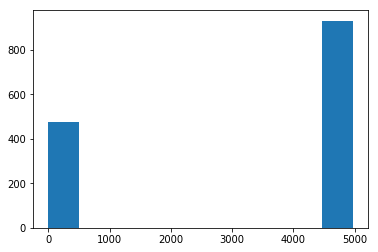

In [144]:
plt.hist(similarity_df['Similarity'] *10**5)
plt.show()

In [164]:
common_domains_dict[('China', 'Saudi Arabia')]

"['gazeta-oam', 'marijuana', 'naturalmuscle', 'the600club', 'oneworld', 'tlh', 'marijuanasignpost', 'redrival', 'arelationshipplaceformarriageandfamilycounseling', 'dictionary', 'tripodnet', 'd-n-a', 'asan', 'deathnews', 'cjb', 'webalias', 'tasteless-jokes', 'asshole', 'gndmovie', 'explore-srilanka', 'ponoi', 'luminist', 'timbomb', 'alpha-tiles', 'navasotaexaminer', 'politiquebooks', 'chinasite', 'anonymizer', 'redhotbikini', 'killuglytv', 'religioustolerance', 'darksites', 'travelebooks', 'sympatico', 'globalserve', 'yahoo', 'aol', 'links', 'skynet', 'thecompassionclub', 'bahai', 'china-apsis', 'www', 'antifart', 'altavista', 'libertysurf', 'google', 'lvtimes', 'megaproxy', 'lovenet', 'cityofchoctaw', 'cuttingedge', 'datacomm', 'beachqueen', 'io', 'freecoolstuff', 'pbase', 'marijuanafacts', 'millionmarijuanamarch', 'volny', '4marijuana', 'execpc', 'art', 'liu', 'infonie', 'gulfgreyhound', '360marijuana', 'chinawxp', 'lightworkerstempel', 'apexsid', 'burningflags', 'beanbag1', 'indiati

In [165]:
common_domains_df = pd.DataFrame.from_dict(common_domains_dict, orient='index')
common_domains_df.head()

,0
"(Austria, Belgium)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Bulgaria)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Croatia)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Cyprus)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Czech Republic)","['ultimategarage', 'hometownsource', 'heraldan..."


In [166]:
common_domains_df.shape

(703, 1)

In [168]:
common_domains_df.rename(columns = {0: "Common Blocked URLs"}, inplace = True)
common_domains_df.head()

,Common Blocked URLs
"(Austria, Belgium)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Bulgaria)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Croatia)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Cyprus)","['ultimategarage', 'hometownsource', 'heraldan..."
"(Austria, Czech Republic)","['ultimategarage', 'hometownsource', 'heraldan..."


In [169]:
common_domains_df.to_csv("combined_blocked_urls.csv")

In [9]:
with open('../combined-similarities.json', 'r') as fp:
    data = json.load(fp)
    print(data)

{"('Austria', 'BEL')": [{'similarity': 0.0496579382}], "('Austria', 'BGR')": [{'similarity': 0.0496579382}], "('Austria', 'HRV')": [{'similarity': 0.0496579382}], "('Austria', 'CYP')": [{'similarity': 0.0496579382}], "('Austria', 'CZE')": [{'similarity': 0.0496579382}], "('Austria', 'DNK')": [{'similarity': 0.0496579382}], "('Austria', 'EST')": [{'similarity': 0.0496579382}], "('Austria', 'FIN')": [{'similarity': 0.0496579382}], "('Austria', 'FRA')": [{'similarity': 0.0496579382}], "('Austria', 'DEU')": [{'similarity': 0.0496579382}], "('Austria', 'GRC')": [{'similarity': 0.0496579382}], "('Austria', 'HUN')": [{'similarity': 0.0496579382}], "('Austria', 'IRL')": [{'similarity': 0.0496579382}], "('Austria', 'ITA')": [{'similarity': 0.0496579382}], "('Austria', 'LVA')": [{'similarity': 0.0496579382}], "('Austria', 'LTU')": [{'similarity': 0.0496579382}], "('Austria', 'LUX')": [{'similarity': 0.0496579382}], "('Austria', 'MLT')": [{'similarity': 0.0496579382}], "('Austria', 'NLD')": [{'si

In [31]:
print(all_countries)

['Austria', 'Belgium', 'Bulgaria', 'Croatia', 'Cyprus', 'Czech Republic', 'Denmark', 'Estonia', 'Finland', 'France', 'Germany', 'Greece', 'Hungary', 'Ireland', 'Italy', 'Latvia', 'Lithuania', 'Luxembourg', 'Malta', 'Netherlands', 'Poland', 'Portugal', 'Romania', 'Slovakia', 'Slovenia', 'Spain', 'Sweden', 'United Kingdom', 'Iceland', 'Lichtenstein', 'Norway', 'China', 'GDPR', 'India', 'Iraq', 'Pakistan', 'Russia', 'Saudi Arabia', 'United Arab Emirates']


In [33]:
iso3166.countries_by_name

{'AFGHANISTAN': Country(name='Afghanistan', alpha2='AF', alpha3='AFG', numeric='004', apolitical_name='Afghanistan'),
 'ALBANIA': Country(name='Albania', alpha2='AL', alpha3='ALB', numeric='008', apolitical_name='Albania'),
 'ALGERIA': Country(name='Algeria', alpha2='DZ', alpha3='DZA', numeric='012', apolitical_name='Algeria'),
 'AMERICAN SAMOA': Country(name='American Samoa', alpha2='AS', alpha3='ASM', numeric='016', apolitical_name='American Samoa'),
 'ANDORRA': Country(name='Andorra', alpha2='AD', alpha3='AND', numeric='020', apolitical_name='Andorra'),
 'ANGOLA': Country(name='Angola', alpha2='AO', alpha3='AGO', numeric='024', apolitical_name='Angola'),
 'ANGUILLA': Country(name='Anguilla', alpha2='AI', alpha3='AIA', numeric='660', apolitical_name='Anguilla'),
 'ANTARCTICA': Country(name='Antarctica', alpha2='AQ', alpha3='ATA', numeric='010', apolitical_name='Antarctica'),
 'ANTIGUA AND BARBUDA': Country(name='Antigua and Barbuda', alpha2='AG', alpha3='ATG', numeric='028', apolitic

In [44]:
changed_names = {"Czech Republic": "CZECHIA",
                "United Kingdom": 'UNITED KINGDOM OF GREAT BRITAIN AND NORTHERN IRELAND',
                'Lichtenstein': 'LIECHTENSTEIN',
                'Russia': 'RUSSIAN FEDERATION'}
for c in all_countries: 
    if c in changed_names:
        key = "('United States of America', '" + iso3166.countries_by_name[changed_names[c]].alpha3 + "')"
    elif c == "GDPR":
        continue
    else:
        key = "('United States of America', '" + iso3166.countries_by_name[c.upper()].alpha3 + "')"
    data[key] = [{"similarity": 0}]
    data["('" + c + "', 'USA')"] = [{"similarity": 0}]

In [45]:
with open('../combined-similarities.json', 'w') as fp:
    json.dump(data, fp)